In [1]:
import os

os.chdir("./content")

lm_dir = "tf-levenberg-marquardt"
if not os.path.exists(lm_dir):
  !git clone https://github.com/fabiodimarco/$lm_dir

os.chdir(lm_dir)

In [2]:
!pip install --upgrade pip
!pip install tensorflow 
!pip install openpyxl
!pip install RegscorePy

/tmp/ipykernel_220757/1105938615.py:2: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


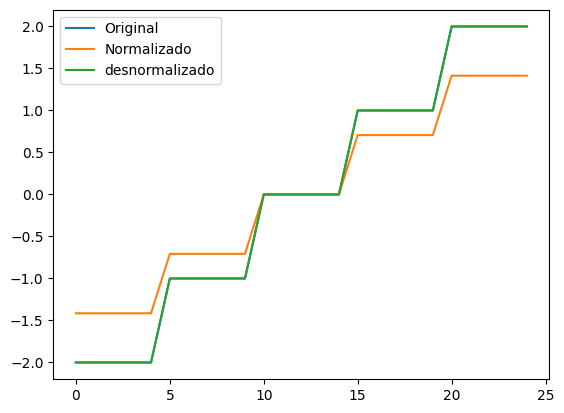

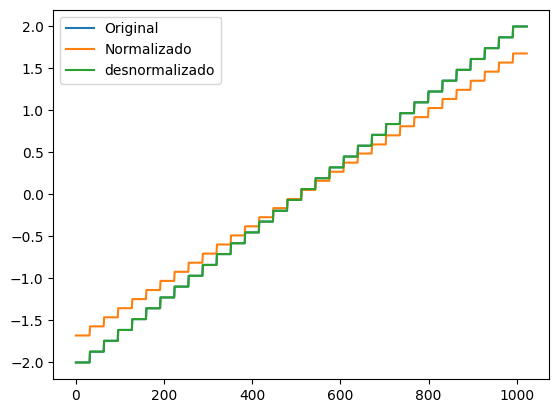

In [3]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

scaler = StandardScaler()
out_scaler = StandardScaler()

def peaks(grid):
    x = np.linspace(-2, 2, grid)
    y = np.linspace(-2, 2, grid)
    x, y = np.meshgrid(x, y)
    z = 3*(1-x)**2 * np.exp(-(x**2) - (y+1)**2) - 10*(x/5 - x**3 - y**5) * np.exp(-x**2 - y**2) - 1/3 * np.exp(-(x+1)**2 - y**2)
    return x, y, z

def create_dataframe(grid):
   x, y, z = peaks(grid)
   data = {'X': x.flatten(), 'Y': y.flatten(), 'Z': z.flatten()}
   df = pd.DataFrame(data)
   return df

def show_norm(df, label="Peaks", plot=False):
    df_norm = pd.DataFrame(scaler.fit_transform(df), columns=df.columns)
    df_denorm = pd.DataFrame(scaler.inverse_transform(df_norm), columns=df_norm.columns)

    if (plot):
        df.plot(title=f"{label}: Original data")
        df_norm.plot(title=f"{label}: Normalized data")
        df_denorm.plot(title=f"{label}: Denormalized data")
    return (df_norm)


def test_out_scaler(df):
    out = df["Y"].values.reshape(-1, 1)  
    plt.plot(out, label='Original')
    out_scaler.fit(out)
    norm = out_scaler.transform(out)
    plt.plot(norm, label='Normalizado')
    plt.plot(out_scaler.inverse_transform(norm), label='desnormalizado')
    plt.legend()
    plt.show()


df_25 = create_dataframe(grid=5)
df_25_norm = show_norm(df_25)
test_out_scaler(df_25)

df_1000 = create_dataframe(grid=32)
df_1000_norm = show_norm(df_1000)
test_out_scaler(df_1000)



In [4]:
def split_df(df):
    _input = np.vstack([df['X'], df['Y']]).T
    _output = np.array(df['Z'])
    return (_input, _output)

In [5]:
import tensorflow as tf
import numpy as np
from keras import regularizers
from keras import initializers
import levenberg_marquardt as lm

# layers, neurons
class ShuffleArchitecture:
    def __init__(self, input_size, hidden_sizes, output_size, act_h, act_o, param_reg):
        self.input_size = input_size
        self.hidden_sizes = hidden_sizes
        self.output_size = output_size
        self.act_h = act_h
        self.act_o = act_o
        self.regularizer = regularizers.L2(param_reg)
        self.initializer = initializers.RandomUniform(minval=-0.5, maxval=0.5, seed=np.random.randint(1, 10000))

    def compute_k(self):
        total_parameters = 0
        for layer in self.model.layers:
            weights = layer.get_weights()
            if len(weights) > 0:  
                for w in weights:
                    total_parameters += np.prod(w.shape)
        return total_parameters
        
    def set_architecture(self):
        self.model = tf.keras.Sequential()
        self.model.add(tf.keras.layers.Dense(self.hidden_sizes[0],
                        input_shape=(self.input_size,),
                        activation=self.act_h,
                        kernel_regularizer=self.regularizer,
                        kernel_initializer=self.initializer,                        
                        ))  # input layer

        for size in self.hidden_sizes[1:]:  # hidden layers
            self.model.add(tf.keras.layers.Dense(size,
                            activation=self.act_h,
                            kernel_regularizer=self.regularizer,
                            kernel_initializer=self.initializer,  
                        ))

        self.model.add(tf.keras.layers.Dense(self.output_size,
                        activation=self.act_o,
                        kernel_regularizer=self.regularizer,
                        kernel_initializer=self.initializer,  
                        ))  # output layer

    def create_model(self, _learning_rate):
        self.model.compile(
            optimizer=tf.keras.optimizers.Adam(learning_rate=_learning_rate),
            loss=tf.keras.losses.MeanSquaredError())

        self.lm_model = lm.ModelWrapper(
            tf.keras.models.clone_model(self.model))

        self.lm_model.compile(
            optimizer=tf.keras.optimizers.SGD(learning_rate=_learning_rate),
            loss=lm.MeanSquaredError())
        return(self.lm_model)

2024-05-03 21:19:01.335628: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2024-05-03 21:19:01.397886: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-03 21:19:01.397934: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-03 21:19:01.399273: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-05-03 21:19:01.408379: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2024-05-03 21:19:01.409419: I tensorflow/core/platform/cpu_feature_guard.cc:1

In [6]:
from sklearn.model_selection import train_test_split
from keras.callbacks import EarlyStopping
from sklearn.metrics import r2_score, mean_squared_error, root_mean_squared_error, mean_absolute_percentage_error 

class TrainWithSmallDataset:
    def __init__(self, batch_size=1000):
        self.batch_size = batch_size
        self.betters = []
        self.k = 0

    def create_dataset(self, input, output):
      input = tf.expand_dims(tf.cast(input, tf.float32), axis=-1)
      output = tf.expand_dims(tf.cast(output, tf.float32), axis=-1)
      dataset = tf.data.Dataset.from_tensor_slices((input, output))
      dataset = dataset.shuffle(len(input))
      dataset = dataset.batch(self.batch_size).cache()
      dataset = dataset.prefetch(tf.data.experimental.AUTOTUNE)
      return (dataset, input, output)

    def split_dataset(self, input, output, sup_input, sup_output):
      input_train, input_vt, output_train, output_vt = train_test_split(input, output, test_size=0.3, shuffle = True)
      input_val, input_test, output_val, output_test = train_test_split(input_vt, output_vt, test_size=0.5, shuffle = True)

      self.train_dataset, self.train_input, self.train_output = self.create_dataset(input_train, output_train)
      self.val_dataset, self.val_input, self.val_output = self.create_dataset(input_val, output_val)
      self.test_dataset, self.test_input, self.test_output = self.create_dataset(input_test, output_test)
      self.vt_dataset, self.vt_input, self.vt_output = self.create_dataset(input_vt, output_vt)
      self.sup_dataset, self.sup_input, self.sup_output = self.create_dataset(sup_input, sup_output)
      self.dataset, self.input, self.output = self.create_dataset(input, output)

      self._data = (input, output)
      self._train = (input_train, output_train)
      self._vt = (input_vt, output_vt)
      self._val = (input_val, output_val)
      self._test = (input_test, output_test)
      self._sup = (sup_input, sup_output)

    def train_using_lm(self, train_dataset, epochs=1000):
      early_stopping_monitor = EarlyStopping(monitor='val_loss',
                                              patience=6,
                                              restore_best_weights=True)

      self.results = self.lm_model.fit(train_dataset,
                                            epochs=epochs,
                                            validation_data=self.val_dataset,
                                            callbacks=[early_stopping_monitor],
                                            verbose=0)
      print ("Stopped at epoch: ", early_stopping_monitor.stopped_epoch)
    
    def get_new_metrics(self, orig, pred, r2, mse):
      n = len(orig) # N: quantidade de saidas
      k = self.k
      waste = (orig.flatten() - pred.flatten())

      mape = mean_absolute_percentage_error(orig, pred)  
      r2_adj = 1 - (((n - 1)/(n - k - 1)) * (1 - r2))
      rsd = np.sqrt(np.sum(waste ** 2) / (n - 2))
      rmse = root_mean_squared_error(orig, pred)          
      aic = (-2 * np.log(mse)) + (2 * k)
      bic = (-2 * np.log(mse)) + (k * np.log(n))
      return (mape, r2_adj, rsd, rmse, aic, bic)
      

    def get_metrics(self):
          # Calculando a saida com os dados normalizados
          pred = self.lm_model.predict(self.input).flatten()
          test_pred = self.lm_model.predict(self.test_input).flatten()
          val_pred = self.lm_model.predict(self.val_input).flatten()
          vt_pred = self.lm_model.predict(self.vt_input).flatten()
          sup_pred = self.lm_model.predict(self.sup_input).flatten()

          # Calculando as metricas com a saida desnormalizada
          pred_denorm = out_scaler.inverse_transform(pred.reshape(-1, 1))
          test_pred_denorm = out_scaler.inverse_transform(test_pred.reshape(-1, 1))
          val_pred_denorm = out_scaler.inverse_transform(val_pred.reshape(-1, 1))
          vt_pred_denorm = out_scaler.inverse_transform(vt_pred.reshape(-1, 1))
          sup_pred_denorm = out_scaler.inverse_transform(sup_pred.reshape(-1, 1))

          out_denorm = out_scaler.inverse_transform(self._data[1].reshape(-1, 1))
          test_denorm = out_scaler.inverse_transform(self._test[1].reshape(-1, 1))
          val_denorm = out_scaler.inverse_transform(self._val[1].reshape(-1, 1))
          vt_denorm = out_scaler.inverse_transform(self._vt[1].reshape(-1, 1))    
          sup_denorm = out_scaler.inverse_transform(self._sup[1].reshape(-1, 1))

          r2 = r2_score(out_denorm, pred_denorm)
          r2_test = r2_score(test_denorm, test_pred_denorm)
          r2_val = r2_score(val_denorm, val_pred_denorm)
          r2_vt = r2_score(vt_denorm,  vt_pred_denorm)
          r2_sup = r2_score(sup_denorm,  sup_pred_denorm)

          mse = mean_squared_error(out_denorm, pred_denorm)
          mse_test = mean_squared_error(test_denorm, test_pred_denorm)
          mse_val = mean_squared_error(val_denorm, val_pred_denorm)
          mse_vt = mean_squared_error(vt_denorm,  vt_pred_denorm)
          mse_sup = mean_squared_error(sup_denorm,  sup_pred_denorm)
          
          mape, r2_adj, rsd, rmse, aic, bic = self.get_new_metrics(out_denorm, pred_denorm, r2, mse)
          metrics = {
                          'r2': r2,
                          'r2_sup': r2_sup,
                          'r2_test': r2_test,
                          'r2_val': r2_val,
                          'r2_vt': r2_vt,
                          'mse': mse,
                          'mse_sup': mse_sup,
                          'mse_test': mse_test,
                          'mse_val': mse_val,
                          'mse_vt': mse_vt,
                          'mape': mape,
                          'rmse': rmse,
                          'r2_adj': r2_adj,
                          'rsd': rsd,
                          'aic': aic,
                          'bic': bic
                          }

          return metrics

In [7]:
import pickle
from itertools import product

class Tester:
  def __init__(self, run_times=500, dataset_run_times=10):
    self.run_times = run_times
    self.better_metrics = {}
    self.dataset_run_times = dataset_run_times
    self.input_25, self.output_25 = split_df(df_25_norm)
    self.input_1000, self.output_1000 = split_df(df_1000_norm)
  
  def setArchitecure(self, trainer, _hidden_sizes, _pg, _lr):
    shuffler = ShuffleArchitecture(input_size=2,
                                    hidden_sizes=_hidden_sizes,
                                    output_size=1,
                                    act_h='tanh',
                                    act_o='linear',
                                    param_reg=_pg)
    shuffler.set_architecture()    
    trainer.lm_model = shuffler.create_model(_lr)
    trainer.k = shuffler.compute_k()

  def Train(self, trainer, epochs=1000):
    trainer.train_using_lm(trainer.train_dataset, epochs=epochs)
    return(trainer.get_metrics(), trainer.lm_model)

  def SaveModelWeights(self, model, fileName):
    path = f"../models/{fileName}.keras"
    open(path,'w').close()
    model.save_weights(path)

  def SaveDataset(self, trainer, fileName):
    path = f"../dataset/{fileName}.pkl" 
    with open(path, 'wb') as f:
      pickle.dump((trainer._data, trainer._train, trainer._vt, trainer._val, trainer._test), f)
      
  def LoopWeights(self, sort_by, boundarie, trainer, idx):
    better_model = 0
    save = False

    for i in range(self.run_times):
      print (f"+++++++++++ [{idx}] | {i + 1} ++++++++++++++++++")
      metrics, model = self.Train(trainer)
      if (metrics[sort_by] <= boundarie): # should be >= to acsending metrics
        fileName = f"model_{idx}_{better_model}"
        self.SaveModelWeights(model, fileName)
        self.better_metrics[fileName] = metrics
        better_model += 1
        save = True
    return(save)

  def Loop(self, sort_by, boundarie, hidden_sizes, regularizers, learning_rate):
    trainer = TrainWithSmallDataset()

    for count, (hidden_size, reg, lr) in enumerate(product(hidden_sizes, regularizers, learning_rate), start=1):
      header =  f"Hidden Size={hidden_size}, regularizer={reg}, learning_rate={lr}"
      print(f"Testando combinacao{count}: {header}")
      self.setArchitecure(trainer, hidden_size, reg, lr)
      for j in range(self.dataset_run_times):
        trainer.split_dataset(self.input_25, self.output_25, self.input_1000, self.output_1000)
        if (self.LoopWeights(sort_by, boundarie, trainer, f"{count}_{j}") == True):
          self.SaveDataset(trainer, f"dataset_{count}_{j}")
          self.DisplayBetterResults('mse_sup', header, f"{count}_{j}")
        self.better_metrics = {}

  def DisplayBetterResults(self, sort_by, header, dataset=0):
    df = pd.DataFrame.from_dict(self.better_metrics, orient='index')
    df = df.sort_values([sort_by])
    display(df)
    path = f'../results/metrics_{dataset}'
    df.to_excel(f"{path}.xlsx", index=True)
    print(f"DataFrame salvo em {path}")
    with open(f"{path}.txt", 'w') as arquivo:
      arquivo.write(header)

# Treinando com 25 dados


In [8]:
tester = Tester(run_times=25, dataset_run_times=10)
tester.Loop(sort_by='mse_sup',
            boundarie = 0.5,
            hidden_sizes = [[40, 39], [20, 4], [15, 14], [26,18], [33, 21], [21, 12], [30, 21], [15, 2], [24, 7], [30, 16]],
            regularizers=[0.2, 0.0, 0.2, 0.5],
            learning_rate=[0.01, 0.1])

Testando combinacao1: Hidden Size=[40, 39], regularizer=0.2, learning_rate=0.01
+++++++++++ [1_0] | 1 ++++++++++++++++++


Stopped at epoch:  19
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_0] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++

2024-05-03 21:19:36.664712: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_1] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_1] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_1] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_1] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_1] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_1] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_1] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_1] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/ste

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_1_4_19,0.831552,0.685870,-0.298353,0.669733,0.669964,0.239088,0.445862,0.150813,0.662528,0.406670,2.403502,0.488966,1.002330,0.509783,3520.861846,5664.864422
model_1_4_18,0.829728,0.684339,-0.335822,0.670729,0.669008,0.241676,0.448035,0.155165,0.660530,0.407848,2.427615,0.491606,1.002355,0.512534,3520.840314,5664.842890
model_1_4_17,0.827859,0.682766,-0.374216,0.671713,0.668000,0.244330,0.450268,0.159625,0.658555,0.409090,2.451961,0.494297,1.002381,0.515340,3520.818475,5664.821051
model_1_4_16,0.825942,0.681149,-0.413557,0.672686,0.666938,0.247050,0.452563,0.164194,0.656603,0.410399,2.476552,0.497041,1.002408,0.518202,3520.796327,5664.798903
model_1_4_15,0.823977,0.679488,-0.453873,0.673647,0.665819,0.249840,0.454920,0.168877,0.654676,0.411777,2.501385,0.499840,1.002435,0.521119,3520.773871,5664.776447
model_1_4_14,0.821962,0.677782,-0.495185,0.674594,0.664643,0.252700,0.457341,0.173676,0.652776,0.413226,2.526460,0.502692,1.002463,0.524093,3520.751107,5664.753683
model_1_4_13,0.819896,0.676030,-0.537522,0.675528,0.663408,0.255632,0.459828,0.178594,0.650903,0.414748,2.551789,0.505600,1.002491,0.527125,3520.728036,5664.730612
model_1_4_12,0.817778,0.674231,-0.580908,0.676447,0.662111,0.258637,0.462382,0.183633,0.649060,0.416347,2.577368,0.508564,1.002521,0.530215,3520.704656,5664.707232
model_1_4_11,0.815607,0.672383,-0.625374,0.677350,0.660750,0.261719,0.465004,0.188799,0.647247,0.418023,2.603200,0.511585,1.002551,0.533364,3520.680969,5664.683545
model_1_4_10,0.813382,0.670486,-0.670945,0.678238,0.659325,0.264877,0.467697,0.194092,0.645465,0.419779,2.629288,0.514662,1.002581,0.536573,3520.656976,5664.659552


DataFrame salvo em ../results/metrics_1_4
+++++++++++ [1_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [1_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_1_5_24,0.885476,0.740117,-1.498765,0.740059,0.718462,0.162551,0.368866,0.086530,0.233649,0.160089,2.142963,0.403176,1.001584,0.420340,3521.633530,5665.636106
model_1_5_23,0.883921,0.738596,-1.549729,0.742398,0.718759,0.164757,0.371025,0.088295,0.231546,0.159921,2.159913,0.405902,1.001606,0.423183,3521.606570,5665.609146
model_1_5_22,0.882324,0.737030,-1.602978,0.744720,0.718973,0.167024,0.373248,0.090139,0.229459,0.159799,2.176590,0.408685,1.001628,0.426084,3521.579238,5665.581814
model_1_5_21,0.880683,0.735418,-1.658536,0.747023,0.719101,0.169353,0.375535,0.092063,0.227389,0.159726,2.192974,0.411525,1.001650,0.429045,3521.551539,5665.554115
model_1_5_20,0.878997,0.733759,-1.716438,0.749306,0.719143,0.171746,0.377890,0.094068,0.225337,0.159702,2.209036,0.414422,1.001674,0.432065,3521.523478,5665.526054
model_1_5_19,0.877265,0.732052,-1.776684,0.751567,0.719095,0.174204,0.380313,0.096154,0.223305,0.159730,2.224746,0.417377,1.001698,0.435146,3521.495058,5665.497634
model_1_5_18,0.875487,0.730296,-1.839280,0.753803,0.718956,0.176728,0.382805,0.098322,0.221295,0.159809,2.240069,0.420390,1.001722,0.438287,3521.466290,5665.468866
model_1_5_17,0.873661,0.728489,-1.904252,0.756012,0.718724,0.179319,0.385370,0.100572,0.219309,0.159941,2.254973,0.423461,1.001748,0.441489,3521.437174,5665.439750
model_1_5_16,0.871787,0.726631,-1.971586,0.758193,0.718397,0.181980,0.388008,0.102904,0.217349,0.160126,2.269422,0.426591,1.001774,0.444752,3521.407718,5665.410294
model_1_5_15,0.869863,0.724719,-2.041298,0.760342,0.717973,0.184711,0.390721,0.105318,0.215417,0.160368,2.283378,0.429780,1.001800,0.448077,3521.377926,5665.380502


DataFrame salvo em ../results/metrics_1_5
+++++++++++ [1_6] | 1 ++++++++++++++++++
Stopped at epoch:  45
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [1_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [1_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [1_6] | 9 +++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_1_6_24,0.920665,0.764061,0.943635,0.736419,0.907395,0.112604,0.334881,0.076750,0.498823,0.287787,1.206599,0.335566,1.001097,0.349852,3522.367749,5666.370325
model_1_6_23,0.920452,0.763952,0.943650,0.736786,0.907510,0.112907,0.335037,0.076731,0.498129,0.287430,1.217092,0.336016,1.001100,0.350321,3522.362390,5666.364966
model_1_6_22,0.920233,0.763838,0.943662,0.737153,0.907625,0.113217,0.335198,0.076714,0.497433,0.287074,1.227692,0.336478,1.001103,0.350802,3522.356892,5666.359467
model_1_6_21,0.920008,0.763719,0.943672,0.737521,0.907739,0.113537,0.335367,0.076700,0.496737,0.286718,1.238395,0.336953,1.001107,0.351298,3522.351250,5666.353825
model_1_6_20,0.919776,0.763596,0.943681,0.737890,0.907853,0.113866,0.335542,0.076689,0.496040,0.286364,1.249208,0.337441,1.001110,0.351806,3522.345464,5666.348040
model_1_6_19,0.919538,0.763467,0.943687,0.738258,0.907966,0.114205,0.335724,0.076680,0.495343,0.286012,1.260131,0.337942,1.001113,0.352329,3522.339528,5666.342104
model_1_6_18,0.919293,0.763334,0.943691,0.738627,0.908079,0.114552,0.335913,0.076675,0.494645,0.285660,1.271157,0.338456,1.001116,0.352865,3522.333445,5666.336020
model_1_6_17,0.919041,0.763195,0.943692,0.738995,0.908192,0.114910,0.336110,0.076673,0.493948,0.285311,1.282298,0.338984,1.001120,0.353415,3522.327208,5666.329784
model_1_6_16,0.918781,0.763051,0.943691,0.739363,0.908304,0.115278,0.336315,0.076674,0.493251,0.284963,1.293554,0.339526,1.001123,0.353981,3522.320814,5666.323390
model_1_6_15,0.918515,0.762901,0.943688,0.739732,0.908415,0.115656,0.336527,0.076679,0.492554,0.284617,1.304919,0.340083,1.001127,0.354561,3522.314263,5666.316839


DataFrame salvo em ../results/metrics_1_6
+++++++++++ [1_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [1_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_1_7_15,0.936511,0.773404,0.907662,0.922083,0.946609,0.090113,0.321620,0.086429,0.104214,0.095321,1.135648,0.300188,1.000878,0.312967,3522.813387,5666.815963
model_1_7_14,0.936077,0.773385,0.911351,0.922275,0.947648,0.090729,0.321646,0.082976,0.103958,0.093467,1.139288,0.301212,1.000884,0.314036,3522.799758,5666.802334
model_1_7_16,0.936884,0.773366,0.903883,0.921660,0.945460,0.089584,0.321674,0.089967,0.104779,0.097373,1.132083,0.299305,1.000873,0.312047,3522.825166,5666.827742
model_1_7_13,0.935580,0.773307,0.914944,0.922226,0.948571,0.091435,0.321758,0.079613,0.104023,0.091818,1.143005,0.302383,1.000891,0.315256,3522.784243,5666.786819
model_1_7_17,0.937198,0.773274,0.900016,0.921017,0.944206,0.089138,0.321805,0.093586,0.105639,0.099612,1.128589,0.298560,1.000869,0.311270,3522.835137,5666.837713
model_1_7_12,0.935016,0.773165,0.918436,0.921926,0.949374,0.092236,0.321959,0.076344,0.104424,0.090384,1.146809,0.303704,1.000899,0.316633,3522.766810,5666.769386
model_1_7_18,0.937455,0.773130,0.896067,0.920165,0.942851,0.088773,0.322009,0.097282,0.106780,0.102031,1.125164,0.297948,1.000865,0.310632,3522.843344,5666.845920
model_1_7_11,0.934383,0.772957,0.921822,0.921365,0.950052,0.093134,0.322254,0.073175,0.105174,0.089175,1.150699,0.305178,1.000908,0.318170,3522.747436,5666.750012
model_1_7_19,0.937658,0.772938,0.892040,0.919111,0.941401,0.088485,0.322282,0.101051,0.108189,0.104620,1.121802,0.297465,1.000862,0.310128,3522.849839,5666.852415
model_1_7_20,0.937809,0.772699,0.887940,0.917866,0.939860,0.088272,0.322621,0.104889,0.109854,0.107372,1.118504,0.297105,1.000860,0.309754,3522.854673,5666.857249


DataFrame salvo em ../results/metrics_1_7
+++++++++++ [1_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_8] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_1_8_24,0.957677,0.799175,-0.573991,0.976083,0.942002,0.060071,0.285041,0.069912,0.027671,0.048791,0.889195,0.245094,1.000585,0.255528,3523.624459,5667.627035
model_1_8_23,0.957153,0.798342,-0.578988,0.977136,0.942594,0.060815,0.286224,0.070134,0.026453,0.048293,0.896517,0.246607,1.000593,0.257106,3523.599830,5667.602405
model_1_8_22,0.956610,0.797488,-0.584157,0.978153,0.943157,0.061586,0.287436,0.070363,0.025276,0.047820,0.903913,0.248165,1.000600,0.258729,3523.574653,5667.577228
model_1_8_21,0.956048,0.796614,-0.589508,0.979134,0.943690,0.062383,0.288677,0.070601,0.024142,0.047371,0.911384,0.249766,1.000608,0.260399,3523.548925,5667.551501
model_1_8_20,0.955467,0.795719,-0.595047,0.980076,0.944192,0.063208,0.289948,0.070847,0.023051,0.046949,0.918927,0.251412,1.000616,0.262115,3523.522656,5667.525232
model_1_8_19,0.954866,0.794802,-0.600776,0.980980,0.944663,0.064061,0.291249,0.071102,0.022005,0.046553,0.926546,0.253102,1.000624,0.263877,3523.495851,5667.498427
model_1_8_18,0.954245,0.793863,-0.606707,0.981844,0.945100,0.064942,0.292581,0.071365,0.021006,0.046185,0.934240,0.254838,1.000633,0.265687,3523.468513,5667.471089
model_1_8_17,0.953603,0.792903,-0.612838,0.982667,0.945504,0.065853,0.293945,0.071637,0.020054,0.045846,0.942460,0.256619,1.000642,0.267544,3523.440651,5667.443227
model_1_8_16,0.952940,0.791919,-0.619189,0.983447,0.945873,0.066794,0.295341,0.071919,0.019151,0.045535,0.950967,0.258446,1.000651,0.269449,3523.412272,5667.414848
model_1_8_15,0.952256,0.790913,-0.625754,0.984184,0.946206,0.067766,0.296769,0.072211,0.018299,0.045255,0.959553,0.260319,1.000660,0.271402,3523.383383,5667.385959


DataFrame salvo em ../results/metrics_1_8
+++++++++++ [1_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [1_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [1_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [1_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_1_9_24,0.972150,0.812814,0.989034,0.784970,0.988344,0.039530,0.265684,0.026988,0.007182,0.017085,0.790566,0.198821,1.000385,0.207285,3524.461407,5668.463983
model_1_9_23,0.971809,0.812531,0.989420,0.795749,0.988790,0.040013,0.266084,0.026039,0.006822,0.016431,0.788689,0.200032,1.000390,0.208548,3524.437105,5668.439680
model_1_9_22,0.971453,0.812233,0.989800,0.805501,0.989220,0.040518,0.266508,0.025104,0.006497,0.015800,0.786774,0.201290,1.000395,0.209860,3524.412027,5668.414603
model_1_9_21,0.971082,0.811917,0.990174,0.814178,0.989634,0.041045,0.266956,0.024182,0.006207,0.015195,0.784806,0.202596,1.000400,0.211221,3524.386170,5668.388746
model_1_9_20,0.970694,0.811585,0.990543,0.821731,0.990029,0.041595,0.267428,0.023275,0.005955,0.014615,0.782788,0.203949,1.000405,0.212632,3524.359538,5668.362114
model_1_9_19,0.970290,0.811234,0.990905,0.828108,0.990406,0.042169,0.267926,0.022383,0.005742,0.014062,0.781465,0.205351,1.000411,0.214094,3524.332131,5668.334707
model_1_9_18,0.969868,0.810865,0.991261,0.833249,0.990764,0.042768,0.268450,0.021507,0.005570,0.013539,0.780353,0.206803,1.000417,0.215607,3524.303948,5668.306524
model_1_9_17,0.969429,0.810476,0.991610,0.837096,0.991100,0.043391,0.269002,0.020648,0.005441,0.013045,0.779211,0.208306,1.000423,0.217174,3524.274998,5668.277574
model_1_9_16,0.968971,0.810067,0.991952,0.839583,0.991416,0.044041,0.269582,0.019807,0.005358,0.012583,0.778028,0.209859,1.000429,0.218793,3524.245275,5668.247851
model_1_9_15,0.968495,0.809638,0.992286,0.840646,0.991708,0.044717,0.270191,0.018985,0.005323,0.012154,0.776796,0.211465,1.000436,0.220467,3524.214784,5668.217360


DataFrame salvo em ../results/metrics_1_9
Testando combinacao2: Hidden Size=[40, 39], regularizer=0.2, learning_rate=0.1
+++++++++++ [2_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [=====

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_0_7,0.817320,0.737448,0.692930,-0.957167,0.638366,0.259287,0.372655,0.779401,0.624403,0.701902,0.784846,0.509203,1.002527,0.530880,3520.699637,5664.702213
model_2_0_8,0.819376,0.737193,0.693347,-1.032947,0.632411,0.256370,0.373016,0.778342,0.648580,0.713461,0.755555,0.506329,1.002499,0.527885,3520.722271,5664.724847
model_2_0_6,0.813958,0.736617,0.690986,-0.874906,0.643856,0.264060,0.373834,0.784336,0.598159,0.691247,0.817295,0.513867,1.002573,0.535744,3520.663161,5664.665737
model_2_0_9,0.820449,0.736162,0.692667,-1.102533,0.626247,0.254846,0.374480,0.780068,0.670780,0.725424,0.729122,0.504823,1.002484,0.526314,3520.734190,5664.736766
model_2_0_10,0.820792,0.734590,0.691217,-1.166269,0.620060,0.254360,0.376711,0.783750,0.691114,0.737432,0.705291,0.504341,1.002479,0.525811,3520.738013,5664.740589
model_2_0_5,0.808873,0.734303,0.686951,-0.785951,0.648528,0.271278,0.377118,0.794578,0.569779,0.682179,0.853211,0.520843,1.002644,0.543017,3520.609225,5664.611801
model_2_0_11,0.820601,0.732658,0.689244,-1.224512,0.613984,0.254631,0.379453,0.788757,0.709695,0.749226,0.683804,0.504610,1.002482,0.526092,3520.735879,5664.738455
model_2_0_12,0.820027,0.730504,0.686936,-1.277639,0.608108,0.255446,0.382511,0.794615,0.726645,0.760630,0.664440,0.505417,1.002490,0.526933,3520.729489,5664.732065
model_2_0_4,0.801530,0.729989,0.680084,-0.690212,0.651907,0.281700,0.383242,0.812006,0.539236,0.675621,0.892919,0.530754,1.002745,0.553349,3520.533829,5664.536405
model_2_0_13,0.819187,0.728230,0.684433,-1.326018,0.602495,0.256638,0.385738,0.800968,0.742079,0.771524,0.646999,0.506595,1.002501,0.528162,3520.720175,5664.722751


DataFrame salvo em ../results/metrics_2_0
+++++++++++ [2_1] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_1] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_1_2,0.933086,0.790441,0.030495,0.911212,0.803473,0.094974,0.297438,0.120682,0.070932,0.095807,0.643127,0.308179,1.000926,0.321298,3522.708304,5666.710880
model_2_1_3,0.938932,0.789462,-0.177989,0.910611,0.776364,0.086678,0.298827,0.146634,0.071413,0.109023,0.646070,0.294411,1.000845,0.306945,3522.891116,5666.893692
model_2_1_1,0.924675,0.789312,0.253932,0.904368,0.826392,0.106914,0.299040,0.092869,0.076400,0.084635,0.628760,0.326976,1.001042,0.340896,3522.471470,5666.474046
model_2_1_4,0.943038,0.787230,-0.367832,0.907001,0.749169,0.080849,0.301996,0.170265,0.074296,0.122281,0.640962,0.284340,1.000788,0.296445,3523.030341,5667.032917
model_2_1_0,0.912566,0.784976,0.477795,0.884711,0.838865,0.124100,0.305196,0.065003,0.092104,0.078554,0.625950,0.352279,1.001209,0.367276,3522.173330,5666.175906
model_2_1_5,0.945905,0.784283,-0.540476,0.902512,0.723450,0.076780,0.306179,0.191756,0.077883,0.134819,0.630378,0.277092,1.000748,0.288888,3523.133626,5667.136202
model_2_1_6,0.947831,0.780929,-0.698510,0.897766,0.699384,0.074046,0.310939,0.211427,0.081675,0.146551,0.617062,0.272115,1.000722,0.283699,3523.206128,5667.208704
model_2_1_7,0.949017,0.777352,-0.844205,0.892822,0.676733,0.072363,0.316016,0.229563,0.085624,0.157594,0.602867,0.269004,1.000705,0.280456,3523.252115,5667.254691
model_2_1_8,0.949620,0.773672,-0.979191,0.887671,0.655278,0.071508,0.321239,0.246366,0.089740,0.168053,0.588492,0.267409,1.000697,0.278794,3523.275898,5667.278474
model_2_1_9,0.949771,0.769978,-1.104510,0.882357,0.634925,0.071293,0.326483,0.261966,0.093984,0.177975,0.574459,0.267007,1.000695,0.278374,3523.281925,5667.284501


DataFrame salvo em ../results/metrics_2_1
+++++++++++ [2_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_2] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_2_2,0.955704,0.750885,0.833325,0.957692,0.920803,0.062871,0.353583,0.094370,0.036394,0.065382,0.453949,0.250741,1.000613,0.261416,3523.533334,5667.535910
model_2_2_3,0.954973,0.750442,0.774074,0.930624,0.886382,0.063910,0.354212,0.127916,0.059679,0.093798,0.457078,0.252803,1.000623,0.263566,3523.500573,5667.503149
model_2_2_1,0.954016,0.748738,0.883815,0.979832,0.949651,0.065267,0.356629,0.065782,0.017349,0.041566,0.450139,0.255475,1.000636,0.266351,3523.458530,5667.461106
model_2_2_4,0.952552,0.748197,0.709812,0.900829,0.848823,0.067345,0.357397,0.164301,0.085310,0.124806,0.459334,0.259509,1.000656,0.270557,3523.395856,5667.398432
model_2_2_5,0.949008,0.744757,0.643267,0.870059,0.809973,0.072376,0.362280,0.201978,0.111779,0.156878,0.460806,0.269028,1.000705,0.280481,3523.251755,5667.254331
model_2_2_0,0.949009,0.743056,0.920597,0.994598,0.969957,0.072374,0.364695,0.044957,0.004647,0.024802,0.446336,0.269023,1.000705,0.280476,3523.251827,5667.254403
model_2_2_6,0.944759,0.740569,0.576359,0.839590,0.771155,0.078407,0.368225,0.239860,0.137990,0.188925,0.461669,0.280012,1.000764,0.291932,3523.091696,5667.094272
model_2_2_7,0.940113,0.735957,0.510413,0.810276,0.733269,0.085001,0.374770,0.277198,0.163206,0.220202,0.462026,0.291549,1.000828,0.303961,3522.930189,5666.932765
model_2_2_8,0.935289,0.731155,0.446338,0.782637,0.696896,0.091848,0.381587,0.313476,0.186983,0.250229,0.462017,0.303064,1.000895,0.315966,3522.775242,5666.777818
model_2_2_9,0.930441,0.726326,0.384764,0.756933,0.662390,0.098729,0.388440,0.348339,0.209094,0.278716,0.461747,0.314211,1.000962,0.327588,3522.630760,5666.633336


DataFrame salvo em ../results/metrics_2_2
+++++++++++ [2_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [2_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_3] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_3_24,0.955282,0.805947,0.709568,0.770492,0.823226,0.063471,0.275430,0.229658,0.162796,0.196227,1.367984,0.251934,1.000619,0.262659,3523.514359,5667.516935
model_2_3_23,0.955622,0.805782,0.711639,0.773834,0.825032,0.062988,0.275665,0.228021,0.160425,0.194223,1.358455,0.250975,1.000614,0.261659,3523.529612,5667.532188
model_2_3_22,0.955980,0.805578,0.713922,0.777496,0.827015,0.062480,0.275954,0.226215,0.157828,0.192021,1.347852,0.249961,1.000609,0.260602,3523.545808,5667.548384
model_2_3_21,0.956353,0.805326,0.716436,0.781502,0.829190,0.061950,0.276312,0.224228,0.154987,0.189607,1.336050,0.248898,1.000604,0.259494,3523.562846,5667.565422
model_2_3_20,0.956738,0.805015,0.719200,0.785873,0.831571,0.061404,0.276754,0.222042,0.151886,0.186964,1.322919,0.247798,1.000598,0.258347,3523.580565,5667.583141
model_2_3_19,0.957129,0.804630,0.722232,0.790634,0.834172,0.060850,0.277299,0.219644,0.148509,0.184077,1.308309,0.246678,1.000593,0.257179,3523.598692,5667.601268
model_2_3_18,0.957516,0.804156,0.725549,0.795805,0.837006,0.060300,0.277973,0.217021,0.144841,0.180931,1.292058,0.245560,1.000588,0.256014,3523.616850,5667.619426
model_2_3_17,0.957889,0.803570,0.729169,0.801405,0.840084,0.059770,0.278804,0.214159,0.140869,0.177514,1.273993,0.244480,1.000583,0.254888,3523.634495,5667.637071
model_2_3_16,0.958233,0.802847,0.733104,0.807448,0.843417,0.059283,0.279831,0.211047,0.136582,0.173814,1.253919,0.243481,1.000578,0.253846,3523.650872,5667.653448
model_2_3_15,0.958526,0.801954,0.737362,0.813945,0.847009,0.058867,0.281097,0.207680,0.131973,0.169827,1.231633,0.242624,1.000574,0.252953,3523.664965,5667.667541


DataFrame salvo em ../results/metrics_2_3
+++++++++++ [2_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_4] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_4_7,0.969644,0.816324,0.968591,0.829908,0.936219,0.043087,0.260702,0.087286,0.149835,0.118561,0.747367,0.207573,1.000420,0.216410,3524.289089,5668.291665
model_2_4_8,0.969889,0.816299,0.969510,0.822540,0.935161,0.042738,0.260737,0.084730,0.156325,0.120528,0.701489,0.206731,1.000417,0.215532,3524.305342,5668.307918
model_2_4_6,0.969231,0.816217,0.967498,0.837766,0.937264,0.043673,0.260853,0.090323,0.142913,0.116618,0.798404,0.208980,1.000426,0.217876,3524.262071,5668.264647
model_2_4_9,0.970008,0.816179,0.970286,0.815669,0.934113,0.042569,0.260907,0.082575,0.162377,0.122476,0.660244,0.206323,1.000415,0.215106,3524.313254,5668.315830
model_2_4_10,0.970032,0.815993,0.970941,0.809292,0.933092,0.042535,0.261171,0.080754,0.167995,0.124375,0.623152,0.206240,1.000415,0.215020,3524.314858,5668.317434
model_2_4_5,0.968600,0.815935,0.966198,0.846092,0.938266,0.044568,0.261254,0.093935,0.135578,0.114757,0.855197,0.211112,1.000434,0.220099,3524.221471,5668.224047
model_2_4_11,0.969987,0.815761,0.971496,0.803394,0.932109,0.042600,0.261500,0.079212,0.173190,0.126201,0.589793,0.206397,1.000415,0.215184,3524.311812,5668.314388
model_2_4_12,0.969891,0.815501,0.971967,0.797959,0.931173,0.042736,0.261870,0.077905,0.177978,0.127941,0.559785,0.206726,1.000416,0.215527,3524.305442,5668.308018
model_2_4_4,0.967687,0.815418,0.964650,0.854846,0.939183,0.045864,0.261988,0.098238,0.127867,0.113052,0.918428,0.214159,1.000447,0.223276,3524.164147,5668.166723
model_2_4_13,0.969760,0.815224,0.972367,0.792964,0.930288,0.042921,0.262263,0.076793,0.182378,0.129585,0.532790,0.207173,1.000418,0.215993,3524.296796,5668.299372


DataFrame salvo em ../results/metrics_2_4
+++++++++++ [2_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_5_0,0.970524,0.812057,0.960362,0.906694,0.955040,0.041837,0.266758,0.165195,0.048092,0.106643,0.335934,0.204541,1.000408,0.213249,3524.347948,5668.350524
model_2_5_1,0.972571,0.811325,0.962681,0.905408,0.956937,0.038932,0.267796,0.155531,0.048754,0.102143,0.308768,0.197311,1.000379,0.205711,3524.491899,5668.494475
model_2_5_2,0.974246,0.810490,0.964650,0.903929,0.958506,0.036554,0.268982,0.147325,0.049517,0.098421,0.284346,0.191191,1.000356,0.199330,3524.617937,5668.620513
model_2_5_3,0.975617,0.809594,0.966323,0.902340,0.959804,0.034608,0.270254,0.140352,0.050335,0.095344,0.262388,0.186032,1.000337,0.193952,3524.727351,5668.729927
model_2_5_4,0.976739,0.808669,0.967746,0.900707,0.960876,0.033015,0.271567,0.134422,0.051177,0.092799,0.242645,0.181700,1.000322,0.189435,3524.821592,5668.824168
model_2_5_5,0.977658,0.807739,0.968958,0.899077,0.961764,0.031711,0.272886,0.129372,0.052017,0.090695,0.224889,0.178075,1.000309,0.185656,3524.902206,5668.904782
model_2_5_6,0.978411,0.806823,0.969991,0.897483,0.962498,0.030642,0.274186,0.125067,0.052839,0.088953,0.208925,0.175050,1.000299,0.182502,3524.970740,5668.973316
model_2_5_7,0.979028,0.805935,0.970873,0.895947,0.963106,0.029767,0.275448,0.121390,0.053631,0.087510,0.194565,0.172531,1.000290,0.179876,3525.028708,5669.031284
model_2_5_8,0.979534,0.805082,0.971627,0.894485,0.963610,0.029049,0.276657,0.118245,0.054384,0.086315,0.181649,0.170438,1.000283,0.177694,3525.077531,5669.080106
model_2_5_9,0.979949,0.804272,0.972274,0.893106,0.964029,0.028460,0.277807,0.115549,0.055095,0.085322,0.170028,0.168701,1.000277,0.175883,3525.118503,5669.121079


DataFrame salvo em ../results/metrics_2_5
+++++++++++ [2_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [2_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_6_24,0.984719,0.803329,0.904537,0.764148,0.918543,0.021689,0.279146,0.070214,0.065238,0.067726,0.617337,0.147272,1.000211,0.153542,3525.661893,5669.664469
model_2_6_23,0.984719,0.803304,0.904352,0.764713,0.918556,0.021690,0.279181,0.070350,0.065082,0.067716,0.612689,0.147274,1.000211,0.153544,3525.661830,5669.664405
model_2_6_22,0.984718,0.803276,0.904146,0.765336,0.918568,0.021691,0.279221,0.070502,0.064909,0.067705,0.607521,0.147280,1.000211,0.153550,3525.661690,5669.664266
model_2_6_21,0.984716,0.803244,0.903917,0.766026,0.918581,0.021694,0.279267,0.070670,0.064718,0.067694,0.601772,0.147288,1.000211,0.153558,3525.661461,5669.664037
model_2_6_20,0.984713,0.803207,0.903660,0.766788,0.918595,0.021698,0.279319,0.070859,0.064508,0.067683,0.595373,0.147301,1.000211,0.153572,3525.661111,5669.663686
model_2_6_19,0.984709,0.803166,0.903375,0.767630,0.918609,0.021703,0.279378,0.071069,0.064275,0.067672,0.588251,0.147320,1.000212,0.153591,3525.660603,5669.663179
model_2_6_18,0.984704,0.803118,0.903056,0.768559,0.918622,0.021711,0.279445,0.071303,0.064018,0.067661,0.580319,0.147346,1.000212,0.153619,3525.659893,5669.662468
model_2_6_17,0.984696,0.803064,0.902699,0.769583,0.918635,0.021721,0.279522,0.071566,0.063734,0.067650,0.571492,0.147382,1.000212,0.153656,3525.658920,5669.661495
model_2_6_16,0.984686,0.803002,0.902301,0.770712,0.918646,0.021735,0.279610,0.071859,0.063422,0.067640,0.561660,0.147430,1.000212,0.153706,3525.657618,5669.660194
model_2_6_15,0.984673,0.802930,0.901855,0.771954,0.918656,0.021754,0.279712,0.072186,0.063079,0.067633,0.550707,0.147493,1.000212,0.153772,3525.655892,5669.658468


DataFrame salvo em ../results/metrics_2_6
+++++++++++ [2_7] | 1 ++++++++++++++++++
Stopped at epoch:  79
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_7] | 4 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_7] | 6 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_7] | 7 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_7] | 8 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_7] | 9 +++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_7_7,0.986517,0.816808,0.969061,0.986114,0.972770,0.019137,0.260014,0.106880,0.012726,0.059803,0.074042,0.138336,1.000187,0.144225,3525.912274,5669.914850
model_2_7_19,0.986517,0.816808,0.969061,0.986114,0.972770,0.019137,0.260014,0.106880,0.012726,0.059803,0.074041,0.138337,1.000187,0.144226,3525.912264,5669.914840
model_2_7_20,0.986517,0.816808,0.969061,0.986114,0.972770,0.019137,0.260014,0.106880,0.012726,0.059803,0.074041,0.138337,1.000187,0.144226,3525.912264,5669.914840
model_2_7_18,0.986517,0.816808,0.969061,0.986114,0.972770,0.019137,0.260014,0.106880,0.012726,0.059803,0.074041,0.138337,1.000187,0.144226,3525.912264,5669.914840
model_2_7_17,0.986517,0.816808,0.969061,0.986114,0.972770,0.019137,0.260014,0.106880,0.012726,0.059803,0.074041,0.138337,1.000187,0.144226,3525.912264,5669.914840
model_2_7_16,0.986517,0.816808,0.969061,0.986114,0.972770,0.019137,0.260014,0.106880,0.012726,0.059803,0.074041,0.138337,1.000187,0.144226,3525.912264,5669.914840
model_2_7_15,0.986517,0.816808,0.969061,0.986114,0.972770,0.019137,0.260014,0.106880,0.012726,0.059803,0.074041,0.138337,1.000187,0.144226,3525.912264,5669.914840
model_2_7_22,0.986517,0.816808,0.969061,0.986114,0.972770,0.019137,0.260014,0.106880,0.012726,0.059803,0.074041,0.138337,1.000187,0.144226,3525.912264,5669.914840
model_2_7_21,0.986517,0.816808,0.969061,0.986114,0.972770,0.019137,0.260014,0.106880,0.012726,0.059803,0.074041,0.138337,1.000187,0.144226,3525.912264,5669.914840
model_2_7_13,0.986517,0.816808,0.969061,0.986114,0.972770,0.019137,0.260014,0.106880,0.012726,0.059803,0.074041,0.138337,1.000187,0.144226,3525.912264,5669.914840


DataFrame salvo em ../results/metrics_2_7
+++++++++++ [2_8] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [2_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_8] | 9 +++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_8_1,0.992170,0.817300,0.352140,0.998967,0.993103,0.011114,0.259316,0.010774,0.001538,0.006156,0.265073,0.105422,1.000108,0.109910,3526.999141,5671.001717
model_2_8_2,0.993176,0.817184,0.325835,0.998015,0.992064,0.009686,0.259480,0.011212,0.002955,0.007084,0.329488,0.098418,1.000094,0.102607,3527.274143,5671.276719
model_2_8_0,0.990833,0.817177,0.377492,0.999628,0.993891,0.013012,0.259491,0.010353,0.000554,0.005453,0.195454,0.114069,1.000127,0.118926,3526.683793,5670.686369
model_2_8_3,0.993923,0.816893,0.300801,0.996869,0.990875,0.008625,0.259893,0.011628,0.004662,0.008145,0.389111,0.092872,1.000084,0.096826,3527.506124,5671.508700
model_2_8_4,0.994469,0.816477,0.278099,0.995599,0.989605,0.007851,0.260484,0.012006,0.006552,0.009279,0.444050,0.088605,1.000077,0.092377,3527.694252,5671.696828
model_2_8_5,0.994857,0.815977,0.258044,0.994261,0.988301,0.007300,0.261194,0.012339,0.008546,0.010443,0.494580,0.085441,1.000071,0.089079,3527.839702,5671.842278
model_2_8_6,0.995122,0.815425,0.240554,0.992892,0.986997,0.006924,0.261978,0.012630,0.010584,0.011607,0.540946,0.083209,1.000067,0.086752,3527.945591,5671.948167
model_2_8_7,0.995292,0.814845,0.225372,0.991524,0.985714,0.006682,0.262801,0.012883,0.012621,0.012752,0.583370,0.081746,1.000065,0.085226,3528.016543,5672.019119
model_2_8_8,0.995389,0.814256,0.212218,0.990178,0.984470,0.006545,0.263636,0.013102,0.014625,0.013863,0.622089,0.080902,1.000064,0.084346,3528.058073,5672.060649
model_2_8_9,0.995430,0.813673,0.200765,0.988872,0.983273,0.006487,0.264464,0.013292,0.016569,0.014931,0.657344,0.080542,1.000063,0.083971,3528.075903,5672.078479


DataFrame salvo em ../results/metrics_2_8
+++++++++++ [2_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [2_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [2_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_2_9_0,0.995131,0.807773,0.960775,0.999898,0.996403,0.006911,0.272838,0.013157,0.000192,0.006674,0.919703,0.083132,1.000067,0.086671,3527.949309,5671.951885
model_2_9_1,0.995681,0.807453,0.959504,0.999703,0.996189,0.006131,0.273292,0.013583,0.000560,0.007071,0.920946,0.078300,1.000060,0.081633,3528.188829,5672.191405
model_2_9_2,0.996086,0.807090,0.958025,0.999439,0.995921,0.005555,0.273807,0.014079,0.001056,0.007568,0.921433,0.074532,1.000054,0.077705,3528.386113,5672.388689
model_2_9_3,0.996380,0.806704,0.956425,0.999131,0.995620,0.005139,0.274356,0.014616,0.001638,0.008127,0.921346,0.071685,1.000050,0.074737,3528.541898,5672.544474
model_2_9_4,0.996585,0.806307,0.954767,0.998795,0.995300,0.004847,0.274919,0.015172,0.002270,0.008721,0.920831,0.069618,1.000047,0.072582,3528.658927,5672.661502
model_2_9_5,0.996723,0.805911,0.953100,0.998447,0.994972,0.004651,0.275482,0.015731,0.002926,0.009329,0.920015,0.068196,1.000045,0.071099,3528.741499,5672.744075
model_2_9_6,0.996810,0.805522,0.951458,0.998095,0.994645,0.004528,0.276033,0.016282,0.003588,0.009935,0.918983,0.067293,1.000044,0.070158,3528.794808,5672.797384
model_2_9_7,0.996856,0.805146,0.949865,0.997748,0.994325,0.004462,0.276566,0.016816,0.004242,0.010529,0.917813,0.066799,1.000043,0.069642,3528.824286,5672.826862
model_2_9_8,0.996873,0.804787,0.948340,0.997412,0.994016,0.004438,0.277076,0.017328,0.004876,0.011102,0.916558,0.066617,1.000043,0.069454,3528.835154,5672.837730
model_2_9_9,0.996868,0.804447,0.946892,0.997088,0.993721,0.004445,0.277559,0.017813,0.005485,0.011649,0.915266,0.066670,1.000043,0.069508,3528.832008,5672.834584


DataFrame salvo em ../results/metrics_2_9
Testando combinacao3: Hidden Size=[40, 39], regularizer=0.0, learning_rate=0.01
+++++++++++ [3_0] | 1 ++++++++++++++++++
Stopped at epoch:  97
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [3_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [===

2024-05-03 21:26:44.512596: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_0] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [3_0] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_0] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_0] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/ste

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_1_12,0.911913,0.727406,0.734227,-1.917427,0.285807,0.125027,0.386908,0.240186,0.541233,0.390709,0.780968,0.353591,1.001218,0.368645,3522.158452,5666.161028
model_3_1_22,0.911913,0.727406,0.734227,-1.917427,0.285807,0.125027,0.386908,0.240186,0.541233,0.390709,0.780968,0.353591,1.001218,0.368645,3522.158452,5666.161028
model_3_1_21,0.911913,0.727406,0.734227,-1.917427,0.285807,0.125027,0.386908,0.240186,0.541233,0.390709,0.780968,0.353591,1.001218,0.368645,3522.158452,5666.161028
model_3_1_20,0.911913,0.727406,0.734227,-1.917427,0.285807,0.125027,0.386908,0.240186,0.541233,0.390709,0.780968,0.353591,1.001218,0.368645,3522.158452,5666.161028
model_3_1_19,0.911913,0.727406,0.734227,-1.917427,0.285807,0.125027,0.386908,0.240186,0.541233,0.390709,0.780968,0.353591,1.001218,0.368645,3522.158452,5666.161028
model_3_1_18,0.911913,0.727406,0.734227,-1.917427,0.285807,0.125027,0.386908,0.240186,0.541233,0.390709,0.780968,0.353591,1.001218,0.368645,3522.158452,5666.161028
model_3_1_17,0.911913,0.727406,0.734227,-1.917427,0.285807,0.125027,0.386908,0.240186,0.541233,0.390709,0.780968,0.353591,1.001218,0.368645,3522.158452,5666.161028
model_3_1_16,0.911913,0.727406,0.734227,-1.917427,0.285807,0.125027,0.386908,0.240186,0.541233,0.390709,0.780968,0.353591,1.001218,0.368645,3522.158452,5666.161028
model_3_1_15,0.911913,0.727406,0.734227,-1.917427,0.285807,0.125027,0.386908,0.240186,0.541233,0.390709,0.780968,0.353591,1.001218,0.368645,3522.158452,5666.161028
model_3_1_14,0.911913,0.727406,0.734227,-1.917427,0.285807,0.125027,0.386908,0.240186,0.541233,0.390709,0.780968,0.353591,1.001218,0.368645,3522.158452,5666.161028


DataFrame salvo em ../results/metrics_3_1
+++++++++++ [3_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_2] | 2 ++++++++++++++++++
Stopped at epoch:  114
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [3_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_2] | 9 ++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_2_24,0.952416,0.791193,0.757005,0.643463,0.785272,0.067539,0.296371,0.169478,0.214715,0.192096,0.431896,0.259883,1.000658,0.270947,3523.390097,5667.392673
model_3_2_23,0.952386,0.791110,0.757655,0.643548,0.785554,0.067582,0.296489,0.169024,0.214664,0.191844,0.432725,0.259965,1.000659,0.271032,3523.388839,5667.391415
model_3_2_22,0.952354,0.791025,0.758312,0.643630,0.785837,0.067626,0.296610,0.168566,0.214615,0.191590,0.433564,0.260050,1.000659,0.271121,3523.387525,5667.390100
model_3_2_21,0.952322,0.790938,0.758978,0.643709,0.786123,0.067672,0.296733,0.168101,0.214567,0.191334,0.434410,0.260139,1.000660,0.271214,3523.386153,5667.388729
model_3_2_20,0.952288,0.790849,0.759651,0.643786,0.786411,0.067721,0.296859,0.167632,0.214521,0.191077,0.435272,0.260232,1.000660,0.271311,3523.384722,5667.387298
model_3_2_19,0.952252,0.790758,0.760332,0.643860,0.786702,0.067771,0.296988,0.167157,0.214477,0.190817,0.436147,0.260329,1.000660,0.271412,3523.383234,5667.385810
model_3_2_18,0.952215,0.790666,0.761020,0.643931,0.786994,0.067824,0.297120,0.166677,0.214434,0.190556,0.437034,0.260430,1.000661,0.271517,3523.381682,5667.384258
model_3_2_17,0.952176,0.790571,0.761716,0.643999,0.787288,0.067879,0.297254,0.166192,0.214393,0.190292,0.437942,0.260535,1.000662,0.271627,3523.380068,5667.382644
model_3_2_16,0.952136,0.790474,0.762421,0.644064,0.787585,0.067936,0.297391,0.165700,0.214354,0.190027,0.438901,0.260644,1.000662,0.271741,3523.378392,5667.380968
model_3_2_15,0.952095,0.790376,0.763134,0.644126,0.787884,0.067995,0.297531,0.165203,0.214316,0.189760,0.439871,0.260758,1.000663,0.271859,3523.376648,5667.379224


DataFrame salvo em ../results/metrics_3_2
+++++++++++ [3_3] | 1 ++++++++++++++++++
Stopped at epoch:  696
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_3] | 2 ++++++++++++++++++
Stopped at epoch:  18
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_3] | 3 ++++++++++++++++++
Stopped at epoch:  59
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_3] | 4 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_3] | 5 ++++++++++++++++++
Stopped at epoch:  30
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_3] | 6 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_3] | 7 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_3] | 9 +++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_3_0,0.976975,0.776813,0.876930,0.976937,0.949455,0.032680,0.316781,0.154065,0.050188,0.102126,0.103422,0.180777,1.000318,0.188473,3524.841955,5668.844531
model_3_3_1,0.976975,0.776808,0.876928,0.976937,0.949455,0.032681,0.316788,0.154067,0.050188,0.102127,0.103382,0.180778,1.000319,0.188474,3524.841940,5668.844516
model_3_3_2,0.976974,0.776794,0.876924,0.976937,0.949454,0.032681,0.316809,0.154072,0.050187,0.102129,0.103254,0.180780,1.000319,0.188476,3524.841901,5668.844476
model_3_3_3,0.976974,0.776792,0.876924,0.976937,0.949453,0.032681,0.316811,0.154072,0.050187,0.102130,0.103244,0.180780,1.000319,0.188476,3524.841895,5668.844471
model_3_3_4,0.976974,0.776788,0.876923,0.976938,0.949453,0.032682,0.316817,0.154074,0.050187,0.102130,0.103208,0.180781,1.000319,0.188477,3524.841882,5668.844458
model_3_3_5,0.976974,0.776787,0.876922,0.976938,0.949453,0.032682,0.316818,0.154074,0.050187,0.102130,0.103201,0.180781,1.000319,0.188477,3524.841878,5668.844454
model_3_3_6,0.976974,0.776787,0.876922,0.976938,0.949453,0.032682,0.316819,0.154074,0.050187,0.102130,0.103202,0.180781,1.000319,0.188477,3524.841878,5668.844454
model_3_3_7,0.976974,0.776787,0.876922,0.976937,0.949453,0.032682,0.316819,0.154074,0.050187,0.102131,0.103200,0.180781,1.000319,0.188477,3524.841875,5668.844451
model_3_3_8,0.976974,0.776786,0.876922,0.976937,0.949453,0.032682,0.316819,0.154074,0.050187,0.102131,0.103200,0.180781,1.000319,0.188477,3524.841873,5668.844449
model_3_3_9,0.976974,0.776786,0.876922,0.976937,0.949453,0.032682,0.316821,0.154075,0.050187,0.102131,0.103199,0.180781,1.000319,0.188478,3524.841869,5668.844444


DataFrame salvo em ../results/metrics_3_3
+++++++++++ [3_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [3_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_4] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_4_10,0.978166,0.776988,0.980187,0.355038,0.926470,0.030990,0.316533,0.028583,0.107238,0.067911,0.227926,0.176039,1.000302,0.183534,3524.948190,5668.950765
model_3_4_11,0.978251,0.776987,0.980158,0.352872,0.926253,0.030870,0.316535,0.028625,0.107598,0.068111,0.238768,0.175698,1.000301,0.183178,3524.955946,5668.958522
model_3_4_9,0.978078,0.776986,0.980209,0.357198,0.926683,0.031115,0.316535,0.028551,0.106879,0.067715,0.216998,0.176395,1.000303,0.183904,3524.940125,5668.942701
model_3_4_12,0.978332,0.776982,0.980123,0.350709,0.926031,0.030755,0.316541,0.028675,0.107958,0.068316,0.249518,0.175371,1.000300,0.182837,3524.963408,5668.965984
model_3_4_8,0.977986,0.776982,0.980226,0.359360,0.926890,0.031246,0.316542,0.028527,0.106519,0.067523,0.205979,0.176764,1.000305,0.184289,3524.931757,5668.934333
model_3_4_13,0.978409,0.776975,0.980083,0.348545,0.925805,0.030645,0.316551,0.028733,0.108318,0.068525,0.260176,0.175057,1.000299,0.182509,3524.970577,5668.973153
model_3_4_7,0.977890,0.776974,0.980236,0.361520,0.927092,0.031381,0.316554,0.028513,0.106160,0.067336,0.194873,0.177148,1.000306,0.184690,3524.923078,5668.925654
model_3_4_14,0.978483,0.776965,0.980037,0.346380,0.925574,0.030540,0.316565,0.028799,0.108677,0.068738,0.270741,0.174756,1.000298,0.182196,3524.977460,5668.980035
model_3_4_6,0.977791,0.776962,0.980239,0.363677,0.927289,0.031523,0.316570,0.028508,0.105801,0.067155,0.183680,0.177547,1.000307,0.185106,3524.914080,5668.916656
model_3_4_15,0.978554,0.776953,0.979986,0.344217,0.925340,0.030439,0.316583,0.028873,0.109037,0.068955,0.281215,0.174468,1.000297,0.181895,3524.984060,5668.986636


DataFrame salvo em ../results/metrics_3_4
+++++++++++ [3_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [3_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [3_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_5_24,0.983608,0.785853,0.975272,0.991023,0.985775,0.023267,0.303951,0.042410,0.007812,0.025111,0.531272,0.152534,1.000227,0.159028,3525.521472,5669.524048
model_3_5_23,0.983517,0.785590,0.975601,0.991673,0.986095,0.023395,0.304324,0.041845,0.007247,0.024546,0.525466,0.152954,1.000228,0.159465,3525.510477,5669.513053
model_3_5_22,0.983421,0.785320,0.975931,0.992303,0.986411,0.023532,0.304706,0.041279,0.006698,0.023989,0.519614,0.153402,1.000229,0.159932,3525.498784,5669.501360
model_3_5_21,0.983317,0.785044,0.976261,0.992913,0.986721,0.023678,0.305100,0.040713,0.006168,0.023440,0.513711,0.153878,1.000231,0.160429,3525.486378,5669.488954
model_3_5_20,0.983208,0.784759,0.976591,0.993501,0.987027,0.023834,0.305503,0.040147,0.005656,0.022901,0.507761,0.154384,1.000232,0.160956,3525.473254,5669.475830
model_3_5_19,0.983091,0.784467,0.976921,0.994068,0.987327,0.024000,0.305918,0.039581,0.005163,0.022372,0.501763,0.154919,1.000234,0.161514,3525.459414,5669.461990
model_3_5_18,0.982967,0.784167,0.977252,0.994612,0.987622,0.024175,0.306344,0.039014,0.004689,0.021851,0.495720,0.155484,1.000236,0.162103,3525.444853,5669.447429
model_3_5_17,0.982837,0.783859,0.977582,0.995134,0.987911,0.024361,0.306781,0.038448,0.004235,0.021341,0.489627,0.156079,1.000237,0.162724,3525.429561,5669.432137
model_3_5_16,0.982699,0.783543,0.977912,0.995632,0.988194,0.024557,0.307229,0.037882,0.003801,0.020841,0.483481,0.156706,1.000239,0.163377,3525.413546,5669.416122
model_3_5_15,0.982553,0.783219,0.978242,0.996107,0.988471,0.024763,0.307689,0.037316,0.003388,0.020352,0.477293,0.157363,1.000241,0.164062,3525.396796,5669.399372


DataFrame salvo em ../results/metrics_3_5
+++++++++++ [3_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_6_21,0.988513,0.786603,0.997182,0.660743,0.993055,0.016305,0.302886,0.007373,0.011074,0.009224,0.585387,0.127690,1.000159,0.133126,3526.232608,5670.235184
model_3_6_20,0.988339,0.786602,0.997225,0.662116,0.993114,0.016551,0.302887,0.007262,0.011029,0.009146,0.582597,0.128649,1.000161,0.134126,3526.202667,5670.205243
model_3_6_22,0.988682,0.786601,0.997139,0.659329,0.992995,0.016064,0.302888,0.007485,0.011120,0.009302,0.588185,0.126745,1.000157,0.132141,3526.262306,5670.264882
model_3_6_19,0.988162,0.786599,0.997267,0.663449,0.993172,0.016802,0.302892,0.007152,0.010986,0.009069,0.579816,0.129624,1.000164,0.135142,3526.172470,5670.175046
model_3_6_23,0.988847,0.786597,0.997097,0.657878,0.992935,0.015830,0.302894,0.007597,0.011167,0.009382,0.590990,0.125816,1.000154,0.131172,3526.291747,5670.294323
model_3_6_18,0.987980,0.786593,0.997309,0.664744,0.993229,0.017060,0.302901,0.007042,0.010943,0.008992,0.577047,0.130614,1.000166,0.136175,3526.142031,5670.144607
model_3_6_24,0.989009,0.786591,0.997054,0.656392,0.992875,0.015600,0.302903,0.007709,0.011216,0.009463,0.593800,0.124901,1.000152,0.130218,3526.320934,5670.323510
model_3_6_17,0.987795,0.786584,0.997351,0.665994,0.993285,0.017324,0.302913,0.006932,0.010903,0.008917,0.574286,0.131620,1.000169,0.137223,3526.111355,5670.113931
model_3_6_16,0.987604,0.786572,0.997392,0.667202,0.993341,0.017594,0.302930,0.006824,0.010863,0.008843,0.571541,0.132641,1.000171,0.138288,3526.080437,5670.083013
model_3_6_15,0.987410,0.786558,0.997433,0.668365,0.993396,0.017870,0.302950,0.006716,0.010825,0.008770,0.568811,0.133678,1.000174,0.139369,3526.049282,5670.051858


DataFrame salvo em ../results/metrics_3_6
+++++++++++ [3_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_7_0,0.989141,0.786412,0.961987,0.986567,0.978942,0.015413,0.303157,0.007678,0.004551,0.006114,0.599409,0.124151,1.000150,0.129436,3526.345026,5670.347602
model_3_7_1,0.989266,0.786232,0.959684,0.986289,0.977979,0.015235,0.303412,0.008143,0.004645,0.006394,0.604984,0.123432,1.000148,0.128687,3526.368256,5670.370832
model_3_7_2,0.989385,0.786050,0.957292,0.986002,0.976980,0.015066,0.303671,0.008626,0.004742,0.006684,0.610543,0.122744,1.000147,0.127970,3526.390616,5670.393192
model_3_7_3,0.989499,0.785866,0.954813,0.985708,0.975946,0.014905,0.303932,0.009127,0.004842,0.006984,0.616069,0.122087,1.000145,0.127284,3526.412090,5670.414666
model_3_7_4,0.989606,0.785681,0.952251,0.985406,0.974879,0.014752,0.304195,0.009644,0.004944,0.007294,0.621559,0.121460,1.000144,0.126631,3526.432690,5670.435266
model_3_7_5,0.989708,0.785494,0.949607,0.985097,0.973778,0.014608,0.304460,0.010179,0.005049,0.007614,0.627018,0.120863,1.000142,0.126008,3526.452401,5670.454977
model_3_7_6,0.989805,0.785305,0.946883,0.984781,0.972647,0.014471,0.304728,0.010729,0.005156,0.007942,0.632444,0.120295,1.000141,0.125417,3526.471218,5670.473794
model_3_7_7,0.989895,0.785115,0.944081,0.984458,0.971484,0.014342,0.304997,0.011295,0.005265,0.008280,0.637935,0.119758,1.000140,0.124856,3526.489141,5670.491717
model_3_7_8,0.989981,0.784924,0.941204,0.984129,0.970291,0.014220,0.305269,0.011876,0.005377,0.008626,0.643450,0.119249,1.000139,0.124325,3526.506178,5670.508754
model_3_7_9,0.990062,0.784731,0.938253,0.983794,0.969069,0.014106,0.305542,0.012472,0.005490,0.008981,0.648936,0.118768,1.000137,0.123825,3526.522317,5670.524893


DataFrame salvo em ../results/metrics_3_7
+++++++++++ [3_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_8] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_8_0,0.990795,0.781624,0.993521,0.992470,0.993805,0.013065,0.309952,0.003197,0.017455,0.010326,0.721827,0.114303,1.000127,0.119169,3526.675618,5670.678194
model_3_8_1,0.990856,0.781521,0.993468,0.992189,0.993601,0.012979,0.310100,0.003223,0.018107,0.010665,0.716250,0.113927,1.000126,0.118777,3526.688802,5670.691378
model_3_8_2,0.990910,0.781414,0.993408,0.991898,0.993390,0.012902,0.310251,0.003253,0.018781,0.011017,0.710727,0.113585,1.000126,0.118421,3526.700801,5670.703377
model_3_8_3,0.990959,0.781304,0.993341,0.991597,0.993171,0.012832,0.310407,0.003286,0.019478,0.011382,0.705261,0.113278,1.000125,0.118100,3526.711655,5670.714231
model_3_8_4,0.991003,0.781191,0.993266,0.991288,0.992945,0.012770,0.310567,0.003323,0.020196,0.011759,0.699849,0.113003,1.000124,0.117814,3526.721354,5670.723930
model_3_8_5,0.991042,0.781076,0.993185,0.990969,0.992711,0.012715,0.310731,0.003363,0.020934,0.012148,0.694488,0.112761,1.000124,0.117561,3526.729941,5670.732517
model_3_8_6,0.991075,0.780958,0.993098,0.990642,0.992471,0.012668,0.310898,0.003406,0.021692,0.012549,0.689180,0.112550,1.000123,0.117342,3526.737420,5670.739996
model_3_8_7,0.991104,0.780837,0.993004,0.990307,0.992224,0.012627,0.311070,0.003453,0.022468,0.012960,0.683926,0.112371,1.000123,0.117154,3526.743814,5670.746390
model_3_8_8,0.991127,0.780714,0.992904,0.989964,0.991971,0.012593,0.311244,0.003502,0.023263,0.013382,0.678726,0.112221,1.000123,0.116998,3526.749155,5670.751731
model_3_8_9,0.991146,0.780589,0.992798,0.989614,0.991712,0.012566,0.311422,0.003554,0.024075,0.013815,0.673574,0.112100,1.000122,0.116872,3526.753458,5670.756034


DataFrame salvo em ../results/metrics_3_8
+++++++++++ [3_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [3_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [3_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [3_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [3_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_3_9_24,0.993080,0.780906,0.998561,0.994683,0.996861,0.009822,0.310973,0.002640,0.013976,0.008308,0.496584,0.099108,1.000096,0.103327,3527.246171,5671.248747
model_3_9_23,0.993034,0.780846,0.998576,0.994865,0.996957,0.009887,0.311057,0.002611,0.013499,0.008055,0.500324,0.099433,1.000096,0.103666,3527.233074,5671.235650
model_3_9_22,0.992986,0.780784,0.998592,0.995045,0.997051,0.009955,0.311145,0.002583,0.013027,0.007805,0.504100,0.099776,1.000097,0.104024,3527.219306,5671.221882
model_3_9_21,0.992935,0.780720,0.998607,0.995222,0.997145,0.010027,0.311237,0.002554,0.012559,0.007557,0.507916,0.100137,1.000098,0.104400,3527.204859,5671.207435
model_3_9_20,0.992882,0.780653,0.998622,0.995398,0.997238,0.010104,0.311332,0.002527,0.012097,0.007312,0.511770,0.100517,1.000098,0.104796,3527.189727,5671.192303
model_3_9_19,0.992825,0.780583,0.998637,0.995572,0.997329,0.010184,0.311431,0.002499,0.011641,0.007070,0.515666,0.100915,1.000099,0.105211,3527.173910,5671.176485
model_3_9_18,0.992766,0.780510,0.998652,0.995743,0.997419,0.010268,0.311534,0.002472,0.011190,0.006831,0.519600,0.101332,1.000100,0.105646,3527.157401,5671.159977
model_3_9_17,0.992703,0.780434,0.998667,0.995913,0.997508,0.010357,0.311642,0.002446,0.010745,0.006595,0.523576,0.101769,1.000101,0.106101,3527.140203,5671.142779
model_3_9_16,0.992637,0.780356,0.998681,0.996080,0.997596,0.010450,0.311753,0.002420,0.010306,0.006363,0.527589,0.102225,1.000102,0.106577,3527.122305,5671.124881
model_3_9_15,0.992569,0.780274,0.998695,0.996244,0.997683,0.010548,0.311869,0.002394,0.009874,0.006134,0.531647,0.102702,1.000103,0.107074,3527.103708,5671.106284


DataFrame salvo em ../results/metrics_3_9
Testando combinacao4: Hidden Size=[40, 39], regularizer=0.0, learning_rate=0.1
+++++++++++ [4_0] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_0] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_0] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_0] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_0] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_0] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_0] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_0] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [=====

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_0_0,0.801976,0.649829,-0.267601,0.607322,0.470291,0.281066,0.497017,0.661537,1.095126,0.878332,0.397257,0.530157,1.002739,0.552727,3520.53833,5664.540906
model_4_0_22,0.801976,0.649829,-0.267601,0.607322,0.470291,0.281066,0.497017,0.661537,1.095126,0.878332,0.397257,0.530157,1.002739,0.552727,3520.53833,5664.540906
model_4_0_21,0.801976,0.649829,-0.267601,0.607322,0.470291,0.281066,0.497017,0.661537,1.095126,0.878332,0.397257,0.530157,1.002739,0.552727,3520.53833,5664.540906
model_4_0_20,0.801976,0.649829,-0.267601,0.607322,0.470291,0.281066,0.497017,0.661537,1.095126,0.878332,0.397257,0.530157,1.002739,0.552727,3520.53833,5664.540906
model_4_0_19,0.801976,0.649829,-0.267601,0.607322,0.470291,0.281066,0.497017,0.661537,1.095126,0.878332,0.397257,0.530157,1.002739,0.552727,3520.53833,5664.540906
model_4_0_18,0.801976,0.649829,-0.267601,0.607322,0.470291,0.281066,0.497017,0.661537,1.095126,0.878332,0.397257,0.530157,1.002739,0.552727,3520.53833,5664.540906
model_4_0_17,0.801976,0.649829,-0.267601,0.607322,0.470291,0.281066,0.497017,0.661537,1.095126,0.878332,0.397257,0.530157,1.002739,0.552727,3520.53833,5664.540906
model_4_0_16,0.801976,0.649829,-0.267601,0.607322,0.470291,0.281066,0.497017,0.661537,1.095126,0.878332,0.397257,0.530157,1.002739,0.552727,3520.53833,5664.540906
model_4_0_15,0.801976,0.649829,-0.267601,0.607322,0.470291,0.281066,0.497017,0.661537,1.095126,0.878332,0.397257,0.530157,1.002739,0.552727,3520.53833,5664.540906
model_4_0_14,0.801976,0.649829,-0.267601,0.607322,0.470291,0.281066,0.497017,0.661537,1.095126,0.878332,0.397257,0.530157,1.002739,0.552727,3520.53833,5664.540906


DataFrame salvo em ../results/metrics_4_0
+++++++++++ [4_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_1] | 2 ++++++++++++++++++
Stopped at epoch:  23
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [4_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_1] | 9 +++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_1_1,0.888076,0.682429,0.060654,0.600848,0.656201,0.158860,0.450746,0.525231,0.427599,0.476415,0.372283,0.398572,1.001548,0.415540,3521.679469,5665.682044
model_4_1_2,0.886703,0.679326,0.025208,0.600842,0.649047,0.160809,0.455150,0.545051,0.427606,0.486328,0.365662,0.401010,1.001567,0.418082,3521.655077,5665.657653
model_4_1_3,0.885275,0.676328,-0.007916,0.600539,0.642247,0.162835,0.459405,0.563572,0.427931,0.495751,0.359531,0.403529,1.001587,0.420708,3521.630030,5665.632606
model_4_1_4,0.883836,0.673467,-0.038712,0.600032,0.635838,0.164878,0.463467,0.580791,0.428473,0.504632,0.353881,0.406051,1.001607,0.423338,3521.605105,5665.607681
model_4_1_5,0.882418,0.670760,-0.067214,0.599391,0.629840,0.166890,0.467308,0.596728,0.429160,0.512944,0.348697,0.408522,1.001626,0.425914,3521.580836,5665.583412
model_4_1_6,0.881043,0.668219,-0.093501,0.598668,0.624257,0.168843,0.470914,0.611427,0.429935,0.520681,0.343951,0.410905,1.001646,0.428398,3521.557578,5665.560154
model_4_1_7,0.879726,0.665849,-0.117666,0.597901,0.619086,0.170712,0.474279,0.624938,0.430756,0.527847,0.339626,0.413173,1.001664,0.430763,3521.535554,5665.538130
model_4_1_8,0.878477,0.663649,-0.139819,0.597121,0.614315,0.172485,0.477402,0.637325,0.431592,0.534459,0.335687,0.415313,1.001681,0.432994,3521.514892,5665.517468
model_4_1_9,0.877301,0.661615,-0.160083,0.596346,0.609927,0.174153,0.480288,0.648655,0.432422,0.540539,0.332107,0.417316,1.001697,0.435083,3521.495641,5665.498217
model_4_1_10,0.876202,0.659742,-0.178581,0.595591,0.605903,0.175713,0.482947,0.658998,0.433231,0.546115,0.328857,0.419181,1.001712,0.437026,3521.477810,5665.480386


DataFrame salvo em ../results/metrics_4_1
+++++++++++ [4_2] | 1 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [4_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_2] | 9 +++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_2_10,0.914845,0.809212,0.612209,0.958718,0.837379,0.120866,0.270795,0.600670,0.110259,0.355464,0.767630,0.347658,1.001178,0.362458,3522.226148,5666.228724
model_4_2_9,0.917020,0.809133,0.627085,0.961226,0.844182,0.117778,0.270908,0.577627,0.103561,0.340594,0.750904,0.343188,1.001148,0.357798,3522.277912,5666.280488
model_4_2_11,0.912776,0.809123,0.598985,0.956351,0.831247,0.123802,0.270923,0.621153,0.116580,0.368867,0.782572,0.351854,1.001207,0.366834,3522.178151,5666.180727
model_4_2_12,0.910826,0.808913,0.587226,0.954130,0.825724,0.126569,0.271220,0.639367,0.122511,0.380939,0.795930,0.355765,1.001234,0.370911,3522.133936,5666.136512
model_4_2_8,0.919284,0.808820,0.643821,0.963864,0.851724,0.114565,0.271353,0.551704,0.096513,0.324109,0.732169,0.338474,1.001117,0.352884,3522.333230,5666.335806
model_4_2_13,0.909001,0.808621,0.576764,0.952057,0.820751,0.129160,0.271635,0.655573,0.128049,0.391811,0.807877,0.359389,1.001259,0.374689,3522.093399,5666.095975
model_4_2_14,0.907300,0.808275,0.567447,0.950129,0.816272,0.131574,0.272126,0.670004,0.133198,0.401601,0.818572,0.362732,1.001282,0.378174,3522.056365,5666.058941
model_4_2_7,0.921604,0.808187,0.662637,0.966617,0.860072,0.111271,0.272251,0.522560,0.089160,0.305860,0.711155,0.333574,1.001084,0.347774,3522.391568,5666.394144
model_4_2_15,0.905723,0.807897,0.559145,0.948344,0.812239,0.133813,0.272662,0.682864,0.137966,0.410415,0.828153,0.365805,1.001304,0.381378,3522.022624,5666.025200
model_4_2_16,0.904266,0.807503,0.551741,0.946695,0.808609,0.135881,0.273221,0.694333,0.142369,0.418351,0.836737,0.368620,1.001324,0.384313,3521.991952,5665.994528


DataFrame salvo em ../results/metrics_4_2
+++++++++++ [4_3] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_3] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_3_2,0.940019,0.820485,0.804402,0.513844,0.732235,0.085134,0.254795,0.060567,0.133757,0.097162,0.919495,0.291777,1.000830,0.304198,3522.927063,5666.929639
model_4_3_1,0.933694,0.820050,0.855032,0.538254,0.763092,0.094112,0.255413,0.044890,0.127041,0.085965,0.895437,0.306777,1.000917,0.319838,3522.726532,5666.729108
model_4_3_3,0.944303,0.819519,0.751236,0.479590,0.696564,0.079054,0.256167,0.077030,0.143181,0.110106,0.945993,0.281166,1.000770,0.293136,3523.075239,5667.077815
model_4_3_0,0.924740,0.817682,0.900775,0.548898,0.786645,0.106820,0.258773,0.030725,0.124112,0.077419,0.877850,0.326834,1.001041,0.340748,3522.473211,5666.475787
model_4_3_4,0.947067,0.817614,0.697634,0.440164,0.658746,0.075131,0.258871,0.093628,0.154028,0.123828,0.971305,0.274100,1.000732,0.285769,3523.177056,5667.179632
model_4_3_5,0.948761,0.815156,0.645332,0.400114,0.621247,0.072726,0.262359,0.109824,0.165047,0.137435,0.992759,0.269678,1.000709,0.281158,3523.242112,5667.244688
model_4_3_6,0.949739,0.812442,0.595592,0.362963,0.585939,0.071339,0.266211,0.125226,0.175269,0.150247,1.008979,0.267093,1.000695,0.278464,3523.280630,5667.283206
model_4_3_7,0.950249,0.809673,0.549129,0.330681,0.553876,0.070614,0.270141,0.139613,0.184150,0.161882,1.019866,0.265733,1.000688,0.277046,3523.301046,5667.303622
model_4_3_8,0.950453,0.806967,0.506193,0.303797,0.525364,0.070325,0.273982,0.152908,0.191547,0.172228,1.026193,0.265188,1.000685,0.276478,3523.309264,5667.311840
model_4_3_9,0.950447,0.804383,0.466711,0.281901,0.500217,0.070333,0.277651,0.165134,0.197571,0.181352,1.029061,0.265205,1.000685,0.276495,3523.309016,5667.311592


DataFrame salvo em ../results/metrics_4_3
+++++++++++ [4_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_4] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_4_24,0.969869,0.837516,0.574225,0.959927,0.935896,0.042767,0.230623,0.122037,0.143158,0.132598,0.909448,0.206802,1.000417,0.215606,3524.303980,5668.306556
model_4_4_23,0.970145,0.837471,0.576183,0.960594,0.936608,0.042374,0.230687,0.121476,0.140774,0.131125,0.909332,0.205851,1.000413,0.214614,3524.322419,5668.324995
model_4_4_22,0.970442,0.837412,0.578337,0.961329,0.937391,0.041953,0.230771,0.120858,0.138150,0.129504,0.909202,0.204824,1.000409,0.213544,3524.342409,5668.344985
model_4_4_21,0.970759,0.837334,0.580704,0.962137,0.938253,0.041503,0.230880,0.120180,0.135265,0.127722,0.909059,0.203722,1.000404,0.212395,3524.363993,5668.366569
model_4_4_20,0.971096,0.837234,0.583307,0.963024,0.939199,0.041024,0.231022,0.119433,0.132095,0.125764,0.908901,0.202545,1.000400,0.211167,3524.387180,5668.389756
model_4_4_19,0.971452,0.837106,0.586163,0.963997,0.940237,0.040520,0.231205,0.118615,0.128619,0.123617,0.908731,0.201296,1.000395,0.209865,3524.411920,5668.414496
model_4_4_18,0.971823,0.836941,0.589293,0.965062,0.941374,0.039993,0.231438,0.117718,0.124812,0.121265,0.908540,0.199983,1.000390,0.208497,3524.438093,5668.440668
model_4_4_17,0.972206,0.836732,0.592718,0.966227,0.942617,0.039449,0.231735,0.116736,0.120652,0.118694,0.908333,0.198618,1.000384,0.207074,3524.465488,5668.468064
model_4_4_16,0.972596,0.836467,0.596459,0.967498,0.943974,0.038895,0.232111,0.115664,0.116113,0.115888,0.908106,0.197219,1.000379,0.205615,3524.493763,5668.496339
model_4_4_15,0.972986,0.836133,0.600540,0.968880,0.945450,0.038343,0.232585,0.114494,0.111174,0.112834,0.907860,0.195813,1.000374,0.204149,3524.522386,5668.524962


DataFrame salvo em ../results/metrics_4_4
+++++++++++ [4_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [4_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [4_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_5_0,0.974327,0.836351,0.929284,0.998993,0.982097,0.036439,0.232276,0.096820,0.002043,0.049432,0.882092,0.190891,1.000355,0.199018,3524.624205,5668.626781
model_4_5_1,0.977780,0.834706,0.935837,0.997731,0.983259,0.031538,0.234610,0.087847,0.004603,0.046225,0.859064,0.177588,1.000307,0.185149,3524.913149,5668.915725
model_4_5_2,0.980424,0.832740,0.941104,0.996032,0.983940,0.027785,0.237401,0.080636,0.008050,0.044343,0.839676,0.166689,1.000271,0.173785,3525.166508,5669.169084
model_4_5_3,0.982420,0.830575,0.945359,0.994001,0.984249,0.024953,0.240475,0.074811,0.012172,0.043491,0.823457,0.157964,1.000243,0.164689,3525.381540,5669.384116
model_4_5_4,0.983900,0.828300,0.948818,0.991731,0.984273,0.022852,0.243704,0.070075,0.016776,0.043426,0.809923,0.151169,1.000223,0.157604,3525.557438,5669.560014
model_4_5_5,0.984973,0.825984,0.951651,0.989306,0.984084,0.021329,0.246991,0.066196,0.021696,0.043946,0.798669,0.146045,1.000208,0.152262,3525.695362,5669.697938
model_4_5_6,0.985726,0.823677,0.953988,0.986797,0.983742,0.020260,0.250265,0.062997,0.026787,0.044892,0.789362,0.142337,1.000197,0.148397,3525.798220,5669.800796
model_4_5_7,0.986230,0.821418,0.955926,0.984263,0.983291,0.019544,0.253471,0.060343,0.031927,0.046135,0.781711,0.139800,1.000190,0.145752,3525.870166,5669.872742
model_4_5_8,0.986543,0.819233,0.957543,0.981752,0.982770,0.019101,0.256572,0.058129,0.037022,0.047575,0.775451,0.138206,1.000186,0.144090,3525.916033,5669.918609
model_4_5_9,0.986708,0.817143,0.958899,0.979301,0.982205,0.018866,0.259539,0.056272,0.041995,0.049134,0.770360,0.137354,1.000184,0.143202,3525.940771,5669.943347


DataFrame salvo em ../results/metrics_4_5
+++++++++++ [4_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_6_18,0.973152,0.838248,0.921976,0.826573,0.892473,0.038107,0.229584,0.102188,0.133521,0.117854,0.210424,0.195210,1.000371,0.203520,3524.534726,5668.537302
model_4_6_19,0.972250,0.838237,0.919299,0.820125,0.888609,0.039387,0.229599,0.105694,0.138485,0.122090,0.201892,0.198462,1.000384,0.206911,3524.468621,5668.471197
model_4_6_17,0.974127,0.838233,0.924893,0.833598,0.896683,0.036722,0.229605,0.098368,0.128112,0.113240,0.219994,0.191631,1.000358,0.199789,3524.608733,5668.611309
model_4_6_20,0.971418,0.838209,0.916847,0.814222,0.885071,0.040568,0.229639,0.108905,0.143030,0.125968,0.194304,0.201414,1.000395,0.209989,3524.409568,5668.412144
model_4_6_16,0.975177,0.838183,0.928062,0.841232,0.901258,0.035232,0.229675,0.094217,0.122235,0.108226,0.230607,0.187702,1.000343,0.195693,3524.691595,5668.694171
model_4_6_21,0.970654,0.838168,0.914607,0.808830,0.881839,0.041652,0.229697,0.111839,0.147181,0.129510,0.187467,0.204089,1.000406,0.212777,3524.356800,5668.359376
model_4_6_22,0.969954,0.838118,0.912563,0.803913,0.878891,0.042646,0.229768,0.114516,0.150966,0.132741,0.181311,0.206510,1.000416,0.215302,3524.309625,5668.312201
model_4_6_15,0.976302,0.838089,0.931494,0.849497,0.906211,0.033636,0.229810,0.089723,0.115872,0.102797,0.242377,0.183400,1.000328,0.191208,3524.784333,5668.786909
model_4_6_23,0.969313,0.838064,0.910702,0.799437,0.876207,0.043556,0.229845,0.116953,0.154412,0.135683,0.175764,0.208700,1.000424,0.217585,3524.267435,5668.270011
model_4_6_24,0.968728,0.838006,0.909010,0.795368,0.873766,0.044385,0.229927,0.119170,0.157545,0.138357,0.170768,0.210679,1.000433,0.219648,3524.229688,5668.232264


DataFrame salvo em ../results/metrics_4_6
+++++++++++ [4_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 9ms/step
+++++++++++ [4_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [4_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_7_0,0.983436,0.813485,0.983698,0.547378,0.955441,0.02351,0.264731,0.038394,0.108542,0.073468,0.155032,0.153329,1.000229,0.159856,3525.500682,5669.503258
model_4_7_22,0.983436,0.813485,0.983698,0.547378,0.955441,0.02351,0.264731,0.038394,0.108542,0.073468,0.155032,0.153329,1.000229,0.159856,3525.500682,5669.503258
model_4_7_21,0.983436,0.813485,0.983698,0.547378,0.955441,0.02351,0.264731,0.038394,0.108542,0.073468,0.155032,0.153329,1.000229,0.159856,3525.500682,5669.503258
model_4_7_20,0.983436,0.813485,0.983698,0.547378,0.955441,0.02351,0.264731,0.038394,0.108542,0.073468,0.155032,0.153329,1.000229,0.159856,3525.500682,5669.503258
model_4_7_19,0.983436,0.813485,0.983698,0.547378,0.955441,0.02351,0.264731,0.038394,0.108542,0.073468,0.155032,0.153329,1.000229,0.159856,3525.500682,5669.503258
model_4_7_18,0.983436,0.813485,0.983698,0.547378,0.955441,0.02351,0.264731,0.038394,0.108542,0.073468,0.155032,0.153329,1.000229,0.159856,3525.500682,5669.503258
model_4_7_17,0.983436,0.813485,0.983698,0.547378,0.955441,0.02351,0.264731,0.038394,0.108542,0.073468,0.155032,0.153329,1.000229,0.159856,3525.500682,5669.503258
model_4_7_16,0.983436,0.813485,0.983698,0.547378,0.955441,0.02351,0.264731,0.038394,0.108542,0.073468,0.155032,0.153329,1.000229,0.159856,3525.500682,5669.503258
model_4_7_15,0.983436,0.813485,0.983698,0.547378,0.955441,0.02351,0.264731,0.038394,0.108542,0.073468,0.155032,0.153329,1.000229,0.159856,3525.500682,5669.503258
model_4_7_14,0.983436,0.813485,0.983698,0.547378,0.955441,0.02351,0.264731,0.038394,0.108542,0.073468,0.155032,0.153329,1.000229,0.159856,3525.500682,5669.503258


DataFrame salvo em ../results/metrics_4_7
+++++++++++ [4_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [4_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [4_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_8] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_8_6,0.993886,0.816706,0.978333,0.996982,0.989003,0.008678,0.260160,0.020142,0.002607,0.011375,0.250341,0.093157,1.000085,0.097123,3527.493859,5671.496435
model_4_8_7,0.994838,0.816643,0.981293,0.996660,0.990199,0.007327,0.260249,0.017390,0.002885,0.010138,0.258801,0.085598,1.000071,0.089242,3527.832371,5671.834947
model_4_8_5,0.992675,0.816630,0.974396,0.997313,0.987372,0.010397,0.260267,0.023802,0.002321,0.013062,0.239461,0.101967,1.000101,0.106308,3527.132419,5671.134995
model_4_8_8,0.995585,0.816483,0.983507,0.996352,0.991065,0.006266,0.260476,0.015332,0.003151,0.009242,0.265377,0.079158,1.000061,0.082528,3528.145251,5672.147827
model_4_8_4,0.991134,0.816362,0.969175,0.997640,0.985162,0.012584,0.260647,0.028656,0.002039,0.015347,0.225457,0.112178,1.000123,0.116954,3526.750667,5670.753243
model_4_8_9,0.996171,0.816256,0.985147,0.996062,0.991681,0.005435,0.260798,0.013808,0.003402,0.008605,0.270497,0.073719,1.000053,0.076858,3528.429954,5672.432530
model_4_8_10,0.996629,0.815986,0.986346,0.995791,0.992107,0.004785,0.261182,0.012693,0.003636,0.008164,0.274498,0.069174,1.000047,0.072119,3528.684513,5672.687089
model_4_8_3,0.989172,0.815827,0.962246,0.997941,0.982174,0.015369,0.261407,0.035097,0.001779,0.018438,0.207434,0.123972,1.000150,0.129249,3526.350809,5670.353385
model_4_8_11,0.996985,0.815689,0.987206,0.995540,0.992388,0.004280,0.261603,0.011894,0.003853,0.007873,0.277599,0.065419,1.000042,0.068205,3528.907741,5672.910317
model_4_8_12,0.997260,0.815378,0.987806,0.995308,0.992561,0.003888,0.262044,0.011336,0.004053,0.007694,0.279987,0.062358,1.000038,0.065012,3529.099472,5673.102048


DataFrame salvo em ../results/metrics_4_8
+++++++++++ [4_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [4_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [4_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_4_9_0,0.998129,0.811426,0.983437,0.963479,0.974634,0.002656,0.267653,0.003101,0.008971,0.006036,0.291059,0.051535,1.000026,0.053728,3529.862012,5673.864588
model_4_9_1,0.998196,0.810545,0.983368,0.962460,0.974081,0.002560,0.268904,0.003114,0.009221,0.006167,0.295064,0.050601,1.000025,0.052755,3529.935122,5673.937698
model_4_9_2,0.998245,0.809741,0.983291,0.961450,0.973530,0.002491,0.270045,0.003128,0.009469,0.006299,0.298668,0.049911,1.000024,0.052036,3529.990071,5673.992647
model_4_9_3,0.998280,0.809009,0.983211,0.960466,0.972990,0.002442,0.271084,0.003143,0.009711,0.006427,0.301910,0.049415,1.000024,0.051519,3530.029970,5674.032546
model_4_9_4,0.998303,0.808344,0.983130,0.959520,0.972470,0.002408,0.272028,0.003158,0.009943,0.006551,0.304825,0.049075,1.000023,0.051164,3530.057619,5674.060195
model_4_9_5,0.998318,0.807739,0.983049,0.958620,0.971974,0.002387,0.272886,0.003173,0.010164,0.006669,0.307450,0.048856,1.000023,0.050936,3530.075522,5674.078098
model_4_9_6,0.998327,0.807191,0.982970,0.957770,0.971504,0.002375,0.273664,0.003188,0.010373,0.006780,0.309807,0.048730,1.000023,0.050805,3530.085816,5674.088392
model_4_9_7,0.998331,0.806694,0.982895,0.956973,0.971063,0.002369,0.274370,0.003202,0.010569,0.006885,0.311932,0.048676,1.000023,0.050748,3530.090294,5674.092870
model_4_9_8,0.998331,0.806244,0.982823,0.956229,0.970651,0.002369,0.275009,0.003216,0.010752,0.006984,0.313841,0.048674,1.000023,0.050747,3530.090403,5674.092979
model_4_9_9,0.998328,0.805837,0.982756,0.955539,0.970268,0.002373,0.275587,0.003228,0.010921,0.007075,0.315558,0.048712,1.000023,0.050785,3530.087343,5674.089919


DataFrame salvo em ../results/metrics_4_9
Testando combinacao5: Hidden Size=[40, 39], regularizer=0.2, learning_rate=0.01
+++++++++++ [5_0] | 1 ++++++++++++++++++
Stopped at epoch:  30
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [5_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [===

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_5_4_24,0.842483,0.712327,0.805352,0.123257,0.810189,0.223572,0.408310,0.537708,0.031233,0.284470,0.777606,0.472834,1.002179,0.492964,3520.996040,5664.998616
model_5_4_23,0.839646,0.710333,0.802323,0.124034,0.807406,0.227599,0.411141,0.546076,0.031205,0.288641,0.782727,0.477074,1.002218,0.497384,3520.960338,5664.962914
model_5_4_22,0.836750,0.708288,0.799240,0.123902,0.804563,0.231709,0.414042,0.554592,0.031210,0.292901,0.787870,0.481362,1.002258,0.501855,3520.924542,5664.927118
model_5_4_21,0.833794,0.706192,0.796103,0.122810,0.801659,0.235905,0.417017,0.563258,0.031248,0.297253,0.793034,0.485701,1.002299,0.506378,3520.888652,5664.891228
model_5_4_20,0.830777,0.704044,0.792911,0.120707,0.798693,0.240188,0.420067,0.572075,0.031323,0.301699,0.798219,0.490089,1.002341,0.510954,3520.852670,5664.855246
model_5_4_19,0.827697,0.701841,0.789664,0.117532,0.795663,0.244559,0.423193,0.581044,0.031436,0.306240,0.804222,0.494529,1.002383,0.515582,3520.816600,5664.819176
model_5_4_18,0.824554,0.699583,0.786362,0.113245,0.792568,0.249020,0.426398,0.590167,0.031589,0.310878,0.811586,0.499019,1.002427,0.520263,3520.780446,5664.783022
model_5_4_17,0.821346,0.697269,0.783003,0.107769,0.789408,0.253573,0.429682,0.599444,0.031784,0.315614,0.819014,0.503560,1.002471,0.524998,3520.744209,5664.746785
model_5_4_16,0.818072,0.694898,0.779589,0.101051,0.786181,0.258220,0.433049,0.608878,0.032024,0.320450,0.826501,0.508153,1.002517,0.529786,3520.707888,5664.710464
model_5_4_15,0.814731,0.692467,0.776117,0.093015,0.782886,0.262962,0.436499,0.618469,0.032310,0.325389,0.834052,0.512798,1.002563,0.534629,3520.671490,5664.674066


DataFrame salvo em ../results/metrics_5_4
+++++++++++ [5_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_5_5_24,0.901595,0.753477,0.739658,0.862697,0.851509,0.139672,0.349904,0.062603,0.309540,0.186072,0.614885,0.373727,1.001361,0.389637,3521.936923,5665.939499
model_5_5_23,0.899835,0.752310,0.738004,0.860463,0.849340,0.142170,0.351560,0.063001,0.314577,0.188789,0.620242,0.377054,1.001386,0.393106,3521.901464,5665.904040
model_5_5_22,0.898033,0.751111,0.736344,0.858158,0.847108,0.144727,0.353262,0.063400,0.319772,0.191586,0.625842,0.380430,1.001410,0.396626,3521.865813,5665.868389
model_5_5_21,0.896189,0.749878,0.734677,0.855781,0.844810,0.147344,0.355012,0.063801,0.325131,0.194466,0.631492,0.383855,1.001436,0.400196,3521.829966,5665.832542
model_5_5_20,0.894302,0.748611,0.733006,0.853330,0.842444,0.150023,0.356810,0.064202,0.330658,0.197430,0.637194,0.387328,1.001462,0.403818,3521.793930,5665.796506
model_5_5_19,0.892370,0.747309,0.731330,0.850801,0.840009,0.152765,0.358658,0.064606,0.336359,0.200482,0.642982,0.390852,1.001489,0.407491,3521.757706,5665.760282
model_5_5_18,0.890392,0.745971,0.729649,0.848193,0.837501,0.155572,0.360557,0.065010,0.342238,0.203624,0.649025,0.394426,1.001516,0.411218,3521.721292,5665.723868
model_5_5_17,0.888368,0.744596,0.727965,0.845504,0.834921,0.158445,0.362508,0.065415,0.348300,0.206858,0.655132,0.398051,1.001544,0.414997,3521.684696,5665.687272
model_5_5_16,0.886296,0.743184,0.726278,0.842731,0.832264,0.161386,0.364513,0.065820,0.354552,0.210186,0.661309,0.401728,1.001573,0.418831,3521.647917,5665.650493
model_5_5_15,0.884176,0.741733,0.724588,0.839871,0.829530,0.164396,0.366573,0.066227,0.360999,0.213613,0.667549,0.405458,1.001602,0.422719,3521.610957,5665.613533


DataFrame salvo em ../results/metrics_5_5
+++++++++++ [5_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_5_6_24,0.933823,0.785228,0.896183,0.948219,0.930157,0.093929,0.304837,0.096872,0.046102,0.071487,0.499835,0.306479,1.000915,0.319526,3522.730428,5666.733004
model_5_6_23,0.932952,0.784398,0.896910,0.948910,0.930789,0.095165,0.306016,0.096194,0.045487,0.070840,0.503530,0.308487,1.000927,0.321620,3522.704296,5666.706872
model_5_6_22,0.932053,0.783537,0.897576,0.949584,0.931386,0.096441,0.307238,0.095573,0.044887,0.070230,0.507255,0.310549,1.000940,0.323770,3522.677657,5666.680233
model_5_6_21,0.931125,0.782645,0.898179,0.950241,0.931946,0.097758,0.308503,0.095010,0.044302,0.069656,0.511013,0.312663,1.000953,0.325974,3522.650513,5666.653089
model_5_6_20,0.930166,0.781722,0.898716,0.950881,0.932469,0.099119,0.309813,0.094509,0.043732,0.069121,0.514804,0.314831,1.000966,0.328234,3522.622871,5666.625447
model_5_6_19,0.929177,0.780767,0.899186,0.951502,0.932953,0.100523,0.311169,0.094071,0.043180,0.068625,0.518627,0.317054,1.000980,0.330552,3522.594734,5666.597310
model_5_6_18,0.928156,0.779779,0.899585,0.952103,0.933397,0.101972,0.312572,0.093698,0.042644,0.068171,0.522485,0.319331,1.000994,0.332926,3522.566107,5666.568683
model_5_6_17,0.927102,0.778757,0.899913,0.952684,0.933800,0.103468,0.314022,0.093392,0.042127,0.067759,0.526374,0.321664,1.001008,0.335358,3522.536995,5666.539571
model_5_6_16,0.926016,0.777700,0.900167,0.953244,0.934159,0.105010,0.315523,0.093155,0.041628,0.067392,0.530296,0.324052,1.001023,0.337848,3522.507403,5666.509979
model_5_6_15,0.924895,0.776607,0.900343,0.953783,0.934473,0.106601,0.317073,0.092990,0.041149,0.067070,0.534254,0.326497,1.001039,0.340397,3522.477334,5666.479910


DataFrame salvo em ../results/metrics_5_6
+++++++++++ [5_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [5_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [5_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_5_7_24,0.957320,0.798733,0.941657,0.953423,0.953406,0.060578,0.285669,0.126009,0.025146,0.075577,0.433303,0.246127,1.000590,0.256605,3523.607638,5667.610214
model_5_7_23,0.956733,0.798491,0.941099,0.954566,0.953225,0.061411,0.286012,0.127215,0.024529,0.075872,0.435070,0.247813,1.000599,0.258363,3523.580319,5667.582895
model_5_7_22,0.956122,0.798230,0.940524,0.955567,0.953008,0.062278,0.286383,0.128458,0.023988,0.076223,0.436852,0.249555,1.000607,0.260179,3523.552302,5667.554878
model_5_7_21,0.955488,0.797949,0.939929,0.956421,0.952755,0.063178,0.286783,0.129741,0.023527,0.076634,0.438656,0.251353,1.000616,0.262054,3523.523584,5667.526160
model_5_7_20,0.954829,0.797647,0.939317,0.957123,0.952464,0.064114,0.287211,0.131063,0.023148,0.077106,0.441048,0.253208,1.000625,0.263988,3523.494175,5667.496751
model_5_7_19,0.954144,0.797323,0.938685,0.957668,0.952134,0.065086,0.287670,0.132428,0.022854,0.077641,0.443490,0.255120,1.000634,0.265981,3523.464078,5667.466654
model_5_7_18,0.953433,0.796978,0.938034,0.958048,0.951763,0.066096,0.288161,0.133835,0.022649,0.078242,0.445957,0.257091,1.000644,0.268036,3523.433306,5667.435882
model_5_7_17,0.952695,0.796610,0.937362,0.958259,0.951351,0.067143,0.288683,0.135287,0.022535,0.078911,0.448448,0.259120,1.000654,0.270151,3523.401854,5667.404430
model_5_7_16,0.951929,0.796218,0.936668,0.958294,0.950895,0.068230,0.289239,0.136784,0.022516,0.079650,0.450973,0.261209,1.000665,0.272329,3523.369734,5667.372310
model_5_7_15,0.951134,0.795802,0.935954,0.958146,0.950395,0.069358,0.289829,0.138328,0.022596,0.080462,0.453518,0.263359,1.000676,0.274570,3523.336954,5667.339530


DataFrame salvo em ../results/metrics_5_7
+++++++++++ [5_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [5_8] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_5_8_24,0.961582,0.803802,0.852762,0.956918,0.958310,0.054528,0.278475,0.030230,0.235138,0.132684,0.355180,0.233513,1.000531,0.243454,3523.818074,5667.820650
model_5_8_23,0.961504,0.803696,0.855722,0.956961,0.958442,0.054639,0.278624,0.029623,0.234906,0.132264,0.357944,0.233750,1.000533,0.243702,3523.814007,5667.816583
model_5_8_22,0.961420,0.803585,0.858650,0.957001,0.958571,0.054759,0.278783,0.029022,0.234689,0.131855,0.360737,0.234005,1.000534,0.243967,3523.809645,5667.812221
model_5_8_21,0.961330,0.803467,0.861540,0.957038,0.958696,0.054887,0.278951,0.028428,0.234487,0.131457,0.363559,0.234279,1.000535,0.244253,3523.804971,5667.807547
model_5_8_20,0.961233,0.803342,0.864392,0.957072,0.958817,0.055024,0.279128,0.027843,0.234299,0.131071,0.366407,0.234571,1.000536,0.244557,3523.799988,5667.802564
model_5_8_19,0.961130,0.803210,0.867201,0.957103,0.958935,0.055170,0.279315,0.027266,0.234129,0.130697,0.369287,0.234883,1.000538,0.244882,3523.794675,5667.797251
model_5_8_18,0.961021,0.803070,0.869964,0.957131,0.959048,0.055326,0.279513,0.026699,0.233975,0.130337,0.372194,0.235214,1.000539,0.245228,3523.789034,5667.791610
model_5_8_17,0.960904,0.802924,0.872676,0.957157,0.959157,0.055492,0.279721,0.026142,0.233838,0.129989,0.375133,0.235566,1.000541,0.245595,3523.783050,5667.785626
model_5_8_16,0.960780,0.802769,0.875336,0.957179,0.959262,0.055667,0.279940,0.025596,0.233717,0.129657,0.378095,0.235939,1.000543,0.245984,3523.776723,5667.779299
model_5_8_15,0.960648,0.802607,0.877938,0.957197,0.959361,0.055854,0.280170,0.025061,0.233616,0.129338,0.381093,0.236334,1.000544,0.246395,3523.770036,5667.772612


DataFrame salvo em ../results/metrics_5_8
+++++++++++ [5_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [5_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [5_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_5_9_24,0.972625,0.810013,0.979809,0.929219,0.965997,0.038854,0.269659,0.025035,0.046099,0.035567,0.278387,0.197115,1.000379,0.205507,3524.495866,5668.498442
model_5_9_23,0.972343,0.809893,0.979551,0.931214,0.966465,0.039255,0.269829,0.025353,0.044800,0.035077,0.281031,0.198130,1.000383,0.206564,3524.475335,5668.477911
model_5_9_22,0.972049,0.809765,0.979284,0.933189,0.966922,0.039672,0.270011,0.025684,0.043514,0.034599,0.283705,0.199178,1.000387,0.207657,3524.454234,5668.456810
model_5_9_21,0.971745,0.809628,0.979008,0.935142,0.967366,0.040104,0.270206,0.026028,0.042242,0.034135,0.286406,0.200259,1.000391,0.208785,3524.432573,5668.435149
model_5_9_20,0.971429,0.809482,0.978721,0.937074,0.967797,0.040552,0.270413,0.026383,0.040984,0.033683,0.289136,0.201375,1.000395,0.209948,3524.410351,5668.412927
model_5_9_19,0.971102,0.809326,0.978423,0.938982,0.968215,0.041016,0.270634,0.026752,0.039741,0.033246,0.291937,0.202525,1.000400,0.211147,3524.387564,5668.390140
model_5_9_18,0.970763,0.809161,0.978115,0.940866,0.968619,0.041498,0.270868,0.027134,0.038514,0.032824,0.294803,0.203711,1.000404,0.212383,3524.364213,5668.366789
model_5_9_17,0.970411,0.808986,0.977796,0.942724,0.969008,0.041997,0.271116,0.027530,0.037304,0.032417,0.297697,0.204932,1.000409,0.213656,3524.340306,5668.342882
model_5_9_16,0.970047,0.808801,0.977465,0.944555,0.969382,0.042514,0.271379,0.027940,0.036111,0.032026,0.300619,0.206189,1.000414,0.214967,3524.315841,5668.318417
model_5_9_15,0.969670,0.808606,0.977122,0.946358,0.969741,0.043049,0.271656,0.028365,0.034937,0.031651,0.303576,0.207483,1.000420,0.216316,3524.290821,5668.293397


DataFrame salvo em ../results/metrics_5_9
Testando combinacao6: Hidden Size=[40, 39], regularizer=0.2, learning_rate=0.1
+++++++++++ [6_0] | 1 ++++++++++++++++++
Stopped at epoch:  14
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [====

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_0_5,0.775388,0.674610,-2.082646,0.143230,0.003289,0.318804,0.461843,0.959590,0.683409,0.821499,2.628642,0.564627,1.003107,0.588665,3520.286359,5664.288935
model_6_0_4,0.773260,0.674514,-1.981838,0.183147,0.041641,0.321825,0.461980,0.928209,0.651569,0.789889,2.707974,0.567296,1.003136,0.591447,3520.267496,5664.270072
model_6_0_6,0.776052,0.673445,-2.175734,0.103598,-0.033467,0.317861,0.463497,0.988566,0.715022,0.851794,2.557207,0.563792,1.003098,0.587794,3520.292281,5664.294857
model_6_0_3,0.769178,0.672690,-1.873055,0.222415,0.081185,0.327618,0.464568,0.894346,0.620247,0.757297,2.796054,0.572379,1.003193,0.596747,3520.231815,5664.234390
model_6_0_7,0.775637,0.671383,-2.261426,0.064930,-0.068361,0.318451,0.466424,1.015241,0.745866,0.880554,2.492897,0.564315,1.003104,0.588339,3520.288573,5664.291149
model_6_0_8,0.774442,0.668706,-2.340101,0.027698,-0.101234,0.320147,0.470224,1.039732,0.775565,0.907648,2.435006,0.565815,1.003120,0.589903,3520.277952,5664.280528
model_6_0_2,0.762525,0.668544,-1.756155,0.259772,0.121337,0.337062,0.470453,0.857957,0.590449,0.724203,2.893824,0.580570,1.003285,0.605286,3520.174977,5664.177553
model_6_0_9,0.772703,0.665632,-2.412166,-0.007779,-0.132009,0.322616,0.474587,1.062165,0.803862,0.933014,2.382899,0.567993,1.003144,0.592173,3520.262586,5664.265162
model_6_0_10,0.770599,0.662327,-2.478041,-0.041298,-0.160669,0.325601,0.479278,1.082671,0.830599,0.956635,2.336001,0.570615,1.003173,0.594907,3520.244164,5664.246740
model_6_0_1,0.752517,0.661322,-1.631143,0.293545,0.161287,0.351266,0.480704,0.819042,0.563509,0.691276,3.003510,0.592677,1.003423,0.617908,3520.092425,5664.095001


DataFrame salvo em ../results/metrics_6_0
+++++++++++ [6_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [6_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_1] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_1_14,0.928373,0.816223,0.583308,0.744272,0.693710,0.101664,0.260845,0.270360,0.281431,0.275895,1.778304,0.318848,1.000991,0.332422,3522.572162,5666.574738
model_6_1_15,0.927525,0.816101,0.560800,0.736243,0.680699,0.102867,0.261019,0.284964,0.290267,0.287616,1.781735,0.320729,1.001003,0.334384,3522.548629,5666.551205
model_6_1_13,0.928973,0.816066,0.607123,0.752940,0.707582,0.100812,0.261068,0.254908,0.271892,0.263400,1.776270,0.317509,1.000983,0.331027,3522.588990,5666.591566
model_6_1_16,0.926511,0.815773,0.539662,0.728819,0.668551,0.104307,0.261483,0.298679,0.298437,0.298558,1.786164,0.322966,1.001017,0.336716,3522.520830,5666.523406
model_6_1_12,0.929222,0.815538,0.632146,0.762271,0.722294,0.100458,0.261816,0.238673,0.261623,0.250148,1.776087,0.316952,1.000979,0.330445,3522.596022,5666.598598
model_6_1_17,0.925393,0.815300,0.519917,0.721969,0.657255,0.105894,0.262155,0.311489,0.305976,0.308733,1.791254,0.325414,1.001032,0.339267,3522.490631,5666.493207
model_6_1_18,0.924219,0.814727,0.501560,0.715658,0.646789,0.107560,0.262969,0.323400,0.312921,0.318161,1.796735,0.327964,1.001048,0.341926,3522.459412,5666.461987
model_6_1_11,0.928990,0.814525,0.658230,0.772283,0.737805,0.100788,0.263255,0.221748,0.250605,0.236177,1.778217,0.317471,1.000982,0.330986,3522.589476,5666.592052
model_6_1_19,0.923027,0.814090,0.484562,0.709856,0.637122,0.109253,0.263872,0.334429,0.319307,0.326868,1.802393,0.330534,1.001065,0.344605,3522.428184,5666.430760
model_6_1_20,0.921842,0.813419,0.468876,0.704529,0.628219,0.110933,0.264825,0.344606,0.325169,0.334887,1.808075,0.333067,1.001081,0.347246,3522.397650,5666.400226


DataFrame salvo em ../results/metrics_6_1
+++++++++++ [6_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [6_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_2] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_2_0,0.921941,0.806800,0.920945,-0.152356,0.811396,0.110793,0.274220,0.071634,0.335842,0.203738,1.708715,0.332856,1.001080,0.347026,3522.400187,5666.402763
model_6_2_1,0.923486,0.800521,0.895806,-0.212561,0.792731,0.108600,0.283131,0.094414,0.353388,0.223901,1.598091,0.329545,1.001058,0.343575,3522.440164,5666.442740
model_6_2_2,0.922774,0.792640,0.866137,-0.292194,0.769545,0.109611,0.294317,0.121298,0.376596,0.248947,1.496018,0.331076,1.001068,0.345170,3522.421633,5666.424208
model_6_2_3,0.920550,0.784037,0.833359,-0.379612,0.744006,0.112768,0.306528,0.151000,0.402073,0.276536,1.402483,0.335810,1.001099,0.350106,3522.364839,5666.367415
model_6_2_4,0.917505,0.775431,0.799326,-0.464939,0.718222,0.117089,0.318743,0.181838,0.426941,0.304390,1.318814,0.342183,1.001141,0.356750,3522.289639,5666.292215
model_6_2_5,0.914137,0.767245,0.765754,-0.542897,0.693625,0.121870,0.330361,0.212259,0.449661,0.330960,1.242893,0.349099,1.001188,0.363961,3522.209601,5666.212177
model_6_2_6,0.910728,0.759652,0.733842,-0.612178,0.670895,0.126708,0.341140,0.241175,0.469852,0.355514,1.172723,0.355961,1.001235,0.371115,3522.131740,5666.134316
model_6_2_7,0.907416,0.752677,0.704209,-0.673438,0.650203,0.131410,0.351040,0.268027,0.487706,0.377866,1.107614,0.362505,1.001281,0.377938,3522.058864,5666.061439
model_6_2_8,0.904254,0.746287,0.677056,-0.727889,0.631470,0.135897,0.360109,0.292631,0.503575,0.398103,1.047273,0.368642,1.001324,0.384336,3521.991718,5665.994294
model_6_2_9,0.901266,0.740434,0.652350,-0.776660,0.614529,0.140139,0.368416,0.315018,0.517789,0.416403,0.991576,0.374352,1.001366,0.390289,3521.930239,5665.932815


DataFrame salvo em ../results/metrics_6_2
+++++++++++ [6_3] | 1 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [6_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_3] | 9 +++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_3_24,0.921323,0.801700,0.510397,0.854182,0.662170,0.111670,0.281459,0.647389,0.049029,0.348209,0.619158,0.334171,1.001088,0.348397,3522.384409,5666.386985
model_6_3_23,0.921400,0.801524,0.511171,0.854231,0.662675,0.111561,0.281708,0.646365,0.049013,0.347689,0.621772,0.334007,1.001087,0.348227,3522.386368,5666.388944
model_6_3_22,0.921480,0.801322,0.512019,0.854310,0.663231,0.111448,0.281994,0.645245,0.048987,0.347116,0.624624,0.333838,1.001086,0.348050,3522.388394,5666.390970
model_6_3_21,0.921561,0.801090,0.512945,0.854425,0.663844,0.111333,0.282324,0.644021,0.048948,0.346484,0.627724,0.333666,1.001085,0.347871,3522.390457,5666.393033
model_6_3_20,0.921642,0.800822,0.513956,0.854588,0.664519,0.111218,0.282704,0.642683,0.048893,0.345788,0.631095,0.333494,1.001084,0.347691,3522.392527,5666.395103
model_6_3_19,0.921721,0.800512,0.515059,0.854812,0.665263,0.111106,0.283145,0.641225,0.048818,0.345021,0.634748,0.333325,1.001083,0.347515,3522.394550,5666.397126
model_6_3_18,0.921796,0.800152,0.516260,0.855112,0.666082,0.111000,0.283656,0.639637,0.048717,0.344177,0.638700,0.333166,1.001082,0.347349,3522.396459,5666.399035
model_6_3_17,0.921863,0.799733,0.517567,0.855508,0.666985,0.110905,0.284250,0.637908,0.048584,0.343246,0.642956,0.333023,1.001081,0.347201,3522.398170,5666.400746
model_6_3_16,0.921918,0.799245,0.518990,0.856023,0.667982,0.110827,0.284943,0.636027,0.048411,0.342219,0.647535,0.332906,1.001080,0.347079,3522.399576,5666.402152
model_6_3_15,0.921955,0.798675,0.520537,0.856684,0.669082,0.110773,0.285752,0.633981,0.048188,0.341085,0.652440,0.332826,1.001080,0.346995,3522.400538,5666.403114


DataFrame salvo em ../results/metrics_6_3
+++++++++++ [6_4] | 1 ++++++++++++++++++
Stopped at epoch:  14
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_4] | 9 +++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_4_0,0.975593,0.836062,0.920684,0.780168,0.871024,0.034642,0.232686,0.058925,0.092591,0.075758,0.717377,0.186122,1.000338,0.194046,3524.725405,5668.727981
model_6_4_1,0.976603,0.835813,0.915218,0.781762,0.868138,0.033208,0.233040,0.062986,0.091920,0.077453,0.726057,0.182231,1.000324,0.189989,3524.809914,5668.812490
model_6_4_2,0.977241,0.835319,0.910007,0.780640,0.864440,0.032303,0.233741,0.066857,0.092392,0.079625,0.734065,0.179730,1.000315,0.187381,3524.865200,5668.867776
model_6_4_3,0.977594,0.834654,0.905078,0.777521,0.860205,0.031802,0.234684,0.070519,0.093706,0.082113,0.741429,0.178332,1.000310,0.185924,3524.896426,5668.899002
model_6_4_4,0.977730,0.833876,0.900449,0.772975,0.855648,0.031609,0.235789,0.073958,0.095621,0.084790,0.748171,0.177789,1.000308,0.185358,3524.908634,5668.911210
model_6_4_5,0.977705,0.833029,0.896125,0.767456,0.850934,0.031644,0.236991,0.077171,0.097945,0.087558,0.754322,0.177888,1.000308,0.185461,3524.906405,5668.908981
model_6_4_6,0.977563,0.832147,0.892106,0.761318,0.846192,0.031846,0.238243,0.080156,0.100530,0.090343,0.759920,0.178456,1.000310,0.186053,3524.893656,5668.896232
model_6_4_7,0.977337,0.831255,0.888386,0.754835,0.841515,0.032168,0.239509,0.082920,0.103261,0.093091,0.765004,0.179353,1.000314,0.186988,3524.873596,5668.876172
model_6_4_8,0.977053,0.830374,0.884955,0.748218,0.836973,0.032569,0.240760,0.085469,0.106048,0.095759,0.769611,0.180470,1.000317,0.188153,3524.848767,5668.851343
model_6_4_9,0.976734,0.829515,0.881799,0.741621,0.832612,0.033023,0.241978,0.087813,0.108827,0.098320,0.773776,0.181722,1.000322,0.189458,3524.821109,5668.823685


DataFrame salvo em ../results/metrics_6_4
+++++++++++ [6_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [6_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [6_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_5_10,0.986539,0.831469,0.897846,0.776724,0.894026,0.019106,0.239206,0.065855,0.034796,0.050325,0.987438,0.138226,1.000186,0.144110,3525.915465,5669.918041
model_6_5_11,0.986600,0.831447,0.896316,0.763666,0.890845,0.019019,0.239236,0.066841,0.036831,0.051836,0.993275,0.137911,1.000185,0.143782,3525.924589,5669.927165
model_6_5_9,0.986417,0.831438,0.899612,0.790743,0.897526,0.019279,0.239250,0.064716,0.032611,0.048664,0.980658,0.138847,1.000188,0.144758,3525.897523,5669.900099
model_6_5_12,0.986617,0.831389,0.894994,0.751586,0.887966,0.018995,0.239319,0.067693,0.038714,0.053204,0.998285,0.137822,1.000185,0.143690,3525.927159,5669.929735
model_6_5_8,0.986215,0.831335,0.901648,0.805669,0.901357,0.019565,0.239396,0.063404,0.030285,0.046844,0.972799,0.139876,1.000191,0.145831,3525.868000,5669.870576
model_6_5_13,0.986602,0.831306,0.893851,0.740466,0.885365,0.019016,0.239437,0.068430,0.040447,0.054438,1.002591,0.137898,1.000185,0.143769,3525.924965,5669.927541
model_6_5_14,0.986565,0.831206,0.892864,0.730271,0.883023,0.019069,0.239579,0.069066,0.042036,0.055551,1.006283,0.138089,1.000186,0.143968,3525.919416,5669.921992
model_6_5_7,0.985906,0.831136,0.903984,0.821385,0.905521,0.020005,0.239677,0.061898,0.027836,0.044867,0.963722,0.141438,1.000195,0.147459,3525.823586,5669.826162
model_6_5_15,0.986513,0.831096,0.892010,0.720952,0.880914,0.019143,0.239734,0.069617,0.043488,0.056552,1.009460,0.138360,1.000187,0.144250,3525.911586,5669.914162
model_6_5_16,0.986450,0.830982,0.891272,0.712458,0.879019,0.019233,0.239896,0.070093,0.044811,0.057452,1.012192,0.138681,1.000187,0.144585,3525.902307,5669.904883


DataFrame salvo em ../results/metrics_6_5
+++++++++++ [6_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [6_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_6_14,0.993633,0.849662,0.993378,0.954110,0.983920,0.009037,0.213383,0.010738,0.040488,0.025613,0.310553,0.095064,1.000088,0.099111,3527.412839,5671.415415
model_6_6_15,0.993453,0.849655,0.993028,0.951814,0.983106,0.009293,0.213392,0.011305,0.042514,0.026910,0.293005,0.096398,1.000091,0.100502,3527.357077,5671.359653
model_6_6_13,0.993811,0.849639,0.993747,0.956614,0.984802,0.008784,0.213416,0.010139,0.038279,0.024209,0.330042,0.093725,1.000086,0.097715,3527.469557,5671.472133
model_6_6_16,0.993275,0.849627,0.992699,0.949714,0.982357,0.009545,0.213432,0.011840,0.044366,0.028103,0.277193,0.097700,1.000093,0.101859,3527.303425,5671.306001
model_6_6_17,0.993102,0.849584,0.992390,0.947799,0.981669,0.009791,0.213494,0.012341,0.046056,0.029198,0.262953,0.098950,1.000095,0.103162,3527.252571,5671.255147
model_6_6_12,0.993982,0.849575,0.994134,0.959336,0.985752,0.008542,0.213506,0.009512,0.035878,0.022695,0.351673,0.092424,1.000083,0.096359,3527.525460,5671.528036
model_6_6_18,0.992935,0.849530,0.992101,0.946055,0.981040,0.010027,0.213570,0.012808,0.047595,0.030201,0.250129,0.100136,1.000098,0.104399,3527.204922,5671.207498
model_6_6_19,0.992777,0.849470,0.991834,0.944470,0.980464,0.010252,0.213655,0.013243,0.048993,0.031118,0.238578,0.101250,1.000100,0.105561,3527.160640,5671.163216
model_6_6_11,0.994137,0.849457,0.994536,0.962281,0.986773,0.008321,0.213673,0.008861,0.033278,0.021070,0.375690,0.091220,1.000081,0.095103,3527.577929,5671.580505
model_6_6_20,0.992628,0.849407,0.991586,0.943031,0.979939,0.010463,0.213745,0.013645,0.050263,0.031954,0.228175,0.102291,1.000102,0.106645,3527.119745,5671.122321


DataFrame salvo em ../results/metrics_6_6
+++++++++++ [6_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [6_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [6_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_7_3,0.991703,0.850334,0.998433,0.785264,0.940203,0.011776,0.212430,0.001151,0.059256,0.030204,0.176662,0.108518,1.000115,0.113138,3526.883363,5670.885939
model_6_7_4,0.991374,0.850325,0.997679,0.767582,0.934825,0.012244,0.212442,0.001704,0.064136,0.032920,0.173209,0.110653,1.000119,0.115363,3526.805439,5670.808015
model_6_7_2,0.991977,0.850256,0.999095,0.803518,0.945671,0.011388,0.212540,0.000664,0.054219,0.027442,0.180523,0.106714,1.000111,0.111258,3526.950394,5670.952970
model_6_7_5,0.991010,0.850254,0.996873,0.750668,0.929619,0.012760,0.212543,0.002296,0.068803,0.035549,0.170115,0.112962,1.000124,0.117771,3526.722830,5670.725406
model_6_7_6,0.990629,0.850139,0.996046,0.734650,0.924642,0.013301,0.212705,0.002903,0.073223,0.038063,0.167327,0.115332,1.000130,0.120242,3526.639769,5670.642344
model_6_7_1,0.992165,0.850061,0.999616,0.822051,0.951112,0.011121,0.212817,0.000282,0.049105,0.024693,0.184854,0.105454,1.000108,0.109944,3526.997915,5671.000491
model_6_7_7,0.990242,0.849996,0.995220,0.719601,0.919931,0.013850,0.212908,0.003509,0.077376,0.040443,0.164810,0.117685,1.000135,0.122695,3526.558976,5670.561552
model_6_7_8,0.989860,0.849835,0.994411,0.705549,0.915505,0.014393,0.213137,0.004103,0.081254,0.042678,0.162539,0.119969,1.000140,0.125076,3526.482094,5670.484670
model_6_7_0,0.992231,0.849709,0.999932,0.840439,0.956364,0.011027,0.213316,0.000050,0.044031,0.022040,0.189751,0.105011,1.000107,0.109482,3527.014744,5671.017320
model_6_7_9,0.989488,0.849665,0.993631,0.692501,0.911373,0.014920,0.213378,0.004676,0.084855,0.044765,0.160479,0.122149,1.000145,0.127350,3526.410039,5670.412615


DataFrame salvo em ../results/metrics_6_7
+++++++++++ [6_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [6_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [6_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_8] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_8_24,0.998467,0.861413,0.996416,0.980072,0.995082,0.002176,0.196705,0.008144,0.004867,0.006506,0.090245,0.046648,1.000021,0.048634,3530.260488,5674.263064
model_6_8_23,0.998462,0.861375,0.996418,0.980425,0.995116,0.002183,0.196758,0.008138,0.004781,0.006460,0.090675,0.046728,1.000021,0.048717,3530.253686,5674.256262
model_6_8_22,0.998454,0.861332,0.996421,0.980812,0.995155,0.002195,0.196818,0.008132,0.004687,0.006409,0.091153,0.046847,1.000021,0.048841,3530.243495,5674.246071
model_6_8_21,0.998443,0.861283,0.996424,0.981236,0.995196,0.002211,0.196889,0.008125,0.004583,0.006354,0.091684,0.047017,1.000022,0.049018,3530.228996,5674.231572
model_6_8_20,0.998427,0.861226,0.996428,0.981700,0.995242,0.002233,0.196970,0.008116,0.004470,0.006293,0.092274,0.047252,1.000022,0.049263,3530.209059,5674.211635
model_6_8_19,0.998406,0.861159,0.996432,0.982206,0.995293,0.002263,0.197065,0.008107,0.004346,0.006226,0.092940,0.047569,1.000022,0.049594,3530.182320,5674.184896
model_6_8_18,0.998377,0.861082,0.996437,0.982757,0.995348,0.002303,0.197175,0.008096,0.004212,0.006154,0.093672,0.047989,1.000022,0.050032,3530.147163,5674.149739
model_6_8_17,0.998340,0.860991,0.996442,0.983356,0.995408,0.002356,0.197303,0.008083,0.004065,0.006074,0.094497,0.048536,1.000023,0.050603,3530.101773,5674.104349
model_6_8_16,0.998292,0.860886,0.996449,0.984004,0.995473,0.002425,0.197453,0.008068,0.003907,0.005988,0.095411,0.049242,1.000024,0.051338,3530.044042,5674.046618
model_6_8_15,0.998229,0.860761,0.996457,0.984705,0.995545,0.002514,0.197629,0.008051,0.003736,0.005893,0.096431,0.050140,1.000025,0.052275,3529.971726,5673.974302


DataFrame salvo em ../results/metrics_6_8
+++++++++++ [6_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [6_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [6_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [6_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_6_9_0,0.998559,0.861434,0.997861,0.995891,0.997689,0.002045,0.196675,0.004308,0.001046,0.002677,0.098663,0.045223,1.000020,0.047149,3530.384570,5674.387146
model_6_9_1,0.998609,0.861419,0.997449,0.995355,0.997272,0.001974,0.196696,0.005137,0.001183,0.003160,0.106289,0.044430,1.000019,0.046321,3530.455384,5674.457960
model_6_9_2,0.998628,0.861378,0.997037,0.994767,0.996849,0.001948,0.196753,0.005966,0.001332,0.003649,0.113189,0.044133,1.000019,0.046012,3530.482187,5674.484763
model_6_9_3,0.998623,0.861320,0.996634,0.994151,0.996431,0.001955,0.196837,0.006778,0.001489,0.004134,0.119431,0.044212,1.000019,0.046094,3530.475021,5674.477597
model_6_9_4,0.998601,0.861249,0.996244,0.993526,0.996023,0.001986,0.196937,0.007564,0.001648,0.004606,0.125076,0.044562,1.000019,0.046459,3530.443478,5674.446054
model_6_9_5,0.998567,0.861170,0.995871,0.992906,0.995631,0.002034,0.197049,0.008314,0.001806,0.005060,0.130177,0.045098,1.000020,0.047018,3530.395632,5674.398207
model_6_9_6,0.998525,0.861087,0.995518,0.992300,0.995258,0.002093,0.197167,0.009024,0.001960,0.005492,0.134789,0.045754,1.000020,0.047702,3530.337922,5674.340498
model_6_9_7,0.998478,0.861003,0.995187,0.991716,0.994906,0.002160,0.197286,0.009691,0.002109,0.005900,0.138955,0.046478,1.000021,0.048456,3530.275127,5674.277703
model_6_9_8,0.998428,0.860919,0.994877,0.991158,0.994575,0.002231,0.197405,0.010315,0.002251,0.006283,0.142715,0.047234,1.000022,0.049244,3530.210599,5674.213175
model_6_9_9,0.998377,0.860837,0.994589,0.990631,0.994267,0.002303,0.197521,0.010895,0.002385,0.006640,0.146107,0.047994,1.000022,0.050037,3530.146735,5674.149311


DataFrame salvo em ../results/metrics_6_9
Testando combinacao7: Hidden Size=[40, 39], regularizer=0.5, learning_rate=0.01
+++++++++++ [7_0] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [7_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [7_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [====

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_7_3_10,0.814872,0.677253,-1.308210,0.818370,0.766478,0.262762,0.458092,0.251592,0.518053,0.384823,2.886657,0.512603,1.002561,0.534426,3520.673015,5664.675591
model_7_3_9,0.812056,0.674678,-1.332228,0.816748,0.764281,0.266760,0.461747,0.254210,0.522678,0.388444,2.913052,0.516488,1.002600,0.538476,3520.642813,5664.645389
model_7_3_8,0.809161,0.672028,-1.357452,0.815056,0.761982,0.270869,0.465509,0.256959,0.527504,0.392232,2.939743,0.520451,1.002640,0.542607,3520.612241,5664.614817
model_7_3_7,0.806185,0.669300,-1.383928,0.813292,0.759579,0.275092,0.469380,0.259845,0.532537,0.396191,2.966731,0.524492,1.002681,0.546821,3520.581300,5664.583876
model_7_3_6,0.803128,0.666493,-1.411714,0.811452,0.757069,0.279432,0.473364,0.262874,0.537783,0.400329,2.994018,0.528613,1.002723,0.551117,3520.549994,5664.552570
model_7_3_5,0.799985,0.663604,-1.440870,0.809536,0.754446,0.283892,0.477465,0.266052,0.543249,0.404650,3.021612,0.532816,1.002767,0.555499,3520.518320,5664.520896
model_7_3_4,0.796755,0.660631,-1.471458,0.807541,0.751708,0.288477,0.481685,0.269386,0.548940,0.409163,3.049516,0.537100,1.002811,0.559966,3520.486283,5664.488859
model_7_3_3,0.793436,0.657571,-1.503542,0.805464,0.748850,0.293188,0.486028,0.272883,0.554863,0.413873,3.077729,0.541468,1.002857,0.564520,3520.453884,5664.456460
model_7_3_2,0.790024,0.654422,-1.537188,0.803304,0.745867,0.298030,0.490498,0.276550,0.561025,0.418788,3.106263,0.545921,1.002905,0.569162,3520.421123,5664.423699
model_7_3_1,0.786518,0.651181,-1.572468,0.801057,0.742756,0.303006,0.495098,0.280396,0.567434,0.423915,3.135116,0.550460,1.002953,0.573894,3520.388003,5664.390579


DataFrame salvo em ../results/metrics_7_3
+++++++++++ [7_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [7_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_4] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_7_4_24,0.860972,0.710668,0.847075,0.519652,0.832252,0.197330,0.410665,0.405043,0.240598,0.322821,2.829274,0.444219,1.001923,0.463130,3521.245755,5665.248331
model_7_4_23,0.859695,0.709866,0.846807,0.522297,0.832411,0.199142,0.411803,0.405755,0.239273,0.322514,2.833982,0.446253,1.001941,0.465251,3521.227474,5665.230050
model_7_4_22,0.858381,0.709029,0.846497,0.524965,0.832545,0.201008,0.412992,0.406575,0.237937,0.322256,2.838596,0.448339,1.001959,0.467426,3521.208818,5665.211394
model_7_4_21,0.857026,0.708154,0.846145,0.527657,0.832653,0.202930,0.414233,0.407508,0.236588,0.322048,2.843110,0.450478,1.001978,0.469656,3521.189786,5665.192362
model_7_4_20,0.855632,0.707242,0.845748,0.530376,0.832734,0.204910,0.415528,0.408560,0.235227,0.321893,2.847510,0.452669,1.001997,0.471940,3521.170373,5665.172949
model_7_4_19,0.854196,0.706290,0.845304,0.533122,0.832786,0.206948,0.416878,0.409736,0.233851,0.321793,2.851792,0.454915,1.002017,0.474282,3521.150578,5665.153154
model_7_4_18,0.852717,0.705299,0.844811,0.535898,0.832808,0.209046,0.418285,0.411040,0.232460,0.321750,2.855936,0.457216,1.002037,0.476680,3521.130399,5665.132975
model_7_4_17,0.851195,0.704266,0.844268,0.538705,0.832799,0.211207,0.419751,0.412480,0.231055,0.321768,2.859944,0.459573,1.002058,0.479138,3521.109833,5665.112409
model_7_4_16,0.849628,0.703192,0.843670,0.541545,0.832758,0.213432,0.421276,0.414062,0.229632,0.321847,2.863792,0.461987,1.002080,0.481654,3521.088878,5665.091454
model_7_4_15,0.848014,0.702073,0.843018,0.544421,0.832683,0.215722,0.422864,0.415791,0.228192,0.321991,2.867468,0.464458,1.002102,0.484231,3521.067533,5665.070109


DataFrame salvo em ../results/metrics_7_4
+++++++++++ [7_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [7_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_7_5_24,0.908796,0.747058,0.938217,0.722650,0.917257,0.129451,0.359015,0.216365,0.121491,0.168928,2.223834,0.359793,1.001262,0.375110,3522.088909,5666.091485
model_7_5_23,0.907466,0.746075,0.937994,0.719367,0.916713,0.131339,0.360410,0.217146,0.122928,0.170037,2.244353,0.362407,1.001280,0.377836,3522.059946,5666.062522
model_7_5_22,0.906092,0.745056,0.937730,0.715991,0.916124,0.133288,0.361855,0.218072,0.124407,0.171240,2.265075,0.365087,1.001299,0.380629,3522.030480,5666.033056
model_7_5_21,0.904675,0.744002,0.937423,0.712517,0.915489,0.135300,0.363352,0.219146,0.125929,0.172537,2.285997,0.367831,1.001319,0.383491,3522.000524,5666.003100
model_7_5_20,0.903213,0.742911,0.937074,0.708942,0.914805,0.137375,0.364901,0.220369,0.127495,0.173932,2.307126,0.370641,1.001339,0.386420,3521.970083,5665.972659
model_7_5_19,0.901706,0.741783,0.936681,0.705262,0.914074,0.139515,0.366502,0.221744,0.129107,0.175426,2.328459,0.373517,1.001360,0.389418,3521.939171,5665.941747
model_7_5_18,0.900151,0.740617,0.936245,0.701474,0.913293,0.141721,0.368157,0.223273,0.130767,0.177020,2.350004,0.376458,1.001381,0.392484,3521.907796,5665.910372
model_7_5_17,0.898550,0.739412,0.935764,0.697573,0.912462,0.143994,0.369866,0.224958,0.132475,0.178717,2.371759,0.379465,1.001403,0.395620,3521.875972,5665.878548
model_7_5_16,0.896900,0.738169,0.935238,0.693555,0.911580,0.146335,0.371631,0.226799,0.134235,0.180517,2.393728,0.382538,1.001426,0.398823,3521.843713,5665.846289
model_7_5_15,0.895202,0.736887,0.934668,0.689416,0.910647,0.148746,0.373451,0.228795,0.136048,0.182422,2.415913,0.385676,1.001450,0.402095,3521.811034,5665.813610


DataFrame salvo em ../results/metrics_7_5
+++++++++++ [7_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [7_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_7_6_24,0.936266,0.776852,0.811762,0.962543,0.919431,0.090461,0.316726,0.118518,0.055696,0.087107,1.774868,0.300767,1.000882,0.313571,3522.805683,5666.808259
model_7_6_23,0.935517,0.775970,0.812701,0.963020,0.920032,0.091525,0.317978,0.117926,0.054988,0.086457,1.790784,0.302530,1.000892,0.315410,3522.782293,5666.784869
model_7_6_22,0.934743,0.775066,0.813605,0.963475,0.920609,0.092623,0.319261,0.117357,0.054310,0.085834,1.806850,0.304341,1.000903,0.317297,3522.758430,5666.761006
model_7_6_21,0.933944,0.774139,0.814472,0.963910,0.921160,0.093757,0.320576,0.116811,0.053664,0.085238,1.823067,0.306198,1.000914,0.319233,3522.734098,5666.736674
model_7_6_20,0.933120,0.773190,0.815302,0.964322,0.921686,0.094927,0.321924,0.116289,0.053051,0.084670,1.839439,0.308102,1.000925,0.321218,3522.709299,5666.711875
model_7_6_19,0.932270,0.772217,0.816092,0.964712,0.922184,0.096133,0.323306,0.115791,0.052471,0.084131,1.855966,0.310054,1.000937,0.323253,3522.684039,5666.686614
model_7_6_18,0.931393,0.771219,0.816842,0.965078,0.922654,0.097378,0.324721,0.115319,0.051927,0.083623,1.872649,0.312054,1.000949,0.325339,3522.658316,5666.660892
model_7_6_17,0.930489,0.770198,0.817549,0.965420,0.923095,0.098661,0.326171,0.114874,0.051418,0.083146,1.889491,0.314103,1.000962,0.327475,3522.632136,5666.634712
model_7_6_16,0.929557,0.769152,0.818213,0.965738,0.923507,0.099983,0.327656,0.114456,0.050946,0.082701,1.906492,0.316201,1.000974,0.329662,3522.605507,5666.608083
model_7_6_15,0.928597,0.768080,0.818832,0.966030,0.923888,0.101346,0.329177,0.114066,0.050511,0.082289,1.923652,0.318349,1.000988,0.331902,3522.578430,5666.581006


DataFrame salvo em ../results/metrics_7_6
+++++++++++ [7_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_7_7_24,0.951900,0.786518,0.815025,0.713298,0.753245,0.068272,0.303007,0.052520,0.127598,0.090059,1.454018,0.261288,1.000665,0.272412,3523.368525,5667.371101
model_7_7_23,0.951515,0.786350,0.813099,0.718094,0.755420,0.068818,0.303245,0.053067,0.125463,0.089265,1.463332,0.262332,1.000671,0.273500,3523.352576,5667.355152
model_7_7_22,0.951113,0.786168,0.811118,0.722827,0.757535,0.069388,0.303504,0.053629,0.123357,0.088493,1.472737,0.263416,1.000676,0.274630,3523.336082,5667.338658
model_7_7_21,0.950695,0.785970,0.809080,0.727495,0.759588,0.069982,0.303784,0.054208,0.121280,0.087744,1.482230,0.264540,1.000682,0.275803,3523.319044,5667.321620
model_7_7_20,0.950259,0.785757,0.806985,0.732094,0.761577,0.070600,0.304087,0.054803,0.119233,0.087018,1.491818,0.265706,1.000688,0.277018,3523.301458,5667.304034
model_7_7_19,0.949806,0.785528,0.804829,0.736622,0.763500,0.071243,0.304412,0.055415,0.117218,0.086316,1.501499,0.266914,1.000694,0.278277,3523.283322,5667.285898
model_7_7_18,0.949335,0.785283,0.802613,0.741076,0.765353,0.071912,0.304760,0.056044,0.115235,0.085640,1.511275,0.268163,1.000701,0.279580,3523.264635,5667.267211
model_7_7_17,0.948845,0.785021,0.800334,0.745451,0.767135,0.072607,0.305132,0.056691,0.113288,0.084989,1.521518,0.269456,1.000708,0.280928,3523.245395,5667.247970
model_7_7_16,0.948337,0.784742,0.797991,0.749747,0.768842,0.073329,0.305528,0.057356,0.111376,0.084366,1.532006,0.270793,1.000715,0.282321,3523.225603,5667.228179
model_7_7_15,0.947808,0.784445,0.795582,0.753957,0.770472,0.074079,0.305950,0.058040,0.109502,0.083771,1.542596,0.272174,1.000722,0.283761,3523.205256,5667.207832


DataFrame salvo em ../results/metrics_7_7
+++++++++++ [7_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [7_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_8] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_7_8_12,0.959610,0.787827,0.873635,0.647708,0.845830,0.057327,0.301148,0.039375,0.088632,0.064003,1.336421,0.239431,1.000559,0.249624,3523.717963,5667.720539
model_7_8_13,0.960053,0.787826,0.873102,0.645781,0.845045,0.056698,0.301151,0.039541,0.089117,0.064329,1.327146,0.238114,1.000553,0.248251,3523.740018,5667.742594
model_7_8_11,0.959149,0.787817,0.874073,0.649467,0.846526,0.057982,0.301163,0.039238,0.088190,0.063714,1.345690,0.240795,1.000565,0.251046,3523.695238,5667.697814
model_7_8_14,0.960478,0.787812,0.872478,0.643695,0.844179,0.056095,0.301171,0.039735,0.089642,0.064689,1.317872,0.236844,1.000547,0.246927,3523.761410,5667.763986
model_7_8_10,0.958668,0.787793,0.874407,0.651050,0.847132,0.058665,0.301197,0.039134,0.087792,0.063463,1.354942,0.242208,1.000572,0.252519,3523.671837,5667.674413
model_7_8_15,0.960886,0.787786,0.871769,0.641456,0.843235,0.055517,0.301207,0.039956,0.090205,0.065081,1.308606,0.235620,1.000541,0.245650,3523.782147,5667.784723
model_7_8_9,0.958167,0.787755,0.874634,0.652448,0.847640,0.059375,0.301251,0.039063,0.087440,0.063252,1.364171,0.243671,1.000579,0.254044,3523.647753,5667.650329
model_7_8_16,0.961277,0.787749,0.870980,0.639073,0.842216,0.054962,0.301260,0.040202,0.090805,0.065503,1.299356,0.234439,1.000536,0.244420,3523.802233,5667.804809
model_7_8_8,0.957646,0.787704,0.874746,0.653652,0.848047,0.060115,0.301324,0.039028,0.087137,0.063083,1.373368,0.245184,1.000586,0.255622,3523.622981,5667.625557
model_7_8_17,0.961652,0.787701,0.870116,0.636550,0.841128,0.054430,0.301328,0.040471,0.091439,0.065955,1.290131,0.233302,1.000530,0.243235,3523.821678,5667.824254


DataFrame salvo em ../results/metrics_7_8
+++++++++++ [7_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [7_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [7_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [7_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [7_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_7_9_0,0.964282,0.786984,0.676206,0.883325,0.772261,0.050696,0.302346,0.100303,0.013656,0.056979,1.221815,0.225158,1.000494,0.234744,3523.963810,5667.966385
model_7_9_1,0.964691,0.786877,0.675372,0.881990,0.771432,0.050117,0.302497,0.100561,0.013812,0.057187,1.211842,0.223867,1.000488,0.233398,3523.986810,5667.989386
model_7_9_2,0.965089,0.786769,0.674562,0.880536,0.770591,0.049551,0.302651,0.100812,0.013982,0.057397,1.201973,0.222600,1.000483,0.232076,3524.009520,5668.012096
model_7_9_3,0.965479,0.786658,0.673781,0.878967,0.769740,0.048998,0.302808,0.101054,0.014166,0.057610,1.192199,0.221355,1.000478,0.230779,3524.031944,5668.034520
model_7_9_4,0.965859,0.786546,0.673028,0.877289,0.768881,0.048459,0.302968,0.101287,0.014362,0.057825,1.182526,0.220133,1.000472,0.229505,3524.054086,5668.056662
model_7_9_5,0.966230,0.786431,0.672301,0.875507,0.768015,0.047932,0.303130,0.101512,0.014571,0.058041,1.172950,0.218934,1.000467,0.228254,3524.075947,5668.078523
model_7_9_6,0.966592,0.786315,0.671602,0.873627,0.767142,0.047418,0.303295,0.101729,0.014791,0.058260,1.163470,0.217756,1.000462,0.227026,3524.097527,5668.100103
model_7_9_7,0.966946,0.786197,0.670931,0.871652,0.766264,0.046915,0.303462,0.101937,0.015022,0.058479,1.154081,0.216599,1.000457,0.225820,3524.118828,5668.121404
model_7_9_8,0.967292,0.786078,0.670286,0.869588,0.765383,0.046425,0.303632,0.102137,0.015263,0.058700,1.144790,0.215464,1.000452,0.224636,3524.139855,5668.142431
model_7_9_9,0.967629,0.785957,0.669668,0.867438,0.764497,0.045945,0.303803,0.102328,0.015515,0.058922,1.135587,0.214348,1.000448,0.223474,3524.160609,5668.163185


DataFrame salvo em ../results/metrics_7_9
Testando combinacao8: Hidden Size=[40, 39], regularizer=0.5, learning_rate=0.1
+++++++++++ [8_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [8_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [=====

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_0_9,0.830759,0.741514,0.601424,-1.210618,0.432098,0.240214,0.366883,0.706798,0.660053,0.683425,4.168120,0.490116,1.002341,0.510981,3520.852453,5664.855029
model_8_0_8,0.827968,0.739699,0.601313,-1.187195,0.434922,0.244174,0.369460,0.706994,0.653059,0.680027,4.184492,0.494140,1.002380,0.515177,3520.819744,5664.822320
model_8_0_7,0.824224,0.737043,0.600523,-1.163256,0.437310,0.249488,0.373229,0.708395,0.645911,0.677153,4.203489,0.499488,1.002431,0.520752,3520.776689,5664.779265
model_8_0_6,0.819270,0.733305,0.598822,-1.139252,0.439034,0.256520,0.378535,0.711411,0.638744,0.675078,4.225705,0.506478,1.002500,0.528040,3520.721099,5664.723675
model_8_0_5,0.812784,0.728176,0.595912,-1.115787,0.439801,0.265726,0.385814,0.716572,0.631738,0.674155,4.250047,0.515486,1.002590,0.537432,3520.650577,5664.653153
model_8_0_4,0.804363,0.721274,0.591418,-1.093691,0.439231,0.277678,0.395612,0.724542,0.625140,0.674841,4.276664,0.526952,1.002706,0.549385,3520.562587,5664.565163
model_8_0_3,0.793507,0.712115,0.584864,-1.074076,0.436835,0.293086,0.408612,0.736165,0.619284,0.677724,4.305695,0.541375,1.002856,0.564422,3520.454575,5664.457151
model_8_0_2,0.779590,0.700096,0.575648,-1.058408,0.431989,0.312839,0.425670,0.752507,0.614606,0.683556,4.337277,0.559320,1.003049,0.583132,3520.324131,5664.326707
model_8_0_1,0.761833,0.684463,0.563012,-1.048618,0.423894,0.338043,0.447860,0.774914,0.611682,0.693298,4.371517,0.581415,1.003295,0.606167,3520.169163,5664.171739
model_8_0_0,0.739265,0.664272,0.546001,-1.047224,0.411534,0.370076,0.476517,0.805079,0.611266,0.708173,4.408499,0.608339,1.003607,0.634237,3519.988094,5663.990670


DataFrame salvo em ../results/metrics_8_0
+++++++++++ [8_1] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_1] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_1_7,0.971001,0.828612,0.951829,0.980519,0.966040,0.041160,0.243261,0.030054,0.011154,0.020604,1.101123,0.202879,1.000401,0.211516,3524.380590,5668.383166
model_8_1_8,0.974685,0.828440,0.942829,0.975953,0.959257,0.035931,0.243505,0.035669,0.013768,0.024719,1.179881,0.189556,1.000350,0.197626,3524.652286,5668.654862
model_8_1_6,0.966155,0.827988,0.960579,0.983995,0.972179,0.048038,0.244146,0.024594,0.009164,0.016879,1.010450,0.219177,1.000468,0.228508,3524.071508,5668.074084
model_8_1_9,0.977449,0.827689,0.933757,0.970742,0.952134,0.032008,0.244571,0.041329,0.016751,0.029040,1.248589,0.178907,1.000312,0.186523,3524.883557,5668.886133
model_8_1_10,0.979490,0.826527,0.924758,0.965202,0.944893,0.029111,0.246220,0.046943,0.019923,0.033433,1.308787,0.170620,1.000284,0.177884,3525.073257,5669.075833
model_8_1_5,0.959842,0.826291,0.968865,0.985751,0.977268,0.056998,0.246554,0.019425,0.008158,0.013792,1.000631,0.238743,1.000555,0.248907,3523.729469,5667.732045
model_8_1_11,0.980963,0.825086,0.915948,0.959552,0.937697,0.027021,0.248266,0.052440,0.023158,0.037799,1.361933,0.164379,1.000263,0.171377,3525.222314,5669.224890
model_8_1_12,0.981993,0.823466,0.907416,0.953944,0.930664,0.025558,0.250564,0.057763,0.026369,0.042066,1.409384,0.159870,1.000249,0.166676,3525.333578,5669.336154
model_8_1_4,0.951688,0.823169,0.976428,0.984911,0.980760,0.068571,0.250986,0.014706,0.008639,0.011673,1.308213,0.261861,1.000668,0.273009,3523.359760,5667.362336
model_8_1_13,0.982680,0.821746,0.899231,0.948482,0.923878,0.024584,0.253005,0.062870,0.029497,0.046183,1.451403,0.156792,1.000240,0.163467,3525.411342,5669.413918


DataFrame salvo em ../results/metrics_8_1
+++++++++++ [8_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_2] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_2_2,0.982174,0.806078,0.622655,0.762408,0.827102,0.025302,0.275244,0.054298,0.092455,0.073376,1.697016,0.159065,1.000247,0.165837,3525.353760,5669.356336
model_8_2_3,0.982140,0.806065,0.629352,0.753596,0.824198,0.025350,0.275263,0.053334,0.095884,0.074609,1.696771,0.159218,1.000247,0.165996,3525.349934,5669.352510
model_8_2_1,0.982145,0.806013,0.614314,0.771701,0.829949,0.025342,0.275336,0.055498,0.088839,0.072168,1.697559,0.159193,1.000247,0.165970,3525.350554,5669.353130
model_8_2_4,0.982060,0.805996,0.634739,0.745291,0.821304,0.025463,0.275361,0.052559,0.099115,0.075837,1.696747,0.159571,1.000248,0.166365,3525.341059,5669.343635
model_8_2_5,0.981949,0.805886,0.639081,0.737505,0.818470,0.025621,0.275516,0.051934,0.102145,0.077040,1.696888,0.160065,1.000250,0.166879,3525.328704,5669.331280
model_8_2_0,0.982032,0.805843,0.603903,0.781433,0.832646,0.025503,0.275578,0.056996,0.085051,0.071024,1.698496,0.159698,1.000249,0.166497,3525.337886,5669.340462
model_8_2_6,0.981817,0.805751,0.642588,0.730239,0.815734,0.025808,0.275709,0.051430,0.104972,0.078201,1.697142,0.160650,1.000252,0.167489,3525.314104,5669.316680
model_8_2_7,0.981672,0.805598,0.645425,0.723488,0.813119,0.026015,0.275926,0.051021,0.107600,0.079311,1.697474,0.161290,1.000254,0.168157,3525.298198,5669.300774
model_8_2_8,0.981520,0.805436,0.647725,0.717236,0.810643,0.026230,0.276156,0.050690,0.110032,0.080361,1.697856,0.161957,1.000256,0.168852,3525.281689,5669.284265
model_8_2_9,0.981366,0.805270,0.649593,0.711465,0.808314,0.026449,0.276391,0.050422,0.112278,0.081350,1.698267,0.162631,1.000258,0.169554,3525.265094,5669.267670


DataFrame salvo em ../results/metrics_8_2
+++++++++++ [8_3] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 6ms/step
+++++++++++ [8_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_3] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_3_24,0.973713,0.824794,0.952524,0.929019,0.947679,0.037311,0.248679,0.073252,0.159552,0.116402,0.443584,0.193160,1.000364,0.201383,3524.576952,5668.579528
model_8_3_23,0.973898,0.824764,0.953213,0.929316,0.948068,0.037048,0.248722,0.072190,0.158883,0.115536,0.453889,0.192479,1.000361,0.200673,3524.591071,5668.593647
model_8_3_22,0.974102,0.824729,0.953975,0.929647,0.948500,0.036759,0.248771,0.071014,0.158139,0.114576,0.465318,0.191726,1.000358,0.199888,3524.606748,5668.609324
model_8_3_21,0.974326,0.824688,0.954817,0.930016,0.948978,0.036440,0.248829,0.069714,0.157309,0.113512,0.477994,0.190894,1.000355,0.199020,3524.624157,5668.626733
model_8_3_20,0.974573,0.824641,0.955748,0.930427,0.949509,0.036090,0.248897,0.068278,0.156385,0.112332,0.492049,0.189974,1.000352,0.198062,3524.643471,5668.646047
model_8_3_19,0.974844,0.824584,0.956775,0.930885,0.950096,0.035706,0.248977,0.066693,0.155356,0.111024,0.507630,0.188959,1.000348,0.197004,3524.664893,5668.667469
model_8_3_18,0.975141,0.824518,0.957908,0.931396,0.950747,0.035284,0.249071,0.064945,0.154209,0.109577,0.524895,0.187841,1.000344,0.195838,3524.688640,5668.691216
model_8_3_17,0.975465,0.824440,0.959155,0.931964,0.951466,0.034823,0.249183,0.063020,0.152931,0.107976,0.544260,0.186610,1.000339,0.194554,3524.714937,5668.717513
model_8_3_16,0.975820,0.824346,0.960527,0.932597,0.952262,0.034321,0.249315,0.060904,0.151508,0.106206,0.565816,0.185258,1.000334,0.193145,3524.744022,5668.746598
model_8_3_15,0.976205,0.824234,0.962032,0.933303,0.953140,0.033774,0.249474,0.058581,0.149922,0.104252,0.589677,0.183776,1.000329,0.191600,3524.776150,5668.778726


DataFrame salvo em ../results/metrics_8_3
+++++++++++ [8_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_4] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_4_0,0.975199,0.823147,0.998905,0.821252,0.952759,0.035202,0.251017,0.002515,0.146849,0.074682,0.407732,0.187622,1.000343,0.195610,3524.693300,5668.695876
model_8_4_1,0.976230,0.821398,0.998357,0.817608,0.951413,0.033737,0.253499,0.003775,0.149843,0.076809,0.375407,0.183678,1.000329,0.191497,3524.778292,5668.780868
model_8_4_2,0.976916,0.819613,0.997642,0.813787,0.949901,0.032764,0.256033,0.005418,0.152982,0.079200,0.346155,0.181009,1.000319,0.188715,3524.836839,5668.839415
model_8_4_3,0.977340,0.817840,0.996827,0.809930,0.948306,0.032162,0.258550,0.007291,0.156150,0.081720,0.319688,0.179338,1.000313,0.186973,3524.873937,5668.876513
model_8_4_4,0.977569,0.816114,0.995961,0.806140,0.946692,0.031837,0.261000,0.009280,0.159264,0.084272,0.295756,0.178429,1.000310,0.186025,3524.894250,5668.896826
model_8_4_5,0.977654,0.814458,0.995080,0.802483,0.945102,0.031717,0.263350,0.011303,0.162268,0.086786,0.274145,0.178092,1.000309,0.185673,3524.901828,5668.904404
model_8_4_6,0.977634,0.812886,0.994210,0.799003,0.943566,0.031745,0.265581,0.013303,0.165127,0.089215,0.254633,0.178170,1.000309,0.185756,3524.900059,5668.902635
model_8_4_7,0.977540,0.811408,0.993367,0.795723,0.942101,0.031879,0.267678,0.015240,0.167822,0.091531,0.237028,0.178546,1.000311,0.186147,3524.891632,5668.894208
model_8_4_8,0.977394,0.810028,0.992562,0.792656,0.940719,0.032086,0.269638,0.017088,0.170341,0.093715,0.221156,0.179125,1.000313,0.186751,3524.878681,5668.881257
model_8_4_9,0.977214,0.808745,0.991803,0.789807,0.939427,0.032341,0.271458,0.018833,0.172682,0.095758,0.206840,0.179836,1.000315,0.187492,3524.862829,5668.865405


DataFrame salvo em ../results/metrics_8_4
+++++++++++ [8_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_5_24,0.996132,0.832349,0.988254,0.929104,0.966258,0.005490,0.237956,0.007241,0.025994,0.016618,0.183855,0.074097,1.000054,0.077251,3528.409539,5672.412115
model_8_5_23,0.996189,0.832311,0.988549,0.930685,0.967031,0.005409,0.238010,0.007060,0.025414,0.016237,0.182025,0.073545,1.000053,0.076676,3528.439407,5672.441983
model_8_5_22,0.996247,0.832261,0.988862,0.932408,0.967868,0.005327,0.238081,0.006867,0.024783,0.015825,0.180017,0.072986,1.000052,0.076093,3528.469953,5672.472529
model_8_5_21,0.996304,0.832195,0.989190,0.934281,0.968771,0.005246,0.238174,0.006664,0.024096,0.015380,0.177811,0.072431,1.000051,0.075514,3528.500505,5672.503081
model_8_5_20,0.996358,0.832111,0.989533,0.936313,0.969742,0.005169,0.238294,0.006453,0.023351,0.014902,0.175392,0.071897,1.000050,0.074958,3528.530079,5672.532655
model_8_5_19,0.996407,0.832004,0.989887,0.938508,0.970780,0.005099,0.238446,0.006235,0.022546,0.014391,0.172751,0.071409,1.000050,0.074449,3528.557305,5672.559881
model_8_5_18,0.996449,0.831867,0.990247,0.940872,0.971886,0.005041,0.238640,0.006013,0.021679,0.013846,0.169867,0.070998,1.000049,0.074021,3528.580390,5672.582966
model_8_5_17,0.996478,0.831695,0.990606,0.943409,0.973055,0.004999,0.238885,0.005791,0.020749,0.013270,0.166724,0.070705,1.000049,0.073715,3528.596963,5672.599539
model_8_5_16,0.996490,0.831478,0.990958,0.946117,0.974283,0.004982,0.239193,0.005575,0.019756,0.012665,0.163316,0.070581,1.000049,0.073586,3528.603989,5672.606565
model_8_5_15,0.996479,0.831207,0.991290,0.948994,0.975562,0.004997,0.239577,0.005370,0.018701,0.012036,0.159623,0.070691,1.000049,0.073700,3528.597772,5672.600347


DataFrame salvo em ../results/metrics_8_5
+++++++++++ [8_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [8_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_6_1,0.996863,0.832590,0.997281,0.988085,0.996794,0.004453,0.237614,0.007027,0.001843,0.004435,0.167214,0.066727,1.000043,0.069568,3528.828556,5672.831131
model_8_6_2,0.997042,0.832556,0.996675,0.985226,0.996068,0.004198,0.237663,0.008594,0.002286,0.005440,0.160192,0.064790,1.000041,0.067549,3528.946390,5672.948966
model_8_6_0,0.996571,0.832531,0.997847,0.990588,0.997463,0.004868,0.237697,0.005564,0.001456,0.003510,0.175073,0.069769,1.000047,0.072739,3528.650284,5672.652860
model_8_6_3,0.997136,0.832454,0.996050,0.982145,0.995313,0.004066,0.237807,0.010208,0.002762,0.006485,0.153872,0.063762,1.000040,0.066476,3529.010399,5673.012975
model_8_6_4,0.997164,0.832305,0.995424,0.978952,0.994549,0.004026,0.238019,0.011828,0.003256,0.007542,0.148178,0.063449,1.000039,0.066150,3529.030095,5673.032671
model_8_6_5,0.997144,0.832123,0.994807,0.975731,0.993793,0.004054,0.238277,0.013423,0.003754,0.008588,0.143048,0.063673,1.000040,0.066384,3529.015955,5673.018531
model_8_6_6,0.997089,0.831920,0.994209,0.972545,0.993056,0.004132,0.238565,0.014969,0.004247,0.009608,0.138423,0.064284,1.000040,0.067020,3528.977791,5672.980367
model_8_6_7,0.997009,0.831707,0.993635,0.969443,0.992347,0.004245,0.238868,0.016450,0.004727,0.010589,0.134260,0.065156,1.000041,0.067930,3528.923893,5672.926469
model_8_6_8,0.996913,0.831489,0.993091,0.966457,0.991671,0.004381,0.239178,0.017857,0.005189,0.011523,0.130507,0.066193,1.000043,0.069011,3528.860741,5672.863317
model_8_6_9,0.996807,0.831271,0.992578,0.963613,0.991033,0.004532,0.239486,0.019183,0.005629,0.012406,0.127127,0.067321,1.000044,0.070187,3528.793136,5672.795712


DataFrame salvo em ../results/metrics_8_6
+++++++++++ [8_7] | 1 ++++++++++++++++++


2024-05-03 21:48:37.960516: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  82
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_7] | 4 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_7] | 5 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_7] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_7_0,0.997262,0.83004,0.944762,0.998925,0.99187,0.003886,0.241233,0.022017,0.002274,0.012145,0.065023,0.062342,1.000038,0.064996,3529.100493,5673.103069
model_8_7_1,0.997262,0.83004,0.944762,0.998925,0.99187,0.003887,0.241233,0.022017,0.002274,0.012145,0.065024,0.062342,1.000038,0.064996,3529.100492,5673.103068
model_8_7_2,0.997262,0.83004,0.944762,0.998925,0.99187,0.003887,0.241233,0.022017,0.002274,0.012145,0.065020,0.062342,1.000038,0.064996,3529.100492,5673.103067
model_8_7_3,0.997262,0.83004,0.944763,0.998925,0.99187,0.003887,0.241233,0.022017,0.002274,0.012145,0.065018,0.062342,1.000038,0.064996,3529.100476,5673.103052
model_8_7_4,0.997262,0.83004,0.944764,0.998925,0.99187,0.003887,0.241233,0.022016,0.002275,0.012145,0.065013,0.062342,1.000038,0.064996,3529.100481,5673.103057
model_8_7_13,0.997262,0.83004,0.944764,0.998925,0.99187,0.003887,0.241233,0.022016,0.002275,0.012145,0.065014,0.062342,1.000038,0.064996,3529.100482,5673.103057
model_8_7_8,0.997262,0.83004,0.944764,0.998925,0.99187,0.003887,0.241233,0.022016,0.002275,0.012145,0.065014,0.062342,1.000038,0.064996,3529.100482,5673.103058
model_8_7_5,0.997262,0.83004,0.944764,0.998925,0.99187,0.003887,0.241233,0.022016,0.002275,0.012145,0.065016,0.062342,1.000038,0.064996,3529.100485,5673.103061
model_8_7_7,0.997262,0.83004,0.944764,0.998925,0.99187,0.003887,0.241233,0.022016,0.002275,0.012145,0.065014,0.062342,1.000038,0.064996,3529.100486,5673.103062
model_8_7_9,0.997262,0.83004,0.944764,0.998925,0.99187,0.003887,0.241233,0.022016,0.002275,0.012145,0.065015,0.062342,1.000038,0.064996,3529.100483,5673.103059


DataFrame salvo em ../results/metrics_8_7
+++++++++++ [8_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_8] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_8_0,0.997262,0.83004,1.0,0.999014,0.999642,0.003887,0.241233,8.117780e-13,0.002234,0.001117,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_8_22,0.997262,0.83004,1.0,0.999014,0.999642,0.003887,0.241233,8.117780e-13,0.002234,0.001117,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_8_21,0.997262,0.83004,1.0,0.999014,0.999642,0.003887,0.241233,8.117780e-13,0.002234,0.001117,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_8_20,0.997262,0.83004,1.0,0.999014,0.999642,0.003887,0.241233,8.117780e-13,0.002234,0.001117,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_8_19,0.997262,0.83004,1.0,0.999014,0.999642,0.003887,0.241233,8.117780e-13,0.002234,0.001117,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_8_18,0.997262,0.83004,1.0,0.999014,0.999642,0.003887,0.241233,8.117780e-13,0.002234,0.001117,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_8_17,0.997262,0.83004,1.0,0.999014,0.999642,0.003887,0.241233,8.117780e-13,0.002234,0.001117,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_8_16,0.997262,0.83004,1.0,0.999014,0.999642,0.003887,0.241233,8.117780e-13,0.002234,0.001117,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_8_15,0.997262,0.83004,1.0,0.999014,0.999642,0.003887,0.241233,8.117780e-13,0.002234,0.001117,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_8_14,0.997262,0.83004,1.0,0.999014,0.999642,0.003887,0.241233,8.117780e-13,0.002234,0.001117,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045


DataFrame salvo em ../results/metrics_8_8
+++++++++++ [8_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [8_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [8_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_8_9_0,0.997262,0.83004,0.992926,0.999308,0.999094,0.003887,0.241233,0.00054,0.000843,0.000691,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_9_22,0.997262,0.83004,0.992926,0.999308,0.999094,0.003887,0.241233,0.00054,0.000843,0.000691,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_9_21,0.997262,0.83004,0.992926,0.999308,0.999094,0.003887,0.241233,0.00054,0.000843,0.000691,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_9_20,0.997262,0.83004,0.992926,0.999308,0.999094,0.003887,0.241233,0.00054,0.000843,0.000691,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_9_19,0.997262,0.83004,0.992926,0.999308,0.999094,0.003887,0.241233,0.00054,0.000843,0.000691,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_9_18,0.997262,0.83004,0.992926,0.999308,0.999094,0.003887,0.241233,0.00054,0.000843,0.000691,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_9_17,0.997262,0.83004,0.992926,0.999308,0.999094,0.003887,0.241233,0.00054,0.000843,0.000691,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_9_16,0.997262,0.83004,0.992926,0.999308,0.999094,0.003887,0.241233,0.00054,0.000843,0.000691,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_9_15,0.997262,0.83004,0.992926,0.999308,0.999094,0.003887,0.241233,0.00054,0.000843,0.000691,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045
model_8_9_14,0.997262,0.83004,0.992926,0.999308,0.999094,0.003887,0.241233,0.00054,0.000843,0.000691,0.065011,0.062342,1.000038,0.064996,3529.100469,5673.103045


DataFrame salvo em ../results/metrics_8_9
Testando combinacao9: Hidden Size=[20, 4], regularizer=0.2, learning_rate=0.01
+++++++++++ [9_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [=====

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_9_3_24,0.865654,0.718234,0.760271,0.818254,0.772546,0.190685,0.399925,0.473659,0.070631,0.272145,0.565991,0.436675,1.025795,0.455265,301.314262,482.926760
model_9_3_23,0.863399,0.716241,0.757456,0.815105,0.769710,0.193885,0.402754,0.479221,0.071855,0.275538,0.570276,0.440324,1.026227,0.459069,301.280981,482.893479
model_9_3_22,0.861087,0.714184,0.754582,0.811642,0.766775,0.197166,0.405674,0.484900,0.073201,0.279050,0.574617,0.444034,1.026671,0.462937,301.247417,482.859915
model_9_3_21,0.858717,0.712060,0.751649,0.807856,0.763738,0.200530,0.408688,0.490695,0.074672,0.282684,0.579013,0.447806,1.027126,0.466870,301.213579,482.826077
model_9_3_20,0.856287,0.709869,0.748655,0.803739,0.760598,0.203979,0.411799,0.496609,0.076272,0.286441,0.583467,0.451641,1.027593,0.470868,301.179474,482.791971
model_9_3_19,0.853797,0.707608,0.745602,0.799281,0.757353,0.207515,0.415008,0.502642,0.078005,0.290324,0.587980,0.455538,1.028071,0.474931,301.145107,482.757605
model_9_3_18,0.851244,0.705276,0.742488,0.794473,0.754001,0.211138,0.418317,0.508794,0.079873,0.294334,0.592552,0.459497,1.028561,0.479059,301.110489,482.722987
model_9_3_17,0.848628,0.702872,0.739315,0.789306,0.750542,0.214850,0.421730,0.515064,0.081881,0.298473,0.597180,0.463519,1.029063,0.483252,301.075629,482.688127
model_9_3_16,0.845949,0.700394,0.736083,0.783771,0.746974,0.218653,0.425247,0.521450,0.084032,0.302741,0.601869,0.467603,1.029578,0.487510,301.040538,482.653036
model_9_3_15,0.843205,0.697841,0.732793,0.777859,0.743298,0.222548,0.428870,0.527950,0.086330,0.307140,0.606619,0.471750,1.030105,0.491833,301.005229,482.617727


DataFrame salvo em ../results/metrics_9_3
+++++++++++ [9_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [9_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [9_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [9_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [9_4] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_9_4_24,0.902147,0.747690,0.386990,0.787683,0.824837,0.138887,0.358118,0.081727,0.369022,0.225375,0.579226,0.372676,1.018788,0.388542,301.948183,483.560681
model_9_4_23,0.901083,0.746907,0.403354,0.785881,0.824467,0.140398,0.359228,0.079545,0.372155,0.225850,0.579685,0.374697,1.018992,0.390649,301.926549,483.539047
model_9_4_22,0.899991,0.746098,0.419551,0.784050,0.824069,0.141948,0.360377,0.077386,0.375338,0.226362,0.580071,0.376760,1.019202,0.392799,301.904591,483.517089
model_9_4_21,0.898871,0.745262,0.435571,0.782188,0.823642,0.143538,0.361564,0.075250,0.378573,0.226911,0.580379,0.378864,1.019417,0.394993,301.882312,483.494810
model_9_4_20,0.897722,0.744397,0.451404,0.780297,0.823185,0.145169,0.362791,0.073139,0.381860,0.227500,0.580611,0.381011,1.019637,0.397231,301.859709,483.472206
model_9_4_19,0.896542,0.743504,0.467041,0.778376,0.822697,0.146843,0.364060,0.071054,0.385200,0.228127,0.580761,0.383201,1.019864,0.399515,301.836784,483.449282
model_9_4_18,0.895333,0.742580,0.482472,0.776423,0.822178,0.148559,0.365370,0.068997,0.388594,0.228795,0.580831,0.385434,1.020096,0.401843,301.813542,483.426040
model_9_4_17,0.894093,0.741626,0.497685,0.774439,0.821626,0.150320,0.366724,0.066969,0.392042,0.229506,0.580814,0.387711,1.020334,0.404217,301.789979,483.402477
model_9_4_16,0.892821,0.740641,0.512669,0.772423,0.821041,0.152126,0.368122,0.064971,0.395546,0.230258,0.580711,0.390033,1.020578,0.406637,301.766099,483.378597
model_9_4_15,0.891516,0.739624,0.527414,0.770375,0.820422,0.153977,0.369566,0.063005,0.399105,0.231055,0.580521,0.392399,1.020829,0.409104,301.741903,483.354401


DataFrame salvo em ../results/metrics_9_4
+++++++++++ [9_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [9_5] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_9_5_24,0.939471,0.784836,0.965720,0.930136,0.963869,0.085912,0.305394,0.074985,0.036641,0.055813,0.593836,0.293107,1.011622,0.305585,302.908871,484.521369
model_9_5_23,0.938501,0.783922,0.965119,0.932705,0.963880,0.087289,0.306691,0.076298,0.035294,0.055796,0.591725,0.295448,1.011808,0.308026,302.877051,484.489549
model_9_5_22,0.937496,0.782972,0.964477,0.935207,0.963850,0.088716,0.308040,0.077704,0.033982,0.055843,0.589620,0.297852,1.012001,0.310532,302.844634,484.457132
model_9_5_21,0.936456,0.781984,0.963790,0.937639,0.963777,0.090192,0.309442,0.079204,0.032706,0.055955,0.587522,0.300320,1.012201,0.313105,302.811630,484.424128
model_9_5_20,0.935380,0.780957,0.963059,0.939999,0.963659,0.091719,0.310900,0.080805,0.031469,0.056137,0.585425,0.302852,1.012407,0.315745,302.778043,484.390541
model_9_5_19,0.934266,0.779890,0.962279,0.942283,0.963495,0.093300,0.312414,0.082510,0.030271,0.056390,0.583541,0.305450,1.012621,0.318454,302.743875,484.356373
model_9_5_18,0.933114,0.778781,0.961451,0.944490,0.963283,0.094935,0.313988,0.084323,0.029113,0.056718,0.582290,0.308115,1.012842,0.321232,302.709135,484.321633
model_9_5_17,0.931923,0.777630,0.960570,0.946615,0.963020,0.096625,0.315622,0.086249,0.027999,0.057124,0.581075,0.310846,1.013071,0.324080,302.673826,484.286324
model_9_5_16,0.930691,0.776435,0.959636,0.948656,0.962705,0.098374,0.317319,0.088293,0.026929,0.057611,0.579887,0.313646,1.013307,0.326999,302.637957,484.250455
model_9_5_15,0.929417,0.775193,0.958645,0.950609,0.962335,0.100182,0.319081,0.090460,0.025904,0.058182,0.578739,0.316516,1.013552,0.329990,302.601532,484.214030


DataFrame salvo em ../results/metrics_9_5
+++++++++++ [9_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [9_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_6] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_9_6_24,0.953911,0.798972,0.934778,0.870432,0.906710,0.065417,0.285330,0.035456,0.115172,0.075314,0.515988,0.255768,1.008849,0.266657,303.453939,485.066436
model_9_6_23,0.953606,0.798627,0.935615,0.872772,0.908281,0.065850,0.285820,0.035001,0.113092,0.074047,0.518332,0.256613,1.008908,0.267537,303.440747,485.053245
model_9_6_22,0.953282,0.798267,0.936407,0.875073,0.909814,0.066310,0.286331,0.034571,0.111047,0.072809,0.520689,0.257507,1.008970,0.268469,303.426838,485.039336
model_9_6_21,0.952939,0.797890,0.937155,0.877332,0.911309,0.066796,0.286865,0.034165,0.109039,0.071602,0.523058,0.258450,1.009036,0.269453,303.412210,485.024708
model_9_6_20,0.952576,0.797498,0.937856,0.879547,0.912765,0.067311,0.287422,0.033783,0.107070,0.070427,0.525441,0.259444,1.009105,0.270489,303.396861,485.009359
model_9_6_19,0.952194,0.797089,0.938510,0.881718,0.914180,0.067854,0.288003,0.033428,0.105140,0.069284,0.527835,0.260488,1.009179,0.271578,303.380788,484.993286
model_9_6_18,0.951790,0.796663,0.939115,0.883842,0.915553,0.068427,0.288607,0.033099,0.103252,0.068176,0.530241,0.261585,1.009256,0.272721,303.363985,484.976483
model_9_6_17,0.951366,0.796220,0.939671,0.885918,0.916883,0.069029,0.289236,0.032797,0.101407,0.067102,0.532658,0.262734,1.009338,0.273919,303.346456,484.958954
model_9_6_16,0.950920,0.795759,0.940176,0.887943,0.918168,0.069662,0.289890,0.032522,0.099606,0.066064,0.535091,0.263936,1.009423,0.275172,303.328196,484.940694
model_9_6_15,0.950452,0.795281,0.940629,0.889917,0.919408,0.070327,0.290570,0.032276,0.097852,0.065064,0.538409,0.265192,1.009513,0.276482,303.309207,484.921705


DataFrame salvo em ../results/metrics_9_6
+++++++++++ [9_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [9_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_7] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_9_7_0,0.954234,0.798948,0.979177,0.963849,0.965664,0.064958,0.285364,0.012987,0.197905,0.105446,0.513627,0.254869,1.008787,0.265720,303.468016,485.080514
model_9_7_1,0.954544,0.798915,0.979191,0.963639,0.965479,0.064519,0.285411,0.012979,0.199053,0.106016,0.511290,0.254006,1.008728,0.264819,303.481596,485.094094
model_9_7_2,0.954840,0.798873,0.979187,0.963424,0.965287,0.064098,0.285471,0.012981,0.200229,0.106605,0.508973,0.253176,1.008671,0.263954,303.494685,485.107183
model_9_7_3,0.955124,0.798821,0.979166,0.963205,0.965089,0.063695,0.285544,0.012994,0.201432,0.107213,0.506677,0.252379,1.008616,0.263124,303.507286,485.119784
model_9_7_4,0.955395,0.798761,0.979127,0.962980,0.964885,0.063311,0.285630,0.013019,0.202662,0.107840,0.504400,0.251616,1.008564,0.262328,303.519402,485.131900
model_9_7_5,0.955653,0.798692,0.979071,0.962751,0.964675,0.062943,0.285727,0.013054,0.203917,0.108485,0.502143,0.250885,1.008515,0.261566,303.531037,485.143535
model_9_7_6,0.955900,0.798616,0.978998,0.962517,0.964459,0.062593,0.285836,0.013099,0.205197,0.109148,0.499910,0.250186,1.008467,0.260837,303.542195,485.154693
model_9_7_7,0.956135,0.798531,0.978910,0.962279,0.964238,0.062260,0.285956,0.013154,0.206500,0.109827,0.497693,0.249519,1.008422,0.260141,303.552887,485.165385
model_9_7_8,0.956359,0.798439,0.978805,0.962037,0.964011,0.061942,0.286087,0.013219,0.207826,0.110523,0.495500,0.248882,1.008379,0.259477,303.563107,485.175605
model_9_7_9,0.956571,0.798339,0.978685,0.961790,0.963780,0.061641,0.286228,0.013294,0.209174,0.111234,0.493324,0.248275,1.008338,0.258845,303.572872,485.185370


DataFrame salvo em ../results/metrics_9_7
+++++++++++ [9_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [9_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [9_8] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_9_8_24,0.961467,0.798588,0.846505,-0.387954,0.817504,0.054692,0.285875,0.060783,0.133515,0.097149,0.438895,0.233863,1.007398,0.243819,303.812072,485.424570
model_9_8_23,0.961450,0.798588,0.848162,-0.365200,0.820177,0.054716,0.285875,0.060127,0.131326,0.095726,0.439905,0.233915,1.007402,0.243873,303.811198,485.423696
model_9_8_22,0.961427,0.798581,0.849825,-0.342420,0.822853,0.054749,0.285885,0.059468,0.129135,0.094301,0.440923,0.233985,1.007406,0.243946,303.809998,485.422496
model_9_8_21,0.961397,0.798568,0.851493,-0.319621,0.825534,0.054791,0.285904,0.058807,0.126942,0.092875,0.441949,0.234075,1.007412,0.244040,303.808461,485.420959
model_9_8_20,0.961361,0.798547,0.853167,-0.296809,0.828217,0.054843,0.285933,0.058145,0.124747,0.091446,0.442987,0.234185,1.007419,0.244155,303.806573,485.419071
model_9_8_19,0.961317,0.798520,0.854845,-0.273991,0.830903,0.054904,0.285971,0.057480,0.122552,0.090016,0.444031,0.234317,1.007427,0.244292,303.804326,485.416824
model_9_8_18,0.961267,0.798486,0.856527,-0.251166,0.833591,0.054976,0.286020,0.056814,0.120357,0.088585,0.445086,0.234470,1.007437,0.244452,303.801713,485.414211
model_9_8_17,0.961209,0.798444,0.858213,-0.228344,0.836280,0.055058,0.286080,0.056146,0.118161,0.087154,0.446149,0.234645,1.007448,0.244635,303.798719,485.411217
model_9_8_16,0.961143,0.798394,0.859903,-0.205532,0.838970,0.055152,0.286151,0.055477,0.115967,0.085722,0.447225,0.234844,1.007461,0.244842,303.795333,485.407830
model_9_8_15,0.961069,0.798336,0.861596,-0.182732,0.841659,0.055256,0.286233,0.054807,0.113774,0.084290,0.448306,0.235066,1.007475,0.245074,303.791549,485.404047


DataFrame salvo em ../results/metrics_9_8
+++++++++++ [9_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [9_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [9_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [9_9] | 9 ++++++++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_9_9_0,0.961913,0.798550,0.972568,0.846553,0.944864,0.054059,0.285930,0.022280,0.055245,0.038763,0.435982,0.232506,1.007313,0.242404,303.835355,485.447853
model_9_9_1,0.962343,0.798499,0.971698,0.844712,0.943890,0.053448,0.286002,0.022987,0.055908,0.039447,0.433094,0.231189,1.007230,0.241031,303.858085,485.470583
model_9_9_2,0.962758,0.798436,0.970822,0.842798,0.942893,0.052859,0.286091,0.023699,0.056597,0.040148,0.430230,0.229911,1.007150,0.239699,303.880255,485.492753
model_9_9_3,0.963159,0.798361,0.969939,0.840815,0.941875,0.052291,0.286197,0.024416,0.057311,0.040864,0.427391,0.228672,1.007074,0.238407,303.901872,485.514370
model_9_9_4,0.963545,0.798276,0.969051,0.838764,0.940837,0.051743,0.286318,0.025137,0.058049,0.041593,0.424570,0.227471,1.006999,0.237155,303.922934,485.535432
model_9_9_5,0.963917,0.798180,0.968158,0.836650,0.939780,0.051215,0.286454,0.025863,0.058810,0.042337,0.421776,0.226308,1.006928,0.235942,303.943440,485.555938
model_9_9_6,0.964275,0.798074,0.967259,0.834476,0.938704,0.050707,0.286605,0.026593,0.059593,0.043093,0.419007,0.225181,1.006859,0.234768,303.963397,485.575895
model_9_9_7,0.964620,0.797957,0.966357,0.832243,0.937611,0.050217,0.286771,0.027326,0.060397,0.043861,0.416256,0.224092,1.006793,0.233632,303.982800,485.595298
model_9_9_8,0.964952,0.797831,0.965450,0.829955,0.936501,0.049746,0.286950,0.028062,0.061221,0.044642,0.413531,0.223038,1.006729,0.232533,304.001657,485.614155
model_9_9_9,0.965271,0.797695,0.964540,0.827613,0.935376,0.049293,0.287142,0.028801,0.062064,0.045433,0.410827,0.222019,1.006668,0.231471,304.019966,485.632464


DataFrame salvo em ../results/metrics_9_9
Testando combinacao10: Hidden Size=[20, 4], regularizer=0.2, learning_rate=0.1
+++++++++++ [10_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_0] | 2 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_1_6,0.813781,0.717830,-0.098367,0.321430,0.143177,0.264310,0.400500,0.983411,0.349371,0.666391,1.389886,0.514111,1.035754,0.535998,300.661262,482.273760
model_10_1_5,0.812177,0.717665,-0.043221,0.342220,0.181801,0.266588,0.400733,0.934036,0.338667,0.636351,1.439431,0.516321,1.036062,0.538302,300.644103,482.256601
model_10_1_7,0.814527,0.717029,-0.146506,0.300836,0.108652,0.263253,0.401636,1.026511,0.359974,0.693243,1.347352,0.513082,1.035611,0.534924,300.669282,482.281780
model_10_1_4,0.809334,0.716180,0.018967,0.362893,0.224439,0.270622,0.402841,0.878357,0.328023,0.603190,1.497399,0.520214,1.036608,0.542360,300.614062,482.226560
model_10_1_8,0.814673,0.715527,-0.188132,0.280679,0.078020,0.263045,0.403768,1.063781,0.370352,0.717066,1.310426,0.512879,1.035583,0.534714,300.670859,482.283357
model_10_1_9,0.814397,0.713523,-0.223982,0.261142,0.050918,0.263437,0.406613,1.095878,0.380411,0.738145,1.277891,0.513261,1.035636,0.535111,300.667886,482.280383
model_10_1_3,0.804715,0.712892,0.087519,0.383030,0.270563,0.277178,0.407508,0.816979,0.317655,0.567317,1.564796,0.526477,1.037495,0.548890,300.566189,482.178687
model_10_1_10,0.813821,0.711170,-0.254866,0.242358,0.026924,0.264254,0.409952,1.123530,0.390082,0.756806,1.248862,0.514056,1.035746,0.535941,300.661690,482.274188
model_10_1_11,0.813032,0.708591,-0.281557,0.224427,0.005626,0.265374,0.413612,1.147427,0.399314,0.773371,1.222691,0.515145,1.035898,0.537075,300.653231,482.265729
model_10_1_2,0.797576,0.707156,0.160767,0.402081,0.319030,0.287311,0.415649,0.751398,0.307846,0.529622,1.641583,0.536014,1.038865,0.558833,300.494379,482.106877


DataFrame salvo em ../results/metrics_10_1
+++++++++++ [10_2] | 1 ++++++++++++++++++
Stopped at epoch:  18
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [10_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_2] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_2_0,0.819871,0.688400,0.989157,-4.346845,0.451713,0.255667,0.442271,0.027793,1.538516,0.783155,0.510065,0.505635,1.034585,0.527161,300.727760,482.340257
model_10_2_1,0.819600,0.687780,0.989099,-4.375626,0.448762,0.256052,0.443151,0.027942,1.546798,0.787370,0.491435,0.506016,1.034637,0.527558,300.724747,482.337245
model_10_2_2,0.819301,0.687187,0.989053,-4.401360,0.446129,0.256476,0.443992,0.028060,1.554203,0.791131,0.474665,0.506435,1.034694,0.527995,300.721438,482.333936
model_10_2_3,0.818987,0.686627,0.989016,-4.424396,0.443776,0.256921,0.444788,0.028154,1.560831,0.794493,0.459576,0.506874,1.034754,0.528452,300.717973,482.330471
model_10_2_4,0.818670,0.686100,0.988987,-4.445012,0.441673,0.257372,0.445535,0.028230,1.566763,0.797497,0.445994,0.507318,1.034815,0.528916,300.714469,482.326967
model_10_2_5,0.818355,0.685610,0.988963,-4.463495,0.439789,0.257819,0.446231,0.028292,1.572082,0.800187,0.433778,0.507759,1.034876,0.529375,300.710995,482.323493
model_10_2_6,0.818048,0.685154,0.988943,-4.480059,0.438103,0.258255,0.446878,0.028342,1.576848,0.802595,0.422781,0.508188,1.034935,0.529823,300.707616,482.320114
model_10_2_7,0.817752,0.684733,0.988927,-4.494918,0.436592,0.258675,0.447475,0.028384,1.581123,0.804754,0.412886,0.508601,1.034992,0.530253,300.704368,482.316866
model_10_2_8,0.817470,0.684345,0.988913,-4.508252,0.435237,0.259075,0.448026,0.028418,1.584960,0.806689,0.403983,0.508994,1.035046,0.530663,300.701277,482.313775
model_10_2_9,0.817204,0.683989,0.988902,-4.520218,0.434022,0.259453,0.448531,0.028447,1.588403,0.808425,0.395972,0.509365,1.035097,0.531050,300.698362,482.310860


DataFrame salvo em ../results/metrics_10_2
+++++++++++ [10_3] | 1 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [10_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_3_19,0.961489,0.783262,0.941149,-0.173965,0.844889,0.054661,0.307628,0.096899,0.240370,0.168634,1.441664,0.233798,1.007394,0.243751,303.813192,485.425690
model_10_3_18,0.961447,0.783261,0.941477,-0.173419,0.845189,0.054720,0.307629,0.096359,0.240258,0.168309,1.435218,0.233924,1.007402,0.243883,303.811037,485.423535
model_10_3_20,0.961516,0.783260,0.940855,-0.174426,0.844623,0.054622,0.307630,0.097383,0.240465,0.168924,1.447428,0.233713,1.007389,0.243663,303.814646,485.427144
model_10_3_21,0.961534,0.783256,0.940590,-0.174814,0.844386,0.054597,0.307636,0.097818,0.240544,0.169181,1.452586,0.233660,1.007385,0.243607,303.815561,485.428059
model_10_3_17,0.961388,0.783256,0.941842,-0.172771,0.845527,0.054804,0.307636,0.095757,0.240126,0.167941,1.428004,0.234103,1.007414,0.244069,303.807973,485.420471
model_10_3_22,0.961544,0.783251,0.940353,-0.175142,0.844176,0.054583,0.307644,0.098209,0.240611,0.169410,1.457198,0.233630,1.007384,0.243576,303.816064,485.428562
model_10_3_16,0.961306,0.783246,0.942250,-0.172003,0.845908,0.054920,0.307651,0.095086,0.239969,0.167527,1.419921,0.234350,1.007429,0.244327,303.803752,485.416250
model_10_3_23,0.961547,0.783245,0.940140,-0.175422,0.843989,0.054578,0.307653,0.098559,0.240669,0.169614,1.461331,0.233619,1.007383,0.243565,303.816256,485.428754
model_10_3_24,0.961547,0.783237,0.939949,-0.175663,0.843821,0.054579,0.307663,0.098874,0.240718,0.169796,1.465032,0.233621,1.007383,0.243567,303.816215,485.428713
model_10_3_15,0.961196,0.783229,0.942704,-0.171087,0.846338,0.055077,0.307675,0.094338,0.239781,0.167059,1.410864,0.234684,1.007450,0.244675,303.798059,485.410557


DataFrame salvo em ../results/metrics_10_3
+++++++++++ [10_4] | 1 ++++++++++++++++++
Stopped at epoch:  86
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 2 ++++++++++++++++++
Stopped at epoch:  18
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_4] | 5 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_4] | 6 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_4] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_4_0,0.985092,0.810395,0.948445,0.989523,0.967639,0.021160,0.269116,0.117135,0.015114,0.066125,0.582510,0.145464,1.002862,0.151657,305.711299,487.323797
model_10_4_1,0.985090,0.810394,0.948438,0.989522,0.967635,0.021163,0.269118,0.117153,0.015115,0.066134,0.582383,0.145475,1.002863,0.151668,305.711010,487.323508
model_10_4_2,0.985090,0.810394,0.948437,0.989522,0.967635,0.021163,0.269118,0.117153,0.015115,0.066134,0.582377,0.145475,1.002863,0.151668,305.711004,487.323502
model_10_4_3,0.985090,0.810394,0.948437,0.989522,0.967634,0.021163,0.269118,0.117154,0.015115,0.066135,0.582374,0.145475,1.002863,0.151669,305.710995,487.323493
model_10_4_4,0.985090,0.810394,0.948437,0.989522,0.967634,0.021163,0.269118,0.117155,0.015115,0.066135,0.582366,0.145476,1.002863,0.151669,305.710976,487.323474
model_10_4_5,0.985089,0.810394,0.948436,0.989522,0.967634,0.021163,0.269118,0.117156,0.015116,0.066136,0.582361,0.145477,1.002863,0.151670,305.710960,487.323458
model_10_4_6,0.985089,0.810394,0.948436,0.989522,0.967634,0.021164,0.269118,0.117157,0.015116,0.066136,0.582357,0.145477,1.002863,0.151670,305.710950,487.323448
model_10_4_7,0.985089,0.810394,0.948436,0.989522,0.967634,0.021164,0.269118,0.117156,0.015116,0.066136,0.582356,0.145477,1.002863,0.151670,305.710953,487.323451
model_10_4_8,0.985089,0.810394,0.948436,0.989522,0.967634,0.021164,0.269118,0.117156,0.015116,0.066136,0.582353,0.145477,1.002863,0.151670,305.710950,487.323448
model_10_4_10,0.985089,0.810394,0.948436,0.989522,0.967633,0.021164,0.269118,0.117157,0.015116,0.066136,0.582350,0.145477,1.002863,0.151671,305.710939,487.323437


DataFrame salvo em ../results/metrics_10_4
+++++++++++ [10_5] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_5] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_5] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_5] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_5] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_5] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_5] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_5] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_5_0,0.985089,0.810394,0.984671,0.999779,0.998702,0.021164,0.269118,0.004239,0.000777,0.002508,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_5_22,0.985089,0.810394,0.984671,0.999779,0.998702,0.021164,0.269118,0.004239,0.000777,0.002508,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_5_21,0.985089,0.810394,0.984671,0.999779,0.998702,0.021164,0.269118,0.004239,0.000777,0.002508,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_5_20,0.985089,0.810394,0.984671,0.999779,0.998702,0.021164,0.269118,0.004239,0.000777,0.002508,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_5_19,0.985089,0.810394,0.984671,0.999779,0.998702,0.021164,0.269118,0.004239,0.000777,0.002508,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_5_18,0.985089,0.810394,0.984671,0.999779,0.998702,0.021164,0.269118,0.004239,0.000777,0.002508,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_5_17,0.985089,0.810394,0.984671,0.999779,0.998702,0.021164,0.269118,0.004239,0.000777,0.002508,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_5_16,0.985089,0.810394,0.984671,0.999779,0.998702,0.021164,0.269118,0.004239,0.000777,0.002508,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_5_15,0.985089,0.810394,0.984671,0.999779,0.998702,0.021164,0.269118,0.004239,0.000777,0.002508,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_5_14,0.985089,0.810394,0.984671,0.999779,0.998702,0.021164,0.269118,0.004239,0.000777,0.002508,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418


DataFrame salvo em ../results/metrics_10_5
+++++++++++ [10_6] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_6] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_6] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_6] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_6] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_6] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_6] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_6] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_6_0,0.985089,0.810394,0.898389,0.984431,0.978904,0.021164,0.269118,0.067037,0.004239,0.035638,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_6_22,0.985089,0.810394,0.898389,0.984431,0.978904,0.021164,0.269118,0.067037,0.004239,0.035638,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_6_21,0.985089,0.810394,0.898389,0.984431,0.978904,0.021164,0.269118,0.067037,0.004239,0.035638,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_6_20,0.985089,0.810394,0.898389,0.984431,0.978904,0.021164,0.269118,0.067037,0.004239,0.035638,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_6_19,0.985089,0.810394,0.898389,0.984431,0.978904,0.021164,0.269118,0.067037,0.004239,0.035638,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_6_18,0.985089,0.810394,0.898389,0.984431,0.978904,0.021164,0.269118,0.067037,0.004239,0.035638,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_6_17,0.985089,0.810394,0.898389,0.984431,0.978904,0.021164,0.269118,0.067037,0.004239,0.035638,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_6_16,0.985089,0.810394,0.898389,0.984431,0.978904,0.021164,0.269118,0.067037,0.004239,0.035638,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_6_15,0.985089,0.810394,0.898389,0.984431,0.978904,0.021164,0.269118,0.067037,0.004239,0.035638,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_6_14,0.985089,0.810394,0.898389,0.984431,0.978904,0.021164,0.269118,0.067037,0.004239,0.035638,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418


DataFrame salvo em ../results/metrics_10_6
+++++++++++ [10_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_7_0,0.985089,0.810394,0.89476,1.0,0.983281,0.021164,0.269118,0.049482,6.747292e-13,0.024741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_7_22,0.985089,0.810394,0.89476,1.0,0.983281,0.021164,0.269118,0.049482,6.747292e-13,0.024741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_7_21,0.985089,0.810394,0.89476,1.0,0.983281,0.021164,0.269118,0.049482,6.747292e-13,0.024741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_7_20,0.985089,0.810394,0.89476,1.0,0.983281,0.021164,0.269118,0.049482,6.747292e-13,0.024741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_7_19,0.985089,0.810394,0.89476,1.0,0.983281,0.021164,0.269118,0.049482,6.747292e-13,0.024741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_7_18,0.985089,0.810394,0.89476,1.0,0.983281,0.021164,0.269118,0.049482,6.747292e-13,0.024741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_7_17,0.985089,0.810394,0.89476,1.0,0.983281,0.021164,0.269118,0.049482,6.747292e-13,0.024741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_7_16,0.985089,0.810394,0.89476,1.0,0.983281,0.021164,0.269118,0.049482,6.747292e-13,0.024741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_7_15,0.985089,0.810394,0.89476,1.0,0.983281,0.021164,0.269118,0.049482,6.747292e-13,0.024741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_7_14,0.985089,0.810394,0.89476,1.0,0.983281,0.021164,0.269118,0.049482,6.747292e-13,0.024741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418


DataFrame salvo em ../results/metrics_10_7
+++++++++++ [10_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_8_0,0.985089,0.810394,0.977278,0.99879,0.982496,0.021164,0.269118,0.045938,0.000777,0.023358,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_8_22,0.985089,0.810394,0.977278,0.99879,0.982496,0.021164,0.269118,0.045938,0.000777,0.023358,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_8_21,0.985089,0.810394,0.977278,0.99879,0.982496,0.021164,0.269118,0.045938,0.000777,0.023358,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_8_20,0.985089,0.810394,0.977278,0.99879,0.982496,0.021164,0.269118,0.045938,0.000777,0.023358,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_8_19,0.985089,0.810394,0.977278,0.99879,0.982496,0.021164,0.269118,0.045938,0.000777,0.023358,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_8_18,0.985089,0.810394,0.977278,0.99879,0.982496,0.021164,0.269118,0.045938,0.000777,0.023358,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_8_17,0.985089,0.810394,0.977278,0.99879,0.982496,0.021164,0.269118,0.045938,0.000777,0.023358,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_8_16,0.985089,0.810394,0.977278,0.99879,0.982496,0.021164,0.269118,0.045938,0.000777,0.023358,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_8_15,0.985089,0.810394,0.977278,0.99879,0.982496,0.021164,0.269118,0.045938,0.000777,0.023358,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_8_14,0.985089,0.810394,0.977278,0.99879,0.982496,0.021164,0.269118,0.045938,0.000777,0.023358,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418


DataFrame salvo em ../results/metrics_10_8
+++++++++++ [10_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [10_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [10_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [10_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_10_9_0,0.985089,0.810394,0.99423,0.91264,0.951964,0.021164,0.269118,0.004308,0.070511,0.03741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_9_22,0.985089,0.810394,0.99423,0.91264,0.951964,0.021164,0.269118,0.004308,0.070511,0.03741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_9_21,0.985089,0.810394,0.99423,0.91264,0.951964,0.021164,0.269118,0.004308,0.070511,0.03741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_9_20,0.985089,0.810394,0.99423,0.91264,0.951964,0.021164,0.269118,0.004308,0.070511,0.03741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_9_19,0.985089,0.810394,0.99423,0.91264,0.951964,0.021164,0.269118,0.004308,0.070511,0.03741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_9_18,0.985089,0.810394,0.99423,0.91264,0.951964,0.021164,0.269118,0.004308,0.070511,0.03741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_9_17,0.985089,0.810394,0.99423,0.91264,0.951964,0.021164,0.269118,0.004308,0.070511,0.03741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_9_16,0.985089,0.810394,0.99423,0.91264,0.951964,0.021164,0.269118,0.004308,0.070511,0.03741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_9_15,0.985089,0.810394,0.99423,0.91264,0.951964,0.021164,0.269118,0.004308,0.070511,0.03741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418
model_10_9_14,0.985089,0.810394,0.99423,0.91264,0.951964,0.021164,0.269118,0.004308,0.070511,0.03741,0.58234,0.145478,1.002863,0.151671,305.71092,487.323418


DataFrame salvo em ../results/metrics_10_9
Testando combinacao11: Hidden Size=[20, 4], regularizer=0.0, learning_rate=0.01
+++++++++++ [11_0] | 1 ++++++++++++++++++
Stopped at epoch:  85
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [11_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_0_24,0.826229,0.702222,-0.757888,0.476308,0.606654,0.246643,0.422652,0.093831,0.509902,0.301867,1.659014,0.496631,1.033364,0.517774,300.799629,482.412127
model_11_0_23,0.824248,0.700789,-0.732519,0.476425,0.607611,0.249455,0.424686,0.092477,0.509788,0.301132,1.673877,0.499455,1.033744,0.520718,300.776952,482.389450
model_11_0_22,0.822219,0.699315,-0.707629,0.476541,0.608550,0.252334,0.426779,0.091149,0.509674,0.300412,1.688890,0.502328,1.034134,0.523713,300.754006,482.366504
model_11_0_21,0.820144,0.697799,-0.683245,0.476655,0.609471,0.255280,0.428931,0.089847,0.509563,0.299705,1.704050,0.505252,1.034532,0.526762,300.730789,482.343286
model_11_0_20,0.818019,0.696239,-0.659385,0.476769,0.610372,0.258295,0.431145,0.088573,0.509453,0.299013,1.719365,0.508228,1.034940,0.529864,300.707303,482.319801
model_11_0_19,0.815845,0.694635,-0.636076,0.476880,0.611253,0.261382,0.433421,0.087329,0.509345,0.298337,1.734830,0.511255,1.035358,0.533020,300.683547,482.296045
model_11_0_18,0.813619,0.692986,-0.613339,0.476989,0.612113,0.264540,0.435762,0.086116,0.509239,0.297677,1.750453,0.514335,1.035785,0.536231,300.659523,482.272021
model_11_0_17,0.811342,0.691290,-0.591196,0.477095,0.612951,0.267773,0.438168,0.084934,0.509135,0.297034,1.766230,0.517468,1.036222,0.539497,300.635232,482.247730
model_11_0_16,0.809011,0.689548,-0.569678,0.477199,0.613765,0.271081,0.440642,0.083785,0.509034,0.296410,1.782163,0.520654,1.036670,0.542820,300.610675,482.223173
model_11_0_15,0.806626,0.687756,-0.548807,0.477300,0.614555,0.274466,0.443184,0.082671,0.508936,0.295803,1.798257,0.523895,1.037128,0.546199,300.585853,482.198351


DataFrame salvo em ../results/metrics_11_0
+++++++++++ [11_1] | 1 ++++++++++++++++++
Stopped at epoch:  37
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_1] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_1_24,0.908162,0.774641,0.781265,0.253855,0.741177,0.130351,0.319865,0.374325,0.130175,0.252250,0.978435,0.361042,1.017633,0.376412,302.075047,483.687545
model_11_1_23,0.907378,0.773894,0.780567,0.256968,0.740843,0.131464,0.320924,0.375520,0.129632,0.252576,0.987308,0.362580,1.017783,0.378015,302.058045,483.670542
model_11_1_22,0.906578,0.773134,0.779866,0.260030,0.740502,0.132600,0.322003,0.376719,0.129097,0.252908,0.996273,0.364142,1.017937,0.379645,302.040842,483.653340
model_11_1_21,0.905761,0.772359,0.779162,0.263037,0.740154,0.133758,0.323103,0.377923,0.128573,0.253248,1.005325,0.365730,1.018094,0.381300,302.023441,483.635938
model_11_1_20,0.904928,0.771570,0.778457,0.265985,0.739798,0.134941,0.324223,0.379130,0.128058,0.253594,1.014468,0.367343,1.018254,0.382981,302.005838,483.618336
model_11_1_19,0.904078,0.770765,0.777749,0.268866,0.739435,0.136147,0.325365,0.380341,0.127556,0.253948,1.023701,0.368981,1.018417,0.384690,301.988037,483.600535
model_11_1_18,0.903211,0.769946,0.777040,0.271676,0.739063,0.137379,0.326529,0.381556,0.127066,0.254311,1.033027,0.370646,1.018584,0.386425,301.970029,483.582527
model_11_1_17,0.902325,0.769111,0.776329,0.274407,0.738683,0.138635,0.327714,0.382772,0.126589,0.254681,1.042450,0.372337,1.018754,0.388189,301.951819,483.564317
model_11_1_16,0.901422,0.768260,0.775617,0.277053,0.738295,0.139918,0.328922,0.383991,0.126128,0.255059,1.051968,0.374056,1.018927,0.389980,301.933404,483.545902
model_11_1_15,0.900500,0.767393,0.774903,0.279609,0.737897,0.141226,0.330152,0.385212,0.125682,0.255447,1.061584,0.375801,1.019104,0.391800,301.914781,483.527279


DataFrame salvo em ../results/metrics_11_1
+++++++++++ [11_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [11_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_2_24,0.931406,0.788238,0.772974,0.803650,0.855618,0.097359,0.300565,0.282796,0.085815,0.184305,0.901399,0.312024,1.013170,0.325308,302.658700,484.271198
model_11_2_23,0.930711,0.787852,0.771724,0.804251,0.855111,0.098346,0.301113,0.284353,0.085552,0.184953,0.904000,0.313602,1.013304,0.326952,302.638529,484.251026
model_11_2_22,0.929999,0.787456,0.770439,0.804847,0.854586,0.099356,0.301676,0.285954,0.085291,0.185623,0.906637,0.315208,1.013440,0.328627,302.618094,484.230592
model_11_2_21,0.929271,0.787048,0.769119,0.805438,0.854043,0.100389,0.302255,0.287598,0.085033,0.186316,0.909312,0.316843,1.013580,0.330332,302.597397,484.209895
model_11_2_20,0.928526,0.786629,0.767762,0.806024,0.853482,0.101447,0.302849,0.289288,0.084777,0.187033,0.912023,0.318508,1.013723,0.332067,302.576436,484.188933
model_11_2_19,0.927763,0.786199,0.766368,0.806605,0.852901,0.102529,0.303460,0.291024,0.084523,0.187774,0.914772,0.320202,1.013869,0.333834,302.555213,484.167710
model_11_2_18,0.926983,0.785756,0.764936,0.807179,0.852300,0.103637,0.304088,0.292809,0.084272,0.188540,0.917556,0.321927,1.014019,0.335632,302.533723,484.146220
model_11_2_17,0.926185,0.785302,0.763464,0.807747,0.851680,0.104770,0.304732,0.294641,0.084024,0.189333,0.920381,0.323682,1.014173,0.337462,302.511971,484.124469
model_11_2_16,0.925368,0.784836,0.761952,0.808308,0.851038,0.105930,0.305395,0.296525,0.083779,0.190152,0.923245,0.325469,1.014329,0.339325,302.489954,484.102452
model_11_2_15,0.924532,0.784356,0.760400,0.808862,0.850375,0.107117,0.306075,0.298459,0.083537,0.190998,0.926143,0.327287,1.014490,0.341220,302.467676,484.080173


DataFrame salvo em ../results/metrics_11_2
+++++++++++ [11_3] | 1 ++++++++++++++++++
Stopped at epoch:  75
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_3_0,0.967831,0.779265,0.741555,0.998670,0.918173,0.045659,0.313301,0.176343,0.001966,0.089154,0.539877,0.213679,1.006176,0.222776,304.173123,485.785621
model_11_3_1,0.967803,0.778719,0.738076,0.998662,0.917078,0.045700,0.314077,0.178716,0.001978,0.090347,0.537106,0.213775,1.006182,0.222876,304.171329,485.783827
model_11_3_2,0.967766,0.778168,0.734590,0.998639,0.915971,0.045752,0.314858,0.181095,0.002012,0.091554,0.534368,0.213897,1.006189,0.223003,304.169051,485.781549
model_11_3_3,0.967722,0.777613,0.731097,0.998601,0.914852,0.045815,0.315646,0.183478,0.002067,0.092773,0.531655,0.214043,1.006197,0.223156,304.166309,485.778806
model_11_3_4,0.967670,0.777054,0.727599,0.998550,0.913722,0.045888,0.316440,0.185865,0.002144,0.094004,0.528974,0.214214,1.006207,0.223334,304.163113,485.775611
model_11_3_5,0.967611,0.776490,0.724096,0.998484,0.912580,0.045971,0.317239,0.188255,0.002241,0.095248,0.526322,0.214409,1.006219,0.223537,304.159479,485.771977
model_11_3_6,0.967545,0.775924,0.720590,0.998405,0.911429,0.046065,0.318044,0.190648,0.002357,0.096503,0.523696,0.214626,1.006231,0.223764,304.155425,485.767923
model_11_3_7,0.967473,0.775353,0.717080,0.998313,0.910267,0.046167,0.318853,0.193042,0.002494,0.097768,0.521103,0.214866,1.006245,0.224013,304.150959,485.763457
model_11_3_8,0.967394,0.774780,0.713568,0.998207,0.909096,0.046280,0.319668,0.195439,0.002650,0.099044,0.518535,0.215127,1.006260,0.224286,304.146105,485.758603
model_11_3_9,0.967308,0.774203,0.710055,0.998089,0.907916,0.046401,0.320486,0.197836,0.002824,0.100330,0.515995,0.215409,1.006277,0.224579,304.140872,485.753370


DataFrame salvo em ../results/metrics_11_3
+++++++++++ [11_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [11_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_4_24,0.971552,0.775693,0.312139,0.990737,0.934841,0.040378,0.318372,0.180070,0.016738,0.098404,0.430318,0.200943,1.005462,0.209497,304.418945,486.031443
model_11_4_23,0.971351,0.775314,0.309146,0.990806,0.934623,0.040664,0.318910,0.180854,0.016615,0.098734,0.432687,0.201653,1.005501,0.210237,304.404835,486.017333
model_11_4_22,0.971146,0.774932,0.306139,0.990874,0.934403,0.040954,0.319451,0.181641,0.016491,0.099066,0.435048,0.202371,1.005540,0.210986,304.390616,486.003114
model_11_4_21,0.970939,0.774549,0.303120,0.990942,0.934182,0.041248,0.319995,0.182431,0.016369,0.099400,0.437395,0.203097,1.005580,0.211743,304.376286,485.988784
model_11_4_20,0.970728,0.774162,0.300087,0.991009,0.933960,0.041547,0.320544,0.183225,0.016247,0.099736,0.439737,0.203832,1.005620,0.212509,304.361843,485.974341
model_11_4_19,0.970514,0.773774,0.297043,0.991076,0.933736,0.041851,0.321096,0.184022,0.016126,0.100074,0.442066,0.204575,1.005661,0.213284,304.347288,485.959786
model_11_4_18,0.970297,0.773382,0.293984,0.991142,0.933510,0.042159,0.321651,0.184823,0.016006,0.100415,0.444381,0.205327,1.005703,0.214068,304.332611,485.945109
model_11_4_17,0.970076,0.772988,0.290913,0.991208,0.933283,0.042472,0.322211,0.185627,0.015888,0.100757,0.446687,0.206088,1.005745,0.214861,304.317817,485.930315
model_11_4_16,0.969852,0.772591,0.287829,0.991272,0.933054,0.042790,0.322775,0.186434,0.015772,0.101103,0.448979,0.206858,1.005788,0.215664,304.302897,485.915395
model_11_4_15,0.969625,0.772191,0.284732,0.991335,0.932824,0.043113,0.323342,0.187245,0.015659,0.101452,0.451258,0.207637,1.005832,0.216477,304.287853,485.900351


DataFrame salvo em ../results/metrics_11_4
+++++++++++ [11_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_5_0,0.972034,0.775643,0.977267,0.991534,0.984743,0.039694,0.318442,0.049154,0.009607,0.029380,0.427101,0.199234,1.005370,0.207715,304.453110,486.065608
model_11_5_1,0.972506,0.775591,0.977588,0.991284,0.984850,0.039024,0.318516,0.048458,0.009891,0.029175,0.423928,0.197546,1.005279,0.205956,304.487141,486.099639
model_11_5_2,0.972968,0.775537,0.977905,0.991032,0.984953,0.038369,0.318592,0.047773,0.010178,0.028975,0.420798,0.195879,1.005190,0.204218,304.521034,486.133532
model_11_5_3,0.973420,0.775481,0.978218,0.990777,0.985054,0.037726,0.318672,0.047097,0.010466,0.028782,0.417702,0.194233,1.005103,0.202502,304.554785,486.167283
model_11_5_4,0.973863,0.775423,0.978526,0.990521,0.985152,0.037098,0.318754,0.046431,0.010757,0.028594,0.414641,0.192608,1.005018,0.200808,304.588391,486.200889
model_11_5_5,0.974296,0.775363,0.978830,0.990263,0.985246,0.036483,0.318839,0.045774,0.011049,0.028412,0.411620,0.191004,1.004935,0.199135,304.621843,486.234341
model_11_5_6,0.974721,0.775301,0.979129,0.990004,0.985338,0.035880,0.318927,0.045128,0.011343,0.028235,0.408634,0.189420,1.004854,0.197484,304.655145,486.267643
model_11_5_7,0.975136,0.775238,0.979423,0.989744,0.985426,0.035290,0.319017,0.044491,0.011639,0.028065,0.405685,0.187857,1.004774,0.195855,304.688290,486.300788
model_11_5_8,0.975543,0.775173,0.979713,0.989482,0.985512,0.034713,0.319110,0.043864,0.011936,0.027900,0.402775,0.186315,1.004696,0.194246,304.721274,486.333772
model_11_5_9,0.975941,0.775106,0.979998,0.989219,0.985594,0.034148,0.319205,0.043247,0.012234,0.027741,0.399895,0.184793,1.004619,0.192660,304.754084,486.366582


DataFrame salvo em ../results/metrics_11_5
+++++++++++ [11_6] | 1 ++++++++++++++++++
Stopped at epoch:  36
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_6] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_6_23,0.986761,0.777455,0.985788,0.998994,0.987742,0.018790,0.315871,0.069770,0.000831,0.035300,0.227268,0.137078,1.002542,0.142914,305.948820,487.561318
model_11_6_24,0.986788,0.777454,0.985648,0.998986,0.987621,0.018752,0.315871,0.070456,0.000838,0.035647,0.225429,0.136938,1.002537,0.142768,305.952905,487.565402
model_11_6_22,0.986733,0.777454,0.985928,0.999002,0.987863,0.018831,0.315872,0.069079,0.000825,0.034952,0.229128,0.137227,1.002547,0.143069,305.944489,487.556987
model_11_6_21,0.986702,0.777452,0.986070,0.999010,0.987984,0.018874,0.315875,0.068385,0.000818,0.034602,0.231005,0.137384,1.002553,0.143233,305.939903,487.552401
model_11_6_20,0.986670,0.777449,0.986212,0.999017,0.988107,0.018920,0.315879,0.067686,0.000812,0.034249,0.232900,0.137550,1.002559,0.143406,305.935068,487.547566
model_11_6_19,0.986636,0.777444,0.986355,0.999025,0.988230,0.018968,0.315886,0.066984,0.000806,0.033895,0.234816,0.137726,1.002566,0.143589,305.929963,487.542461
model_11_6_18,0.986600,0.777438,0.986499,0.999032,0.988353,0.019019,0.315894,0.066278,0.000800,0.033539,0.236748,0.137911,1.002573,0.143782,305.924597,487.537094
model_11_6_17,0.986562,0.777431,0.986644,0.999038,0.988478,0.019073,0.315904,0.065567,0.000795,0.033181,0.238701,0.138105,1.002580,0.143985,305.918952,487.531450
model_11_6_16,0.986522,0.777422,0.986789,0.999045,0.988602,0.019130,0.315917,0.064853,0.000789,0.032821,0.240672,0.138310,1.002588,0.144198,305.913023,487.525521
model_11_6_15,0.986480,0.777412,0.986935,0.999051,0.988728,0.019189,0.315931,0.064135,0.000784,0.032460,0.242662,0.138525,1.002596,0.144422,305.906815,487.519313


DataFrame salvo em ../results/metrics_11_6
+++++++++++ [11_7] | 1 ++++++++++++++++++
Stopped at epoch:  176
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [11_7] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_7_24,0.991328,0.815726,0.917727,0.994688,0.978616,0.012308,0.261551,0.061854,0.013522,0.037688,0.070226,0.110943,1.001665,0.115666,306.794970,488.407468
model_11_7_23,0.991340,0.815682,0.917908,0.994689,0.978656,0.012291,0.261612,0.061718,0.013519,0.037619,0.070473,0.110866,1.001663,0.115585,306.797748,488.410246
model_11_7_22,0.991352,0.815639,0.918089,0.994690,0.978695,0.012274,0.261674,0.061582,0.013516,0.037549,0.070720,0.110788,1.001660,0.115505,306.800540,488.413038
model_11_7_21,0.991365,0.815594,0.918272,0.994691,0.978735,0.012257,0.261737,0.061444,0.013514,0.037479,0.070970,0.110710,1.001658,0.115424,306.803349,488.415847
model_11_7_20,0.991377,0.815549,0.918458,0.994692,0.978775,0.012239,0.261801,0.061305,0.013511,0.037408,0.071226,0.110632,1.001656,0.115342,306.806179,488.418677
model_11_7_19,0.991389,0.815504,0.918644,0.994693,0.978816,0.012222,0.261865,0.061164,0.013509,0.037337,0.071483,0.110553,1.001653,0.115260,306.809026,488.421524
model_11_7_18,0.991401,0.815458,0.918833,0.994694,0.978857,0.012205,0.261931,0.061023,0.013506,0.037265,0.071740,0.110474,1.001651,0.115178,306.811885,488.424383
model_11_7_17,0.991414,0.815412,0.919022,0.994695,0.978898,0.012187,0.261996,0.060880,0.013504,0.037192,0.072003,0.110395,1.001649,0.115095,306.814757,488.427255
model_11_7_16,0.991426,0.815365,0.919214,0.994696,0.978939,0.012169,0.262063,0.060736,0.013502,0.037119,0.072266,0.110315,1.001646,0.115012,306.817655,488.430153
model_11_7_15,0.991439,0.815317,0.919408,0.994697,0.978981,0.012152,0.262131,0.060591,0.013500,0.037045,0.072534,0.110235,1.001644,0.114928,306.820561,488.433059


DataFrame salvo em ../results/metrics_11_7
+++++++++++ [11_8] | 1 ++++++++++++++++++
Stopped at epoch:  23
32/32 [==============================] - 0s 4ms/step
+++++++++++ [11_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_8_0,0.993763,0.812346,0.994028,0.996243,0.996609,0.008853,0.266348,0.001457,0.002109,0.001783,0.094102,0.094088,1.001198,0.098094,307.454088,489.066586
model_11_8_1,0.993869,0.812159,0.993648,0.996243,0.996521,0.008703,0.266612,0.001550,0.002109,0.001829,0.095367,0.093288,1.001177,0.097259,307.488275,489.100773
model_11_8_2,0.993972,0.811973,0.993255,0.996243,0.996429,0.008556,0.266877,0.001645,0.002109,0.001877,0.096654,0.092500,1.001157,0.096438,307.522166,489.134664
model_11_8_3,0.994072,0.811787,0.992851,0.996242,0.996335,0.008414,0.267141,0.001744,0.002110,0.001927,0.097923,0.091727,1.001138,0.095632,307.555773,489.168271
model_11_8_4,0.994170,0.811602,0.992435,0.996241,0.996238,0.008275,0.267404,0.001845,0.002110,0.001978,0.099173,0.090966,1.001119,0.094839,307.589061,489.201559
model_11_8_5,0.994265,0.811416,0.992008,0.996239,0.996138,0.008140,0.267667,0.001950,0.002111,0.002030,0.100406,0.090219,1.001101,0.094060,307.622053,489.234550
model_11_8_6,0.994358,0.811232,0.991571,0.996237,0.996036,0.008008,0.267929,0.002056,0.002112,0.002084,0.101621,0.089485,1.001083,0.093295,307.654726,489.267224
model_11_8_7,0.994449,0.811048,0.991123,0.996235,0.995931,0.007879,0.268191,0.002165,0.002113,0.002139,0.102824,0.088764,1.001066,0.092543,307.687080,489.299578
model_11_8_8,0.994537,0.810864,0.990666,0.996233,0.995823,0.007754,0.268451,0.002277,0.002115,0.002196,0.104005,0.088056,1.001049,0.091805,307.719108,489.331606
model_11_8_9,0.994623,0.810681,0.990199,0.996230,0.995714,0.007632,0.268711,0.002391,0.002116,0.002253,0.105170,0.087361,1.001032,0.091080,307.750813,489.363311


DataFrame salvo em ../results/metrics_11_8
+++++++++++ [11_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [11_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [11_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [11_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_11_9_0,0.995744,0.807680,0.997393,0.999310,0.998771,0.006041,0.272971,0.003745,0.000616,0.002180,0.118248,0.077726,1.000817,0.081035,308.218269,489.830767
model_11_9_1,0.995816,0.807352,0.997390,0.999291,0.998765,0.005938,0.273436,0.003750,0.000633,0.002191,0.115972,0.077061,1.000803,0.080341,308.252648,489.865146
model_11_9_2,0.995887,0.807026,0.997387,0.999269,0.998758,0.005838,0.273899,0.003755,0.000652,0.002203,0.113717,0.076406,1.000790,0.079659,308.286753,489.899250
model_11_9_3,0.995956,0.806702,0.997383,0.999245,0.998751,0.005740,0.274359,0.003760,0.000674,0.002217,0.111846,0.075763,1.000776,0.078988,308.320580,489.933078
model_11_9_4,0.996023,0.806380,0.997380,0.999218,0.998742,0.005645,0.274816,0.003765,0.000698,0.002231,0.112963,0.075130,1.000764,0.078329,308.354129,489.966627
model_11_9_5,0.996089,0.806060,0.997376,0.999188,0.998733,0.005551,0.275270,0.003770,0.000724,0.002247,0.114070,0.074508,1.000751,0.077680,308.387397,489.999895
model_11_9_6,0.996153,0.805742,0.997372,0.999157,0.998724,0.005461,0.275721,0.003776,0.000752,0.002264,0.115165,0.073896,1.000739,0.077042,308.420362,490.032860
model_11_9_7,0.996215,0.805426,0.997368,0.999123,0.998714,0.005372,0.276169,0.003782,0.000783,0.002282,0.116247,0.073295,1.000727,0.076416,308.453036,490.065534
model_11_9_8,0.996276,0.805113,0.997364,0.999086,0.998703,0.005286,0.276614,0.003788,0.000815,0.002301,0.117319,0.072705,1.000715,0.075800,308.485404,490.097902
model_11_9_9,0.996335,0.804801,0.997360,0.999047,0.998691,0.005202,0.277057,0.003794,0.000850,0.002322,0.118376,0.072124,1.000704,0.075194,308.517479,490.129977


DataFrame salvo em ../results/metrics_11_9
Testando combinacao12: Hidden Size=[20, 4], regularizer=0.0, learning_rate=0.1
+++++++++++ [12_0] | 1 ++++++++++++++++++
Stopped at epoch:  20
32/32 [==============================] - 0s 5ms/step
+++++++++++ [12_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [12_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_0_2,0.841328,0.730701,0.274580,0.708546,0.603995,0.225212,0.382231,0.580577,0.610872,0.595724,0.622366,0.474565,1.030465,0.494768,300.981426,482.593924
model_12_0_1,0.839049,0.730686,0.307337,0.710714,0.614218,0.228447,0.382252,0.554360,0.606328,0.580344,0.628673,0.477962,1.030903,0.498309,300.952900,482.565397
model_12_0_3,0.842449,0.729826,0.243154,0.705621,0.593597,0.223621,0.383473,0.605728,0.617002,0.611365,0.616654,0.472886,1.030250,0.493018,300.995603,482.608101
model_12_0_0,0.835237,0.729452,0.341043,0.711802,0.623942,0.233857,0.384004,0.527384,0.604047,0.565716,0.635617,0.483588,1.031634,0.504175,300.906090,482.518588
model_12_0_4,0.842704,0.728318,0.213306,0.702191,0.583268,0.223259,0.385613,0.629616,0.624191,0.626904,0.611491,0.472503,1.030201,0.492618,300.998849,482.611347
model_12_0_5,0.842325,0.726377,0.185185,0.698452,0.573183,0.223797,0.388368,0.652122,0.632027,0.642075,0.606826,0.473072,1.030274,0.493212,300.994028,482.606526
model_12_0_6,0.841489,0.724156,0.158862,0.694555,0.563466,0.224983,0.391521,0.673190,0.640197,0.656693,0.602618,0.474324,1.030434,0.494517,300.983460,482.595958
model_12_0_7,0.840338,0.721772,0.134355,0.690612,0.554199,0.226618,0.394904,0.692803,0.648462,0.670633,0.598824,0.476044,1.030655,0.496310,300.968983,482.581481
model_12_0_8,0.838977,0.719316,0.111639,0.686708,0.545437,0.228548,0.398391,0.710984,0.656643,0.683813,0.595406,0.478067,1.030916,0.498419,300.952017,482.564515
model_12_0_9,0.837491,0.716852,0.090663,0.682905,0.537209,0.230658,0.401888,0.727771,0.664614,0.696192,0.592328,0.480269,1.031202,0.500715,300.933639,482.546136


DataFrame salvo em ../results/metrics_12_0
+++++++++++ [12_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [12_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [12_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_1_12,0.935898,0.755462,0.235476,0.947520,0.732923,0.090983,0.347087,0.413507,0.065648,0.239577,0.352336,0.301635,1.012308,0.314476,302.794156,484.406654
model_12_1_11,0.935650,0.755457,0.266885,0.948842,0.743314,0.091336,0.347093,0.396519,0.063993,0.230256,0.362678,0.302218,1.012355,0.315084,302.786431,484.398929
model_12_1_13,0.935911,0.755250,0.207271,0.946286,0.723560,0.090965,0.347387,0.428762,0.067191,0.247976,0.342936,0.301605,1.012305,0.314445,302.794551,484.407048
model_12_1_10,0.935069,0.755186,0.301598,0.950256,0.754765,0.092160,0.347478,0.377743,0.062224,0.219984,0.374050,0.303578,1.012467,0.316502,302.768468,484.380966
model_12_1_14,0.935760,0.754869,0.182091,0.945138,0.715169,0.091179,0.347929,0.442381,0.068626,0.255503,0.334403,0.301959,1.012334,0.314814,302.789860,484.402358
model_12_1_9,0.934026,0.754585,0.339575,0.951763,0.767265,0.093641,0.348330,0.357203,0.060340,0.208771,0.386544,0.306008,1.012667,0.319035,302.736582,484.349080
model_12_1_15,0.935500,0.754354,0.159702,0.944073,0.707676,0.091549,0.348659,0.454490,0.069959,0.262225,0.326656,0.302571,1.012384,0.315452,302.781763,484.394261
model_12_1_16,0.935168,0.753739,0.139851,0.943085,0.701003,0.092020,0.349532,0.465227,0.071195,0.268211,0.319626,0.303348,1.012448,0.316262,302.771503,484.384001
model_12_1_8,0.932348,0.753585,0.380599,0.953363,0.780749,0.096023,0.349750,0.335014,0.058338,0.196676,0.400251,0.309875,1.012989,0.323067,302.686344,484.298842
model_12_1_17,0.934793,0.753050,0.122281,0.942169,0.695067,0.092552,0.350509,0.474730,0.072341,0.273535,0.313257,0.304223,1.012520,0.317174,302.759979,484.372477


DataFrame salvo em ../results/metrics_12_1
+++++++++++ [12_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_2_0,0.942783,0.746734,0.657518,0.982885,0.948532,0.081212,0.359474,0.027854,0.011414,0.019634,0.661693,0.284977,1.010986,0.297109,303.021389,484.633887
model_12_2_1,0.947471,0.741184,0.197098,0.953875,0.874095,0.074557,0.367352,0.065301,0.030762,0.048031,1.047193,0.273052,1.010086,0.284676,303.192371,484.804869
model_12_2_2,0.948765,0.733596,-0.322500,0.921041,0.790006,0.072720,0.378122,0.107560,0.052660,0.080110,1.391621,0.269667,1.009837,0.281147,303.242273,484.854771
model_12_2_3,0.947884,0.725092,-0.855497,0.885644,0.702249,0.073971,0.390192,0.150909,0.076267,0.113588,1.694050,0.271977,1.010006,0.283556,303.208152,484.820650
model_12_2_4,0.945535,0.716238,-1.378741,0.848176,0.613722,0.077305,0.402759,0.193464,0.101255,0.147360,1.959553,0.278039,1.010457,0.289875,303.119983,484.732481
model_12_2_5,0.942192,0.707353,-1.879986,0.809174,0.526198,0.082049,0.415370,0.234231,0.127267,0.180749,2.193536,0.286443,1.011099,0.298637,303.000867,484.613365
model_12_2_6,0.938198,0.698634,-2.352842,0.769273,0.440915,0.087718,0.427746,0.272689,0.153877,0.213283,2.400659,0.296173,1.011866,0.308781,302.867250,484.479748
model_12_2_7,0.933809,0.690204,-2.794415,0.729163,0.358784,0.093948,0.439710,0.308602,0.180628,0.244615,2.584813,0.306509,1.012709,0.319558,302.730028,484.342526
model_12_2_8,0.929220,0.682144,-3.204107,0.689543,0.280480,0.100462,0.451151,0.341923,0.207051,0.274487,2.749234,0.316957,1.013590,0.330450,302.595961,484.208459
model_12_2_9,0.924580,0.674499,-3.582887,0.651082,0.206483,0.107048,0.462001,0.372729,0.232702,0.302716,2.896616,0.327182,1.014481,0.341111,302.468957,484.081455


DataFrame salvo em ../results/metrics_12_2
+++++++++++ [12_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_3_23,0.940209,0.732049,0.923117,0.376476,0.753453,0.084864,0.380317,0.100494,0.425858,0.263176,0.423319,0.291315,1.011480,0.303716,302.933407,484.545905
model_12_3_22,0.940428,0.731591,0.924485,0.378090,0.754808,0.084554,0.380968,0.098706,0.424756,0.261731,0.454311,0.290781,1.011438,0.303161,302.940735,484.553232
model_12_3_21,0.940652,0.731082,0.925978,0.379860,0.756288,0.084236,0.381690,0.096754,0.423547,0.260150,0.488731,0.290235,1.011395,0.302590,302.948263,484.560761
model_12_3_20,0.940877,0.730515,0.927604,0.381795,0.757902,0.083917,0.382494,0.094629,0.422225,0.258427,0.526953,0.289684,1.011352,0.302017,302.955856,484.568354
model_12_3_19,0.941097,0.729882,0.929370,0.383904,0.759658,0.083604,0.383393,0.092321,0.420785,0.256553,0.569397,0.289144,1.011309,0.301453,302.963323,484.575821
model_12_3_18,0.941305,0.729173,0.931282,0.386193,0.761562,0.083309,0.384399,0.089821,0.419221,0.254521,0.616536,0.288632,1.011269,0.300920,302.970409,484.582907
model_12_3_17,0.941492,0.728375,0.933348,0.388673,0.763620,0.083044,0.385532,0.087120,0.417528,0.252324,0.668885,0.288173,1.011234,0.300441,302.976780,484.589278
model_12_3_16,0.941645,0.727473,0.935573,0.391349,0.765838,0.082827,0.386812,0.084212,0.415700,0.249956,0.727024,0.287797,1.011204,0.300049,302.981999,484.594497
model_12_3_15,0.941747,0.726448,0.937962,0.394235,0.768224,0.082681,0.388267,0.081090,0.413729,0.247409,0.791602,0.287544,1.011185,0.299785,302.985523,484.598021
model_12_3_14,0.941781,0.725275,0.940520,0.397347,0.770785,0.082633,0.389932,0.077747,0.411604,0.244675,0.863328,0.287460,1.011178,0.299698,302.986682,484.599180


DataFrame salvo em ../results/metrics_12_3
+++++++++++ [12_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_4] | 2 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 2ms/step
+++++++++++ [12_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [12_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_4_1,0.885924,0.764748,-1.083171,0.977581,0.749983,0.161915,0.333906,0.761956,0.065237,0.413597,0.352721,0.402386,1.021903,0.419516,301.641374,483.253872
model_12_4_2,0.871366,0.760146,-1.537609,0.977483,0.699658,0.182578,0.340438,0.928174,0.065523,0.496849,0.346740,0.427291,1.024698,0.445482,301.401159,483.013657
model_12_4_3,0.859170,0.754967,-1.911321,0.977189,0.658084,0.199888,0.347789,1.064866,0.066381,0.565623,0.340776,0.447088,1.027039,0.466121,301.220000,482.832498
model_12_4_4,0.848885,0.749740,-2.221102,0.976775,0.623473,0.214486,0.355208,1.178174,0.067585,0.622879,0.334602,0.463126,1.029014,0.482842,301.079026,482.691524
model_12_4_0,0.937988,0.748702,0.760078,0.978397,0.954476,0.088017,0.356681,0.087755,0.062863,0.075309,0.407286,0.296676,1.011906,0.309307,302.860453,484.472951
model_12_4_5,0.840072,0.744665,-2.481586,0.976274,0.594236,0.226995,0.362411,1.273451,0.069041,0.671246,0.328394,0.476440,1.030706,0.496723,300.965654,482.578152
model_12_4_6,0.832419,0.739829,-2.703260,0.975710,0.569234,0.237856,0.369274,1.354531,0.070682,0.712607,0.322328,0.487705,1.032175,0.508468,300.872176,482.484674
model_12_4_7,0.825714,0.735276,-2.893593,0.975103,0.547658,0.247374,0.375738,1.424149,0.072449,0.748299,0.316529,0.497367,1.033463,0.518541,300.793710,482.406208
model_12_4_8,0.819802,0.731022,-3.058104,0.974471,0.528915,0.255766,0.381775,1.484322,0.074288,0.779305,0.311062,0.505733,1.034598,0.527263,300.726988,482.339486
model_12_4_9,0.814566,0.727073,-3.201011,0.973830,0.512553,0.263196,0.387380,1.536593,0.076153,0.806373,0.305963,0.513026,1.035603,0.534867,300.669713,482.282211


DataFrame salvo em ../results/metrics_12_4
+++++++++++ [12_5] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 5ms/step
+++++++++++ [12_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_5_3,0.930830,0.747992,0.885461,0.954379,0.930396,0.098177,0.357689,0.061166,0.038225,0.049696,0.191363,0.313332,1.013281,0.326671,302.641967,484.254464
model_12_5_2,0.918751,0.747973,0.897952,0.965252,0.941448,0.115322,0.357716,0.054495,0.029114,0.041805,0.188429,0.339590,1.015600,0.354047,302.320063,483.932560
model_12_5_4,0.940076,0.746998,0.873370,0.942195,0.918725,0.085053,0.359100,0.067623,0.048434,0.058028,0.195293,0.291639,1.011505,0.304055,302.928955,484.541453
model_12_5_1,0.902978,0.746451,0.911605,0.972890,0.951035,0.137708,0.359876,0.047204,0.022715,0.034960,0.194698,0.371091,1.018628,0.386889,301.965233,483.577731
model_12_5_5,0.947135,0.745314,0.861400,0.929739,0.906940,0.075034,0.361490,0.074015,0.058870,0.066442,0.198557,0.273923,1.010150,0.285584,303.179633,484.792131
model_12_5_6,0.952498,0.743171,0.849536,0.917583,0.895370,0.067422,0.364531,0.080350,0.069055,0.074703,0.201042,0.259658,1.009120,0.270712,303.393561,485.006059
model_12_5_0,0.882374,0.742530,0.926639,0.973842,0.957216,0.166954,0.365441,0.039176,0.021917,0.030547,0.205590,0.408600,1.022584,0.425995,301.580078,483.192576
model_12_5_7,0.956540,0.740736,0.837844,0.906036,0.884222,0.061685,0.367987,0.086594,0.078730,0.082662,0.202910,0.248364,1.008344,0.258937,303.571444,485.183942
model_12_5_8,0.959554,0.738133,0.826409,0.895255,0.873620,0.057407,0.371683,0.092701,0.087763,0.090232,0.204305,0.239598,1.007766,0.249798,303.715174,485.327672
model_12_5_9,0.961766,0.735452,0.815308,0.885305,0.863630,0.054268,0.375488,0.098629,0.096101,0.097365,0.205332,0.232955,1.007341,0.242873,303.827638,485.440135


DataFrame salvo em ../results/metrics_12_5
+++++++++++ [12_6] | 1 ++++++++++++++++++
Stopped at epoch:  16
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [12_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_6] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_6_24,0.987943,0.797026,0.916589,0.850476,0.920621,0.017113,0.288092,0.013508,0.093343,0.053425,0.130038,0.130816,1.002315,0.136385,306.135850,487.748348
model_12_6_23,0.987982,0.796863,0.917023,0.850958,0.920897,0.017057,0.288323,0.013437,0.093042,0.053240,0.130344,0.130604,1.002307,0.136164,306.142347,487.754845
model_12_6_22,0.988025,0.796681,0.917503,0.851488,0.921201,0.016997,0.288581,0.013360,0.092711,0.053036,0.130683,0.130372,1.002299,0.135922,306.149455,487.761953
model_12_6_21,0.988071,0.796479,0.918035,0.852069,0.921534,0.016931,0.288869,0.013273,0.092349,0.052811,0.131058,0.130119,1.002290,0.135659,306.157217,487.769715
model_12_6_20,0.988122,0.796253,0.918625,0.852705,0.921900,0.016860,0.289190,0.013178,0.091952,0.052565,0.131476,0.129845,1.002281,0.135372,306.165669,487.778167
model_12_6_19,0.988176,0.796000,0.919278,0.853400,0.922301,0.016782,0.289548,0.013072,0.091518,0.052295,0.131937,0.129547,1.002270,0.135062,306.174853,487.787351
model_12_6_18,0.988235,0.795718,0.920001,0.854158,0.922739,0.016699,0.289949,0.012955,0.091045,0.052000,0.132451,0.129225,1.002259,0.134727,306.184792,487.797290
model_12_6_17,0.988298,0.795403,0.920802,0.854982,0.923218,0.016610,0.290396,0.012825,0.090530,0.051678,0.133020,0.128880,1.002247,0.134366,306.195506,487.808004
model_12_6_16,0.988365,0.795050,0.921687,0.855876,0.923739,0.016515,0.290897,0.012682,0.089972,0.051327,0.133647,0.128510,1.002234,0.133981,306.206990,487.819488
model_12_6_15,0.988435,0.794655,0.922666,0.856842,0.924305,0.016414,0.291458,0.012524,0.089369,0.050946,0.134348,0.128118,1.002220,0.133572,306.219225,487.831723


DataFrame salvo em ../results/metrics_12_6
+++++++++++ [12_7] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_7_24,0.989516,0.807466,0.958880,0.995026,0.977916,0.014880,0.273274,0.082974,0.009912,0.046443,0.072116,0.121983,1.002013,0.127176,306.415493,488.027991
model_12_7_23,0.989534,0.807407,0.958895,0.995103,0.977960,0.014855,0.273357,0.082945,0.009757,0.046351,0.072510,0.121879,1.002009,0.127068,306.418897,488.031395
model_12_7_22,0.989554,0.807342,0.958911,0.995189,0.978008,0.014827,0.273450,0.082911,0.009586,0.046249,0.072948,0.121767,1.002006,0.126951,306.422584,488.035082
model_12_7_21,0.989574,0.807269,0.958930,0.995283,0.978062,0.014798,0.273554,0.082874,0.009399,0.046137,0.073430,0.121646,1.002002,0.126825,306.426555,488.039053
model_12_7_20,0.989596,0.807187,0.958950,0.995386,0.978120,0.014766,0.273671,0.082833,0.009194,0.046013,0.073999,0.121517,1.001997,0.126690,306.430818,488.043316
model_12_7_19,0.989620,0.807095,0.958973,0.995498,0.978185,0.014733,0.273801,0.082786,0.008970,0.045878,0.074675,0.121379,1.001993,0.126546,306.435357,488.047855
model_12_7_18,0.989645,0.806992,0.958999,0.995622,0.978255,0.014697,0.273947,0.082734,0.008724,0.045729,0.075419,0.121233,1.001988,0.126394,306.440172,488.052669
model_12_7_17,0.989671,0.806876,0.959028,0.995756,0.978333,0.014660,0.274111,0.082676,0.008457,0.045567,0.076253,0.121080,1.001983,0.126234,306.445225,488.057723
model_12_7_16,0.989698,0.806746,0.959060,0.995902,0.978417,0.014622,0.274296,0.082611,0.008167,0.045389,0.077176,0.120921,1.001978,0.126069,306.450475,488.062973
model_12_7_15,0.989726,0.806600,0.959097,0.996060,0.978510,0.014583,0.274503,0.082538,0.007852,0.045195,0.078202,0.120758,1.001973,0.125899,306.455853,488.068351


DataFrame salvo em ../results/metrics_12_7
+++++++++++ [12_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [12_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_8_1,0.991976,0.807986,0.858509,0.999766,0.983107,0.011389,0.272535,0.053480,0.000638,0.027059,0.142436,0.106717,1.001541,0.111260,306.950287,488.562785
model_12_8_2,0.992741,0.807955,0.868116,0.999712,0.984195,0.010304,0.272580,0.049849,0.000784,0.025317,0.173299,0.101508,1.001394,0.105829,307.150489,488.762987
model_12_8_0,0.990943,0.807871,0.844890,0.999785,0.981517,0.012854,0.272699,0.058628,0.000585,0.029607,0.107721,0.113377,1.001739,0.118204,306.708136,488.320634
model_12_8_3,0.993313,0.807852,0.875026,0.999642,0.984950,0.009491,0.272726,0.047238,0.000977,0.024107,0.200576,0.097421,1.001284,0.101568,307.314872,488.927370
model_12_8_4,0.993745,0.807720,0.880052,0.999562,0.985475,0.008878,0.272914,0.045338,0.001194,0.023266,0.224548,0.094221,1.001201,0.098232,307.448438,489.060936
model_12_8_5,0.994072,0.807579,0.883726,0.999479,0.985838,0.008414,0.273113,0.043949,0.001420,0.022685,0.245572,0.091730,1.001138,0.095636,307.555606,489.168104
model_12_8_6,0.994318,0.807443,0.886412,0.999396,0.986085,0.008065,0.273307,0.042934,0.001647,0.022290,0.263998,0.089805,1.001091,0.093628,307.640464,489.252962
model_12_8_7,0.994503,0.807315,0.888371,0.999315,0.986246,0.007802,0.273488,0.042193,0.001869,0.022031,0.280150,0.088329,1.001055,0.092090,307.706730,489.319228
model_12_8_8,0.994641,0.807199,0.889788,0.999236,0.986347,0.007606,0.273653,0.041658,0.002083,0.021870,0.294326,0.087210,1.001029,0.090923,307.757735,489.370233
model_12_8_9,0.994744,0.807094,0.890801,0.999161,0.986403,0.007460,0.273803,0.041275,0.002287,0.021781,0.306786,0.086372,1.001009,0.090049,307.796382,489.408880


DataFrame salvo em ../results/metrics_12_8
+++++++++++ [12_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [12_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [12_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [12_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_12_9_3,0.996256,0.807482,0.992788,0.990289,0.992081,0.005314,0.273251,0.009368,0.005444,0.007406,0.427652,0.072897,1.000719,0.076001,308.474806,490.087304
model_12_9_4,0.996066,0.807446,0.989899,0.987726,0.989306,0.005583,0.273302,0.013122,0.006881,0.010001,0.435444,0.074720,1.000755,0.077901,308.376044,489.988542
model_12_9_2,0.996302,0.807425,0.995447,0.992596,0.994619,0.005249,0.273332,0.005915,0.004151,0.005033,0.418943,0.072448,1.000710,0.075532,308.499537,490.112035
model_12_9_5,0.995778,0.807341,0.986909,0.985020,0.986418,0.005993,0.273451,0.017006,0.008398,0.012702,0.442417,0.077415,1.000811,0.080711,308.234308,489.846806
model_12_9_1,0.996147,0.807245,0.997697,0.994503,0.996753,0.005468,0.273588,0.002991,0.003081,0.003036,0.409225,0.073948,1.000740,0.077097,308.417549,490.030047
model_12_9_6,0.995423,0.807187,0.983912,0.982259,0.983509,0.006496,0.273670,0.020898,0.009946,0.015422,0.448651,0.080598,1.000879,0.084030,308.073111,489.685609
model_12_9_7,0.995029,0.807000,0.980975,0.979510,0.980645,0.007056,0.273936,0.024714,0.011487,0.018100,0.454226,0.083999,1.000954,0.087575,307.907817,489.520315
model_12_9_0,0.995718,0.806904,0.999302,0.995840,0.998268,0.006077,0.274072,0.000907,0.002332,0.001619,0.398578,0.077956,1.000822,0.081274,308.206457,489.818955
model_12_9_8,0.994614,0.806791,0.978142,0.976823,0.977873,0.007645,0.274233,0.028394,0.012993,0.020693,0.459215,0.087435,1.001034,0.091158,307.747425,489.359923
model_12_9_9,0.994192,0.806570,0.975443,0.974233,0.975222,0.008243,0.274546,0.031900,0.014445,0.023172,0.463682,0.090793,1.001115,0.094658,307.596683,489.209181


DataFrame salvo em ../results/metrics_12_9
Testando combinacao13: Hidden Size=[20, 4], regularizer=0.2, learning_rate=0.01
+++++++++++ [13_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [13_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [13_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_3_6,0.748506,0.667251,0.634439,0.639892,0.649685,0.356959,0.472288,0.155455,0.666999,0.411227,1.001458,0.597461,1.048287,0.622896,300.060267,481.672765
model_13_3_5,0.745386,0.664524,0.642380,0.638574,0.650084,0.361388,0.476160,0.152078,0.669439,0.410759,0.999363,0.601156,1.048886,0.626748,300.035605,481.648103
model_13_3_4,0.742136,0.661661,0.650052,0.637013,0.650242,0.366001,0.480223,0.148815,0.672330,0.410573,0.997214,0.604980,1.049510,0.630735,300.010238,481.622736
model_13_3_3,0.738750,0.658658,0.657432,0.635194,0.650144,0.370806,0.484486,0.145677,0.675700,0.410689,0.995013,0.608938,1.050160,0.634862,299.984154,481.596652
model_13_3_2,0.735224,0.655507,0.664490,0.633101,0.649771,0.375811,0.488958,0.142675,0.679576,0.411126,0.992757,0.613034,1.050837,0.639132,299.957340,481.569838
model_13_3_1,0.731551,0.652203,0.671198,0.630717,0.649105,0.381025,0.493648,0.139823,0.683992,0.411908,0.990443,0.617272,1.051542,0.643551,299.929780,481.542278
model_13_3_0,0.727723,0.648738,0.677522,0.628024,0.648126,0.386458,0.498565,0.137134,0.688980,0.413057,0.988070,0.621658,1.052277,0.648123,299.901463,481.513960


DataFrame salvo em ../results/metrics_13_3
+++++++++++ [13_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [13_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [13_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_4_24,0.827986,0.704931,-0.944537,0.895167,0.491165,0.244149,0.418808,0.414802,0.079138,0.246970,0.940737,0.494114,1.033027,0.515150,300.819955,482.432453
model_13_4_23,0.825637,0.704054,-0.937070,0.893199,0.491276,0.247483,0.420053,0.413209,0.080624,0.246916,0.942380,0.497476,1.033478,0.518655,300.792830,482.405327
model_13_4_22,0.823229,0.703134,-0.929670,0.891121,0.491286,0.250900,0.421358,0.411631,0.082193,0.246912,0.944076,0.500899,1.033940,0.522224,300.765401,482.377899
model_13_4_21,0.820762,0.702171,-0.922337,0.888929,0.491192,0.254403,0.422725,0.410067,0.083847,0.246957,0.945824,0.504384,1.034414,0.525856,300.737671,482.350169
model_13_4_20,0.818232,0.701163,-0.915073,0.886620,0.490993,0.257993,0.424156,0.408517,0.085590,0.247054,0.947629,0.507930,1.034899,0.529554,300.709645,482.322143
model_13_4_19,0.815640,0.700109,-0.907874,0.884190,0.490685,0.261672,0.425652,0.406981,0.087425,0.247203,0.949490,0.511539,1.035397,0.533316,300.681325,482.293823
model_13_4_18,0.812984,0.699008,-0.900744,0.881635,0.490266,0.265443,0.427215,0.405461,0.089353,0.247407,0.951413,0.515211,1.035907,0.537145,300.652713,482.265211
model_13_4_17,0.810262,0.697858,-0.893677,0.878953,0.489733,0.269306,0.428847,0.403953,0.091378,0.247665,0.953399,0.518947,1.036430,0.541039,300.623816,482.236314
model_13_4_16,0.807473,0.696659,-0.886676,0.876138,0.489082,0.273264,0.430549,0.402460,0.093503,0.247981,0.955451,0.522746,1.036965,0.545001,300.594635,482.207133
model_13_4_15,0.804616,0.695408,-0.879741,0.873188,0.488312,0.277319,0.432324,0.400980,0.095730,0.248355,0.957573,0.526611,1.037514,0.549030,300.565175,482.177673


DataFrame salvo em ../results/metrics_13_4
+++++++++++ [13_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [13_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [13_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_5_24,0.877843,0.730447,0.600112,-0.280881,0.629634,0.173384,0.382591,0.096561,0.369894,0.233227,0.776961,0.416394,1.023454,0.434121,301.504492,483.116989
model_13_5_23,0.876426,0.729807,0.597495,-0.278868,0.629594,0.175395,0.383500,0.097193,0.369312,0.233253,0.781621,0.418801,1.023726,0.436631,301.481433,483.093931
model_13_5_22,0.874970,0.729141,0.594703,-0.277048,0.629475,0.177462,0.384444,0.097867,0.368787,0.233327,0.787199,0.421262,1.024006,0.439196,301.458001,483.070499
model_13_5_21,0.873473,0.728449,0.591728,-0.275433,0.629275,0.179587,0.385427,0.098586,0.368320,0.233453,0.792861,0.423777,1.024293,0.441818,301.434194,483.046692
model_13_5_20,0.871934,0.727730,0.588566,-0.274029,0.628991,0.181771,0.386448,0.099349,0.367915,0.233632,0.798616,0.426346,1.024589,0.444497,301.410015,483.022513
model_13_5_19,0.870352,0.726983,0.585213,-0.272847,0.628619,0.184016,0.387509,0.100159,0.367574,0.233866,0.804457,0.428971,1.024892,0.447234,301.385461,482.997958
model_13_5_18,0.868726,0.726207,0.581663,-0.271896,0.628157,0.186324,0.388609,0.101016,0.367299,0.234158,0.810388,0.431653,1.025205,0.450029,301.360534,482.973032
model_13_5_17,0.867055,0.725402,0.577911,-0.271187,0.627600,0.188696,0.389751,0.101922,0.367094,0.234508,0.816411,0.434391,1.025525,0.452884,301.335237,482.947735
model_13_5_16,0.865338,0.724568,0.573954,-0.270730,0.626946,0.191133,0.390936,0.102878,0.366962,0.234920,0.822526,0.437188,1.025855,0.455800,301.309568,482.922066
model_13_5_15,0.863573,0.723703,0.569786,-0.270536,0.626192,0.193638,0.392164,0.103884,0.366906,0.235395,0.828733,0.440043,1.026194,0.458777,301.283530,482.896028


DataFrame salvo em ../results/metrics_13_5
+++++++++++ [13_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [13_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_6_24,0.894980,0.746335,0.901860,-0.109940,0.889039,0.149061,0.360040,0.487574,0.070849,0.279212,0.761730,0.386084,1.020164,0.402520,301.806801,483.419299
model_13_6_23,0.894566,0.746044,0.902049,-0.063917,0.889809,0.149649,0.360454,0.486634,0.067911,0.277273,0.759328,0.386844,1.020243,0.403313,301.798931,483.411429
model_13_6_22,0.894118,0.745708,0.902218,-0.018659,0.890550,0.150284,0.360930,0.485794,0.065022,0.275408,0.756988,0.387665,1.020329,0.404169,301.790455,483.402953
model_13_6_21,0.893638,0.745329,0.902370,0.025807,0.891264,0.150966,0.361469,0.485039,0.062184,0.273611,0.754741,0.388543,1.020422,0.405084,301.781405,483.393902
model_13_6_20,0.893127,0.744908,0.902509,0.069463,0.891955,0.151691,0.362066,0.484348,0.059397,0.271873,0.752626,0.389475,1.020520,0.406056,301.771824,483.384322
model_13_6_19,0.892589,0.744449,0.902641,0.112288,0.892629,0.152455,0.362717,0.483693,0.056664,0.270178,0.750680,0.390455,1.020623,0.407077,301.761775,483.374273
model_13_6_18,0.892026,0.743956,0.902773,0.154257,0.893291,0.153253,0.363418,0.483039,0.053985,0.268512,0.748930,0.391476,1.020731,0.408141,301.751329,483.363827
model_13_6_17,0.891443,0.743433,0.902912,0.195334,0.893949,0.154081,0.364160,0.482350,0.051363,0.266856,0.747982,0.392531,1.020843,0.409242,301.740559,483.353056
model_13_6_16,0.890842,0.742884,0.903064,0.235462,0.894608,0.154933,0.364938,0.481595,0.048801,0.265198,0.748023,0.393616,1.020958,0.410373,301.729522,483.342020
model_13_6_15,0.890227,0.742314,0.903235,0.274572,0.895273,0.155807,0.365747,0.480744,0.046305,0.263524,0.748190,0.394724,1.021076,0.411529,301.718270,483.330768


DataFrame salvo em ../results/metrics_13_6
+++++++++++ [13_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [13_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [13_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_7_24,0.901508,0.747219,0.663213,0.922378,0.715083,0.139796,0.358785,0.670498,0.037447,0.353972,0.625882,0.373892,1.018911,0.389810,301.935149,483.547647
model_13_7_23,0.901312,0.747219,0.663733,0.923613,0.715739,0.140073,0.358785,0.669464,0.036851,0.353157,0.630738,0.374263,1.018948,0.390196,301.931184,483.543682
model_13_7_22,0.901112,0.747217,0.664264,0.924855,0.716406,0.140357,0.358788,0.668406,0.036252,0.352329,0.635640,0.374642,1.018986,0.390592,301.927132,483.539630
model_13_7_21,0.900907,0.747213,0.664808,0.926105,0.717084,0.140648,0.358794,0.667323,0.035649,0.351486,0.640584,0.375030,1.019026,0.390996,301.922995,483.535493
model_13_7_20,0.900698,0.747207,0.665364,0.927361,0.717774,0.140945,0.358803,0.666216,0.035043,0.350629,0.645573,0.375427,1.019066,0.391409,301.918770,483.531268
model_13_7_19,0.900483,0.747199,0.665934,0.928624,0.718475,0.141250,0.358814,0.665082,0.034433,0.349758,0.650610,0.375832,1.019107,0.391832,301.914455,483.526953
model_13_7_18,0.900264,0.747188,0.666516,0.929893,0.719189,0.141561,0.358829,0.663922,0.033821,0.348872,0.655692,0.376246,1.019149,0.392264,301.910048,483.522546
model_13_7_17,0.900039,0.747175,0.667113,0.931167,0.719914,0.141880,0.358848,0.662735,0.033206,0.347971,0.660821,0.376669,1.019192,0.392705,301.905549,483.518047
model_13_7_16,0.899809,0.747160,0.667723,0.932447,0.720651,0.142206,0.358870,0.661520,0.032589,0.347054,0.665996,0.377102,1.019237,0.393156,301.900955,483.513453
model_13_7_15,0.899574,0.747141,0.668348,0.933730,0.721401,0.142540,0.358896,0.660276,0.031970,0.346123,0.671217,0.377545,1.019282,0.393618,301.896264,483.508762


DataFrame salvo em ../results/metrics_13_7
+++++++++++ [13_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [13_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_8_24,0.912607,0.748434,0.969458,0.786994,0.902609,0.124041,0.357062,0.067552,0.487872,0.277712,0.525448,0.352195,1.016779,0.367189,302.174280,483.786778
model_13_8_23,0.912277,0.748360,0.969180,0.787937,0.902880,0.124510,0.357166,0.068166,0.485712,0.276939,0.527935,0.352859,1.016843,0.367881,302.166745,483.779242
model_13_8_22,0.911938,0.748286,0.968915,0.788871,0.903153,0.124991,0.357271,0.068753,0.483572,0.276163,0.530438,0.353541,1.016908,0.368592,302.159026,483.771524
model_13_8_21,0.911590,0.748213,0.968663,0.789799,0.903427,0.125485,0.357375,0.069310,0.481448,0.275379,0.532951,0.354238,1.016975,0.369319,302.151140,483.763638
model_13_8_20,0.911234,0.748142,0.968425,0.790722,0.903706,0.125990,0.357476,0.069836,0.479333,0.274584,0.536338,0.354951,1.017043,0.370062,302.143101,483.755599
model_13_8_19,0.910870,0.748074,0.968203,0.791643,0.903990,0.126506,0.357573,0.070328,0.477223,0.273775,0.539958,0.355677,1.017113,0.370819,302.134924,483.747422
model_13_8_18,0.910500,0.748010,0.967995,0.792566,0.904280,0.127032,0.357663,0.070787,0.475109,0.272948,0.543569,0.356416,1.017184,0.371589,302.126627,483.739125
model_13_8_17,0.910123,0.747952,0.967804,0.793493,0.904578,0.127567,0.357745,0.071210,0.472985,0.272098,0.547463,0.357165,1.017256,0.372370,302.118228,483.730726
model_13_8_16,0.909741,0.747901,0.967628,0.794428,0.904885,0.128110,0.357818,0.071600,0.470844,0.271222,0.551578,0.357924,1.017330,0.373162,302.109737,483.722235
model_13_8_5,0.905114,0.747868,0.966081,0.805904,0.908894,0.134677,0.357865,0.075020,0.444560,0.259790,0.597012,0.366984,1.018218,0.382607,302.009752,483.622250


DataFrame salvo em ../results/metrics_13_8
+++++++++++ [13_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [13_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [13_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [13_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_13_9_24,0.944313,0.771756,0.031998,0.996642,0.947420,0.079039,0.323959,0.045099,0.002869,0.023984,0.462245,0.281139,1.010692,0.293108,303.075622,484.688120
model_13_9_23,0.943438,0.771213,0.060517,0.996643,0.948877,0.080281,0.324730,0.043770,0.002869,0.023319,0.463719,0.283340,1.010860,0.295402,303.044437,484.656935
model_13_9_22,0.942535,0.770642,0.088472,0.996597,0.950262,0.081564,0.325540,0.042468,0.002907,0.022687,0.465893,0.285593,1.011033,0.297752,303.012746,484.625244
model_13_9_21,0.941603,0.770044,0.115850,0.996506,0.951575,0.082886,0.326390,0.041192,0.002985,0.022089,0.468130,0.287900,1.011212,0.300157,302.980567,484.593065
model_13_9_20,0.940641,0.769416,0.142626,0.996369,0.952814,0.084251,0.327280,0.039945,0.003103,0.021524,0.470388,0.290260,1.011397,0.302617,302.947907,484.560405
model_13_9_19,0.939650,0.768759,0.168785,0.996186,0.953978,0.085658,0.328212,0.038726,0.003259,0.020992,0.472664,0.292674,1.011587,0.305134,302.914785,484.527282
model_13_9_18,0.938628,0.768073,0.194307,0.995958,0.955068,0.087108,0.329187,0.037537,0.003454,0.020495,0.474962,0.295141,1.011783,0.307705,302.881214,484.493711
model_13_9_17,0.937576,0.767357,0.219169,0.995685,0.956082,0.088602,0.330204,0.036378,0.003687,0.020033,0.477278,0.297660,1.011985,0.310332,302.847207,484.459705
model_13_9_16,0.936492,0.766609,0.243352,0.995367,0.957019,0.090140,0.331265,0.035252,0.003959,0.019605,0.479614,0.300234,1.012194,0.313015,302.812778,484.425276
model_13_9_15,0.935376,0.765830,0.266837,0.995004,0.957879,0.091724,0.332370,0.034158,0.004269,0.019213,0.481968,0.302860,1.012408,0.315753,302.777942,484.390440


DataFrame salvo em ../results/metrics_13_9
Testando combinacao14: Hidden Size=[20, 4], regularizer=0.2, learning_rate=0.1
+++++++++++ [14_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [14_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_1_0,0.874052,0.675202,0.013937,0.312137,0.502170,0.178765,0.461003,0.258240,0.358929,0.308584,1.691874,0.422806,1.024182,0.440806,301.443365,483.055863
model_14_1_1,0.877628,0.668665,-0.051127,0.234638,0.455806,0.173690,0.470282,0.275279,0.399368,0.337324,1.531508,0.416761,1.023495,0.434503,301.500971,483.113469
model_14_1_2,0.878117,0.659810,-0.167152,0.156631,0.398462,0.172996,0.482850,0.305665,0.440072,0.372869,1.389384,0.415928,1.023402,0.433634,301.508977,483.121475
model_14_1_3,0.877142,0.650462,-0.301630,0.087740,0.341057,0.174379,0.496118,0.340884,0.476020,0.408452,1.266056,0.417587,1.023589,0.435365,301.493048,483.105546


DataFrame salvo em ../results/metrics_14_1
+++++++++++ [14_2] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 5ms/step
+++++++++++ [14_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_2_2,0.908958,0.660457,0.881313,-87.349398,0.745942,0.129221,0.481932,0.253772,0.322409,0.288090,0.545318,0.359474,1.017480,0.374777,302.092458,483.704956
model_14_2_3,0.906717,0.660266,0.881273,-105.143256,0.717273,0.132402,0.482203,0.253856,0.387343,0.320599,0.539700,0.363871,1.017910,0.379361,302.043827,483.656325
model_14_2_4,0.903985,0.658871,0.880905,-121.511562,0.690587,0.136279,0.484183,0.254644,0.447075,0.350860,0.532581,0.369160,1.018435,0.384875,301.986106,483.598603
model_14_2_1,0.910141,0.658723,0.880817,-68.836577,0.775263,0.127541,0.484393,0.254832,0.254851,0.254842,0.547622,0.357129,1.017253,0.372333,302.118628,483.731126
model_14_2_5,0.901087,0.656778,0.880346,-136.217187,0.666398,0.140392,0.487153,0.255839,0.500740,0.378289,0.525076,0.374689,1.018991,0.390640,301.926634,483.539132
model_14_2_6,0.898194,0.654322,0.879686,-149.284323,0.644750,0.144499,0.490640,0.257249,0.548425,0.402837,0.517751,0.380131,1.019547,0.396314,301.868959,483.481457
model_14_2_0,0.909414,0.654162,0.879526,-50.897073,0.802912,0.128574,0.490867,0.257592,0.189385,0.223489,0.544249,0.358572,1.017393,0.373838,302.102498,483.714996
model_14_2_7,0.895391,0.651712,0.878980,-160.845521,0.625481,0.148478,0.494345,0.258759,0.590615,0.424687,0.510889,0.385328,1.020085,0.401732,301.814641,483.427139
model_14_2_8,0.892722,0.649079,0.878262,-171.066232,0.608358,0.152266,0.498082,0.260294,0.627913,0.444104,0.504604,0.390212,1.020597,0.406824,301.764258,483.376756


DataFrame salvo em ../results/metrics_14_2
+++++++++++ [14_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [14_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [14_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_5_19,0.989672,0.685805,0.963927,0.970262,0.971487,0.014659,0.445954,0.073231,0.011675,0.042453,1.951781,0.121073,1.001983,0.126227,306.445453,488.057950
model_14_5_20,0.989555,0.685799,0.962879,0.969786,0.970710,0.014825,0.445963,0.075357,0.011862,0.043610,1.977871,0.121758,1.002005,0.126941,306.422880,488.035378
model_14_5_18,0.989779,0.685789,0.965067,0.970788,0.972334,0.014507,0.445977,0.070916,0.011469,0.041192,1.922965,0.120444,1.001962,0.125571,306.466294,488.078792
model_14_5_17,0.989870,0.685742,0.966305,0.971367,0.973254,0.014378,0.446043,0.068402,0.011242,0.039822,1.891156,0.119910,1.001945,0.125014,306.484068,488.096566
model_14_5_16,0.989935,0.685656,0.967646,0.972005,0.974252,0.014285,0.446166,0.065680,0.010991,0.038336,1.856065,0.119522,1.001932,0.124610,306.497027,488.109525
model_14_5_15,0.989965,0.685517,0.969094,0.972707,0.975332,0.014243,0.446363,0.062741,0.010716,0.036728,1.817385,0.119346,1.001927,0.124426,306.502927,488.115425
model_14_5_14,0.989945,0.685311,0.970652,0.973478,0.976496,0.014272,0.446655,0.059579,0.010413,0.034996,1.774783,0.119464,1.001931,0.124550,306.498959,488.111457
model_14_5_13,0.989858,0.685018,0.972320,0.974323,0.977745,0.014395,0.447071,0.056191,0.010081,0.033136,1.727906,0.119980,1.001947,0.125088,306.481707,488.094205
model_14_5_12,0.989681,0.684614,0.974101,0.975250,0.979080,0.014646,0.447644,0.052577,0.009717,0.031147,1.676367,0.121020,1.001981,0.126172,306.447213,488.059711
model_14_5_11,0.989388,0.684070,0.975989,0.976262,0.980501,0.015063,0.448417,0.048743,0.009320,0.029031,1.619771,0.122730,1.002038,0.127955,306.391066,488.003563


DataFrame salvo em ../results/metrics_14_5
+++++++++++ [14_6] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_6] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_6_11,0.992398,0.700136,0.965241,0.987145,0.977755,0.010789,0.425613,0.054355,0.010702,0.032528,0.496041,0.103871,1.001459,0.108293,307.058414,488.670912
model_14_6_12,0.992138,0.700132,0.963772,0.986592,0.976812,0.011158,0.425618,0.056652,0.011162,0.033907,0.466693,0.105633,1.001509,0.110130,306.991135,488.603633
model_14_6_10,0.992673,0.700127,0.966836,0.987745,0.978779,0.010400,0.425626,0.051861,0.010202,0.031032,0.528658,0.101978,1.001407,0.106320,307.131984,488.744482
model_14_6_13,0.991894,0.700119,0.962422,0.986083,0.975945,0.011505,0.425637,0.058764,0.011586,0.035175,0.440288,0.107264,1.001556,0.111830,306.929867,488.542365
model_14_6_9,0.992960,0.700101,0.968561,0.988393,0.979885,0.009992,0.425664,0.049164,0.009663,0.029414,0.564899,0.099959,1.001352,0.104215,307.211968,488.824466
model_14_6_14,0.991665,0.700099,0.961185,0.985615,0.975151,0.011830,0.425666,0.060699,0.011975,0.036337,0.416523,0.108765,1.001600,0.113396,306.874246,488.486744
model_14_6_15,0.991453,0.700075,0.960053,0.985187,0.974424,0.012132,0.425700,0.062469,0.012332,0.037400,0.395143,0.110144,1.001641,0.114833,306.823859,488.436357
model_14_6_8,0.993257,0.700051,0.970418,0.989089,0.981077,0.009570,0.425735,0.046259,0.009083,0.027671,0.605190,0.097827,1.001295,0.101992,307.298212,488.910710
model_14_6_16,0.991256,0.700048,0.959020,0.984796,0.973760,0.012411,0.425739,0.064084,0.012657,0.038371,0.375902,0.111406,1.001679,0.116149,306.778296,488.390794
model_14_6_17,0.991074,0.700019,0.958078,0.984439,0.973154,0.012669,0.425779,0.065557,0.012955,0.039256,0.358588,0.112558,1.001714,0.117350,306.737139,488.349637


DataFrame salvo em ../results/metrics_14_6
+++++++++++ [14_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [14_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [14_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_7_7,0.997031,0.704319,0.994277,0.987201,0.992822,0.004215,0.419676,0.004230,0.010183,0.007206,0.135889,0.064921,1.000570,0.067685,308.938322,490.550820
model_14_7_6,0.996736,0.704295,0.993387,0.988271,0.992918,0.004633,0.419710,0.004888,0.009332,0.007110,0.147510,0.068068,1.000627,0.070966,308.748977,490.361475
model_14_7_8,0.997253,0.704287,0.994949,0.986199,0.992672,0.003899,0.419722,0.003734,0.010980,0.007357,0.125447,0.062444,1.000527,0.065103,309.093928,490.706426
model_14_7_9,0.997418,0.704214,0.995447,0.985267,0.992486,0.003665,0.419825,0.003365,0.011722,0.007543,0.116076,0.060536,1.000496,0.063114,309.218041,490.830539
model_14_7_5,0.996349,0.704194,0.992219,0.989405,0.992938,0.005183,0.419854,0.005752,0.008429,0.007090,0.160444,0.071990,1.000701,0.075054,308.524934,490.137431
model_14_7_10,0.997539,0.704114,0.995811,0.984405,0.992278,0.003493,0.419967,0.003096,0.012408,0.007752,0.107660,0.059104,1.000473,0.061620,309.313806,490.926304
model_14_7_11,0.997625,0.703995,0.996069,0.983610,0.992058,0.003371,0.420136,0.002906,0.013040,0.007973,0.100098,0.058063,1.000456,0.060535,309.384919,490.997417
model_14_7_4,0.995845,0.703988,0.990698,0.990596,0.992850,0.005897,0.420146,0.006875,0.007482,0.007179,0.174844,0.076794,1.000798,0.080064,308.266497,489.878995
model_14_7_12,0.997684,0.703865,0.996244,0.982879,0.991834,0.003287,0.420320,0.002776,0.013621,0.008199,0.093309,0.057336,1.000445,0.059777,309.435276,491.047774
model_14_7_13,0.997722,0.703730,0.996356,0.982210,0.991610,0.003233,0.420512,0.002693,0.014154,0.008423,0.087208,0.056860,1.000437,0.059280,309.468665,491.081163


DataFrame salvo em ../results/metrics_14_7
+++++++++++ [14_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [14_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_8_0,0.997786,0.701987,0.998938,0.989339,0.994344,0.003142,0.422986,0.001538,0.014206,0.007872,0.046676,0.056057,1.000425,0.058444,309.525540,491.138038
model_14_8_1,0.997884,0.701493,0.998807,0.989578,0.994390,0.003003,0.423688,0.001729,0.013887,0.007808,0.043977,0.054804,1.000406,0.057137,309.615992,491.228490
model_14_8_2,0.997951,0.701027,0.998669,0.989727,0.994389,0.002908,0.424349,0.001929,0.013688,0.007808,0.041692,0.053922,1.000393,0.056218,309.680855,491.293353
model_14_8_3,0.997996,0.700592,0.998528,0.989809,0.994355,0.002845,0.424967,0.002133,0.013578,0.007856,0.039659,0.053339,1.000385,0.055610,309.724357,491.336855
model_14_8_4,0.998022,0.700187,0.998388,0.989840,0.994297,0.002808,0.425542,0.002336,0.013538,0.007937,0.037844,0.052991,1.000380,0.055247,309.750564,491.363062
model_14_8_5,0.998034,0.699811,0.998251,0.989833,0.994222,0.002790,0.426074,0.002534,0.013547,0.008041,0.036549,0.052823,1.000377,0.055072,309.763235,491.375732
model_14_8_6,0.998036,0.699465,0.998120,0.989798,0.994137,0.002787,0.426566,0.002725,0.013593,0.008159,0.037268,0.052792,1.000377,0.055039,309.765598,491.378096
model_14_8_7,0.998031,0.699146,0.997994,0.989744,0.994046,0.002794,0.427019,0.002907,0.013666,0.008287,0.037908,0.052861,1.000378,0.055111,309.760362,491.372860
model_14_8_8,0.998021,0.698853,0.997875,0.989676,0.993951,0.002809,0.427435,0.003080,0.013755,0.008418,0.038487,0.053002,1.000380,0.055258,309.749737,491.362235
model_14_8_9,0.998007,0.698585,0.997763,0.989601,0.993857,0.002829,0.427815,0.003242,0.013856,0.008549,0.038996,0.053191,1.000383,0.055456,309.735439,491.347937


DataFrame salvo em ../results/metrics_14_8
+++++++++++ [14_9] | 1 ++++++++++++++++++
Stopped at epoch:  105
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [14_9] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_14_9_0,0.996475,0.692968,0.995915,0.638163,0.989989,0.005003,0.435788,0.009817,0.021454,0.015635,0.080228,0.070734,1.000677,0.073746,308.595300,490.207798
model_14_9_22,0.996475,0.692968,0.995915,0.638161,0.989989,0.005003,0.435788,0.009817,0.021454,0.015635,0.080228,0.070734,1.000677,0.073746,308.595296,490.207794
model_14_9_21,0.996475,0.692968,0.995915,0.638161,0.989989,0.005003,0.435788,0.009817,0.021454,0.015635,0.080228,0.070734,1.000677,0.073746,308.595296,490.207794
model_14_9_20,0.996475,0.692968,0.995915,0.638161,0.989989,0.005003,0.435788,0.009817,0.021454,0.015635,0.080228,0.070734,1.000677,0.073746,308.595296,490.207794
model_14_9_19,0.996475,0.692968,0.995915,0.638161,0.989989,0.005003,0.435788,0.009817,0.021454,0.015635,0.080228,0.070734,1.000677,0.073746,308.595296,490.207794
model_14_9_18,0.996475,0.692968,0.995915,0.638161,0.989989,0.005003,0.435788,0.009817,0.021454,0.015635,0.080228,0.070734,1.000677,0.073746,308.595296,490.207794
model_14_9_17,0.996475,0.692968,0.995915,0.638161,0.989989,0.005003,0.435788,0.009817,0.021454,0.015635,0.080228,0.070734,1.000677,0.073746,308.595296,490.207794
model_14_9_16,0.996475,0.692968,0.995915,0.638161,0.989989,0.005003,0.435788,0.009817,0.021454,0.015635,0.080228,0.070734,1.000677,0.073746,308.595296,490.207794
model_14_9_15,0.996475,0.692968,0.995915,0.638161,0.989989,0.005003,0.435788,0.009817,0.021454,0.015635,0.080228,0.070734,1.000677,0.073746,308.595296,490.207794
model_14_9_14,0.996475,0.692968,0.995915,0.638161,0.989989,0.005003,0.435788,0.009817,0.021454,0.015635,0.080228,0.070734,1.000677,0.073746,308.595296,490.207794


DataFrame salvo em ../results/metrics_14_9
Testando combinacao15: Hidden Size=[20, 4], regularizer=0.5, learning_rate=0.01
+++++++++++ [15_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_0] | 2 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

2024-05-03 22:11:45.299905: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_1] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_1] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_1] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_1] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_1] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_1] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_2] | 1 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ 

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_2_5,0.743783,0.669272,0.806718,0.226581,0.699313,0.363662,0.469420,0.184477,0.193227,0.188852,0.826638,0.603044,1.049194,0.628717,300.023058,481.635556
model_15_2_4,0.739345,0.665919,0.802083,0.240710,0.698602,0.369962,0.474180,0.188900,0.189697,0.189299,0.832009,0.608245,1.050046,0.634139,299.988709,481.601207
model_15_2_3,0.734805,0.662466,0.797285,0.254983,0.697795,0.376406,0.479081,0.193480,0.186131,0.189805,0.837461,0.613520,1.050917,0.639638,299.954173,481.566671
model_15_2_2,0.730161,0.658911,0.792316,0.269405,0.696888,0.382998,0.484127,0.198222,0.182528,0.190375,0.842996,0.618868,1.051809,0.645215,299.919451,481.531949
model_15_2_1,0.725410,0.655251,0.787167,0.283984,0.695875,0.389741,0.489321,0.203137,0.178886,0.191011,0.848620,0.624292,1.052721,0.650870,299.884546,481.497044
model_15_2_0,0.720550,0.651483,0.781829,0.298721,0.694750,0.396639,0.494669,0.208231,0.175204,0.191717,0.854329,0.629793,1.053654,0.656605,299.849456,481.461954


DataFrame salvo em ../results/metrics_15_2
+++++++++++ [15_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_3_24,0.823181,0.758554,0.334538,0.931080,0.757316,0.250969,0.342697,0.303261,0.009902,0.156582,0.720650,0.500969,1.033949,0.522296,300.764848,482.377346
model_15_3_23,0.821096,0.756050,0.348350,0.935914,0.762732,0.253929,0.346251,0.296967,0.009208,0.153087,0.719389,0.503913,1.034350,0.525366,300.741403,482.353901
model_15_3_22,0.818938,0.753472,0.362010,0.940333,0.768048,0.256991,0.349911,0.290742,0.008573,0.149657,0.718167,0.506943,1.034764,0.528524,300.717428,482.329926
model_15_3_21,0.816706,0.750816,0.375507,0.944311,0.773257,0.260159,0.353681,0.284591,0.008001,0.146296,0.716989,0.510058,1.035192,0.531773,300.692921,482.305419
model_15_3_20,0.814397,0.748082,0.388834,0.947822,0.778355,0.263437,0.357562,0.278518,0.007497,0.143007,0.715853,0.513261,1.035636,0.535112,300.667881,482.280379
model_15_3_19,0.812008,0.745267,0.401976,0.950839,0.783332,0.266827,0.361557,0.272529,0.007063,0.139796,0.714764,0.516553,1.036094,0.538544,300.642310,482.254807
model_15_3_18,0.809539,0.742369,0.414927,0.953332,0.788183,0.270332,0.365669,0.266627,0.006705,0.136666,0.713722,0.519935,1.036569,0.542069,300.616208,482.228706
model_15_3_17,0.806985,0.739388,0.427673,0.955271,0.792900,0.273956,0.369901,0.260818,0.006426,0.133622,0.712730,0.523408,1.037059,0.545691,300.589575,482.202073
model_15_3_16,0.804346,0.736319,0.440202,0.956626,0.797476,0.277702,0.374256,0.255109,0.006232,0.130670,0.712164,0.526975,1.037566,0.549409,300.562412,482.174910
model_15_3_15,0.801619,0.733163,0.452501,0.957367,0.801902,0.281574,0.378737,0.249504,0.006125,0.127814,0.712209,0.530635,1.038089,0.553225,300.534722,482.147220


DataFrame salvo em ../results/metrics_15_3
+++++++++++ [15_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [15_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_4_24,0.873447,0.784637,0.283908,0.743688,0.744233,0.179623,0.305677,0.157778,0.465933,0.311855,0.521429,0.423819,1.024298,0.441862,301.433791,483.046289
model_15_4_23,0.871931,0.784017,0.290637,0.741048,0.742873,0.181775,0.306556,0.156296,0.470731,0.313513,0.528927,0.426351,1.024589,0.444501,301.409973,483.022471
model_15_4_22,0.870380,0.783369,0.297464,0.738340,0.741471,0.183976,0.307476,0.154791,0.475654,0.315223,0.536480,0.428924,1.024887,0.447185,301.385899,482.998397
model_15_4_21,0.868794,0.782691,0.304396,0.735561,0.740026,0.186228,0.308439,0.153264,0.480706,0.316985,0.544082,0.431541,1.025192,0.449913,301.361568,482.974066
model_15_4_20,0.867171,0.781982,0.311434,0.732709,0.738536,0.188531,0.309444,0.151713,0.485890,0.318802,0.551737,0.434202,1.025503,0.452687,301.336983,482.949481
model_15_4_19,0.865511,0.781243,0.318581,0.729783,0.737000,0.190887,0.310494,0.150139,0.491209,0.320674,0.559437,0.436907,1.025822,0.455507,301.312144,482.924641
model_15_4_18,0.863813,0.780471,0.325839,0.726782,0.735419,0.193297,0.311589,0.148539,0.496665,0.322602,0.567185,0.439656,1.026148,0.458373,301.287054,482.899552
model_15_4_17,0.862077,0.779667,0.333214,0.723702,0.733789,0.195762,0.312731,0.146915,0.502263,0.324589,0.574974,0.442450,1.026481,0.461286,301.261714,482.874212
model_15_4_16,0.860301,0.778829,0.340706,0.720543,0.732112,0.198282,0.313921,0.145264,0.508005,0.326635,0.582809,0.445289,1.026822,0.464246,301.236126,482.848624
model_15_4_15,0.858485,0.777956,0.348319,0.717303,0.730384,0.200860,0.315159,0.143586,0.513896,0.328741,0.590683,0.448174,1.027171,0.467254,301.210291,482.822789


DataFrame salvo em ../results/metrics_15_4
+++++++++++ [15_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_5_24,0.899700,0.820421,0.723487,0.884203,0.872048,0.142362,0.254886,0.097171,0.363059,0.230115,0.447025,0.377309,1.019258,0.393372,301.898765,483.511263
model_15_5_23,0.898958,0.819328,0.726407,0.884558,0.872643,0.143414,0.256438,0.096145,0.361944,0.229045,0.449549,0.378700,1.019400,0.394822,301.884040,483.496538
model_15_5_22,0.898196,0.818210,0.729310,0.884911,0.873234,0.144497,0.258024,0.095124,0.360838,0.227981,0.452106,0.380127,1.019546,0.396310,301.868998,483.481496
model_15_5_21,0.897411,0.817068,0.732195,0.885261,0.873821,0.145610,0.259646,0.094110,0.359741,0.226925,0.454698,0.381589,1.019697,0.397834,301.853640,483.466138
model_15_5_20,0.896603,0.815900,0.735061,0.885608,0.874404,0.146756,0.261303,0.093103,0.358653,0.225878,0.457321,0.383088,1.019852,0.399397,301.837963,483.450461
model_15_5_19,0.895773,0.814706,0.737908,0.885952,0.874981,0.147935,0.262998,0.092103,0.357575,0.224839,0.459979,0.384623,1.020012,0.400997,301.821964,483.434462
model_15_5_18,0.894919,0.813486,0.740733,0.886292,0.875554,0.149147,0.264730,0.091110,0.356507,0.223808,0.462674,0.386196,1.020176,0.402637,301.805645,483.418143
model_15_5_17,0.894041,0.812239,0.743535,0.886630,0.876122,0.150393,0.266500,0.090125,0.355449,0.222787,0.465404,0.387806,1.020344,0.404315,301.789003,483.401501
model_15_5_16,0.893138,0.810964,0.746315,0.886963,0.876685,0.151675,0.268309,0.089149,0.354403,0.221776,0.468170,0.389454,1.020517,0.406034,301.772036,483.384534
model_15_5_15,0.892210,0.809662,0.749069,0.887294,0.877241,0.152992,0.270157,0.088181,0.353367,0.220774,0.470972,0.391141,1.020696,0.407793,301.754745,483.367243


DataFrame salvo em ../results/metrics_15_5
+++++++++++ [15_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_6_24,0.923201,0.839669,-0.217180,0.764410,0.775381,0.109005,0.227567,0.152293,0.114784,0.133539,0.414419,0.330159,1.014745,0.344215,302.432724,484.045221
model_15_6_23,0.922638,0.839240,-0.190626,0.764585,0.778247,0.109805,0.228176,0.148971,0.114699,0.131835,0.410274,0.331368,1.014854,0.345475,302.418106,484.030604
model_15_6_22,0.922049,0.838787,-0.164307,0.764704,0.781065,0.110641,0.228818,0.145678,0.114641,0.130159,0.406064,0.332627,1.014967,0.346787,302.402938,484.015436
model_15_6_21,0.921434,0.838310,-0.138230,0.764765,0.783835,0.111514,0.229495,0.142415,0.114611,0.128513,0.401787,0.333937,1.015085,0.348153,302.387216,483.999714
model_15_6_20,0.920791,0.837809,-0.112411,0.764767,0.786552,0.112425,0.230206,0.139184,0.114611,0.126897,0.397442,0.335298,1.015208,0.349573,302.370937,483.983435
model_15_6_19,0.920122,0.837283,-0.086857,0.764707,0.789217,0.113375,0.230953,0.135987,0.114640,0.125313,0.393030,0.336713,1.015337,0.351047,302.354100,483.966598
model_15_6_18,0.919424,0.836731,-0.061587,0.764582,0.791824,0.114366,0.231737,0.132825,0.114701,0.123763,0.388547,0.338181,1.015471,0.352578,302.336698,483.949196
model_15_6_17,0.918697,0.836152,-0.036609,0.764390,0.794374,0.115398,0.232558,0.129700,0.114794,0.122247,0.383993,0.339703,1.015610,0.354165,302.318730,483.931228
model_15_6_16,0.917940,0.835547,-0.011936,0.764129,0.796864,0.116473,0.233418,0.126613,0.114921,0.120767,0.379371,0.341281,1.015756,0.355810,302.300195,483.912693
model_15_6_15,0.917152,0.834913,0.012414,0.763796,0.799289,0.117591,0.234317,0.123566,0.115084,0.119325,0.374674,0.342915,1.015907,0.357514,302.281090,483.893588


DataFrame salvo em ../results/metrics_15_6
+++++++++++ [15_7] | 1 ++++++++++++++++++
Stopped at epoch:  16
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_7_4,0.926977,0.842141,0.903192,0.810831,0.893165,0.103645,0.224058,0.284337,0.080566,0.182451,0.374790,0.321940,1.014020,0.335645,302.533564,484.146062
model_15_7_3,0.926894,0.842141,0.904717,0.812036,0.894626,0.103763,0.224058,0.279859,0.080053,0.179956,0.377244,0.322122,1.014036,0.335836,302.531295,484.143793
model_15_7_5,0.927039,0.842121,0.901651,0.809575,0.891683,0.103557,0.224087,0.288864,0.081101,0.184983,0.372361,0.321803,1.014008,0.335503,302.535264,484.147762
model_15_7_2,0.926790,0.842120,0.906224,0.813187,0.896065,0.103911,0.224088,0.275434,0.079563,0.177498,0.379723,0.322352,1.014056,0.336076,302.528440,484.140938
model_15_7_6,0.927081,0.842080,0.900093,0.808267,0.890180,0.103498,0.224144,0.293440,0.081658,0.187549,0.369956,0.321711,1.014000,0.335407,302.536405,484.148903
model_15_7_1,0.926663,0.842077,0.907712,0.814281,0.897481,0.104091,0.224149,0.271063,0.079097,0.175080,0.382227,0.322631,1.014081,0.336366,302.524986,484.137484
model_15_7_7,0.927103,0.842020,0.898520,0.806910,0.888658,0.103467,0.224230,0.298062,0.082236,0.190149,0.367578,0.321663,1.013996,0.335357,302.537002,484.149500
model_15_7_0,0.926514,0.842012,0.909181,0.815319,0.898874,0.104303,0.224242,0.266748,0.078655,0.172701,0.384757,0.322959,1.014109,0.336708,302.520919,484.133417
model_15_7_8,0.927105,0.841941,0.896931,0.805507,0.887117,0.103464,0.224342,0.302727,0.082833,0.192780,0.365221,0.321658,1.013996,0.335351,302.537072,484.149569
model_15_7_9,0.927089,0.841843,0.895329,0.804058,0.885558,0.103486,0.224481,0.307433,0.083451,0.195442,0.363090,0.321693,1.013999,0.335388,302.536631,484.149128


DataFrame salvo em ../results/metrics_15_7
+++++++++++ [15_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_8_22,0.950837,0.848386,0.971896,0.921765,0.968178,0.069779,0.215194,0.134765,0.030630,0.082697,0.308994,0.264157,1.009439,0.275403,303.324841,484.937339
model_15_8_23,0.951451,0.848382,0.972457,0.915030,0.968189,0.068908,0.215200,0.132072,0.033266,0.082669,0.309401,0.262504,1.009321,0.273679,303.349958,484.962456
model_15_8_21,0.950191,0.848363,0.971316,0.928250,0.968131,0.070697,0.215227,0.137546,0.028090,0.082818,0.308627,0.265890,1.009563,0.277209,303.298697,484.911195
model_15_8_24,0.952032,0.848352,0.973001,0.908057,0.968165,0.068083,0.215243,0.129467,0.035996,0.082731,0.309854,0.260928,1.009210,0.272036,303.374041,484.986539
model_15_8_20,0.949509,0.848311,0.970716,0.934476,0.968047,0.071664,0.215300,0.140420,0.025653,0.083037,0.308308,0.267702,1.009694,0.279098,303.271526,484.884023
model_15_8_19,0.948792,0.848230,0.970097,0.940429,0.967925,0.072682,0.215415,0.143390,0.023322,0.083356,0.308039,0.269596,1.009832,0.281073,303.243325,484.855823
model_15_8_18,0.948039,0.848119,0.969457,0.946097,0.967761,0.073752,0.215573,0.146457,0.021103,0.083780,0.307819,0.271573,1.009977,0.283134,303.214102,484.826600
model_15_8_17,0.947247,0.847976,0.968796,0.951467,0.967556,0.074875,0.215776,0.149627,0.019001,0.084314,0.307656,0.273634,1.010129,0.285283,303.183860,484.796358
model_15_8_16,0.946416,0.847800,0.968114,0.956526,0.967307,0.076055,0.216026,0.152902,0.017020,0.084961,0.307549,0.275780,1.010288,0.287521,303.152606,484.765104
model_15_8_15,0.945545,0.847589,0.967408,0.961262,0.967013,0.077291,0.216325,0.156285,0.015166,0.085725,0.307499,0.278013,1.010455,0.289849,303.120347,484.732845


DataFrame salvo em ../results/metrics_15_8
+++++++++++ [15_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [15_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [15_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [15_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_15_9_4,0.953777,0.848534,0.723305,0.762569,0.823809,0.065607,0.214984,0.029291,0.141330,0.085310,0.313274,0.256138,1.008875,0.267042,303.448160,485.060658
model_15_9_3,0.953470,0.848530,0.744252,0.762434,0.826016,0.066042,0.214989,0.027073,0.141411,0.084242,0.312620,0.256987,1.008934,0.267927,303.434923,485.047421
model_15_9_5,0.954064,0.848522,0.701681,0.762690,0.821520,0.065199,0.215001,0.031580,0.141258,0.086419,0.313915,0.255341,1.008820,0.266212,303.460617,485.073115
model_15_9_2,0.953143,0.848511,0.764497,0.762284,0.828137,0.066507,0.215017,0.024930,0.141500,0.083215,0.311951,0.257889,1.008997,0.268868,303.420900,485.033398
model_15_9_6,0.954332,0.848495,0.679409,0.762798,0.819151,0.064819,0.215040,0.033937,0.141194,0.087566,0.314541,0.254596,1.008768,0.265435,303.472305,485.084803
model_15_9_1,0.952794,0.848475,0.784015,0.762119,0.830169,0.067001,0.215068,0.022864,0.141598,0.082231,0.311269,0.258846,1.009063,0.269866,303.406083,485.018581
model_15_9_7,0.954581,0.848453,0.656511,0.762892,0.816706,0.064466,0.215099,0.036361,0.141138,0.088750,0.315149,0.253902,1.008720,0.264711,303.483235,485.095733
model_15_9_0,0.952424,0.848422,0.802775,0.761939,0.832109,0.067527,0.215143,0.020878,0.141705,0.081292,0.310570,0.259859,1.009135,0.270922,303.390465,485.002963
model_15_9_8,0.954811,0.848397,0.633011,0.762974,0.814187,0.064139,0.215178,0.038849,0.141089,0.089969,0.315748,0.253256,1.008676,0.264038,303.493412,485.105910
model_15_9_9,0.955024,0.848328,0.608935,0.763042,0.811598,0.063837,0.215277,0.041398,0.141048,0.091223,0.316331,0.252659,1.008635,0.263416,303.502852,485.115350


DataFrame salvo em ../results/metrics_15_9
Testando combinacao16: Hidden Size=[20, 4], regularizer=0.5, learning_rate=0.1
+++++++++++ [16_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_1_9,0.942552,0.719588,0.934878,-1.524470,0.841888,0.081539,0.398004,0.122798,0.333363,0.228080,1.176364,0.285550,1.011030,0.297707,303.013349,484.625847
model_16_1_10,0.944224,0.719588,0.938650,-1.543646,0.843476,0.079166,0.398005,0.115685,0.335895,0.225790,1.205804,0.281365,1.010709,0.293343,303.072409,484.684907
model_16_1_11,0.945419,0.719290,0.941862,-1.571879,0.844283,0.077470,0.398427,0.109629,0.339623,0.224626,1.231217,0.278335,1.010480,0.290184,303.115720,484.728218
model_16_1_8,0.940271,0.719162,0.930489,-1.518790,0.839280,0.084777,0.398608,0.131075,0.332613,0.231843,1.141856,0.291165,1.011468,0.303560,302.935462,484.547960
model_16_1_12,0.946248,0.718795,0.944582,-1.605610,0.844517,0.076294,0.399129,0.104499,0.344077,0.224288,1.253447,0.276213,1.010320,0.287972,303.146330,484.758828
model_16_1_13,0.946800,0.718178,0.946879,-1.642176,0.844344,0.075510,0.400005,0.100169,0.348906,0.224538,1.273166,0.274791,1.010214,0.286489,303.166982,484.779480
model_16_1_7,0.937229,0.718149,0.925448,-1.531645,0.835396,0.089095,0.400046,0.140581,0.334310,0.237446,1.100527,0.298488,1.012052,0.311195,302.836108,484.448606
model_16_1_14,0.947145,0.717494,0.948814,-1.679673,0.843893,0.075020,0.400977,0.096519,0.353858,0.225188,1.290832,0.273898,1.010148,0.285558,303.179999,484.792497
model_16_1_15,0.947337,0.716779,0.950447,-1.716796,0.843261,0.074747,0.401991,0.093441,0.358760,0.226100,1.306768,0.273400,1.010111,0.285039,303.187280,484.799778
model_16_1_6,0.933269,0.716368,0.919767,-1.567925,0.830023,0.094715,0.402574,0.151293,0.339101,0.245197,1.052098,0.307758,1.012812,0.320859,302.713772,484.326270


DataFrame salvo em ../results/metrics_16_1
+++++++++++ [16_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [16_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_2_24,0.973270,0.790941,0.814611,0.877900,0.896589,0.037939,0.296728,0.154120,0.080884,0.117502,0.324723,0.194779,1.005132,0.203071,304.543558,486.156056
model_16_2_23,0.973570,0.790779,0.817909,0.878526,0.897977,0.037513,0.296959,0.151379,0.080470,0.115924,0.334210,0.193683,1.005075,0.201929,304.566124,486.178622
model_16_2_22,0.973892,0.790588,0.821527,0.879221,0.899503,0.037056,0.297230,0.148371,0.080009,0.114190,0.344737,0.192500,1.005013,0.200695,304.590639,486.203136
model_16_2_21,0.974236,0.790363,0.825490,0.879994,0.901179,0.036568,0.297550,0.145077,0.079497,0.112287,0.356426,0.191227,1.004947,0.199368,304.617166,486.229664
model_16_2_20,0.974601,0.790097,0.829824,0.880853,0.903014,0.036050,0.297927,0.141474,0.078928,0.110201,0.369401,0.189867,1.004877,0.197950,304.645718,486.258216
model_16_2_19,0.974986,0.789781,0.834556,0.881806,0.905023,0.035503,0.298375,0.137539,0.078297,0.107918,0.383802,0.188423,1.004803,0.196445,304.676262,486.288760
model_16_2_18,0.975388,0.789407,0.839713,0.882862,0.907218,0.034933,0.298906,0.133252,0.077597,0.105425,0.399782,0.186903,1.004725,0.194859,304.708670,486.321168
model_16_2_17,0.975804,0.788961,0.845320,0.884032,0.909610,0.034343,0.299539,0.128591,0.076822,0.102707,0.417515,0.185319,1.004646,0.193209,304.742697,486.355195
model_16_2_16,0.976226,0.788429,0.851404,0.885325,0.912212,0.033743,0.300295,0.123533,0.075966,0.099750,0.437190,0.183694,1.004565,0.191514,304.777943,486.390441
model_16_2_15,0.976648,0.787792,0.857986,0.886751,0.915036,0.033144,0.301198,0.118062,0.075021,0.096541,0.459019,0.182055,1.004484,0.189806,304.813776,486.426274


DataFrame salvo em ../results/metrics_16_2
+++++++++++ [16_3] | 1 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_3_0,0.985889,0.785175,0.667367,0.991651,0.924755,0.020029,0.304914,0.063434,0.005998,0.034716,0.383985,0.141523,1.002709,0.147548,305.821171,487.433669
model_16_3_1,0.986905,0.783701,0.669082,0.988986,0.923035,0.018586,0.307005,0.063107,0.007913,0.035510,0.390034,0.136330,1.002514,0.142134,305.970709,487.583207
model_16_3_2,0.987638,0.782238,0.668494,0.986230,0.920768,0.017546,0.309082,0.063219,0.009893,0.036556,0.394706,0.132463,1.002374,0.138102,306.085813,487.698310
model_16_3_3,0.988147,0.780809,0.666223,0.983442,0.918128,0.016823,0.311110,0.063653,0.011895,0.037774,0.398278,0.129705,1.002276,0.135226,306.169981,487.782479
model_16_3_4,0.988483,0.779430,0.662767,0.980672,0.915257,0.016346,0.313067,0.064312,0.013885,0.039099,0.400971,0.127852,1.002211,0.133295,306.227529,487.840027
model_16_3_5,0.988686,0.778113,0.658519,0.977956,0.912265,0.016058,0.314936,0.065122,0.015836,0.040479,0.402974,0.126721,1.002172,0.132116,306.263058,487.875556
model_16_3_6,0.988787,0.776865,0.653783,0.975324,0.909236,0.015915,0.316708,0.066025,0.017728,0.041876,0.404431,0.126153,1.002153,0.131524,306.281029,487.893527
model_16_3_7,0.988812,0.775689,0.648791,0.972795,0.906236,0.015879,0.318377,0.066977,0.019544,0.043261,0.405476,0.126013,1.002148,0.131378,306.285474,487.897972
model_16_3_8,0.988781,0.774588,0.643713,0.970386,0.903311,0.015924,0.319939,0.067945,0.021275,0.044610,0.406195,0.126190,1.002154,0.131562,306.279866,487.892364
model_16_3_9,0.988709,0.773563,0.638679,0.968106,0.900495,0.016026,0.321395,0.068905,0.022913,0.045909,0.406669,0.126594,1.002168,0.131983,306.267078,487.879576


DataFrame salvo em ../results/metrics_16_3
+++++++++++ [16_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_4_3,0.990482,0.769735,0.957102,0.996178,0.991907,0.013510,0.326827,0.026712,0.019083,0.022898,0.319665,0.116230,1.001827,0.121179,306.608723,488.221221
model_16_4_2,0.990690,0.769704,0.961753,0.997786,0.993838,0.013214,0.326872,0.023816,0.011055,0.017436,0.333054,0.114952,1.001787,0.119846,306.652964,488.265462
model_16_4_4,0.989827,0.769323,0.951613,0.994227,0.989582,0.014439,0.327413,0.030130,0.028822,0.029476,0.308222,0.120161,1.001953,0.125276,306.475695,488.088193
model_16_4_1,0.990302,0.769074,0.965202,0.998911,0.995210,0.013766,0.327765,0.021669,0.005438,0.013553,0.349763,0.117327,1.001862,0.122321,306.571174,488.183672
model_16_4_5,0.988850,0.768591,0.945584,0.992051,0.986998,0.015826,0.328452,0.033885,0.039689,0.036787,0.298715,0.125801,1.002141,0.131156,306.292228,487.904726
model_16_4_0,0.989136,0.767657,0.967011,0.999388,0.995830,0.015420,0.329777,0.020542,0.003057,0.011799,0.374479,0.124178,1.002086,0.129464,306.344160,487.956658
model_16_4_6,0.987650,0.767639,0.939253,0.989743,0.984265,0.017529,0.329803,0.037827,0.051213,0.044520,0.290179,0.132399,1.002371,0.138035,306.087751,487.700249
model_16_4_7,0.986306,0.766543,0.932808,0.987378,0.981469,0.019437,0.331358,0.041840,0.063023,0.052431,0.282496,0.139416,1.002629,0.145352,305.881164,487.493662
model_16_4_8,0.984880,0.765364,0.926391,0.985012,0.978675,0.021460,0.333031,0.045836,0.074833,0.060335,0.275574,0.146493,1.002903,0.152730,305.683102,487.295599
model_16_4_9,0.983421,0.764146,0.920110,0.982690,0.975935,0.023532,0.334760,0.049747,0.086428,0.068087,0.269331,0.153401,1.003183,0.159932,305.498799,487.111297


DataFrame salvo em ../results/metrics_16_4
+++++++++++ [16_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [16_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [16_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_5_24,0.991447,0.777318,0.953981,0.995999,0.979419,0.012140,0.316065,0.068533,0.006571,0.037552,0.056932,0.110180,1.001642,0.114871,306.822544,488.435042
model_16_5_23,0.991427,0.777270,0.954137,0.995859,0.979420,0.012168,0.316133,0.068300,0.006801,0.037551,0.058342,0.110309,1.001646,0.115005,306.817878,488.430376
model_16_5_22,0.991401,0.777213,0.954308,0.995701,0.979418,0.012205,0.316214,0.068046,0.007062,0.037554,0.059914,0.110475,1.001651,0.115178,306.811859,488.424357
model_16_5_21,0.991368,0.777145,0.954494,0.995520,0.979413,0.012252,0.316310,0.067769,0.007358,0.037564,0.061656,0.110688,1.001657,0.115400,306.804161,488.416659
model_16_5_20,0.991326,0.777064,0.954696,0.995315,0.979403,0.012312,0.316425,0.067469,0.007696,0.037582,0.063596,0.110960,1.001665,0.115683,306.794356,488.406854
model_16_5_19,0.991272,0.776967,0.954914,0.995080,0.979386,0.012389,0.316563,0.067144,0.008081,0.037612,0.065753,0.111304,1.001676,0.116043,306.781949,488.394447
model_16_5_18,0.991203,0.776851,0.955149,0.994812,0.979361,0.012486,0.316728,0.066794,0.008521,0.037657,0.068147,0.111740,1.001689,0.116497,306.766328,488.378826
model_16_5_17,0.991117,0.776711,0.955402,0.994505,0.979326,0.012609,0.316926,0.066418,0.009026,0.037722,0.070811,0.112288,1.001706,0.117068,306.746759,488.359257
model_16_5_16,0.991008,0.776543,0.955671,0.994152,0.979277,0.012763,0.317165,0.066017,0.009606,0.037811,0.073773,0.112975,1.001727,0.117784,306.722365,488.334863
model_16_5_15,0.990871,0.776340,0.955957,0.993745,0.979210,0.012958,0.317453,0.065591,0.010274,0.037933,0.077066,0.113832,1.001753,0.118679,306.692112,488.304610


DataFrame salvo em ../results/metrics_16_5
+++++++++++ [16_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [16_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [16_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_6_0,0.992193,0.774750,0.993318,0.978229,0.989701,0.011081,0.319710,0.019203,0.019784,0.019494,0.074414,0.105266,1.001499,0.109748,307.005054,488.617552
model_16_6_1,0.992747,0.772326,0.992770,0.979018,0.989474,0.010295,0.323150,0.020780,0.019067,0.019923,0.089905,0.101462,1.001393,0.105782,307.152278,488.764776
model_16_6_2,0.993152,0.770057,0.992208,0.979607,0.989190,0.009720,0.326371,0.022392,0.018531,0.020462,0.103624,0.098588,1.001315,0.102785,307.267228,488.879726
model_16_6_3,0.993442,0.767946,0.991651,0.980042,0.988871,0.009308,0.329368,0.023995,0.018136,0.021066,0.115755,0.096479,1.001259,0.100586,307.353717,488.966215
model_16_6_4,0.993643,0.765991,0.991108,0.980358,0.988535,0.009023,0.332142,0.025555,0.017849,0.021702,0.126508,0.094988,1.001221,0.099032,307.415998,489.028496
model_16_6_5,0.993776,0.764189,0.990587,0.980582,0.988193,0.008834,0.334700,0.027053,0.017646,0.022349,0.136045,0.093989,1.001195,0.097991,307.458295,489.070793
model_16_6_6,0.993857,0.762532,0.990092,0.980736,0.987854,0.008719,0.337051,0.028473,0.017506,0.022990,0.144516,0.093373,1.001179,0.097349,307.484593,489.097091
model_16_6_7,0.993900,0.761014,0.989627,0.980836,0.987525,0.008659,0.339206,0.029810,0.017414,0.023612,0.152094,0.093051,1.001171,0.097013,307.498409,489.110907
model_16_6_8,0.993913,0.759625,0.989193,0.980897,0.987210,0.008640,0.341177,0.031059,0.017360,0.024209,0.158901,0.092950,1.001169,0.096908,307.502754,489.115252
model_16_6_9,0.993905,0.758358,0.988789,0.980927,0.986911,0.008651,0.342975,0.032220,0.017332,0.024776,0.164966,0.093012,1.001170,0.096972,307.500110,489.112608


DataFrame salvo em ../results/metrics_16_6
+++++++++++ [16_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [16_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_7_24,0.992679,0.758067,0.991722,0.875411,0.989149,0.010390,0.343389,0.046836,0.017928,0.032382,0.132316,0.101933,1.001406,0.106273,307.133747,488.746245
model_16_7_23,0.992746,0.758044,0.991770,0.877878,0.989254,0.010297,0.343421,0.046563,0.017573,0.032068,0.133222,0.101472,1.001393,0.105792,307.151902,488.764400
model_16_7_22,0.992818,0.758019,0.991824,0.880582,0.989370,0.010194,0.343458,0.046262,0.017184,0.031723,0.134224,0.100966,1.001379,0.105265,307.171868,488.784366
model_16_7_21,0.992896,0.757988,0.991882,0.883543,0.989497,0.010083,0.343500,0.045930,0.016758,0.031344,0.135328,0.100414,1.001364,0.104689,307.193806,488.806304
model_16_7_20,0.992981,0.757953,0.991947,0.886779,0.989636,0.009963,0.343551,0.045565,0.016292,0.030928,0.136546,0.099812,1.001348,0.104062,307.217849,488.830346
model_16_7_19,0.993073,0.757911,0.992018,0.890307,0.989789,0.009832,0.343610,0.045163,0.015784,0.030473,0.137892,0.099158,1.001330,0.103379,307.244164,488.856662
model_16_7_18,0.993171,0.757862,0.992096,0.894147,0.989955,0.009692,0.343679,0.044721,0.015232,0.029977,0.139374,0.098449,1.001311,0.102640,307.272860,488.885358
model_16_7_17,0.993277,0.757804,0.992181,0.898315,0.990137,0.009542,0.343762,0.044237,0.014632,0.029435,0.141006,0.097684,1.001291,0.101843,307.304062,488.916560
model_16_7_16,0.993390,0.757736,0.992275,0.902822,0.990334,0.009382,0.343859,0.043707,0.013983,0.028845,0.142798,0.096863,1.001269,0.100987,307.337834,488.950332
model_16_7_15,0.993509,0.757654,0.992378,0.907683,0.990549,0.009213,0.343975,0.043126,0.013284,0.028205,0.144765,0.095986,1.001246,0.100072,307.374217,488.986715


DataFrame salvo em ../results/metrics_16_7
+++++++++++ [16_8] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_8_0,0.994864,0.758918,0.309108,0.998356,0.991829,0.007290,0.342180,0.002578,0.000630,0.001604,0.142786,0.085383,1.000986,0.089018,307.842440,489.454938
model_16_8_1,0.995428,0.758869,-0.394273,0.997083,0.983901,0.006489,0.342251,0.005203,0.001118,0.003161,0.146730,0.080556,1.000878,0.083986,308.075197,489.687695
model_16_8_2,0.995755,0.758623,-1.223831,0.995627,0.974596,0.006025,0.342600,0.008298,0.001677,0.004987,0.149936,0.077620,1.000815,0.080924,308.223736,489.836234
model_16_8_3,0.995908,0.758246,-2.120533,0.994081,0.964565,0.005808,0.343135,0.011644,0.002269,0.006957,0.152531,0.076207,1.000786,0.079452,308.297189,489.909687
model_16_8_4,0.995935,0.757785,-3.041555,0.992510,0.954278,0.005769,0.343789,0.015081,0.002872,0.008976,0.154613,0.075955,1.000780,0.079188,308.310469,489.922967
model_16_8_5,0.995873,0.757277,-3.956840,0.990958,0.944064,0.005857,0.344510,0.018496,0.003467,0.010982,0.156270,0.076533,1.000792,0.079792,308.280108,489.892606
model_16_8_6,0.995749,0.756746,-4.845973,0.989454,0.934147,0.006033,0.345263,0.021814,0.004043,0.012929,0.157584,0.077673,1.000816,0.080980,308.220998,489.833496
model_16_8_7,0.995585,0.756212,-5.695747,0.988019,0.924670,0.006267,0.346022,0.024985,0.004594,0.014789,0.158618,0.079162,1.000848,0.082533,308.145013,489.757511
model_16_8_8,0.995395,0.755686,-6.498220,0.986663,0.915720,0.006536,0.346769,0.027979,0.005114,0.016546,0.159433,0.080848,1.000884,0.084290,308.060743,489.673241
model_16_8_9,0.995191,0.755177,-7.249117,0.985393,0.907343,0.006826,0.347490,0.030781,0.005601,0.018191,0.160064,0.082619,1.000923,0.086136,307.974052,489.586549


DataFrame salvo em ../results/metrics_16_8
+++++++++++ [16_9] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 2ms/step
+++++++++++ [16_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [16_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [16_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [16_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_16_9_0,0.996326,0.751510,0.998472,0.990912,0.997681,0.005214,0.352696,0.003168,0.002500,0.002834,0.267247,0.072209,1.000705,0.075283,308.512786,490.125284
model_16_9_1,0.996694,0.751416,0.998068,0.987106,0.996911,0.004693,0.352829,0.004005,0.003548,0.003776,0.288505,0.068505,1.000635,0.071421,308.723405,490.335903
model_16_9_2,0.996950,0.751267,0.997687,0.983133,0.996140,0.004329,0.353040,0.004796,0.004641,0.004718,0.307825,0.065798,1.000586,0.068599,308.884689,490.497187
model_16_9_3,0.997122,0.751082,0.997332,0.979129,0.995388,0.004085,0.353304,0.005531,0.005742,0.005637,0.325329,0.063917,1.000553,0.066638,309.000701,490.613199
model_16_9_4,0.997230,0.750874,0.997006,0.975190,0.994669,0.003932,0.353598,0.006206,0.006826,0.006516,0.341155,0.062703,1.000532,0.065373,309.077368,490.689866
model_16_9_5,0.997291,0.750656,0.996710,0.971385,0.993989,0.003846,0.353908,0.006821,0.007873,0.007347,0.355443,0.062014,1.000520,0.064654,309.121608,490.734106
model_16_9_6,0.997316,0.750434,0.996441,0.967757,0.993352,0.003810,0.354223,0.007379,0.008871,0.008125,0.368322,0.061724,1.000515,0.064351,309.140359,490.752857
model_16_9_7,0.997315,0.750214,0.996198,0.964335,0.992761,0.003811,0.354534,0.007882,0.009813,0.008848,0.379926,0.061730,1.000515,0.064358,309.139946,490.752444
model_16_9_8,0.997296,0.750001,0.995979,0.961131,0.992215,0.003838,0.354838,0.008336,0.010694,0.009515,0.390374,0.061949,1.000519,0.064586,309.125786,490.738284
model_16_9_9,0.997264,0.749795,0.995782,0.958152,0.991713,0.003883,0.355129,0.008744,0.011514,0.010129,0.399774,0.062315,1.000525,0.064967,309.102236,490.714734


DataFrame salvo em ../results/metrics_16_9
Testando combinacao17: Hidden Size=[15, 14], regularizer=0.2, learning_rate=0.01
+++++++++++ [17_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [17_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_17_3_3,0.772847,0.657744,0.731363,0.503051,0.709454,0.322410,0.485783,0.759261,0.153787,0.456524,1.167820,0.567812,1.020968,0.591985,570.263862,916.424597
model_17_3_2,0.769601,0.655317,0.728285,0.510554,0.707424,0.327018,0.489228,0.767961,0.151465,0.459713,1.182748,0.571855,1.021268,0.596200,570.235480,916.396214
model_17_3_1,0.766284,0.652829,0.725149,0.518044,0.705341,0.331726,0.492759,0.776825,0.149147,0.462986,1.197789,0.575957,1.021574,0.600476,570.206892,916.367627
model_17_3_0,0.762895,0.650278,0.721954,0.525511,0.703203,0.336536,0.496379,0.785854,0.146837,0.466345,1.212939,0.580117,1.021887,0.604814,570.178100,916.338835


DataFrame salvo em ../results/metrics_17_3
+++++++++++ [17_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [17_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [17_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_17_4_24,0.850857,0.729841,0.568931,0.878135,0.701691,0.211687,0.383451,0.371333,0.059218,0.215276,1.024362,0.460095,1.013767,0.479682,571.105291,917.266025
model_17_4_23,0.848535,0.727753,0.567584,0.875447,0.699982,0.214983,0.386415,0.372494,0.060524,0.216509,1.029434,0.463662,1.013981,0.483401,571.074396,917.235130
model_17_4_22,0.846157,0.725610,0.566198,0.872569,0.698185,0.218357,0.389457,0.373688,0.061923,0.217805,1.034555,0.467287,1.014201,0.487181,571.043245,917.203980
model_17_4_21,0.843723,0.723411,0.564771,0.869494,0.696299,0.221813,0.392579,0.374916,0.063417,0.219167,1.039730,0.470970,1.014426,0.491020,571.011844,917.172578
model_17_4_20,0.841230,0.721153,0.563304,0.866216,0.694320,0.225351,0.395783,0.376181,0.065010,0.220595,1.044956,0.474711,1.014656,0.494921,570.980193,917.140927
model_17_4_19,0.838678,0.718837,0.561794,0.862730,0.692245,0.228974,0.399071,0.377481,0.066704,0.222092,1.050233,0.478512,1.014891,0.498883,570.948296,917.109030
model_17_4_18,0.836064,0.716460,0.560242,0.859031,0.690073,0.232683,0.402445,0.378818,0.068501,0.223660,1.055564,0.482372,1.015133,0.502908,570.916157,917.076891
model_17_4_17,0.833389,0.714021,0.558645,0.855110,0.687800,0.236481,0.405906,0.380194,0.070406,0.225300,1.060951,0.486293,1.015380,0.506995,570.883778,917.044512
model_17_4_16,0.830650,0.711518,0.557003,0.850963,0.685424,0.240368,0.409458,0.381608,0.072422,0.227015,1.066389,0.490274,1.015632,0.511146,570.851165,917.011899
model_17_4_15,0.827845,0.708951,0.555315,0.846583,0.682941,0.244349,0.413101,0.383062,0.074550,0.228806,1.071883,0.494316,1.015891,0.515361,570.818317,916.979051


DataFrame salvo em ../results/metrics_17_4
+++++++++++ [17_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [17_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_17_5_24,0.903242,0.756388,0.958159,0.883303,0.911009,0.137334,0.345773,0.044423,0.229222,0.136822,0.822717,0.370586,1.008932,0.386362,571.970681,918.131415
model_17_5_23,0.901697,0.755762,0.957561,0.882692,0.910412,0.139526,0.346661,0.045058,0.230422,0.137740,0.828801,0.373532,1.009074,0.389434,571.939003,918.099737
model_17_5_22,0.900114,0.755107,0.956899,0.882062,0.909781,0.141774,0.347591,0.045761,0.231658,0.138709,0.834945,0.376529,1.009220,0.392558,571.907043,918.067777
model_17_5_21,0.898491,0.754421,0.956172,0.881415,0.909117,0.144078,0.348563,0.046533,0.232930,0.139732,0.841147,0.379576,1.009370,0.395735,571.874806,918.035541
model_17_5_20,0.896827,0.753705,0.955376,0.880749,0.908417,0.146439,0.349580,0.047377,0.234239,0.140808,0.848330,0.382673,1.009524,0.398964,571.842295,918.003029
model_17_5_19,0.895122,0.752957,0.954511,0.880064,0.907680,0.148859,0.350642,0.048296,0.235584,0.141940,0.855832,0.385822,1.009681,0.402247,571.809516,917.970250
model_17_5_18,0.893375,0.752176,0.953573,0.879360,0.906907,0.151339,0.351751,0.049292,0.236966,0.143129,0.863413,0.389023,1.009842,0.405584,571.776472,917.937206
model_17_5_17,0.891585,0.751361,0.952560,0.878638,0.906096,0.153880,0.352907,0.050367,0.238385,0.144376,0.871075,0.392275,1.010008,0.408975,571.743168,917.903903
model_17_5_16,0.889750,0.750512,0.951470,0.877895,0.905245,0.156484,0.354112,0.051525,0.239843,0.145684,0.878822,0.395580,1.010177,0.412421,571.709609,917.870343
model_17_5_15,0.887871,0.749628,0.950300,0.877134,0.904355,0.159151,0.355367,0.052767,0.241338,0.147053,0.886648,0.398938,1.010350,0.415921,571.675801,917.836535


DataFrame salvo em ../results/metrics_17_5
+++++++++++ [17_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_17_6_24,0.935470,0.769481,0.809871,0.523327,0.902111,0.091592,0.327189,0.088141,0.029713,0.058927,0.521199,0.302641,1.005957,0.315525,572.780831,918.941565
model_17_6_23,0.934630,0.769326,0.813891,0.521849,0.903582,0.092784,0.327409,0.086277,0.029805,0.058041,0.531673,0.304604,1.006034,0.317572,572.754965,918.915699
model_17_6_22,0.933758,0.769146,0.817868,0.519248,0.904978,0.094020,0.327664,0.084434,0.029967,0.057200,0.542271,0.306628,1.006115,0.319681,572.728486,918.889220
model_17_6_21,0.932855,0.768940,0.821799,0.515491,0.906297,0.095302,0.327956,0.082612,0.030201,0.056406,0.552991,0.308711,1.006198,0.321853,572.701398,918.862133
model_17_6_20,0.931919,0.768708,0.825683,0.510547,0.907537,0.096631,0.328286,0.080811,0.030509,0.055660,0.563833,0.310855,1.006284,0.324089,572.673710,918.834445
model_17_6_19,0.930950,0.768449,0.829518,0.504384,0.908695,0.098007,0.328654,0.079033,0.030893,0.054963,0.574800,0.313061,1.006374,0.326389,572.645430,918.806164
model_17_6_18,0.929946,0.768161,0.833302,0.496974,0.909768,0.099432,0.329061,0.077279,0.031355,0.054317,0.585896,0.315328,1.006467,0.328752,572.616568,918.777302
model_17_6_17,0.928907,0.767846,0.837035,0.488281,0.910755,0.100906,0.329509,0.075548,0.031897,0.053723,0.597117,0.317657,1.006562,0.331181,572.587127,918.747862
model_17_6_16,0.927832,0.767501,0.840712,0.478269,0.911653,0.102432,0.329999,0.073843,0.032521,0.053182,0.608467,0.320049,1.006662,0.333675,572.557120,918.717854
model_17_6_15,0.926721,0.767126,0.844335,0.466912,0.912460,0.104009,0.330531,0.072164,0.033229,0.052697,0.619948,0.322504,1.006764,0.336234,572.526556,918.687291


DataFrame salvo em ../results/metrics_17_6
+++++++++++ [17_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_17_7_24,0.958193,0.787558,0.904140,0.973363,0.957995,0.059338,0.301531,0.038179,0.020987,0.029583,0.434160,0.243595,1.003859,0.253965,573.648998,919.809732
model_17_7_23,0.957550,0.787088,0.906851,0.972790,0.958441,0.060251,0.302197,0.037099,0.021438,0.029269,0.436991,0.245461,1.003918,0.255911,573.618466,919.779200
model_17_7_22,0.956888,0.786600,0.909513,0.972193,0.958860,0.061191,0.302890,0.036039,0.021908,0.028974,0.439860,0.247368,1.003980,0.257899,573.587519,919.748253
model_17_7_21,0.956207,0.786093,0.912123,0.971571,0.959250,0.062158,0.303609,0.035000,0.022398,0.028699,0.442764,0.249315,1.004042,0.259929,573.556157,919.716891
model_17_7_20,0.955506,0.785567,0.914678,0.970924,0.959610,0.063153,0.304356,0.033982,0.022909,0.028445,0.445709,0.251303,1.004107,0.262001,573.524390,919.685124
model_17_7_19,0.954784,0.785021,0.917176,0.970251,0.959940,0.064177,0.305131,0.032987,0.023439,0.028213,0.448694,0.253332,1.004174,0.264116,573.492225,919.652959
model_17_7_18,0.954042,0.784455,0.919616,0.969551,0.960238,0.065230,0.305935,0.032016,0.023990,0.028003,0.451719,0.255402,1.004242,0.266275,573.459668,919.620403
model_17_7_17,0.953279,0.783868,0.921993,0.968825,0.960505,0.066313,0.306767,0.031069,0.024562,0.027815,0.454788,0.257514,1.004313,0.268477,573.426727,919.587462
model_17_7_16,0.952494,0.783261,0.924307,0.968073,0.960738,0.067427,0.307630,0.030147,0.025155,0.027651,0.457900,0.259668,1.004385,0.270722,573.393411,919.554146
model_17_7_15,0.951688,0.782632,0.926554,0.967293,0.960938,0.068572,0.308523,0.029252,0.025769,0.027510,0.461057,0.261863,1.004460,0.273011,573.359729,919.520463


DataFrame salvo em ../results/metrics_17_7
+++++++++++ [17_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_17_8_24,0.969413,0.798888,0.984027,0.815887,0.953814,0.043413,0.285449,0.014909,0.091323,0.053116,0.407833,0.208358,1.002823,0.217229,574.273985,920.434719
model_17_8_23,0.969110,0.798578,0.984006,0.817253,0.954100,0.043844,0.285889,0.014929,0.090646,0.052787,0.408062,0.209390,1.002851,0.218305,574.254219,920.414954
model_17_8_22,0.968796,0.798259,0.983977,0.818592,0.954377,0.044290,0.286342,0.014955,0.089982,0.052469,0.408312,0.210451,1.002880,0.219410,574.234009,920.394743
model_17_8_21,0.968472,0.797929,0.983942,0.819903,0.954646,0.044749,0.286810,0.014989,0.089331,0.052160,0.408578,0.211540,1.002910,0.220546,574.213359,920.374093
model_17_8_20,0.968138,0.797589,0.983898,0.821186,0.954905,0.045224,0.287293,0.015029,0.088695,0.051862,0.408869,0.212659,1.002941,0.221712,574.192268,920.353002
model_17_8_19,0.967793,0.797238,0.983847,0.822438,0.955154,0.045713,0.287791,0.015077,0.088074,0.051576,0.409449,0.213807,1.002973,0.222909,574.170730,920.331464
model_17_8_18,0.967437,0.796877,0.983788,0.823658,0.955393,0.046218,0.288304,0.015133,0.087469,0.051301,0.410066,0.214985,1.003006,0.224137,574.148753,920.309487
model_17_8_17,0.967070,0.796504,0.983720,0.824846,0.955622,0.046739,0.288832,0.015196,0.086879,0.051038,0.410714,0.216193,1.003040,0.225397,574.126334,920.287068
model_17_8_16,0.966691,0.796121,0.983644,0.825999,0.955839,0.047277,0.289377,0.015267,0.086308,0.050787,0.411385,0.217432,1.003075,0.226689,574.103473,920.264207
model_17_8_15,0.966301,0.795725,0.983559,0.827116,0.956046,0.047831,0.289939,0.015346,0.085753,0.050550,0.412088,0.218702,1.003111,0.228013,574.080173,920.240907


DataFrame salvo em ../results/metrics_17_8
+++++++++++ [17_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [17_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [17_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [17_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [17_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_17_9_24,0.973206,0.800410,0.984808,0.230144,0.958805,0.038031,0.283290,0.044940,0.124031,0.084486,0.359561,0.195015,1.002473,0.203317,574.538721,920.699455
model_17_9_23,0.973110,0.800381,0.984738,0.234815,0.958938,0.038167,0.283330,0.045148,0.123279,0.084213,0.361267,0.195363,1.002482,0.203680,574.531578,920.692312
model_17_9_22,0.973010,0.800350,0.984666,0.239498,0.959070,0.038308,0.283374,0.045363,0.122524,0.083943,0.362989,0.195725,1.002491,0.204058,574.524177,920.684911
model_17_9_21,0.972906,0.800318,0.984590,0.244194,0.959200,0.038455,0.283420,0.045585,0.121767,0.083676,0.364730,0.196100,1.002501,0.204449,574.516513,920.677247
model_17_9_20,0.972799,0.800282,0.984512,0.248901,0.959329,0.038608,0.283470,0.045816,0.121009,0.083412,0.366487,0.196489,1.002511,0.204854,574.508586,920.669320
model_17_9_19,0.972687,0.800245,0.984431,0.253619,0.959456,0.038767,0.283523,0.046055,0.120249,0.083152,0.368263,0.196893,1.002521,0.205275,574.500385,920.661119
model_17_9_18,0.972571,0.800205,0.984348,0.258344,0.959581,0.038931,0.283580,0.046302,0.119488,0.082895,0.370054,0.197310,1.002532,0.205710,574.491908,920.652643
model_17_9_17,0.972451,0.800163,0.984262,0.263080,0.959705,0.039102,0.283640,0.046557,0.118725,0.082641,0.371865,0.197742,1.002543,0.206161,574.483159,920.643893
model_17_9_16,0.972326,0.800118,0.984173,0.267820,0.959827,0.039279,0.283704,0.046821,0.117961,0.082391,0.373693,0.198190,1.002555,0.206627,574.474124,920.634858
model_17_9_15,0.972197,0.800070,0.984080,0.272567,0.959947,0.039463,0.283772,0.047093,0.117196,0.082145,0.375542,0.198652,1.002566,0.207109,574.464802,920.625536


DataFrame salvo em ../results/metrics_17_9
Testando combinacao18: Hidden Size=[15, 14], regularizer=0.2, learning_rate=0.1
+++++++++++ [18_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_0_15,0.885785,0.815014,0.101071,0.344794,0.253516,0.162111,0.262561,0.496901,0.446131,0.471516,0.654460,0.402630,1.010543,0.419771,571.638948,917.799683
model_18_0_16,0.885519,0.814961,0.069253,0.347524,0.241065,0.162489,0.262636,0.514489,0.444272,0.479381,0.580729,0.403100,1.010567,0.420260,571.634286,917.795020
model_18_0_14,0.885825,0.814826,0.135338,0.341738,0.266863,0.162056,0.262827,0.477959,0.448212,0.463085,0.736586,0.402561,1.010539,0.419699,571.639633,917.800367
model_18_0_17,0.885092,0.814735,0.039836,0.349965,0.229509,0.163095,0.262957,0.530750,0.442610,0.486680,0.514518,0.403850,1.010607,0.421042,571.626850,917.787584
model_18_0_18,0.884558,0.814386,0.012736,0.352145,0.218827,0.163853,0.263452,0.545730,0.441125,0.493428,0.455043,0.404788,1.010656,0.422020,571.617569,917.778303
model_18_0_13,0.885549,0.814313,0.172050,0.338323,0.281086,0.162446,0.263555,0.457666,0.450537,0.454102,0.828084,0.403046,1.010565,0.420205,571.634816,917.795550
model_18_0_19,0.883956,0.813956,-0.012153,0.354095,0.208987,0.164708,0.264063,0.559488,0.439798,0.499643,0.401619,0.405843,1.010712,0.423120,571.607158,917.767892
model_18_0_20,0.883315,0.813474,-0.034954,0.355838,0.199949,0.165617,0.264747,0.572092,0.438611,0.505351,0.353614,0.406961,1.010771,0.424286,571.596151,917.756886
model_18_0_12,0.884848,0.813366,0.211127,0.334512,0.296131,0.163442,0.264900,0.436065,0.453132,0.444598,0.930053,0.404279,1.010629,0.421490,571.622598,917.783333
model_18_0_21,0.882659,0.812964,-0.055796,0.357396,0.191669,0.166548,0.265471,0.583613,0.437550,0.510581,0.310469,0.408103,1.010831,0.425477,571.584945,917.745679


DataFrame salvo em ../results/metrics_18_0
+++++++++++ [18_1] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_1_1,0.951510,0.830634,0.830543,0.887591,0.909702,0.068824,0.240390,0.039009,0.038558,0.038783,0.358191,0.262343,1.004476,0.273512,573.352404,919.513139
model_18_1_0,0.943136,0.830276,0.853997,0.896086,0.919379,0.080710,0.240899,0.033610,0.035644,0.034627,0.344406,0.284095,1.005249,0.296189,573.033788,919.194522
model_18_1_2,0.958141,0.830149,0.808470,0.878870,0.900304,0.059413,0.241079,0.044091,0.041549,0.042820,0.373009,0.243748,1.003864,0.254125,573.646484,919.807219
model_18_1_3,0.963363,0.829054,0.787861,0.869795,0.891158,0.052001,0.242633,0.048835,0.044662,0.046748,0.385432,0.228038,1.003382,0.237746,573.912968,920.073702
model_18_1_4,0.967448,0.827530,0.768681,0.860361,0.882251,0.046203,0.244797,0.053250,0.047898,0.050574,0.395916,0.214950,1.003005,0.224100,574.149408,920.310142
model_18_1_5,0.970618,0.825713,0.750852,0.850647,0.873594,0.041704,0.247375,0.057354,0.051230,0.054292,0.404824,0.204214,1.002712,0.212908,574.354340,920.515074
model_18_1_6,0.973055,0.823711,0.734289,0.840773,0.865212,0.038245,0.250217,0.061167,0.054617,0.057892,0.412447,0.195563,1.002487,0.203889,574.527483,920.688217
model_18_1_7,0.974905,0.821603,0.718909,0.830872,0.857137,0.035618,0.253209,0.064708,0.058013,0.061360,0.419008,0.188728,1.002316,0.196763,574.669784,920.830518
model_18_1_8,0.976290,0.819451,0.704638,0.821071,0.849399,0.033654,0.256263,0.067993,0.061374,0.064684,0.424694,0.183449,1.002189,0.191259,574.783275,920.944009
model_18_1_9,0.977305,0.817303,0.691409,0.811484,0.842026,0.032212,0.259312,0.071038,0.064663,0.067851,0.429649,0.179478,1.002095,0.187119,574.870814,921.031549


DataFrame salvo em ../results/metrics_18_1
+++++++++++ [18_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [18_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [18_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_2_5,0.979533,0.808583,0.949768,0.928261,0.953121,0.029050,0.271688,0.107998,0.018819,0.063408,0.334327,0.170440,1.001889,0.177696,575.077480,921.238215
model_18_2_4,0.981036,0.808526,0.959675,0.946655,0.962779,0.026916,0.271770,0.086698,0.013994,0.050346,0.352536,0.164062,1.001750,0.171046,575.230052,921.390787
model_18_2_6,0.977796,0.808301,0.940122,0.909061,0.943593,0.031515,0.272089,0.128737,0.023855,0.076296,0.317484,0.177525,1.002050,0.185082,574.914585,921.075319
model_18_2_3,0.982166,0.807980,0.969609,0.963612,0.972318,0.025312,0.272545,0.065340,0.009545,0.037443,0.372067,0.159098,1.001646,0.165871,575.352938,921.513673
model_18_2_7,0.975929,0.807787,0.930886,0.889561,0.934362,0.034165,0.272818,0.148595,0.028970,0.088783,0.302000,0.184839,1.002222,0.192708,574.753079,920.913813
model_18_2_8,0.974006,0.807122,0.922150,0.870156,0.925537,0.036895,0.273763,0.167379,0.034061,0.100720,0.287832,0.192080,1.002399,0.200257,574.599379,920.760113
model_18_2_2,0.982734,0.806743,0.979214,0.978364,0.981382,0.024507,0.274301,0.044690,0.005676,0.025183,0.392816,0.156547,1.001594,0.163212,575.417596,921.578330
model_18_2_9,0.972082,0.806363,0.913961,0.851151,0.917186,0.039625,0.274839,0.184985,0.039046,0.112015,0.274925,0.199060,1.002577,0.207535,574.456593,920.617327
model_18_2_10,0.970197,0.805554,0.906340,0.832772,0.909347,0.042301,0.275987,0.201369,0.043867,0.122618,0.263193,0.205672,1.002751,0.214428,574.325893,920.486627
model_18_2_11,0.968377,0.804726,0.899288,0.815180,0.902036,0.044884,0.277163,0.216531,0.048482,0.132507,0.252556,0.211859,1.002919,0.220878,574.207342,920.368076


DataFrame salvo em ../results/metrics_18_2
+++++++++++ [18_3] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_3_3,0.983305,0.806004,0.818767,0.975470,0.937757,0.023697,0.275350,0.047266,0.007780,0.027523,0.333092,0.153938,1.001541,0.160491,575.484833,921.645567
model_18_3_2,0.980755,0.805913,0.811654,0.978737,0.936831,0.027316,0.275479,0.049121,0.006743,0.027932,0.304332,0.165274,1.001776,0.172310,575.200594,921.361328
model_18_3_4,0.985281,0.805800,0.822585,0.971933,0.937614,0.020891,0.275639,0.046270,0.008901,0.027586,0.362000,0.144537,1.001359,0.150690,575.736881,921.897615
model_18_3_1,0.977494,0.805433,0.800383,0.981631,0.934545,0.031944,0.276159,0.052061,0.005826,0.028943,0.276203,0.178729,1.002077,0.186338,574.887539,921.048273
model_18_3_5,0.986798,0.805378,0.823818,0.968218,0.936646,0.018738,0.276238,0.045949,0.010080,0.028014,0.391408,0.136887,1.001219,0.142715,575.954389,922.115123
model_18_3_6,0.987947,0.804798,0.823056,0.964405,0.935054,0.017108,0.277061,0.046147,0.011289,0.028718,0.421990,0.130798,1.001113,0.136366,576.136413,922.297148
model_18_3_0,0.973351,0.804449,0.783906,0.984033,0.930547,0.037824,0.277556,0.056358,0.005064,0.030711,0.249201,0.194484,1.002460,0.202763,574.549626,920.710360
model_18_3_7,0.988802,0.804109,0.820784,0.960562,0.933005,0.015895,0.278039,0.046740,0.012508,0.029624,0.451462,0.126073,1.001034,0.131441,576.283563,922.444297
model_18_3_8,0.989424,0.803350,0.817401,0.956747,0.930639,0.015011,0.279116,0.047622,0.013718,0.030670,0.479602,0.122520,1.000976,0.127736,576.397914,922.558648
model_18_3_9,0.989863,0.802552,0.813228,0.953007,0.928068,0.014388,0.280249,0.048711,0.014904,0.031807,0.506260,0.119951,1.000936,0.125057,576.482692,922.643427


DataFrame salvo em ../results/metrics_18_3
+++++++++++ [18_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_4_10,0.986806,0.805061,0.886706,0.985437,0.970733,0.018727,0.276688,0.065771,0.044580,0.055176,0.315326,0.136846,1.001218,0.142672,575.955596,922.116330
model_18_4_9,0.987620,0.805040,0.895124,0.986712,0.973064,0.017572,0.276717,0.060885,0.040678,0.050782,0.335513,0.132559,1.001143,0.138202,576.082924,922.243659
model_18_4_11,0.986015,0.805029,0.878709,0.984245,0.968534,0.019850,0.276733,0.070414,0.048230,0.059322,0.297115,0.140891,1.001291,0.146889,575.839074,921.999809
model_18_4_12,0.985255,0.804961,0.871178,0.983135,0.966473,0.020929,0.276830,0.074786,0.051627,0.063206,0.280694,0.144667,1.001361,0.150826,575.733282,921.894017
model_18_4_8,0.988442,0.804948,0.903892,0.988064,0.975512,0.016405,0.276848,0.055794,0.036539,0.046166,0.357884,0.128081,1.001067,0.133534,576.220371,922.381105
model_18_4_13,0.984533,0.804866,0.864132,0.982108,0.964554,0.021953,0.276964,0.078876,0.054773,0.066824,0.265891,0.148165,1.001428,0.154473,575.637717,921.798451
model_18_4_7,0.989253,0.804760,0.912899,0.989487,0.978054,0.015253,0.277115,0.050565,0.032183,0.041374,0.382665,0.123505,1.000992,0.128762,576.365907,922.526641
model_18_4_14,0.983853,0.804756,0.857579,0.981160,0.962775,0.022918,0.277121,0.082681,0.057675,0.070178,0.252548,0.151386,1.001490,0.157831,575.551681,921.712415
model_18_4_15,0.983217,0.804635,0.851510,0.980288,0.961133,0.023821,0.277293,0.086204,0.060343,0.073273,0.240526,0.154340,1.001549,0.160911,575.474383,921.635117
model_18_4_16,0.982625,0.804509,0.845912,0.979489,0.959622,0.024661,0.277471,0.089454,0.062790,0.076122,0.229689,0.157040,1.001604,0.163725,575.405029,921.565763


DataFrame salvo em ../results/metrics_18_4
+++++++++++ [18_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [18_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_5_0,0.981750,0.803082,0.969760,0.999809,0.987097,0.025904,0.279496,0.077085,0.000478,0.038782,0.194315,0.160947,1.001685,0.167799,575.306727,921.467461
model_18_5_1,0.983587,0.802311,0.970263,0.999384,0.987133,0.023296,0.280590,0.075802,0.001544,0.038673,0.212193,0.152630,1.001515,0.159128,575.518942,921.679676
model_18_5_2,0.984948,0.801387,0.970478,0.998794,0.986978,0.021364,0.281903,0.075255,0.003022,0.039138,0.227948,0.146163,1.001389,0.152385,575.692140,921.852875
model_18_5_3,0.985938,0.800371,0.970476,0.998099,0.986687,0.019959,0.283345,0.075260,0.004763,0.040012,0.241884,0.141276,1.001298,0.147291,575.828150,921.988884
model_18_5_4,0.986638,0.799309,0.970314,0.997343,0.986303,0.018965,0.284852,0.075674,0.006658,0.041166,0.254222,0.137715,1.001233,0.143578,575.930275,922.091009
model_18_5_5,0.987114,0.798235,0.970037,0.996558,0.985859,0.018290,0.286376,0.076380,0.008623,0.042502,0.267444,0.135241,1.001189,0.140998,576.002789,922.163523
model_18_5_6,0.987417,0.797173,0.969680,0.995769,0.985379,0.017859,0.287883,0.077290,0.010601,0.043945,0.280506,0.133639,1.001161,0.139329,576.050442,922.211177
model_18_5_7,0.987589,0.796142,0.969271,0.994991,0.984881,0.017615,0.289347,0.078332,0.012549,0.045441,0.292168,0.132723,1.001146,0.138373,576.077974,922.238709
model_18_5_8,0.987662,0.795153,0.968831,0.994238,0.984381,0.017512,0.290751,0.079454,0.014436,0.046945,0.302596,0.132332,1.001139,0.137965,576.089772,922.250506
model_18_5_9,0.987662,0.794212,0.968376,0.993517,0.983887,0.017513,0.292085,0.080613,0.016242,0.048427,0.311923,0.132335,1.001139,0.137969,576.089669,922.250404


DataFrame salvo em ../results/metrics_18_5
+++++++++++ [18_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_6_24,0.997930,0.803572,0.967801,0.999064,0.992070,0.002938,0.278802,0.016418,0.001424,0.008921,0.104611,0.054202,1.000191,0.056510,579.660122,925.820856
model_18_6_23,0.997939,0.803531,0.968105,0.999093,0.992158,0.002926,0.278859,0.016264,0.001380,0.008822,0.106716,0.054089,1.000190,0.056392,579.668461,925.829195
model_18_6_22,0.997946,0.803484,0.968436,0.999123,0.992254,0.002915,0.278926,0.016095,0.001333,0.008714,0.109060,0.053993,1.000190,0.056292,579.675605,925.836339
model_18_6_21,0.997952,0.803429,0.968796,0.999157,0.992358,0.002907,0.279005,0.015911,0.001283,0.008597,0.111669,0.053921,1.000189,0.056217,579.680924,925.841658
model_18_6_20,0.997954,0.803364,0.969187,0.999192,0.992471,0.002904,0.279096,0.015712,0.001228,0.008470,0.114570,0.053886,1.000189,0.056180,579.683564,925.844298
model_18_6_19,0.997953,0.803288,0.969610,0.999230,0.992592,0.002905,0.279204,0.015496,0.001171,0.008333,0.117801,0.053901,1.000189,0.056195,579.682449,925.843183
model_18_6_18,0.997947,0.803199,0.970064,0.999271,0.992723,0.002914,0.279331,0.015264,0.001110,0.008187,0.121402,0.053985,1.000190,0.056283,579.676186,925.836920
model_18_6_17,0.997933,0.803093,0.970551,0.999313,0.992861,0.002934,0.279481,0.015016,0.001045,0.008031,0.125408,0.054162,1.000191,0.056468,579.663105,925.823839
model_18_6_16,0.997910,0.802968,0.971070,0.999356,0.993009,0.002966,0.279658,0.014752,0.000979,0.007865,0.129872,0.054460,1.000193,0.056779,579.641135,925.801869
model_18_6_15,0.997875,0.802819,0.971617,0.999401,0.993163,0.003016,0.279869,0.014473,0.000910,0.007692,0.134848,0.054916,1.000196,0.057253,579.607836,925.768570


DataFrame salvo em ../results/metrics_18_6
+++++++++++ [18_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_7_0,0.998262,0.802600,0.998585,0.999146,0.999192,0.002467,0.280181,0.000398,0.001683,0.001040,0.118691,0.049671,1.000160,0.051786,580.009327,926.170061
model_18_7_1,0.998519,0.801703,0.998516,0.999028,0.999094,0.002103,0.281454,0.000417,0.001915,0.001166,0.131589,0.045853,1.000137,0.047806,580.329221,926.489955
model_18_7_2,0.998716,0.800878,0.998384,0.998895,0.998977,0.001822,0.282625,0.000454,0.002178,0.001316,0.143188,0.042691,1.000119,0.044508,580.615095,926.775829
model_18_7_3,0.998866,0.800120,0.998207,0.998752,0.998848,0.001610,0.283701,0.000504,0.002461,0.001482,0.153617,0.040122,1.000105,0.041830,580.863308,927.024042
model_18_7_4,0.998978,0.799424,0.997999,0.998603,0.998712,0.001450,0.284688,0.000563,0.002753,0.001658,0.162993,0.038085,1.000094,0.039706,581.071758,927.232492
model_18_7_5,0.999061,0.798788,0.997771,0.998454,0.998573,0.001333,0.285591,0.000626,0.003047,0.001837,0.171425,0.036514,1.000087,0.038068,581.240244,927.400979
model_18_7_6,0.999120,0.798207,0.997533,0.998306,0.998434,0.001249,0.286416,0.000693,0.003339,0.002016,0.179008,0.035343,1.000081,0.036848,581.370601,927.531335
model_18_7_7,0.999161,0.797676,0.997292,0.998162,0.998297,0.001191,0.287169,0.000761,0.003623,0.002192,0.185825,0.034508,1.000077,0.035978,581.466209,927.626943
model_18_7_8,0.999188,0.797193,0.997052,0.998023,0.998164,0.001153,0.287855,0.000829,0.003896,0.002363,0.191957,0.033949,1.000075,0.035394,581.531633,927.692367
model_18_7_9,0.999204,0.796753,0.996817,0.997891,0.998037,0.001130,0.288480,0.000895,0.004157,0.002526,0.197472,0.033609,1.000073,0.035040,581.571840,927.732575


DataFrame salvo em ../results/metrics_18_7
+++++++++++ [18_8] | 1 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 2ms/step
+++++++++++ [18_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_8_24,0.998380,0.801333,0.974407,0.990318,0.988332,0.002300,0.281978,0.011907,0.002460,0.007184,0.168966,0.047955,1.000150,0.049997,580.149945,926.310679
model_18_8_23,0.998389,0.801308,0.974558,0.990379,0.988402,0.002286,0.282014,0.011837,0.002444,0.007141,0.169236,0.047815,1.000149,0.049851,580.161664,926.322398
model_18_8_22,0.998400,0.801280,0.974724,0.990447,0.988479,0.002271,0.282054,0.011760,0.002427,0.007093,0.169529,0.047659,1.000148,0.049688,580.174704,926.335438
model_18_8_21,0.998411,0.801249,0.974908,0.990522,0.988564,0.002255,0.282098,0.011674,0.002408,0.007041,0.169858,0.047487,1.000147,0.049509,580.189188,926.349922
model_18_8_20,0.998424,0.801215,0.975112,0.990604,0.988658,0.002237,0.282147,0.011579,0.002387,0.006983,0.170226,0.047296,1.000145,0.049310,580.205295,926.366029
model_18_8_19,0.998438,0.801176,0.975337,0.990695,0.988762,0.002217,0.282201,0.011475,0.002364,0.006919,0.170629,0.047085,1.000144,0.049090,580.223191,926.383925
model_18_8_18,0.998453,0.801133,0.975586,0.990796,0.988876,0.002195,0.282262,0.011359,0.002338,0.006849,0.171080,0.046851,1.000143,0.048846,580.243090,926.403824
model_18_8_17,0.998470,0.801086,0.975860,0.990907,0.989003,0.002171,0.282330,0.011231,0.002310,0.006771,0.171582,0.046593,1.000141,0.048577,580.265198,926.425932
model_18_8_16,0.998489,0.801032,0.976163,0.991030,0.989143,0.002144,0.282406,0.011090,0.002279,0.006685,0.172141,0.046308,1.000139,0.048280,580.289751,926.450485
model_18_8_15,0.998510,0.800973,0.976497,0.991164,0.989296,0.002115,0.282491,0.010935,0.002245,0.006590,0.172759,0.045993,1.000138,0.047951,580.317042,926.477776


DataFrame salvo em ../results/metrics_18_8
+++++++++++ [18_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [18_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [18_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [18_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_18_9_0,0.998689,0.800609,0.999983,0.998939,0.999875,0.001860,0.283006,0.000023,0.000241,0.000132,0.154527,0.043131,1.000121,0.044967,580.574093,926.734828
model_18_9_1,0.998920,0.799909,0.999940,0.998711,0.999823,0.001533,0.284001,0.000081,0.000293,0.000187,0.141516,0.039150,1.000100,0.040816,580.961447,927.122181
model_18_9_2,0.999089,0.799238,0.999879,0.997981,0.999704,0.001293,0.284952,0.000164,0.000459,0.000311,0.129797,0.035957,1.000084,0.037487,581.301759,927.462493
model_18_9_3,0.999210,0.798603,0.999805,0.996901,0.999541,0.001122,0.285854,0.000263,0.000704,0.000484,0.120084,0.033489,1.000073,0.034915,581.586171,927.746905
model_18_9_4,0.999293,0.798005,0.999724,0.995589,0.999347,0.001003,0.286703,0.000373,0.001002,0.000687,0.112843,0.031674,1.000065,0.033022,581.809068,927.969802
model_18_9_5,0.999348,0.797445,0.999639,0.994134,0.999135,0.000926,0.287497,0.000489,0.001332,0.000910,0.106322,0.030428,1.000060,0.031723,581.969561,928.130295
model_18_9_6,0.999380,0.796924,0.999552,0.992603,0.998914,0.000880,0.288237,0.000606,0.001680,0.001143,0.100447,0.029661,1.000057,0.030924,582.071699,928.232433
model_18_9_7,0.999396,0.796441,0.999466,0.991048,0.998691,0.000857,0.288923,0.000722,0.002033,0.001378,0.095154,0.029280,1.000056,0.030527,582.123346,928.284080
model_18_9_8,0.999399,0.795995,0.999382,0.989503,0.998470,0.000853,0.289556,0.000836,0.002384,0.001610,0.090391,0.029199,1.000055,0.030442,582.134516,928.295250
model_18_9_9,0.999394,0.795584,0.999301,0.987998,0.998256,0.000861,0.290139,0.000945,0.002726,0.001836,0.086104,0.029338,1.000056,0.030587,582.115436,928.276170


DataFrame salvo em ../results/metrics_18_9
Testando combinacao19: Hidden Size=[15, 14], regularizer=0.0, learning_rate=0.01
+++++++++++ [19_0] | 1 ++++++++++++++++++
Stopped at epoch:  85
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_0] | 8 ++++++++++++++++++
Stopped at epoch:  6


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_0_3,0.787849,0.650311,0.487710,0.740040,0.557485,0.301117,0.496333,1.183603,0.103268,0.643435,1.615673,0.548741,1.019583,0.572103,570.400511,916.561246
model_19_0_2,0.786461,0.649680,0.487175,0.742623,0.557413,0.303087,0.497229,1.184838,0.102242,0.643540,1.628437,0.550534,1.019711,0.573971,570.387468,916.548202
model_19_0_1,0.785036,0.649019,0.486619,0.745131,0.557314,0.305110,0.498167,1.186123,0.101245,0.643684,1.641330,0.552368,1.019843,0.575883,570.374166,916.534900
model_19_0_0,0.783574,0.648327,0.486040,0.747562,0.557186,0.307186,0.499148,1.187461,0.100279,0.643870,1.654355,0.554244,1.019978,0.577839,570.360604,916.521339


DataFrame salvo em ../results/metrics_19_0
+++++++++++ [19_1] | 1 ++++++++++++++++++
Stopped at epoch:  180
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_1] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_2_24,0.917634,0.774679,0.900973,0.919792,0.916160,0.116907,0.319810,0.155554,0.480554,0.318054,0.349366,0.341916,1.007603,0.356472,572.292756,918.453491
model_19_2_23,0.917473,0.774319,0.900909,0.919891,0.916225,0.117135,0.320322,0.155655,0.479960,0.317807,0.352062,0.342251,1.007618,0.356821,572.288849,918.449583
model_19_2_22,0.917307,0.773953,0.900849,0.919988,0.916289,0.117371,0.320841,0.155750,0.479378,0.317564,0.354783,0.342595,1.007633,0.357180,572.284825,918.445559
model_19_2_21,0.917135,0.773582,0.900793,0.920083,0.916352,0.117615,0.321367,0.155838,0.478810,0.317324,0.357532,0.342950,1.007649,0.357550,572.280682,918.441416
model_19_2_20,0.916958,0.773205,0.900742,0.920175,0.916414,0.117866,0.321902,0.155918,0.478257,0.317088,0.360312,0.343316,1.007665,0.357932,572.276415,918.437150
model_19_2_19,0.916776,0.772823,0.900696,0.920265,0.916476,0.118125,0.322445,0.155990,0.477719,0.316855,0.363119,0.343693,1.007682,0.358325,572.272028,918.432762
model_19_2_18,0.916588,0.772435,0.900655,0.920352,0.916536,0.118392,0.322996,0.156054,0.477198,0.316626,0.365957,0.344081,1.007700,0.358729,572.267512,918.428246
model_19_2_17,0.916394,0.772041,0.900621,0.920436,0.916595,0.118667,0.323555,0.156108,0.476694,0.316401,0.368823,0.344481,1.007717,0.359146,572.262870,918.423604
model_19_2_16,0.916194,0.771641,0.900593,0.920517,0.916654,0.118950,0.324123,0.156152,0.476209,0.316180,0.371719,0.344892,1.007736,0.359575,572.258098,918.418832
model_19_2_15,0.915988,0.771235,0.900572,0.920595,0.916711,0.119242,0.324699,0.156184,0.475742,0.315963,0.374644,0.345315,1.007755,0.360016,572.253194,918.413928


DataFrame salvo em ../results/metrics_19_2
+++++++++++ [19_3] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_3_18,0.934546,0.781861,0.846249,0.658059,0.849100,0.092903,0.309617,0.202232,0.053050,0.127641,0.628262,0.304800,1.006042,0.317776,572.752403,918.913137
model_19_3_19,0.934869,0.781860,0.845444,0.641720,0.846976,0.092443,0.309618,0.203290,0.055585,0.129437,0.641087,0.304045,1.006012,0.316989,572.762317,918.923052
model_19_3_17,0.934192,0.781841,0.847028,0.673754,0.851145,0.093404,0.309645,0.201207,0.050615,0.125911,0.615338,0.305621,1.006075,0.318632,572.741635,918.902370
model_19_3_20,0.935165,0.781840,0.844618,0.624776,0.844780,0.092024,0.309646,0.204376,0.058213,0.131295,0.653796,0.303355,1.005985,0.316269,572.771413,918.932147
model_19_3_21,0.935434,0.781802,0.843776,0.607266,0.842519,0.091642,0.309700,0.205485,0.060930,0.133207,0.666373,0.302725,1.005960,0.315612,572.779728,918.940462
model_19_3_16,0.933808,0.781799,0.847778,0.688767,0.853105,0.093950,0.309705,0.200220,0.048285,0.124253,0.602323,0.306513,1.006110,0.319562,572.729981,918.890715
model_19_3_22,0.935678,0.781747,0.842920,0.589233,0.840200,0.091296,0.309778,0.206610,0.063728,0.135169,0.678799,0.302152,1.005937,0.315015,572.787302,918.948037
model_19_3_15,0.933390,0.781733,0.848495,0.703062,0.854973,0.094543,0.309798,0.199277,0.046068,0.122673,0.589239,0.307478,1.006149,0.320568,572.717408,918.878142
model_19_3_23,0.935899,0.781677,0.842055,0.570715,0.837829,0.090983,0.309878,0.207748,0.066600,0.137174,0.691061,0.301633,1.005917,0.314474,572.794175,918.954909
model_19_3_14,0.932939,0.781644,0.849174,0.716605,0.856743,0.095184,0.309925,0.198384,0.043967,0.121175,0.576099,0.308519,1.006190,0.321653,572.703889,918.864624


DataFrame salvo em ../results/metrics_19_3
+++++++++++ [19_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_4_24,0.939350,0.795389,0.873614,0.557038,0.827914,0.086084,0.290415,0.194693,0.161789,0.178241,0.801679,0.293400,1.005598,0.305891,572.904870,919.065604
model_19_4_23,0.939379,0.795062,0.873876,0.566746,0.829821,0.086042,0.290880,0.194288,0.158243,0.176266,0.799002,0.293330,1.005596,0.305818,572.905828,919.066563
model_19_4_22,0.939401,0.794721,0.874125,0.576539,0.831732,0.086012,0.291364,0.193905,0.154666,0.174286,0.796201,0.293278,1.005594,0.305763,572.906543,919.067277
model_19_4_21,0.939414,0.794366,0.874358,0.586413,0.833647,0.085992,0.291868,0.193546,0.151060,0.172303,0.793272,0.293245,1.005593,0.305729,572.906994,919.067728
model_19_4_20,0.939420,0.793996,0.874575,0.596362,0.835563,0.085985,0.292393,0.193211,0.147426,0.170318,0.790213,0.293232,1.005592,0.305716,572.907164,919.067898
model_19_4_19,0.939416,0.793611,0.874775,0.606380,0.837478,0.085991,0.292939,0.192903,0.143767,0.168335,0.787020,0.293242,1.005592,0.305726,572.907033,919.067767
model_19_4_18,0.939402,0.793211,0.874958,0.616460,0.839390,0.086010,0.293507,0.192622,0.140085,0.166354,0.783691,0.293275,1.005594,0.305760,572.906578,919.067313
model_19_4_17,0.939378,0.792794,0.875120,0.626595,0.841298,0.086045,0.294099,0.192371,0.136384,0.164378,0.780223,0.293334,1.005596,0.305822,572.905776,919.066511
model_19_4_16,0.939342,0.792360,0.875263,0.636775,0.843199,0.086095,0.294715,0.192152,0.132666,0.162409,0.776613,0.293420,1.005599,0.305911,572.904605,919.065339
model_19_4_15,0.939295,0.791908,0.875383,0.646993,0.845090,0.086163,0.295356,0.191966,0.128934,0.160450,0.772857,0.293535,1.005604,0.306031,572.903038,919.063772


DataFrame salvo em ../results/metrics_19_4
+++++++++++ [19_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_5_0,0.939314,0.795292,0.970753,0.869019,0.942192,0.086135,0.290553,0.052216,0.297740,0.174978,0.803173,0.293488,1.005602,0.305982,572.903679,919.064413
model_19_5_1,0.939253,0.795170,0.969254,0.868303,0.941481,0.086221,0.290726,0.054893,0.299367,0.177130,0.804738,0.293634,1.005607,0.306135,572.901686,919.062420
model_19_5_2,0.939169,0.795024,0.967710,0.867563,0.940748,0.086340,0.290933,0.057650,0.301049,0.179349,0.806373,0.293837,1.005615,0.306346,572.898921,919.059655
model_19_5_3,0.939063,0.794856,0.966124,0.866801,0.939994,0.086491,0.291172,0.060482,0.302780,0.181631,0.808070,0.294094,1.005625,0.306614,572.895425,919.056159
model_19_5_4,0.938935,0.794666,0.964497,0.866020,0.939221,0.086673,0.291442,0.063386,0.304556,0.183971,0.809827,0.294402,1.005637,0.306936,572.891233,919.051968
model_19_5_5,0.938787,0.794455,0.962831,0.865221,0.938429,0.086883,0.291741,0.066360,0.306373,0.186367,0.811638,0.294760,1.005650,0.307308,572.886377,919.047112
model_19_5_6,0.938619,0.794225,0.961128,0.864404,0.937621,0.087122,0.292068,0.069400,0.308229,0.188814,0.813496,0.295164,1.005666,0.307730,572.880898,919.041633
model_19_5_7,0.938432,0.793976,0.959390,0.863573,0.936796,0.087387,0.292421,0.072503,0.310119,0.191311,0.815399,0.295612,1.005683,0.308197,572.874828,919.035562
model_19_5_8,0.938228,0.793709,0.957620,0.862727,0.935956,0.087677,0.292800,0.075664,0.312041,0.193853,0.817347,0.296102,1.005702,0.308708,572.868200,919.028935
model_19_5_9,0.938007,0.793425,0.955818,0.861869,0.935103,0.087991,0.293203,0.078882,0.313991,0.196436,0.819331,0.296632,1.005722,0.309260,572.861050,919.021784


DataFrame salvo em ../results/metrics_19_5
+++++++++++ [19_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_6_15,0.941897,0.788802,0.868557,0.979484,0.935165,0.082468,0.299765,0.228530,0.020648,0.124589,1.192437,0.287173,1.005363,0.299399,572.990680,919.151414
model_19_6_14,0.941479,0.788799,0.869264,0.979949,0.935607,0.083062,0.299769,0.227300,0.020180,0.123740,1.175363,0.288205,1.005402,0.300475,572.976328,919.137063
model_19_6_16,0.942302,0.788798,0.867846,0.979015,0.934721,0.081893,0.299771,0.229765,0.021121,0.125443,1.209071,0.286170,1.005326,0.298353,573.004673,919.165407
model_19_6_13,0.941047,0.788788,0.869967,0.980409,0.936045,0.083676,0.299784,0.226077,0.019718,0.122897,1.157824,0.289268,1.005442,0.301582,572.961610,919.122345
model_19_6_17,0.942695,0.788786,0.867133,0.978540,0.934274,0.081337,0.299788,0.231004,0.021598,0.126301,1.225278,0.285196,1.005290,0.297337,573.018316,919.179050
model_19_6_12,0.940600,0.788770,0.870665,0.980864,0.936480,0.084310,0.299811,0.224864,0.019260,0.122062,1.139795,0.290361,1.005483,0.302722,572.946520,919.107254
model_19_6_18,0.943074,0.788767,0.866420,0.978061,0.933826,0.080798,0.299815,0.232245,0.022080,0.127163,1.241089,0.284249,1.005255,0.296350,573.031618,919.192352
model_19_6_11,0.940139,0.788743,0.871356,0.981313,0.936910,0.084964,0.299848,0.223663,0.018807,0.121235,1.121254,0.291487,1.005526,0.303896,572.931045,919.091779
model_19_6_19,0.943442,0.788740,0.865706,0.977578,0.933376,0.080275,0.299852,0.233487,0.022567,0.128027,1.256518,0.283329,1.005221,0.295391,573.044583,919.205317
model_19_6_10,0.939662,0.788709,0.872038,0.981758,0.937335,0.085641,0.299897,0.222477,0.018360,0.120418,1.102181,0.292645,1.005570,0.305104,572.915178,919.075912


DataFrame salvo em ../results/metrics_19_6
+++++++++++ [19_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_7_24,0.953360,0.799348,0.985032,0.498818,0.879517,0.066199,0.284796,0.013283,0.175074,0.094179,1.195197,0.257292,1.004305,0.268246,573.430170,919.590905
model_19_7_23,0.953197,0.799098,0.985529,0.506528,0.881522,0.066430,0.285151,0.012842,0.172381,0.092611,1.199735,0.257741,1.004320,0.268714,573.423201,919.583935
model_19_7_22,0.953023,0.798836,0.986005,0.514274,0.883523,0.066677,0.285523,0.012419,0.169675,0.091047,1.204406,0.258220,1.004336,0.269212,573.415781,919.576515
model_19_7_21,0.952837,0.798561,0.986460,0.522056,0.885520,0.066941,0.285913,0.012016,0.166957,0.089486,1.209210,0.258729,1.004353,0.269743,573.407899,919.568634
model_19_7_20,0.952640,0.798274,0.986892,0.529871,0.887511,0.067221,0.286321,0.011633,0.164226,0.087930,1.214042,0.259269,1.004372,0.270307,573.399550,919.560284
model_19_7_19,0.952431,0.797973,0.987301,0.537720,0.889497,0.067518,0.286747,0.011270,0.161485,0.086377,1.218906,0.259842,1.004391,0.270904,573.390725,919.551459
model_19_7_18,0.952209,0.797659,0.987686,0.545603,0.891477,0.067833,0.287193,0.010928,0.158731,0.084830,1.223803,0.260447,1.004412,0.271535,573.381417,919.542151
model_19_7_17,0.951974,0.797331,0.988046,0.553517,0.893450,0.068166,0.287659,0.010608,0.155966,0.083287,1.228729,0.261086,1.004433,0.272201,573.371620,919.532354
model_19_7_16,0.951726,0.796988,0.988381,0.561463,0.895416,0.068518,0.288146,0.010311,0.153191,0.081751,1.233687,0.261759,1.004456,0.272903,573.361323,919.522058
model_19_7_15,0.951465,0.796631,0.988690,0.569438,0.897373,0.068889,0.288653,0.010037,0.150405,0.080221,1.238677,0.262467,1.004480,0.273641,573.350522,919.511256


DataFrame salvo em ../results/metrics_19_7
+++++++++++ [19_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_8_24,0.954872,0.809959,0.978779,0.229500,0.923446,0.064053,0.269736,0.056587,0.217049,0.136818,0.959713,0.253087,1.004166,0.263861,573.496093,919.656827
model_19_8_23,0.954896,0.809659,0.978911,0.238160,0.924227,0.064018,0.270162,0.056237,0.214609,0.135423,0.967999,0.253018,1.004163,0.263789,573.497182,919.657916
model_19_8_22,0.954915,0.809350,0.979041,0.246843,0.925008,0.063991,0.270600,0.055889,0.212163,0.134026,0.976367,0.252964,1.004162,0.263733,573.498028,919.658762
model_19_8_21,0.954929,0.809032,0.979170,0.255545,0.925790,0.063972,0.271051,0.055545,0.209712,0.132628,0.984821,0.252927,1.004160,0.263695,573.498618,919.659352
model_19_8_20,0.954936,0.808706,0.979298,0.264266,0.926573,0.063962,0.271514,0.055204,0.207255,0.131230,0.993363,0.252906,1.004160,0.263673,573.498947,919.659681
model_19_8_19,0.954938,0.808370,0.979425,0.273005,0.927356,0.063960,0.271991,0.054867,0.204793,0.129830,1.001991,0.252902,1.004160,0.263669,573.499007,919.659741
model_19_8_18,0.954933,0.808025,0.979550,0.281760,0.928139,0.063967,0.272481,0.054533,0.202327,0.128430,1.010704,0.252916,1.004160,0.263683,573.498788,919.659523
model_19_8_17,0.954921,0.807670,0.979673,0.290530,0.928923,0.063983,0.272985,0.054203,0.199857,0.127030,1.019508,0.252948,1.004161,0.263717,573.498281,919.659016
model_19_8_16,0.954903,0.807305,0.979796,0.299312,0.929706,0.064008,0.273503,0.053877,0.197383,0.125630,1.028400,0.252999,1.004163,0.263770,573.497479,919.658214
model_19_8_15,0.954878,0.806930,0.979916,0.308107,0.930489,0.064044,0.274036,0.053555,0.194905,0.124230,1.037384,0.253069,1.004165,0.263843,573.496375,919.657109


DataFrame salvo em ../results/metrics_19_8
+++++++++++ [19_9] | 1 ++++++++++++++++++
Stopped at epoch:  36
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [19_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [19_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [19_9] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_19_9_10,0.965347,0.815586,0.957955,0.765717,0.897818,0.049186,0.261749,0.066266,0.194969,0.130617,0.813017,0.221778,1.003199,0.231220,574.024309,920.185044
model_19_9_11,0.965401,0.815584,0.957796,0.765492,0.897647,0.049109,0.261751,0.066517,0.195156,0.130837,0.809255,0.221605,1.003194,0.231039,574.027438,920.188173
model_19_9_9,0.965286,0.815583,0.958101,0.765924,0.897976,0.049271,0.261753,0.066036,0.194796,0.130416,0.816787,0.221971,1.003204,0.231421,574.020832,920.181566
model_19_9_12,0.965449,0.815579,0.957623,0.765250,0.897462,0.049040,0.261759,0.066788,0.195358,0.131073,0.805497,0.221450,1.003189,0.230878,574.030227,920.190961
model_19_9_8,0.965220,0.815576,0.958233,0.766114,0.898119,0.049366,0.261763,0.065828,0.194639,0.130233,0.820561,0.222184,1.003210,0.231643,574.016997,920.177731
model_19_9_13,0.965491,0.815570,0.957439,0.764992,0.897264,0.048980,0.261772,0.067079,0.195572,0.131326,0.801750,0.221314,1.003185,0.230736,574.032689,920.193424
model_19_9_7,0.965146,0.815564,0.958350,0.766284,0.898247,0.049470,0.261780,0.065643,0.194497,0.130070,0.824337,0.222418,1.003217,0.231886,574.012794,920.173528
model_19_9_14,0.965528,0.815557,0.957242,0.764717,0.897054,0.048928,0.261790,0.067389,0.195800,0.131595,0.798008,0.221196,1.003182,0.230613,574.034827,920.195561
model_19_9_6,0.965067,0.815548,0.958452,0.766435,0.898359,0.049583,0.261802,0.065482,0.194371,0.129927,0.828118,0.222672,1.003225,0.232152,574.008216,920.168950
model_19_9_15,0.965560,0.815540,0.957035,0.764429,0.896832,0.048883,0.261814,0.067717,0.196041,0.131879,0.794273,0.221095,1.003179,0.230507,574.036658,920.197392


DataFrame salvo em ../results/metrics_19_9
Testando combinacao20: Hidden Size=[15, 14], regularizer=0.0, learning_rate=0.1
+++++++++++ [20_0] | 1 ++++++++++++++++++
Stopped at epoch:  132
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_0] | 2 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_0] | 3 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_0] | 5 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_0] | 8 ++++++++++++++++++
Stopped at epoch:  6

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_0_0,0.808805,0.686559,0.733285,0.614653,0.694458,0.271373,0.444884,0.842226,0.853856,0.848041,1.270130,0.520935,1.017649,0.543112,570.608521,916.769256
model_20_0_1,0.808805,0.686559,0.733285,0.614653,0.694458,0.271373,0.444884,0.842227,0.853856,0.848041,1.270133,0.520935,1.017649,0.543112,570.608520,916.769254
model_20_0_2,0.808805,0.686559,0.733285,0.614653,0.694457,0.271373,0.444884,0.842228,0.853856,0.848042,1.270132,0.520935,1.017649,0.543112,570.608520,916.769254
model_20_0_21,0.808805,0.686559,0.733285,0.614653,0.694457,0.271373,0.444884,0.842228,0.853856,0.848042,1.270131,0.520935,1.017649,0.543112,570.608520,916.769254
model_20_0_20,0.808805,0.686559,0.733285,0.614653,0.694457,0.271373,0.444884,0.842228,0.853856,0.848042,1.270131,0.520935,1.017649,0.543112,570.608520,916.769254
model_20_0_19,0.808805,0.686559,0.733285,0.614653,0.694457,0.271373,0.444884,0.842228,0.853856,0.848042,1.270131,0.520935,1.017649,0.543112,570.608520,916.769254
model_20_0_18,0.808805,0.686559,0.733285,0.614653,0.694457,0.271373,0.444884,0.842228,0.853856,0.848042,1.270131,0.520935,1.017649,0.543112,570.608520,916.769254
model_20_0_13,0.808805,0.686559,0.733285,0.614653,0.694457,0.271373,0.444884,0.842228,0.853856,0.848042,1.270131,0.520935,1.017649,0.543112,570.608520,916.769254
model_20_0_17,0.808805,0.686559,0.733285,0.614653,0.694457,0.271373,0.444884,0.842228,0.853856,0.848042,1.270131,0.520935,1.017649,0.543112,570.608520,916.769254
model_20_0_16,0.808805,0.686559,0.733285,0.614653,0.694457,0.271373,0.444884,0.842228,0.853856,0.848042,1.270131,0.520935,1.017649,0.543112,570.608520,916.769254


DataFrame salvo em ../results/metrics_20_0
+++++++++++ [20_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_1_4,0.839816,0.704920,-2.680288,0.920296,0.078579,0.227359,0.418823,0.910184,0.062384,0.486284,1.108995,0.476821,1.014786,0.497121,570.962454,917.123188
model_20_1_3,0.836240,0.704597,-2.479242,0.947447,0.145819,0.232434,0.419282,0.860462,0.041133,0.450798,1.172200,0.482114,1.015116,0.502639,570.918296,917.079031
model_20_1_5,0.841822,0.703593,-2.858712,0.892199,0.015938,0.224511,0.420707,0.954310,0.084376,0.519343,1.046177,0.473826,1.014601,0.493997,570.987664,917.148398
model_20_1_2,0.830605,0.702091,-2.252225,0.971910,0.217151,0.240431,0.422838,0.804318,0.021986,0.413152,1.228119,0.490338,1.015636,0.511213,570.850641,917.011375
model_20_1_6,0.842635,0.701033,-3.017577,0.864179,-0.042064,0.223357,0.424340,0.993600,0.106307,0.549954,0.983455,0.472606,1.014526,0.492726,570.997972,917.158706
model_20_1_7,0.842541,0.697571,-3.159583,0.836787,-0.095649,0.223490,0.429253,1.028720,0.127747,0.578233,0.923051,0.472747,1.014535,0.492873,570.996780,917.157514
model_20_1_1,0.822303,0.696743,-1.995625,0.990986,0.291420,0.252214,0.430429,0.740857,0.007055,0.373956,1.266547,0.502210,1.016403,0.523590,570.754951,916.915685
model_20_1_8,0.841764,0.693479,-3.286965,0.810315,-0.145125,0.224593,0.435062,1.060223,0.148467,0.604345,0.866429,0.473912,1.014606,0.494088,570.986934,917.147668
model_20_1_9,0.840482,0.688976,-3.401569,0.784928,-0.190803,0.226413,0.441454,1.088566,0.168337,0.628452,0.814392,0.475828,1.014725,0.496085,570.970793,917.131527
model_20_1_0,0.810504,0.687745,-1.705644,0.999929,0.365996,0.268962,0.443201,0.669141,0.000056,0.334598,1.271690,0.518616,1.017492,0.540694,570.626370,916.787104


DataFrame salvo em ../results/metrics_20_1
+++++++++++ [20_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_2_21,0.835938,0.685764,-0.563354,0.868079,0.463654,0.232863,0.446012,1.213094,0.240969,0.727031,1.190561,0.482559,1.015144,0.503102,570.914611,917.075345
model_20_2_20,0.835684,0.685168,-0.567471,0.868765,0.462938,0.233223,0.446859,1.216288,0.239716,0.728002,1.190782,0.482932,1.015168,0.503491,570.911517,917.072252
model_20_2_19,0.835403,0.684508,-0.572016,0.869543,0.462161,0.233622,0.447794,1.219815,0.238294,0.729055,1.190922,0.483344,1.015194,0.503921,570.908103,917.068837
model_20_2_18,0.835092,0.683781,-0.577032,0.870428,0.461322,0.234062,0.448826,1.223707,0.236679,0.730193,1.190940,0.483800,1.015222,0.504396,570.904336,917.065070
model_20_2_17,0.834751,0.682980,-0.582556,0.871435,0.460419,0.234548,0.449964,1.227994,0.234839,0.731416,1.190796,0.484301,1.015254,0.504919,570.900193,917.060927
model_20_2_16,0.834374,0.682098,-0.588634,0.872585,0.459455,0.235082,0.451216,1.232709,0.232738,0.732724,1.190432,0.484852,1.015289,0.505494,570.895643,917.056377
model_20_2_15,0.833960,0.681127,-0.595311,0.873903,0.458431,0.235669,0.452594,1.237891,0.230331,0.734111,1.189758,0.485457,1.015327,0.506124,570.890654,917.051388
model_20_2_14,0.833508,0.680062,-0.602628,0.875416,0.457356,0.236312,0.454106,1.243568,0.227568,0.735568,1.188677,0.486119,1.015369,0.506814,570.885206,917.045940
model_20_2_13,0.833013,0.678894,-0.610628,0.877159,0.456241,0.237014,0.455763,1.249776,0.224383,0.737080,1.187062,0.486841,1.015414,0.507566,570.879274,917.040008
model_20_2_12,0.832475,0.677616,-0.619352,0.879173,0.455101,0.237777,0.457577,1.256545,0.220704,0.738625,1.184733,0.487624,1.015464,0.508383,570.872842,917.033576


DataFrame salvo em ../results/metrics_20_2
+++++++++++ [20_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [20_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_3_10,0.964515,0.786229,0.932871,0.930454,0.950384,0.050366,0.303417,0.135584,0.041877,0.088731,0.519972,0.224424,1.003276,0.233979,573.976866,920.137600
model_20_3_9,0.962598,0.786140,0.938661,0.936312,0.954640,0.053086,0.303543,0.123890,0.038350,0.081120,0.552614,0.230405,1.003452,0.240214,573.871667,920.032401
model_20_3_11,0.965816,0.785948,0.927309,0.924972,0.946321,0.048519,0.303816,0.146817,0.045178,0.095998,0.490945,0.220271,1.003155,0.229648,574.051589,920.212323
model_20_3_8,0.959890,0.785539,0.944629,0.942557,0.959062,0.056930,0.304396,0.111835,0.034590,0.073212,0.589527,0.238600,1.003702,0.248758,573.731861,919.892595
model_20_3_12,0.966642,0.785404,0.922008,0.919855,0.942466,0.047347,0.304587,0.157524,0.048259,0.102892,0.465172,0.217593,1.003079,0.226857,574.100509,920.261243
model_20_3_13,0.967104,0.784680,0.916989,0.915091,0.938829,0.046692,0.305616,0.167662,0.051128,0.109395,0.442210,0.216083,1.003037,0.225282,574.128378,920.289113
model_20_3_7,0.956167,0.784234,0.950707,0.949194,0.963611,0.062214,0.306249,0.099561,0.030593,0.065077,0.630792,0.249427,1.004046,0.260046,573.554351,919.715085
model_20_3_14,0.967289,0.783836,0.912263,0.910667,0.935415,0.046429,0.306814,0.177208,0.053792,0.115500,0.421703,0.215473,1.003019,0.224646,574.139674,920.300408
model_20_3_15,0.967267,0.782920,0.907833,0.906568,0.932224,0.046459,0.308113,0.186154,0.056260,0.121207,0.403458,0.215544,1.003021,0.224720,574.138366,920.299100
model_20_3_16,0.967094,0.781968,0.903699,0.902780,0.929252,0.046705,0.309465,0.194504,0.058542,0.126523,0.387095,0.216113,1.003037,0.225313,574.127816,920.288551


DataFrame salvo em ../results/metrics_20_3
+++++++++++ [20_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_4_9,0.977393,0.784731,0.980187,0.743494,0.949294,0.032087,0.305543,0.060680,0.120386,0.090533,0.427241,0.179129,1.002087,0.186755,574.878601,921.039335
model_20_4_8,0.977263,0.784725,0.979497,0.755247,0.950248,0.032271,0.305552,0.062791,0.114869,0.088830,0.420171,0.179642,1.002099,0.187290,574.867161,921.027896
model_20_4_10,0.977432,0.784669,0.980790,0.732425,0.948357,0.032032,0.305631,0.058832,0.125581,0.092206,0.433563,0.178975,1.002083,0.186594,574.882046,921.042781
model_20_4_7,0.977014,0.784627,0.978709,0.767649,0.951201,0.032625,0.305691,0.065207,0.109049,0.087128,0.412216,0.180625,1.002122,0.188315,574.845323,921.006057
model_20_4_11,0.977403,0.784558,0.981319,0.722054,0.947447,0.032073,0.305789,0.057213,0.130448,0.093831,0.439256,0.179089,1.002086,0.186713,574.879499,921.040233
model_20_4_12,0.977325,0.784412,0.981782,0.712383,0.946574,0.032184,0.305996,0.055793,0.134987,0.095390,0.444308,0.179398,1.002093,0.187035,574.872597,921.033331
model_20_4_6,0.976608,0.784408,0.977805,0.780643,0.952134,0.033202,0.306001,0.067974,0.102950,0.085462,0.403276,0.182213,1.002159,0.189970,574.810318,920.971052
model_20_4_13,0.977212,0.784243,0.982190,0.703400,0.945742,0.032344,0.306236,0.054546,0.139203,0.096874,0.448795,0.179844,1.002103,0.187501,574.862657,921.023391
model_20_4_14,0.977076,0.784060,0.982548,0.695087,0.944957,0.032538,0.306496,0.053449,0.143104,0.098277,0.452780,0.180382,1.002116,0.188062,574.850708,921.011442
model_20_4_5,0.976001,0.784033,0.976769,0.794143,0.953019,0.034064,0.306534,0.071148,0.096614,0.083881,0.393240,0.184563,1.002215,0.192420,574.759054,920.919788


DataFrame salvo em ../results/metrics_20_4
+++++++++++ [20_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_5_24,0.992342,0.817795,0.962624,0.932617,0.956945,0.010869,0.258613,0.039123,0.027841,0.033482,0.171198,0.104257,1.000707,0.108695,577.043599,923.204333
model_20_5_23,0.992407,0.817684,0.962909,0.933847,0.957464,0.010777,0.258771,0.038825,0.027333,0.033079,0.173814,0.103811,1.000701,0.108231,577.060722,923.221456
model_20_5_22,0.992476,0.817557,0.963222,0.935199,0.958034,0.010680,0.258951,0.038498,0.026774,0.032636,0.176725,0.103343,1.000695,0.107743,577.078793,923.239527
model_20_5_21,0.992546,0.817412,0.963566,0.936683,0.958659,0.010580,0.259157,0.038137,0.026161,0.032149,0.179957,0.102857,1.000688,0.107236,577.097671,923.258405
model_20_5_20,0.992618,0.817245,0.963944,0.938310,0.959346,0.010477,0.259394,0.037742,0.025489,0.031616,0.183547,0.102358,1.000681,0.106716,577.117117,923.277852
model_20_5_19,0.992691,0.817052,0.964358,0.940089,0.960097,0.010375,0.259668,0.037309,0.024754,0.031031,0.187534,0.101856,1.000675,0.106192,577.136790,923.297524
model_20_5_18,0.992761,0.816830,0.964811,0.942032,0.960918,0.010275,0.259983,0.036835,0.023951,0.030393,0.191958,0.101363,1.000668,0.105679,577.156172,923.316906
model_20_5_17,0.992827,0.816573,0.965305,0.944149,0.961813,0.010180,0.260349,0.036317,0.023076,0.029697,0.196877,0.100898,1.000662,0.105194,577.174568,923.335302
model_20_5_16,0.992886,0.816274,0.965843,0.946449,0.962786,0.010097,0.260773,0.035754,0.022126,0.028940,0.202336,0.100484,1.000657,0.104762,577.191021,923.351755
model_20_5_15,0.992933,0.815925,0.966428,0.948943,0.963842,0.010030,0.261267,0.035142,0.021096,0.028119,0.208399,0.100152,1.000652,0.104416,577.204271,923.365005


DataFrame salvo em ../results/metrics_20_5
+++++++++++ [20_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_6_0,0.993119,0.817251,0.988768,0.992412,0.992073,0.009767,0.259386,0.023144,0.006601,0.014872,0.163448,0.098826,1.000635,0.103033,577.257578,923.418312
model_20_6_1,0.993652,0.816610,0.988605,0.991380,0.991744,0.009011,0.260295,0.023481,0.007499,0.015490,0.156730,0.094925,1.000586,0.098966,577.418693,923.579427
model_20_6_2,0.993993,0.815909,0.988379,0.989847,0.991264,0.008527,0.261290,0.023948,0.008832,0.016390,0.150698,0.092340,1.000555,0.096271,577.529129,923.689863
model_20_6_3,0.994185,0.815175,0.988106,0.987965,0.990678,0.008253,0.262332,0.024509,0.010470,0.017489,0.145287,0.090849,1.000537,0.094716,577.594239,923.754973
model_20_6_4,0.994264,0.814430,0.987802,0.985850,0.990021,0.008142,0.263390,0.025135,0.012309,0.018722,0.140420,0.090233,1.000530,0.094075,577.621431,923.782165
model_20_6_5,0.994256,0.813689,0.987479,0.983598,0.989322,0.008153,0.264441,0.025802,0.014268,0.020035,0.136048,0.090292,1.000530,0.094135,577.618847,923.779582
model_20_6_6,0.994185,0.812966,0.987146,0.981282,0.988602,0.008253,0.265468,0.026488,0.016284,0.021386,0.132126,0.090847,1.000537,0.094715,577.594302,923.755037
model_20_6_7,0.994069,0.812267,0.986810,0.978957,0.987879,0.008419,0.266459,0.027179,0.018305,0.022742,0.128659,0.091754,1.000548,0.095660,577.554565,923.715300
model_20_6_8,0.993920,0.811600,0.986479,0.976669,0.987166,0.008629,0.267406,0.027862,0.020296,0.024079,0.125551,0.092894,1.000561,0.096849,577.505175,923.665910
model_20_6_9,0.993751,0.810968,0.986156,0.974447,0.986474,0.008869,0.268303,0.028527,0.022229,0.025378,0.122764,0.094176,1.000577,0.098185,577.450359,923.611094


DataFrame salvo em ../results/metrics_20_6
+++++++++++ [20_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [20_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_7_24,0.997267,0.820606,0.937394,0.976035,0.978935,0.003879,0.254623,0.013828,0.010045,0.011937,0.312270,0.062281,1.000252,0.064933,579.104374,925.265108
model_20_7_23,0.997291,0.820527,0.938137,0.976360,0.979200,0.003845,0.254736,0.013664,0.009909,0.011786,0.311036,0.062007,1.000250,0.064646,579.122049,925.282784
model_20_7_22,0.997316,0.820438,0.938963,0.976717,0.979493,0.003809,0.254862,0.013481,0.009760,0.011620,0.309656,0.061716,1.000248,0.064344,579.140836,925.301570
model_20_7_21,0.997343,0.820338,0.939878,0.977110,0.979816,0.003771,0.255005,0.013279,0.009595,0.011437,0.308093,0.061412,1.000245,0.064026,579.160629,925.321363
model_20_7_20,0.997370,0.820224,0.940894,0.977542,0.980174,0.003733,0.255165,0.013055,0.009414,0.011234,0.306338,0.061096,1.000243,0.063697,579.181231,925.341966
model_20_7_19,0.997398,0.820097,0.942022,0.978014,0.980569,0.003694,0.255347,0.012806,0.009216,0.011011,0.304351,0.060774,1.000240,0.063362,579.202348,925.363082
model_20_7_18,0.997425,0.819952,0.943272,0.978532,0.981004,0.003655,0.255551,0.012529,0.008999,0.010764,0.302108,0.060453,1.000238,0.063027,579.223557,925.384292
model_20_7_17,0.997452,0.819789,0.944659,0.979096,0.981483,0.003617,0.255783,0.012223,0.008762,0.010493,0.299565,0.060141,1.000235,0.062702,579.244223,925.404957
model_20_7_16,0.997476,0.819604,0.946197,0.979712,0.982010,0.003582,0.256046,0.011884,0.008504,0.010194,0.296683,0.059852,1.000233,0.062400,579.263510,925.424244
model_20_7_15,0.997497,0.819393,0.947900,0.980380,0.982589,0.003552,0.256345,0.011507,0.008224,0.009866,0.293410,0.059603,1.000231,0.062140,579.280223,925.440958


DataFrame salvo em ../results/metrics_20_7
+++++++++++ [20_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [20_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [20_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_8_0,0.997241,0.819793,0.992864,0.999967,0.997305,0.003916,0.255777,0.014693,0.000046,0.007369,0.331115,0.062579,1.000255,0.065243,579.085325,925.246059
model_20_8_1,0.997156,0.819007,0.991642,0.999901,0.996828,0.004037,0.256894,0.017209,0.000136,0.008672,0.348410,0.063536,1.000263,0.066241,579.024569,925.185303
model_20_8_2,0.997029,0.818254,0.990432,0.999802,0.996348,0.004217,0.257962,0.019699,0.000272,0.009986,0.364265,0.064940,1.000274,0.067705,578.937148,925.097883
model_20_8_3,0.996873,0.817540,0.989253,0.999681,0.995874,0.004438,0.258975,0.022128,0.000439,0.011283,0.378765,0.066620,1.000289,0.069457,578.834977,924.995711
model_20_8_4,0.996699,0.816868,0.988115,0.999548,0.995412,0.004685,0.259930,0.024470,0.000623,0.012546,0.391956,0.068448,1.000305,0.071362,578.726729,924.887464
model_20_8_5,0.996515,0.816238,0.987029,0.999408,0.994967,0.004946,0.260824,0.026707,0.000815,0.013761,0.403947,0.070331,1.000322,0.073325,578.618183,924.778918
model_20_8_6,0.996327,0.815651,0.985999,0.999267,0.994544,0.005213,0.261656,0.028827,0.001010,0.014918,0.414828,0.072205,1.000339,0.075278,578.513010,924.673745
model_20_8_7,0.996139,0.815107,0.985030,0.999128,0.994144,0.005480,0.262429,0.030823,0.001201,0.016012,0.424689,0.074026,1.000356,0.077177,578.413360,924.574095
model_20_8_8,0.995955,0.814604,0.984122,0.998994,0.993769,0.005741,0.263142,0.032691,0.001386,0.017038,0.433618,0.075767,1.000373,0.078993,578.320352,924.481086
model_20_8_9,0.995778,0.814141,0.983277,0.998866,0.993418,0.005993,0.263800,0.034432,0.001562,0.017997,0.441697,0.077412,1.000390,0.080708,578.234442,924.395177


DataFrame salvo em ../results/metrics_20_8
+++++++++++ [20_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [20_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_20_9_6,0.997921,0.813335,0.997075,0.999475,0.997759,0.002950,0.264944,0.006476,0.000459,0.003467,0.270442,0.054315,1.000192,0.056627,579.651812,925.812546
model_20_9_7,0.998042,0.813333,0.996602,0.999375,0.997392,0.002779,0.264946,0.007522,0.000546,0.004034,0.249442,0.052720,1.000181,0.054965,579.771028,925.931762
model_20_9_8,0.998120,0.813302,0.996151,0.999278,0.997042,0.002669,0.264991,0.008521,0.000631,0.004576,0.230555,0.051658,1.000174,0.053857,579.852455,926.013190
model_20_9_5,0.997746,0.813295,0.997563,0.999575,0.998137,0.003199,0.265001,0.005394,0.000371,0.002883,0.293788,0.056561,1.000208,0.058969,579.489755,925.650490
model_20_9_9,0.998166,0.813250,0.995724,0.999183,0.996710,0.002603,0.265064,0.009466,0.000714,0.005090,0.213571,0.051020,1.000169,0.053192,579.902189,926.062923
model_20_9_4,0.997499,0.813194,0.998059,0.999673,0.998519,0.003550,0.265143,0.004296,0.000285,0.002291,0.319771,0.059582,1.000231,0.062119,579.281575,925.442309
model_20_9_10,0.998188,0.813186,0.995324,0.999093,0.996398,0.002572,0.265156,0.010352,0.000793,0.005572,0.198293,0.050711,1.000167,0.052870,579.926469,926.087203
model_20_9_11,0.998193,0.813113,0.994950,0.999007,0.996106,0.002565,0.265259,0.011179,0.000868,0.006023,0.184547,0.050651,1.000167,0.052807,579.931224,926.091958
model_20_9_12,0.998184,0.813036,0.994604,0.998926,0.995836,0.002578,0.265368,0.011945,0.000939,0.006442,0.172177,0.050773,1.000168,0.052934,579.921593,926.082327
model_20_9_3,0.997158,0.813010,0.998549,0.999767,0.998896,0.004033,0.265405,0.003211,0.000203,0.001707,0.348707,0.063509,1.000262,0.066213,579.026279,925.187013


DataFrame salvo em ../results/metrics_20_9
Testando combinacao21: Hidden Size=[15, 14], regularizer=0.2, learning_rate=0.01
+++++++++++ [21_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_21_4_8,0.761330,0.680318,-0.455681,-0.005342,0.229911,0.338757,0.453742,0.479191,0.322438,0.400814,2.186646,0.582029,1.022031,0.606807,570.164943,916.325677
model_21_4_7,0.757460,0.676924,-0.472599,-0.011812,0.222568,0.344251,0.458559,0.484760,0.324513,0.404636,2.207369,0.586729,1.022388,0.611707,570.132771,916.293506
model_21_4_6,0.753504,0.673445,-0.489957,-0.018506,0.215016,0.349865,0.463498,0.490474,0.326660,0.408567,2.228298,0.591494,1.022753,0.616675,570.100415,916.261149
model_21_4_5,0.749461,0.669877,-0.507770,-0.025430,0.207250,0.355604,0.468561,0.496338,0.328881,0.412609,2.249438,0.596325,1.023127,0.621712,570.067876,916.228611
model_21_4_4,0.745329,0.666220,-0.526048,-0.032587,0.199264,0.361469,0.473752,0.502355,0.331176,0.416766,2.270781,0.601223,1.023508,0.626818,570.035157,916.195891
model_21_4_3,0.741105,0.662471,-0.544808,-0.039984,0.191053,0.367464,0.479074,0.508530,0.333549,0.421039,2.292343,0.606188,1.023898,0.631995,570.002259,916.162994
model_21_4_2,0.736788,0.658627,-0.564062,-0.047626,0.182610,0.373591,0.484529,0.514868,0.336000,0.425434,2.314117,0.611221,1.024297,0.637242,569.969185,916.129919
model_21_4_1,0.732375,0.654687,-0.583828,-0.055517,0.173928,0.379854,0.490121,0.521375,0.338530,0.429953,2.336107,0.616323,1.024704,0.642561,569.935935,916.096669
model_21_4_0,0.727865,0.650648,-0.604120,-0.063664,0.165000,0.386256,0.495854,0.528055,0.341143,0.434599,2.358316,0.621495,1.025120,0.647953,569.902510,916.063244


DataFrame salvo em ../results/metrics_21_4
+++++++++++ [21_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [21_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [21_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_21_5_24,0.822811,0.739116,-0.696350,0.861370,0.282712,0.251495,0.370287,0.845353,0.116132,0.480743,1.813185,0.501492,1.016356,0.522842,570.760667,916.921402
model_21_5_23,0.821033,0.737426,-0.701028,0.860098,0.280178,0.254018,0.372686,0.847685,0.117197,0.482441,1.825940,0.504002,1.016520,0.525459,570.740698,916.901432
model_21_5_22,0.819208,0.735690,-0.705885,0.858739,0.277523,0.256608,0.375149,0.850105,0.118336,0.484220,1.838851,0.506565,1.016688,0.528130,570.720412,916.881146
model_21_5_21,0.817336,0.733908,-0.710928,0.857290,0.274742,0.259265,0.377679,0.852618,0.119550,0.486084,1.851927,0.509181,1.016861,0.530858,570.699808,916.860542
model_21_5_20,0.815415,0.732078,-0.716167,0.855750,0.271832,0.261992,0.380276,0.855229,0.120840,0.488034,1.865166,0.511851,1.017039,0.533642,570.678883,916.839617
model_21_5_19,0.813444,0.730200,-0.721609,0.854117,0.268789,0.264790,0.382943,0.857941,0.122208,0.490074,1.878577,0.514577,1.017221,0.536484,570.657640,916.818374
model_21_5_18,0.811421,0.728271,-0.727265,0.852389,0.265606,0.267660,0.385680,0.860760,0.123655,0.492207,1.892154,0.517359,1.017407,0.539384,570.636075,916.796809
model_21_5_17,0.809346,0.726291,-0.733143,0.850566,0.262282,0.270605,0.388490,0.863689,0.125182,0.494435,1.905909,0.520197,1.017599,0.542343,570.614188,916.774922
model_21_5_16,0.807217,0.724259,-0.739253,0.848646,0.258810,0.273627,0.391375,0.866734,0.126791,0.496762,1.919838,0.523094,1.017795,0.545363,570.591978,916.752712
model_21_5_15,0.805033,0.722173,-0.745605,0.846626,0.255187,0.276727,0.394336,0.869899,0.128482,0.499191,1.933946,0.526049,1.017997,0.548444,570.569446,916.730180


DataFrame salvo em ../results/metrics_21_5
+++++++++++ [21_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [21_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_21_6_24,0.875603,0.782991,0.925377,0.820634,0.919715,0.176564,0.308013,0.437750,0.085415,0.261582,1.466211,0.420195,1.011483,0.438083,571.468149,917.628883
model_21_6_23,0.873914,0.781591,0.925117,0.817182,0.919229,0.178961,0.310000,0.439274,0.087059,0.263167,1.480576,0.423037,1.011639,0.441047,571.441180,917.601914
model_21_6_22,0.872195,0.780164,0.924857,0.813665,0.918738,0.181401,0.312025,0.440795,0.088734,0.264765,1.494868,0.425912,1.011797,0.444043,571.414095,917.574829
model_21_6_21,0.870445,0.778710,0.924599,0.810083,0.918244,0.183884,0.314089,0.442312,0.090440,0.266376,1.509086,0.428817,1.011959,0.447073,571.386899,917.547633
model_21_6_20,0.868664,0.777228,0.924341,0.806438,0.917746,0.186412,0.316192,0.443823,0.092176,0.267999,1.523219,0.431755,1.012123,0.450135,571.359591,917.520326
model_21_6_19,0.866851,0.775719,0.924084,0.802729,0.917243,0.188985,0.318334,0.445330,0.093942,0.269636,1.537264,0.434724,1.012291,0.453231,571.332175,917.492909
model_21_6_18,0.865006,0.774182,0.923828,0.798957,0.916737,0.191604,0.320516,0.446831,0.095738,0.271284,1.551224,0.437726,1.012461,0.456361,571.304651,917.465385
model_21_6_17,0.863129,0.772617,0.923573,0.795124,0.916228,0.194269,0.322738,0.448326,0.097563,0.272945,1.565083,0.440760,1.012634,0.459524,571.277023,917.437757
model_21_6_16,0.861217,0.771023,0.923319,0.791229,0.915714,0.196982,0.325000,0.449817,0.099418,0.274617,1.578846,0.443826,1.012811,0.462721,571.249288,917.410022
model_21_6_15,0.859272,0.769400,0.923066,0.787273,0.915198,0.199743,0.327303,0.451301,0.101302,0.276301,1.592504,0.446926,1.012990,0.465952,571.221451,917.382185


DataFrame salvo em ../results/metrics_21_6
+++++++++++ [21_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [21_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [21_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [21_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_21_7_24,0.904248,0.807321,0.932239,0.795522,0.836111,0.135906,0.273480,0.024074,0.283458,0.153766,1.165675,0.368654,1.008839,0.384348,571.991587,918.152322
model_21_7_23,0.903616,0.806881,0.932964,0.799219,0.838980,0.136803,0.274104,0.023817,0.278333,0.151075,1.175498,0.369869,1.008897,0.385616,571.978421,918.139155
model_21_7_22,0.902953,0.806410,0.933673,0.802887,0.841823,0.137744,0.274773,0.023565,0.273249,0.148407,1.185410,0.371139,1.008958,0.386939,571.964714,918.125449
model_21_7_21,0.902258,0.805907,0.934363,0.806520,0.844638,0.138730,0.275486,0.023320,0.268212,0.145766,1.195417,0.372465,1.009022,0.388321,571.950450,918.111185
model_21_7_20,0.901531,0.805371,0.935031,0.810115,0.847420,0.139763,0.276247,0.023082,0.263228,0.143155,1.205874,0.373849,1.009089,0.389764,571.935618,918.096353
model_21_7_19,0.900769,0.804800,0.935676,0.813668,0.850168,0.140844,0.277058,0.022853,0.258303,0.140578,1.216915,0.375292,1.009160,0.391269,571.920207,918.080942
model_21_7_18,0.899972,0.804193,0.936294,0.817175,0.852875,0.141976,0.277920,0.022634,0.253442,0.138038,1.228067,0.376797,1.009233,0.392838,571.904199,918.064934
model_21_7_17,0.899137,0.803547,0.936883,0.820629,0.855538,0.143160,0.278836,0.022424,0.248654,0.135539,1.239331,0.378365,1.009310,0.394473,571.887585,918.048319
model_21_7_16,0.898264,0.802862,0.937439,0.824026,0.858153,0.144399,0.279809,0.022227,0.243945,0.133086,1.250711,0.379999,1.009391,0.396176,571.870347,918.031081
model_21_7_15,0.897351,0.802135,0.937960,0.827360,0.860715,0.145695,0.280840,0.022042,0.239323,0.130682,1.262202,0.381701,1.009475,0.397950,571.852475,918.013209


DataFrame salvo em ../results/metrics_21_7
+++++++++++ [21_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [21_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_21_8_24,0.933464,0.818914,0.927924,0.780903,0.905099,0.094439,0.257026,0.104122,0.059518,0.081820,0.914285,0.307309,1.006142,0.320392,572.719607,918.880341
model_21_8_23,0.932656,0.818753,0.929021,0.780581,0.905966,0.095585,0.257254,0.102538,0.059605,0.081072,0.923588,0.309168,1.006216,0.322330,572.695481,918.856216
model_21_8_22,0.931824,0.818572,0.930098,0.780187,0.906807,0.096767,0.257511,0.100982,0.059712,0.080347,0.932948,0.311073,1.006293,0.324316,572.670906,918.831640
model_21_8_21,0.930965,0.818370,0.931155,0.779719,0.907619,0.097985,0.257797,0.099455,0.059839,0.079647,0.942370,0.313025,1.006372,0.326352,572.645883,918.806617
model_21_8_20,0.930080,0.818147,0.932191,0.779177,0.908401,0.099241,0.258113,0.097959,0.059987,0.078973,0.951851,0.315025,1.006454,0.328436,572.620416,918.781150
model_21_8_19,0.929169,0.817903,0.933205,0.778556,0.909153,0.100534,0.258461,0.096493,0.060155,0.078324,0.961388,0.317072,1.006538,0.330570,572.594510,918.755244
model_21_8_18,0.928230,0.817635,0.934198,0.777857,0.909874,0.101867,0.258841,0.095060,0.060345,0.077702,0.970990,0.319167,1.006625,0.332754,572.568169,918.728903
model_21_8_17,0.927263,0.817345,0.935167,0.777076,0.910563,0.103240,0.259253,0.093660,0.060557,0.077109,0.980648,0.321310,1.006714,0.334989,572.541394,918.702129
model_21_8_16,0.926267,0.817030,0.936111,0.776211,0.911219,0.104654,0.259699,0.092295,0.060792,0.076543,0.990374,0.323503,1.006806,0.337275,572.514192,918.674927
model_21_8_15,0.925241,0.816691,0.937032,0.775261,0.911840,0.106109,0.260180,0.090966,0.061050,0.076008,1.000155,0.325744,1.006901,0.339612,572.486568,918.647303


DataFrame salvo em ../results/metrics_21_8
+++++++++++ [21_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [21_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [21_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [21_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_21_9_24,0.944504,0.833122,0.346431,0.902908,0.752910,0.078769,0.236859,0.202395,0.075480,0.138937,0.726611,0.280658,1.005123,0.292606,573.082473,919.243208
model_21_9_23,0.944214,0.832743,0.349164,0.904107,0.754491,0.079180,0.237397,0.201548,0.074548,0.138048,0.733195,0.281389,1.005149,0.293368,573.072073,919.232807
model_21_9_22,0.943915,0.832351,0.351924,0.905290,0.756069,0.079605,0.237954,0.200694,0.073628,0.137161,0.739823,0.282144,1.005177,0.294155,573.061357,919.222091
model_21_9_21,0.943604,0.831945,0.354712,0.906456,0.757643,0.080045,0.238530,0.199830,0.072721,0.136276,0.746492,0.282923,1.005206,0.294968,573.050322,919.211056
model_21_9_20,0.943283,0.831525,0.357526,0.907606,0.759213,0.080501,0.239125,0.198959,0.071827,0.135393,0.753212,0.283727,1.005235,0.295806,573.038967,919.199702
model_21_9_19,0.942951,0.831092,0.360369,0.908739,0.760779,0.080973,0.239740,0.198078,0.070947,0.134513,0.759977,0.284557,1.005266,0.296671,573.027286,919.188020
model_21_9_18,0.942607,0.830644,0.363239,0.909853,0.762339,0.081460,0.240376,0.197190,0.070081,0.133635,0.766788,0.285413,1.005298,0.297563,573.015274,919.176008
model_21_9_17,0.942252,0.830182,0.366135,0.910947,0.763893,0.081965,0.241033,0.196293,0.069230,0.132761,0.773648,0.286295,1.005331,0.298483,573.002930,919.163664
model_21_9_16,0.941885,0.829704,0.369058,0.912022,0.765441,0.082486,0.241710,0.195388,0.068394,0.131891,0.780556,0.287204,1.005364,0.299431,572.990247,919.150982
model_21_9_15,0.941505,0.829211,0.372005,0.913076,0.766981,0.083025,0.242410,0.194475,0.067575,0.131025,0.787511,0.288141,1.005400,0.300408,572.977222,919.137956


DataFrame salvo em ../results/metrics_21_9
Testando combinacao22: Hidden Size=[15, 14], regularizer=0.2, learning_rate=0.1
+++++++++++ [22_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [22_0] | 2 ++++++++++++++++++
Stopped at epoch:  15
32/32 [==============================] - 0s 5ms/step
+++++++++++ [22_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_1_9,0.845297,0.692225,0.729275,0.181598,0.686028,0.219578,0.436841,0.833269,0.433992,0.633631,0.525959,0.468592,1.014280,0.488541,571.032095,917.192829
model_22_1_8,0.842349,0.692068,0.726963,0.192162,0.685654,0.223763,0.437065,0.840384,0.428390,0.634387,0.510911,0.473036,1.014552,0.493174,570.994337,917.155071
model_22_1_10,0.847636,0.692038,0.731178,0.172037,0.686223,0.216258,0.437108,0.827412,0.439062,0.633237,0.537890,0.465035,1.014064,0.484833,571.062567,917.223301
model_22_1_11,0.849486,0.691602,0.732744,0.163392,0.686282,0.213632,0.437726,0.822591,0.443646,0.633119,0.547398,0.462204,1.013894,0.481881,571.086998,917.247732
model_22_1_7,0.838643,0.691442,0.724156,0.203825,0.685045,0.229022,0.437954,0.849025,0.422205,0.635615,0.541656,0.478563,1.014894,0.498936,570.947871,917.108605
model_22_1_12,0.850944,0.690993,0.734034,0.155578,0.686239,0.211564,0.438590,0.818622,0.447790,0.633206,0.555017,0.459961,1.013759,0.479542,571.106457,917.267191
model_22_1_13,0.852087,0.690270,0.735097,0.148517,0.686122,0.209942,0.439617,0.815351,0.451534,0.633443,0.561169,0.458194,1.013654,0.477700,571.121852,917.282587
model_22_1_6,0.833998,0.690188,0.720746,0.216682,0.684134,0.235616,0.439733,0.859519,0.415387,0.637453,0.652028,0.485403,1.015323,0.506068,570.891102,917.051836
model_22_1_14,0.852978,0.689476,0.735972,0.142139,0.685951,0.208676,0.440744,0.812655,0.454917,0.633786,0.566159,0.456811,1.013571,0.476258,571.133946,917.294680
model_22_1_15,0.853670,0.688646,0.736695,0.136379,0.685746,0.207694,0.441922,0.810430,0.457971,0.634200,0.570229,0.455735,1.013507,0.475136,571.143376,917.304110


DataFrame salvo em ../results/metrics_22_1
+++++++++++ [22_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_2_11,0.938146,0.799612,0.726075,0.441088,0.715089,0.087793,0.284422,0.109543,0.337732,0.223638,1.958451,0.296299,1.005710,0.308913,572.865550,919.026284
model_22_2_12,0.937895,0.799510,0.708236,0.417341,0.701405,0.088149,0.284567,0.116677,0.352081,0.234379,1.986625,0.296900,1.005733,0.309539,572.857442,919.018177
model_22_2_10,0.938135,0.799416,0.745350,0.467483,0.730159,0.087808,0.284700,0.101835,0.321782,0.211809,1.926488,0.296325,1.005711,0.308940,572.865197,919.025931
model_22_2_13,0.937452,0.799192,0.691760,0.395928,0.688965,0.088777,0.285018,0.123266,0.365021,0.244143,2.011621,0.297955,1.005774,0.310640,572.843245,919.003979
model_22_2_9,0.937775,0.798815,0.766149,0.496916,0.746787,0.088319,0.285552,0.093517,0.303997,0.198757,1.889872,0.297186,1.005744,0.309838,572.853590,919.014325
model_22_2_14,0.936875,0.798722,0.676573,0.376587,0.677653,0.089596,0.285684,0.129339,0.376708,0.253023,2.033892,0.299326,1.005827,0.312069,572.824885,918.985619
model_22_2_15,0.936209,0.798151,0.662603,0.359100,0.667363,0.090542,0.286495,0.134926,0.387275,0.261100,2.053798,0.300902,1.005888,0.313712,572.803887,918.964621
model_22_2_8,0.936958,0.797675,0.788574,0.529866,0.765182,0.089478,0.287172,0.084550,0.284086,0.184318,1.847366,0.299129,1.005819,0.311864,572.827518,918.988253
model_22_2_16,0.935489,0.797516,0.649780,0.343280,0.658007,0.091564,0.287397,0.140054,0.396834,0.268444,2.071617,0.302595,1.005955,0.315478,572.781434,918.942168
model_22_2_17,0.934742,0.796846,0.638033,0.328966,0.649505,0.092624,0.288348,0.144751,0.405483,0.275117,2.087584,0.304342,1.006024,0.317298,572.758416,918.919150


DataFrame salvo em ../results/metrics_22_2
+++++++++++ [22_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [22_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_3_6,0.937700,0.800253,-13.160893,-0.293531,0.579190,0.088426,0.283512,0.096777,0.423110,0.259943,1.157047,0.297366,1.005751,0.310025,572.851168,919.011902
model_22_3_7,0.937716,0.800195,-12.597401,-0.323858,0.574278,0.088403,0.283594,0.092926,0.433029,0.262978,1.064161,0.297326,1.005749,0.309984,572.851698,919.012432
model_22_3_5,0.937546,0.800167,-13.845769,-0.259949,0.584293,0.088645,0.283634,0.101458,0.412125,0.256792,1.260154,0.297732,1.005765,0.310408,572.846239,919.006974
model_22_3_8,0.937633,0.800036,-12.134122,-0.351194,0.569603,0.088521,0.283820,0.089760,0.441971,0.265866,0.980521,0.297525,1.005757,0.310191,572.849029,919.009763
model_22_3_4,0.937207,0.799885,-14.677007,-0.222852,0.589517,0.089125,0.284035,0.107139,0.399991,0.253565,1.374575,0.298539,1.005796,0.311248,572.835421,918.996155
model_22_3_9,0.937479,0.799806,-11.753467,-0.375795,0.565195,0.088739,0.284147,0.087159,0.450018,0.268589,0.905224,0.297891,1.005771,0.310573,572.844110,919.004844
model_22_3_10,0.937278,0.799530,-11.440726,-0.397910,0.561070,0.089025,0.284539,0.085022,0.457252,0.271137,0.837443,0.298371,1.005790,0.311073,572.837675,918.998409
model_22_3_3,0.936623,0.799339,-15.684267,-0.181982,0.594765,0.089955,0.284809,0.114022,0.386622,0.250323,1.501487,0.299925,1.005850,0.312693,572.816896,918.977630
model_22_3_11,0.937046,0.799226,-11.183736,-0.417770,0.557234,0.089354,0.284970,0.083265,0.463748,0.273506,0.776466,0.298922,1.005811,0.311648,572.830291,918.991025
model_22_3_12,0.936796,0.798908,-10.972493,-0.435593,0.553683,0.089708,0.285421,0.081822,0.469578,0.275700,0.721588,0.299514,1.005834,0.312265,572.822380,918.983115


DataFrame salvo em ../results/metrics_22_3
+++++++++++ [22_4] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_4_0,0.971810,0.803200,0.779879,0.968297,0.937005,0.040011,0.279329,0.094818,0.043390,0.069104,0.288176,0.200028,1.002602,0.208544,574.437184,920.597918
model_22_4_1,0.973104,0.801502,0.762230,0.966614,0.932490,0.038176,0.281739,0.102420,0.045694,0.074057,0.279124,0.195386,1.002483,0.203703,574.531122,920.691857
model_22_4_2,0.973997,0.799674,0.746374,0.964770,0.928227,0.036908,0.284333,0.109251,0.048216,0.078733,0.270811,0.192115,1.002400,0.200294,574.598645,920.759379
model_22_4_3,0.974586,0.797789,0.732219,0.962845,0.924247,0.036072,0.287010,0.115348,0.050852,0.083100,0.263190,0.189925,1.002346,0.198011,574.644504,920.805238
model_22_4_4,0.974947,0.795898,0.719658,0.960892,0.920563,0.035558,0.289693,0.120758,0.053525,0.087142,0.256210,0.188569,1.002313,0.196597,574.673156,920.833890
model_22_4_5,0.975139,0.794040,0.708570,0.958951,0.917175,0.035286,0.292331,0.125535,0.056181,0.090858,0.249819,0.187847,1.002295,0.195844,574.688516,920.849250
model_22_4_6,0.975206,0.792240,0.698822,0.957053,0.914077,0.035192,0.294885,0.129734,0.058779,0.094256,0.243970,0.187595,1.002289,0.195581,574.693889,920.854623
model_22_4_7,0.975182,0.790519,0.690278,0.955217,0.911254,0.035226,0.297328,0.133414,0.061291,0.097353,0.238622,0.187685,1.002291,0.195675,574.691966,920.852700
model_22_4_8,0.975094,0.788886,0.682805,0.953460,0.908691,0.035351,0.299646,0.136633,0.063696,0.100165,0.233730,0.188018,1.002299,0.196022,574.684868,920.845602
model_22_4_9,0.974961,0.787350,0.676279,0.951792,0.906369,0.035539,0.301826,0.139444,0.065979,0.102712,0.229260,0.188517,1.002311,0.196543,574.674259,920.834994


DataFrame salvo em ../results/metrics_22_4
+++++++++++ [22_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_5_1,0.977865,0.775213,0.957758,0.993092,0.986645,0.031418,0.319052,0.045625,0.033409,0.039517,0.215938,0.177251,1.002043,0.184797,574.920754,921.081489
model_22_5_0,0.975922,0.775209,0.962168,0.994309,0.988444,0.034175,0.319058,0.040862,0.027525,0.034193,0.206357,0.184864,1.002223,0.192734,574.752537,920.913271
model_22_5_2,0.978825,0.774757,0.953118,0.991242,0.984285,0.030054,0.319700,0.050637,0.042360,0.046498,0.222366,0.173362,1.001955,0.180743,575.009488,921.170222
model_22_5_3,0.979091,0.773988,0.948407,0.989028,0.981616,0.029678,0.320791,0.055726,0.053069,0.054397,0.226430,0.172272,1.001930,0.179606,575.034728,921.195462
model_22_5_4,0.978872,0.773018,0.943737,0.986638,0.978810,0.029988,0.322168,0.060770,0.064628,0.062699,0.235221,0.173169,1.001950,0.180541,575.013948,921.174683
model_22_5_5,0.978325,0.771929,0.939189,0.984199,0.975987,0.030764,0.323714,0.065681,0.076422,0.071051,0.245123,0.175397,1.002001,0.182864,574.962817,921.123552
model_22_5_6,0.977563,0.770780,0.934821,0.981795,0.973225,0.031846,0.325345,0.070400,0.088049,0.079225,0.254553,0.178455,1.002071,0.186053,574.893665,921.054400
model_22_5_7,0.976667,0.769615,0.930669,0.979478,0.970574,0.033117,0.326998,0.074884,0.099256,0.087070,0.263440,0.181982,1.002154,0.189729,574.815391,920.976125
model_22_5_8,0.975698,0.768464,0.926757,0.977279,0.968062,0.034493,0.328632,0.079110,0.109894,0.094502,0.271760,0.185723,1.002243,0.193630,574.733995,920.894729
model_22_5_9,0.974698,0.767347,0.923095,0.975214,0.965707,0.035913,0.330217,0.083066,0.119879,0.101472,0.279492,0.189506,1.002336,0.197574,574.653332,920.814066


DataFrame salvo em ../results/metrics_22_5
+++++++++++ [22_6] | 1 ++++++++++++++++++
Stopped at epoch:  20
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_6] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_6_24,0.978355,0.782831,0.986109,0.753974,0.942523,0.030721,0.308240,0.030887,0.161071,0.095979,0.187366,0.175275,1.001998,0.182737,574.965588,921.126322
model_22_6_23,0.978378,0.782818,0.986125,0.754249,0.942587,0.030689,0.308259,0.030853,0.160891,0.095872,0.187674,0.175183,1.001996,0.182641,574.967699,921.128434
model_22_6_22,0.978403,0.782802,0.986142,0.754555,0.942658,0.030653,0.308280,0.030815,0.160692,0.095753,0.188012,0.175081,1.001994,0.182534,574.970029,921.130763
model_22_6_21,0.978431,0.782786,0.986161,0.754893,0.942737,0.030614,0.308304,0.030773,0.160470,0.095621,0.188391,0.174968,1.001991,0.182417,574.972599,921.133333
model_22_6_20,0.978462,0.782766,0.986182,0.755268,0.942825,0.030571,0.308331,0.030726,0.160224,0.095475,0.188810,0.174845,1.001988,0.182288,574.975423,921.136157
model_22_6_19,0.978495,0.782745,0.986205,0.755684,0.942922,0.030523,0.308362,0.030674,0.159952,0.095313,0.189274,0.174709,1.001985,0.182147,574.978532,921.139267
model_22_6_18,0.978532,0.782721,0.986231,0.756144,0.943030,0.030471,0.308396,0.030617,0.159651,0.095134,0.189793,0.174560,1.001982,0.181991,574.981949,921.142683
model_22_6_17,0.978572,0.782694,0.986260,0.756656,0.943149,0.030414,0.308435,0.030553,0.159316,0.094934,0.190364,0.174396,1.001978,0.181821,574.985697,921.146431
model_22_6_16,0.978616,0.782663,0.986292,0.757221,0.943281,0.030352,0.308478,0.030482,0.158946,0.094714,0.191002,0.174218,1.001974,0.181634,574.989803,921.150537
model_22_6_15,0.978664,0.782628,0.986327,0.757847,0.943427,0.030284,0.308527,0.030403,0.158536,0.094470,0.191710,0.174022,1.001970,0.181431,574.994287,921.155022


DataFrame salvo em ../results/metrics_22_6
+++++++++++ [22_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [22_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_7_7,0.988622,0.787527,0.984129,0.956395,0.970998,0.016150,0.301575,0.005297,0.081842,0.043569,0.153776,0.127082,1.001050,0.132492,576.251703,922.412437
model_22_7_8,0.989011,0.787498,0.981459,0.957314,0.971275,0.015598,0.301616,0.006189,0.080118,0.043153,0.154537,0.124891,1.001014,0.130207,576.321271,922.482006
model_22_7_6,0.988115,0.787489,0.986822,0.955241,0.970575,0.016870,0.301629,0.004399,0.084009,0.044204,0.152940,0.129883,1.001097,0.135412,576.164483,922.325217
model_22_7_9,0.989304,0.787420,0.978849,0.958035,0.971435,0.015181,0.301726,0.007060,0.078765,0.042912,0.155237,0.123212,1.000987,0.128457,576.375406,922.536140
model_22_7_5,0.987462,0.787363,0.989489,0.953807,0.969976,0.017796,0.301808,0.003509,0.086700,0.045104,0.152024,0.133400,1.001157,0.139079,576.057611,922.218346
model_22_7_10,0.989521,0.787308,0.976327,0.958593,0.971503,0.014873,0.301886,0.007901,0.077718,0.042810,0.155877,0.121956,1.000967,0.127148,576.416385,922.577120
model_22_7_11,0.989677,0.787171,0.973913,0.959017,0.971500,0.014652,0.302080,0.008707,0.076921,0.042814,0.156464,0.121045,1.000953,0.126198,576.446374,922.607109
model_22_7_4,0.986633,0.787122,0.992066,0.952050,0.969165,0.018973,0.302149,0.002648,0.089998,0.046323,0.151013,0.137742,1.001234,0.143606,575.929492,922.090226
model_22_7_12,0.989785,0.787018,0.971620,0.959334,0.971443,0.014499,0.302297,0.009473,0.076327,0.042900,0.157006,0.120411,1.000943,0.125537,576.467390,922.628124
model_22_7_13,0.989855,0.786857,0.969455,0.959564,0.971347,0.014399,0.302525,0.010195,0.075895,0.043045,0.157494,0.119996,1.000936,0.125104,576.481204,922.641938


DataFrame salvo em ../results/metrics_22_7
+++++++++++ [22_8] | 1 ++++++++++++++++++
Stopped at epoch:  88
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_8] | 2 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_8] | 5 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [22_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_8] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_8_0,0.990905,0.773654,0.957937,0.980591,0.978141,0.012909,0.321265,0.062167,0.018511,0.040339,0.101774,0.113616,1.00084,0.118453,576.699723,922.860458
model_22_8_1,0.990905,0.773652,0.957934,0.980589,0.978139,0.012910,0.321267,0.062171,0.018513,0.040342,0.101770,0.113620,1.00084,0.118457,576.699580,922.860314
model_22_8_2,0.990905,0.773652,0.957934,0.980589,0.978139,0.012910,0.321268,0.062171,0.018514,0.040342,0.101769,0.113620,1.00084,0.118457,576.699569,922.860304
model_22_8_3,0.990905,0.773652,0.957934,0.980588,0.978139,0.012910,0.321268,0.062172,0.018514,0.040343,0.101769,0.113621,1.00084,0.118458,576.699557,922.860291
model_22_8_4,0.990904,0.773652,0.957933,0.980588,0.978139,0.012910,0.321268,0.062172,0.018514,0.040343,0.101768,0.113622,1.00084,0.118459,576.699529,922.860263
model_22_8_5,0.990904,0.773652,0.957933,0.980588,0.978139,0.012910,0.321268,0.062173,0.018514,0.040343,0.101768,0.113622,1.00084,0.118459,576.699523,922.860257
model_22_8_6,0.990904,0.773652,0.957933,0.980588,0.978139,0.012910,0.321268,0.062173,0.018514,0.040343,0.101770,0.113622,1.00084,0.118459,576.699519,922.860254
model_22_8_7,0.990904,0.773652,0.957933,0.980588,0.978139,0.012910,0.321268,0.062173,0.018514,0.040344,0.101769,0.113622,1.00084,0.118459,576.699513,922.860247
model_22_8_8,0.990904,0.773652,0.957933,0.980588,0.978139,0.012910,0.321269,0.062173,0.018514,0.040344,0.101769,0.113622,1.00084,0.118459,576.699508,922.860243
model_22_8_9,0.990904,0.773652,0.957933,0.980588,0.978139,0.012910,0.321269,0.062173,0.018514,0.040344,0.101769,0.113622,1.00084,0.118459,576.699504,922.860238


DataFrame salvo em ../results/metrics_22_8
+++++++++++ [22_9] | 1 ++++++++++++++++++
Stopped at epoch:  100
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [22_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [22_9] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_22_9_12,0.990226,0.778717,0.785252,0.974830,0.934803,0.013873,0.314079,0.072229,0.014475,0.043352,0.320954,0.117782,1.000902,0.122796,576.555671,922.716405
model_22_9_22,0.990226,0.778717,0.785252,0.974830,0.934803,0.013873,0.314079,0.072229,0.014475,0.043352,0.320954,0.117782,1.000902,0.122796,576.555671,922.716405
model_22_9_21,0.990226,0.778717,0.785252,0.974830,0.934803,0.013873,0.314079,0.072229,0.014475,0.043352,0.320954,0.117782,1.000902,0.122796,576.555671,922.716405
model_22_9_20,0.990226,0.778717,0.785252,0.974830,0.934803,0.013873,0.314079,0.072229,0.014475,0.043352,0.320954,0.117782,1.000902,0.122796,576.555671,922.716405
model_22_9_19,0.990226,0.778717,0.785252,0.974830,0.934803,0.013873,0.314079,0.072229,0.014475,0.043352,0.320954,0.117782,1.000902,0.122796,576.555671,922.716405
model_22_9_18,0.990226,0.778717,0.785252,0.974830,0.934803,0.013873,0.314079,0.072229,0.014475,0.043352,0.320954,0.117782,1.000902,0.122796,576.555671,922.716405
model_22_9_17,0.990226,0.778717,0.785252,0.974830,0.934803,0.013873,0.314079,0.072229,0.014475,0.043352,0.320954,0.117782,1.000902,0.122796,576.555671,922.716405
model_22_9_16,0.990226,0.778717,0.785252,0.974830,0.934803,0.013873,0.314079,0.072229,0.014475,0.043352,0.320954,0.117782,1.000902,0.122796,576.555671,922.716405
model_22_9_15,0.990226,0.778717,0.785252,0.974830,0.934803,0.013873,0.314079,0.072229,0.014475,0.043352,0.320954,0.117782,1.000902,0.122796,576.555671,922.716405
model_22_9_14,0.990226,0.778717,0.785252,0.974830,0.934803,0.013873,0.314079,0.072229,0.014475,0.043352,0.320954,0.117782,1.000902,0.122796,576.555671,922.716405


DataFrame salvo em ../results/metrics_22_9
Testando combinacao23: Hidden Size=[15, 14], regularizer=0.5, learning_rate=0.01
+++++++++++ [23_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [23_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_23_4_24,0.834171,0.758279,0.900378,0.648288,0.892238,0.235370,0.343088,0.090514,0.157229,0.123872,0.742155,0.485150,1.015307,0.505804,570.893190,917.053924
model_23_4_23,0.831272,0.755250,0.901066,0.645386,0.891945,0.239485,0.347387,0.089889,0.158526,0.124208,0.751227,0.489372,1.015575,0.510205,570.858532,917.019266
model_23_4_22,0.828302,0.752124,0.901691,0.642352,0.891603,0.243701,0.351825,0.089321,0.159882,0.124601,0.760503,0.493661,1.015849,0.514677,570.823627,916.984361
model_23_4_21,0.825258,0.748896,0.902250,0.639188,0.891208,0.248022,0.356405,0.088813,0.161297,0.125055,0.770286,0.498018,1.016130,0.519219,570.788480,916.949214
model_23_4_20,0.822138,0.745564,0.902737,0.635898,0.890761,0.252449,0.361135,0.088370,0.162767,0.125569,0.780834,0.502443,1.016418,0.523833,570.753095,916.913830
model_23_4_19,0.818943,0.742122,0.903146,0.632488,0.890260,0.256985,0.366020,0.087999,0.164292,0.126145,0.791600,0.506937,1.016713,0.528518,570.717477,916.878211
model_23_4_18,0.815668,0.738567,0.903471,0.628963,0.889703,0.261632,0.371067,0.087703,0.165868,0.126785,0.802583,0.511500,1.017015,0.533275,570.681632,916.842366
model_23_4_17,0.812314,0.734893,0.903706,0.625334,0.889090,0.266393,0.376281,0.087490,0.167490,0.127490,0.813782,0.516133,1.017325,0.538106,570.645565,916.806299
model_23_4_16,0.808878,0.731097,0.903842,0.621611,0.888419,0.271270,0.381668,0.087367,0.169155,0.128261,0.825190,0.520836,1.017642,0.543009,570.609281,916.770015
model_23_4_15,0.805358,0.727174,0.903869,0.617805,0.887690,0.276266,0.387237,0.087342,0.170856,0.129099,0.836808,0.525610,1.017967,0.547986,570.572786,916.733520


DataFrame salvo em ../results/metrics_23_4
+++++++++++ [23_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [23_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_23_5_0,0.834762,0.758168,0.752630,0.779452,0.817939,0.234532,0.343246,0.845821,0.330362,0.588091,0.735583,0.484285,1.015253,0.504902,570.900327,917.061061
model_23_5_1,0.835323,0.758032,0.752796,0.778544,0.817816,0.233735,0.343438,0.845253,0.331723,0.588488,0.729084,0.483462,1.015201,0.504044,570.907132,917.067866
model_23_5_2,0.835856,0.757874,0.752934,0.777611,0.817673,0.232978,0.343663,0.844783,0.333120,0.588952,0.722659,0.482678,1.015152,0.503227,570.913619,917.074353
model_23_5_3,0.836362,0.757693,0.753044,0.776656,0.817510,0.232260,0.343919,0.844407,0.334551,0.589479,0.716487,0.481933,1.015105,0.502450,570.919797,917.080531
model_23_5_4,0.836843,0.757492,0.753128,0.775680,0.817328,0.231578,0.344205,0.844119,0.336013,0.590066,0.711071,0.481226,1.015061,0.501712,570.925675,917.086410
model_23_5_5,0.837298,0.757270,0.753187,0.774685,0.817128,0.230932,0.344520,0.843915,0.337504,0.590710,0.705754,0.480554,1.015019,0.501012,570.931263,917.091998
model_23_5_6,0.837729,0.757030,0.753224,0.773671,0.816913,0.230320,0.344861,0.843789,0.339023,0.591406,0.700483,0.479916,1.014979,0.500347,570.936574,917.097308
model_23_5_7,0.838138,0.756771,0.753239,0.772639,0.816682,0.229740,0.345228,0.843738,0.340568,0.592153,0.695264,0.479312,1.014941,0.499717,570.941613,917.102347
model_23_5_8,0.838524,0.756496,0.753234,0.771592,0.816436,0.229192,0.345619,0.843757,0.342137,0.592947,0.690095,0.478740,1.014905,0.499121,570.946391,917.107125
model_23_5_9,0.838889,0.756204,0.753209,0.770529,0.816177,0.228674,0.346034,0.843841,0.343728,0.593785,0.684974,0.478199,1.014872,0.498556,570.950917,917.111651


DataFrame salvo em ../results/metrics_23_5
+++++++++++ [23_6] | 1 ++++++++++++++++++
Stopped at epoch:  35
32/32 [==============================] - 0s 5ms/step
+++++++++++ [23_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [23_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_6] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_23_6_0,0.834014,0.733763,0.705752,0.785213,0.781815,0.235592,0.377885,0.226621,1.175922,0.701271,0.494719,0.485379,1.015322,0.506042,570.891304,917.052038
model_23_6_1,0.833733,0.733226,0.703978,0.784752,0.781210,0.235992,0.378647,0.227987,1.178446,0.703216,0.491345,0.485790,1.015348,0.506471,570.887913,917.048647
model_23_6_2,0.833452,0.732691,0.702220,0.784296,0.780611,0.236390,0.379407,0.229341,1.180941,0.705141,0.488006,0.486200,1.015374,0.506898,570.884544,917.045278
model_23_6_3,0.833174,0.732158,0.700476,0.783845,0.780018,0.236786,0.380162,0.230684,1.183408,0.707046,0.484701,0.486606,1.015399,0.507322,570.881198,917.041933
model_23_6_4,0.832896,0.731629,0.698747,0.783400,0.779432,0.237179,0.380914,0.232015,1.185847,0.708931,0.481433,0.487011,1.015425,0.507744,570.877877,917.038611
model_23_6_5,0.832621,0.731102,0.697034,0.782960,0.778852,0.237571,0.381662,0.233335,1.188256,0.710795,0.478198,0.487412,1.015450,0.508162,570.874581,917.035315
model_23_6_6,0.832347,0.730577,0.695337,0.782525,0.778278,0.237959,0.382406,0.234642,1.190636,0.712639,0.474993,0.487811,1.015476,0.508578,570.871311,917.032045
model_23_6_7,0.832075,0.730056,0.693654,0.782096,0.777711,0.238346,0.383146,0.235938,1.192987,0.714463,0.471824,0.488206,1.015501,0.508990,570.868067,917.028802
model_23_6_8,0.831804,0.729537,0.691987,0.781671,0.777150,0.238729,0.383883,0.237222,1.195310,0.716266,0.468686,0.488599,1.015526,0.509400,570.864851,917.025585
model_23_6_9,0.831536,0.729022,0.690336,0.781253,0.776595,0.239110,0.384614,0.238493,1.197603,0.718048,0.465581,0.488989,1.015551,0.509806,570.861662,917.022396


DataFrame salvo em ../results/metrics_23_6
+++++++++++ [23_7] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [23_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [23_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [23_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_23_7_24,0.880557,0.748361,0.828799,0.756151,0.819138,0.169532,0.357165,0.213374,0.111765,0.162570,0.876829,0.411743,1.011026,0.429271,571.549428,917.710162
model_23_7_23,0.879364,0.748192,0.828165,0.767371,0.821559,0.171225,0.357405,0.214164,0.106622,0.160393,0.861279,0.413793,1.011136,0.431409,571.529558,917.690292
model_23_7_22,0.878115,0.747973,0.827501,0.778245,0.823871,0.172998,0.357716,0.214992,0.101639,0.158315,0.845617,0.415930,1.011251,0.433637,571.508956,917.669690
model_23_7_21,0.876809,0.747701,0.826806,0.788766,0.826072,0.174852,0.358102,0.215857,0.096816,0.156337,0.829845,0.418153,1.011372,0.435955,571.487628,917.648362
model_23_7_20,0.875443,0.747374,0.826080,0.798927,0.828159,0.176790,0.358565,0.216762,0.092159,0.154461,0.813960,0.420464,1.011498,0.438365,571.465581,917.626315
model_23_7_19,0.874018,0.746992,0.825321,0.808724,0.830131,0.178814,0.359109,0.217709,0.087669,0.152689,0.797964,0.422864,1.011629,0.440866,571.442820,917.603554
model_23_7_18,0.872531,0.746550,0.824528,0.818150,0.831984,0.180924,0.359735,0.218697,0.083348,0.151023,0.781852,0.425352,1.011766,0.443460,571.419356,917.580090
model_23_7_17,0.870982,0.746049,0.823700,0.827203,0.833718,0.183123,0.360447,0.219729,0.079199,0.149464,0.765624,0.427929,1.011909,0.446146,571.395197,917.555931
model_23_7_16,0.869369,0.745484,0.822835,0.835879,0.835331,0.185412,0.361248,0.220806,0.075223,0.148015,0.749270,0.430595,1.012058,0.448926,571.370350,917.531085
model_23_7_15,0.867691,0.744854,0.821932,0.844174,0.836820,0.187793,0.362142,0.221932,0.071421,0.146676,0.732788,0.433351,1.012213,0.451799,571.344832,917.505566


DataFrame salvo em ../results/metrics_23_7
+++++++++++ [23_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_8] | 8 ++++++++++++++++++


2024-05-03 22:44:51.735519: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_8] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_8] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_8] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_23_8_24,0.908675,0.772525,0.571427,0.262934,0.597010,0.129622,0.322867,0.063586,0.234756,0.149171,0.779680,0.360030,1.008430,0.375358,572.086267,918.247001
model_23_8_23,0.908064,0.772058,0.589823,0.269936,0.603710,0.130490,0.323530,0.060856,0.232526,0.146691,0.782078,0.361234,1.008486,0.376613,572.072912,918.233647
model_23_8_22,0.907422,0.771562,0.608067,0.276848,0.610339,0.131401,0.324235,0.058150,0.230324,0.144237,0.784480,0.362492,1.008546,0.377924,572.059010,918.219745
model_23_8_21,0.906750,0.771033,0.626126,0.283660,0.616889,0.132355,0.324985,0.055470,0.228155,0.141812,0.786881,0.363806,1.008608,0.379294,572.044540,918.205275
model_23_8_20,0.906046,0.770473,0.643971,0.290364,0.623350,0.133355,0.325781,0.052823,0.226020,0.139421,0.789283,0.365177,1.008673,0.380724,572.029488,918.190222
model_23_8_19,0.905307,0.769878,0.661568,0.296946,0.629708,0.134402,0.326625,0.050212,0.223923,0.137068,0.791684,0.366609,1.008741,0.382216,572.013836,918.174570
model_23_8_18,0.904534,0.769249,0.678883,0.303395,0.635953,0.135500,0.327518,0.047643,0.221869,0.134756,0.794083,0.368103,1.008812,0.383774,571.997567,918.158302
model_23_8_17,0.903724,0.768582,0.695878,0.309700,0.642071,0.136650,0.328464,0.045122,0.219861,0.132491,0.796479,0.369662,1.008887,0.385399,571.980666,918.141400
model_23_8_16,0.902875,0.767878,0.712511,0.315846,0.648049,0.137855,0.329463,0.042654,0.217903,0.130279,0.798873,0.371288,1.008965,0.387094,571.963112,918.123847
model_23_8_15,0.901986,0.767134,0.728746,0.321820,0.653872,0.139116,0.330519,0.040245,0.216001,0.128123,0.801259,0.372983,1.009047,0.388861,571.944892,918.105626


DataFrame salvo em ../results/metrics_23_8
+++++++++++ [23_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [23_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [23_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [23_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_23_9_24,0.937006,0.799727,0.854602,0.871809,0.863268,0.089411,0.284258,0.137916,0.099002,0.118459,0.596075,0.299017,1.005815,0.311746,572.829023,918.989757
model_23_9_23,0.936230,0.799020,0.853505,0.872726,0.863077,0.090513,0.285262,0.138956,0.098294,0.118625,0.600104,0.300854,1.005887,0.313662,572.804526,918.965260
model_23_9_22,0.935429,0.798287,0.852364,0.873592,0.862838,0.091649,0.286302,0.140039,0.097624,0.118831,0.604222,0.302736,1.005960,0.315624,572.779576,918.940311
model_23_9_21,0.934604,0.797529,0.851178,0.874408,0.862552,0.092820,0.287379,0.141164,0.096995,0.119080,0.608466,0.304664,1.006037,0.317635,572.754177,918.914911
model_23_9_20,0.933753,0.796744,0.849944,0.875170,0.862216,0.094028,0.288493,0.142334,0.096406,0.119370,0.612886,0.306640,1.006115,0.319694,572.728328,918.889063
model_23_9_19,0.932877,0.795932,0.848661,0.875878,0.861830,0.095272,0.289645,0.143551,0.095859,0.119705,0.618324,0.308662,1.006196,0.321802,572.702038,918.862772
model_23_9_18,0.931973,0.795092,0.847328,0.876531,0.861391,0.096554,0.290838,0.144816,0.095355,0.120085,0.624505,0.310731,1.006279,0.323960,572.675306,918.836040
model_23_9_17,0.931043,0.794223,0.845942,0.877127,0.860898,0.097875,0.292070,0.146130,0.094895,0.120512,0.630822,0.312849,1.006365,0.326168,572.648135,918.808869
model_23_9_16,0.930084,0.793325,0.844503,0.877664,0.860349,0.099235,0.293345,0.147496,0.094480,0.120988,0.637287,0.315016,1.006454,0.328427,572.620529,918.781264
model_23_9_15,0.929097,0.792396,0.843006,0.878141,0.859743,0.100636,0.294663,0.148915,0.094111,0.121513,0.643907,0.317232,1.006545,0.330737,572.592487,918.753221


DataFrame salvo em ../results/metrics_23_9
Testando combinacao24: Hidden Size=[15, 14], regularizer=0.5, learning_rate=0.1
+++++++++++ [24_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_0] | 2 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [24_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_0_7,0.866064,0.773169,0.330944,-3.552975,0.166000,0.190103,0.321953,0.559156,0.187378,0.373267,1.186828,0.436007,1.012363,0.454569,571.320383,917.481118
model_24_0_6,0.863385,0.772617,0.398986,-2.979207,0.255908,0.193905,0.322737,0.502290,0.163765,0.333027,1.121300,0.440346,1.012611,0.459093,571.280777,917.441512
model_24_0_8,0.866836,0.772015,0.265506,-4.105670,0.079493,0.189007,0.323591,0.613844,0.210125,0.411984,1.243510,0.434749,1.012292,0.453257,571.331944,917.492679
model_24_0_5,0.858149,0.769726,0.468856,-2.393227,0.348084,0.201337,0.326841,0.443897,0.139649,0.291773,1.045533,0.448706,1.013094,0.467809,571.205548,917.366282
model_24_0_9,0.866209,0.769645,0.203196,-4.631629,-0.002865,0.189896,0.326955,0.665919,0.231770,0.448845,1.292780,0.435771,1.012350,0.454323,571.322555,917.483289
model_24_0_10,0.864579,0.766439,0.144340,-5.127516,-0.080616,0.192210,0.331506,0.715107,0.252179,0.483643,1.335789,0.438418,1.012500,0.457082,571.298330,917.459065
model_24_0_4,0.849522,0.763681,0.539447,-1.808310,0.440885,0.213582,0.335421,0.384901,0.115576,0.250239,0.972562,0.462149,1.013890,0.481823,571.087473,917.248207
model_24_0_11,0.862251,0.762687,0.089112,-5.591641,-0.153518,0.195515,0.336832,0.761263,0.271280,0.516271,1.373469,0.442171,1.012715,0.460995,571.264239,917.424973
model_24_0_12,0.859460,0.758610,0.037574,-6.023523,-0.221495,0.199476,0.342619,0.804336,0.289054,0.546695,1.406588,0.446627,1.012973,0.465641,571.224125,917.384859
model_24_0_13,0.856387,0.754375,-0.010300,-6.423478,-0.284582,0.203838,0.348630,0.844346,0.305514,0.574930,1.435781,0.451485,1.013257,0.470705,571.180856,917.341590


DataFrame salvo em ../results/metrics_24_0
+++++++++++ [24_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [24_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [24_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_1_17,0.909189,0.806831,0.596162,0.480646,0.681845,0.128893,0.274175,0.686378,0.102008,0.394193,1.601538,0.359017,1.008383,0.374301,572.097546,918.258280
model_24_1_18,0.908877,0.806830,0.594360,0.465516,0.679409,0.129336,0.274177,0.689441,0.104980,0.397210,1.633755,0.359634,1.008411,0.374944,572.090679,918.251413
model_24_1_19,0.908554,0.806791,0.592701,0.451827,0.677186,0.129795,0.274233,0.692261,0.107669,0.399965,1.662588,0.360270,1.008441,0.375608,572.083604,918.244339
model_24_1_16,0.909479,0.806780,0.598114,0.497358,0.684508,0.128481,0.274248,0.683061,0.098726,0.390893,1.565511,0.358443,1.008356,0.373703,572.103942,918.264676
model_24_1_20,0.908229,0.806724,0.591177,0.439451,0.675160,0.130255,0.274327,0.694852,0.110099,0.402476,1.688627,0.360909,1.008471,0.376274,572.076518,918.237252
model_24_1_15,0.909731,0.806659,0.600221,0.515803,0.687415,0.128124,0.274420,0.679480,0.095103,0.387291,1.525172,0.357945,1.008333,0.373183,572.109509,918.270243
model_24_1_21,0.907910,0.806639,0.589780,0.428265,0.673315,0.130709,0.274449,0.697226,0.112296,0.404761,1.712029,0.361537,1.008501,0.376928,572.069564,918.230298
model_24_1_22,0.907599,0.806541,0.588501,0.418161,0.671638,0.131149,0.274587,0.699399,0.114281,0.406840,1.733020,0.362145,1.008529,0.377562,572.062841,918.223575
model_24_1_14,0.909923,0.806444,0.602487,0.536142,0.690581,0.127851,0.274724,0.675629,0.091108,0.383369,1.479964,0.357562,1.008315,0.372785,572.113782,918.274516
model_24_1_23,0.907302,0.806436,0.587334,0.409037,0.670114,0.131571,0.274736,0.701383,0.116073,0.408728,1.751854,0.362727,1.008557,0.378169,572.056418,918.217152


DataFrame salvo em ../results/metrics_24_1
+++++++++++ [24_2] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [24_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_2_4,0.941858,0.827474,0.798653,0.798380,0.869041,0.082524,0.244875,0.078266,0.228550,0.153408,1.294592,0.287270,1.005367,0.299500,572.989332,919.150066
model_24_2_5,0.942805,0.827257,0.774066,0.779075,0.855622,0.081180,0.245184,0.087824,0.250433,0.169128,1.233967,0.284921,1.005280,0.297050,573.022177,919.182911
model_24_2_3,0.940231,0.827252,0.826505,0.819454,0.883859,0.084833,0.245191,0.067440,0.204661,0.136050,1.361898,0.291261,1.005517,0.303661,572.934143,919.094877
model_24_2_6,0.943256,0.826739,0.752767,0.761433,0.843552,0.080541,0.245919,0.096103,0.270431,0.183267,1.180577,0.283797,1.005238,0.295878,573.037990,919.198724
model_24_2_2,0.937649,0.826364,0.857203,0.842171,0.899944,0.088498,0.246451,0.055507,0.178909,0.117208,1.434337,0.297487,1.005755,0.310152,572.849540,919.010274
model_24_2_7,0.943335,0.826008,0.734518,0.745264,0.832701,0.080428,0.246957,0.103196,0.288760,0.195978,1.134147,0.283598,1.005231,0.295672,573.040784,919.201518
model_24_2_8,0.943134,0.825125,0.718965,0.730376,0.822917,0.080713,0.248209,0.109242,0.305636,0.207439,1.093975,0.284101,1.005249,0.296196,573.033703,919.194438
model_24_2_1,0.933702,0.824453,0.889816,0.866025,0.916896,0.094100,0.249164,0.042830,0.151869,0.097350,1.509827,0.306757,1.006120,0.319816,572.726797,918.887531
model_24_2_9,0.942723,0.824137,0.705721,0.716617,0.814063,0.081297,0.249611,0.114390,0.321233,0.217811,1.059235,0.285125,1.005287,0.297264,573.019304,919.180038
model_24_2_10,0.942158,0.823081,0.694423,0.703869,0.806020,0.082098,0.251111,0.118782,0.335684,0.227233,1.029130,0.286528,1.005339,0.298726,572.999672,919.160406


DataFrame salvo em ../results/metrics_24_2
+++++++++++ [24_3] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 5ms/step
+++++++++++ [24_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_3_7,0.967648,0.874782,0.419945,0.605470,0.870775,0.045918,0.177728,0.168062,0.089013,0.128537,0.326987,0.214286,1.002986,0.223408,574.161780,920.322515
model_24_3_8,0.966647,0.874710,0.374172,0.599714,0.863456,0.047340,0.177831,0.181324,0.090311,0.135818,0.311374,0.217578,1.003079,0.226841,574.100785,920.261520
model_24_3_6,0.968569,0.874666,0.467805,0.611228,0.878398,0.044612,0.177893,0.154196,0.087714,0.120955,0.344271,0.211215,1.002901,0.220206,574.219524,920.380258
model_24_3_9,0.965603,0.874501,0.330732,0.594089,0.856491,0.048821,0.178128,0.193910,0.091580,0.142745,0.297279,0.220956,1.003175,0.230362,574.039172,920.199906
model_24_3_5,0.969358,0.874298,0.517395,0.616805,0.886253,0.043493,0.178415,0.139827,0.086455,0.113141,0.363410,0.208549,1.002829,0.217427,574.270331,920.431065
model_24_3_10,0.964548,0.874194,0.289776,0.588676,0.849912,0.050319,0.178563,0.205777,0.092802,0.149289,0.284554,0.224319,1.003273,0.233869,573.978738,920.139473
model_24_3_11,0.963503,0.873822,0.251382,0.583530,0.843737,0.051801,0.179091,0.216901,0.093963,0.155432,0.273069,0.227599,1.003369,0.237289,573.920672,920.081407
model_24_3_4,0.969948,0.873598,0.568235,0.621937,0.894240,0.042654,0.179410,0.125097,0.085297,0.105197,0.384984,0.206528,1.002774,0.215321,574.309271,920.470005
model_24_3_12,0.962486,0.873409,0.215567,0.578681,0.837971,0.053245,0.179678,0.227278,0.095056,0.161167,0.262706,0.230749,1.003463,0.240573,573.865694,920.026428
model_24_3_13,0.961508,0.872973,0.182298,0.574146,0.832611,0.054634,0.180297,0.236917,0.096080,0.166498,0.253360,0.233739,1.003553,0.243690,573.814201,919.974935


DataFrame salvo em ../results/metrics_24_3
+++++++++++ [24_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [24_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [24_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [24_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_4_0,0.957088,0.869032,0.752266,0.960626,0.816942,0.060908,0.185891,0.293711,0.017197,0.155454,0.183319,0.246795,1.003961,0.257301,573.596797,919.757531
model_24_4_1,0.959442,0.868824,0.757759,0.963310,0.821466,0.057566,0.186185,0.287198,0.016025,0.151612,0.172538,0.239929,1.003744,0.250144,573.709641,919.870375
model_24_4_2,0.961307,0.868394,0.762387,0.964119,0.824905,0.054918,0.186796,0.281712,0.015672,0.148692,0.162776,0.234347,1.003572,0.244323,573.803812,919.964547
model_24_4_3,0.962780,0.867808,0.766298,0.963518,0.827481,0.052829,0.187627,0.277075,0.015934,0.146504,0.153929,0.229845,1.003436,0.239630,573.881397,920.042131
model_24_4_4,0.963936,0.867121,0.769614,0.961883,0.829375,0.051187,0.188603,0.273144,0.016648,0.144896,0.145916,0.226246,1.003329,0.235877,573.944535,920.105269
model_24_4_5,0.964840,0.866373,0.772434,0.959510,0.830733,0.049904,0.189664,0.269800,0.017685,0.143742,0.138664,0.223392,1.003246,0.232903,573.995304,920.156038
model_24_4_6,0.965543,0.865595,0.774842,0.956636,0.831675,0.048907,0.190769,0.266945,0.018940,0.142943,0.132100,0.221150,1.003181,0.230565,574.035653,920.196387
model_24_4_7,0.966084,0.864810,0.776905,0.953442,0.832293,0.048139,0.191883,0.264500,0.020335,0.142417,0.126166,0.219406,1.003131,0.228746,574.067332,920.228067
model_24_4_8,0.966498,0.864035,0.778677,0.950072,0.832664,0.047551,0.192983,0.262398,0.021807,0.142102,0.120799,0.218063,1.003092,0.227346,574.091892,920.252626
model_24_4_9,0.966811,0.863282,0.780206,0.946634,0.832847,0.047107,0.194052,0.260585,0.023308,0.141947,0.115952,0.217042,1.003064,0.226282,574.110661,920.271395


DataFrame salvo em ../results/metrics_24_4
+++++++++++ [24_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [24_5] | 9 ++++++

2024-05-03 22:47:34.257221: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_5] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_5] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_5] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_5_4,0.974508,0.876393,0.876924,0.974493,0.961006,0.036183,0.175442,0.057321,0.068688,0.063005,0.410640,0.190217,1.002353,0.198315,574.638356,920.799090
model_24_5_5,0.972285,0.876096,0.834991,0.967327,0.948991,0.039338,0.175864,0.076851,0.087987,0.082419,0.458596,0.198337,1.002558,0.206781,574.471142,920.631876
model_24_5_3,0.976037,0.875777,0.915799,0.981583,0.972517,0.034012,0.176316,0.039216,0.049595,0.044406,0.357026,0.184423,1.002212,0.192274,574.762089,920.922823
model_24_5_6,0.969621,0.875149,0.791587,0.960319,0.936895,0.043119,0.177209,0.097066,0.106860,0.101963,0.501286,0.207652,1.002804,0.216492,574.287574,920.448308
model_24_5_2,0.976545,0.873914,0.949697,0.988245,0.982954,0.033291,0.178961,0.023428,0.031655,0.027542,0.297525,0.182459,1.002165,0.190226,574.804925,920.965660
model_24_5_7,0.966704,0.873757,0.747959,0.953617,0.925022,0.047259,0.179184,0.117385,0.124909,0.121147,0.539357,0.217391,1.003073,0.226645,574.104239,920.264974
model_24_5_8,0.963675,0.872076,0.705042,0.947305,0.913577,0.051559,0.181569,0.137373,0.141905,0.139639,0.573192,0.227065,1.003353,0.236732,573.930067,920.090801
model_24_5_1,0.975619,0.870393,0.976457,0.993983,0.991593,0.034605,0.183958,0.010965,0.016204,0.013585,0.232177,0.186025,1.002251,0.193945,574.727494,920.888228
model_24_5_9,0.960631,0.870224,0.663505,0.941427,0.902692,0.055878,0.184199,0.156719,0.157734,0.157226,0.603182,0.236385,1.003634,0.246449,573.769168,919.929902
model_24_5_10,0.957644,0.868286,0.623805,0.935996,0.892445,0.060118,0.186949,0.175209,0.172360,0.173784,0.629768,0.245189,1.003910,0.255627,573.622908,919.783642


DataFrame salvo em ../results/metrics_24_5
+++++++++++ [24_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [24_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_6] | 9 ++++++

2024-05-03 22:47:59.815583: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_6] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_6] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_6] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_6] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_6] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_6] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_6] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_6] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_6_3,0.944325,0.851804,0.726464,-12.467720,0.205229,0.079022,0.210342,0.148131,0.305139,0.226635,1.226006,0.281109,1.005139,0.293077,573.076048,919.236782
model_24_6_4,0.946226,0.851774,0.742715,-12.452463,0.221266,0.076324,0.210385,0.139330,0.304793,0.222062,1.308572,0.276267,1.004964,0.288029,573.145543,919.306277
model_24_6_2,0.941971,0.851558,0.706660,-12.495192,0.185332,0.082363,0.210691,0.158856,0.305761,0.232308,1.134100,0.286990,1.005356,0.299208,572.993231,919.153965
model_24_6_5,0.947763,0.851546,0.756078,-12.446224,0.234202,0.074143,0.210708,0.132094,0.304652,0.218373,1.382748,0.272292,1.004822,0.283884,573.203525,919.364259
model_24_6_6,0.949006,0.851182,0.767095,-12.446387,0.244658,0.072378,0.211226,0.126127,0.304656,0.215391,1.449387,0.269032,1.004707,0.280486,573.251694,919.412428
model_24_6_1,0.939056,0.850936,0.682479,-12.539034,0.160630,0.086501,0.211574,0.171950,0.306755,0.239352,1.031811,0.294110,1.005626,0.306631,572.895208,919.055942
model_24_6_7,0.950013,0.850726,0.776203,-12.450959,0.253125,0.070949,0.211873,0.121195,0.304759,0.212977,1.509261,0.266363,1.004614,0.277703,573.291574,919.452308
model_24_6_8,0.950829,0.850215,0.783756,-12.458447,0.259999,0.069791,0.212598,0.117105,0.304929,0.211017,1.563065,0.264179,1.004539,0.275426,573.324508,919.485242
model_24_6_0,0.935448,0.849811,0.652923,-12.604079,0.129981,0.091623,0.213172,0.187956,0.308228,0.248092,0.918017,0.302692,1.005959,0.315579,572.780152,918.940887
model_24_6_9,0.951492,0.849674,0.790039,-12.467761,0.265595,0.068850,0.213367,0.113702,0.305140,0.209421,1.611417,0.262392,1.004478,0.273563,573.351663,919.512397


DataFrame salvo em ../results/metrics_24_6
+++++++++++ [24_7] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [24_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_7_4,0.982213,0.854814,0.999670,0.837322,0.968531,0.025246,0.206070,0.000895,0.105395,0.053145,1.074067,0.158890,1.001642,0.165655,575.358161,921.518896
model_24_7_5,0.984134,0.854707,0.999652,0.848424,0.970647,0.022520,0.206223,0.000943,0.098202,0.049572,0.973505,0.150066,1.001465,0.156455,575.586708,921.747442
model_24_7_3,0.979750,0.854623,0.999700,0.822408,0.965695,0.028741,0.206341,0.000814,0.115057,0.057936,1.185652,0.169533,1.001869,0.176750,575.098834,921.259568
model_24_7_6,0.985621,0.854389,0.999641,0.856512,0.972189,0.020409,0.206674,0.000974,0.092962,0.046968,0.882893,0.142860,1.001327,0.148942,575.783560,921.944294
model_24_7_2,0.976616,0.854016,0.999747,0.802762,0.961964,0.033190,0.207203,0.000687,0.127785,0.064236,1.309454,0.182182,1.002159,0.189938,574.811002,920.971737
model_24_7_7,0.986763,0.853926,0.999631,0.862244,0.973280,0.018788,0.207330,0.001002,0.089249,0.045125,0.801251,0.137068,1.001222,0.142904,575.949105,922.109839
model_24_7_8,0.987632,0.853369,0.999618,0.866151,0.974019,0.017555,0.208122,0.001035,0.086717,0.043876,0.727703,0.132496,1.001142,0.138136,576.084817,922.245551
model_24_7_1,0.972660,0.852838,0.999812,0.777413,0.957154,0.038806,0.208876,0.000511,0.144209,0.072360,1.446776,0.196992,1.002524,0.205378,574.498371,920.659105
model_24_7_9,0.988283,0.852752,0.999601,0.868656,0.974486,0.016630,0.208997,0.001081,0.085095,0.043088,0.661456,0.128957,1.001082,0.134447,576.193107,922.353841
model_24_7_10,0.988765,0.852104,0.999579,0.870091,0.974744,0.015947,0.209917,0.001141,0.084165,0.042653,0.601801,0.126282,1.001037,0.131658,576.276959,922.437694


DataFrame salvo em ../results/metrics_24_7
+++++++++++ [24_8] | 1 ++++++++++++++++++
Stopped at epoch:  97
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_8] | 4 ++++++++++++++++++
Stopped at epoch:  18
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [24_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_8] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_8_2,0.993447,0.847892,0.998017,0.835997,0.982277,0.009301,0.215895,0.004235,0.053893,0.029064,0.090277,0.096440,1.000605,0.100545,577.355355,923.516090
model_24_8_1,0.993447,0.847892,0.998017,0.835997,0.982277,0.009301,0.215895,0.004235,0.053893,0.029064,0.090275,0.096440,1.000605,0.100545,577.355358,923.516092
model_24_8_0,0.993447,0.847892,0.998017,0.835996,0.982277,0.009301,0.215895,0.004235,0.053893,0.029064,0.090276,0.096440,1.000605,0.100545,577.355355,923.516090
model_24_8_3,0.993447,0.847892,0.998017,0.835999,0.982277,0.009301,0.215895,0.004236,0.053893,0.029064,0.090279,0.096439,1.000605,0.100545,577.355367,923.516101
model_24_8_22,0.993447,0.847892,0.998017,0.835999,0.982277,0.009301,0.215895,0.004236,0.053893,0.029064,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105
model_24_8_21,0.993447,0.847892,0.998017,0.835999,0.982277,0.009301,0.215895,0.004236,0.053893,0.029064,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105
model_24_8_20,0.993447,0.847892,0.998017,0.835999,0.982277,0.009301,0.215895,0.004236,0.053893,0.029064,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105
model_24_8_19,0.993447,0.847892,0.998017,0.835999,0.982277,0.009301,0.215895,0.004236,0.053893,0.029064,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105
model_24_8_18,0.993447,0.847892,0.998017,0.835999,0.982277,0.009301,0.215895,0.004236,0.053893,0.029064,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105
model_24_8_17,0.993447,0.847892,0.998017,0.835999,0.982277,0.009301,0.215895,0.004236,0.053893,0.029064,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105


DataFrame salvo em ../results/metrics_24_8
+++++++++++ [24_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [24_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [24_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [24_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [24_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_24_9_0,0.993447,0.847892,0.929914,0.998456,0.955897,0.009301,0.215895,0.051885,0.000557,0.026221,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105
model_24_9_22,0.993447,0.847892,0.929914,0.998456,0.955897,0.009301,0.215895,0.051885,0.000557,0.026221,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105
model_24_9_21,0.993447,0.847892,0.929914,0.998456,0.955897,0.009301,0.215895,0.051885,0.000557,0.026221,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105
model_24_9_20,0.993447,0.847892,0.929914,0.998456,0.955897,0.009301,0.215895,0.051885,0.000557,0.026221,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105
model_24_9_19,0.993447,0.847892,0.929914,0.998456,0.955897,0.009301,0.215895,0.051885,0.000557,0.026221,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105
model_24_9_18,0.993447,0.847892,0.929914,0.998456,0.955897,0.009301,0.215895,0.051885,0.000557,0.026221,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105
model_24_9_17,0.993447,0.847892,0.929914,0.998456,0.955897,0.009301,0.215895,0.051885,0.000557,0.026221,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105
model_24_9_16,0.993447,0.847892,0.929914,0.998456,0.955897,0.009301,0.215895,0.051885,0.000557,0.026221,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105
model_24_9_15,0.993447,0.847892,0.929914,0.998456,0.955897,0.009301,0.215895,0.051885,0.000557,0.026221,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105
model_24_9_14,0.993447,0.847892,0.929914,0.998456,0.955897,0.009301,0.215895,0.051885,0.000557,0.026221,0.090277,0.096439,1.000605,0.100545,577.355371,923.516105


DataFrame salvo em ../results/metrics_24_9
Testando combinacao25: Hidden Size=[26, 18], regularizer=0.2, learning_rate=0.01
+++++++++++ [25_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [25_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_3_23,0.805701,0.724893,0.772629,0.520476,0.798269,0.275779,0.390475,0.246654,0.576086,0.411370,1.123242,0.525147,1.008342,0.547503,1168.576310,1879.180916
model_25_3_22,0.803048,0.722352,0.770254,0.518267,0.796987,0.279545,0.394081,0.249230,0.578739,0.413985,1.133331,0.528720,1.008456,0.551229,1168.549186,1879.153792
model_25_3_21,0.800341,0.719756,0.767807,0.516034,0.795678,0.283387,0.397766,0.251885,0.581423,0.416654,1.143515,0.532341,1.008572,0.555004,1168.521882,1879.126488
model_25_3_20,0.797578,0.717103,0.765286,0.513776,0.794342,0.287308,0.401532,0.254620,0.584135,0.419377,1.153949,0.536011,1.008691,0.558830,1168.494400,1879.099006
model_25_3_19,0.794760,0.714392,0.762690,0.511496,0.792980,0.291308,0.405379,0.257436,0.586874,0.422155,1.164689,0.539730,1.008812,0.562707,1168.466746,1879.071352
model_25_3_18,0.791885,0.711623,0.760019,0.509195,0.791592,0.295389,0.409309,0.260333,0.589639,0.424986,1.175536,0.543497,1.008935,0.566635,1168.438924,1879.043530
model_25_3_17,0.788952,0.708795,0.757272,0.506874,0.790178,0.299551,0.413323,0.263314,0.592427,0.427871,1.186489,0.547313,1.009061,0.570613,1168.410938,1879.015544
model_25_3_16,0.785962,0.705906,0.754448,0.504535,0.788737,0.303797,0.417423,0.266377,0.595237,0.430807,1.197552,0.551177,1.009189,0.574642,1168.382794,1878.987400
model_25_3_15,0.782912,0.702957,0.751545,0.502181,0.787272,0.308125,0.421609,0.269526,0.598065,0.433795,1.208724,0.555091,1.009320,0.578722,1168.354496,1878.959102
model_25_3_14,0.779802,0.699946,0.748565,0.499812,0.785782,0.312539,0.425883,0.272759,0.600911,0.436835,1.220005,0.559052,1.009454,0.582852,1168.326049,1878.930655


DataFrame salvo em ../results/metrics_25_3
+++++++++++ [25_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [25_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [25_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_4_24,0.870671,0.772946,0.828437,0.427284,0.593533,0.183564,0.322271,0.024990,0.204532,0.114761,0.923618,0.428443,1.005553,0.446683,1169.390389,1879.994995
model_25_4_23,0.868807,0.771693,0.830485,0.432292,0.597229,0.186210,0.324049,0.024692,0.202744,0.113718,0.929595,0.431520,1.005633,0.449891,1169.361762,1879.966368
model_25_4_22,0.866891,0.770395,0.832483,0.437113,0.600793,0.188928,0.325891,0.024401,0.201022,0.112711,0.935642,0.434659,1.005715,0.453163,1169.332774,1879.937380
model_25_4_21,0.864924,0.769050,0.834430,0.441739,0.604221,0.191721,0.327801,0.024117,0.199370,0.111744,0.941763,0.437860,1.005799,0.456500,1169.303427,1879.908033
model_25_4_20,0.862903,0.767657,0.836322,0.446164,0.607508,0.194589,0.329778,0.023842,0.197790,0.110816,0.947956,0.441123,1.005886,0.459902,1169.273728,1879.878334
model_25_4_19,0.860828,0.766214,0.838158,0.450381,0.610648,0.197535,0.331825,0.023574,0.196284,0.109929,0.954227,0.444449,1.005975,0.463370,1169.243679,1879.848284
model_25_4_18,0.858696,0.764722,0.839933,0.454382,0.613637,0.200560,0.333943,0.023316,0.194855,0.109085,0.960574,0.447839,1.006067,0.466905,1169.213284,1879.817890
model_25_4_17,0.856508,0.763178,0.841646,0.458161,0.616468,0.203666,0.336135,0.023066,0.193505,0.108286,0.967000,0.451294,1.006161,0.470506,1169.182549,1879.787155
model_25_4_16,0.854261,0.761580,0.843291,0.461708,0.619136,0.206855,0.338402,0.022826,0.192238,0.107532,0.973700,0.454813,1.006257,0.474175,1169.151477,1879.756083
model_25_4_15,0.851955,0.759929,0.844867,0.465019,0.621636,0.210128,0.340746,0.022597,0.191056,0.106826,0.981163,0.458397,1.006356,0.477912,1169.120075,1879.724680


DataFrame salvo em ../results/metrics_25_4
+++++++++++ [25_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [25_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [25_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_5_24,0.912128,0.801300,0.852547,0.622420,0.880115,0.124722,0.282026,0.271530,0.074335,0.172933,0.937223,0.353160,1.003773,0.368195,1170.163332,1880.767938
model_25_5_23,0.911133,0.800704,0.851352,0.633498,0.880109,0.126134,0.282872,0.273730,0.072154,0.172942,0.934441,0.355153,1.003815,0.370273,1170.140822,1880.745428
model_25_5_22,0.910091,0.800068,0.850118,0.643705,0.880017,0.127613,0.283774,0.276002,0.070145,0.173074,0.931779,0.357230,1.003860,0.372438,1170.117505,1880.722111
model_25_5_21,0.909000,0.799393,0.848843,0.653025,0.879840,0.129161,0.284732,0.278350,0.068310,0.173330,0.929242,0.359390,1.003907,0.374690,1170.093385,1880.697991
model_25_5_20,0.907859,0.798677,0.847526,0.661437,0.879573,0.130780,0.285749,0.280777,0.066654,0.173715,0.926842,0.361636,1.003956,0.377031,1170.068471,1880.673077
model_25_5_19,0.906668,0.797920,0.846164,0.668926,0.879215,0.132472,0.286824,0.283283,0.065179,0.174231,0.924589,0.363967,1.004007,0.379461,1170.042773,1880.647379
model_25_5_18,0.905424,0.797120,0.844758,0.675476,0.878764,0.134237,0.287959,0.285874,0.063890,0.174882,0.922487,0.366383,1.004061,0.381981,1170.016301,1880.620907
model_25_5_17,0.904127,0.796277,0.843304,0.681074,0.878218,0.136077,0.289155,0.288551,0.062788,0.175669,0.920550,0.368886,1.004116,0.384591,1169.989067,1880.593673
model_25_5_16,0.902777,0.795391,0.841802,0.685706,0.877575,0.137994,0.290413,0.291317,0.061876,0.176597,0.918785,0.371476,1.004174,0.387290,1169.961086,1880.565691
model_25_5_15,0.901371,0.794459,0.840250,0.689361,0.876834,0.139990,0.291735,0.294175,0.061156,0.177666,0.917206,0.374152,1.004235,0.390080,1169.932372,1880.536978


DataFrame salvo em ../results/metrics_25_5
+++++++++++ [25_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [25_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [25_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_6_24,0.934337,0.827113,0.897870,0.817263,0.868953,0.093200,0.245388,0.072468,0.132546,0.102507,0.667374,0.305286,1.002819,0.318283,1170.746024,1881.350630
model_25_6_23,0.933759,0.826363,0.899603,0.819078,0.870581,0.094020,0.246453,0.071238,0.131229,0.101234,0.677096,0.306626,1.002844,0.319680,1170.728501,1881.333107
model_25_6_22,0.933159,0.825592,0.901312,0.820864,0.872184,0.094871,0.247546,0.070026,0.129934,0.099980,0.687099,0.308011,1.002870,0.321124,1170.710474,1881.315080
model_25_6_21,0.932537,0.824801,0.902994,0.822621,0.873761,0.095754,0.248669,0.068832,0.128660,0.098746,0.697370,0.309442,1.002896,0.322615,1170.691941,1881.296547
model_25_6_20,0.931892,0.823990,0.904651,0.824345,0.875312,0.096670,0.249821,0.067657,0.127409,0.097533,0.707718,0.310918,1.002924,0.324154,1170.672904,1881.277509
model_25_6_19,0.931223,0.823156,0.906280,0.826038,0.876836,0.097619,0.251004,0.066501,0.126181,0.096341,0.718141,0.312441,1.002953,0.325742,1170.653361,1881.257967
model_25_6_18,0.930530,0.822301,0.907880,0.827698,0.878332,0.098602,0.252218,0.065365,0.124977,0.095171,0.728635,0.314010,1.002983,0.327378,1170.633318,1881.237924
model_25_6_17,0.929813,0.821424,0.909451,0.829325,0.879798,0.099621,0.253463,0.064250,0.123797,0.094024,0.739197,0.315627,1.003013,0.329064,1170.612772,1881.217378
model_25_6_16,0.929070,0.820524,0.910993,0.830917,0.881235,0.100674,0.254740,0.063157,0.122642,0.092900,0.749826,0.317292,1.003045,0.330800,1170.591728,1881.196334
model_25_6_15,0.928302,0.819601,0.912503,0.832474,0.882642,0.101764,0.256051,0.062085,0.121513,0.091799,0.760518,0.319005,1.003078,0.332586,1170.570190,1881.174796


DataFrame salvo em ../results/metrics_25_6
+++++++++++ [25_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [25_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_7_24,0.950989,0.836303,0.857293,0.903110,0.878061,0.069564,0.232344,0.114084,0.062940,0.088512,0.546922,0.263750,1.002104,0.274978,1171.331018,1881.935624
model_25_7_23,0.950581,0.836163,0.859220,0.903225,0.879174,0.070143,0.232542,0.112543,0.062865,0.087704,0.550073,0.264845,1.002122,0.276120,1171.314444,1881.919050
model_25_7_22,0.950156,0.836009,0.861110,0.903309,0.880252,0.070747,0.232762,0.111033,0.062810,0.086921,0.553256,0.265982,1.002140,0.277306,1171.297299,1881.901905
model_25_7_21,0.949712,0.835839,0.862961,0.903361,0.881294,0.071376,0.233003,0.109553,0.062776,0.086165,0.556474,0.267163,1.002159,0.278537,1171.279579,1881.884185
model_25_7_20,0.949250,0.835652,0.864771,0.903380,0.882300,0.072032,0.233268,0.108106,0.062764,0.085435,0.559723,0.268388,1.002179,0.279814,1171.261284,1881.865890
model_25_7_19,0.948769,0.835449,0.866540,0.903364,0.883267,0.072715,0.233556,0.106692,0.062775,0.084733,0.563006,0.269657,1.002200,0.281137,1171.242413,1881.847019
model_25_7_18,0.948268,0.835229,0.868265,0.903313,0.884194,0.073426,0.233868,0.105313,0.062808,0.084060,0.566324,0.270972,1.002221,0.282507,1171.222964,1881.827570
model_25_7_17,0.947748,0.834991,0.869945,0.903225,0.885079,0.074165,0.234206,0.103970,0.062865,0.083417,0.569677,0.272332,1.002243,0.283925,1171.202939,1881.807545
model_25_7_16,0.947207,0.834736,0.871578,0.903100,0.885923,0.074933,0.234568,0.102665,0.062946,0.082805,0.573062,0.273738,1.002267,0.285392,1171.182335,1881.786941
model_25_7_15,0.946645,0.834462,0.873162,0.902937,0.886722,0.075730,0.234957,0.101398,0.063052,0.082225,0.576484,0.275191,1.002291,0.286907,1171.161154,1881.765760


DataFrame salvo em ../results/metrics_25_7
+++++++++++ [25_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_8_0,0.951522,0.836097,0.977536,0.749517,0.894833,0.068808,0.232637,0.010425,0.074346,0.042385,0.554259,0.262312,1.002081,0.273479,1171.352885,1881.957491
model_25_8_1,0.952035,0.835876,0.976525,0.743272,0.891952,0.068080,0.232950,0.010894,0.076200,0.043547,0.561588,0.260922,1.002059,0.272030,1171.374142,1881.978748
model_25_8_2,0.952527,0.835640,0.975471,0.736956,0.889019,0.067381,0.233285,0.011383,0.078074,0.044729,0.568907,0.259578,1.002038,0.270629,1171.394785,1881.999391
model_25_8_3,0.953000,0.835390,0.974375,0.730571,0.886037,0.066710,0.233640,0.011892,0.079970,0.045931,0.576215,0.258282,1.002018,0.269278,1171.414808,1882.019414
model_25_8_4,0.953454,0.835126,0.973238,0.724119,0.883006,0.066066,0.234014,0.012419,0.081885,0.047152,0.583510,0.257033,1.001998,0.267975,1171.434210,1882.038816
model_25_8_5,0.953889,0.834849,0.972061,0.717603,0.879930,0.065448,0.234408,0.012965,0.083819,0.048392,0.590793,0.255829,1.001980,0.266720,1171.452987,1882.057593
model_25_8_6,0.954305,0.834558,0.970845,0.711025,0.876807,0.064857,0.234820,0.013530,0.085771,0.049650,0.598058,0.254670,1.001962,0.265512,1171.471144,1882.075750
model_25_8_7,0.954704,0.834255,0.969590,0.704387,0.873641,0.064291,0.235250,0.014112,0.087741,0.050927,0.605309,0.253557,1.001945,0.264351,1171.488672,1882.093278
model_25_8_8,0.955085,0.833940,0.968299,0.697692,0.870432,0.063750,0.235698,0.014711,0.089728,0.052220,0.612542,0.252487,1.001928,0.263236,1171.505578,1882.110183
model_25_8_9,0.955449,0.833613,0.966971,0.690941,0.867182,0.063233,0.236163,0.015327,0.091732,0.053530,0.619758,0.251462,1.001913,0.262167,1171.521856,1882.126462


DataFrame salvo em ../results/metrics_25_8
+++++++++++ [25_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [25_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [25_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [25_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_25_9_0,0.959370,0.827351,0.934260,0.942308,0.941065,0.057669,0.245051,0.137073,0.026638,0.081856,0.729148,0.240143,1.001744,0.250366,1171.706081,1882.310687
model_25_9_1,0.959629,0.827182,0.933593,0.941826,0.940483,0.057301,0.245291,0.138465,0.026861,0.082663,0.723630,0.239377,1.001733,0.249568,1171.718858,1882.323464
model_25_9_2,0.959878,0.827008,0.932923,0.941336,0.939900,0.056948,0.245537,0.139860,0.027087,0.083474,0.718166,0.238637,1.001723,0.248797,1171.731243,1882.335849
model_25_9_3,0.960118,0.826831,0.932253,0.940839,0.939314,0.056607,0.245789,0.141258,0.027317,0.084287,0.712754,0.237922,1.001712,0.248051,1171.743242,1882.347848
model_25_9_4,0.960349,0.826649,0.931581,0.940336,0.938726,0.056279,0.246047,0.142658,0.027549,0.085104,0.707393,0.237233,1.001702,0.247332,1171.754856,1882.359462
model_25_9_5,0.960571,0.826463,0.930909,0.939826,0.938137,0.055964,0.246310,0.144061,0.027784,0.085923,0.702082,0.236567,1.001693,0.246639,1171.766089,1882.370695
model_25_9_6,0.960784,0.826274,0.930235,0.939309,0.937545,0.055661,0.246579,0.145465,0.028023,0.086744,0.696822,0.235926,1.001684,0.245970,1171.776947,1882.381553
model_25_9_7,0.960989,0.826081,0.929561,0.938787,0.936952,0.055370,0.246853,0.146871,0.028264,0.087568,0.691610,0.235308,1.001675,0.245326,1171.787434,1882.392040
model_25_9_8,0.961186,0.825885,0.928886,0.938258,0.936358,0.055091,0.247131,0.148278,0.028509,0.088393,0.686447,0.234714,1.001666,0.244706,1171.797550,1882.402156
model_25_9_9,0.961375,0.825685,0.928211,0.937722,0.935762,0.054823,0.247415,0.149685,0.028756,0.089220,0.681333,0.234142,1.001658,0.244110,1171.807304,1882.411909


DataFrame salvo em ../results/metrics_25_9
Testando combinacao26: Hidden Size=[26, 18], regularizer=0.2, learning_rate=0.1
+++++++++++ [26_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [26_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_0_6,0.885728,0.673832,0.756293,0.738302,0.753390,0.162192,0.462949,0.624202,0.244664,0.434433,1.181471,0.402731,1.004906,0.419876,1169.637943,1880.242549
model_26_0_7,0.888930,0.673749,0.762911,0.721033,0.753618,0.157648,0.463066,0.607252,0.260809,0.434031,1.085607,0.397049,1.004769,0.413953,1169.694779,1880.299385
model_26_0_5,0.881491,0.673262,0.748422,0.756147,0.752403,0.168206,0.463757,0.644361,0.227980,0.436171,1.288051,0.410129,1.005088,0.427589,1169.565135,1880.169741
model_26_0_8,0.891320,0.673196,0.768495,0.704522,0.753297,0.154256,0.463851,0.592948,0.276245,0.434596,0.999374,0.392755,1.004666,0.409475,1169.738281,1880.342887
model_26_0_9,0.893075,0.672312,0.773225,0.688886,0.752586,0.151765,0.465105,0.580835,0.290863,0.435849,0.921800,0.389571,1.004591,0.406155,1169.770841,1880.375447
model_26_0_4,0.875939,0.671807,0.739028,0.774296,0.750390,0.176087,0.465822,0.668423,0.211013,0.439718,1.406554,0.419627,1.005326,0.437491,1169.473559,1880.078165
model_26_0_10,0.894335,0.671206,0.777244,0.674190,0.751608,0.149976,0.466675,0.570540,0.304602,0.437571,0.852013,0.387267,1.004537,0.403754,1169.794560,1880.399166
model_26_0_11,0.895212,0.669960,0.780671,0.660462,0.750456,0.148731,0.468444,0.561763,0.317437,0.439600,0.789226,0.385656,1.004499,0.402074,1169.811236,1880.415842
model_26_0_3,0.868717,0.669167,0.727771,0.792355,0.746999,0.186338,0.469569,0.697254,0.194129,0.445691,1.538329,0.431669,1.005636,0.450046,1169.360389,1879.964995
model_26_0_12,0.895795,0.668636,0.783603,0.647703,0.749202,0.147904,0.470323,0.554254,0.329366,0.441810,0.732730,0.384583,1.004474,0.400956,1169.822380,1880.426985


DataFrame salvo em ../results/metrics_26_0
+++++++++++ [26_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [26_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [26_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_1_9,0.949323,0.754906,0.378354,0.436062,0.668183,0.071929,0.347875,0.164820,0.175720,0.170270,0.417534,0.268196,1.002176,0.279614,1171.264149,1881.868755
model_26_1_8,0.951136,0.754853,0.449165,0.509886,0.708890,0.069356,0.347951,0.146046,0.152717,0.149381,0.419423,0.263355,1.002098,0.274567,1171.337007,1881.941613
model_26_1_10,0.947125,0.754355,0.310318,0.364683,0.628935,0.075048,0.348657,0.182859,0.197961,0.190410,0.416119,0.273950,1.002270,0.285612,1171.179245,1881.783851
model_26_1_7,0.952374,0.753974,0.522079,0.585078,0.750556,0.067598,0.349198,0.126714,0.129288,0.128001,0.422105,0.259996,1.002045,0.271064,1171.388359,1881.992965
model_26_1_11,0.944688,0.753374,0.245530,0.296480,0.591489,0.078507,0.350050,0.200037,0.219213,0.209625,0.414995,0.280191,1.002375,0.292119,1171.089142,1881.693748
model_26_1_12,0.942124,0.752098,0.184298,0.231914,0.556068,0.082146,0.351861,0.216271,0.239331,0.227801,0.414061,0.286612,1.002485,0.298814,1170.998506,1881.603112
model_26_1_6,0.952795,0.751993,0.596189,0.660125,0.792488,0.067000,0.352010,0.107065,0.105903,0.106484,0.426129,0.258844,1.002027,0.269863,1171.406123,1882.010728
model_26_1_13,0.939516,0.750632,0.126793,0.171248,0.522793,0.085849,0.353942,0.231518,0.258234,0.244876,0.413257,0.292999,1.002597,0.305473,1170.910338,1881.514944
model_26_1_14,0.936925,0.749055,0.073081,0.114592,0.491715,0.089526,0.356180,0.245759,0.275888,0.260824,0.412561,0.299209,1.002708,0.311947,1170.826450,1881.431055
model_26_1_5,0.952090,0.748565,0.670318,0.732993,0.833762,0.068001,0.356876,0.087410,0.083198,0.085304,0.432406,0.260770,1.002057,0.271871,1171.376469,1881.981075


DataFrame salvo em ../results/metrics_26_1
+++++++++++ [26_2] | 1 ++++++++++++++++++
Stopped at epoch:  109
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_2] | 2 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_2] | 5 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_2] | 9 +++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_2_0,0.96158,0.768050,0.510685,0.992556,0.672047,0.054531,0.329219,0.338305,0.002514,0.170409,0.459322,0.233519,1.001649,0.243460,1171.817971,1882.422577
model_26_2_1,0.96158,0.768050,0.510682,0.992556,0.672045,0.054531,0.329220,0.338307,0.002514,0.170411,0.459321,0.233520,1.001650,0.243461,1171.817958,1882.422564
model_26_2_2,0.96158,0.768050,0.510681,0.992556,0.672044,0.054531,0.329220,0.338308,0.002514,0.170411,0.459321,0.233520,1.001650,0.243461,1171.817956,1882.422562
model_26_2_3,0.96158,0.768050,0.510681,0.992556,0.672044,0.054531,0.329220,0.338308,0.002514,0.170411,0.459322,0.233520,1.001650,0.243461,1171.817955,1882.422561
model_26_2_4,0.96158,0.768049,0.510680,0.992556,0.672044,0.054532,0.329220,0.338308,0.002514,0.170411,0.459321,0.233520,1.001650,0.243461,1171.817953,1882.422559
model_26_2_5,0.96158,0.768049,0.510681,0.992556,0.672044,0.054531,0.329220,0.338308,0.002514,0.170411,0.459321,0.233520,1.001650,0.243461,1171.817954,1882.422560
model_26_2_6,0.96158,0.768049,0.510680,0.992556,0.672043,0.054532,0.329220,0.338309,0.002514,0.170411,0.459321,0.233520,1.001650,0.243461,1171.817951,1882.422557
model_26_2_7,0.96158,0.768049,0.510680,0.992556,0.672043,0.054532,0.329220,0.338309,0.002514,0.170411,0.459319,0.233520,1.001650,0.243461,1171.817950,1882.422556
model_26_2_8,0.96158,0.768049,0.510680,0.992556,0.672044,0.054532,0.329220,0.338309,0.002514,0.170411,0.459319,0.233520,1.001650,0.243461,1171.817951,1882.422557
model_26_2_9,0.96158,0.768049,0.510680,0.992556,0.672043,0.054532,0.329220,0.338309,0.002514,0.170411,0.459321,0.233520,1.001650,0.243461,1171.817950,1882.422556


DataFrame salvo em ../results/metrics_26_2
+++++++++++ [26_3] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_3] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_3] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_3] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_3] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_3] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_3] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_3] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_3_0,0.96158,0.768049,0.689554,0.887966,0.79567,0.054532,0.32922,0.13093,0.04001,0.08547,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_3_22,0.96158,0.768049,0.689554,0.887966,0.79567,0.054532,0.32922,0.13093,0.04001,0.08547,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_3_21,0.96158,0.768049,0.689554,0.887966,0.79567,0.054532,0.32922,0.13093,0.04001,0.08547,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_3_20,0.96158,0.768049,0.689554,0.887966,0.79567,0.054532,0.32922,0.13093,0.04001,0.08547,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_3_19,0.96158,0.768049,0.689554,0.887966,0.79567,0.054532,0.32922,0.13093,0.04001,0.08547,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_3_18,0.96158,0.768049,0.689554,0.887966,0.79567,0.054532,0.32922,0.13093,0.04001,0.08547,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_3_17,0.96158,0.768049,0.689554,0.887966,0.79567,0.054532,0.32922,0.13093,0.04001,0.08547,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_3_16,0.96158,0.768049,0.689554,0.887966,0.79567,0.054532,0.32922,0.13093,0.04001,0.08547,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_3_15,0.96158,0.768049,0.689554,0.887966,0.79567,0.054532,0.32922,0.13093,0.04001,0.08547,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_3_14,0.96158,0.768049,0.689554,0.887966,0.79567,0.054532,0.32922,0.13093,0.04001,0.08547,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555


DataFrame salvo em ../results/metrics_26_3
+++++++++++ [26_4] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_4] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [26_4] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_4] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_4] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_4] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_4] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_4] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_4_0,0.96158,0.768049,0.963158,0.851818,0.954785,0.054532,0.32922,0.103119,0.04001,0.071564,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_4_22,0.96158,0.768049,0.963158,0.851818,0.954785,0.054532,0.32922,0.103119,0.04001,0.071564,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_4_21,0.96158,0.768049,0.963158,0.851818,0.954785,0.054532,0.32922,0.103119,0.04001,0.071564,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_4_20,0.96158,0.768049,0.963158,0.851818,0.954785,0.054532,0.32922,0.103119,0.04001,0.071564,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_4_19,0.96158,0.768049,0.963158,0.851818,0.954785,0.054532,0.32922,0.103119,0.04001,0.071564,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_4_18,0.96158,0.768049,0.963158,0.851818,0.954785,0.054532,0.32922,0.103119,0.04001,0.071564,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_4_17,0.96158,0.768049,0.963158,0.851818,0.954785,0.054532,0.32922,0.103119,0.04001,0.071564,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_4_16,0.96158,0.768049,0.963158,0.851818,0.954785,0.054532,0.32922,0.103119,0.04001,0.071564,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_4_15,0.96158,0.768049,0.963158,0.851818,0.954785,0.054532,0.32922,0.103119,0.04001,0.071564,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_4_14,0.96158,0.768049,0.963158,0.851818,0.954785,0.054532,0.32922,0.103119,0.04001,0.071564,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555


DataFrame salvo em ../results/metrics_26_4
+++++++++++ [26_5] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_5] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_5] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_5] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_5] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_5] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_5] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_5] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_5_0,0.96158,0.768049,1.0,0.999996,0.999999,0.054532,0.32922,3.642698e-12,0.000003,0.000001,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_5_22,0.96158,0.768049,1.0,0.999996,0.999999,0.054532,0.32922,3.642698e-12,0.000003,0.000001,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_5_21,0.96158,0.768049,1.0,0.999996,0.999999,0.054532,0.32922,3.642698e-12,0.000003,0.000001,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_5_20,0.96158,0.768049,1.0,0.999996,0.999999,0.054532,0.32922,3.642698e-12,0.000003,0.000001,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_5_19,0.96158,0.768049,1.0,0.999996,0.999999,0.054532,0.32922,3.642698e-12,0.000003,0.000001,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_5_18,0.96158,0.768049,1.0,0.999996,0.999999,0.054532,0.32922,3.642698e-12,0.000003,0.000001,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_5_17,0.96158,0.768049,1.0,0.999996,0.999999,0.054532,0.32922,3.642698e-12,0.000003,0.000001,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_5_16,0.96158,0.768049,1.0,0.999996,0.999999,0.054532,0.32922,3.642698e-12,0.000003,0.000001,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_5_15,0.96158,0.768049,1.0,0.999996,0.999999,0.054532,0.32922,3.642698e-12,0.000003,0.000001,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_5_14,0.96158,0.768049,1.0,0.999996,0.999999,0.054532,0.32922,3.642698e-12,0.000003,0.000001,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555


DataFrame salvo em ../results/metrics_26_5
+++++++++++ [26_6] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_6] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_6] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_6] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_6] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_6] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_6] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_6] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_6_0,0.96158,0.768049,0.889789,-0.037616,0.828728,0.054532,0.32922,0.101242,0.068261,0.084751,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_6_22,0.96158,0.768049,0.889789,-0.037616,0.828728,0.054532,0.32922,0.101242,0.068261,0.084751,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_6_21,0.96158,0.768049,0.889789,-0.037616,0.828728,0.054532,0.32922,0.101242,0.068261,0.084751,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_6_20,0.96158,0.768049,0.889789,-0.037616,0.828728,0.054532,0.32922,0.101242,0.068261,0.084751,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_6_19,0.96158,0.768049,0.889789,-0.037616,0.828728,0.054532,0.32922,0.101242,0.068261,0.084751,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_6_18,0.96158,0.768049,0.889789,-0.037616,0.828728,0.054532,0.32922,0.101242,0.068261,0.084751,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_6_17,0.96158,0.768049,0.889789,-0.037616,0.828728,0.054532,0.32922,0.101242,0.068261,0.084751,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_6_16,0.96158,0.768049,0.889789,-0.037616,0.828728,0.054532,0.32922,0.101242,0.068261,0.084751,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_6_15,0.96158,0.768049,0.889789,-0.037616,0.828728,0.054532,0.32922,0.101242,0.068261,0.084751,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_6_14,0.96158,0.768049,0.889789,-0.037616,0.828728,0.054532,0.32922,0.101242,0.068261,0.084751,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555


DataFrame salvo em ../results/metrics_26_6
+++++++++++ [26_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_7_0,0.96158,0.768049,0.295119,0.986824,0.930821,0.054532,0.32922,0.198557,0.04001,0.119284,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_7_22,0.96158,0.768049,0.295119,0.986824,0.930821,0.054532,0.32922,0.198557,0.04001,0.119284,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_7_21,0.96158,0.768049,0.295119,0.986824,0.930821,0.054532,0.32922,0.198557,0.04001,0.119284,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_7_20,0.96158,0.768049,0.295119,0.986824,0.930821,0.054532,0.32922,0.198557,0.04001,0.119284,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_7_19,0.96158,0.768049,0.295119,0.986824,0.930821,0.054532,0.32922,0.198557,0.04001,0.119284,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_7_18,0.96158,0.768049,0.295119,0.986824,0.930821,0.054532,0.32922,0.198557,0.04001,0.119284,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_7_17,0.96158,0.768049,0.295119,0.986824,0.930821,0.054532,0.32922,0.198557,0.04001,0.119284,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_7_16,0.96158,0.768049,0.295119,0.986824,0.930821,0.054532,0.32922,0.198557,0.04001,0.119284,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_7_15,0.96158,0.768049,0.295119,0.986824,0.930821,0.054532,0.32922,0.198557,0.04001,0.119284,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_7_14,0.96158,0.768049,0.295119,0.986824,0.930821,0.054532,0.32922,0.198557,0.04001,0.119284,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555


DataFrame salvo em ../results/metrics_26_7
+++++++++++ [26_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_8_0,0.96158,0.768049,0.99977,0.999331,0.999642,0.054532,0.32922,0.000377,0.0015,0.000938,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_8_22,0.96158,0.768049,0.99977,0.999331,0.999642,0.054532,0.32922,0.000377,0.0015,0.000938,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_8_21,0.96158,0.768049,0.99977,0.999331,0.999642,0.054532,0.32922,0.000377,0.0015,0.000938,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_8_20,0.96158,0.768049,0.99977,0.999331,0.999642,0.054532,0.32922,0.000377,0.0015,0.000938,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_8_19,0.96158,0.768049,0.99977,0.999331,0.999642,0.054532,0.32922,0.000377,0.0015,0.000938,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_8_18,0.96158,0.768049,0.99977,0.999331,0.999642,0.054532,0.32922,0.000377,0.0015,0.000938,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_8_17,0.96158,0.768049,0.99977,0.999331,0.999642,0.054532,0.32922,0.000377,0.0015,0.000938,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_8_16,0.96158,0.768049,0.99977,0.999331,0.999642,0.054532,0.32922,0.000377,0.0015,0.000938,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_8_15,0.96158,0.768049,0.99977,0.999331,0.999642,0.054532,0.32922,0.000377,0.0015,0.000938,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_8_14,0.96158,0.768049,0.99977,0.999331,0.999642,0.054532,0.32922,0.000377,0.0015,0.000938,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555


DataFrame salvo em ../results/metrics_26_8
+++++++++++ [26_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [26_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [26_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [26_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_26_9_0,0.96158,0.768049,0.817234,1.0,0.953818,0.054532,0.32922,0.168637,3.496085e-13,0.084319,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_9_22,0.96158,0.768049,0.817234,1.0,0.953818,0.054532,0.32922,0.168637,3.496085e-13,0.084319,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_9_21,0.96158,0.768049,0.817234,1.0,0.953818,0.054532,0.32922,0.168637,3.496085e-13,0.084319,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_9_20,0.96158,0.768049,0.817234,1.0,0.953818,0.054532,0.32922,0.168637,3.496085e-13,0.084319,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_9_19,0.96158,0.768049,0.817234,1.0,0.953818,0.054532,0.32922,0.168637,3.496085e-13,0.084319,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_9_18,0.96158,0.768049,0.817234,1.0,0.953818,0.054532,0.32922,0.168637,3.496085e-13,0.084319,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_9_17,0.96158,0.768049,0.817234,1.0,0.953818,0.054532,0.32922,0.168637,3.496085e-13,0.084319,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_9_16,0.96158,0.768049,0.817234,1.0,0.953818,0.054532,0.32922,0.168637,3.496085e-13,0.084319,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_9_15,0.96158,0.768049,0.817234,1.0,0.953818,0.054532,0.32922,0.168637,3.496085e-13,0.084319,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555
model_26_9_14,0.96158,0.768049,0.817234,1.0,0.953818,0.054532,0.32922,0.168637,3.496085e-13,0.084319,0.459319,0.23352,1.00165,0.243461,1171.817949,1882.422555


DataFrame salvo em ../results/metrics_26_9
Testando combinacao27: Hidden Size=[26, 18], regularizer=0.0, learning_rate=0.01
+++++++++++ [27_0] | 1 ++++++++++++++++++
Stopped at epoch:  107
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_0] | 8 ++++++++++++++++++
Stopped at epoch:  6

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_1_24,0.810371,0.659090,0.472957,0.895003,0.563791,0.269152,0.483873,1.084063,0.058911,0.571487,1.280375,0.518798,1.008142,0.540884,1168.624962,1879.229567
model_27_1_23,0.809623,0.658921,0.474587,0.896735,0.565442,0.270213,0.484112,1.080709,0.057939,0.569324,1.276450,0.519820,1.008174,0.541950,1168.617089,1879.221695
model_27_1_22,0.808845,0.658735,0.476217,0.898403,0.567078,0.271316,0.484375,1.077357,0.057003,0.567180,1.272383,0.520880,1.008207,0.543055,1168.608940,1879.213546
model_27_1_21,0.808038,0.658533,0.477844,0.900006,0.568699,0.272462,0.484663,1.074010,0.056103,0.565056,1.268168,0.521979,1.008242,0.544201,1168.600509,1879.205115
model_27_1_20,0.807199,0.658313,0.479468,0.901543,0.570303,0.273652,0.484975,1.070669,0.055241,0.562955,1.263800,0.523118,1.008278,0.545388,1168.591793,1879.196399
model_27_1_19,0.806329,0.658074,0.481087,0.903013,0.571888,0.274888,0.485314,1.067340,0.054416,0.560878,1.259279,0.524298,1.008315,0.546618,1168.582783,1879.187389
model_27_1_18,0.805426,0.657817,0.482700,0.904415,0.573454,0.276170,0.485679,1.064023,0.053630,0.558826,1.254599,0.525519,1.008354,0.547891,1168.573476,1879.178082
model_27_1_17,0.804488,0.657539,0.484304,0.905749,0.574999,0.277501,0.486073,1.060724,0.052881,0.556803,1.249755,0.526783,1.008394,0.549209,1168.563865,1879.168471
model_27_1_16,0.803516,0.657241,0.485898,0.907013,0.576521,0.278880,0.486497,1.057445,0.052172,0.554808,1.244740,0.528091,1.008436,0.550573,1168.553946,1879.158551
model_27_1_15,0.802508,0.656921,0.487481,0.908206,0.578019,0.280311,0.486951,1.054189,0.051502,0.552846,1.239552,0.529444,1.008479,0.551984,1168.543712,1879.148318


DataFrame salvo em ../results/metrics_27_1
+++++++++++ [27_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_2_0,0.811852,0.659096,0.467783,0.907060,0.814047,0.267049,0.483864,0.914993,0.186609,0.550801,1.269782,0.516768,1.008078,0.538768,1168.640646,1879.245252
model_27_2_1,0.813296,0.659093,0.468701,0.907018,0.814299,0.265000,0.483867,0.913415,0.186694,0.550055,1.259293,0.514781,1.008016,0.536696,1168.656053,1879.260659
model_27_2_2,0.814703,0.659084,0.469578,0.906961,0.814534,0.263002,0.483881,0.911908,0.186809,0.549358,1.248902,0.512838,1.007956,0.534670,1168.671184,1879.275790
model_27_2_3,0.816074,0.659067,0.470415,0.906890,0.814753,0.261056,0.483905,0.910468,0.186951,0.548709,1.238611,0.510936,1.007897,0.532688,1168.686042,1879.290648
model_27_2_4,0.817411,0.659043,0.471214,0.906806,0.814957,0.259159,0.483939,0.909096,0.187119,0.548107,1.228419,0.509077,1.007839,0.530749,1168.700626,1879.305232
model_27_2_5,0.818713,0.659012,0.471975,0.906709,0.815145,0.257311,0.483982,0.907786,0.187314,0.547550,1.218325,0.507258,1.007783,0.528853,1168.714943,1879.319549
model_27_2_6,0.819982,0.658975,0.472700,0.906599,0.815318,0.255510,0.484035,0.906540,0.187534,0.547037,1.208333,0.505480,1.007729,0.526999,1168.728991,1879.333597
model_27_2_7,0.821218,0.658932,0.473390,0.906477,0.815477,0.253755,0.484097,0.905354,0.187779,0.546566,1.198436,0.503741,1.007676,0.525186,1168.742773,1879.347378
model_27_2_8,0.822423,0.658883,0.474046,0.906344,0.815622,0.252045,0.484167,0.904227,0.188047,0.546137,1.188633,0.502041,1.007624,0.523414,1168.756292,1879.360898
model_27_2_9,0.823596,0.658827,0.474668,0.906199,0.815753,0.250380,0.484245,0.903158,0.188339,0.545748,1.178929,0.500380,1.007574,0.521682,1168.769548,1879.374154


DataFrame salvo em ../results/metrics_27_2
+++++++++++ [27_3] | 1 ++++++++++++++++++
Stopped at epoch:  19
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [27_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_3_24,0.871859,0.718394,-0.081578,0.639218,0.396062,0.181878,0.399699,0.465293,0.107249,0.286271,0.938376,0.426471,1.005502,0.444627,1169.408843,1880.013449
model_27_3_23,0.871805,0.717981,-0.069857,0.659210,0.407649,0.181954,0.400284,0.460251,0.101306,0.280779,0.940146,0.426561,1.005504,0.444720,1169.408004,1880.012609
model_27_3_22,0.871759,0.717555,-0.057238,0.678912,0.419554,0.182020,0.400890,0.454822,0.095449,0.275136,0.941819,0.426638,1.005506,0.444801,1169.407280,1880.011886
model_27_3_21,0.871718,0.717113,-0.043715,0.698285,0.431765,0.182077,0.401517,0.449005,0.089691,0.269347,0.943393,0.426705,1.005508,0.444871,1169.406651,1880.011257
model_27_3_20,0.871682,0.716654,-0.029283,0.717288,0.444273,0.182128,0.402169,0.442796,0.084042,0.263419,0.944868,0.426765,1.005509,0.444933,1169.406089,1880.010695
model_27_3_19,0.871649,0.716175,-0.013945,0.735879,0.457062,0.182176,0.402848,0.436197,0.078515,0.257356,0.946246,0.426821,1.005511,0.444992,1169.405561,1880.010167
model_27_3_18,0.871614,0.715675,0.002293,0.754013,0.470118,0.182225,0.403558,0.429212,0.073124,0.251168,0.948120,0.426878,1.005512,0.445051,1169.405030,1880.009636
model_27_3_17,0.871578,0.715151,0.019421,0.771646,0.483419,0.182277,0.404302,0.421843,0.067883,0.244863,0.951647,0.426939,1.005514,0.445115,1169.404456,1880.009062
model_27_3_16,0.871535,0.714599,0.037424,0.788730,0.496946,0.182337,0.405085,0.414098,0.062804,0.238451,0.955043,0.427010,1.005515,0.445189,1169.403793,1880.008399
model_27_3_15,0.871484,0.714017,0.056282,0.805217,0.510674,0.182410,0.405911,0.405986,0.057903,0.231944,0.958305,0.427095,1.005518,0.445278,1169.402992,1880.007598


DataFrame salvo em ../results/metrics_27_3
+++++++++++ [27_4] | 1 ++++++++++++++++++
Stopped at epoch:  60
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_4_2,0.913029,0.762613,0.498297,0.874249,0.799351,0.123442,0.336937,0.302868,0.258745,0.280806,1.857982,0.351343,1.003734,0.366301,1170.183967,1880.788573
model_27_4_1,0.913050,0.762609,0.505555,0.874284,0.800943,0.123413,0.336941,0.298486,0.258672,0.278579,1.839317,0.351301,1.003733,0.366257,1170.184445,1880.789050
model_27_4_3,0.912997,0.762603,0.491066,0.874195,0.797752,0.123489,0.336950,0.307233,0.258857,0.283045,1.876436,0.351409,1.003735,0.366370,1170.183213,1880.787819
model_27_4_0,0.913058,0.762593,0.512841,0.874300,0.802525,0.123401,0.336965,0.294088,0.258641,0.276364,1.820436,0.351285,1.003733,0.366240,1170.184633,1880.789239
model_27_4_4,0.912952,0.762581,0.483866,0.874122,0.796145,0.123552,0.336982,0.311580,0.259006,0.285293,1.894673,0.351499,1.003737,0.366463,1170.182190,1880.786796
model_27_4_5,0.912896,0.762547,0.476695,0.874032,0.794533,0.123631,0.337030,0.315908,0.259192,0.287550,1.912700,0.351612,1.003740,0.366581,1170.180910,1880.785516
model_27_4_6,0.912830,0.762502,0.469557,0.873925,0.792915,0.123725,0.337094,0.320217,0.259412,0.289815,1.930522,0.351746,1.003743,0.366720,1170.179385,1880.783990
model_27_4_7,0.912753,0.762445,0.462452,0.873802,0.791292,0.123834,0.337175,0.324506,0.259665,0.292086,1.948140,0.351901,1.003746,0.366882,1170.177624,1880.782230
model_27_4_8,0.912666,0.762378,0.455381,0.873663,0.789665,0.123957,0.337270,0.328775,0.259950,0.294363,1.965917,0.352076,1.003750,0.367064,1170.175636,1880.780242
model_27_4_9,0.912570,0.762301,0.448345,0.873509,0.788034,0.124094,0.337380,0.333023,0.260267,0.296645,1.983796,0.352270,1.003754,0.367267,1170.173429,1880.778035


DataFrame salvo em ../results/metrics_27_4
+++++++++++ [27_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_5_24,0.931223,0.784228,0.842416,0.934223,0.890166,0.097619,0.306257,0.137976,0.044540,0.091258,1.760918,0.312440,1.002953,0.325741,1170.653375,1881.257981
model_27_5_23,0.930711,0.783570,0.845565,0.936252,0.892652,0.098346,0.307191,0.135219,0.043166,0.089193,1.777457,0.313602,1.002975,0.326952,1170.638527,1881.243133
model_27_5_22,0.930176,0.782891,0.848702,0.938261,0.895123,0.099105,0.308155,0.132472,0.041806,0.087139,1.794158,0.314810,1.002998,0.328212,1170.623144,1881.227750
model_27_5_21,0.929618,0.782190,0.851829,0.940248,0.897580,0.099898,0.309150,0.129735,0.040460,0.085098,1.811038,0.316066,1.003022,0.329521,1170.607220,1881.211826
model_27_5_20,0.929036,0.781467,0.854942,0.942212,0.900021,0.100723,0.310176,0.127008,0.039131,0.083069,1.828083,0.317369,1.003047,0.330880,1170.590758,1881.195364
model_27_5_19,0.928430,0.780722,0.858044,0.944152,0.902446,0.101583,0.311233,0.124293,0.037817,0.081055,1.845305,0.318721,1.003073,0.332290,1170.573752,1881.178358
model_27_5_18,0.927799,0.779954,0.861131,0.946066,0.904853,0.102478,0.312324,0.121590,0.036521,0.079055,1.862701,0.320123,1.003100,0.333751,1170.556205,1881.160811
model_27_5_17,0.927143,0.779162,0.864204,0.947954,0.907241,0.103410,0.313448,0.118899,0.035242,0.077071,1.880273,0.321574,1.003128,0.335264,1170.538110,1881.142716
model_27_5_16,0.926461,0.778346,0.867262,0.949814,0.909611,0.104378,0.314606,0.116221,0.033983,0.075102,1.898025,0.323076,1.003157,0.336830,1170.519470,1881.124076
model_27_5_15,0.925752,0.777505,0.870304,0.951645,0.911959,0.105384,0.315799,0.113558,0.032743,0.073151,1.915955,0.324629,1.003188,0.338450,1170.500283,1881.104889


DataFrame salvo em ../results/metrics_27_5
+++++++++++ [27_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_6_0,0.931169,0.783833,0.698703,0.850161,0.844133,0.097695,0.306818,0.182824,0.307716,0.245270,1.746071,0.312562,1.002955,0.325869,1170.651805,1881.256411
model_27_6_1,0.931112,0.783437,0.695312,0.849749,0.843211,0.097777,0.307380,0.184882,0.308561,0.246722,1.731365,0.312693,1.002958,0.326005,1170.650134,1881.254740
model_27_6_2,0.931051,0.783040,0.691934,0.849343,0.842295,0.097863,0.307943,0.186931,0.309396,0.248163,1.716803,0.312831,1.002960,0.326149,1170.648371,1881.252976
model_27_6_3,0.930987,0.782643,0.688571,0.848942,0.841385,0.097954,0.308506,0.188972,0.310219,0.249596,1.702376,0.312976,1.002963,0.326300,1170.646519,1881.251125
model_27_6_4,0.930920,0.782246,0.685222,0.848546,0.840481,0.098049,0.309070,0.191004,0.311032,0.251018,1.688087,0.313127,1.002966,0.326458,1170.644585,1881.249191
model_27_6_5,0.930851,0.781848,0.681889,0.848156,0.839583,0.098147,0.309635,0.193027,0.311833,0.252430,1.673936,0.313285,1.002969,0.326622,1170.642574,1881.247180
model_27_6_6,0.930779,0.781450,0.678570,0.847771,0.838692,0.098250,0.310200,0.195040,0.312623,0.253832,1.659920,0.313448,1.002972,0.326792,1170.640486,1881.245092
model_27_6_7,0.930704,0.781052,0.675268,0.847392,0.837808,0.098356,0.310765,0.197044,0.313402,0.255223,1.646039,0.313617,1.002975,0.326969,1170.638328,1881.242934
model_27_6_8,0.930627,0.780654,0.671981,0.847018,0.836931,0.098465,0.311330,0.199039,0.314169,0.256604,1.632289,0.313792,1.002978,0.327150,1170.636104,1881.240710
model_27_6_9,0.930547,0.780255,0.668711,0.846650,0.836060,0.098578,0.311896,0.201023,0.314926,0.257974,1.619234,0.313971,1.002982,0.327338,1170.633817,1881.238423


DataFrame salvo em ../results/metrics_27_6
+++++++++++ [27_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_7_9,0.937454,0.774950,0.992308,0.915273,0.933868,0.088775,0.319426,0.003162,0.171187,0.087174,1.350341,0.297951,1.002685,0.310636,1170.843303,1881.447909
model_27_7_10,0.938135,0.774944,0.991569,0.914664,0.933286,0.087808,0.319434,0.003466,0.172417,0.087941,1.342693,0.296324,1.002656,0.308940,1170.865202,1881.469808
model_27_7_8,0.936747,0.774944,0.992928,0.915870,0.934422,0.089778,0.319435,0.002907,0.169981,0.086444,1.358171,0.299630,1.002716,0.312386,1170.820829,1881.425435
model_27_7_11,0.938791,0.774928,0.990713,0.914043,0.932677,0.086877,0.319457,0.003818,0.173672,0.088745,1.335227,0.294749,1.002628,0.307298,1170.886518,1881.491124
model_27_7_7,0.936014,0.774926,0.993426,0.916454,0.934947,0.090818,0.319460,0.002702,0.168801,0.085752,1.366196,0.301361,1.002747,0.314190,1170.797787,1881.402393
model_27_7_12,0.939422,0.774900,0.989743,0.913410,0.932040,0.085981,0.319497,0.004216,0.174952,0.089584,1.327934,0.293226,1.002601,0.305709,1170.907248,1881.511854
model_27_7_6,0.935255,0.774896,0.993801,0.917025,0.935443,0.091897,0.319503,0.002548,0.167647,0.085098,1.374424,0.303145,1.002780,0.316050,1170.774180,1881.378786
model_27_7_13,0.940029,0.774862,0.988661,0.912765,0.931377,0.085120,0.319551,0.004661,0.176254,0.090458,1.320808,0.291753,1.002575,0.304174,1170.927387,1881.531993
model_27_7_5,0.934468,0.774853,0.994052,0.917583,0.935910,0.093013,0.319564,0.002445,0.166519,0.084482,1.382854,0.304981,1.002814,0.317965,1170.750022,1881.354627
model_27_7_14,0.940612,0.774814,0.987470,0.912108,0.930688,0.084292,0.319620,0.005151,0.177581,0.091366,1.313844,0.290331,1.002550,0.302691,1170.946935,1881.551541


DataFrame salvo em ../results/metrics_27_7
+++++++++++ [27_8] | 1 ++++++++++++++++++
Stopped at epoch:  48
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_8_0,0.961212,0.770101,0.750535,0.975334,0.795175,0.055053,0.326308,0.200604,0.004717,0.102661,0.340497,0.234635,1.001665,0.244623,1171.798905,1882.403511
model_27_8_1,0.961376,0.769863,0.748904,0.975325,0.793865,0.054821,0.326646,0.201916,0.004719,0.103318,0.329650,0.234139,1.001658,0.244107,1171.807357,1882.411963
model_27_8_2,0.961533,0.769621,0.747283,0.975240,0.792549,0.054599,0.326990,0.203220,0.004735,0.103977,0.318997,0.233664,1.001652,0.243612,1171.815485,1882.420091
model_27_8_3,0.961682,0.769376,0.745671,0.975080,0.791225,0.054386,0.327338,0.204515,0.004766,0.104641,0.308529,0.233209,1.001645,0.243137,1171.823287,1882.427893
model_27_8_4,0.961826,0.769127,0.744070,0.974843,0.789896,0.054183,0.327691,0.205803,0.004811,0.105307,0.298249,0.232773,1.001639,0.242682,1171.830775,1882.435380
model_27_8_5,0.961962,0.768875,0.742479,0.974529,0.788559,0.053989,0.328048,0.207083,0.004871,0.105977,0.288149,0.232356,1.001633,0.242248,1171.837938,1882.442544
model_27_8_6,0.962092,0.768620,0.740898,0.974140,0.787217,0.053805,0.328410,0.208354,0.004945,0.106650,0.279532,0.231958,1.001628,0.241833,1171.844790,1882.449396
model_27_8_7,0.962216,0.768362,0.739327,0.973675,0.785868,0.053629,0.328776,0.209617,0.005034,0.107326,0.296742,0.231579,1.001622,0.241438,1171.851329,1882.455935
model_27_8_8,0.962333,0.768101,0.737766,0.973134,0.784513,0.053462,0.329147,0.210872,0.005138,0.108005,0.313836,0.231219,1.001617,0.241062,1171.857560,1882.462166
model_27_8_9,0.962445,0.767838,0.736216,0.972518,0.783152,0.053304,0.329520,0.212119,0.005256,0.108687,0.330815,0.230877,1.001612,0.240706,1171.863487,1882.468093


DataFrame salvo em ../results/metrics_27_8
+++++++++++ [27_9] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 2ms/step
+++++++++++ [27_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [27_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [27_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [27_9] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_27_9_24,0.975688,0.769975,0.796828,0.993168,0.975485,0.034508,0.326487,0.035209,0.006468,0.020839,0.735093,0.185763,1.001044,0.193671,1172.733136,1883.337742
model_27_9_23,0.975455,0.769809,0.802726,0.993643,0.976350,0.034839,0.326723,0.034187,0.006018,0.020103,0.731857,0.186651,1.001054,0.194597,1172.714054,1883.318660
model_27_9_22,0.975213,0.769640,0.808659,0.994107,0.977214,0.035182,0.326963,0.033159,0.005579,0.019369,0.728500,0.187568,1.001064,0.195553,1172.694455,1883.299060
model_27_9_21,0.974962,0.769467,0.814627,0.994559,0.978074,0.035537,0.327207,0.032125,0.005151,0.018638,0.725017,0.188514,1.001075,0.196539,1172.674336,1883.278942
model_27_9_20,0.974703,0.769292,0.820626,0.994999,0.978931,0.035906,0.327456,0.031085,0.004734,0.017910,0.721403,0.189489,1.001086,0.197556,1172.653695,1883.258301
model_27_9_19,0.974433,0.769115,0.826654,0.995426,0.979783,0.036288,0.327708,0.030040,0.004330,0.017185,0.717659,0.190495,1.001098,0.198604,1172.632525,1883.237131
model_27_9_18,0.974154,0.768934,0.832710,0.995839,0.980630,0.036684,0.327965,0.028991,0.003939,0.016465,0.713770,0.191531,1.001110,0.199685,1172.610822,1883.215428
model_27_9_17,0.973865,0.768750,0.838790,0.996238,0.981472,0.037094,0.328226,0.027937,0.003562,0.015750,0.709738,0.192599,1.001122,0.200798,1172.588579,1883.193185
model_27_9_16,0.973566,0.768563,0.844891,0.996621,0.982307,0.037519,0.328491,0.026880,0.003199,0.015040,0.705552,0.193699,1.001135,0.201945,1172.565799,1883.170405
model_27_9_15,0.973256,0.768374,0.851008,0.996987,0.983135,0.037960,0.328760,0.025820,0.002852,0.014336,0.701209,0.194832,1.001148,0.203127,1172.542467,1883.147073


DataFrame salvo em ../results/metrics_27_9
Testando combinacao28: Hidden Size=[26, 18], regularizer=0.0, learning_rate=0.1
+++++++++++ [28_0] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_0] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_0] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_0] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [28_0] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [28_0] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_0] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_0] | 8 ++++++++++++++++++
Stopped at epoch:  0
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_0_0,0.848959,0.794807,-1.997425,0.81922,0.610765,0.214381,0.291242,0.774963,0.564918,0.66994,1.04707,0.463013,1.006485,0.482724,1169.080002,1879.684608
model_28_0_22,0.848959,0.794807,-1.997425,0.81922,0.610765,0.214381,0.291242,0.774963,0.564918,0.66994,1.04707,0.463013,1.006485,0.482724,1169.080002,1879.684608
model_28_0_21,0.848959,0.794807,-1.997425,0.81922,0.610765,0.214381,0.291242,0.774963,0.564918,0.66994,1.04707,0.463013,1.006485,0.482724,1169.080002,1879.684608
model_28_0_20,0.848959,0.794807,-1.997425,0.81922,0.610765,0.214381,0.291242,0.774963,0.564918,0.66994,1.04707,0.463013,1.006485,0.482724,1169.080002,1879.684608
model_28_0_19,0.848959,0.794807,-1.997425,0.81922,0.610765,0.214381,0.291242,0.774963,0.564918,0.66994,1.04707,0.463013,1.006485,0.482724,1169.080002,1879.684608
model_28_0_18,0.848959,0.794807,-1.997425,0.81922,0.610765,0.214381,0.291242,0.774963,0.564918,0.66994,1.04707,0.463013,1.006485,0.482724,1169.080002,1879.684608
model_28_0_17,0.848959,0.794807,-1.997425,0.81922,0.610765,0.214381,0.291242,0.774963,0.564918,0.66994,1.04707,0.463013,1.006485,0.482724,1169.080002,1879.684608
model_28_0_16,0.848959,0.794807,-1.997425,0.81922,0.610765,0.214381,0.291242,0.774963,0.564918,0.66994,1.04707,0.463013,1.006485,0.482724,1169.080002,1879.684608
model_28_0_15,0.848959,0.794807,-1.997425,0.81922,0.610765,0.214381,0.291242,0.774963,0.564918,0.66994,1.04707,0.463013,1.006485,0.482724,1169.080002,1879.684608
model_28_0_14,0.848959,0.794807,-1.997425,0.81922,0.610765,0.214381,0.291242,0.774963,0.564918,0.66994,1.04707,0.463013,1.006485,0.482724,1169.080002,1879.684608


DataFrame salvo em ../results/metrics_28_0
+++++++++++ [28_1] | 1 ++++++++++++++++++
Stopped at epoch:  31
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_1] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_1_0,0.922144,0.821573,0.581870,0.057786,0.581652,0.110505,0.253252,0.146511,0.519081,0.332796,0.679577,0.332422,1.003343,0.346574,1170.405395,1881.010001
model_28_1_1,0.921800,0.820101,0.560223,0.057402,0.576751,0.110994,0.255341,0.154096,0.519293,0.336695,0.667026,0.333157,1.003357,0.347341,1170.396561,1881.001167
model_28_1_2,0.921394,0.818683,0.540489,0.056438,0.572071,0.111570,0.257353,0.161010,0.519824,0.340417,0.655454,0.334021,1.003375,0.348241,1170.386207,1880.990813
model_28_1_3,0.920951,0.817332,0.522548,0.055053,0.567640,0.112199,0.259271,0.167297,0.520588,0.343942,0.644820,0.334961,1.003394,0.349221,1170.374964,1880.979570
model_28_1_4,0.920488,0.816054,0.506272,0.053369,0.563473,0.112855,0.261084,0.173000,0.521515,0.347257,0.635075,0.335939,1.003414,0.350241,1170.363302,1880.967908
model_28_1_5,0.920021,0.814855,0.491532,0.051488,0.559575,0.113519,0.262787,0.178165,0.522552,0.350358,0.626162,0.336926,1.003434,0.351269,1170.351570,1880.956175
model_28_1_6,0.919557,0.813734,0.478202,0.049487,0.555947,0.114177,0.264377,0.182835,0.523654,0.353244,0.618026,0.337900,1.003454,0.352285,1170.340018,1880.944624
model_28_1_7,0.919106,0.812693,0.466163,0.047430,0.552583,0.114817,0.265855,0.187054,0.524787,0.355921,0.610611,0.338847,1.003473,0.353272,1170.328829,1880.933435
model_28_1_8,0.918672,0.811729,0.455295,0.045364,0.549474,0.115434,0.267223,0.190862,0.525925,0.358394,0.603860,0.339755,1.003492,0.354219,1170.318119,1880.922725
model_28_1_9,0.918258,0.810839,0.445495,0.043325,0.546610,0.116021,0.268486,0.194296,0.527049,0.360672,0.597722,0.340619,1.003509,0.355119,1170.307968,1880.912574


DataFrame salvo em ../results/metrics_28_1
+++++++++++ [28_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_2_7,0.954934,0.822549,0.912226,-15.233525,0.691365,0.063964,0.251866,0.071336,0.195066,0.133201,2.031422,0.252912,1.001935,0.263679,1171.498860,1882.103466
model_28_2_6,0.954556,0.822482,0.923755,-13.841447,0.721599,0.064501,0.251961,0.061967,0.178338,0.120152,1.926749,0.253971,1.001951,0.264783,1171.482140,1882.086746
model_28_2_8,0.955484,0.822319,0.902121,-16.169180,0.668825,0.063184,0.252193,0.079549,0.206309,0.142929,2.117252,0.251364,1.001911,0.262065,1171.523409,1882.128015
model_28_2_5,0.953812,0.822042,0.935739,-12.189381,0.755882,0.065558,0.252586,0.052227,0.158486,0.105357,1.806985,0.256043,1.001983,0.266943,1171.449645,1882.054250
model_28_2_9,0.956518,0.821917,0.894642,-16.592253,0.655893,0.061716,0.252763,0.085627,0.211392,0.148510,2.179834,0.248427,1.001867,0.259003,1171.570432,1882.175038
model_28_2_10,0.957809,0.821455,0.889883,-16.718001,0.649662,0.059884,0.253418,0.089495,0.212903,0.151199,2.221298,0.244712,1.001811,0.255130,1171.630689,1882.235295
model_28_2_4,0.952238,0.821164,0.947768,-10.439070,0.791574,0.067792,0.253831,0.042451,0.137454,0.089953,1.671703,0.260369,1.002051,0.271453,1171.382628,1881.987234
model_28_2_11,0.959064,0.820962,0.887166,-16.751170,0.646642,0.058102,0.254119,0.091703,0.213302,0.152502,2.247625,0.241044,1.001758,0.251306,1171.691106,1882.295711
model_28_2_12,0.960168,0.820427,0.885834,-16.774029,0.645070,0.056536,0.254878,0.092786,0.213577,0.153181,2.263868,0.237772,1.001710,0.247895,1171.745771,1882.350377
model_28_2_13,0.961097,0.819847,0.885394,-16.809164,0.644166,0.055218,0.255701,0.093144,0.213999,0.153571,2.273525,0.234985,1.001670,0.244988,1171.792942,1882.397548


DataFrame salvo em ../results/metrics_28_2
+++++++++++ [28_3] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 2ms/step
+++++++++++ [28_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_3_13,0.972881,0.824748,0.962053,-25.266907,0.741181,0.038491,0.248744,0.020634,0.218879,0.119757,0.681558,0.196192,1.001164,0.204544,1172.514646,1883.119252
model_28_3_12,0.972966,0.824747,0.962827,-25.196928,0.742266,0.038370,0.248746,0.020213,0.218296,0.119255,0.704652,0.195884,1.001161,0.204223,1172.520939,1883.125545
model_28_3_14,0.972799,0.824745,0.961341,-25.331662,0.740179,0.038607,0.248748,0.021022,0.219418,0.120220,0.660790,0.196488,1.001168,0.204853,1172.508620,1883.113226
model_28_3_15,0.972721,0.824740,0.960687,-25.391366,0.739257,0.038718,0.248757,0.021378,0.219916,0.120647,0.642111,0.196769,1.001171,0.205146,1172.502906,1883.107512
model_28_3_11,0.973054,0.824740,0.963666,-25.121652,0.743436,0.038246,0.248757,0.019757,0.217668,0.118713,0.730341,0.195566,1.001157,0.203892,1172.527429,1883.132035
model_28_3_16,0.972648,0.824732,0.960087,-25.446256,0.738410,0.038822,0.248768,0.021703,0.220373,0.121038,0.625317,0.197033,1.001174,0.205421,1172.497529,1883.102135
model_28_3_10,0.973142,0.824725,0.964573,-25.041178,0.744694,0.038120,0.248778,0.019265,0.216998,0.118131,0.758913,0.195245,1.001153,0.203557,1172.534006,1883.138612
model_28_3_17,0.972579,0.824723,0.959539,-25.496491,0.737636,0.038920,0.248781,0.022001,0.220792,0.121397,0.610207,0.197281,1.001177,0.205679,1172.492509,1883.097114
model_28_3_18,0.972515,0.824713,0.959039,-25.542474,0.736928,0.039011,0.248795,0.022274,0.221175,0.121724,0.596620,0.197511,1.001180,0.205920,1172.487835,1883.092441
model_28_3_19,0.972456,0.824702,0.958583,-25.584459,0.736282,0.039095,0.248810,0.022522,0.221525,0.122023,0.584397,0.197725,1.001183,0.206143,1172.483512,1883.088118


DataFrame salvo em ../results/metrics_28_3
+++++++++++ [28_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [28_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_4_2,0.979482,0.828118,0.802294,0.959023,0.955632,0.029123,0.243961,0.035343,0.022562,0.028953,0.460466,0.170654,1.000881,0.177919,1173.072461,1883.677067
model_28_4_1,0.978485,0.828034,0.855906,0.978794,0.971317,0.030537,0.244081,0.025759,0.011676,0.018718,0.484389,0.174748,1.000924,0.182188,1172.977637,1883.582243
model_28_4_3,0.979557,0.827586,0.743597,0.936267,0.937991,0.029016,0.244716,0.045837,0.035092,0.040464,0.438603,0.170340,1.000878,0.177592,1173.079825,1883.684431
model_28_4_0,0.976215,0.827020,0.901409,0.993336,0.983684,0.033759,0.245520,0.017625,0.003669,0.010647,0.510544,0.183736,1.001021,0.191558,1172.777025,1883.381631
model_28_4_4,0.978983,0.826663,0.682137,0.912177,0.919410,0.029831,0.246026,0.056824,0.048356,0.052590,0.418653,0.172715,1.000902,0.180068,1173.024446,1883.629052
model_28_4_5,0.977965,0.825505,0.619682,0.887908,0.900616,0.031275,0.247670,0.067988,0.061719,0.064854,0.400486,0.176848,1.000946,0.184377,1172.929850,1883.534456
model_28_4_6,0.976657,0.824221,0.557563,0.864225,0.882116,0.033132,0.249492,0.079093,0.074759,0.076926,0.384646,0.182023,1.001002,0.189772,1172.814487,1883.419093
model_28_4_7,0.975171,0.822885,0.496764,0.841608,0.864246,0.035241,0.251390,0.089962,0.087212,0.088587,0.370618,0.187725,1.001066,0.195717,1172.691103,1883.295708
model_28_4_8,0.973592,0.821545,0.438002,0.820334,0.847222,0.037482,0.253292,0.100467,0.098926,0.099696,0.357950,0.193603,1.001134,0.201845,1172.567775,1883.172381
model_28_4_9,0.971979,0.820234,0.381775,0.800541,0.831170,0.039771,0.255151,0.110519,0.109824,0.110171,0.346517,0.199427,1.001203,0.207917,1172.449221,1883.053827


DataFrame salvo em ../results/metrics_28_4
+++++++++++ [28_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [28_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_5_24,0.990878,0.827550,0.963498,0.769582,0.945661,0.012947,0.244768,0.048095,0.030765,0.039430,0.270371,0.113784,1.000392,0.118628,1174.693812,1885.298418
model_28_5_23,0.990922,0.827461,0.964134,0.769786,0.946257,0.012885,0.244894,0.047256,0.030738,0.038997,0.273664,0.113514,1.000390,0.118346,1174.703332,1885.307938
model_28_5_22,0.990962,0.827360,0.964836,0.769999,0.946915,0.012828,0.245037,0.046331,0.030710,0.038520,0.277347,0.113259,1.000388,0.118081,1174.712295,1885.316900
model_28_5_21,0.990998,0.827245,0.965611,0.770220,0.947638,0.012777,0.245200,0.045311,0.030680,0.037996,0.281468,0.113035,1.000386,0.117847,1174.720233,1885.324838
model_28_5_20,0.991026,0.827114,0.966463,0.770446,0.948432,0.012737,0.245387,0.044188,0.030650,0.037419,0.286074,0.112858,1.000385,0.117662,1174.726504,1885.331110
model_28_5_19,0.991043,0.826963,0.967399,0.770672,0.949303,0.012713,0.245601,0.042954,0.030620,0.036787,0.291217,0.112751,1.000385,0.117551,1174.730296,1885.334902
model_28_5_18,0.991044,0.826791,0.968426,0.770893,0.950256,0.012711,0.245845,0.041602,0.030590,0.036096,0.296950,0.112744,1.000384,0.117544,1174.730543,1885.335149
model_28_5_17,0.991024,0.826594,0.969549,0.771105,0.951295,0.012741,0.246125,0.040122,0.030562,0.035342,0.303335,0.112875,1.000385,0.117680,1174.725910,1885.330516
model_28_5_16,0.990973,0.826369,0.970773,0.771303,0.952424,0.012812,0.246444,0.038509,0.030535,0.034522,0.310421,0.113190,1.000388,0.118009,1174.714738,1885.319344
model_28_5_15,0.990884,0.826112,0.972102,0.771483,0.953647,0.012939,0.246809,0.036758,0.030511,0.033635,0.318254,0.113750,1.000391,0.118593,1174.694992,1885.299598


DataFrame salvo em ../results/metrics_28_5
+++++++++++ [28_6] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_6_16,0.993250,0.835698,0.791582,0.922239,0.942653,0.009581,0.233202,0.043247,0.015966,0.029606,0.106149,0.097883,1.000290,0.102050,1175.295945,1885.900551
model_28_6_15,0.993356,0.835697,0.793721,0.925425,0.943716,0.009430,0.233204,0.042803,0.015312,0.029057,0.108142,0.097111,1.000285,0.101245,1175.327617,1885.932223
model_28_6_17,0.993150,0.835696,0.789633,0.919297,0.941676,0.009722,0.233206,0.043651,0.016570,0.030111,0.104353,0.098600,1.000294,0.102798,1175.266719,1885.871325
model_28_6_14,0.993468,0.835691,0.796063,0.928860,0.944870,0.009271,0.233212,0.042317,0.014606,0.028462,0.110358,0.096285,1.000280,0.100384,1175.361758,1885.966364
model_28_6_18,0.993058,0.835691,0.787858,0.916588,0.940781,0.009853,0.233213,0.044020,0.017126,0.030573,0.102738,0.099265,1.000298,0.103491,1175.239864,1885.844469
model_28_6_19,0.992972,0.835684,0.786245,0.914100,0.939962,0.009975,0.233222,0.044354,0.017637,0.030996,0.101283,0.099877,1.000302,0.104129,1175.215261,1885.819867
model_28_6_13,0.993587,0.835679,0.798625,0.932549,0.946119,0.009103,0.233230,0.041786,0.013849,0.027817,0.112823,0.095409,1.000275,0.099471,1175.398325,1886.002931
model_28_6_20,0.992892,0.835676,0.784781,0.911821,0.939215,0.010088,0.233234,0.044658,0.018105,0.031381,0.099975,0.100439,1.000305,0.104715,1175.192801,1885.797407
model_28_6_21,0.992819,0.835668,0.783452,0.909737,0.938533,0.010192,0.233246,0.044934,0.018533,0.031733,0.098798,0.100955,1.000308,0.105253,1175.172316,1885.776922
model_28_6_22,0.992752,0.835658,0.782247,0.907835,0.937913,0.010287,0.233259,0.045184,0.018923,0.032053,0.097741,0.101426,1.000311,0.105744,1175.153688,1885.758294


DataFrame salvo em ../results/metrics_28_6
+++++++++++ [28_7] | 1 ++++++++++++++++++
Stopped at epoch:  90
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_7] | 2 ++++++++++++++++++
Stopped at epoch:  15
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_7] | 4 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [28_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_7] | 9 +++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_7_0,0.994624,0.827259,0.944069,0.98759,0.984623,0.00763,0.245181,0.012821,0.034868,0.023844,0.077440,0.087351,1.000231,0.091070,1175.751290,1886.355896
model_28_7_1,0.994624,0.827258,0.944070,0.98759,0.984623,0.00763,0.245183,0.012821,0.034868,0.023844,0.077438,0.087351,1.000231,0.091069,1175.751300,1886.355906
model_28_7_2,0.994624,0.827258,0.944070,0.98759,0.984623,0.00763,0.245183,0.012821,0.034868,0.023844,0.077439,0.087351,1.000231,0.091069,1175.751300,1886.355906
model_28_7_3,0.994624,0.827257,0.944070,0.98759,0.984623,0.00763,0.245183,0.012821,0.034868,0.023844,0.077439,0.087351,1.000231,0.091069,1175.751298,1886.355904
model_28_7_22,0.994624,0.827257,0.944070,0.98759,0.984623,0.00763,0.245183,0.012821,0.034868,0.023844,0.077438,0.087351,1.000231,0.091069,1175.751301,1886.355907
model_28_7_21,0.994624,0.827257,0.944070,0.98759,0.984623,0.00763,0.245183,0.012821,0.034868,0.023844,0.077438,0.087351,1.000231,0.091069,1175.751301,1886.355907
model_28_7_20,0.994624,0.827257,0.944070,0.98759,0.984623,0.00763,0.245183,0.012821,0.034868,0.023844,0.077438,0.087351,1.000231,0.091069,1175.751301,1886.355907
model_28_7_19,0.994624,0.827257,0.944070,0.98759,0.984623,0.00763,0.245183,0.012821,0.034868,0.023844,0.077438,0.087351,1.000231,0.091069,1175.751301,1886.355907
model_28_7_18,0.994624,0.827257,0.944070,0.98759,0.984623,0.00763,0.245183,0.012821,0.034868,0.023844,0.077438,0.087351,1.000231,0.091069,1175.751301,1886.355907
model_28_7_17,0.994624,0.827257,0.944070,0.98759,0.984623,0.00763,0.245183,0.012821,0.034868,0.023844,0.077438,0.087351,1.000231,0.091069,1175.751301,1886.355907


DataFrame salvo em ../results/metrics_28_7
+++++++++++ [28_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_8] | 2 ++++++++++++++++++
Stopped at epoch:  19
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [28_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_8_24,0.995905,0.828289,0.969498,0.986662,0.978620,0.005812,0.243719,0.034335,0.001975,0.018155,0.052988,0.076234,1.000176,0.079479,1176.295808,1886.900414
model_28_8_23,0.995908,0.828286,0.969516,0.986708,0.978636,0.005808,0.243722,0.034315,0.001968,0.018142,0.053161,0.076208,1.000176,0.079453,1176.297145,1886.901750
model_28_8_22,0.995911,0.828284,0.969535,0.986760,0.978653,0.005803,0.243726,0.034293,0.001961,0.018127,0.053342,0.076181,1.000176,0.079424,1176.298592,1886.903198
model_28_8_21,0.995914,0.828281,0.969557,0.986816,0.978673,0.005799,0.243731,0.034268,0.001952,0.018110,0.053552,0.076151,1.000175,0.079392,1176.300173,1886.904779
model_28_8_20,0.995918,0.828277,0.969581,0.986877,0.978694,0.005794,0.243735,0.034241,0.001943,0.018092,0.053783,0.076118,1.000175,0.079359,1176.301879,1886.906485
model_28_8_19,0.995922,0.828273,0.969608,0.986944,0.978717,0.005789,0.243741,0.034211,0.001934,0.018072,0.054041,0.076083,1.000175,0.079322,1176.303713,1886.908318
model_28_8_18,0.995926,0.828269,0.969637,0.987016,0.978743,0.005783,0.243747,0.034178,0.001923,0.018051,0.054329,0.076046,1.000175,0.079283,1176.305689,1886.910295
model_28_8_17,0.995930,0.828264,0.969669,0.987096,0.978771,0.005777,0.243754,0.034142,0.001911,0.018027,0.054644,0.076006,1.000175,0.079241,1176.307790,1886.912396
model_28_8_16,0.995934,0.828258,0.969705,0.987181,0.978802,0.005770,0.243762,0.034102,0.001898,0.018000,0.054997,0.075963,1.000175,0.079197,1176.310025,1886.914630
model_28_8_15,0.995939,0.828252,0.969743,0.987274,0.978836,0.005764,0.243772,0.034059,0.001885,0.017972,0.055389,0.075919,1.000174,0.079151,1176.312367,1886.916973


DataFrame salvo em ../results/metrics_28_8
+++++++++++ [28_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [28_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [28_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [28_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [28_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_28_9_6,0.995808,0.828515,0.717614,0.996728,0.919054,0.005951,0.243398,0.035256,0.000830,0.018043,0.054611,0.077140,1.000180,0.080424,1176.248558,1886.853164
model_28_9_5,0.995844,0.828514,0.720982,0.997376,0.920367,0.005898,0.243400,0.034835,0.000665,0.017750,0.054388,0.076800,1.000178,0.080070,1176.266190,1886.870796
model_28_9_7,0.995769,0.828511,0.714520,0.996079,0.917819,0.006005,0.243404,0.035642,0.000994,0.018318,0.054823,0.077493,1.000182,0.080792,1176.230293,1886.834899
model_28_9_4,0.995878,0.828507,0.724638,0.998010,0.921751,0.005851,0.243409,0.034379,0.000505,0.017442,0.054159,0.076489,1.000177,0.079745,1176.282437,1886.887043
model_28_9_8,0.995730,0.828504,0.711685,0.995442,0.916663,0.006060,0.243413,0.035996,0.001156,0.018576,0.055020,0.077849,1.000183,0.081163,1176.211953,1886.816559
model_28_9_9,0.995692,0.828495,0.709094,0.994825,0.915586,0.006115,0.243426,0.036319,0.001313,0.018816,0.055205,0.078200,1.000185,0.081529,1176.193954,1886.798560
model_28_9_3,0.995906,0.828492,0.728598,0.998607,0.923200,0.005810,0.243430,0.033884,0.000353,0.017119,0.053919,0.076224,1.000176,0.079469,1176.296297,1886.900903
model_28_9_10,0.995654,0.828485,0.706726,0.994234,0.914587,0.006169,0.243441,0.036615,0.001463,0.019039,0.055379,0.078541,1.000187,0.081884,1176.176551,1886.781157
model_28_9_11,0.995618,0.828473,0.704570,0.993673,0.913663,0.006220,0.243457,0.036884,0.001605,0.019245,0.055540,0.078867,1.000188,0.082225,1176.159958,1886.764563
model_28_9_2,0.995927,0.828467,0.732868,0.999143,0.924700,0.005781,0.243467,0.033351,0.000217,0.016784,0.053674,0.076031,1.000175,0.079268,1176.306434,1886.911040


DataFrame salvo em ../results/metrics_28_9
Testando combinacao29: Hidden Size=[26, 18], regularizer=0.2, learning_rate=0.01
+++++++++++ [29_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

2024-05-03 23:04:11.027851: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  13
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_2] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/st

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_29_3_20,0.800037,0.708080,0.813184,0.582219,0.795816,0.283819,0.414338,0.527630,0.379192,0.453411,1.254057,0.532747,1.008585,0.555427,1168.518837,1879.123443
model_29_3_19,0.797271,0.705870,0.810238,0.583753,0.794256,0.287745,0.417475,0.535951,0.377801,0.456876,1.262722,0.536418,1.008704,0.559255,1168.491363,1879.095969
model_29_3_18,0.794433,0.703593,0.807220,0.585197,0.792633,0.291773,0.420707,0.544474,0.376489,0.460481,1.272097,0.540160,1.008826,0.563156,1168.463559,1879.068165
model_29_3_17,0.791521,0.701248,0.804130,0.586551,0.790944,0.295906,0.424035,0.553203,0.375261,0.464232,1.281736,0.543972,1.008951,0.567130,1168.435429,1879.040034
model_29_3_16,0.788534,0.698833,0.800964,0.587809,0.789188,0.300146,0.427463,0.562144,0.374119,0.468131,1.291466,0.547856,1.009079,0.571179,1168.406975,1879.011580
model_29_3_15,0.785469,0.696346,0.797722,0.588968,0.787363,0.304495,0.430993,0.571300,0.373066,0.472183,1.301286,0.551811,1.009211,0.575303,1168.378200,1878.982806
model_29_3_14,0.782326,0.693785,0.794402,0.590026,0.785467,0.308957,0.434627,0.580678,0.372107,0.476392,1.311194,0.555839,1.009346,0.579502,1168.349107,1878.953713
model_29_3_13,0.779101,0.691149,0.791001,0.590976,0.783499,0.313533,0.438369,0.590282,0.371244,0.480763,1.321196,0.559941,1.009484,0.583778,1168.319698,1878.924304
model_29_3_12,0.775794,0.688436,0.787519,0.591818,0.781457,0.318227,0.442219,0.600117,0.370480,0.485298,1.331290,0.564116,1.009626,0.588132,1168.289979,1878.894585
model_29_3_11,0.772403,0.685644,0.783953,0.592545,0.779338,0.323041,0.446183,0.610188,0.369820,0.490004,1.341478,0.568367,1.009772,0.592564,1168.259950,1878.864556


DataFrame salvo em ../results/metrics_29_3
+++++++++++ [29_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_29_4_24,0.860018,0.752738,0.307079,0.862982,0.699030,0.198684,0.350953,0.328836,0.153647,0.241242,1.020083,0.445740,1.006010,0.464716,1169.232078,1879.836684
model_29_4_23,0.858200,0.751421,0.304712,0.863347,0.698585,0.201264,0.352822,0.329960,0.153238,0.241599,1.028334,0.448624,1.006088,0.467723,1169.206276,1879.810882
model_29_4_22,0.856342,0.750072,0.302241,0.863712,0.698108,0.203902,0.354736,0.331132,0.152829,0.241981,1.036672,0.451555,1.006168,0.470778,1169.180235,1879.784841
model_29_4_21,0.854442,0.748689,0.299664,0.864075,0.697599,0.206599,0.356699,0.332355,0.152422,0.242389,1.045094,0.454531,1.006249,0.473882,1169.153953,1879.758559
model_29_4_20,0.852499,0.747273,0.296978,0.864436,0.697057,0.209356,0.358710,0.333630,0.152017,0.242823,1.053602,0.457555,1.006333,0.477034,1169.127435,1879.732041
model_29_4_19,0.850513,0.745821,0.294181,0.864796,0.696481,0.212176,0.360770,0.334957,0.151613,0.243285,1.062198,0.460625,1.006418,0.480235,1169.100681,1879.705287
model_29_4_18,0.848482,0.744334,0.291268,0.865155,0.695869,0.215058,0.362881,0.336340,0.151211,0.243775,1.070880,0.463744,1.006505,0.483486,1169.073692,1879.678297
model_29_4_17,0.846405,0.742810,0.288237,0.865511,0.695222,0.218005,0.365044,0.337778,0.150811,0.244295,1.079652,0.466911,1.006594,0.486788,1169.046470,1879.651076
model_29_4_16,0.844282,0.741248,0.285086,0.865866,0.694537,0.221018,0.367261,0.339274,0.150413,0.244843,1.088514,0.470126,1.006686,0.490140,1169.019018,1879.623624
model_29_4_15,0.842112,0.739649,0.281810,0.866219,0.693814,0.224099,0.369531,0.340828,0.150018,0.245423,1.097468,0.473391,1.006779,0.493544,1168.991337,1879.595943


DataFrame salvo em ../results/metrics_29_4
+++++++++++ [29_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_29_5_24,0.908821,0.785203,0.830161,0.939486,0.905600,0.129415,0.304873,0.238282,0.087279,0.162780,0.905080,0.359743,1.003915,0.375058,1170.089458,1880.694064
model_29_5_23,0.907377,0.784371,0.828992,0.938568,0.904740,0.131465,0.306054,0.239923,0.088603,0.164263,0.909911,0.362581,1.003977,0.378017,1170.058025,1880.662631
model_29_5_22,0.905898,0.783509,0.827800,0.937601,0.903851,0.133564,0.307278,0.241595,0.089998,0.165796,0.914753,0.365464,1.004040,0.381022,1170.026352,1880.630958
model_29_5_21,0.904385,0.782615,0.826584,0.936585,0.902932,0.135712,0.308546,0.243300,0.091463,0.167382,0.919603,0.368391,1.004105,0.384074,1169.994440,1880.599046
model_29_5_20,0.902835,0.781690,0.825343,0.935518,0.901981,0.137911,0.309860,0.245042,0.093002,0.169022,0.924460,0.371364,1.004172,0.387174,1169.962289,1880.566895
model_29_5_19,0.901249,0.780731,0.824074,0.934400,0.900997,0.140163,0.311221,0.246822,0.094615,0.170718,0.929322,0.374383,1.004240,0.390322,1169.929900,1880.534506
model_29_5_18,0.899624,0.779737,0.822776,0.933228,0.899979,0.142469,0.312631,0.248644,0.096304,0.172474,0.934188,0.377450,1.004310,0.393519,1169.897266,1880.501872
model_29_5_17,0.897961,0.778708,0.821446,0.932003,0.898925,0.144830,0.314091,0.250510,0.098072,0.174291,0.939057,0.380565,1.004381,0.396767,1169.864391,1880.468997
model_29_5_16,0.896257,0.777642,0.820081,0.930722,0.897834,0.147248,0.315604,0.252424,0.099919,0.176171,0.943923,0.383729,1.004454,0.400065,1169.831274,1880.435880
model_29_5_15,0.894512,0.776538,0.818680,0.929385,0.896705,0.149725,0.317171,0.254389,0.101848,0.178119,0.948788,0.386943,1.004529,0.403416,1169.797912,1880.402518


DataFrame salvo em ../results/metrics_29_5
+++++++++++ [29_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [29_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_29_6_24,0.927087,0.792037,0.538425,0.958229,0.907801,0.103490,0.295173,0.267098,0.125612,0.196355,0.768611,0.321698,1.003130,0.335393,1170.536569,1881.141175
model_29_6_23,0.926614,0.791987,0.544568,0.957368,0.908027,0.104161,0.295244,0.263543,0.128201,0.195872,0.773328,0.322739,1.003151,0.336479,1170.523642,1881.128248
model_29_6_22,0.926124,0.791923,0.550720,0.956489,0.908242,0.104856,0.295335,0.259983,0.130845,0.195414,0.778085,0.323815,1.003172,0.337601,1170.510328,1881.114934
model_29_6_21,0.925616,0.791843,0.556880,0.955590,0.908445,0.105578,0.295448,0.256418,0.133547,0.194983,0.782892,0.324927,1.003194,0.338760,1170.496619,1881.101225
model_29_6_20,0.925089,0.791748,0.563047,0.954673,0.908635,0.106325,0.295583,0.252850,0.136305,0.194578,0.787741,0.326075,1.003216,0.339957,1170.482513,1881.087119
model_29_6_19,0.924544,0.791637,0.569217,0.953736,0.908812,0.107099,0.295741,0.249279,0.139123,0.194201,0.792637,0.327260,1.003240,0.341192,1170.468005,1881.072611
model_29_6_18,0.923979,0.791509,0.575391,0.952779,0.908975,0.107900,0.295923,0.245707,0.141999,0.193853,0.797582,0.328482,1.003264,0.342466,1170.453093,1881.057699
model_29_6_17,0.923395,0.791364,0.581563,0.951803,0.909124,0.108730,0.296128,0.242135,0.144937,0.193536,0.802569,0.329743,1.003289,0.343780,1170.437771,1881.042377
model_29_6_16,0.922790,0.791202,0.587735,0.950805,0.909259,0.109589,0.296359,0.238564,0.147936,0.193250,0.807609,0.331042,1.003315,0.345135,1170.422039,1881.026645
model_29_6_15,0.922164,0.791021,0.593902,0.949787,0.909378,0.110477,0.296615,0.234996,0.150997,0.192996,0.812691,0.332381,1.003342,0.346531,1170.405892,1881.010498


DataFrame salvo em ../results/metrics_29_6
+++++++++++ [29_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_29_7_24,0.941783,0.802944,0.901943,0.922149,0.920873,0.082631,0.279692,0.023361,0.220877,0.122119,0.634722,0.287456,1.002499,0.299693,1170.986746,1881.591352
model_29_7_23,0.941432,0.802717,0.905551,0.922698,0.921657,0.083129,0.280015,0.022501,0.219317,0.120909,0.639014,0.288322,1.002515,0.300596,1170.974713,1881.579319
model_29_7_22,0.941064,0.802475,0.909049,0.923247,0.922430,0.083651,0.280358,0.021668,0.217761,0.119714,0.643746,0.289225,1.002530,0.301538,1170.962203,1881.566809
model_29_7_21,0.940680,0.802219,0.912431,0.923793,0.923194,0.084196,0.280721,0.020862,0.216211,0.118536,0.648530,0.290166,1.002547,0.302519,1170.949211,1881.553817
model_29_7_20,0.940279,0.801949,0.915695,0.924338,0.923946,0.084766,0.281105,0.020084,0.214665,0.117375,0.653367,0.291145,1.002564,0.303540,1170.935733,1881.540339
model_29_7_19,0.939860,0.801663,0.918837,0.924881,0.924688,0.085360,0.281511,0.019336,0.213125,0.116231,0.658261,0.292164,1.002582,0.304602,1170.921765,1881.526371
model_29_7_18,0.939424,0.801361,0.921852,0.925421,0.925417,0.085979,0.281939,0.018618,0.211592,0.115105,0.663211,0.293222,1.002601,0.305705,1170.907303,1881.511909
model_29_7_17,0.938969,0.801044,0.924735,0.925959,0.926135,0.086625,0.282390,0.017931,0.210065,0.113998,0.668217,0.294320,1.002620,0.306850,1170.892344,1881.496950
model_29_7_16,0.938496,0.800710,0.927485,0.926495,0.926839,0.087297,0.282864,0.017276,0.208545,0.112910,0.673279,0.295460,1.002641,0.308038,1170.876887,1881.481493
model_29_7_15,0.938003,0.800359,0.930094,0.927028,0.927531,0.087996,0.283362,0.016654,0.207033,0.111843,0.678399,0.296641,1.002662,0.309270,1170.860927,1881.465533


DataFrame salvo em ../results/metrics_29_7
+++++++++++ [29_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [29_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_29_8_11,0.952957,0.805235,0.965786,0.918710,0.967777,0.066771,0.276441,0.011578,0.033367,0.022473,0.597369,0.258401,1.002020,0.269402,1171.412968,1882.017574
model_29_8_10,0.952229,0.805234,0.966295,0.921046,0.968587,0.067803,0.276441,0.011406,0.032408,0.021907,0.600749,0.260391,1.002051,0.271476,1171.382288,1881.986894
model_29_8_12,0.953652,0.805207,0.965261,0.916064,0.966870,0.065785,0.276481,0.011756,0.034454,0.023105,0.593967,0.256485,1.001990,0.267404,1171.442741,1882.047347
model_29_8_9,0.951469,0.805204,0.966785,0.923059,0.969299,0.068883,0.276485,0.011240,0.031582,0.021411,0.604099,0.262455,1.002084,0.273628,1171.350706,1881.955311
model_29_8_13,0.954316,0.805151,0.964719,0.913122,0.965873,0.064842,0.276559,0.011939,0.035661,0.023800,0.590547,0.254641,1.001961,0.265482,1171.471600,1882.076206
model_29_8_8,0.950674,0.805143,0.967254,0.924732,0.969905,0.070010,0.276572,0.011081,0.030896,0.020988,0.607416,0.264595,1.002118,0.275859,1171.318222,1881.922827
model_29_8_14,0.954950,0.805070,0.964162,0.909897,0.964789,0.063942,0.276675,0.012127,0.036985,0.024556,0.587110,0.252868,1.001934,0.263633,1171.499548,1882.104154
model_29_8_7,0.949844,0.805048,0.967702,0.926052,0.970402,0.071189,0.276705,0.010930,0.030354,0.020642,0.610696,0.266812,1.002153,0.278171,1171.284843,1881.889449
model_29_8_15,0.955554,0.804963,0.963592,0.906402,0.963622,0.063084,0.276826,0.012320,0.038420,0.025370,0.583665,0.251165,1.001908,0.261858,1171.526577,1882.131183
model_29_8_6,0.948978,0.804920,0.968126,0.927001,0.970784,0.072419,0.276887,0.010786,0.029964,0.020375,0.613930,0.269107,1.002191,0.280564,1171.250579,1881.855185


DataFrame salvo em ../results/metrics_29_8
+++++++++++ [29_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [29_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [29_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [29_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [29_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [29_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_29_9_0,0.960346,0.802914,0.976287,0.877254,0.920865,0.056283,0.279736,0.009784,0.067197,0.038491,0.561662,0.237241,1.001703,0.247341,1171.754716,1882.359322
model_29_9_1,0.960847,0.802771,0.976073,0.875533,0.919806,0.055572,0.279938,0.009872,0.068140,0.039006,0.557873,0.235738,1.001681,0.245774,1171.780138,1882.384744
model_29_9_2,0.961333,0.802620,0.975854,0.873781,0.918727,0.054882,0.280152,0.009962,0.069099,0.039531,0.554121,0.234269,1.001660,0.244242,1171.805142,1882.409748
model_29_9_3,0.961805,0.802461,0.975629,0.872000,0.917630,0.054212,0.280377,0.010055,0.070074,0.040064,0.550407,0.232834,1.001640,0.242746,1171.829723,1882.434328
model_29_9_4,0.962264,0.802295,0.975400,0.870191,0.916515,0.053561,0.280613,0.010149,0.071064,0.040607,0.546726,0.231432,1.001620,0.241284,1171.853884,1882.458490
model_29_9_5,0.962709,0.802122,0.975167,0.868357,0.915383,0.052929,0.280860,0.010246,0.072068,0.041157,0.543084,0.230062,1.001601,0.239857,1171.877620,1882.482226
model_29_9_6,0.963141,0.801941,0.974929,0.866498,0.914236,0.052315,0.281116,0.010344,0.073086,0.041715,0.539476,0.228725,1.001582,0.238463,1171.900933,1882.505539
model_29_9_7,0.963561,0.801754,0.974687,0.864616,0.913074,0.051720,0.281382,0.010444,0.074116,0.042280,0.535901,0.227420,1.001564,0.237102,1171.923819,1882.528425
model_29_9_8,0.963968,0.801560,0.974440,0.862711,0.911898,0.051142,0.281657,0.010546,0.075159,0.042852,0.532363,0.226147,1.001547,0.235775,1171.946280,1882.550886
model_29_9_9,0.964363,0.801360,0.974190,0.860786,0.910708,0.050582,0.281941,0.010649,0.076213,0.043431,0.528856,0.224905,1.001530,0.234479,1171.968313,1882.572919


DataFrame salvo em ../results/metrics_29_9
Testando combinacao30: Hidden Size=[26, 18], regularizer=0.2, learning_rate=0.1
+++++++++++ [30_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_0_9,0.910096,0.713450,0.714010,-8.373096,0.745665,0.127605,0.406715,0.277896,0.419789,0.348843,0.640500,0.357219,1.003860,0.372426,1170.117626,1880.722232
model_30_0_10,0.914103,0.713360,0.734110,-8.439569,0.751699,0.121918,0.406844,0.258365,0.422766,0.340566,0.608330,0.349168,1.003688,0.364033,1170.208811,1880.813417
model_30_0_8,0.905260,0.713122,0.690485,-8.296998,0.738574,0.134470,0.407182,0.300755,0.416381,0.358568,0.676155,0.366702,1.004068,0.382313,1170.012825,1880.617431
model_30_0_11,0.917429,0.712966,0.751329,-8.497632,0.756851,0.117197,0.407403,0.241634,0.425366,0.333500,0.579312,0.342340,1.003545,0.356915,1170.287799,1880.892405
model_30_0_12,0.920197,0.712359,0.766115,-8.548361,0.761260,0.113269,0.408265,0.227266,0.427638,0.327452,0.553141,0.336555,1.003426,0.350883,1170.355971,1880.960577
model_30_0_7,0.899410,0.712224,0.662883,-8.209930,0.730218,0.142774,0.408456,0.327576,0.412481,0.370029,0.715666,0.377854,1.004319,0.393940,1169.892992,1880.497597
model_30_0_13,0.922503,0.711608,0.778843,-8.592732,0.765045,0.109995,0.409331,0.214898,0.429626,0.322262,0.529545,0.331655,1.003327,0.345775,1170.414635,1881.019241
model_30_0_14,0.924431,0.710767,0.789827,-8.631563,0.768301,0.107260,0.410525,0.204225,0.431365,0.317795,0.508276,0.327505,1.003244,0.341448,1170.465006,1881.069612
model_30_0_6,0.892320,0.710568,0.630405,-8.110416,0.720339,0.152836,0.410807,0.359135,0.408024,0.383579,0.759434,0.390943,1.004623,0.407586,1169.756775,1880.361381
model_30_0_5,0.883710,0.707908,0.592081,-7.996896,0.708617,0.165057,0.414583,0.396374,0.402940,0.399657,0.807897,0.406272,1.004993,0.423567,1169.602933,1880.207539


DataFrame salvo em ../results/metrics_30_0
+++++++++++ [30_1] | 1 ++++++++++++++++++
Stopped at epoch:  14
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [30_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_1] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_1_6,0.974857,0.774930,0.524087,0.989163,0.872813,0.035687,0.319454,0.188317,0.012773,0.100545,0.237847,0.188910,1.001079,0.196953,1172.665934,1883.270540
model_30_1_7,0.974305,0.774921,0.498893,0.989927,0.867077,0.036470,0.319467,0.198287,0.011872,0.105080,0.232220,0.190972,1.001103,0.199102,1172.622523,1883.227129
model_30_1_5,0.975366,0.774853,0.551480,0.988175,0.878932,0.034964,0.319563,0.177478,0.013938,0.095708,0.243971,0.186987,1.001058,0.194948,1172.706859,1883.311464
model_30_1_8,0.973733,0.774850,0.475776,0.990511,0.861726,0.037283,0.319568,0.207434,0.011184,0.109309,0.227063,0.193087,1.001128,0.201307,1172.578454,1883.183060
model_30_1_9,0.973155,0.774733,0.454605,0.990951,0.856756,0.038102,0.319733,0.215811,0.010666,0.113239,0.222350,0.195198,1.001153,0.203507,1172.534973,1883.139579
model_30_1_4,0.975804,0.774661,0.581180,0.986908,0.885420,0.034342,0.319836,0.165726,0.015431,0.090578,0.250687,0.185316,1.001039,0.193205,1172.742772,1883.347378
model_30_1_10,0.972585,0.774587,0.435251,0.991277,0.852155,0.038911,0.319941,0.223470,0.010282,0.116876,0.218050,0.197259,1.001177,0.205657,1172.492942,1883.097548
model_30_1_11,0.972031,0.774421,0.417583,0.991512,0.847909,0.039698,0.320177,0.230461,0.010004,0.120233,0.214135,0.199244,1.001201,0.207726,1172.452897,1883.057502
model_30_1_3,0.976134,0.774314,0.613266,0.985296,0.892249,0.033874,0.320328,0.153030,0.017331,0.085180,0.258418,0.184048,1.001025,0.191883,1172.770238,1883.374844
model_30_1_12,0.971498,0.774243,0.401476,0.991677,0.844000,0.040454,0.320429,0.236834,0.009810,0.123322,0.211401,0.201133,1.001224,0.209695,1172.415163,1883.019769


DataFrame salvo em ../results/metrics_30_1
+++++++++++ [30_2] | 1 ++++++++++++++++++
Stopped at epoch:  15
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_2] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_2_11,0.985714,0.811968,0.937494,0.956050,0.958596,0.020277,0.266884,0.028602,0.094690,0.061646,0.465391,0.142399,1.000613,0.148461,1173.796500,1884.401105
model_30_2_12,0.985430,0.811968,0.935821,0.954932,0.957530,0.020681,0.266884,0.029368,0.097098,0.063233,0.469366,0.143807,1.000626,0.149929,1173.757126,1884.361732
model_30_2_13,0.985163,0.811958,0.934296,0.953913,0.956558,0.021059,0.266899,0.030066,0.099295,0.064680,0.472950,0.145117,1.000637,0.151295,1173.720867,1884.325473
model_30_2_10,0.986014,0.811954,0.939324,0.957274,0.959763,0.019851,0.266904,0.027765,0.092053,0.059909,0.460992,0.140892,1.000600,0.146890,1173.839043,1884.443649
model_30_2_14,0.984914,0.811940,0.932907,0.952985,0.955673,0.021412,0.266924,0.030701,0.101295,0.065998,0.476186,0.146328,1.000648,0.152558,1173.687615,1884.292221
model_30_2_9,0.986330,0.811920,0.941325,0.958612,0.961038,0.019403,0.266952,0.026849,0.089171,0.058010,0.456119,0.139293,1.000587,0.145223,1173.884700,1884.489306
model_30_2_15,0.984683,0.811916,0.931644,0.952140,0.954868,0.021740,0.266957,0.031279,0.103114,0.067197,0.479103,0.147444,1.000658,0.153721,1173.657217,1884.261823
model_30_2_16,0.984470,0.811890,0.930496,0.951374,0.954137,0.022043,0.266995,0.031804,0.104766,0.068285,0.481733,0.148469,1.000667,0.154790,1173.629504,1884.234109
model_30_2_17,0.984272,0.811862,0.929454,0.950677,0.953473,0.022323,0.267035,0.032281,0.106266,0.069273,0.484105,0.149409,1.000675,0.155769,1173.604284,1884.208890
model_30_2_8,0.986658,0.811861,0.943505,0.960071,0.962428,0.018937,0.267036,0.025852,0.086028,0.055940,0.450727,0.137612,1.000573,0.143470,1173.933271,1884.537876


DataFrame salvo em ../results/metrics_30_2
+++++++++++ [30_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_3_0,0.985297,0.809653,0.990012,0.980579,0.984331,0.020868,0.270170,0.006085,0.021258,0.013672,0.463837,0.144459,1.000631,0.150609,1173.739045,1884.343651
model_30_3_1,0.986543,0.807339,0.986540,0.974719,0.979443,0.019100,0.273454,0.008200,0.027672,0.017936,0.436225,0.138204,1.000578,0.144087,1173.916104,1884.520710
model_30_3_2,0.987213,0.804858,0.981336,0.968555,0.973760,0.018150,0.276976,0.011371,0.034419,0.022895,0.411187,0.134721,1.000549,0.140457,1174.018183,1884.622789
model_30_3_3,0.987454,0.802308,0.975023,0.962288,0.967625,0.017808,0.280595,0.015216,0.041278,0.028247,0.388497,0.133446,1.000539,0.139127,1174.056244,1884.660850
model_30_3_4,0.987381,0.799760,0.968067,0.956069,0.961296,0.017910,0.284211,0.019454,0.048085,0.033769,0.367899,0.133829,1.000542,0.139527,1174.044763,1884.649369
model_30_3_5,0.987085,0.797267,0.960810,0.950010,0.954962,0.018330,0.287750,0.023875,0.054717,0.039296,0.349194,0.135389,1.000554,0.141153,1173.998400,1884.603005
model_30_3_6,0.986635,0.794863,0.953500,0.944189,0.948759,0.018970,0.291162,0.028329,0.061089,0.044709,0.332208,0.137731,1.000574,0.143594,1173.929811,1884.534417
model_30_3_7,0.986082,0.792574,0.946314,0.938657,0.942780,0.019754,0.294412,0.032706,0.067144,0.049925,0.316789,0.140549,1.000598,0.146532,1173.848802,1884.453408
model_30_3_8,0.985468,0.790412,0.939373,0.933447,0.937089,0.020626,0.297480,0.036935,0.072847,0.054891,0.302791,0.143617,1.000624,0.149731,1173.762417,1884.367023
model_30_3_9,0.984822,0.788386,0.932758,0.928574,0.931723,0.021543,0.300355,0.040965,0.078180,0.059573,0.290098,0.146776,1.000652,0.153024,1173.675403,1884.280009


DataFrame salvo em ../results/metrics_30_3
+++++++++++ [30_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [30_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [30_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_4_24,0.990200,0.782298,0.996274,0.842685,0.976572,0.013910,0.308997,0.010473,0.076096,0.043284,0.090396,0.117941,1.000421,0.122962,1174.550279,1885.154885
model_30_4_23,0.990182,0.782270,0.996320,0.842268,0.976553,0.013935,0.309037,0.010343,0.076298,0.043320,0.091314,0.118048,1.000422,0.123074,1174.546651,1885.151257
model_30_4_22,0.990160,0.782237,0.996371,0.841799,0.976530,0.013966,0.309083,0.010200,0.076525,0.043362,0.092335,0.118177,1.000422,0.123209,1174.542271,1885.146877
model_30_4_21,0.990134,0.782200,0.996427,0.841270,0.976503,0.014003,0.309136,0.010043,0.076781,0.043412,0.093471,0.118334,1.000424,0.123372,1174.536969,1885.141575
model_30_4_20,0.990103,0.782157,0.996487,0.840673,0.976471,0.014048,0.309197,0.009873,0.077069,0.043471,0.094733,0.118524,1.000425,0.123570,1174.530550,1885.135156
model_30_4_19,0.990064,0.782106,0.996553,0.839998,0.976433,0.014103,0.309268,0.009687,0.077396,0.043541,0.096134,0.118755,1.000427,0.123810,1174.522779,1885.127385
model_30_4_18,0.990017,0.782048,0.996625,0.839235,0.976388,0.014169,0.309352,0.009486,0.077765,0.043625,0.097693,0.119035,1.000429,0.124102,1174.513354,1885.117960
model_30_4_17,0.989960,0.781979,0.996703,0.838369,0.976334,0.014250,0.309449,0.009268,0.078184,0.043726,0.099424,0.119375,1.000431,0.124458,1174.501927,1885.106533
model_30_4_16,0.989890,0.781899,0.996786,0.837385,0.976269,0.014350,0.309563,0.009032,0.078659,0.043846,0.101345,0.119790,1.000434,0.124889,1174.488068,1885.092674
model_30_4_15,0.989805,0.781805,0.996876,0.836266,0.976190,0.014471,0.309696,0.008780,0.079201,0.043990,0.103480,0.120294,1.000438,0.125415,1174.471266,1885.075872


DataFrame salvo em ../results/metrics_30_4
+++++++++++ [30_5] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [30_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_5_24,0.992631,0.798386,0.997361,0.925601,0.982834,0.010459,0.286162,0.007374,0.057888,0.032631,0.234726,0.102271,1.000316,0.106624,1175.120534,1885.725139
model_30_5_23,0.992673,0.798347,0.997382,0.926035,0.982938,0.010400,0.286217,0.007315,0.057550,0.032433,0.234195,0.101980,1.000315,0.106321,1175.131919,1885.736525
model_30_5_22,0.992719,0.798304,0.997405,0.926516,0.983054,0.010335,0.286278,0.007250,0.057176,0.032213,0.233603,0.101659,1.000313,0.105987,1175.144506,1885.749112
model_30_5_21,0.992769,0.798255,0.997431,0.927047,0.983182,0.010263,0.286347,0.007178,0.056763,0.031970,0.232941,0.101307,1.000310,0.105620,1175.158384,1885.762990
model_30_5_20,0.992824,0.798201,0.997459,0.927634,0.983323,0.010185,0.286425,0.007099,0.056306,0.031702,0.232205,0.100921,1.000308,0.105217,1175.173675,1885.778281
model_30_5_19,0.992884,0.798139,0.997491,0.928282,0.983479,0.010100,0.286512,0.007010,0.055802,0.031406,0.231382,0.100497,1.000306,0.104775,1175.190510,1885.795116
model_30_5_18,0.992950,0.798070,0.997526,0.928997,0.983651,0.010007,0.286610,0.006912,0.055246,0.031079,0.230463,0.100033,1.000303,0.104292,1175.209002,1885.813608
model_30_5_17,0.993021,0.797992,0.997565,0.929784,0.983840,0.009906,0.286721,0.006804,0.054633,0.030719,0.229435,0.099527,1.000300,0.103765,1175.229286,1885.833892
model_30_5_16,0.993098,0.797903,0.997608,0.930650,0.984049,0.009796,0.286847,0.006684,0.053959,0.030321,0.228284,0.098977,1.000296,0.103190,1175.251480,1885.856086
model_30_5_15,0.993181,0.797803,0.997655,0.931603,0.984279,0.009678,0.286989,0.006551,0.053218,0.029884,0.226995,0.098379,1.000293,0.102568,1175.275700,1885.880305


DataFrame salvo em ../results/metrics_30_5
+++++++++++ [30_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_6_0,0.994001,0.798014,0.991672,0.998827,0.997208,0.008515,0.286690,0.000181,0.000083,0.000132,0.220783,0.092279,1.000258,0.096207,1175.531767,1886.136373
model_30_6_1,0.995059,0.797507,0.969335,0.996471,0.990311,0.007013,0.287409,0.000665,0.000250,0.000458,0.208492,0.083744,1.000212,0.087309,1175.919977,1886.524583
model_30_6_2,0.995872,0.796914,0.937710,0.993041,0.980475,0.005860,0.288250,0.001350,0.000494,0.000922,0.197361,0.076549,1.000177,0.079808,1176.279303,1886.883909
model_30_6_3,0.996490,0.796271,0.900293,0.988867,0.968752,0.004982,0.289164,0.002161,0.000790,0.001476,0.187289,0.070582,1.000151,0.073587,1176.603921,1887.208527
model_30_6_4,0.996956,0.795604,0.859640,0.984214,0.955926,0.004321,0.290111,0.003043,0.001120,0.002081,0.178186,0.065731,1.000131,0.068529,1176.888742,1887.493347
model_30_6_5,0.997302,0.794932,0.817598,0.979288,0.942576,0.003829,0.291064,0.003954,0.001469,0.002712,0.169961,0.061881,1.000116,0.064516,1177.130142,1887.734748
model_30_6_6,0.997555,0.794271,0.775489,0.974250,0.929127,0.003471,0.292002,0.004867,0.001827,0.003347,0.162535,0.058914,1.000105,0.061423,1177.326679,1887.931284
model_30_6_7,0.997734,0.793630,0.734233,0.969221,0.915880,0.003216,0.292912,0.005761,0.002184,0.003972,0.155836,0.056709,1.000097,0.059123,1177.479289,1888.083895
model_30_6_8,0.997857,0.793016,0.694454,0.964291,0.903046,0.003041,0.293784,0.006624,0.002533,0.004578,0.149791,0.055145,1.000092,0.057493,1177.591151,1888.195757
model_30_6_9,0.997937,0.792434,0.656567,0.959523,0.890769,0.002928,0.294610,0.007445,0.002872,0.005158,0.144348,0.054107,1.000089,0.056410,1177.667166,1888.271772


DataFrame salvo em ../results/metrics_30_6
+++++++++++ [30_7] | 1 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_7_24,0.997350,0.789926,0.997895,0.992518,0.994030,0.003761,0.298170,0.002319,0.021178,0.011748,0.060035,0.061325,1.000114,0.063936,1177.166251,1887.770857
model_30_7_23,0.997358,0.789922,0.997911,0.992536,0.994048,0.003750,0.298175,0.002301,0.021128,0.011714,0.060211,0.061239,1.000113,0.063846,1177.171904,1887.776510
model_30_7_22,0.997366,0.789918,0.997930,0.992556,0.994067,0.003738,0.298181,0.002281,0.021072,0.011677,0.060411,0.061143,1.000113,0.063746,1177.178159,1887.782765
model_30_7_21,0.997375,0.789914,0.997950,0.992577,0.994088,0.003726,0.298187,0.002259,0.021011,0.011635,0.060632,0.061037,1.000113,0.063636,1177.185068,1887.789674
model_30_7_20,0.997385,0.789909,0.997972,0.992601,0.994111,0.003711,0.298194,0.002235,0.020943,0.011589,0.060876,0.060921,1.000112,0.063515,1177.192704,1887.797310
model_30_7_19,0.997396,0.789903,0.997996,0.992628,0.994137,0.003696,0.298203,0.002208,0.020868,0.011538,0.061149,0.060793,1.000112,0.063381,1177.201137,1887.805743
model_30_7_18,0.997408,0.789896,0.998023,0.992657,0.994166,0.003679,0.298212,0.002178,0.020785,0.011481,0.061449,0.060652,1.000111,0.063234,1177.210432,1887.815037
model_30_7_17,0.997421,0.789888,0.998052,0.992690,0.994197,0.003660,0.298223,0.002146,0.020693,0.011419,0.061785,0.060496,1.000111,0.063072,1177.220679,1887.825285
model_30_7_16,0.997436,0.789880,0.998085,0.992725,0.994232,0.003639,0.298235,0.002110,0.020592,0.011351,0.062159,0.060326,1.000110,0.062894,1177.231962,1887.836568
model_30_7_15,0.997452,0.789870,0.998121,0.992765,0.994271,0.003617,0.298249,0.002071,0.020480,0.011276,0.062571,0.060139,1.000109,0.062700,1177.244360,1887.848966


DataFrame salvo em ../results/metrics_30_7
+++++++++++ [30_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [30_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_8_0,0.997809,0.789448,0.998515,0.999846,0.998852,0.003110,0.298848,0.001723,0.000059,0.000891,0.056518,0.055764,1.000094,0.058138,1177.546539,1888.151144
model_30_8_1,0.998171,0.788969,0.998482,0.999588,0.998764,0.002597,0.299528,0.001761,0.000157,0.000959,0.053604,0.050957,1.000079,0.053126,1177.907107,1888.511713
model_30_8_2,0.998454,0.788497,0.998426,0.999243,0.998637,0.002194,0.300198,0.001827,0.000289,0.001058,0.051178,0.046845,1.000066,0.048839,1178.243668,1888.848274
model_30_8_3,0.998675,0.788039,0.998353,0.998839,0.998483,0.001881,0.300848,0.001911,0.000442,0.001177,0.049010,0.043369,1.000057,0.045215,1178.552036,1889.156642
model_30_8_4,0.998846,0.787600,0.998270,0.998400,0.998313,0.001638,0.301471,0.002008,0.000610,0.001309,0.047069,0.040473,1.000050,0.042196,1178.828521,1889.433127
model_30_8_5,0.998977,0.787184,0.998180,0.997943,0.998133,0.001451,0.302062,0.002112,0.000784,0.001448,0.045366,0.038098,1.000044,0.039720,1179.070356,1889.674962
model_30_8_6,0.999077,0.786791,0.998087,0.997481,0.997950,0.001310,0.302619,0.002220,0.000960,0.001590,0.043850,0.036188,1.000040,0.037729,1179.276115,1889.880721
model_30_8_7,0.999152,0.786423,0.997993,0.997023,0.997768,0.001203,0.303142,0.002329,0.001134,0.001732,0.042483,0.034684,1.000036,0.036161,1179.445907,1890.050513
model_30_8_8,0.999208,0.786080,0.997901,0.996577,0.997589,0.001124,0.303628,0.002436,0.001304,0.001870,0.041248,0.033529,1.000034,0.034957,1179.581357,1890.185963
model_30_8_9,0.999248,0.785762,0.997811,0.996148,0.997417,0.001067,0.304080,0.002540,0.001467,0.002004,0.040133,0.032669,1.000032,0.034059,1179.685361,1890.289967


DataFrame salvo em ../results/metrics_30_8
+++++++++++ [30_9] | 1 ++++++++++++++++++
Stopped at epoch:  94
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_9] | 2 ++++++++++++++++++
Stopped at epoch:  16
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [30_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [30_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [30_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [30_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [30_9] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_30_9_12,0.999163,0.790989,0.999186,0.983035,0.998701,0.001188,0.296661,0.004345,0.003081,0.003713,0.097938,0.034469,1.000036,0.035936,1179.470821,1890.075427
model_30_9_22,0.999163,0.790989,0.999186,0.983035,0.998701,0.001188,0.296661,0.004345,0.003081,0.003713,0.097938,0.034469,1.000036,0.035936,1179.470821,1890.075427
model_30_9_21,0.999163,0.790989,0.999186,0.983035,0.998701,0.001188,0.296661,0.004345,0.003081,0.003713,0.097938,0.034469,1.000036,0.035936,1179.470821,1890.075427
model_30_9_20,0.999163,0.790989,0.999186,0.983035,0.998701,0.001188,0.296661,0.004345,0.003081,0.003713,0.097938,0.034469,1.000036,0.035936,1179.470821,1890.075427
model_30_9_19,0.999163,0.790989,0.999186,0.983035,0.998701,0.001188,0.296661,0.004345,0.003081,0.003713,0.097938,0.034469,1.000036,0.035936,1179.470821,1890.075427
model_30_9_18,0.999163,0.790989,0.999186,0.983035,0.998701,0.001188,0.296661,0.004345,0.003081,0.003713,0.097938,0.034469,1.000036,0.035936,1179.470821,1890.075427
model_30_9_17,0.999163,0.790989,0.999186,0.983035,0.998701,0.001188,0.296661,0.004345,0.003081,0.003713,0.097938,0.034469,1.000036,0.035936,1179.470821,1890.075427
model_30_9_16,0.999163,0.790989,0.999186,0.983035,0.998701,0.001188,0.296661,0.004345,0.003081,0.003713,0.097938,0.034469,1.000036,0.035936,1179.470821,1890.075427
model_30_9_15,0.999163,0.790989,0.999186,0.983035,0.998701,0.001188,0.296661,0.004345,0.003081,0.003713,0.097938,0.034469,1.000036,0.035936,1179.470821,1890.075427
model_30_9_14,0.999163,0.790989,0.999186,0.983035,0.998701,0.001188,0.296661,0.004345,0.003081,0.003713,0.097938,0.034469,1.000036,0.035936,1179.470821,1890.075427


DataFrame salvo em ../results/metrics_30_9
Testando combinacao31: Hidden Size=[26, 18], regularizer=0.5, learning_rate=0.01
+++++++++++ [31_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_31_4_18,0.822002,0.701650,0.757828,0.812029,0.803406,0.252642,0.423464,0.093692,0.199392,0.146542,0.980969,0.502635,1.007642,0.524033,1168.751567,1879.356172
model_31_4_17,0.819279,0.699298,0.764783,0.811341,0.804722,0.256507,0.426802,0.091001,0.200122,0.145561,0.988122,0.506465,1.007759,0.528026,1168.721199,1879.325805
model_31_4_16,0.816489,0.696889,0.771614,0.810636,0.805993,0.260468,0.430222,0.088358,0.200870,0.144614,0.995331,0.510360,1.007879,0.532088,1168.690552,1879.295158
model_31_4_15,0.813629,0.694422,0.778317,0.809912,0.807217,0.264526,0.433723,0.085765,0.201638,0.143702,1.002598,0.514321,1.008002,0.536217,1168.659630,1879.264236
model_31_4_14,0.810699,0.691895,0.784887,0.809168,0.808393,0.268685,0.437310,0.083223,0.202427,0.142825,1.009921,0.518348,1.008127,0.540415,1168.628434,1879.233040
model_31_4_13,0.807698,0.689308,0.791320,0.808405,0.809519,0.272945,0.440982,0.080734,0.203236,0.141985,1.017302,0.522441,1.008256,0.544683,1168.596971,1879.201577
model_31_4_12,0.804623,0.686658,0.797611,0.807622,0.810595,0.277309,0.444743,0.078300,0.204067,0.141184,1.024737,0.526601,1.008388,0.549020,1168.565245,1879.169851
model_31_4_11,0.801473,0.683945,0.803757,0.806818,0.811618,0.281780,0.448594,0.075923,0.204919,0.140421,1.032231,0.530829,1.008524,0.553428,1168.533259,1879.137865
model_31_4_10,0.798247,0.681167,0.809752,0.805993,0.812586,0.286359,0.452538,0.073603,0.205795,0.139699,1.039785,0.535125,1.008662,0.557907,1168.501017,1879.105623
model_31_4_9,0.794943,0.678322,0.815592,0.805145,0.813499,0.291049,0.456575,0.071344,0.206694,0.139019,1.047394,0.539490,1.008804,0.562457,1168.468526,1879.073132


DataFrame salvo em ../results/metrics_31_4
+++++++++++ [31_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [31_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_31_5_24,0.895455,0.772626,0.935470,0.802233,0.886771,0.148386,0.322725,0.030112,0.112476,0.071294,1.006905,0.385209,1.004488,0.401608,1169.815878,1880.420484
model_31_5_23,0.893405,0.770670,0.931562,0.801487,0.884986,0.151296,0.325500,0.031935,0.112900,0.072417,1.003194,0.388968,1.004577,0.405527,1169.777033,1880.381639
model_31_5_22,0.891293,0.768653,0.927380,0.800570,0.883023,0.154294,0.328364,0.033886,0.113421,0.073654,1.000792,0.392803,1.004667,0.409525,1169.737790,1880.342396
model_31_5_21,0.889117,0.766572,0.922918,0.799477,0.880875,0.157382,0.331318,0.035969,0.114043,0.075006,0.998816,0.396714,1.004761,0.413603,1169.698161,1880.302767
model_31_5_20,0.886877,0.764426,0.918171,0.798201,0.878540,0.160561,0.334364,0.038184,0.114768,0.076476,0.996918,0.400701,1.004857,0.417760,1169.658158,1880.262764
model_31_5_19,0.884571,0.762213,0.913134,0.796736,0.876012,0.163835,0.337504,0.040534,0.115602,0.078068,0.995102,0.404765,1.004956,0.421997,1169.617793,1880.222399
model_31_5_18,0.882197,0.759933,0.907801,0.795075,0.873286,0.167204,0.340740,0.043023,0.116546,0.079784,0.993374,0.408906,1.005058,0.426314,1169.577079,1880.181685
model_31_5_17,0.879754,0.757584,0.902170,0.793211,0.870357,0.170672,0.344075,0.045650,0.117607,0.081629,0.991736,0.413124,1.005163,0.430712,1169.536026,1880.140632
model_31_5_16,0.877240,0.755164,0.896233,0.791136,0.867220,0.174240,0.347510,0.048421,0.118787,0.083604,0.990193,0.417420,1.005271,0.435191,1169.494648,1880.099254
model_31_5_15,0.874654,0.752671,0.889988,0.788843,0.863871,0.177910,0.351047,0.051335,0.120091,0.085713,0.988744,0.421794,1.005382,0.439750,1169.452956,1880.057562


DataFrame salvo em ../results/metrics_31_5
+++++++++++ [31_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_31_6_24,0.931711,0.789054,0.934062,0.832488,0.898942,0.096927,0.299408,0.045723,0.073762,0.059743,0.816280,0.311331,1.002932,0.324585,1170.667601,1881.272207
model_31_6_23,0.930695,0.788731,0.932409,0.837055,0.899674,0.098368,0.299865,0.046868,0.071751,0.059310,0.821819,0.313637,1.002976,0.326989,1170.638074,1881.242680
model_31_6_22,0.929648,0.788385,0.930665,0.841582,0.900337,0.099855,0.300357,0.048078,0.069758,0.058918,0.827434,0.315998,1.003020,0.329451,1170.608072,1881.212678
model_31_6_21,0.928568,0.788015,0.928827,0.846067,0.900930,0.101388,0.300882,0.049353,0.067783,0.058568,0.833127,0.318415,1.003067,0.331970,1170.577604,1881.182210
model_31_6_20,0.927455,0.787620,0.926894,0.850511,0.901451,0.102967,0.301443,0.050693,0.065826,0.058259,0.838895,0.320885,1.003115,0.334546,1170.546685,1881.151291
model_31_6_19,0.926308,0.787199,0.924865,0.854913,0.901901,0.104595,0.302040,0.052100,0.063888,0.057994,0.844863,0.323411,1.003164,0.337179,1170.515323,1881.119929
model_31_6_18,0.925128,0.786753,0.922740,0.859273,0.902278,0.106271,0.302674,0.053574,0.061968,0.057771,0.851162,0.325992,1.003215,0.339870,1170.483534,1881.088140
model_31_6_17,0.923912,0.786280,0.920516,0.863591,0.902582,0.107996,0.303344,0.055116,0.060067,0.057591,0.857543,0.328627,1.003267,0.342617,1170.451327,1881.055933
model_31_6_16,0.922661,0.785780,0.918194,0.867866,0.902812,0.109771,0.304054,0.056726,0.058184,0.057455,0.864004,0.331317,1.003320,0.345422,1170.418718,1881.023323
model_31_6_15,0.921375,0.785253,0.915773,0.872097,0.902968,0.111597,0.304802,0.058405,0.056321,0.057363,0.870550,0.334062,1.003376,0.348284,1170.385717,1880.990323


DataFrame salvo em ../results/metrics_31_6
+++++++++++ [31_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [31_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_31_7_24,0.949482,0.794274,0.940025,0.808437,0.895955,0.071703,0.291998,0.052386,0.104986,0.078686,0.749205,0.267774,1.002169,0.279174,1171.270442,1881.875048
model_31_7_23,0.949034,0.794272,0.940019,0.811971,0.897232,0.072339,0.292001,0.052392,0.103050,0.077721,0.751613,0.268958,1.002188,0.280408,1171.252796,1881.857402
model_31_7_22,0.948569,0.794256,0.939994,0.815461,0.898483,0.073000,0.292023,0.052413,0.101137,0.076775,0.754045,0.270184,1.002208,0.281687,1171.234605,1881.839211
model_31_7_21,0.948084,0.794227,0.939951,0.818907,0.899706,0.073687,0.292065,0.052451,0.099249,0.075850,0.756499,0.271453,1.002229,0.283009,1171.215868,1881.820474
model_31_7_20,0.947581,0.794182,0.939888,0.822305,0.900901,0.074400,0.292128,0.052506,0.097386,0.074946,0.758977,0.272765,1.002251,0.284377,1171.196586,1881.801191
model_31_7_19,0.947059,0.794124,0.939805,0.825653,0.902066,0.075142,0.292212,0.052578,0.095551,0.074065,0.761482,0.274120,1.002273,0.285790,1171.176755,1881.781361
model_31_7_18,0.946517,0.794049,0.939702,0.828950,0.903201,0.075911,0.292317,0.052668,0.093744,0.073206,0.764006,0.275520,1.002296,0.287250,1171.156376,1881.760982
model_31_7_17,0.945954,0.793959,0.939577,0.832192,0.904304,0.076710,0.292445,0.052777,0.091967,0.072372,0.766555,0.276966,1.002320,0.288757,1171.135449,1881.740055
model_31_7_16,0.945371,0.793853,0.939431,0.835378,0.905374,0.077538,0.292596,0.052905,0.090221,0.071563,0.769128,0.278456,1.002345,0.290311,1171.113974,1881.718580
model_31_7_15,0.944766,0.793730,0.939262,0.838506,0.906409,0.078397,0.292770,0.053053,0.088507,0.070780,0.771726,0.279994,1.002371,0.291914,1171.091951,1881.696557


DataFrame salvo em ../results/metrics_31_7
+++++++++++ [31_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [31_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_31_8_10,0.948334,0.798158,0.134596,0.904753,0.912399,0.073333,0.286485,0.019608,0.198471,0.109039,0.741605,0.270801,1.002218,0.282329,1171.225490,1881.830096
model_31_8_11,0.947923,0.798144,0.084092,0.901264,0.909019,0.073916,0.286505,0.020752,0.205740,0.113246,0.753514,0.271875,1.002236,0.283450,1171.209645,1881.814251
model_31_8_9,0.948697,0.798118,0.178857,0.908154,0.915649,0.072817,0.286542,0.018605,0.191383,0.104994,0.729749,0.269846,1.002203,0.281334,1171.239619,1881.844225
model_31_8_12,0.947466,0.798077,0.027292,0.897693,0.905514,0.074565,0.286601,0.022039,0.213180,0.117609,0.765471,0.273065,1.002255,0.284690,1171.192177,1881.796783
model_31_8_8,0.949013,0.798021,0.216975,0.911464,0.918766,0.072369,0.286679,0.017741,0.184486,0.101114,0.718812,0.269015,1.002189,0.280468,1171.251950,1881.856556
model_31_8_13,0.946964,0.797959,-0.035835,0.894046,0.901887,0.075276,0.286768,0.023469,0.220780,0.122124,0.777732,0.274365,1.002277,0.286046,1171.173178,1881.777784
model_31_8_7,0.949278,0.797866,0.249037,0.914676,0.921747,0.071992,0.286900,0.017015,0.177793,0.097404,0.708095,0.268313,1.002178,0.279736,1171.262400,1881.867006
model_31_8_14,0.946420,0.797793,-0.105319,0.890328,0.898142,0.076049,0.287004,0.025043,0.228528,0.126786,0.790513,0.275771,1.002300,0.287511,1171.152742,1881.757348
model_31_8_6,0.949493,0.797650,0.275163,0.917786,0.924588,0.071687,0.287207,0.016423,0.171313,0.093868,0.697472,0.267744,1.002168,0.279143,1171.270893,1881.875499
model_31_8_15,0.945833,0.797580,-0.181136,0.886542,0.894283,0.076882,0.287306,0.026761,0.236416,0.131589,0.803294,0.277276,1.002326,0.289080,1171.130966,1881.735572


DataFrame salvo em ../results/metrics_31_8
+++++++++++ [31_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [31_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [31_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_31_9_24,0.953987,0.810005,0.944876,0.965531,0.961854,0.065309,0.269670,0.037290,0.101566,0.069428,0.813069,0.255556,1.001976,0.266435,1171.457260,1882.061865
model_31_9_23,0.953583,0.809577,0.945149,0.966109,0.962373,0.065882,0.270278,0.037105,0.099863,0.068484,0.816975,0.256675,1.001993,0.267602,1171.439785,1882.044391
model_31_9_22,0.953166,0.809134,0.945415,0.966686,0.962889,0.066474,0.270906,0.036926,0.098163,0.067545,0.820913,0.257826,1.002011,0.268802,1171.421886,1882.026492
model_31_9_21,0.952735,0.808676,0.945671,0.967261,0.963403,0.067086,0.271556,0.036752,0.096468,0.066610,0.824884,0.259010,1.002029,0.270037,1171.403555,1882.008161
model_31_9_20,0.952289,0.808203,0.945919,0.967835,0.963913,0.067718,0.272228,0.036585,0.094777,0.065681,0.828891,0.260228,1.002048,0.271306,1171.384795,1881.989401
model_31_9_19,0.951829,0.807714,0.946157,0.968407,0.964420,0.068371,0.272923,0.036423,0.093092,0.064758,0.832933,0.261479,1.002068,0.272611,1171.365601,1881.970207
model_31_9_18,0.951354,0.807208,0.946386,0.968977,0.964924,0.069046,0.273640,0.036269,0.091413,0.063841,0.837010,0.262765,1.002089,0.273952,1171.345974,1881.950580
model_31_9_17,0.950864,0.806685,0.946605,0.969544,0.965424,0.069742,0.274382,0.036121,0.089740,0.062931,0.841238,0.264087,1.002110,0.275329,1171.325911,1881.930517
model_31_9_16,0.950358,0.806146,0.946813,0.970109,0.965920,0.070460,0.275148,0.035980,0.088075,0.062028,0.845607,0.265444,1.002131,0.276744,1171.305413,1881.910019
model_31_9_15,0.949835,0.805589,0.947010,0.970672,0.966412,0.071202,0.275939,0.035847,0.086418,0.061132,0.850017,0.266836,1.002154,0.278196,1171.284479,1881.889085


DataFrame salvo em ../results/metrics_31_9
Testando combinacao32: Hidden Size=[26, 18], regularizer=0.5, learning_rate=0.1
+++++++++++ [32_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_0_9,0.820111,0.718876,0.596082,0.188853,0.524573,0.255327,0.399015,1.029064,0.505643,0.767354,0.606621,0.505299,1.007723,0.526810,1168.730421,1879.335027
model_32_0_8,0.816653,0.716587,0.587239,0.198813,0.519518,0.260234,0.402263,1.051592,0.499434,0.775513,0.631281,0.510131,1.007872,0.531848,1168.692350,1879.296956
model_32_0_7,0.812523,0.713753,0.577246,0.209309,0.513657,0.266096,0.406286,1.077052,0.492891,0.784972,0.658668,0.515845,1.008049,0.537806,1168.647795,1879.252401
model_32_0_6,0.807576,0.710243,0.565934,0.220261,0.506845,0.273117,0.411269,1.105871,0.486064,0.795968,0.689085,0.522606,1.008261,0.544855,1168.595708,1879.200314
model_32_0_5,0.801638,0.705895,0.553107,0.231548,0.498900,0.281547,0.417439,1.138551,0.479029,0.808790,0.722867,0.530610,1.008516,0.553199,1168.534914,1879.139520
model_32_0_4,0.794491,0.700512,0.538534,0.242992,0.489609,0.291690,0.425079,1.175679,0.471895,0.823787,0.760385,0.540084,1.008823,0.563076,1168.464125,1879.068731
model_32_0_3,0.785872,0.693847,0.521944,0.254341,0.478707,0.303924,0.434540,1.217946,0.464820,0.841383,0.802055,0.551293,1.009193,0.574763,1168.381955,1878.986561
model_32_0_2,0.775454,0.685592,0.503015,0.265250,0.465874,0.318710,0.446257,1.266170,0.458019,0.862095,0.848348,0.564544,1.009641,0.588578,1168.286947,1878.891553
model_32_0_1,0.762837,0.675367,0.481369,0.275247,0.450720,0.336618,0.460769,1.321319,0.451788,0.886553,0.899774,0.580188,1.010182,0.604888,1168.177613,1878.782219
model_32_0_0,0.747526,0.662702,0.456552,0.283700,0.432767,0.358350,0.478745,1.384545,0.446518,0.915531,0.956912,0.598623,1.010840,0.624108,1168.052490,1878.657096


DataFrame salvo em ../results/metrics_32_0
+++++++++++ [32_1] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [32_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_1_2,0.906944,0.764648,0.674385,0.645533,0.673010,0.132080,0.334048,0.248902,0.090263,0.169582,0.506294,0.363428,1.003995,0.378900,1170.048698,1880.653304
model_32_1_3,0.914172,0.764269,0.673533,0.540775,0.646664,0.121820,0.334587,0.249552,0.116939,0.183246,0.496149,0.349027,1.003685,0.363886,1170.210424,1880.815030
model_32_1_1,0.897296,0.762869,0.676278,0.743979,0.698574,0.145774,0.336573,0.247455,0.065194,0.156324,0.515799,0.381803,1.004409,0.398058,1169.851397,1880.456003
model_32_1_4,0.919417,0.762225,0.672769,0.433344,0.619726,0.114376,0.337487,0.250137,0.144295,0.197216,0.484175,0.338195,1.003460,0.352593,1170.336527,1880.941133
model_32_1_5,0.923012,0.758889,0.671222,0.325549,0.592122,0.109273,0.342222,0.251319,0.171744,0.211532,0.470646,0.330564,1.003305,0.344637,1170.427818,1881.032424
model_32_1_0,0.884639,0.758299,0.679839,0.831222,0.722617,0.163738,0.343060,0.244732,0.042978,0.143855,0.528096,0.404646,1.004953,0.421873,1169.618971,1880.223577
model_32_1_6,0.925237,0.754552,0.668332,0.218742,0.563771,0.106115,0.348378,0.253529,0.198942,0.226235,0.456208,0.325753,1.003210,0.339621,1170.486463,1881.091069
model_32_1_7,0.926331,0.749452,0.663842,0.113739,0.534684,0.104563,0.355617,0.256961,0.225680,0.241320,0.441532,0.323361,1.003163,0.337128,1170.515938,1881.120544
model_32_1_8,0.926504,0.743794,0.657726,0.011112,0.504981,0.104317,0.363647,0.261635,0.251814,0.256725,0.428727,0.322982,1.003155,0.336732,1170.520637,1881.125243
model_32_1_9,0.925940,0.737759,0.650115,-0.088672,0.474875,0.105117,0.372213,0.267454,0.277223,0.272338,0.416906,0.324217,1.003180,0.338020,1170.505364,1881.109969


DataFrame salvo em ../results/metrics_32_1
+++++++++++ [32_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_2] | 9 ++++++

2024-05-03 23:15:59.310050: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_2] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_2_24,0.945329,0.795003,0.940299,0.899846,0.926237,0.077598,0.290964,0.167057,0.314079,0.240568,0.247211,0.278565,1.002347,0.290424,1171.112422,1881.717027
model_32_2_23,0.945904,0.794627,0.941399,0.900781,0.927159,0.076781,0.291497,0.163979,0.311144,0.237562,0.248537,0.277094,1.002323,0.288890,1171.133596,1881.738201
model_32_2_22,0.946523,0.794187,0.942606,0.901813,0.928173,0.075902,0.292121,0.160603,0.307910,0.234256,0.249990,0.275504,1.002296,0.287233,1171.156615,1881.761220
model_32_2_21,0.947186,0.793672,0.943927,0.902948,0.929285,0.074962,0.292853,0.156905,0.304350,0.230628,0.251582,0.273793,1.002268,0.285449,1171.181537,1881.786143
model_32_2_20,0.947890,0.793066,0.945371,0.904197,0.930505,0.073963,0.293713,0.152865,0.300435,0.226650,0.253319,0.271961,1.002237,0.283539,1171.208383,1881.812989
model_32_2_19,0.948633,0.792352,0.946945,0.905567,0.931840,0.072908,0.294726,0.148460,0.296136,0.222298,0.255214,0.270015,1.002205,0.281510,1171.237112,1881.841718
model_32_2_18,0.949410,0.791509,0.948657,0.907070,0.933296,0.071805,0.295923,0.143670,0.291423,0.217546,0.257278,0.267965,1.002172,0.279373,1171.267598,1881.872204
model_32_2_17,0.950213,0.790511,0.950513,0.908715,0.934883,0.070665,0.297340,0.138477,0.286266,0.212371,0.259515,0.265829,1.002138,0.277146,1171.299601,1881.904207
model_32_2_16,0.951030,0.789327,0.952517,0.910510,0.936606,0.069505,0.299019,0.132869,0.280636,0.206752,0.261947,0.263638,1.002102,0.274862,1171.332710,1881.937316
model_32_2_15,0.951846,0.787922,0.954673,0.912466,0.938471,0.068348,0.301014,0.126837,0.274504,0.200670,0.264568,0.261434,1.002067,0.272564,1171.366298,1881.970904


DataFrame salvo em ../results/metrics_32_2
+++++++++++ [32_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_3_0,0.955648,0.794313,0.995160,0.997359,0.996300,0.062951,0.291943,0.003398,0.000896,0.002147,0.257697,0.250900,1.001904,0.261581,1171.530802,1882.135408
model_32_3_1,0.963728,0.792161,0.993800,0.990906,0.993591,0.051483,0.294998,0.004352,0.003085,0.003719,0.261905,0.226899,1.001557,0.236558,1171.933009,1882.537615
model_32_3_2,0.970055,0.788975,0.991958,0.982324,0.989968,0.042503,0.299519,0.005646,0.005997,0.005821,0.261549,0.206162,1.001286,0.214938,1172.316380,1882.920986
model_32_3_3,0.975000,0.785085,0.989772,0.972643,0.985816,0.035484,0.305041,0.007181,0.009282,0.008231,0.258173,0.188372,1.001073,0.196391,1172.677353,1883.281959
model_32_3_4,0.978849,0.780753,0.987328,0.962470,0.981364,0.030020,0.311189,0.008896,0.012733,0.010814,0.252915,0.173264,1.000908,0.180640,1173.011760,1883.616366
model_32_3_5,0.981828,0.776185,0.984707,0.952173,0.976769,0.025792,0.317674,0.010736,0.016226,0.013481,0.246554,0.160598,1.000780,0.167435,1173.315395,1883.920001
model_32_3_6,0.984117,0.771539,0.981987,0.941984,0.972145,0.022543,0.324267,0.012646,0.019683,0.016165,0.239645,0.150145,1.000682,0.156537,1173.584625,1884.189231
model_32_3_7,0.985859,0.766934,0.979237,0.932059,0.967580,0.020071,0.330804,0.014576,0.023051,0.018813,0.232548,0.141671,1.000607,0.147702,1173.816991,1884.421597
model_32_3_8,0.987170,0.762453,0.976517,0.922507,0.963143,0.018210,0.337163,0.016486,0.026291,0.021389,0.225508,0.134945,1.000551,0.140690,1174.011557,1884.616162
model_32_3_9,0.988142,0.758156,0.973872,0.913400,0.958880,0.016831,0.343263,0.018343,0.029381,0.023862,0.218697,0.129733,1.000509,0.135256,1174.169102,1884.773708


DataFrame salvo em ../results/metrics_32_3
+++++++++++ [32_4] | 1 ++++++++++++++++++
Stopped at epoch:  14
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
1/1 [==============================] - ETA: 0s

2024-05-03 23:16:30.237222: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_4] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [32_4] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_4] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_4_24,0.983499,0.757025,0.084239,0.970140,0.961022,0.023420,0.344868,0.058548,0.087754,0.073151,0.968911,0.153037,1.000708,0.159552,1173.508311,1884.112917
model_32_4_23,0.983610,0.757003,0.090166,0.970352,0.961288,0.023263,0.344899,0.058169,0.087133,0.072651,0.965913,0.152522,1.000704,0.159015,1173.521782,1884.126388
model_32_4_22,0.983733,0.756978,0.096722,0.970586,0.961583,0.023089,0.344935,0.057750,0.086445,0.072098,0.962583,0.151952,1.000698,0.158421,1173.536769,1884.141375
model_32_4_21,0.983868,0.756949,0.103970,0.970845,0.961909,0.022898,0.344976,0.057287,0.085684,0.071485,0.958884,0.151320,1.000693,0.157762,1173.553437,1884.158043
model_32_4_20,0.984016,0.756916,0.111979,0.971131,0.962270,0.022686,0.345023,0.056774,0.084842,0.070808,0.954778,0.150620,1.000686,0.157032,1173.571983,1884.176589
model_32_4_19,0.984180,0.756877,0.120817,0.971448,0.962669,0.022454,0.345078,0.056209,0.083912,0.070061,0.950215,0.149845,1.000679,0.156224,1173.592616,1884.197222
model_32_4_18,0.984361,0.756832,0.130567,0.971798,0.963109,0.022197,0.345142,0.055586,0.082884,0.069235,0.945149,0.148988,1.000671,0.155330,1173.615571,1884.220177
model_32_4_17,0.984559,0.756779,0.141315,0.972184,0.963594,0.021916,0.345216,0.054899,0.081748,0.068324,0.939526,0.148039,1.000663,0.154341,1173.641117,1884.245722
model_32_4_16,0.984777,0.756718,0.153148,0.972610,0.964129,0.021606,0.345304,0.054142,0.080495,0.067319,0.933275,0.146991,1.000654,0.153248,1173.669545,1884.274150
model_32_4_15,0.985016,0.756646,0.166165,0.973080,0.964719,0.021267,0.345406,0.053310,0.079114,0.066212,0.926341,0.145833,1.000643,0.152041,1173.701179,1884.305785


DataFrame salvo em ../results/metrics_32_4
+++++++++++ [32_5] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [32_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_5_0,0.992579,0.757826,-0.137300,0.990570,0.944002,0.010533,0.343731,0.031349,0.005377,0.018363,0.572219,0.102630,1.000319,0.106999,1175.106519,1885.711125
model_32_5_1,0.993164,0.757537,-0.152738,0.990724,0.943486,0.009702,0.344141,0.031774,0.005289,0.018532,0.527054,0.098499,1.000293,0.102692,1175.270843,1885.875449
model_32_5_2,0.993615,0.757212,-0.170653,0.990749,0.942756,0.009062,0.344603,0.032268,0.005275,0.018771,0.486377,0.095195,1.000274,0.099247,1175.407323,1886.011929
model_32_5_3,0.993960,0.756866,-0.189987,0.990683,0.941885,0.008573,0.345094,0.032801,0.005313,0.019057,0.449739,0.092590,1.000259,0.096532,1175.518291,1886.122897
model_32_5_4,0.994221,0.756512,-0.209966,0.990551,0.940930,0.008203,0.345596,0.033352,0.005388,0.019370,0.416747,0.090570,1.000248,0.094426,1175.606525,1886.211131
model_32_5_5,0.994415,0.756158,-0.230011,0.990374,0.939935,0.007927,0.346098,0.033904,0.005489,0.019696,0.387039,0.089032,1.000240,0.092822,1175.675053,1886.279658
model_32_5_6,0.994558,0.755812,-0.249720,0.990169,0.938928,0.007724,0.346589,0.034447,0.005606,0.020026,0.360291,0.087885,1.000234,0.091627,1175.726892,1886.331498
model_32_5_7,0.994661,0.755477,-0.268794,0.989947,0.937933,0.007578,0.347064,0.034973,0.005732,0.020353,0.336204,0.087054,1.000229,0.090760,1175.764927,1886.369533
model_32_5_8,0.994732,0.755158,-0.287051,0.989717,0.936966,0.007477,0.347518,0.035476,0.005863,0.020670,0.314521,0.086472,1.000226,0.090153,1175.791736,1886.396342
model_32_5_9,0.994779,0.754855,-0.304344,0.989486,0.936038,0.007411,0.347948,0.035953,0.005995,0.020974,0.295001,0.086086,1.000224,0.089751,1175.809632,1886.414238


DataFrame salvo em ../results/metrics_32_5
+++++++++++ [32_6] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_6_0,0.995830,0.752555,0.997994,0.983471,0.994626,0.005918,0.351212,0.002689,0.015671,0.009180,0.137438,0.076929,1.000179,0.080204,1176.259476,1886.864082
model_32_6_1,0.996199,0.752546,0.997503,0.983872,0.994544,0.005395,0.351225,0.003346,0.015291,0.009319,0.129817,0.073454,1.000163,0.076581,1176.444388,1887.048994
model_32_6_2,0.996460,0.752472,0.996915,0.984126,0.994384,0.005024,0.351329,0.004135,0.015049,0.009592,0.122946,0.070880,1.000152,0.073897,1176.587094,1887.191700
model_32_6_3,0.996640,0.752354,0.996268,0.984270,0.994170,0.004769,0.351498,0.005002,0.014913,0.009957,0.116759,0.069058,1.000144,0.071998,1176.691229,1887.295835
model_32_6_4,0.996756,0.752205,0.995592,0.984332,0.993922,0.004604,0.351709,0.005908,0.014855,0.010381,0.111190,0.067851,1.000139,0.070739,1176.761785,1887.366390
model_32_6_5,0.996825,0.752037,0.994908,0.984332,0.993654,0.004507,0.351947,0.006825,0.014854,0.010839,0.106174,0.067131,1.000136,0.069989,1176.804427,1887.409033
model_32_6_6,0.996857,0.751858,0.994232,0.984289,0.993377,0.004461,0.352201,0.007731,0.014895,0.011313,0.101658,0.066790,1.000135,0.069633,1176.824835,1887.429441
model_32_6_7,0.996862,0.751676,0.993575,0.984214,0.993098,0.004453,0.352460,0.008612,0.014966,0.011789,0.097588,0.066733,1.000135,0.069574,1176.828233,1887.432839
model_32_6_8,0.996848,0.751493,0.992944,0.984119,0.992824,0.004474,0.352719,0.009458,0.015056,0.012257,0.093928,0.066885,1.000135,0.069732,1176.819121,1887.423727
model_32_6_9,0.996820,0.751315,0.992345,0.984010,0.992559,0.004514,0.352972,0.010261,0.015160,0.012710,0.090629,0.067185,1.000137,0.070045,1176.801230,1887.405836


DataFrame salvo em ../results/metrics_32_6
+++++++++++ [32_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [32_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_7_24,0.995168,0.766409,0.849127,0.989195,0.969763,0.006858,0.331549,0.032418,0.010284,0.021351,0.076817,0.082815,1.000207,0.086340,1175.964597,1886.569203
model_32_7_23,0.995236,0.766308,0.851581,0.989317,0.970218,0.006761,0.331692,0.031891,0.010169,0.021030,0.076756,0.082228,1.000205,0.085729,1175.993022,1886.597628
model_32_7_22,0.995311,0.766195,0.854280,0.989451,0.970720,0.006656,0.331852,0.031311,0.010041,0.020676,0.076685,0.081583,1.000201,0.085056,1176.024553,1886.629159
model_32_7_21,0.995392,0.766069,0.857249,0.989599,0.971271,0.006540,0.332032,0.030673,0.009900,0.020286,0.076609,0.080872,1.000198,0.084315,1176.059533,1886.664139
model_32_7_20,0.995480,0.765927,0.860509,0.989763,0.971877,0.006415,0.332233,0.029973,0.009744,0.019858,0.076523,0.080092,1.000194,0.083502,1176.098302,1886.702907
model_32_7_19,0.995576,0.765767,0.864084,0.989943,0.972543,0.006279,0.332460,0.029205,0.009573,0.019389,0.076425,0.079237,1.000190,0.082611,1176.141232,1886.745838
model_32_7_18,0.995680,0.765588,0.867998,0.990141,0.973272,0.006131,0.332714,0.028364,0.009384,0.018874,0.076316,0.078302,1.000185,0.081635,1176.188731,1886.793337
model_32_7_17,0.995792,0.765386,0.872273,0.990359,0.974069,0.005972,0.333001,0.027445,0.009177,0.018311,0.076195,0.077282,1.000181,0.080572,1176.241195,1886.845801
model_32_7_16,0.995912,0.765158,0.876935,0.990598,0.974940,0.005802,0.333324,0.026443,0.008949,0.017696,0.076058,0.076172,1.000176,0.079415,1176.299026,1886.903632
model_32_7_15,0.996040,0.764901,0.882005,0.990861,0.975888,0.005621,0.333689,0.025354,0.008699,0.017026,0.075900,0.074971,1.000170,0.078163,1176.362610,1886.967216


DataFrame salvo em ../results/metrics_32_7
+++++++++++ [32_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [32_8] | 2 ++++++++++++++++++


2024-05-03 23:17:55.918410: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [32_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [32_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_8] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_8] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/st

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_8_0,0.996031,0.765015,0.998170,0.999980,0.999818,0.005633,0.333528,0.000598,0.000022,0.000310,0.076020,0.075054,1.000170,0.078249,1176.358204,1886.962810
model_32_8_1,0.996679,0.763679,0.995739,0.999927,0.999567,0.004713,0.335424,0.001393,0.000082,0.000737,0.075929,0.068652,1.000143,0.071575,1176.714817,1887.319423
model_32_8_2,0.997158,0.762411,0.992638,0.999852,0.999245,0.004034,0.337223,0.002406,0.000166,0.001286,0.076187,0.063517,1.000122,0.066221,1177.025819,1887.630425
model_32_8_3,0.997502,0.761217,0.989084,0.999763,0.998875,0.003545,0.338918,0.003568,0.000266,0.001917,0.076705,0.059541,1.000107,0.062076,1177.284352,1887.888957
model_32_8_4,0.997743,0.760100,0.985254,0.999666,0.998476,0.003204,0.340503,0.004819,0.000375,0.002597,0.077457,0.056602,1.000097,0.059012,1177.486809,1888.091415
model_32_8_5,0.997902,0.759060,0.981285,0.999566,0.998063,0.002977,0.341979,0.006116,0.000487,0.003302,0.078274,0.054563,1.000090,0.056886,1177.633574,1888.238179
model_32_8_6,0.998000,0.758097,0.977284,0.999466,0.997647,0.002838,0.343346,0.007424,0.000600,0.004012,0.079123,0.053277,1.000086,0.055545,1177.729001,1888.333607
model_32_8_7,0.998051,0.757208,0.973333,0.999368,0.997235,0.002767,0.344608,0.008715,0.000710,0.004713,0.079971,0.052599,1.000084,0.054838,1177.780264,1888.384870
model_32_8_8,0.998066,0.756389,0.969490,0.999273,0.996836,0.002745,0.345770,0.009971,0.000816,0.005394,0.080801,0.052392,1.000083,0.054622,1177.796005,1888.400611
model_32_8_9,0.998055,0.755639,0.965798,0.999183,0.996452,0.002760,0.346835,0.011178,0.000918,0.006048,0.081598,0.052538,1.000083,0.054775,1177.784879,1888.389485


DataFrame salvo em ../results/metrics_32_8
+++++++++++ [32_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [32_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [32_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [32_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_32_9_0,0.997758,0.749675,0.999832,0.999323,0.999586,0.003182,0.355300,0.000195,0.001071,0.000633,0.082481,0.056413,1.000096,0.058815,1177.500230,1888.104836
model_32_9_1,0.998093,0.749431,0.999545,0.999175,0.999401,0.002706,0.355646,0.000528,0.001305,0.000917,0.078819,0.052021,1.000082,0.054235,1177.824452,1888.429058
model_32_9_2,0.998336,0.749165,0.999164,0.999001,0.999166,0.002362,0.356024,0.000971,0.001580,0.001275,0.075481,0.048600,1.000071,0.050669,1178.096547,1888.701153
model_32_9_3,0.998507,0.748888,0.998726,0.998811,0.998902,0.002120,0.356416,0.001480,0.001880,0.001680,0.072426,0.046041,1.000064,0.048001,1178.312885,1888.917491
model_32_9_4,0.998622,0.748609,0.998257,0.998614,0.998621,0.001956,0.356813,0.002025,0.002192,0.002109,0.069629,0.044228,1.000059,0.046111,1178.473565,1889.078171
model_32_9_5,0.998695,0.748333,0.997776,0.998414,0.998335,0.001852,0.357205,0.002584,0.002509,0.002546,0.067078,0.043041,1.000056,0.044873,1178.582450,1889.187056
model_32_9_6,0.998736,0.748064,0.997297,0.998216,0.998051,0.001794,0.357586,0.003140,0.002822,0.002981,0.064751,0.042359,1.000054,0.044162,1178.646283,1889.250889
model_32_9_7,0.998753,0.747806,0.996830,0.998023,0.997774,0.001770,0.357952,0.003683,0.003127,0.003405,0.062628,0.042074,1.000054,0.043865,1178.673344,1889.277950
model_32_9_8,0.998752,0.747561,0.996381,0.997837,0.997507,0.001771,0.358300,0.004205,0.003420,0.003812,0.060701,0.042086,1.000054,0.043878,1178.672134,1889.276740
model_32_9_9,0.998738,0.747330,0.995954,0.997660,0.997254,0.001791,0.358628,0.004701,0.003700,0.004200,0.058950,0.042315,1.000054,0.044117,1178.650434,1889.255039


DataFrame salvo em ../results/metrics_32_9
Testando combinacao33: Hidden Size=[33, 21], regularizer=0.2, learning_rate=0.01
+++++++++++ [33_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [33_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [33_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

2024-05-03 23:19:36.570486: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_1] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_1] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_1] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_1] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [33_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_3_16,0.853515,0.677069,0.969065,0.660544,0.853350,0.207915,0.458353,0.050035,0.611671,0.330853,0.395997,0.455977,1.004335,0.475388,1673.141255,2690.902569
model_33_3_15,0.852469,0.675835,0.971800,0.660123,0.854162,0.209399,0.460105,0.045611,0.612431,0.329021,0.395955,0.457602,1.004366,0.477083,1673.127025,2690.888339
model_33_3_14,0.851367,0.674543,0.974426,0.659672,0.854923,0.210962,0.461938,0.041365,0.613243,0.327304,0.395918,0.459307,1.004399,0.478860,1673.112150,2690.873464
model_33_3_13,0.850209,0.673192,0.976939,0.659192,0.855632,0.212606,0.463857,0.037300,0.614108,0.325704,0.395881,0.461092,1.004433,0.480722,1673.096628,2690.857941
model_33_3_12,0.848993,0.671780,0.979336,0.658681,0.856287,0.214332,0.465861,0.033422,0.615029,0.324225,0.395848,0.462961,1.004469,0.482670,1673.080454,2690.841768
model_33_3_11,0.847717,0.670305,0.981614,0.658139,0.856888,0.216143,0.467955,0.029737,0.616006,0.322872,0.395819,0.464912,1.004507,0.484704,1673.063629,2690.824943
model_33_3_10,0.846381,0.668766,0.983770,0.657564,0.857431,0.218040,0.470139,0.026250,0.617042,0.321646,0.395790,0.466948,1.004546,0.486827,1673.046150,2690.807463
model_33_3_9,0.844981,0.667161,0.985800,0.656955,0.857915,0.220026,0.472416,0.022967,0.618139,0.320553,0.395765,0.469070,1.004587,0.489039,1673.028015,2690.789329
model_33_3_8,0.843518,0.665490,0.987701,0.656312,0.858340,0.222103,0.474788,0.019893,0.619298,0.319595,0.395824,0.471278,1.004631,0.491341,1673.009227,2690.770541
model_33_3_7,0.841990,0.663750,0.989469,0.655633,0.858703,0.224273,0.477258,0.017033,0.620520,0.318776,0.396003,0.473574,1.004676,0.493735,1672.989786,2690.751100


DataFrame salvo em ../results/metrics_33_3
+++++++++++ [33_4] | 1 ++++++++++++++++++
Stopped at epoch:  17
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_4_24,0.880707,0.702589,0.899580,0.785896,0.834465,0.169318,0.422132,0.198674,0.596913,0.397794,0.336723,0.411483,1.003530,0.429001,1673.551948,2691.313262
model_33_4_23,0.880334,0.702323,0.900363,0.786060,0.834882,0.169848,0.422509,0.197126,0.596456,0.396791,0.338130,0.412126,1.003541,0.429671,1673.545704,2691.307018
model_33_4_22,0.879947,0.702044,0.901136,0.786223,0.835295,0.170398,0.422906,0.195596,0.596001,0.395798,0.339549,0.412793,1.003553,0.430366,1673.539240,2691.300554
model_33_4_21,0.879545,0.701751,0.901900,0.786386,0.835703,0.170969,0.423322,0.194086,0.595548,0.394817,0.340978,0.413484,1.003565,0.431086,1673.532551,2691.293864
model_33_4_20,0.879127,0.701443,0.902653,0.786547,0.836107,0.171561,0.423758,0.192595,0.595098,0.393847,0.342420,0.414199,1.003577,0.431833,1673.525632,2691.286946
model_33_4_19,0.878694,0.701121,0.903396,0.786707,0.836506,0.172176,0.424215,0.191125,0.594653,0.392889,0.343872,0.414941,1.003590,0.432605,1673.518480,2691.279793
model_33_4_18,0.878245,0.700784,0.904128,0.786866,0.836899,0.172813,0.424694,0.189678,0.594210,0.391944,0.345339,0.415708,1.003603,0.433405,1673.511090,2691.272404
model_33_4_17,0.877780,0.700430,0.904848,0.787023,0.837287,0.173474,0.425196,0.188252,0.593772,0.391012,0.346812,0.416502,1.003617,0.434233,1673.503458,2691.264772
model_33_4_16,0.877298,0.700060,0.905557,0.787178,0.837669,0.174158,0.425721,0.186850,0.593339,0.390094,0.348300,0.417323,1.003631,0.435089,1673.495583,2691.256897
model_33_4_15,0.876798,0.699673,0.906253,0.787332,0.838044,0.174867,0.426271,0.185472,0.592911,0.389192,0.349796,0.418171,1.003646,0.435974,1673.487456,2691.248770


DataFrame salvo em ../results/metrics_33_4
+++++++++++ [33_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [33_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_5_24,0.903450,0.720433,0.370957,0.929016,0.831860,0.137039,0.396805,0.229251,0.121133,0.175192,0.318872,0.370187,1.002857,0.385947,1673.974984,2691.736297
model_33_5_23,0.902945,0.720178,0.377696,0.930974,0.834642,0.137756,0.397167,0.226795,0.117791,0.172293,0.319439,0.371155,1.002872,0.386956,1673.964543,2691.725857
model_33_5_22,0.902412,0.719892,0.384395,0.932922,0.837409,0.138512,0.397572,0.224354,0.114467,0.169410,0.320014,0.372172,1.002888,0.388016,1673.953599,2691.714912
model_33_5_21,0.901852,0.719576,0.391057,0.934858,0.840159,0.139307,0.398021,0.221926,0.111163,0.166545,0.320598,0.373239,1.002905,0.389128,1673.942147,2691.703461
model_33_5_20,0.901263,0.719229,0.397678,0.936781,0.842892,0.140143,0.398514,0.219513,0.107882,0.163698,0.321190,0.374357,1.002922,0.390294,1673.930180,2691.691494
model_33_5_19,0.900644,0.718848,0.404261,0.938688,0.845605,0.141021,0.399054,0.217114,0.104627,0.160870,0.321790,0.375528,1.002940,0.391515,1673.917691,2691.679005
model_33_5_18,0.899995,0.718434,0.410804,0.940579,0.848298,0.141942,0.399643,0.214730,0.101400,0.158065,0.322398,0.376752,1.002959,0.392791,1673.904674,2691.665988
model_33_5_17,0.899316,0.717984,0.417307,0.942452,0.850968,0.142907,0.400281,0.212359,0.098205,0.155282,0.323019,0.378030,1.002980,0.394124,1673.891123,2691.652437
model_33_5_16,0.898604,0.717499,0.423771,0.944304,0.853616,0.143917,0.400970,0.210004,0.095044,0.152524,0.323650,0.379364,1.003001,0.395515,1673.877031,2691.638345
model_33_5_15,0.897859,0.716976,0.430196,0.946135,0.856238,0.144974,0.401711,0.207662,0.091920,0.149791,0.324291,0.380755,1.003023,0.396964,1673.862397,2691.623711


DataFrame salvo em ../results/metrics_33_5
+++++++++++ [33_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [33_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_6_24,0.935373,0.752827,0.918565,0.812631,0.911877,0.091729,0.350826,0.041975,0.034521,0.038248,0.328734,0.302868,1.001913,0.315762,1674.777829,2692.539142
model_33_6_23,0.934476,0.751967,0.920243,0.819586,0.914350,0.093002,0.352047,0.041110,0.033240,0.037175,0.327816,0.304962,1.001939,0.317945,1674.750275,2692.511589
model_33_6_22,0.933556,0.751082,0.921926,0.826521,0.916821,0.094307,0.353302,0.040243,0.031962,0.036102,0.327208,0.307095,1.001966,0.320169,1674.722395,2692.483708
model_33_6_21,0.932612,0.750172,0.923610,0.833427,0.919286,0.095647,0.354595,0.039375,0.030690,0.035032,0.327327,0.309269,1.001994,0.322435,1674.694181,2692.455495
model_33_6_20,0.931644,0.749235,0.925292,0.840301,0.921744,0.097022,0.355925,0.038508,0.029423,0.033965,0.327416,0.311484,1.002023,0.324744,1674.665633,2692.426946
model_33_6_19,0.930649,0.748269,0.926969,0.847134,0.924190,0.098434,0.357295,0.037643,0.028164,0.032904,0.327470,0.313741,1.002052,0.327098,1674.636744,2692.398057
model_33_6_18,0.929628,0.747275,0.928636,0.853919,0.926620,0.099883,0.358707,0.036784,0.026914,0.031849,0.327488,0.316043,1.002083,0.329498,1674.607509,2692.368823
model_33_6_17,0.928579,0.746249,0.930289,0.860648,0.929030,0.101372,0.360162,0.035932,0.025674,0.030803,0.327473,0.318389,1.002114,0.331944,1674.577922,2692.339236
model_33_6_16,0.927502,0.745192,0.931922,0.867312,0.931414,0.102901,0.361663,0.035090,0.024447,0.029769,0.327416,0.320782,1.002145,0.334438,1674.547978,2692.309292
model_33_6_15,0.926395,0.744102,0.933531,0.873898,0.933767,0.104472,0.363211,0.034261,0.023233,0.028747,0.327320,0.323221,1.002178,0.336982,1674.517671,2692.278985


DataFrame salvo em ../results/metrics_33_6
+++++++++++ [33_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [33_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_7_24,0.946695,0.775512,0.887787,0.958244,0.935916,0.075658,0.318629,0.115891,0.091224,0.103557,0.456648,0.275060,1.001577,0.286770,1675.163063,2692.924376
model_33_7_23,0.946519,0.774966,0.890437,0.958740,0.937098,0.075909,0.319402,0.113154,0.090140,0.101647,0.451438,0.275516,1.001583,0.287245,1675.156438,2692.917751
model_33_7_22,0.946324,0.774397,0.893086,0.959215,0.938266,0.076185,0.320210,0.110418,0.089102,0.099760,0.446203,0.276016,1.001588,0.287767,1675.149183,2692.910497
model_33_7_21,0.946112,0.773803,0.895732,0.959668,0.939417,0.076487,0.321054,0.107685,0.088112,0.097899,0.440940,0.276562,1.001595,0.288336,1675.141276,2692.902590
model_33_7_20,0.945880,0.773183,0.898376,0.960098,0.940553,0.076815,0.321933,0.104955,0.087173,0.096064,0.435652,0.277156,1.001602,0.288955,1675.132706,2692.894019
model_33_7_19,0.945629,0.772537,0.901015,0.960504,0.941670,0.077171,0.322850,0.102230,0.086286,0.094258,0.430350,0.277797,1.001609,0.289624,1675.123454,2692.884768
model_33_7_18,0.945358,0.771864,0.903648,0.960885,0.942769,0.077556,0.323806,0.099510,0.085454,0.092482,0.425028,0.278489,1.001617,0.290345,1675.113507,2692.874821
model_33_7_17,0.945066,0.771163,0.906274,0.961239,0.943848,0.077970,0.324801,0.096798,0.084680,0.090739,0.419694,0.279232,1.001626,0.291119,1675.102852,2692.864166
model_33_7_16,0.944753,0.770433,0.908892,0.961566,0.944906,0.078415,0.325837,0.094094,0.083966,0.089030,0.414350,0.280027,1.001635,0.291949,1675.091471,2692.852785
model_33_7_15,0.944417,0.769674,0.911500,0.961864,0.945941,0.078892,0.326914,0.091401,0.083314,0.087357,0.409006,0.280877,1.001645,0.292834,1675.079354,2692.840668


DataFrame salvo em ../results/metrics_33_7
+++++++++++ [33_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [33_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_8_24,0.958387,0.789365,0.697090,0.959529,0.917170,0.059064,0.298966,0.103401,0.020621,0.062011,0.375434,0.243031,1.001231,0.253377,1675.658265,2693.419579
model_33_8_23,0.958115,0.788984,0.704243,0.959786,0.918889,0.059449,0.299506,0.100960,0.020490,0.060725,0.377809,0.243822,1.001239,0.254202,1675.645268,2693.406582
model_33_8_22,0.957832,0.788593,0.711373,0.960044,0.920602,0.059852,0.300062,0.098526,0.020358,0.059442,0.380238,0.244646,1.001248,0.255061,1675.631773,2693.393087
model_33_8_21,0.957536,0.788191,0.718475,0.960302,0.922309,0.060272,0.300633,0.096101,0.020227,0.058164,0.382720,0.245504,1.001257,0.255955,1675.617772,2693.379086
model_33_8_20,0.957226,0.787777,0.725545,0.960559,0.924008,0.060711,0.301220,0.093688,0.020096,0.056892,0.385260,0.246397,1.001266,0.256886,1675.603252,2693.364566
model_33_8_19,0.956903,0.787352,0.732579,0.960814,0.925699,0.061170,0.301823,0.091287,0.019966,0.055626,0.387856,0.247325,1.001275,0.257854,1675.588207,2693.349521
model_33_8_18,0.956566,0.786914,0.739572,0.961065,0.927378,0.061648,0.302444,0.088899,0.019838,0.054369,0.390516,0.248291,1.001285,0.258861,1675.572623,2693.333937
model_33_8_17,0.956214,0.786465,0.746520,0.961312,0.929046,0.062147,0.303083,0.086528,0.019712,0.053120,0.393241,0.249294,1.001296,0.259907,1675.556490,2693.317803
model_33_8_16,0.955847,0.786001,0.753416,0.961553,0.930700,0.062668,0.303740,0.084174,0.019590,0.051882,0.396034,0.250336,1.001307,0.260994,1675.539801,2693.301115
model_33_8_15,0.955465,0.785525,0.760258,0.961785,0.932339,0.063211,0.304417,0.081838,0.019471,0.050655,0.398896,0.251419,1.001318,0.262122,1675.522546,2693.283859


DataFrame salvo em ../results/metrics_33_8
+++++++++++ [33_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [33_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [33_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [33_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [33_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [33_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_33_9_24,0.962926,0.795927,0.866101,0.957164,0.953599,0.052622,0.289652,0.056873,0.136483,0.096678,0.390573,0.229394,1.001097,0.239160,1675.889253,2693.650567
model_33_9_23,0.962825,0.795761,0.867349,0.957582,0.954046,0.052764,0.289887,0.056343,0.135151,0.095747,0.389982,0.229704,1.001100,0.239483,1675.883856,2693.645169
model_33_9_22,0.962720,0.795589,0.868601,0.958002,0.954495,0.052914,0.290132,0.055811,0.133812,0.094812,0.389386,0.230030,1.001103,0.239823,1675.878182,2693.639496
model_33_9_21,0.962609,0.795410,0.869857,0.958424,0.954946,0.053072,0.290386,0.055278,0.132468,0.093873,0.388791,0.230373,1.001107,0.240180,1675.872225,2693.633539
model_33_9_20,0.962492,0.795224,0.871116,0.958848,0.955398,0.053237,0.290650,0.054743,0.131117,0.092930,0.388189,0.230732,1.001110,0.240555,1675.865986,2693.627300
model_33_9_19,0.962369,0.795031,0.872379,0.959274,0.955853,0.053412,0.290924,0.054207,0.129760,0.091984,0.387586,0.231110,1.001114,0.240949,1675.859451,2693.620765
model_33_9_18,0.962240,0.794831,0.873645,0.959701,0.956309,0.053594,0.291208,0.053669,0.128398,0.091034,0.386981,0.231505,1.001117,0.241360,1675.852619,2693.613933
model_33_9_17,0.962105,0.794624,0.874914,0.960131,0.956766,0.053786,0.291502,0.053130,0.127031,0.090080,0.386374,0.231918,1.001121,0.241791,1675.845481,2693.606795
model_33_9_16,0.961964,0.794409,0.876185,0.960562,0.957225,0.053987,0.291807,0.052590,0.125658,0.089124,0.385764,0.232350,1.001126,0.242242,1675.838035,2693.599349
model_33_9_15,0.961816,0.794186,0.877459,0.960994,0.957686,0.054197,0.292123,0.052049,0.124280,0.088165,0.385151,0.232802,1.001130,0.242713,1675.830272,2693.591586


DataFrame salvo em ../results/metrics_33_9
Testando combinacao34: Hidden Size=[33, 21], regularizer=0.2, learning_rate=0.1
+++++++++++ [34_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 10ms/step
+++++++++++ [34_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_1_8,0.904095,0.711527,0.930488,-0.224009,0.816831,0.136124,0.409446,0.172219,0.524891,0.348555,0.376524,0.368949,1.002838,0.384656,1673.988383,2691.749697
model_34_1_7,0.902512,0.711482,0.938269,-0.220574,0.822283,0.138370,0.409510,0.152942,0.523419,0.338181,0.380567,0.371981,1.002885,0.387817,1673.955653,2691.716967
model_34_1_9,0.905209,0.710842,0.923669,-0.228300,0.811908,0.134542,0.410417,0.189114,0.526732,0.357923,0.371969,0.366800,1.002805,0.382415,1674.011758,2691.773072
model_34_1_6,0.899709,0.710246,0.945857,-0.223415,0.826903,0.142348,0.411264,0.134142,0.524637,0.329390,0.385535,0.377290,1.002968,0.393352,1673.898963,2691.660277
model_34_1_10,0.906505,0.710043,0.918871,-0.228571,0.808754,0.132703,0.411551,0.201002,0.526848,0.363925,0.366456,0.364284,1.002767,0.379793,1674.039282,2691.800596
model_34_1_11,0.907983,0.709357,0.915865,-0.225347,0.807160,0.130605,0.412525,0.208449,0.525466,0.366957,0.360514,0.361393,1.002723,0.376779,1674.071152,2691.832466
model_34_1_12,0.909429,0.708743,0.913971,-0.220846,0.806434,0.128552,0.413397,0.213142,0.523535,0.368339,0.354721,0.358541,1.002680,0.373805,1674.102846,2691.864159
model_34_1_13,0.910722,0.708146,0.912709,-0.216343,0.806121,0.126717,0.414244,0.216267,0.521604,0.368936,0.349350,0.355973,1.002642,0.371128,1674.131599,2691.892912
model_34_1_5,0.895258,0.707651,0.952874,-0.234862,0.830181,0.148666,0.414947,0.116757,0.529546,0.323151,0.391866,0.385572,1.003100,0.401986,1673.812111,2691.573425
model_34_1_14,0.911823,0.707545,0.911809,-0.212330,0.805987,0.125155,0.415098,0.218497,0.519883,0.369190,0.344490,0.353772,1.002609,0.368833,1674.156405,2691.917719


DataFrame salvo em ../results/metrics_34_1
+++++++++++ [34_2] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [34_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [34_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [34_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_2_0,0.940419,0.711846,0.654078,0.965030,0.800097,0.084567,0.408992,0.266749,0.023064,0.144907,0.340892,0.290803,1.001763,0.303183,1674.940434,2692.701748
model_34_2_1,0.942761,0.711506,0.631558,0.954304,0.783239,0.081242,0.409475,0.284115,0.030138,0.157127,0.345323,0.285030,1.001694,0.297164,1675.020642,2692.781956
model_34_2_2,0.944199,0.710607,0.610276,0.942932,0.766747,0.079201,0.410751,0.300526,0.037638,0.169082,0.350081,0.281427,1.001651,0.293408,1675.071526,2692.832840
model_34_2_3,0.944943,0.709314,0.590247,0.931274,0.750790,0.078146,0.412587,0.315971,0.045326,0.180649,0.354448,0.279546,1.001629,0.291447,1675.098353,2692.859667
model_34_2_4,0.945160,0.707754,0.571471,0.919608,0.735496,0.077838,0.414800,0.330449,0.053021,0.191735,0.358322,0.278994,1.001623,0.290871,1675.106264,2692.867577
model_34_2_5,0.944985,0.706029,0.553933,0.908142,0.720951,0.078086,0.417250,0.343974,0.060583,0.202279,0.361761,0.279438,1.001628,0.291334,1675.099897,2692.861211
model_34_2_6,0.944525,0.704213,0.537605,0.897028,0.707210,0.078739,0.419826,0.356565,0.067913,0.212239,0.364818,0.280605,1.001642,0.292551,1675.083223,2692.844537
model_34_2_7,0.943862,0.702366,0.522454,0.886374,0.694305,0.079680,0.422448,0.368248,0.074939,0.221594,0.367539,0.282276,1.001661,0.294293,1675.059484,2692.820798
model_34_2_8,0.943063,0.700530,0.508433,0.876254,0.682244,0.080813,0.425054,0.379060,0.081614,0.230337,0.369958,0.284277,1.001685,0.296379,1675.031225,2692.792539
model_34_2_9,0.942179,0.698737,0.495493,0.866710,0.671019,0.082068,0.427600,0.389038,0.087908,0.238473,0.372113,0.286476,1.001711,0.298672,1675.000403,2692.761716


DataFrame salvo em ../results/metrics_34_2
+++++++++++ [34_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_3_15,0.961069,0.746263,0.398866,0.848244,0.739340,0.055257,0.360142,0.182105,0.142949,0.162527,0.626465,0.235068,1.001152,0.245076,1675.791517,2693.552831
model_34_3_14,0.961860,0.746254,0.426230,0.851932,0.748773,0.054134,0.360156,0.173816,0.139474,0.156645,0.627672,0.232667,1.001129,0.242573,1675.832582,2693.593896
model_34_3_16,0.960291,0.746203,0.373692,0.844932,0.730723,0.056361,0.360228,0.189731,0.146068,0.167900,0.625072,0.237404,1.001175,0.247511,1675.751963,2693.513277
model_34_3_13,0.962651,0.746149,0.455911,0.856047,0.759091,0.053012,0.360305,0.164824,0.135599,0.150211,0.628602,0.230243,1.001105,0.240045,1675.874473,2693.635787
model_34_3_17,0.959538,0.746092,0.350576,0.841957,0.722861,0.057431,0.360385,0.196734,0.148870,0.172802,0.623561,0.239647,1.001197,0.249849,1675.714356,2693.475670
model_34_3_18,0.958815,0.745946,0.329390,0.839282,0.715693,0.058456,0.360593,0.203152,0.151390,0.177271,0.621981,0.241777,1.001219,0.252070,1675.678954,2693.440268
model_34_3_12,0.963421,0.745918,0.488026,0.860642,0.770364,0.051918,0.360632,0.155095,0.131270,0.143183,0.629154,0.227856,1.001082,0.237556,1675.916170,2693.677484
model_34_3_19,0.958128,0.745776,0.309997,0.836876,0.709165,0.059431,0.360833,0.209026,0.153657,0.181342,0.620382,0.243785,1.001239,0.254163,1675.645877,2693.407191
model_34_3_20,0.957480,0.745593,0.292277,0.834709,0.703223,0.060351,0.361094,0.214395,0.155698,0.185047,0.618795,0.245664,1.001258,0.256122,1675.615163,2693.376477
model_34_3_11,0.964146,0.745522,0.522678,0.865782,0.782664,0.050889,0.361195,0.144598,0.126428,0.135513,0.629199,0.225587,1.001061,0.235190,1675.956204,2693.717518


DataFrame salvo em ../results/metrics_34_3
+++++++++++ [34_4] | 1 ++++++++++++++++++
Stopped at epoch:  69
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_4] | 2 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_4] | 3 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_4] | 4 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_4] | 8 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_4] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_4_0,0.969724,0.748053,0.650523,0.565516,0.619930,0.042972,0.357602,0.157988,0.110588,0.134288,0.414516,0.207297,1.000896,0.216122,1676.294406,2694.055720
model_34_4_1,0.969716,0.748045,0.650415,0.565424,0.619828,0.042984,0.357614,0.158037,0.110611,0.134324,0.414467,0.207325,1.000896,0.216151,1676.293869,2694.055183
model_34_4_2,0.969698,0.748027,0.650175,0.565221,0.619602,0.043009,0.357639,0.158145,0.110663,0.134404,0.414364,0.207387,1.000897,0.216216,1676.292680,2694.053993
model_34_4_3,0.969695,0.748024,0.650133,0.565185,0.619562,0.043014,0.357643,0.158164,0.110672,0.134418,0.414345,0.207398,1.000897,0.216227,1676.292472,2694.053785
model_34_4_4,0.969694,0.748023,0.650115,0.565170,0.619545,0.043016,0.357645,0.158172,0.110676,0.134424,0.414338,0.207402,1.000897,0.216232,1676.292382,2694.053696
model_34_4_5,0.969692,0.748022,0.650099,0.565157,0.619530,0.043017,0.357647,0.158180,0.110679,0.134429,0.414329,0.207406,1.000897,0.216236,1676.292302,2694.053616
model_34_4_6,0.969691,0.748020,0.650085,0.565144,0.619516,0.043019,0.357648,0.158186,0.110682,0.134434,0.414324,0.207410,1.000897,0.216240,1676.292230,2694.053544
model_34_4_7,0.969689,0.748019,0.650060,0.565124,0.619493,0.043022,0.357651,0.158197,0.110687,0.134442,0.414315,0.207416,1.000897,0.216247,1676.292108,2694.053422
model_34_4_8,0.969689,0.748018,0.650049,0.565114,0.619483,0.043023,0.357652,0.158202,0.110690,0.134446,0.414309,0.207419,1.000897,0.216249,1676.292055,2694.053368
model_34_4_9,0.969688,0.748017,0.650040,0.565107,0.619474,0.043024,0.357653,0.158206,0.110692,0.134449,0.414305,0.207421,1.000897,0.216252,1676.292010,2694.053324


DataFrame salvo em ../results/metrics_34_4
+++++++++++ [34_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [34_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_5_6,0.974372,0.766059,0.976326,0.952468,0.957723,0.036375,0.332045,0.020270,0.145652,0.082961,0.244893,0.190722,1.000758,0.198841,1676.627752,2694.389066
model_34_5_5,0.976854,0.766004,0.981856,0.962814,0.967008,0.032852,0.332123,0.015535,0.113950,0.064742,0.260531,0.181252,1.000685,0.188969,1676.831459,2694.592773
model_34_5_7,0.971485,0.765729,0.970444,0.941941,0.948221,0.040473,0.332514,0.025307,0.177912,0.101609,0.231113,0.201180,1.000844,0.209745,1676.414218,2694.175532
model_34_5_4,0.978724,0.765430,0.986889,0.972632,0.975771,0.030199,0.332939,0.011226,0.083865,0.047546,0.278330,0.173778,1.000630,0.181176,1676.999908,2694.761221
model_34_5_8,0.968363,0.765123,0.964353,0.931519,0.938754,0.044904,0.333374,0.030522,0.209849,0.120186,0.218930,0.211907,1.000936,0.220928,1676.206435,2693.967749
model_34_5_9,0.965143,0.764331,0.958183,0.921423,0.929525,0.049474,0.334499,0.035805,0.240786,0.138296,0.208124,0.222428,1.001032,0.231897,1676.012612,2693.773926
model_34_5_3,0.979743,0.764175,0.991281,0.981533,0.983679,0.028752,0.334719,0.007465,0.056590,0.032028,0.298656,0.169563,1.000599,0.176782,1677.098126,2694.859440
model_34_5_10,0.961930,0.763422,0.952049,0.911810,0.920682,0.054035,0.335788,0.041057,0.270242,0.155650,0.198507,0.232454,1.001127,0.242350,1675.836251,2693.597565
model_34_5_11,0.958798,0.762450,0.946047,0.902782,0.912323,0.058480,0.337167,0.046197,0.297909,0.172053,0.189934,0.241827,1.001219,0.252122,1675.678137,2693.439451
model_34_5_2,0.979648,0.762051,0.994902,0.989107,0.990382,0.028887,0.337734,0.004365,0.033381,0.018873,0.321974,0.169962,1.000602,0.177198,1677.088722,2694.850036


DataFrame salvo em ../results/metrics_34_5
+++++++++++ [34_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_6_5,0.979272,0.762340,0.987934,0.995168,0.993345,0.029420,0.337324,0.009381,0.008996,0.009188,0.107533,0.171522,1.000613,0.178824,1677.052168,2694.813482
model_34_6_6,0.982555,0.762225,0.985841,0.994937,0.992600,0.024761,0.337487,0.011008,0.009425,0.010216,0.102335,0.157356,1.000516,0.164055,1677.396966,2695.158280
model_34_6_4,0.975182,0.762196,0.990065,0.995450,0.994135,0.035226,0.337528,0.007724,0.008471,0.008098,0.112806,0.187686,1.000734,0.195676,1676.691936,2694.453249
model_34_6_7,0.985184,0.761916,0.983785,0.994746,0.991893,0.021029,0.337926,0.012606,0.009781,0.011194,0.098162,0.145012,1.000438,0.151186,1677.723746,2695.485060
model_34_6_3,0.970087,0.761713,0.992238,0.995796,0.994980,0.042457,0.338214,0.006034,0.007827,0.006931,0.117592,0.206052,1.000885,0.214824,1676.318506,2694.079820
model_34_6_8,0.987286,0.761460,0.981769,0.994584,0.991216,0.018045,0.338573,0.014174,0.010082,0.012128,0.094162,0.134332,1.000376,0.140051,1678.029767,2695.791081
model_34_6_9,0.988962,0.760898,0.979798,0.994445,0.990567,0.015667,0.339371,0.015707,0.010342,0.013024,0.090384,0.125169,1.000327,0.130498,1678.312363,2696.073677
model_34_6_2,0.963738,0.760775,0.994447,0.996218,0.995887,0.051469,0.339545,0.004317,0.007040,0.005678,0.121284,0.226868,1.001073,0.236527,1675.933540,2693.694854
model_34_6_10,0.990292,0.760261,0.977880,0.994322,0.989944,0.013779,0.340274,0.017197,0.010571,0.013884,0.086854,0.117384,1.000287,0.122381,1678.569233,2696.330547
model_34_6_11,0.991344,0.759577,0.976025,0.994212,0.989347,0.012286,0.341246,0.018639,0.010776,0.014708,0.083574,0.110840,1.000256,0.115559,1678.798657,2696.559971


DataFrame salvo em ../results/metrics_34_6
+++++++++++ [34_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_7_4,0.996071,0.752070,0.994628,0.986216,0.995455,0.005577,0.351900,0.006346,0.020438,0.013392,0.047846,0.074679,1.000116,0.077858,1680.378214,2698.139528
model_34_7_5,0.996179,0.752063,0.994122,0.986232,0.995357,0.005423,0.351910,0.006943,0.020416,0.013679,0.046078,0.073642,1.000113,0.076777,1680.434158,2698.195472
model_34_7_3,0.995924,0.752060,0.995157,0.986197,0.995556,0.005785,0.351915,0.005720,0.020467,0.013094,0.049778,0.076062,1.000121,0.079300,1680.304847,2698.066161
model_34_7_6,0.996257,0.752044,0.993642,0.986243,0.995264,0.005312,0.351938,0.007510,0.020398,0.013954,0.044469,0.072884,1.000111,0.075986,1680.475564,2698.236878
model_34_7_2,0.995728,0.752025,0.995706,0.986172,0.995659,0.006063,0.351964,0.005072,0.020504,0.012788,0.052249,0.077866,1.000126,0.081181,1680.211074,2697.972388
model_34_7_7,0.996312,0.752015,0.993190,0.986253,0.995175,0.005234,0.351978,0.008044,0.020384,0.014214,0.043001,0.072348,1.000109,0.075428,1680.505076,2698.266390
model_34_7_8,0.996349,0.751981,0.992766,0.986260,0.995092,0.005182,0.352026,0.008545,0.020374,0.014459,0.041668,0.071988,1.000108,0.075052,1680.525050,2698.286364
model_34_7_1,0.995471,0.751958,0.996267,0.986140,0.995764,0.006429,0.352060,0.004409,0.020551,0.012480,0.054974,0.080179,1.000134,0.083592,1680.093997,2697.855310
model_34_7_9,0.996372,0.751944,0.992371,0.986265,0.995014,0.005150,0.352079,0.009011,0.020366,0.014689,0.040456,0.071763,1.000107,0.074819,1680.537520,2698.298834
model_34_7_10,0.996384,0.751905,0.992004,0.986269,0.994942,0.005133,0.352135,0.009445,0.020360,0.014902,0.039356,0.071644,1.000107,0.074694,1680.544181,2698.305494


DataFrame salvo em ../results/metrics_34_7
+++++++++++ [34_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_8_0,0.996431,0.751210,0.797108,0.999800,0.994775,0.005065,0.353122,0.021057,0.000432,0.010745,0.030175,0.071172,1.000106,0.074202,1680.570645,2698.331958
model_34_8_1,0.996569,0.750929,0.790296,0.999805,0.994605,0.004870,0.353520,0.021764,0.000422,0.011093,0.028950,0.069784,1.000102,0.072755,1680.649405,2698.410718
model_34_8_2,0.996671,0.750653,0.784048,0.999802,0.994446,0.004725,0.353912,0.022413,0.000427,0.011420,0.027998,0.068739,1.000099,0.071666,1680.709736,2698.471049
model_34_8_3,0.996745,0.750384,0.778328,0.999795,0.994298,0.004620,0.354294,0.023006,0.000444,0.011725,0.027377,0.067974,1.000096,0.070867,1680.754538,2698.515852
model_34_8_4,0.996796,0.750125,0.773098,0.999784,0.994160,0.004547,0.354661,0.023549,0.000468,0.012009,0.026815,0.067432,1.000095,0.070303,1680.786546,2698.547860
model_34_8_5,0.996831,0.749879,0.768324,0.999769,0.994032,0.004498,0.355011,0.024045,0.000499,0.012272,0.026305,0.067068,1.000094,0.069923,1680.808222,2698.569536
model_34_8_6,0.996852,0.749646,0.763972,0.999753,0.993914,0.004468,0.355342,0.024496,0.000533,0.012515,0.025848,0.066842,1.000093,0.069687,1680.821716,2698.583030
model_34_8_7,0.996863,0.749426,0.760010,0.999736,0.993805,0.004452,0.355653,0.024908,0.000570,0.012739,0.025433,0.066722,1.000093,0.069563,1680.828859,2698.590173
model_34_8_8,0.996867,0.749221,0.756405,0.999719,0.993704,0.004447,0.355945,0.025282,0.000608,0.012945,0.025059,0.066684,1.000093,0.069523,1680.831161,2698.592474
model_34_8_9,0.996865,0.749029,0.753130,0.999701,0.993613,0.004450,0.356216,0.025622,0.000647,0.013134,0.024719,0.066705,1.000093,0.069545,1680.829879,2698.591193


DataFrame salvo em ../results/metrics_34_8
+++++++++++ [34_9] | 1 ++++++++++++++++++
Stopped at epoch:  88
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_9] | 2 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_9] | 3 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_9] | 4 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [34_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [34_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [34_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [34_9] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_34_9_1,0.995229,0.76305,0.993378,0.992751,0.992884,0.006772,0.336316,0.004873,0.037450,0.021161,0.030886,0.082290,1.000141,0.085793,1679.990026,2697.751340
model_34_9_6,0.995228,0.76305,0.993376,0.992750,0.992883,0.006773,0.336316,0.004874,0.037454,0.021164,0.030888,0.082295,1.000141,0.085799,1679.989766,2697.751079
model_34_9_5,0.995228,0.76305,0.993376,0.992750,0.992883,0.006772,0.336316,0.004874,0.037454,0.021164,0.030887,0.082295,1.000141,0.085799,1679.989772,2697.751086
model_34_9_3,0.995229,0.76305,0.993376,0.992750,0.992883,0.006772,0.336316,0.004874,0.037453,0.021164,0.030887,0.082295,1.000141,0.085798,1679.989802,2697.751116
model_34_9_2,0.995229,0.76305,0.993377,0.992750,0.992883,0.006772,0.336316,0.004874,0.037453,0.021163,0.030886,0.082294,1.000141,0.085797,1679.989845,2697.751159
model_34_9_8,0.995228,0.76305,0.993376,0.992750,0.992883,0.006773,0.336316,0.004874,0.037454,0.021164,0.030887,0.082296,1.000141,0.085799,1679.989746,2697.751059
model_34_9_7,0.995228,0.76305,0.993376,0.992750,0.992883,0.006773,0.336316,0.004874,0.037454,0.021164,0.030889,0.082296,1.000141,0.085799,1679.989754,2697.751067
model_34_9_4,0.995229,0.76305,0.993376,0.992750,0.992883,0.006772,0.336316,0.004874,0.037454,0.021164,0.030887,0.082295,1.000141,0.085798,1679.989786,2697.751100
model_34_9_9,0.995228,0.76305,0.993376,0.992750,0.992883,0.006773,0.336316,0.004874,0.037455,0.021164,0.030887,0.082296,1.000141,0.085799,1679.989737,2697.751051
model_34_9_10,0.995228,0.76305,0.993376,0.992750,0.992883,0.006773,0.336316,0.004874,0.037455,0.021165,0.030886,0.082296,1.000141,0.085800,1679.989728,2697.751042


DataFrame salvo em ../results/metrics_34_9
Testando combinacao35: Hidden Size=[33, 21], regularizer=0.0, learning_rate=0.01
+++++++++++ [35_0] | 1 ++++++++++++++++++
Stopped at epoch:  79
32/32 [==============================] - 0s 2ms/step
+++++++++++ [35_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_0] | 8 ++++++++++++++++++
Stopped at epoch:  6


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_0_24,0.849471,0.806640,0.277023,0.574489,0.499087,0.213654,0.274447,0.424888,0.077151,0.251020,2.653747,0.462227,1.004455,0.481905,1673.086794,2690.848108
model_35_0_23,0.847621,0.805132,0.270814,0.597469,0.499604,0.216280,0.276587,0.428537,0.072985,0.250761,2.663016,0.465059,1.004509,0.484858,1673.062360,2690.823674
model_35_0_22,0.845711,0.803566,0.264488,0.619832,0.499940,0.218990,0.278809,0.432255,0.068930,0.250592,2.672361,0.467964,1.004566,0.487886,1673.037454,2690.798768
model_35_0_21,0.843741,0.801943,0.258041,0.641559,0.500090,0.221787,0.281114,0.436043,0.064991,0.250517,2.681777,0.470942,1.004624,0.490991,1673.012079,2690.773393
model_35_0_20,0.841709,0.800259,0.251474,0.662618,0.500049,0.224671,0.283503,0.439903,0.061172,0.250538,2.691265,0.473995,1.004684,0.494173,1672.986238,2690.747551
model_35_0_19,0.839614,0.798515,0.244783,0.682986,0.499810,0.227645,0.285979,0.443835,0.057479,0.250657,2.700825,0.477122,1.004746,0.497434,1672.959934,2690.721248
model_35_0_18,0.837453,0.796707,0.237966,0.702634,0.499368,0.230712,0.288545,0.447841,0.053917,0.250879,2.710460,0.480325,1.004810,0.500773,1672.933170,2690.694483
model_35_0_17,0.835226,0.794835,0.231022,0.721535,0.498716,0.233873,0.291202,0.451922,0.050490,0.251206,2.720169,0.483604,1.004876,0.504193,1672.905952,2690.667265
model_35_0_16,0.832930,0.792897,0.223949,0.739658,0.497846,0.237131,0.293953,0.456079,0.047204,0.251642,2.729952,0.486961,1.004944,0.507692,1672.878281,2690.639595
model_35_0_15,0.830565,0.790891,0.216743,0.756974,0.496754,0.240489,0.296800,0.460314,0.044064,0.252189,2.739808,0.490397,1.005014,0.511274,1672.850162,2690.611476


DataFrame salvo em ../results/metrics_35_0
+++++++++++ [35_1] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [35_1] | 2 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_1] | 3 ++++++++++++++++++
Stopped at epoch:  18
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_1] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_1] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_1] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_1] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_1] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_1] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_1_0,0.920015,0.803334,0.122687,0.218035,0.180567,0.113528,0.279139,0.421505,0.288044,0.354774,0.437236,0.336939,1.002367,0.351283,1674.351415,2692.112729
model_35_1_1,0.920014,0.803334,0.122685,0.218037,0.180567,0.113528,0.279139,0.421506,0.288043,0.354774,0.437231,0.336939,1.002367,0.351283,1674.351414,2692.112728
model_35_1_2,0.920014,0.803333,0.122679,0.218038,0.180564,0.113528,0.279140,0.421509,0.288043,0.354776,0.437228,0.336939,1.002367,0.351284,1674.351408,2692.112721
model_35_1_22,0.920013,0.803331,0.122656,0.218047,0.180555,0.113529,0.279143,0.421520,0.288039,0.354780,0.437199,0.336941,1.002367,0.351286,1674.351386,2692.112700
model_35_1_21,0.920013,0.803331,0.122656,0.218047,0.180555,0.113529,0.279143,0.421520,0.288039,0.354780,0.437199,0.336941,1.002367,0.351286,1674.351386,2692.112700
model_35_1_20,0.920013,0.803331,0.122656,0.218047,0.180555,0.113529,0.279143,0.421520,0.288039,0.354780,0.437199,0.336941,1.002367,0.351286,1674.351386,2692.112700
model_35_1_19,0.920013,0.803331,0.122656,0.218047,0.180555,0.113529,0.279143,0.421520,0.288039,0.354780,0.437199,0.336941,1.002367,0.351286,1674.351386,2692.112700
model_35_1_18,0.920013,0.803331,0.122656,0.218047,0.180555,0.113529,0.279143,0.421520,0.288039,0.354780,0.437199,0.336941,1.002367,0.351286,1674.351386,2692.112700
model_35_1_17,0.920013,0.803331,0.122656,0.218047,0.180555,0.113529,0.279143,0.421520,0.288039,0.354780,0.437199,0.336941,1.002367,0.351286,1674.351386,2692.112700
model_35_1_16,0.920013,0.803331,0.122656,0.218047,0.180555,0.113529,0.279143,0.421520,0.288039,0.354780,0.437199,0.336941,1.002367,0.351286,1674.351386,2692.112700


DataFrame salvo em ../results/metrics_35_1
+++++++++++ [35_2] | 1 ++++++++++++++++++
Stopped at epoch:  66
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_2] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_2_0,0.970911,0.829070,0.970213,0.955597,0.965154,0.041288,0.242610,0.007678,0.035852,0.021765,0.437701,0.203194,1.000861,0.211844,1676.374375,2694.135689
model_35_2_1,0.971378,0.829062,0.969709,0.955597,0.965049,0.040625,0.242622,0.007808,0.035853,0.021830,0.435821,0.201557,1.000847,0.210137,1676.406737,2694.168051
model_35_2_2,0.971826,0.829041,0.969146,0.955516,0.964881,0.039989,0.242652,0.007953,0.035918,0.021935,0.433920,0.199972,1.000834,0.208485,1676.438308,2694.199622
model_35_2_3,0.972256,0.829006,0.968526,0.955356,0.964650,0.039379,0.242701,0.008113,0.036047,0.022080,0.432001,0.198440,1.000821,0.206888,1676.469068,2694.230382
model_35_2_4,0.972668,0.828959,0.967849,0.955119,0.964357,0.038794,0.242767,0.008287,0.036239,0.022263,0.430072,0.196961,1.000809,0.205346,1676.498994,2694.260308
model_35_2_5,0.973062,0.828900,0.967117,0.954804,0.964002,0.038234,0.242852,0.008476,0.036492,0.022484,0.428128,0.195535,1.000797,0.203859,1676.528067,2694.289381
model_35_2_6,0.973440,0.828829,0.966332,0.954414,0.963588,0.037699,0.242953,0.008678,0.036807,0.022743,0.426172,0.194161,1.000786,0.202427,1676.556266,2694.317579
model_35_2_7,0.973800,0.828745,0.965493,0.953950,0.963115,0.037187,0.243071,0.008894,0.037182,0.023038,0.424208,0.192840,1.000775,0.201050,1676.583574,2694.344888
model_35_2_8,0.974143,0.828651,0.964604,0.953413,0.962585,0.036700,0.243205,0.009123,0.037616,0.023369,0.422236,0.191572,1.000765,0.199727,1676.609975,2694.371289
model_35_2_9,0.974471,0.828545,0.963666,0.952805,0.961998,0.036235,0.243356,0.009365,0.038107,0.023736,0.420260,0.190355,1.000755,0.198459,1676.635453,2694.396767


DataFrame salvo em ../results/metrics_35_2
+++++++++++ [35_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [35_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [35_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_3_24,0.985200,0.832820,0.991744,0.992033,0.992688,0.021007,0.237287,0.022363,0.017425,0.019894,0.348418,0.144937,1.000438,0.151107,1677.725834,2695.487148
model_35_3_23,0.984984,0.832676,0.991619,0.992161,0.992677,0.021313,0.237493,0.022700,0.017144,0.019922,0.350253,0.145988,1.000444,0.152203,1677.696920,2695.458234
model_35_3_22,0.984763,0.832522,0.991490,0.992290,0.992664,0.021627,0.237711,0.023052,0.016863,0.019957,0.352101,0.147060,1.000451,0.153321,1677.667648,2695.428962
model_35_3_21,0.984536,0.832358,0.991354,0.992419,0.992649,0.021949,0.237943,0.023419,0.016580,0.020000,0.353955,0.148153,1.000458,0.154461,1677.638029,2695.399343
model_35_3_20,0.984302,0.832185,0.991213,0.992549,0.992631,0.022281,0.238189,0.023802,0.016297,0.020049,0.355817,0.149267,1.000465,0.155622,1677.608064,2695.369378
model_35_3_19,0.984062,0.832001,0.991065,0.992679,0.992609,0.022621,0.238450,0.024202,0.016013,0.020107,0.357713,0.150403,1.000472,0.156806,1677.577751,2695.339065
model_35_3_18,0.983816,0.831807,0.990911,0.992809,0.992585,0.022970,0.238725,0.024618,0.015728,0.020173,0.359635,0.151560,1.000479,0.158012,1677.547096,2695.308410
model_35_3_17,0.983564,0.831603,0.990751,0.992939,0.992558,0.023329,0.239016,0.025053,0.015442,0.020248,0.361565,0.152739,1.000486,0.159241,1677.516098,2695.277411
model_35_3_16,0.983304,0.831387,0.990583,0.993070,0.992527,0.023698,0.239322,0.025506,0.015156,0.020331,0.363508,0.153940,1.000494,0.160494,1677.484757,2695.246071
model_35_3_15,0.983037,0.831161,0.990409,0.993201,0.992493,0.024076,0.239643,0.025978,0.014870,0.020424,0.365457,0.155165,1.000502,0.161770,1677.453077,2695.214391


DataFrame salvo em ../results/metrics_35_3
+++++++++++ [35_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_4_24,0.986653,0.834609,0.989974,0.848713,0.974004,0.018944,0.234749,0.025672,0.051977,0.038825,0.294833,0.137637,1.000395,0.143496,1677.932546,2695.693860
model_35_4_23,0.986628,0.834604,0.990060,0.849827,0.974206,0.018980,0.234756,0.025453,0.051594,0.038524,0.296639,0.137767,1.000396,0.143632,1677.928763,2695.690077
model_35_4_22,0.986600,0.834595,0.990145,0.850934,0.974406,0.019019,0.234769,0.025234,0.051214,0.038224,0.298471,0.137909,1.000397,0.143780,1677.924649,2695.685963
model_35_4_21,0.986570,0.834581,0.990230,0.852033,0.974606,0.019061,0.234789,0.025016,0.050837,0.037927,0.300321,0.138062,1.000397,0.143940,1677.920196,2695.681509
model_35_4_20,0.986538,0.834562,0.990315,0.853123,0.974804,0.019107,0.234815,0.024799,0.050462,0.037631,0.302198,0.138228,1.000398,0.144113,1677.915402,2695.676716
model_35_4_19,0.986504,0.834538,0.990400,0.854206,0.975001,0.019156,0.234849,0.024583,0.050090,0.037337,0.304099,0.138406,1.000399,0.144298,1677.910258,2695.671572
model_35_4_18,0.986466,0.834509,0.990484,0.855279,0.975196,0.019209,0.234890,0.024369,0.049721,0.037045,0.306025,0.138596,1.000401,0.144497,1677.904757,2695.666071
model_35_4_17,0.986427,0.834475,0.990567,0.856344,0.975390,0.019265,0.234939,0.024155,0.049355,0.036755,0.307975,0.138800,1.000402,0.144709,1677.898895,2695.660209
model_35_4_16,0.986384,0.834435,0.990650,0.857400,0.975582,0.019325,0.234995,0.023943,0.048992,0.036468,0.309950,0.139016,1.000403,0.144934,1677.892665,2695.653979
model_35_4_15,0.986339,0.834391,0.990732,0.858448,0.975774,0.019389,0.235059,0.023732,0.048633,0.036182,0.311951,0.139246,1.000404,0.145174,1677.886063,2695.647377


DataFrame salvo em ../results/metrics_35_4
+++++++++++ [35_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [35_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_5_24,0.989442,0.836925,0.949843,0.990258,0.986291,0.014986,0.231461,0.024905,0.016908,0.020907,0.247130,0.122418,1.000312,0.127630,1678.401245,2696.162559
model_35_5_23,0.989370,0.836867,0.950067,0.990437,0.986429,0.015087,0.231543,0.024794,0.016598,0.020696,0.248812,0.122830,1.000315,0.128060,1678.387801,2696.149115
model_35_5_22,0.989296,0.836807,0.950290,0.990614,0.986566,0.015192,0.231629,0.024683,0.016291,0.020487,0.250511,0.123257,1.000317,0.128505,1678.373927,2696.135241
model_35_5_21,0.989219,0.836744,0.950511,0.990790,0.986702,0.015301,0.231718,0.024573,0.015986,0.020280,0.252223,0.123699,1.000319,0.128965,1678.359619,2696.120932
model_35_5_20,0.989140,0.836679,0.950730,0.990964,0.986837,0.015415,0.231811,0.024465,0.015683,0.020074,0.253956,0.124156,1.000321,0.129441,1678.344876,2696.106190
model_35_5_19,0.989057,0.836611,0.950947,0.991137,0.986970,0.015532,0.231907,0.024357,0.015383,0.019870,0.255704,0.124628,1.000324,0.129933,1678.329702,2696.091016
model_35_5_18,0.988971,0.836540,0.951162,0.991308,0.987103,0.015654,0.232007,0.024250,0.015086,0.019668,0.257469,0.125115,1.000326,0.130441,1678.314087,2696.075401
model_35_5_17,0.988882,0.836467,0.951375,0.991477,0.987234,0.015780,0.232111,0.024144,0.014792,0.019468,0.259254,0.125618,1.000329,0.130966,1678.298029,2696.059343
model_35_5_16,0.988790,0.836392,0.951586,0.991645,0.987363,0.015911,0.232219,0.024040,0.014502,0.019271,0.261052,0.126137,1.000332,0.131507,1678.281533,2696.042847
model_35_5_15,0.988695,0.836313,0.951794,0.991811,0.987492,0.016046,0.232330,0.023936,0.014214,0.019075,0.262873,0.126673,1.000335,0.132066,1678.264588,2696.025901


DataFrame salvo em ../results/metrics_35_5
+++++++++++ [35_6] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [35_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_6_1,0.990325,0.836986,0.940834,0.993290,0.973588,0.013733,0.231374,0.015983,0.002266,0.009124,0.307914,0.117188,1.000286,0.122177,1678.575916,2696.337230
model_35_6_0,0.990161,0.836985,0.940497,0.993317,0.973470,0.013966,0.231376,0.016074,0.002257,0.009165,0.295939,0.118177,1.000291,0.123208,1678.542303,2696.303617
model_35_6_2,0.990482,0.836983,0.941149,0.993204,0.973670,0.013509,0.231379,0.015898,0.002295,0.009096,0.319789,0.116227,1.000282,0.121175,1678.608840,2696.370154
model_35_6_3,0.990635,0.836974,0.941445,0.993058,0.973714,0.013293,0.231392,0.015818,0.002344,0.009081,0.331561,0.115294,1.000277,0.120203,1678.641064,2696.402378
model_35_6_4,0.990781,0.836961,0.941722,0.992856,0.973724,0.013085,0.231410,0.015743,0.002412,0.009078,0.343232,0.114389,1.000273,0.119259,1678.672588,2696.433902
model_35_6_5,0.990922,0.836943,0.941980,0.992600,0.973699,0.012885,0.231436,0.015673,0.002499,0.009086,0.354801,0.113512,1.000269,0.118344,1678.703385,2696.464699
model_35_6_6,0.991057,0.836921,0.942219,0.992290,0.973641,0.012693,0.231467,0.015609,0.002603,0.009106,0.366270,0.112662,1.000265,0.117458,1678.733448,2696.494762
model_35_6_7,0.991188,0.836894,0.942441,0.991929,0.973551,0.012508,0.231505,0.015549,0.002725,0.009137,0.377734,0.111839,1.000261,0.116600,1678.762778,2696.524092
model_35_6_8,0.991313,0.836863,0.942645,0.991518,0.973430,0.012331,0.231549,0.015494,0.002864,0.009179,0.389336,0.111043,1.000257,0.115770,1678.791347,2696.552661
model_35_6_9,0.991433,0.836828,0.942833,0.991059,0.973279,0.012160,0.231599,0.015443,0.003019,0.009231,0.400834,0.110274,1.000254,0.114968,1678.819164,2696.580477


DataFrame salvo em ../results/metrics_35_6
+++++++++++ [35_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [35_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [35_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_7_24,0.992921,0.838893,0.996780,0.950118,0.990641,0.010047,0.228668,0.010333,0.027904,0.019118,0.451787,0.100234,1.000209,0.104502,1679.200978,2696.962292
model_35_7_23,0.992940,0.838813,0.996819,0.951087,0.990804,0.010020,0.228781,0.010208,0.027362,0.018785,0.455317,0.100100,1.000209,0.104361,1679.206343,2696.967656
model_35_7_22,0.992958,0.838731,0.996857,0.952050,0.990966,0.009996,0.228898,0.010085,0.026823,0.018454,0.458881,0.099978,1.000208,0.104234,1679.211229,2696.972542
model_35_7_21,0.992973,0.838645,0.996895,0.953005,0.991127,0.009974,0.229020,0.009963,0.026289,0.018126,0.462483,0.099868,1.000208,0.104120,1679.215605,2696.976918
model_35_7_20,0.992987,0.838557,0.996933,0.953952,0.991286,0.009954,0.229145,0.009844,0.025759,0.017801,0.466120,0.099772,1.000208,0.104020,1679.219463,2696.980776
model_35_7_19,0.992998,0.838465,0.996969,0.954891,0.991443,0.009938,0.229275,0.009726,0.025234,0.017480,0.469795,0.099690,1.000207,0.103934,1679.222764,2696.984078
model_35_7_18,0.993008,0.838371,0.997005,0.955822,0.991599,0.009924,0.229409,0.009610,0.024713,0.017162,0.473512,0.099622,1.000207,0.103863,1679.225500,2696.986813
model_35_7_17,0.993015,0.838274,0.997041,0.956743,0.991753,0.009914,0.229547,0.009496,0.024198,0.016847,0.477263,0.099568,1.000207,0.103807,1679.227644,2696.988957
model_35_7_16,0.993021,0.838173,0.997076,0.957654,0.991905,0.009906,0.229690,0.009384,0.023688,0.016536,0.481054,0.099530,1.000207,0.103767,1679.229176,2696.990490
model_35_7_15,0.993024,0.838069,0.997110,0.958556,0.992055,0.009902,0.229837,0.009275,0.023184,0.016229,0.484884,0.099508,1.000206,0.103744,1679.230080,2696.991393


DataFrame salvo em ../results/metrics_35_7
+++++++++++ [35_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_8_24,0.994175,0.840735,0.993697,0.951727,0.991865,0.008267,0.226054,0.016423,0.006211,0.011317,0.358010,0.090926,1.000172,0.094796,1679.590855,2697.352169
model_35_8_23,0.994153,0.840706,0.993790,0.952904,0.992007,0.008299,0.226095,0.016179,0.006060,0.011119,0.360595,0.091096,1.000173,0.094975,1679.583346,2697.344660
model_35_8_22,0.994129,0.840675,0.993883,0.954055,0.992147,0.008332,0.226139,0.015937,0.005912,0.010924,0.363314,0.091282,1.000174,0.095168,1679.575212,2697.336526
model_35_8_21,0.994104,0.840640,0.993976,0.955178,0.992286,0.008369,0.226189,0.015696,0.005767,0.010732,0.366408,0.091482,1.000174,0.095377,1679.566435,2697.327748
model_35_8_20,0.994076,0.840602,0.994067,0.956274,0.992422,0.008409,0.226242,0.015458,0.005626,0.010542,0.369534,0.091698,1.000175,0.095602,1679.557015,2697.318329
model_35_8_19,0.994046,0.840561,0.994158,0.957341,0.992556,0.008451,0.226300,0.015221,0.005489,0.010355,0.372694,0.091929,1.000176,0.095843,1679.546943,2697.308256
model_35_8_18,0.994014,0.840517,0.994248,0.958378,0.992689,0.008496,0.226363,0.014987,0.005356,0.010171,0.375887,0.092176,1.000177,0.096101,1679.536206,2697.297519
model_35_8_17,0.993980,0.840469,0.994337,0.959383,0.992819,0.008545,0.226431,0.014755,0.005226,0.009990,0.379113,0.092440,1.000178,0.096375,1679.524797,2697.286111
model_35_8_16,0.993943,0.840418,0.994425,0.960357,0.992946,0.008597,0.226504,0.014525,0.005101,0.009813,0.382375,0.092719,1.000179,0.096667,1679.512712,2697.274026
model_35_8_15,0.993904,0.840363,0.994513,0.961299,0.993072,0.008652,0.226582,0.014297,0.004980,0.009639,0.385673,0.093016,1.000180,0.096975,1679.499952,2697.261266


DataFrame salvo em ../results/metrics_35_8
+++++++++++ [35_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [35_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [35_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [35_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_35_9_0,0.994229,0.840590,0.996138,0.970912,0.993911,0.008191,0.226259,0.008569,0.007441,0.008005,0.357277,0.090504,1.000171,0.094357,1679.609427,2697.370740
model_35_9_1,0.994280,0.840446,0.996036,0.970843,0.993818,0.008118,0.226464,0.008796,0.007458,0.008127,0.356720,0.090101,1.000169,0.093936,1679.627309,2697.388622
model_35_9_2,0.994329,0.840302,0.995932,0.970758,0.993722,0.008049,0.226668,0.009026,0.007480,0.008253,0.356492,0.089714,1.000168,0.093534,1679.644493,2697.405807
model_35_9_3,0.994376,0.840157,0.995827,0.970655,0.993624,0.007983,0.226873,0.009259,0.007507,0.008383,0.356277,0.089346,1.000166,0.093149,1679.660973,2697.422286
model_35_9_4,0.994420,0.840013,0.995720,0.970536,0.993522,0.007920,0.227078,0.009496,0.007537,0.008517,0.356077,0.088994,1.000165,0.092782,1679.676765,2697.438079
model_35_9_5,0.994462,0.839869,0.995612,0.970401,0.993418,0.007860,0.227283,0.009735,0.007572,0.008653,0.355891,0.088658,1.000164,0.092432,1679.691872,2697.453186
model_35_9_6,0.994502,0.839725,0.995503,0.970251,0.993311,0.007804,0.227488,0.009977,0.007610,0.008794,0.355718,0.088339,1.000163,0.092100,1679.706298,2697.467612
model_35_9_7,0.994540,0.839580,0.995393,0.970086,0.993202,0.007750,0.227692,0.010222,0.007652,0.008937,0.355561,0.088036,1.000162,0.091784,1679.720037,2697.481350
model_35_9_8,0.994575,0.839436,0.995282,0.969907,0.993091,0.007700,0.227897,0.010469,0.007698,0.009083,0.355416,0.087749,1.000161,0.091485,1679.733101,2697.494415
model_35_9_9,0.994609,0.839292,0.995169,0.969714,0.992977,0.007652,0.228101,0.010718,0.007747,0.009233,0.355281,0.087477,1.000160,0.091201,1679.745511,2697.506825


DataFrame salvo em ../results/metrics_35_9
Testando combinacao36: Hidden Size=[33, 21], regularizer=0.0, learning_rate=0.1
+++++++++++ [36_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [36_0] | 2 ++++++++++++++++++
Stopped at epoch:  132
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_0] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_0] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [36_0] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [36_0] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_0] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [36_0] | 8 ++++++++++++++++++
Stopped at epoch:  0


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_2_14,0.800658,0.697909,0.102459,0.968572,0.879337,0.282937,0.428774,0.502053,0.152123,0.327088,3.547318,0.531918,1.005899,0.554563,1672.525065,2690.286378
model_37_2_13,0.797212,0.695049,0.091939,0.968144,0.877868,0.287828,0.432834,0.507937,0.154199,0.331068,3.581833,0.536496,1.006001,0.559336,1672.490782,2690.252095
model_37_2_12,0.793691,0.692122,0.081147,0.967705,0.876363,0.292826,0.436988,0.513974,0.156323,0.335149,3.616696,0.541134,1.006105,0.564171,1672.456354,2690.217667
model_37_2_11,0.790094,0.689129,0.070076,0.967255,0.874820,0.297931,0.441237,0.520167,0.158498,0.339333,3.651915,0.545831,1.006212,0.569068,1672.421783,2690.183097
model_37_2_10,0.786419,0.686066,0.058719,0.966795,0.873237,0.303147,0.445583,0.526520,0.160725,0.343622,3.687484,0.550588,1.006321,0.574028,1672.387073,2690.148387
model_37_2_9,0.782665,0.682934,0.047072,0.966324,0.871615,0.308476,0.450029,0.533035,0.163004,0.348019,3.723416,0.555406,1.006432,0.579051,1672.352225,2690.113539
model_37_2_8,0.778830,0.679730,0.035126,0.965842,0.869952,0.313919,0.454577,0.539717,0.165337,0.352527,3.759711,0.560284,1.006545,0.584137,1672.317243,2690.078556
model_37_2_7,0.774912,0.676452,0.022877,0.965349,0.868248,0.319479,0.459229,0.546568,0.167725,0.357147,3.796373,0.565225,1.006661,0.589288,1672.282126,2690.043440
model_37_2_6,0.770910,0.673100,0.010318,0.964844,0.866501,0.325159,0.463987,0.553593,0.170170,0.361882,3.833406,0.570227,1.006779,0.594503,1672.246880,2690.008194
model_37_2_5,0.766822,0.669671,-0.002559,0.964327,0.864711,0.330962,0.468854,0.560796,0.172674,0.366735,3.870813,0.575293,1.006900,0.599784,1672.211504,2689.972818


DataFrame salvo em ../results/metrics_37_2
+++++++++++ [37_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [37_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [37_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [37_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_3_24,0.837177,0.746742,-6.346634,0.967668,0.882687,0.231104,0.359463,0.450154,0.165988,0.308071,2.779176,0.480733,1.004818,0.501198,1672.929776,2690.691090
model_37_3_23,0.836771,0.745955,-6.166112,0.968085,0.885201,0.231681,0.360579,0.439093,0.163845,0.301469,2.806063,0.481332,1.004830,0.501823,1672.924791,2690.686105
model_37_3_22,0.836299,0.745094,-5.987765,0.968483,0.887670,0.232350,0.361802,0.428165,0.161807,0.294986,2.833184,0.482027,1.004844,0.502547,1672.919024,2690.680338
model_37_3_21,0.835760,0.744154,-5.811816,0.968859,0.890090,0.233115,0.363136,0.417384,0.159875,0.288629,2.860546,0.482820,1.004860,0.503375,1672.912446,2690.673760
model_37_3_20,0.835150,0.743134,-5.638503,0.969214,0.892459,0.233980,0.364584,0.406764,0.158052,0.282408,2.888150,0.483715,1.004878,0.504308,1672.905036,2690.666349
model_37_3_19,0.834467,0.742031,-5.468064,0.969547,0.894773,0.234950,0.366150,0.396321,0.156340,0.276330,2.916002,0.484716,1.004899,0.505352,1672.896767,2690.658081
model_37_3_18,0.833708,0.740842,-5.300757,0.969859,0.897030,0.236027,0.367838,0.386069,0.154741,0.270405,2.944102,0.485826,1.004921,0.506509,1672.887620,2690.648934
model_37_3_17,0.832871,0.739563,-5.136852,0.970148,0.899225,0.237216,0.369652,0.376026,0.153257,0.264641,2.972463,0.487048,1.004946,0.507783,1672.877569,2690.638883
model_37_3_16,0.831951,0.738193,-4.976620,0.970414,0.901354,0.238521,0.371597,0.366208,0.151889,0.259049,3.001078,0.488386,1.004973,0.509178,1672.866596,2690.627909
model_37_3_15,0.830947,0.736728,-4.820349,0.970658,0.903416,0.239947,0.373676,0.356633,0.150638,0.253636,3.030597,0.489843,1.005003,0.510697,1672.854678,2690.615992


DataFrame salvo em ../results/metrics_37_3
+++++++++++ [37_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [37_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_4_24,0.897840,0.805636,0.555255,0.808449,0.698943,0.145001,0.275871,0.190656,0.095834,0.143245,2.266173,0.380791,1.003023,0.397002,1673.862023,2691.623337
model_37_4_23,0.895980,0.803827,0.551956,0.803481,0.694844,0.147641,0.278440,0.192070,0.098319,0.145195,2.283582,0.384241,1.003078,0.400599,1673.825937,2691.587251
model_37_4_22,0.894079,0.801977,0.548616,0.798330,0.690632,0.150340,0.281065,0.193502,0.100896,0.147199,2.301222,0.387737,1.003135,0.404243,1673.789716,2691.551030
model_37_4_21,0.892136,0.800087,0.545240,0.792993,0.686305,0.153097,0.283748,0.194949,0.103567,0.149258,2.319094,0.391276,1.003192,0.407934,1673.753365,2691.514679
model_37_4_20,0.890151,0.798155,0.541830,0.787462,0.681861,0.155915,0.286489,0.196411,0.106334,0.151372,2.337204,0.394861,1.003251,0.411671,1673.716884,2691.478198
model_37_4_19,0.888122,0.796182,0.538389,0.781734,0.677299,0.158795,0.289290,0.197886,0.109199,0.153543,2.355553,0.398491,1.003311,0.415455,1673.680284,2691.441598
model_37_4_18,0.886049,0.794165,0.534920,0.775803,0.672618,0.161737,0.292152,0.199373,0.112167,0.155770,2.374146,0.402165,1.003372,0.419286,1673.643567,2691.404880
model_37_4_17,0.883931,0.792106,0.531427,0.769663,0.667817,0.164743,0.295076,0.200871,0.115239,0.158055,2.392987,0.405886,1.003435,0.423165,1673.606736,2691.368050
model_37_4_16,0.881767,0.790002,0.527913,0.763308,0.662892,0.167814,0.298062,0.202377,0.118418,0.160398,2.412087,0.409651,1.003499,0.427091,1673.569797,2691.331111
model_37_4_15,0.879557,0.787853,0.524381,0.756734,0.657845,0.170951,0.301111,0.203891,0.121707,0.162799,2.431435,0.413462,1.003564,0.431064,1673.532756,2691.294069


DataFrame salvo em ../results/metrics_37_4
+++++++++++ [37_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 7 ++++++++++++++++++


2024-05-03 23:36:09.915122: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_5] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [37_5] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_5] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_5] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_5] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_5_24,0.930973,0.828765,0.953940,0.955903,0.963473,0.097974,0.243044,0.091586,0.101001,0.096293,1.839139,0.313009,1.002043,0.326334,1674.646099,2692.407412
model_37_5_23,0.929983,0.828205,0.953398,0.956265,0.963426,0.099379,0.243838,0.092665,0.100171,0.096418,1.852883,0.315244,1.002072,0.328665,1674.617631,2692.378945
model_37_5_22,0.928972,0.827624,0.952835,0.956636,0.963375,0.100814,0.244663,0.093783,0.099322,0.096553,1.866761,0.317513,1.002102,0.331030,1674.588948,2692.350261
model_37_5_21,0.927938,0.827020,0.952252,0.957015,0.963319,0.102282,0.245520,0.094943,0.098453,0.096698,1.880774,0.319815,1.002133,0.333430,1674.560049,2692.321362
model_37_5_20,0.926881,0.826394,0.951647,0.957403,0.963260,0.103782,0.246409,0.096147,0.097565,0.096856,1.894931,0.322152,1.002164,0.335867,1674.530928,2692.292241
model_37_5_19,0.925800,0.825743,0.951018,0.957800,0.963195,0.105316,0.247332,0.097398,0.096655,0.097027,1.909233,0.324524,1.002196,0.338339,1674.501586,2692.262900
model_37_5_18,0.924695,0.825067,0.950364,0.958206,0.963125,0.106884,0.248292,0.098698,0.095725,0.097212,1.923689,0.326931,1.002229,0.340850,1674.472019,2692.233333
model_37_5_17,0.923565,0.824365,0.949683,0.958622,0.963048,0.108488,0.249288,0.100051,0.094774,0.097412,1.938301,0.329376,1.002262,0.343398,1674.442225,2692.203539
model_37_5_16,0.922409,0.823635,0.948975,0.959047,0.962966,0.110129,0.250324,0.101460,0.093800,0.097630,1.953132,0.331857,1.002296,0.345985,1674.412202,2692.173515
model_37_5_15,0.921226,0.822877,0.948236,0.959481,0.962876,0.111808,0.251401,0.102928,0.092804,0.097866,1.968387,0.334377,1.002331,0.348612,1674.381943,2692.143257


DataFrame salvo em ../results/metrics_37_5
+++++++++++ [37_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_6_24,0.949865,0.843513,0.828452,0.789702,0.811117,0.071159,0.222110,0.076335,0.131513,0.103924,1.497211,0.266757,1.001484,0.278113,1675.285675,2693.046989
model_37_6_23,0.949293,0.843090,0.827646,0.789845,0.810872,0.071972,0.222710,0.076694,0.131424,0.104059,1.509204,0.268276,1.001501,0.279697,1675.262959,2693.024272
model_37_6_22,0.948707,0.842656,0.826809,0.789983,0.810612,0.072803,0.223327,0.077067,0.131337,0.104202,1.521325,0.269821,1.001518,0.281307,1675.239992,2693.001306
model_37_6_21,0.948108,0.842209,0.825940,0.790117,0.810337,0.073653,0.223961,0.077453,0.131253,0.104353,1.533576,0.271390,1.001536,0.282944,1675.216786,2692.978100
model_37_6_20,0.947496,0.841751,0.825039,0.790246,0.810045,0.074522,0.224612,0.077855,0.131173,0.104514,1.545958,0.272987,1.001554,0.284608,1675.193330,2692.954644
model_37_6_19,0.946870,0.841279,0.824104,0.790369,0.809737,0.075410,0.225281,0.078271,0.131096,0.104683,1.558472,0.274609,1.001572,0.286300,1675.169627,2692.930941
model_37_6_18,0.946230,0.840795,0.823135,0.790487,0.809412,0.076318,0.225968,0.078702,0.131022,0.104862,1.571119,0.276258,1.001591,0.288019,1675.145680,2692.906994
model_37_6_17,0.945576,0.840298,0.822131,0.790599,0.809071,0.077247,0.226673,0.079148,0.130952,0.105050,1.583902,0.277934,1.001611,0.289766,1675.121493,2692.882807
model_37_6_16,0.944907,0.839788,0.821091,0.790706,0.808711,0.078196,0.227398,0.079611,0.130886,0.105248,1.596823,0.279636,1.001630,0.291541,1675.097061,2692.858375
model_37_6_15,0.944223,0.839264,0.820015,0.790806,0.808333,0.079167,0.228141,0.080090,0.130823,0.105456,1.609882,0.281366,1.001651,0.293345,1675.072390,2692.833704


DataFrame salvo em ../results/metrics_37_6
+++++++++++ [37_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [37_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_7_24,0.957538,0.847875,0.943371,-0.088057,0.811448,0.060269,0.215920,0.064057,0.190449,0.127253,1.208396,0.245498,1.001257,0.255949,1675.617864,2693.379178
model_37_7_23,0.957327,0.847784,0.943685,-0.086594,0.811902,0.060568,0.216049,0.063701,0.190193,0.126947,1.218538,0.246106,1.001263,0.256583,1675.607972,2693.369286
model_37_7_22,0.957110,0.847687,0.943995,-0.085160,0.812348,0.060877,0.216187,0.063350,0.189942,0.126646,1.228789,0.246732,1.001269,0.257236,1675.597812,2693.359126
model_37_7_21,0.956885,0.847584,0.944301,-0.083750,0.812787,0.061195,0.216333,0.063004,0.189695,0.126350,1.239151,0.247376,1.001276,0.257907,1675.587384,2693.348698
model_37_7_20,0.956654,0.847475,0.944601,-0.082367,0.813218,0.061523,0.216487,0.062664,0.189453,0.126059,1.249620,0.248038,1.001283,0.258598,1675.576686,2693.338000
model_37_7_19,0.956416,0.847360,0.944897,-0.081011,0.813641,0.061862,0.216650,0.062330,0.189216,0.125773,1.260202,0.248720,1.001290,0.259308,1675.565714,2693.327028
model_37_7_18,0.956170,0.847239,0.945188,-0.079684,0.814057,0.062210,0.216822,0.062001,0.188983,0.125492,1.270896,0.249420,1.001297,0.260038,1675.554468,2693.315781
model_37_7_17,0.955917,0.847111,0.945474,-0.078388,0.814465,0.062570,0.217004,0.061678,0.188757,0.125217,1.281705,0.250140,1.001305,0.260789,1675.542941,2693.304254
model_37_7_16,0.955656,0.846977,0.945754,-0.077122,0.814864,0.062940,0.217194,0.061361,0.188535,0.124948,1.292625,0.250879,1.001312,0.261560,1675.531137,2693.292450
model_37_7_15,0.955387,0.846836,0.946029,-0.075889,0.815254,0.063322,0.217394,0.061049,0.188319,0.124684,1.303667,0.251639,1.001320,0.262351,1675.519046,2693.280359


DataFrame salvo em ../results/metrics_37_7
+++++++++++ [37_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [37_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_8_7,0.961440,0.848306,0.982767,0.985845,0.984658,0.054730,0.215308,0.052769,0.033339,0.043054,1.285331,0.233945,1.001141,0.243905,1675.810670,2693.571984
model_37_8_8,0.961858,0.848305,0.982523,0.985570,0.984410,0.054138,0.215309,0.053516,0.033987,0.043752,1.294861,0.232675,1.001129,0.242581,1675.832449,2693.593763
model_37_8_6,0.961008,0.848296,0.983005,0.986117,0.984902,0.055344,0.215322,0.052041,0.032697,0.042369,1.275758,0.235253,1.001154,0.245268,1675.788370,2693.549684
model_37_8_9,0.962261,0.848292,0.982272,0.985292,0.984157,0.053565,0.215327,0.054284,0.034641,0.044462,1.304341,0.231442,1.001117,0.241295,1675.853705,2693.615019
model_37_8_5,0.960560,0.848274,0.983235,0.986387,0.985141,0.055979,0.215354,0.051335,0.032062,0.041699,1.266143,0.236599,1.001167,0.246672,1675.765550,2693.526864
model_37_8_10,0.962650,0.848269,0.982015,0.985012,0.983899,0.053013,0.215360,0.055071,0.035300,0.045186,1.313768,0.230245,1.001105,0.240047,1675.874439,2693.635753
model_37_8_4,0.960097,0.848239,0.983459,0.986653,0.985375,0.056636,0.215402,0.050651,0.031434,0.041042,1.256494,0.237984,1.001181,0.248115,1675.742214,2693.503528
model_37_8_11,0.963026,0.848235,0.981753,0.984729,0.983637,0.052480,0.215408,0.055875,0.035965,0.045920,1.323128,0.229085,1.001094,0.238837,1675.894653,2693.655967
model_37_8_3,0.959618,0.848193,0.983675,0.986917,0.985604,0.057316,0.215468,0.049989,0.030813,0.040401,1.246824,0.239407,1.001195,0.249599,1675.718361,2693.479675
model_37_8_12,0.963388,0.848191,0.981484,0.984445,0.983371,0.051966,0.215471,0.056698,0.036635,0.046666,1.332426,0.227960,1.001083,0.237665,1675.914341,2693.675655


DataFrame salvo em ../results/metrics_37_8
+++++++++++ [37_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [37_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [37_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [37_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [37_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [37_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_37_9_24,0.975097,0.854805,0.823672,0.976879,0.943693,0.035346,0.206084,0.058244,0.014204,0.036224,1.260553,0.188005,1.000737,0.196009,1676.685145,2694.446459
model_37_9_23,0.974868,0.854586,0.826383,0.977012,0.944453,0.035672,0.206394,0.057348,0.014122,0.035735,1.266948,0.188870,1.000744,0.196911,1676.666783,2694.428096
model_37_9_22,0.974631,0.854361,0.829090,0.977147,0.945212,0.036008,0.206713,0.056454,0.014039,0.035246,1.273393,0.189757,1.000751,0.197836,1676.648039,2694.409352
model_37_9_21,0.974387,0.854129,0.831794,0.977283,0.945971,0.036354,0.207043,0.055561,0.013955,0.034758,1.279893,0.190666,1.000758,0.198784,1676.628918,2694.390232
model_37_9_20,0.974136,0.853890,0.834493,0.977421,0.946730,0.036710,0.207381,0.054669,0.013871,0.034270,1.286447,0.191598,1.000765,0.199755,1676.609415,2694.370729
model_37_9_19,0.973878,0.853645,0.837185,0.977560,0.947488,0.037077,0.207730,0.053780,0.013785,0.033783,1.293057,0.192554,1.000773,0.200751,1676.589524,2694.350838
model_37_9_18,0.973612,0.853392,0.839870,0.977700,0.948244,0.037455,0.208089,0.052893,0.013699,0.033296,1.299720,0.193532,1.000781,0.201771,1676.569253,2694.330567
model_37_9_17,0.973338,0.853132,0.842546,0.977842,0.948999,0.037843,0.208458,0.052009,0.013612,0.032810,1.306441,0.194534,1.000789,0.202816,1676.548593,2694.309907
model_37_9_16,0.973055,0.852864,0.845213,0.977985,0.949752,0.038244,0.208839,0.051128,0.013524,0.032326,1.313218,0.195560,1.000797,0.203886,1676.527547,2694.288861
model_37_9_15,0.972765,0.852588,0.847870,0.978130,0.950503,0.038656,0.209230,0.050251,0.013435,0.031843,1.320050,0.196611,1.000806,0.204981,1676.506114,2694.267427


DataFrame salvo em ../results/metrics_37_9
Testando combinacao38: Hidden Size=[33, 21], regularizer=0.2, learning_rate=0.1
+++++++++++ [38_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_0_5,0.780868,0.674866,-0.210474,-6.229293,-1.445271,0.311026,0.461481,0.442088,1.236929,0.839508,2.459654,0.557697,1.006485,0.581439,1672.335761,2690.097074
model_38_0_6,0.782678,0.674642,-0.237003,-6.373350,-1.495279,0.308456,0.461798,0.451777,1.261577,0.856677,2.452324,0.555389,1.006431,0.579033,1672.352350,2690.113663
model_38_0_4,0.777988,0.674230,-0.183638,-6.072102,-1.391827,0.315114,0.462384,0.432287,1.210033,0.821160,2.467582,0.561350,1.006570,0.585248,1672.309644,2690.070957
model_38_0_7,0.783676,0.673798,-0.262786,-6.505080,-1.541818,0.307041,0.462996,0.461193,1.284116,0.872655,2.445582,0.554113,1.006402,0.577703,1672.361547,2690.122861
model_38_0_8,0.784062,0.672520,-0.287522,-6.625309,-1.584933,0.306492,0.464811,0.470228,1.304687,0.887457,2.439391,0.553617,1.006390,0.577186,1672.365126,2690.126440
model_38_0_3,0.773711,0.672428,-0.157118,-5.901028,-1.335092,0.321184,0.464941,0.422601,1.180763,0.801682,2.476513,0.566731,1.006697,0.590858,1672.271483,2690.032797
model_38_0_9,0.783998,0.670949,-0.311013,-6.734857,-1.624726,0.306584,0.467040,0.478807,1.323431,0.901119,2.433725,0.553700,1.006392,0.577272,1672.364527,2690.125841
model_38_0_10,0.783606,0.669196,-0.333140,-6.834531,-1.661332,0.307140,0.469528,0.486888,1.340485,0.913686,2.428545,0.554202,1.006404,0.577796,1672.360904,2690.122218
model_38_0_2,0.767626,0.669070,-0.131775,-5.715435,-1.275366,0.329822,0.469707,0.413345,1.149008,0.781177,2.487150,0.574301,1.006877,0.598750,1672.218407,2689.979721
model_38_0_1,0.759211,0.663657,-0.108769,-5.514825,-1.213140,0.341765,0.477390,0.404943,1.114684,0.759814,2.498544,0.584607,1.007126,0.609495,1672.147264,2689.908578


DataFrame salvo em ../results/metrics_38_0
+++++++++++ [38_1] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [38_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_1] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_1_1,0.926737,0.740772,0.866353,0.545319,0.676726,0.103986,0.367937,0.057223,0.369554,0.213388,1.256079,0.322469,1.002168,0.336197,1674.526996,2692.288310
model_38_1_2,0.933359,0.740171,0.887700,0.554251,0.689148,0.094587,0.368789,0.048083,0.362295,0.205189,1.149500,0.307550,1.001972,0.320643,1674.716472,2692.477786
model_38_1_0,0.917983,0.739936,0.837300,0.529303,0.657443,0.116411,0.369124,0.069662,0.382572,0.226117,1.378139,0.341191,1.002427,0.355716,1674.301257,2692.062571
model_38_1_3,0.938260,0.738515,0.902798,0.557539,0.696070,0.087630,0.371140,0.041618,0.359622,0.200620,1.056376,0.296024,1.001827,0.308627,1674.869256,2692.630569
model_38_1_4,0.941784,0.736115,0.912936,0.556399,0.698655,0.082630,0.374547,0.037278,0.360549,0.198913,0.971752,0.287454,1.001723,0.299691,1674.986773,2692.748087
model_38_1_5,0.944215,0.733220,0.919227,0.551858,0.697900,0.079179,0.378655,0.034584,0.364240,0.199412,0.894869,0.281388,1.001651,0.293367,1675.072084,2692.833398
model_38_1_6,0.945791,0.730029,0.922606,0.544790,0.694644,0.076942,0.383185,0.033137,0.369985,0.201561,0.825049,0.277384,1.001604,0.289193,1675.129406,2692.890720
model_38_1_7,0.946707,0.726691,0.923834,0.535928,0.689587,0.075641,0.387922,0.032611,0.377187,0.204899,0.761783,0.275030,1.001577,0.286738,1675.163506,2692.924820
model_38_1_8,0.947123,0.723321,0.923514,0.525882,0.683298,0.075051,0.392706,0.032749,0.385352,0.209050,0.704781,0.273955,1.001565,0.285617,1675.179171,2692.940485
model_38_1_9,0.947167,0.720000,0.922111,0.515151,0.676236,0.074989,0.397419,0.033349,0.394074,0.213712,0.653144,0.273842,1.001564,0.285500,1675.180816,2692.942130


DataFrame salvo em ../results/metrics_38_1
+++++++++++ [38_2] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [38_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_2_10,0.942813,0.739462,0.860523,0.950853,0.913706,0.081169,0.369796,0.344783,0.119816,0.232300,2.054348,0.284901,1.001692,0.297030,1675.022455,2692.783769
model_38_2_11,0.940624,0.739380,0.853485,0.946717,0.908602,0.084275,0.369912,0.362181,0.129897,0.246039,2.100695,0.290302,1.001757,0.302661,1674.947334,2692.708648
model_38_2_9,0.945054,0.739316,0.868150,0.955344,0.919242,0.077988,0.370003,0.325929,0.108866,0.217397,1.999425,0.279263,1.001626,0.291151,1675.102409,2692.863723
model_38_2_12,0.938512,0.739129,0.846979,0.942945,0.903906,0.087273,0.370268,0.378263,0.139095,0.258679,2.139911,0.295419,1.001820,0.307996,1674.877438,2692.638752
model_38_2_8,0.947313,0.738875,0.876444,0.960162,0.925231,0.074782,0.370630,0.305427,0.097120,0.201274,1.934230,0.273463,1.001559,0.285105,1675.186354,2692.947667
model_38_2_13,0.936495,0.738756,0.840962,0.939524,0.899595,0.090136,0.370798,0.393138,0.147433,0.270285,2.173209,0.300227,1.001879,0.313008,1674.812863,2692.574177
model_38_2_14,0.934583,0.738299,0.835400,0.936437,0.895643,0.092851,0.371447,0.406887,0.154960,0.280924,2.201589,0.304714,1.001936,0.317686,1674.753527,2692.514841
model_38_2_7,0.949540,0.738058,0.885503,0.965244,0.931692,0.071621,0.371789,0.283032,0.084732,0.183882,1.856826,0.267621,1.001493,0.279014,1675.272736,2693.034050
model_38_2_15,0.932782,0.737788,0.830265,0.933658,0.892027,0.095406,0.372172,0.419580,0.161736,0.290658,2.225873,0.308878,1.001989,0.322028,1674.699232,2692.460546
model_38_2_16,0.931097,0.737247,0.825532,0.931161,0.888724,0.097797,0.372940,0.431278,0.167822,0.299550,2.246741,0.312726,1.002039,0.326039,1674.649713,2692.411026


DataFrame salvo em ../results/metrics_38_2
+++++++++++ [38_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_3_12,0.949486,0.782220,0.893655,0.604524,0.849293,0.071698,0.309107,0.235640,0.184017,0.209829,1.430978,0.267764,1.001495,0.279164,1675.270594,2693.031907
model_38_3_13,0.948934,0.782168,0.890285,0.598387,0.845586,0.072481,0.309181,0.243107,0.186873,0.214990,1.406593,0.269223,1.001511,0.280684,1675.248860,2693.010174
model_38_3_11,0.949963,0.782166,0.897169,0.611367,0.853232,0.071020,0.309184,0.227855,0.180833,0.204344,1.459136,0.266496,1.001481,0.277841,1675.289583,2693.050897
model_38_3_14,0.948324,0.782043,0.887078,0.592627,0.842071,0.073346,0.309359,0.250214,0.189553,0.219883,1.385475,0.270826,1.001529,0.282355,1675.225122,2692.986436
model_38_3_10,0.950350,0.781962,0.900799,0.619440,0.857470,0.070471,0.309474,0.219811,0.177077,0.198444,1.492368,0.265463,1.001469,0.276764,1675.305118,2693.066432
model_38_3_15,0.947674,0.781866,0.884047,0.587071,0.838731,0.074269,0.309610,0.256931,0.192139,0.224535,1.367071,0.272523,1.001548,0.284125,1675.200126,2692.961440
model_38_3_16,0.947001,0.781656,0.881200,0.581640,0.835558,0.075225,0.309908,0.263238,0.194665,0.228952,1.350974,0.274271,1.001568,0.285947,1675.174554,2692.935868
model_38_3_9,0.950632,0.781547,0.904510,0.629484,0.862101,0.070071,0.310063,0.211588,0.172404,0.191996,1.530862,0.264709,1.001461,0.275978,1675.316503,2693.077817
model_38_3_17,0.946319,0.781425,0.878543,0.576318,0.832554,0.076192,0.310235,0.269126,0.197142,0.233134,1.336840,0.276030,1.001589,0.287781,1675.148988,2692.910302
model_38_3_18,0.945641,0.781183,0.876075,0.571118,0.829722,0.077154,0.310578,0.274595,0.199561,0.237078,1.324389,0.277766,1.001609,0.289591,1675.123900,2692.885214


DataFrame salvo em ../results/metrics_38_3
+++++++++++ [38_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [38_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_4_3,0.971746,0.790152,0.985464,0.992369,0.991138,0.040103,0.297849,0.021580,0.026091,0.023836,1.204833,0.200256,1.000836,0.208782,1676.432628,2694.193942
model_38_4_4,0.975368,0.790026,0.982143,0.991916,0.989933,0.034962,0.298028,0.026512,0.027639,0.027075,1.192525,0.186980,1.000729,0.194940,1676.707008,2694.468322
model_38_4_2,0.967003,0.789544,0.989226,0.992346,0.992161,0.046834,0.298711,0.015996,0.026170,0.021083,1.220555,0.216412,1.000976,0.225625,1676.122288,2693.883602
model_38_4_5,0.978107,0.789380,0.979270,0.991116,0.988631,0.031074,0.298944,0.030776,0.030377,0.030576,1.183686,0.176277,1.000648,0.183782,1676.942792,2694.704106
model_38_4_6,0.980146,0.788372,0.976780,0.990071,0.987280,0.028180,0.300375,0.034473,0.033950,0.034212,1.177977,0.167869,1.000588,0.175016,1677.138280,2694.899594
model_38_4_1,0.960815,0.787912,0.993227,0.991683,0.992844,0.055618,0.301028,0.010056,0.028436,0.019246,1.238521,0.235834,1.001160,0.245874,1675.778507,2693.539821
model_38_4_7,0.981629,0.787122,0.974594,0.988863,0.985909,0.026075,0.302149,0.037719,0.038078,0.037899,1.174820,0.161479,1.000544,0.168354,1677.293520,2695.054834
model_38_4_8,0.982673,0.785721,0.972649,0.987559,0.984543,0.024593,0.304138,0.040607,0.042538,0.041573,1.173623,0.156821,1.000513,0.163497,1677.410603,2695.171917
model_38_4_0,0.952724,0.784852,0.996938,0.990160,0.992900,0.067102,0.305372,0.004545,0.033644,0.019095,1.256877,0.259040,1.001399,0.270068,1675.403092,2693.164405
model_38_4_9,0.983375,0.784237,0.970898,0.986208,0.983201,0.023596,0.306245,0.043205,0.047157,0.045181,1.173915,0.153611,1.000492,0.160150,1677.493339,2695.254653


DataFrame salvo em ../results/metrics_38_4
+++++++++++ [38_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_5_4,0.991054,0.770843,0.993045,0.996361,0.993322,0.012698,0.325255,0.026510,0.001226,0.013868,0.742225,0.112685,1.000265,0.117482,1678.732636,2696.493950
model_38_5_5,0.991856,0.770800,0.992440,0.995248,0.992676,0.011560,0.325316,0.028818,0.001601,0.015209,0.671099,0.107516,1.000241,0.112093,1678.920460,2696.681774
model_38_5_3,0.989999,0.770739,0.993669,0.997424,0.993981,0.014195,0.325402,0.024133,0.000868,0.012500,0.821395,0.119142,1.000296,0.124215,1678.509743,2696.271056
model_38_5_6,0.992457,0.770649,0.991856,0.994116,0.992049,0.010706,0.325531,0.031042,0.001982,0.016512,0.607187,0.103472,1.000223,0.107877,1679.073830,2696.835144
model_38_5_2,0.988627,0.770437,0.994305,0.998393,0.994643,0.016142,0.325832,0.021709,0.000541,0.011125,0.909537,0.127053,1.000337,0.132462,1678.252615,2696.013929
model_38_5_7,0.992899,0.770421,0.991298,0.992992,0.991446,0.010078,0.325853,0.033169,0.002361,0.017765,0.549748,0.100390,1.000210,0.104664,1679.194762,2696.956075
model_38_5_8,0.993217,0.770142,0.990768,0.991890,0.990870,0.009627,0.326250,0.035191,0.002731,0.018961,0.498115,0.098118,1.000201,0.102295,1679.286338,2697.047652
model_38_5_1,0.986858,0.769871,0.994947,0.999207,0.995298,0.018653,0.326634,0.019261,0.000267,0.009764,1.007730,0.136578,1.000389,0.142392,1677.963446,2695.724760
model_38_5_9,0.993437,0.769829,0.990267,0.990825,0.990323,0.009315,0.326694,0.037101,0.003090,0.020096,0.451694,0.096512,1.000194,0.100620,1679.352362,2697.113676
model_38_5_10,0.993582,0.769498,0.989796,0.989805,0.989808,0.009109,0.327164,0.038897,0.003434,0.021165,0.409959,0.095443,1.000190,0.099506,1679.396899,2697.158213


DataFrame salvo em ../results/metrics_38_5
+++++++++++ [38_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [38_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_6_17,0.999636,0.770090,0.995813,0.997698,0.997169,0.000517,0.326323,0.000804,0.001072,0.000938,0.088838,0.022734,1.000011,0.023701,1685.135636,2702.896950
model_38_6_16,0.999606,0.770090,0.995990,0.997743,0.997252,0.000559,0.326324,0.000770,0.001051,0.000911,0.089207,0.023641,1.000012,0.024648,1684.979044,2702.740358
model_38_6_18,0.999659,0.770088,0.995650,0.997658,0.997094,0.000484,0.326326,0.000835,0.001091,0.000963,0.088517,0.021993,1.000010,0.022929,1685.268148,2703.029462
model_38_6_15,0.999569,0.770085,0.996182,0.997790,0.997341,0.000612,0.326331,0.000733,0.001029,0.000881,0.089627,0.024743,1.000013,0.025796,1684.796913,2702.558227
model_38_6_19,0.999678,0.770084,0.995501,0.997620,0.997024,0.000458,0.326332,0.000864,0.001108,0.000986,0.088240,0.021394,1.000010,0.022305,1685.378566,2703.139880
model_38_6_20,0.999692,0.770078,0.995365,0.997586,0.996960,0.000437,0.326340,0.000890,0.001124,0.001007,0.087991,0.020915,1.000009,0.021806,1685.469123,2703.230437
model_38_6_14,0.999521,0.770075,0.996390,0.997841,0.997437,0.000679,0.326346,0.000693,0.001005,0.000849,0.090106,0.026066,1.000014,0.027176,1684.588461,2702.349775
model_38_6_21,0.999703,0.770072,0.995241,0.997554,0.996902,0.000422,0.326350,0.000914,0.001139,0.001026,0.087777,0.020536,1.000009,0.021411,1685.542230,2703.303544
model_38_6_22,0.999711,0.770065,0.995128,0.997525,0.996849,0.000410,0.326360,0.000936,0.001152,0.001044,0.087585,0.020240,1.000009,0.021101,1685.600435,2703.361749
model_38_6_13,0.999462,0.770057,0.996615,0.997896,0.997540,0.000764,0.326370,0.000650,0.000980,0.000815,0.090664,0.027642,1.000016,0.028819,1684.353686,2702.115000


DataFrame salvo em ../results/metrics_38_6
+++++++++++ [38_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_7_24,0.999515,0.771383,0.996751,0.998668,0.998194,0.000688,0.324489,0.003880,0.000413,0.002147,0.018317,0.026235,1.000014,0.027351,1684.562703,2702.324016
model_38_7_23,0.999520,0.771374,0.996783,0.998688,0.998213,0.000681,0.324501,0.003842,0.000407,0.002125,0.018907,0.026104,1.000014,0.027215,1684.582667,2702.343981
model_38_7_22,0.999525,0.771364,0.996818,0.998710,0.998234,0.000674,0.324516,0.003800,0.000400,0.002100,0.019561,0.025960,1.000014,0.027065,1684.604816,2702.366130
model_38_7_21,0.999531,0.771353,0.996857,0.998735,0.998256,0.000666,0.324531,0.003753,0.000393,0.002073,0.020286,0.025801,1.000014,0.026899,1684.629380,2702.390694
model_38_7_20,0.999537,0.771341,0.996900,0.998761,0.998282,0.000657,0.324549,0.003701,0.000384,0.002043,0.021097,0.025626,1.000014,0.026717,1684.656612,2702.417926
model_38_7_19,0.999544,0.771327,0.996948,0.998791,0.998309,0.000647,0.324569,0.003645,0.000375,0.002010,0.021994,0.025433,1.000013,0.026516,1684.686821,2702.448135
model_38_7_18,0.999552,0.771311,0.997000,0.998823,0.998340,0.000636,0.324591,0.003582,0.000365,0.001974,0.022990,0.025221,1.000013,0.026295,1684.720267,2702.481580
model_38_7_17,0.999560,0.771294,0.997058,0.998858,0.998373,0.000624,0.324615,0.003514,0.000355,0.001934,0.024102,0.024989,1.000013,0.026053,1684.757278,2702.518592
model_38_7_16,0.999569,0.771274,0.997121,0.998896,0.998410,0.000612,0.324643,0.003438,0.000343,0.001890,0.025336,0.024735,1.000013,0.025788,1684.798207,2702.559521
model_38_7_15,0.999579,0.771252,0.997190,0.998938,0.998450,0.000598,0.324674,0.003356,0.000330,0.001843,0.026703,0.024457,1.000012,0.025498,1684.843384,2702.604698


DataFrame salvo em ../results/metrics_38_7
+++++++++++ [38_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [38_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_8_24,0.999410,0.771854,0.998656,0.998722,0.998796,0.000838,0.323820,0.004273,0.000964,0.002618,0.011225,0.028947,1.000017,0.030179,1684.169186,2701.930499
model_38_8_23,0.999411,0.771850,0.998658,0.998724,0.998798,0.000836,0.323825,0.004264,0.000962,0.002613,0.011284,0.028920,1.000017,0.030151,1684.172860,2701.934174
model_38_8_22,0.999412,0.771846,0.998661,0.998727,0.998801,0.000835,0.323831,0.004255,0.000961,0.002608,0.011350,0.028891,1.000017,0.030121,1684.176942,2701.938255
model_38_8_21,0.999413,0.771841,0.998664,0.998729,0.998804,0.000833,0.323838,0.004246,0.000959,0.002602,0.011425,0.028858,1.000017,0.030087,1684.181433,2701.942747
model_38_8_20,0.999415,0.771836,0.998668,0.998732,0.998807,0.000831,0.323846,0.004235,0.000956,0.002595,0.011507,0.028822,1.000017,0.030049,1684.186476,2701.947790
model_38_8_19,0.999416,0.771830,0.998671,0.998736,0.998810,0.000828,0.323854,0.004222,0.000954,0.002588,0.011599,0.028782,1.000017,0.030007,1684.192064,2701.953378
model_38_8_18,0.999418,0.771823,0.998676,0.998739,0.998814,0.000826,0.323864,0.004209,0.000951,0.002580,0.011701,0.028737,1.000017,0.029961,1684.198224,2701.959538
model_38_8_17,0.999420,0.771816,0.998680,0.998743,0.998818,0.000823,0.323874,0.004194,0.000948,0.002571,0.011814,0.028688,1.000017,0.029910,1684.205064,2701.966378
model_38_8_16,0.999422,0.771808,0.998686,0.998748,0.998823,0.000820,0.323886,0.004177,0.000945,0.002561,0.011940,0.028634,1.000017,0.029853,1684.212667,2701.973981
model_38_8_15,0.999425,0.771798,0.998691,0.998753,0.998828,0.000816,0.323899,0.004159,0.000941,0.002550,0.012077,0.028574,1.000017,0.029790,1684.221062,2701.982375


DataFrame salvo em ../results/metrics_38_8
+++++++++++ [38_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [38_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [38_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [38_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [38_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_38_9_0,0.999521,0.771750,0.999860,0.999996,0.999886,0.000680,0.323968,0.000392,0.000003,0.000198,0.010697,0.026078,1.000014,0.027188,1684.586705,2702.348019
model_38_9_1,0.999610,0.771647,0.999884,0.999984,0.999904,0.000553,0.324114,0.000323,0.000011,0.000167,0.010234,0.023519,1.000012,0.024520,1684.999829,2702.761143
model_38_9_2,0.999682,0.771547,0.999904,0.999968,0.999917,0.000451,0.324256,0.000268,0.000021,0.000145,0.009819,0.021241,1.000009,0.022146,1685.407202,2703.168516
model_38_9_3,0.999740,0.771451,0.999920,0.999949,0.999926,0.000369,0.324393,0.000224,0.000034,0.000129,0.009448,0.019220,1.000008,0.020039,1685.807147,2703.568461
model_38_9_4,0.999786,0.771359,0.999932,0.999928,0.999932,0.000304,0.324522,0.000189,0.000049,0.000119,0.009114,0.017432,1.000006,0.018174,1686.197846,2703.959160
model_38_9_5,0.999823,0.771273,0.999942,0.999905,0.999935,0.000251,0.324645,0.000162,0.000064,0.000113,0.008817,0.015856,1.000005,0.016531,1686.576918,2704.338232
model_38_9_6,0.999852,0.771192,0.999950,0.999882,0.999937,0.000209,0.324759,0.000140,0.000079,0.000109,0.008550,0.014473,1.000004,0.015089,1686.941892,2704.703206
model_38_9_7,0.999876,0.771117,0.999956,0.999860,0.999938,0.000176,0.324866,0.000123,0.000094,0.000108,0.008313,0.013267,1.000004,0.013832,1687.289889,2705.051202
model_38_9_8,0.999895,0.771047,0.999961,0.999838,0.999937,0.000149,0.324966,0.000109,0.000109,0.000109,0.008098,0.012222,1.000003,0.012742,1687.618142,2705.379455
model_38_9_9,0.999910,0.770982,0.999965,0.999816,0.999936,0.000128,0.325058,0.000098,0.000124,0.000111,0.007907,0.011323,1.000003,0.011805,1687.923797,2705.685110


DataFrame salvo em ../results/metrics_38_9
Testando combinacao39: Hidden Size=[33, 21], regularizer=0.5, learning_rate=0.01
+++++++++++ [39_0] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [39_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

2024-05-03 23:43:26.902034: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_4] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_4] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_4] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [39_4] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_4] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [39_4] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_4] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_4] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_39_4_16,0.836628,0.683007,-8.601033,0.885497,0.788309,0.231883,0.449925,0.484318,0.295153,0.389736,2.618852,0.481542,1.004835,0.502042,1672.923046,2690.684360
model_39_4_15,0.834757,0.681233,-8.616179,0.884630,0.787494,0.234538,0.452444,0.485082,0.297388,0.391235,2.644914,0.484291,1.004890,0.504908,1672.900277,2690.661591
model_39_4_14,0.832845,0.679418,-8.631218,0.883724,0.786654,0.237252,0.455020,0.485841,0.299724,0.392782,2.671238,0.487085,1.004947,0.507822,1672.877263,2690.638577
model_39_4_13,0.830890,0.677561,-8.646118,0.882777,0.785787,0.240027,0.457655,0.486593,0.302165,0.394379,2.697822,0.489926,1.005004,0.510783,1672.854005,2690.615319
model_39_4_12,0.828891,0.675663,-8.660890,0.881788,0.784892,0.242865,0.460349,0.487338,0.304713,0.396025,2.724680,0.492813,1.005064,0.513793,1672.830503,2690.591816
model_39_4_11,0.826847,0.673721,-8.675538,0.880757,0.783970,0.245765,0.463105,0.488077,0.307371,0.397724,2.751807,0.495747,1.005124,0.516852,1672.806756,2690.568070
model_39_4_10,0.824758,0.671735,-8.690065,0.879682,0.783018,0.248731,0.465924,0.488809,0.310143,0.399476,2.779209,0.498730,1.005186,0.519961,1672.782766,2690.544079
model_39_4_9,0.822622,0.669704,-8.704452,0.878562,0.782037,0.251763,0.468807,0.489535,0.313030,0.401283,2.806884,0.501760,1.005249,0.523121,1672.758534,2690.519848
model_39_4_8,0.820438,0.667627,-8.718721,0.877395,0.781025,0.254863,0.471755,0.490255,0.316036,0.403146,2.834839,0.504839,1.005314,0.526331,1672.734060,2690.495373
model_39_4_7,0.818205,0.665502,-8.732861,0.876182,0.779982,0.258032,0.474771,0.490968,0.319165,0.405067,2.863074,0.507968,1.005380,0.529594,1672.709344,2690.470658


DataFrame salvo em ../results/metrics_39_4
+++++++++++ [39_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [39_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [39_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [39_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [39_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_39_5_24,0.863789,0.697623,0.517195,0.523809,0.552868,0.193331,0.429180,0.153449,0.622212,0.387830,2.076040,0.439695,1.004031,0.458413,1673.286698,2691.048012
model_39_5_23,0.863119,0.697425,0.515681,0.526362,0.554514,0.194282,0.429461,0.153930,0.618875,0.386403,2.095237,0.440775,1.004051,0.459539,1673.276886,2691.038200
model_39_5_22,0.862423,0.697202,0.514065,0.528895,0.556126,0.195271,0.429778,0.154444,0.615566,0.385005,2.114627,0.441895,1.004071,0.460707,1673.266732,2691.028045
model_39_5_21,0.861698,0.696953,0.512344,0.531405,0.557701,0.196299,0.430131,0.154991,0.612286,0.383638,2.134215,0.443057,1.004093,0.461919,1673.256229,2691.017542
model_39_5_20,0.860945,0.696678,0.510517,0.533890,0.559238,0.197368,0.430522,0.155571,0.609040,0.382305,2.154003,0.444261,1.004115,0.463174,1673.245370,2691.006684
model_39_5_19,0.860163,0.696374,0.508580,0.536346,0.560733,0.198479,0.430952,0.156187,0.605830,0.381008,2.173985,0.445509,1.004138,0.464476,1673.234148,2690.995462
model_39_5_18,0.859350,0.696043,0.506533,0.538772,0.562185,0.199632,0.431423,0.156837,0.602661,0.379749,2.194173,0.446802,1.004162,0.465824,1673.222557,2690.983871
model_39_5_17,0.858506,0.695682,0.504371,0.541162,0.563589,0.200831,0.431935,0.157524,0.599537,0.378531,2.214567,0.448141,1.004187,0.467219,1673.210588,2690.971902
model_39_5_16,0.857629,0.695291,0.502095,0.543515,0.564944,0.202075,0.432491,0.158248,0.596463,0.377356,2.235163,0.449527,1.004213,0.468665,1673.198235,2690.959549
model_39_5_15,0.856719,0.694868,0.499698,0.545826,0.566246,0.203367,0.433091,0.159010,0.593443,0.376226,2.255970,0.450962,1.004240,0.470160,1673.185490,2690.946804


DataFrame salvo em ../results/metrics_39_5
+++++++++++ [39_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_39_6_24,0.914555,0.750670,0.946574,0.390541,0.870306,0.121276,0.353888,0.031887,0.070280,0.051083,1.712223,0.348247,1.002529,0.363073,1674.219370,2691.980683
model_39_6_23,0.913109,0.749121,0.945982,0.397874,0.870931,0.123329,0.356086,0.032240,0.069435,0.050837,1.723974,0.351182,1.002571,0.366133,1674.185797,2691.947111
model_39_6_22,0.911623,0.747533,0.945278,0.405120,0.871459,0.125438,0.358341,0.032660,0.068599,0.050630,1.735880,0.354172,1.002615,0.369250,1674.151892,2691.913206
model_39_6_21,0.910098,0.745903,0.944458,0.412258,0.871883,0.127604,0.360653,0.033149,0.067776,0.050463,1.747961,0.357216,1.002660,0.372424,1674.117655,2691.878969
model_39_6_20,0.908530,0.744232,0.943520,0.419275,0.872199,0.129828,0.363026,0.033709,0.066967,0.050338,1.760219,0.360317,1.002707,0.375656,1674.083086,2691.844400
model_39_6_19,0.906920,0.742518,0.942459,0.426153,0.872402,0.132113,0.365458,0.034343,0.066174,0.050258,1.772663,0.363474,1.002755,0.378948,1674.048193,2691.809507
model_39_6_18,0.905267,0.740760,0.941271,0.432874,0.872486,0.134460,0.367953,0.035051,0.065398,0.050225,1.785297,0.366688,1.002803,0.382299,1674.012975,2691.774288
model_39_6_17,0.903568,0.738958,0.939953,0.439422,0.872446,0.136871,0.370512,0.035838,0.064643,0.050241,1.798136,0.369961,1.002854,0.385711,1673.977435,2691.738749
model_39_6_16,0.901824,0.737109,0.938499,0.445779,0.872275,0.139347,0.373135,0.036706,0.063910,0.050308,1.811185,0.373292,1.002905,0.389184,1673.941578,2691.702892
model_39_6_15,0.900032,0.735214,0.936906,0.451926,0.871968,0.141890,0.375825,0.037657,0.063201,0.050429,1.824456,0.376683,1.002958,0.392719,1673.905405,2691.666719


DataFrame salvo em ../results/metrics_39_6
+++++++++++ [39_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_39_7_24,0.934240,0.761942,0.989569,0.866471,0.945708,0.093337,0.337888,0.024790,0.267370,0.146080,1.355710,0.305510,1.001946,0.318516,1674.743087,2692.504401
model_39_7_23,0.933678,0.761669,0.989754,0.866715,0.945881,0.094134,0.338276,0.024348,0.266879,0.145614,1.368186,0.306812,1.001963,0.319874,1674.726076,2692.487390
model_39_7_22,0.933101,0.761384,0.989936,0.866955,0.946050,0.094953,0.338681,0.023916,0.266399,0.145158,1.380792,0.308145,1.001980,0.321264,1674.708736,2692.470050
model_39_7_21,0.932507,0.761086,0.990114,0.867190,0.946216,0.095796,0.339104,0.023495,0.265930,0.144712,1.393522,0.309509,1.001997,0.322686,1674.691067,2692.452381
model_39_7_20,0.931897,0.760775,0.990287,0.867418,0.946377,0.096662,0.339545,0.023083,0.265472,0.144278,1.406384,0.310905,1.002015,0.324141,1674.673065,2692.434379
model_39_7_19,0.931270,0.760451,0.990455,0.867641,0.946535,0.097552,0.340005,0.022683,0.265026,0.143854,1.419377,0.312334,1.002034,0.325630,1674.654733,2692.416047
model_39_7_18,0.930626,0.760114,0.990619,0.867858,0.946688,0.098467,0.340484,0.022293,0.264591,0.143442,1.432503,0.313794,1.002053,0.327153,1674.636071,2692.397385
model_39_7_17,0.929964,0.759762,0.990779,0.868069,0.946837,0.099406,0.340983,0.021914,0.264170,0.143042,1.445760,0.315288,1.002073,0.328710,1674.617077,2692.378391
model_39_7_16,0.929284,0.759397,0.990934,0.868273,0.946981,0.100372,0.341501,0.021546,0.263761,0.142653,1.459155,0.316815,1.002093,0.330302,1674.597752,2692.359066
model_39_7_15,0.928585,0.759017,0.991084,0.868470,0.947121,0.101363,0.342040,0.021189,0.263366,0.142278,1.472683,0.318375,1.002113,0.331929,1674.578098,2692.339411


DataFrame salvo em ../results/metrics_39_7
+++++++++++ [39_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_39_8_24,0.948869,0.779786,0.105248,0.899339,0.732522,0.072573,0.312561,0.115128,0.039674,0.077401,1.017351,0.269394,1.001513,0.280862,1675.246327,2693.007641
model_39_8_23,0.948554,0.779373,0.131794,0.898963,0.738168,0.073020,0.313148,0.111712,0.039822,0.075767,1.027840,0.270222,1.001522,0.281726,1675.234043,2692.995357
model_39_8_22,0.948221,0.778939,0.158208,0.898533,0.743747,0.073493,0.313764,0.108314,0.039992,0.074153,1.038536,0.271096,1.001532,0.282637,1675.221130,2692.982444
model_39_8_21,0.947869,0.778484,0.184478,0.898045,0.749256,0.073993,0.314410,0.104933,0.040184,0.072559,1.049445,0.272016,1.001543,0.283596,1675.207580,2692.968893
model_39_8_20,0.947498,0.778007,0.210595,0.897499,0.754690,0.074520,0.315086,0.101573,0.040399,0.070986,1.060568,0.272983,1.001554,0.284604,1675.193388,2692.954702
model_39_8_19,0.947107,0.777509,0.236547,0.896893,0.760048,0.075074,0.315794,0.098234,0.040638,0.069436,1.071905,0.273997,1.001565,0.285662,1675.178549,2692.939863
model_39_8_18,0.946695,0.776988,0.262325,0.896226,0.765324,0.075658,0.316533,0.094917,0.040901,0.067909,1.083463,0.275060,1.001577,0.286770,1675.163058,2692.924372
model_39_8_17,0.946263,0.776443,0.287918,0.895495,0.770516,0.076271,0.317306,0.091624,0.041189,0.066406,1.095241,0.276173,1.001590,0.287930,1675.146912,2692.908226
model_39_8_16,0.945810,0.775875,0.313312,0.894699,0.775620,0.076915,0.318113,0.088356,0.041503,0.064929,1.107238,0.277336,1.001604,0.289142,1675.130106,2692.891420
model_39_8_15,0.945334,0.775283,0.338496,0.893838,0.780633,0.077590,0.318954,0.085116,0.041842,0.063479,1.119462,0.278550,1.001618,0.290408,1675.112638,2692.873952


DataFrame salvo em ../results/metrics_39_8
+++++++++++ [39_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [39_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [39_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_39_9_24,0.961120,0.791924,0.968195,0.946668,0.962697,0.055185,0.295333,0.088786,0.051902,0.070344,0.844821,0.234914,1.001151,0.244915,1675.794143,2693.555457
model_39_9_23,0.960784,0.791608,0.968517,0.946945,0.963006,0.055662,0.295782,0.087888,0.051632,0.069760,0.850945,0.235927,1.001161,0.245971,1675.776926,2693.538240
model_39_9_22,0.960437,0.791280,0.968835,0.947220,0.963313,0.056154,0.296247,0.086999,0.051365,0.069182,0.857130,0.236968,1.001171,0.247056,1675.759317,2693.520631
model_39_9_21,0.960079,0.790942,0.969151,0.947493,0.963617,0.056662,0.296728,0.086118,0.051099,0.068609,0.863373,0.238037,1.001181,0.248171,1675.741319,2693.502633
model_39_9_20,0.959711,0.790591,0.969463,0.947764,0.963918,0.057185,0.297226,0.085246,0.050835,0.068041,0.869676,0.239134,1.001192,0.249314,1675.722930,2693.484243
model_39_9_19,0.959330,0.790228,0.969772,0.948032,0.964216,0.057725,0.297740,0.084384,0.050574,0.067479,0.876039,0.240259,1.001204,0.250488,1675.704146,2693.465459
model_39_9_18,0.958939,0.789853,0.970078,0.948299,0.964511,0.058281,0.298273,0.083530,0.050315,0.066923,0.882464,0.241414,1.001215,0.251691,1675.684969,2693.446283
model_39_9_17,0.958535,0.789465,0.970380,0.948562,0.964802,0.058854,0.298823,0.082688,0.050058,0.066373,0.888949,0.242598,1.001227,0.252926,1675.665399,2693.426713
model_39_9_16,0.958119,0.789064,0.970678,0.948823,0.965090,0.059444,0.299392,0.081855,0.049804,0.065830,0.895496,0.243812,1.001239,0.254191,1675.645435,2693.406749
model_39_9_15,0.957690,0.788650,0.970972,0.949082,0.965375,0.060052,0.299981,0.081034,0.049553,0.065293,0.902107,0.245056,1.001252,0.255488,1675.625080,2693.386393


DataFrame salvo em ../results/metrics_39_9
Testando combinacao40: Hidden Size=[33, 21], regularizer=0.5, learning_rate=0.1
+++++++++++ [40_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_0] | 2 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_1_14,0.900089,0.769147,0.817370,0.171817,0.782072,0.141809,0.327662,0.504119,0.337954,0.421037,1.185795,0.376576,1.002957,0.392607,1673.906547,2691.667860
model_40_1_13,0.901111,0.769120,0.818318,0.213243,0.787124,0.140358,0.327701,0.501503,0.321049,0.411276,1.138384,0.374644,1.002926,0.390594,1673.927114,2691.688428
model_40_1_15,0.898957,0.768980,0.816526,0.132215,0.777287,0.143415,0.327900,0.506448,0.354114,0.430281,1.228066,0.378702,1.002990,0.394825,1673.884019,2691.645332
model_40_1_12,0.901961,0.768830,0.819379,0.256248,0.792424,0.139152,0.328113,0.498573,0.303501,0.401037,1.085191,0.373030,1.002901,0.388911,1673.944384,2691.705698
model_40_1_16,0.897765,0.768672,0.815777,0.094618,0.772782,0.145108,0.328337,0.508515,0.369456,0.438986,1.265777,0.380930,1.003025,0.397147,1673.860553,2691.621867
model_40_1_17,0.896549,0.768266,0.815113,0.059148,0.768561,0.146834,0.328913,0.510349,0.383930,0.447140,1.299433,0.383189,1.003061,0.399502,1673.836912,2691.598226
model_40_1_11,0.902561,0.768190,0.820560,0.300530,0.797944,0.138301,0.329020,0.495313,0.285431,0.390372,1.025483,0.371889,1.002884,0.387721,1673.956644,2691.717958
model_40_1_18,0.895339,0.767796,0.814523,0.025868,0.764626,0.148552,0.329580,0.511976,0.397511,0.454744,1.329482,0.385424,1.003097,0.401832,1673.813644,2691.574958
model_40_1_19,0.894154,0.767288,0.814001,-0.005204,0.760971,0.150233,0.330301,0.513419,0.410191,0.461805,1.356329,0.387599,1.003132,0.404100,1673.791135,2691.552449
model_40_1_10,0.902810,0.767095,0.821862,0.345753,0.803650,0.137948,0.330575,0.491719,0.266976,0.379348,0.958428,0.371413,1.002876,0.387225,1673.961764,2691.723078


DataFrame salvo em ../results/metrics_40_1
+++++++++++ [40_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [40_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [40_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_2_5,0.953093,0.777679,0.931621,0.806397,0.861108,0.066578,0.315552,0.022205,0.164806,0.093505,1.805984,0.258027,1.001388,0.269012,1675.418757,2693.180071
model_40_2_4,0.947866,0.777603,0.941274,0.810915,0.866292,0.073996,0.315660,0.019070,0.160960,0.090015,1.788279,0.272023,1.001543,0.283603,1675.207478,2692.968792
model_40_2_6,0.957044,0.777207,0.922940,0.800273,0.855143,0.060970,0.316223,0.025024,0.170019,0.097522,1.812638,0.246920,1.001271,0.257432,1675.594760,2693.356074
model_40_2_3,0.941078,0.776867,0.951912,0.813885,0.870736,0.083631,0.316706,0.015616,0.158431,0.087024,1.754631,0.289191,1.001744,0.301502,1674.962678,2692.723992
model_40_2_7,0.959959,0.776298,0.915063,0.792672,0.848438,0.056832,0.317512,0.027582,0.176489,0.102035,1.812074,0.238396,1.001185,0.248545,1675.735294,2693.496608
model_40_2_2,0.932379,0.775380,0.963073,0.815570,0.874493,0.095978,0.318815,0.011991,0.156997,0.084494,1.700557,0.309804,1.002001,0.322993,1674.687266,2692.448580
model_40_2_8,0.962037,0.775059,0.907808,0.783848,0.841109,0.053883,0.319271,0.029938,0.184001,0.106970,1.806977,0.232128,1.001123,0.242010,1675.841863,2693.603177
model_40_2_9,0.963445,0.773582,0.901021,0.774109,0.833315,0.051884,0.321368,0.032142,0.192291,0.112216,1.799207,0.227781,1.001082,0.237478,1675.917479,2693.678792
model_40_2_1,0.921337,0.773078,0.973519,0.816230,0.877429,0.111651,0.322082,0.008599,0.156436,0.082518,1.624561,0.334142,1.002328,0.348367,1674.384763,2692.146076
model_40_2_10,0.964325,0.771948,0.894586,0.763778,0.825232,0.050635,0.323686,0.034231,0.201086,0.117658,1.790057,0.225023,1.001056,0.234603,1675.966214,2693.727528


DataFrame salvo em ../results/metrics_40_2
+++++++++++ [40_3] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_3_10,0.951986,0.798139,0.893141,0.113875,0.859556,0.068149,0.286512,0.254742,0.149393,0.202067,1.427172,0.261053,1.001421,0.272167,1675.372122,2693.133436
model_40_3_9,0.953921,0.798094,0.898663,0.167932,0.867298,0.065403,0.286576,0.241578,0.140279,0.190929,1.434367,0.255740,1.001364,0.266627,1675.454376,2693.215689
model_40_3_11,0.950136,0.798020,0.888028,0.064263,0.852414,0.070774,0.286681,0.266930,0.157757,0.212343,1.421611,0.266034,1.001476,0.277360,1675.296522,2693.057836
model_40_3_8,0.955919,0.797825,0.904600,0.226585,0.875653,0.062567,0.286958,0.227423,0.130391,0.178907,1.443575,0.250133,1.001304,0.260782,1675.543050,2693.304364
model_40_3_12,0.948385,0.797784,0.883312,0.018867,0.845848,0.073260,0.287017,0.278171,0.165410,0.221791,1.417361,0.270666,1.001527,0.282189,1675.227474,2692.988788
model_40_3_13,0.946739,0.797465,0.878978,-0.022573,0.839829,0.075597,0.287468,0.288505,0.172397,0.230451,1.414150,0.274948,1.001576,0.286653,1675.164690,2692.926003
model_40_3_7,0.957949,0.797258,0.910951,0.289860,0.884622,0.059685,0.287762,0.212285,0.119723,0.166004,1.455236,0.244305,1.001244,0.254705,1675.637356,2693.398670
model_40_3_14,0.945202,0.797094,0.875004,-0.060330,0.834324,0.077779,0.287995,0.297978,0.178762,0.238370,1.411760,0.278888,1.001622,0.290761,1675.107780,2692.869094
model_40_3_15,0.943773,0.796691,0.871370,-0.094680,0.829301,0.079806,0.288567,0.306642,0.184553,0.245597,1.410011,0.282499,1.001664,0.294526,1675.056314,2692.817628
model_40_3_6,0.959965,0.796299,0.917700,0.357572,0.894180,0.056823,0.289123,0.196196,0.108308,0.152252,1.469832,0.238376,1.001185,0.248525,1675.735617,2693.496931


DataFrame salvo em ../results/metrics_40_3
+++++++++++ [40_4] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_4_8,0.964564,0.820744,0.599432,0.967040,0.931270,0.050296,0.254428,0.162246,0.123156,0.142701,0.537087,0.224267,1.001049,0.233815,1675.979670,2693.740984
model_40_4_9,0.964461,0.820738,0.588627,0.966510,0.929740,0.050442,0.254437,0.166623,0.125135,0.145879,0.503247,0.224592,1.001052,0.234154,1675.973872,2693.735185
model_40_4_10,0.964269,0.820639,0.578543,0.965964,0.928265,0.050714,0.254577,0.170707,0.127177,0.148942,0.472778,0.225199,1.001057,0.234786,1675.963091,2693.724405
model_40_4_7,0.964547,0.820630,0.610974,0.967541,0.932847,0.050320,0.254589,0.157571,0.121285,0.139428,0.574668,0.224322,1.001049,0.233872,1675.978696,2693.740010
model_40_4_11,0.964013,0.820468,0.569166,0.965411,0.926852,0.051078,0.254819,0.174505,0.129243,0.151874,0.445334,0.226005,1.001065,0.235626,1675.948800,2693.710114
model_40_4_6,0.964371,0.820366,0.623257,0.967999,0.934457,0.050570,0.254965,0.152596,0.119572,0.136084,0.616418,0.224877,1.001054,0.234450,1675.968810,2693.730124
model_40_4_12,0.963713,0.820245,0.560472,0.964860,0.925508,0.051504,0.255136,0.178027,0.131304,0.154665,0.420619,0.226946,1.001074,0.236607,1675.932176,2693.693490
model_40_4_13,0.963384,0.819985,0.552433,0.964317,0.924236,0.051971,0.255506,0.181283,0.133332,0.157307,0.398355,0.227971,1.001084,0.237676,1675.914148,2693.675462
model_40_4_5,0.963990,0.819911,0.636283,0.968399,0.936087,0.051111,0.255610,0.147320,0.118079,0.132700,0.662817,0.226077,1.001066,0.235701,1675.947525,2693.708839
model_40_4_14,0.963040,0.819699,0.545020,0.963788,0.923037,0.052459,0.255912,0.184285,0.135306,0.159796,0.378304,0.229040,1.001094,0.238791,1675.895437,2693.656751


DataFrame salvo em ../results/metrics_40_4
+++++++++++ [40_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [40_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [40_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_5_0,0.965926,0.816616,0.980453,0.254659,0.971746,0.048363,0.260287,0.023955,0.015319,0.019637,0.474204,0.219916,1.001008,0.229278,1676.058041,2693.819355
model_40_5_1,0.969573,0.814832,0.969605,0.020964,0.958725,0.043187,0.262819,0.037251,0.020122,0.028687,0.660274,0.207814,1.000900,0.216662,1676.284438,2694.045752
model_40_5_2,0.971508,0.811990,0.956471,-0.339288,0.941819,0.040440,0.266853,0.053347,0.027527,0.040437,0.822042,0.201097,1.000843,0.209658,1676.415870,2694.177184
model_40_5_3,0.972150,0.808415,0.941817,-0.785646,0.922300,0.039529,0.271927,0.071305,0.036701,0.054003,0.963958,0.198819,1.000824,0.207283,1676.461442,2694.222755
model_40_5_4,0.971830,0.804352,0.926257,-1.286466,0.901176,0.039984,0.277694,0.090375,0.046994,0.068684,1.089216,0.199959,1.000834,0.208472,1676.438566,2694.199880
model_40_5_5,0.970810,0.799991,0.910280,-1.816949,0.879245,0.041431,0.283884,0.109955,0.057897,0.083926,1.200256,0.203545,1.000864,0.212211,1676.367469,2694.128782
model_40_5_6,0.969300,0.795474,0.894267,-2.357881,0.857128,0.043575,0.290295,0.129581,0.069015,0.099298,1.299047,0.208746,1.000909,0.217632,1676.266555,2694.027869
model_40_5_7,0.967461,0.790913,0.878507,-2.894571,0.835298,0.046185,0.296768,0.148895,0.080046,0.114470,1.387202,0.214906,1.000963,0.224055,1676.150211,2693.911525
model_40_5_8,0.965420,0.786392,0.863214,-3.416122,0.814103,0.049082,0.303185,0.167637,0.090765,0.129201,1.466082,0.221543,1.001023,0.230975,1676.028546,2693.789859
model_40_5_9,0.963274,0.781973,0.848537,-3.914726,0.793790,0.052128,0.309458,0.185624,0.101013,0.143319,1.536830,0.228315,1.001087,0.238035,1675.908110,2693.669423


DataFrame salvo em ../results/metrics_40_5
+++++++++++ [40_6] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 5ms/step
+++++++++++ [40_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_6_24,0.950560,0.772753,0.312542,-2.866642,-0.052035,0.070172,0.322544,0.209909,0.228389,0.219149,1.769809,0.264900,1.001463,0.276178,1675.313605,2693.074919
model_40_6_23,0.950639,0.772651,0.314989,-2.866360,-0.050202,0.070060,0.322689,0.209162,0.228372,0.218767,1.771817,0.264689,1.001461,0.275958,1675.316793,2693.078107
model_40_6_22,0.950724,0.772536,0.317679,-2.866117,-0.048196,0.069940,0.322852,0.208341,0.228358,0.218349,1.774055,0.264461,1.001458,0.275720,1675.320244,2693.081558
model_40_6_21,0.950816,0.772406,0.320634,-2.865943,-0.046006,0.069810,0.323036,0.207438,0.228347,0.217893,1.776549,0.264215,1.001456,0.275463,1675.323967,2693.085281
model_40_6_20,0.950914,0.772259,0.323876,-2.865865,-0.043618,0.069670,0.323245,0.206449,0.228343,0.217396,1.779331,0.263951,1.001453,0.275188,1675.327963,2693.089277
model_40_6_19,0.951019,0.772092,0.327425,-2.865916,-0.041025,0.069522,0.323482,0.205365,0.228346,0.216855,1.782430,0.263670,1.001450,0.274895,1675.332233,2693.093546
model_40_6_18,0.951130,0.771902,0.331300,-2.866141,-0.038216,0.069365,0.323752,0.204182,0.228359,0.216270,1.785888,0.263371,1.001446,0.274584,1675.336759,2693.098073
model_40_6_17,0.951246,0.771686,0.335527,-2.866607,-0.035184,0.069200,0.324059,0.202891,0.228386,0.215639,1.789746,0.263058,1.001443,0.274257,1675.341522,2693.102835
model_40_6_16,0.951367,0.771439,0.340124,-2.867377,-0.031925,0.069028,0.324409,0.201487,0.228432,0.214960,1.794053,0.262732,1.001439,0.273917,1675.346484,2693.107797
model_40_6_15,0.951490,0.771157,0.345107,-2.868547,-0.028439,0.068852,0.324809,0.199966,0.228501,0.214233,1.798857,0.262397,1.001436,0.273568,1675.351582,2693.112895


DataFrame salvo em ../results/metrics_40_6
+++++++++++ [40_7] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_7_1,0.974066,0.793256,0.908789,0.975541,0.961730,0.036810,0.293443,0.076731,0.076979,0.076855,0.880541,0.191860,1.000767,0.200027,1676.603968,2694.365281
model_40_7_0,0.974151,0.793237,0.920957,0.978187,0.966352,0.036689,0.293470,0.066495,0.068652,0.067574,0.955708,0.191545,1.000765,0.199699,1676.610529,2694.371843
model_40_7_2,0.973682,0.792989,0.897125,0.972988,0.957287,0.037354,0.293822,0.086543,0.085015,0.085779,0.812834,0.193272,1.000779,0.201500,1676.574621,2694.335935
model_40_7_3,0.973093,0.792515,0.886102,0.970549,0.953067,0.038191,0.294495,0.095817,0.092690,0.094253,0.751861,0.195426,1.000796,0.203745,1676.530301,2694.291615
model_40_7_4,0.972367,0.791898,0.875796,0.968238,0.949097,0.039222,0.295371,0.104487,0.099964,0.102225,0.696959,0.198045,1.000818,0.206476,1676.477049,2694.238363
model_40_7_5,0.971557,0.791187,0.866241,0.966063,0.945392,0.040370,0.296380,0.112525,0.106811,0.109668,0.647528,0.200924,1.000842,0.209477,1676.419322,2694.180636
model_40_7_6,0.970704,0.790420,0.857438,0.964026,0.941952,0.041581,0.297468,0.119930,0.113220,0.116575,0.603035,0.203914,1.000867,0.212595,1676.360232,2694.121546
model_40_7_7,0.969837,0.789627,0.849369,0.962129,0.938775,0.042812,0.298594,0.126719,0.119192,0.122955,0.562985,0.206910,1.000893,0.215719,1676.301876,2694.063190
model_40_7_8,0.968977,0.788830,0.842000,0.960368,0.935852,0.044033,0.299726,0.132917,0.124734,0.128826,0.526933,0.209841,1.000918,0.218775,1676.245618,2694.006932
model_40_7_9,0.968138,0.788044,0.835292,0.958740,0.933171,0.045223,0.300841,0.138561,0.129858,0.134209,0.494489,0.212658,1.000943,0.221711,1676.192279,2693.953592


DataFrame salvo em ../results/metrics_40_7
+++++++++++ [40_8] | 1 ++++++++++++++++++
Stopped at epoch:  14
32/32 [==============================] - 0s 5ms/step
+++++++++++ [40_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_8_0,0.980192,0.782666,0.950825,0.971349,0.963542,0.028114,0.308473,0.082387,0.078173,0.080280,0.231810,0.167673,1.000586,0.174811,1677.142967,2694.904281
model_40_8_1,0.980923,0.782427,0.952063,0.971911,0.964361,0.027077,0.308813,0.080312,0.076642,0.078477,0.228546,0.164550,1.000565,0.171556,1677.218155,2694.979469
model_40_8_2,0.981529,0.782175,0.953061,0.972414,0.965052,0.026216,0.309171,0.078641,0.075268,0.076954,0.225439,0.161915,1.000547,0.168808,1677.282734,2695.044047
model_40_8_3,0.982033,0.781920,0.953865,0.972866,0.965639,0.025501,0.309533,0.077292,0.074034,0.075663,0.222507,0.159691,1.000532,0.166489,1677.338062,2695.099375
model_40_8_4,0.982453,0.781666,0.954514,0.973273,0.966137,0.024905,0.309893,0.076205,0.072926,0.074566,0.219752,0.157813,1.000519,0.164532,1677.385367,2695.146681
model_40_8_5,0.982804,0.781419,0.955038,0.973638,0.966563,0.024407,0.310243,0.075327,0.071930,0.073629,0.217173,0.156227,1.000509,0.162878,1677.425770,2695.187083
model_40_8_6,0.983098,0.781182,0.955461,0.973965,0.966927,0.023990,0.310580,0.074618,0.071036,0.072827,0.214773,0.154887,1.000500,0.161480,1677.460248,2695.221562
model_40_8_7,0.983345,0.780956,0.955803,0.974260,0.967239,0.023640,0.310901,0.074046,0.070232,0.072139,0.212549,0.153752,1.000493,0.160297,1677.489669,2695.250983
model_40_8_8,0.983553,0.780743,0.956079,0.974525,0.967508,0.023345,0.311204,0.073584,0.069510,0.071547,0.210488,0.152789,1.000487,0.159294,1677.514787,2695.276100
model_40_8_9,0.983728,0.780543,0.956302,0.974763,0.967740,0.023095,0.311488,0.073210,0.068860,0.071035,0.208592,0.151972,1.000482,0.158441,1677.536244,2695.297558


DataFrame salvo em ../results/metrics_40_8
+++++++++++ [40_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [40_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_9] | 9 ++++++

2024-05-03 23:49:15.930951: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_9] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [40_9] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [40_9] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_40_9_24,0.996152,0.800418,-0.191847,0.975280,0.964493,0.005462,0.283278,0.010544,0.022901,0.016722,0.709003,0.073904,1.000114,0.077051,1680.419938,2698.181252
model_40_9_23,0.996181,0.800363,-0.172025,0.975543,0.964938,0.005421,0.283356,0.010369,0.022657,0.016513,0.703097,0.073626,1.000113,0.076760,1680.435035,2698.196349
model_40_9_22,0.996210,0.800298,-0.150148,0.975833,0.965429,0.005379,0.283448,0.010175,0.022389,0.016282,0.696546,0.073341,1.000112,0.076463,1680.450557,2698.211871
model_40_9_21,0.996240,0.800223,-0.126034,0.976152,0.965969,0.005337,0.283555,0.009962,0.022093,0.016027,0.689288,0.073054,1.000111,0.076164,1680.466206,2698.227519
model_40_9_20,0.996269,0.800134,-0.099505,0.976504,0.966564,0.005296,0.283681,0.009727,0.021768,0.015747,0.681255,0.072774,1.000110,0.075873,1680.481561,2698.242875
model_40_9_19,0.996296,0.800029,-0.070331,0.976890,0.967218,0.005258,0.283830,0.009469,0.021410,0.015439,0.672357,0.072511,1.000110,0.075598,1680.496075,2698.257389
model_40_9_18,0.996319,0.799905,-0.038317,0.977314,0.967936,0.005224,0.284006,0.009186,0.021017,0.015101,0.662520,0.072277,1.000109,0.075354,1680.508999,2698.270313
model_40_9_17,0.996338,0.799757,-0.003242,0.977780,0.968723,0.005197,0.284215,0.008875,0.020585,0.014730,0.651645,0.072091,1.000108,0.075160,1680.519329,2698.280643
model_40_9_16,0.996350,0.799583,0.035099,0.978290,0.969585,0.005180,0.284463,0.008536,0.020112,0.014324,0.639637,0.071975,1.000108,0.075039,1680.525767,2698.287080
model_40_9_15,0.996352,0.799374,0.076885,0.978849,0.970528,0.005178,0.284759,0.008166,0.019595,0.013881,0.626399,0.071959,1.000108,0.075022,1680.526632,2698.287946


DataFrame salvo em ../results/metrics_40_9
Testando combinacao41: Hidden Size=[21, 12], regularizer=0.2, learning_rate=0.01
+++++++++++ [41_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [41_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_41_3_7,0.755018,0.676119,0.222174,0.486718,0.440544,0.347716,0.459702,0.307004,0.204937,0.255971,1.711980,0.589674,1.018606,0.614778,682.112740,1096.530520
model_41_3_6,0.751015,0.672484,0.221731,0.482698,0.438599,0.353398,0.464861,0.307179,0.206542,0.256861,1.727328,0.594473,1.018910,0.619781,682.080320,1096.498100
model_41_3_5,0.746929,0.668771,0.221251,0.478613,0.436609,0.359197,0.470131,0.307369,0.208173,0.257771,1.742837,0.599330,1.019221,0.624845,682.047769,1096.465549
model_41_3_4,0.742760,0.664978,0.220732,0.474460,0.434573,0.365114,0.475515,0.307574,0.209831,0.258702,1.758508,0.604247,1.019537,0.629971,682.015089,1096.432870
model_41_3_3,0.738506,0.661104,0.220173,0.470239,0.432491,0.371153,0.481013,0.307794,0.211516,0.259655,1.774341,0.609223,1.019860,0.635159,681.982283,1096.400064
model_41_3_2,0.734165,0.657147,0.219572,0.465951,0.430360,0.377314,0.486630,0.308032,0.213228,0.260630,1.790342,0.614259,1.020190,0.640410,681.949353,1096.367133
model_41_3_1,0.729735,0.653105,0.218926,0.461596,0.428181,0.383602,0.492366,0.308287,0.214967,0.261627,1.806508,0.619356,1.020526,0.645723,681.916299,1096.334079
model_41_3_0,0.725214,0.648977,0.218233,0.457171,0.425952,0.390018,0.498226,0.308560,0.216734,0.262647,1.822845,0.624515,1.020870,0.651101,681.883122,1096.300903


DataFrame salvo em ../results/metrics_41_3
+++++++++++ [41_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_41_4_24,0.856812,0.767884,0.942222,0.178631,0.874158,0.203234,0.329455,0.084076,0.157202,0.120639,1.120085,0.450815,1.010875,0.470007,683.186793,1097.604574
model_41_4_23,0.853821,0.765245,0.939013,0.173434,0.871204,0.207481,0.333201,0.088745,0.158197,0.123471,1.141132,0.455500,1.011102,0.474892,683.145435,1097.563216
model_41_4_22,0.850754,0.762534,0.935665,0.168035,0.868124,0.211834,0.337049,0.093618,0.159230,0.126424,1.162412,0.460254,1.011335,0.479848,683.103909,1097.521690
model_41_4_21,0.847610,0.759749,0.932173,0.162427,0.864914,0.216295,0.341001,0.098698,0.160303,0.129501,1.183920,0.465075,1.011574,0.484874,683.062225,1097.480005
model_41_4_20,0.844388,0.756890,0.928534,0.156600,0.861571,0.220868,0.345059,0.103994,0.161418,0.132706,1.205651,0.469966,1.011819,0.489973,683.020379,1097.438160
model_41_4_19,0.841086,0.753954,0.924744,0.150546,0.858090,0.225555,0.349227,0.109510,0.162577,0.136043,1.227872,0.474927,1.012069,0.495145,682.978380,1097.396160
model_41_4_18,0.837702,0.750939,0.920798,0.144257,0.854467,0.230359,0.353505,0.115252,0.163781,0.139516,1.250352,0.479957,1.012326,0.500390,682.936232,1097.354012
model_41_4_17,0.834233,0.747844,0.916691,0.137724,0.850698,0.235283,0.357898,0.121227,0.165031,0.143129,1.273053,0.485059,1.012590,0.505709,682.893935,1097.311716
model_41_4_16,0.830678,0.744667,0.912421,0.130940,0.846780,0.240328,0.362408,0.127441,0.166329,0.146885,1.295966,0.490233,1.012860,0.511103,682.851499,1097.269280
model_41_4_15,0.827035,0.741406,0.907982,0.123896,0.842708,0.245499,0.367037,0.133900,0.167678,0.150789,1.319090,0.495478,1.013137,0.516572,682.808925,1097.226706


DataFrame salvo em ../results/metrics_41_4
+++++++++++ [41_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_41_5_24,0.912626,0.810304,0.866511,0.946988,0.930084,0.124015,0.269245,0.066011,0.040210,0.053110,0.904182,0.352157,1.006636,0.367149,684.174713,1098.592493
model_41_5_23,0.911027,0.809224,0.864758,0.947347,0.929692,0.126284,0.270779,0.066878,0.039938,0.053408,0.911261,0.355365,1.006757,0.370493,684.138442,1098.556222
model_41_5_22,0.909384,0.808100,0.862965,0.947577,0.929223,0.128617,0.272374,0.067764,0.039763,0.053764,0.918402,0.358632,1.006882,0.373899,684.101838,1098.519619
model_41_5_21,0.907695,0.806933,0.861132,0.947674,0.928675,0.131013,0.274031,0.068671,0.039689,0.054180,0.925610,0.361958,1.007010,0.377367,684.064912,1098.482692
model_41_5_20,0.905960,0.805720,0.859258,0.947635,0.928046,0.133476,0.275752,0.069598,0.039719,0.054658,0.932879,0.365343,1.007142,0.380897,684.027669,1098.445450
model_41_5_19,0.904178,0.804461,0.857342,0.947455,0.927332,0.136006,0.277539,0.070545,0.039856,0.055200,0.940217,0.368790,1.007278,0.384490,683.990116,1098.407896
model_41_5_18,0.902347,0.803155,0.855384,0.947130,0.926533,0.138604,0.279393,0.071513,0.040102,0.055808,0.947617,0.372296,1.007417,0.388145,683.952263,1098.370044
model_41_5_17,0.900467,0.801801,0.853384,0.946655,0.925645,0.141273,0.281315,0.072502,0.040462,0.056482,0.955086,0.375863,1.007559,0.391865,683.914120,1098.331900
model_41_5_16,0.898536,0.800397,0.851340,0.946027,0.924666,0.144014,0.283307,0.073513,0.040938,0.057226,0.962809,0.379492,1.007706,0.395647,683.875690,1098.293471
model_41_5_15,0.896553,0.798943,0.849252,0.945242,0.923594,0.146828,0.285371,0.074545,0.041534,0.058040,0.971074,0.383182,1.007857,0.399494,683.836985,1098.254766


DataFrame salvo em ../results/metrics_41_5
+++++++++++ [41_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [41_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [41_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [41_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_41_6_24,0.940700,0.841262,0.965065,0.872474,0.898992,0.084168,0.225305,0.011687,0.138158,0.074922,0.508214,0.290117,1.004504,0.302468,684.949887,1099.367667
model_41_6_23,0.939913,0.840380,0.964059,0.873398,0.899440,0.085285,0.226558,0.012024,0.137157,0.074590,0.521756,0.292035,1.004564,0.304468,684.923523,1099.341303
model_41_6_22,0.939103,0.839472,0.962966,0.874304,0.899855,0.086434,0.227846,0.012389,0.136175,0.074282,0.535428,0.293996,1.004625,0.306512,684.896751,1099.314532
model_41_6_21,0.938270,0.838540,0.961785,0.875192,0.900237,0.087617,0.229169,0.012785,0.135213,0.073999,0.549231,0.296001,1.004688,0.308602,684.869571,1099.287352
model_41_6_20,0.937413,0.837582,0.960511,0.876060,0.900584,0.088833,0.230529,0.013211,0.134273,0.073742,0.563241,0.298049,1.004753,0.310738,684.841985,1099.259765
model_41_6_19,0.936531,0.836598,0.959143,0.876907,0.900894,0.090085,0.231926,0.013669,0.133355,0.073512,0.578054,0.300142,1.004820,0.312920,684.813995,1099.231775
model_41_6_18,0.935623,0.835587,0.957677,0.877733,0.901167,0.091373,0.233361,0.014159,0.132460,0.073310,0.593001,0.302280,1.004889,0.315149,684.785605,1099.203385
model_41_6_17,0.934690,0.834548,0.956111,0.878536,0.901400,0.092698,0.234835,0.014683,0.131590,0.073137,0.608094,0.304463,1.004960,0.317425,684.756818,1099.174598
model_41_6_16,0.933730,0.833481,0.954442,0.879315,0.901592,0.094060,0.236349,0.015241,0.130747,0.072994,0.623326,0.306693,1.005033,0.319749,684.727638,1099.145418
model_41_6_15,0.932743,0.832386,0.952666,0.880068,0.901742,0.095462,0.237904,0.015835,0.129931,0.072883,0.638701,0.308968,1.005108,0.322122,684.698064,1099.115845


DataFrame salvo em ../results/metrics_41_6
+++++++++++ [41_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_41_7_24,0.959844,0.853982,0.873202,0.908459,0.897447,0.056996,0.207251,0.122748,0.024483,0.073615,0.698906,0.238738,1.003050,0.248902,685.729548,1100.147328
model_41_7_23,0.959357,0.853742,0.872660,0.910116,0.897390,0.057687,0.207591,0.123272,0.024040,0.073656,0.691279,0.240181,1.003087,0.250406,685.705447,1100.123227
model_41_7_22,0.958850,0.853484,0.872044,0.911696,0.897269,0.058407,0.207958,0.123869,0.023617,0.073743,0.683593,0.241674,1.003125,0.251963,685.680655,1100.098436
model_41_7_21,0.958323,0.853206,0.871351,0.913199,0.897082,0.059155,0.208352,0.124540,0.023215,0.073877,0.675849,0.243218,1.003165,0.253573,685.655184,1100.072965
model_41_7_20,0.957774,0.852909,0.870581,0.914623,0.896828,0.059933,0.208774,0.125285,0.022835,0.074060,0.668053,0.244813,1.003207,0.255235,685.629041,1100.046821
model_41_7_19,0.957204,0.852592,0.869731,0.915964,0.896505,0.060742,0.209225,0.126108,0.022476,0.074292,0.660200,0.246459,1.003250,0.256951,685.602236,1100.020017
model_41_7_18,0.956613,0.852253,0.868801,0.917223,0.896112,0.061582,0.209705,0.127008,0.022139,0.074574,0.652289,0.248157,1.003295,0.258721,685.574781,1099.992561
model_41_7_17,0.955999,0.851894,0.867789,0.918395,0.895648,0.062453,0.210215,0.127988,0.021826,0.074907,0.644325,0.249906,1.003342,0.260545,685.546688,1099.964469
model_41_7_16,0.955363,0.851513,0.866694,0.919482,0.895112,0.063356,0.210756,0.129048,0.021535,0.075292,0.636306,0.251706,1.003390,0.262422,685.517973,1099.935753
model_41_7_15,0.954703,0.851110,0.865514,0.920478,0.894502,0.064292,0.211328,0.130190,0.021269,0.075729,0.628235,0.253558,1.003440,0.264353,685.488646,1099.906426


DataFrame salvo em ../results/metrics_41_7
+++++++++++ [41_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [41_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [41_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_41_8_10,0.964480,0.855354,0.884230,0.853049,0.873931,0.050415,0.205303,0.013808,0.052649,0.033228,0.497368,0.224534,1.002698,0.234093,685.974918,1100.392698
model_41_8_9,0.964183,0.855351,0.888739,0.858273,0.878501,0.050838,0.205309,0.013270,0.050777,0.032024,0.498629,0.225472,1.002720,0.235071,685.958240,1100.376020
model_41_8_11,0.964755,0.855336,0.879681,0.847564,0.869173,0.050025,0.205330,0.014350,0.054614,0.034482,0.496453,0.223663,1.002677,0.233185,685.990464,1100.408244
model_41_8_8,0.963862,0.855324,0.893190,0.863230,0.882877,0.051292,0.205346,0.012739,0.049001,0.030870,0.500239,0.226478,1.002745,0.236120,685.940422,1100.358202
model_41_8_12,0.965008,0.855296,0.875107,0.841822,0.864236,0.049666,0.205387,0.014896,0.056671,0.035783,0.495885,0.222858,1.002658,0.232345,686.004889,1100.422669
model_41_8_7,0.963518,0.855274,0.897567,0.867916,0.887052,0.051781,0.205417,0.012217,0.047322,0.029770,0.512882,0.227554,1.002771,0.237242,685.921462,1100.339243
model_41_8_13,0.965241,0.855235,0.870525,0.835832,0.859128,0.049336,0.205473,0.015442,0.058817,0.037130,0.495651,0.222117,1.002640,0.231573,686.018206,1100.435986
model_41_8_6,0.963149,0.855201,0.901849,0.872328,0.891020,0.052304,0.205522,0.011706,0.045741,0.028724,0.535320,0.228701,1.002799,0.238437,685.901362,1100.319143
model_41_8_14,0.965452,0.855154,0.865948,0.829600,0.853856,0.049035,0.205588,0.015988,0.061050,0.038519,0.495748,0.221439,1.002624,0.230866,686.030433,1100.448214
model_41_8_5,0.962756,0.855103,0.906018,0.876465,0.894775,0.052862,0.205661,0.011209,0.044259,0.027734,0.558024,0.229918,1.002829,0.239706,685.880123,1100.297904


DataFrame salvo em ../results/metrics_41_8
+++++++++++ [41_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [41_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [41_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [41_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [41_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_41_9_24,0.973262,0.860289,0.872282,0.962427,0.958117,0.037951,0.198299,0.071020,0.047363,0.059191,0.420578,0.194811,1.002031,0.203104,686.542908,1100.960689
model_41_9_23,0.973112,0.860121,0.873694,0.962667,0.958501,0.038163,0.198538,0.070235,0.047060,0.058648,0.423864,0.195354,1.002042,0.203671,686.531762,1100.949543
model_41_9_22,0.972955,0.859945,0.875108,0.962887,0.958878,0.038387,0.198787,0.069448,0.046782,0.058115,0.427180,0.195926,1.002054,0.204267,686.520081,1100.937861
model_41_9_21,0.972789,0.859762,0.876525,0.963089,0.959246,0.038622,0.199047,0.068661,0.046528,0.057595,0.430530,0.196525,1.002067,0.204892,686.507856,1100.925637
model_41_9_20,0.972615,0.859571,0.877942,0.963270,0.959606,0.038870,0.199319,0.067873,0.046300,0.057086,0.433910,0.197154,1.002080,0.205547,686.495088,1100.912868
model_41_9_19,0.972432,0.859371,0.879361,0.963431,0.959957,0.039129,0.199602,0.067083,0.046097,0.056590,0.437321,0.197811,1.002094,0.206232,686.481769,1100.899550
model_41_9_18,0.972240,0.859163,0.880782,0.963571,0.960299,0.039402,0.199898,0.066294,0.045921,0.056107,0.440768,0.198498,1.002108,0.206949,686.467897,1100.885677
model_41_9_17,0.972039,0.858947,0.882203,0.963689,0.960632,0.039687,0.200205,0.065503,0.045771,0.055637,0.444245,0.199215,1.002124,0.207696,686.453473,1100.871253
model_41_9_16,0.971829,0.858722,0.883625,0.963786,0.960954,0.039985,0.200524,0.064713,0.045649,0.055181,0.447757,0.199963,1.002140,0.208476,686.438487,1100.856267
model_41_9_15,0.971609,0.858488,0.885046,0.963861,0.961267,0.040297,0.200856,0.063922,0.045555,0.054739,0.451305,0.200742,1.002156,0.209288,686.422944,1100.840724


DataFrame salvo em ../results/metrics_41_9
Testando combinacao42: Hidden Size=[21, 12], regularizer=0.2, learning_rate=0.1
+++++++++++ [42_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 2 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_0_5,0.822477,0.688754,0.380454,-1.280017,0.514047,0.251969,0.441769,0.773078,0.471923,0.622501,1.972941,0.501965,1.013483,0.523335,682.756900,1097.174680
model_42_0_6,0.826425,0.688416,0.378841,-1.404711,0.503188,0.246364,0.442249,0.775090,0.497733,0.636411,1.965737,0.496351,1.013183,0.517481,682.801891,1097.219671
model_42_0_4,0.816667,0.687758,0.379211,-1.146042,0.524266,0.260214,0.443183,0.774629,0.444193,0.609411,1.982246,0.510112,1.013924,0.531829,682.692498,1097.110279
model_42_0_7,0.828942,0.687123,0.375138,-1.520205,0.492054,0.242792,0.444083,0.779710,0.521638,0.650674,1.960073,0.492740,1.012992,0.513717,682.831097,1097.248877
model_42_0_8,0.830364,0.685169,0.369954,-1.626782,0.480919,0.240773,0.446857,0.786179,0.543697,0.664938,1.955480,0.490687,1.012884,0.511576,682.847798,1097.265578
model_42_0_3,0.808457,0.684931,0.374169,-1.003022,0.533365,0.271867,0.447194,0.780920,0.414590,0.597755,1.994216,0.521409,1.014548,0.543606,682.604884,1097.022664
model_42_0_9,0.830961,0.682773,0.363775,-1.724854,0.469986,0.239927,0.450258,0.793890,0.563997,0.678943,1.951599,0.489823,1.012838,0.510676,682.854844,1097.272624
model_42_0_10,0.830942,0.680103,0.356978,-1.814901,0.459400,0.239953,0.454047,0.802371,0.582635,0.692503,1.948189,0.489850,1.012840,0.510704,682.854627,1097.272407
model_42_0_2,0.797163,0.679626,0.364152,-0.851704,0.540711,0.287898,0.454725,0.793419,0.383270,0.588344,2.009216,0.536561,1.015405,0.559404,682.490298,1096.908079
model_42_0_11,0.830475,0.677286,0.349853,-1.897427,0.449263,0.240617,0.458046,0.811262,0.599716,0.705489,1.945080,0.490527,1.012875,0.511410,682.849101,1097.266882


DataFrame salvo em ../results/metrics_42_0
+++++++++++ [42_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_1_6,0.849435,0.679338,-4.208216,0.646025,0.559769,0.213705,0.455133,0.265952,0.923094,0.594523,1.141382,0.462283,1.011435,0.481963,683.086313,1097.504094
model_42_1_5,0.848906,0.679315,-3.811125,0.649621,0.570748,0.214456,0.455166,0.245675,0.913716,0.579695,1.221978,0.463094,1.011475,0.482809,683.079301,1097.497081
model_42_1_7,0.849446,0.678872,-4.586909,0.642806,0.549501,0.213690,0.455795,0.285289,0.931487,0.608388,1.068628,0.462266,1.011434,0.481945,683.086461,1097.504241
model_42_1_4,0.847677,0.678624,-3.396781,0.653582,0.582405,0.216201,0.456146,0.224517,0.903388,0.563952,1.311202,0.464974,1.011569,0.484769,683.063096,1097.480876
model_42_1_8,0.849081,0.678054,-4.946274,0.639955,0.539955,0.214208,0.456956,0.303640,0.938922,0.621281,1.002997,0.462826,1.011462,0.482529,683.081620,1097.499401
model_42_1_3,0.845513,0.677041,-2.966421,0.657857,0.594669,0.219272,0.458393,0.202541,0.892239,0.547390,1.409934,0.468265,1.011733,0.488200,683.034884,1097.452665
model_42_1_9,0.848450,0.676993,-5.285655,0.637448,0.531118,0.215103,0.458461,0.320970,0.945461,0.633215,0.943834,0.463792,1.011510,0.483537,683.073274,1097.491054
model_42_1_10,0.847637,0.675774,-5.604619,0.635252,0.522967,0.216257,0.460191,0.337257,0.951187,0.644222,0.890524,0.465034,1.011572,0.484832,683.062575,1097.480355
model_42_1_11,0.846707,0.674462,-5.903087,0.633336,0.515474,0.217576,0.462054,0.352498,0.956185,0.654342,0.842514,0.466451,1.011642,0.486309,683.050410,1097.468190
model_42_1_2,0.842115,0.674278,-2.521375,0.662349,0.607420,0.224095,0.462315,0.179815,0.880525,0.530170,1.519171,0.473387,1.011991,0.493540,682.991371,1097.409151


DataFrame salvo em ../results/metrics_42_1
+++++++++++ [42_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_2_0,0.841836,0.663145,-2.800613,0.967861,0.728458,0.224491,0.478117,0.596588,0.074139,0.335364,0.626824,0.473805,1.012012,0.493976,682.987836,1097.405616
model_42_2_1,0.845052,0.663058,-3.329937,0.956911,0.684594,0.219926,0.478240,0.679677,0.099398,0.389537,0.940803,0.468963,1.011768,0.488928,683.028925,1097.446705
model_42_2_2,0.846053,0.661001,-3.813303,0.945465,0.643187,0.218505,0.481160,0.755552,0.125801,0.440676,1.257959,0.467445,1.011692,0.487345,683.041893,1097.459674
model_42_2_3,0.845527,0.657685,-4.253452,0.934190,0.604686,0.219252,0.485866,0.824643,0.151810,0.488226,1.552206,0.468244,1.011732,0.488178,683.035067,1097.452848
model_42_2_4,0.844109,0.653662,-4.646007,0.923515,0.569769,0.221264,0.491576,0.886263,0.176437,0.531350,1.803271,0.470387,1.011840,0.490413,683.016794,1097.434574
model_42_2_5,0.842343,0.649358,-4.984514,0.913719,0.539109,0.223772,0.497686,0.939398,0.199033,0.569216,1.999924,0.473045,1.011974,0.493184,682.994258,1097.412039


DataFrame salvo em ../results/metrics_42_2
+++++++++++ [42_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_3_21,0.943475,0.748327,0.686637,-0.720364,0.409061,0.080230,0.357213,0.201066,0.290465,0.245766,1.312655,0.283248,1.004293,0.295307,685.045724,1099.463504
model_42_3_22,0.943192,0.748318,0.687220,-0.748550,0.403790,0.080630,0.357226,0.200692,0.295224,0.247958,1.307472,0.283955,1.004315,0.296043,685.035762,1099.453542
model_42_3_20,0.943755,0.748295,0.685966,-0.689314,0.414847,0.079831,0.357258,0.201496,0.285223,0.243360,1.318254,0.282544,1.004272,0.294572,685.055687,1099.473467
model_42_3_23,0.942914,0.748279,0.687729,-0.774109,0.398995,0.081025,0.357282,0.200365,0.299540,0.249952,1.302695,0.284648,1.004336,0.296766,685.026002,1099.443783
model_42_3_19,0.944027,0.748208,0.685197,-0.655155,0.421187,0.079445,0.357382,0.201990,0.279455,0.240723,1.324276,0.281861,1.004251,0.293860,685.065370,1099.483151
model_42_3_18,0.944279,0.748049,0.684315,-0.617630,0.428124,0.079088,0.357608,0.202556,0.273120,0.237838,1.330714,0.281225,1.004232,0.293198,685.074398,1099.492178
model_42_3_17,0.944498,0.747795,0.683305,-0.576479,0.435698,0.078777,0.357968,0.203204,0.266172,0.234688,1.337558,0.280673,1.004215,0.292621,685.082266,1099.500047
model_42_3_16,0.944666,0.747420,0.682155,-0.531446,0.443952,0.078539,0.358500,0.203942,0.258569,0.231255,1.344771,0.280248,1.004203,0.292179,685.088321,1099.506102
model_42_3_15,0.944760,0.746892,0.680852,-0.482285,0.452926,0.078405,0.359250,0.204778,0.250268,0.227523,1.352311,0.280010,1.004195,0.291930,685.091724,1099.509504
model_42_3_14,0.944751,0.746172,0.679391,-0.428764,0.462662,0.078418,0.360271,0.205715,0.241232,0.223474,1.360113,0.280031,1.004196,0.291953,685.091415,1099.509195


DataFrame salvo em ../results/metrics_42_3
+++++++++++ [42_4] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 5ms/step
+++++++++++ [42_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_4_0,0.965611,0.757697,0.991897,0.964050,0.984932,0.048810,0.343914,0.026293,0.038969,0.032631,1.326988,0.220930,1.002612,0.230335,686.039643,1100.457423
model_42_4_1,0.968615,0.756316,0.988844,0.954549,0.980267,0.044547,0.345874,0.036200,0.049267,0.042733,1.298836,0.211061,1.002384,0.220046,686.222433,1100.640213
model_42_4_2,0.970447,0.754140,0.985795,0.944054,0.975356,0.041946,0.348963,0.046094,0.060644,0.053369,1.264728,0.204807,1.002245,0.213526,686.342741,1100.760521
model_42_4_3,0.971463,0.751544,0.982902,0.933255,0.970485,0.040503,0.352648,0.055482,0.072350,0.063916,1.226388,0.201255,1.002167,0.209823,686.412736,1100.830517
model_42_4_4,0.971906,0.748754,0.980227,0.922560,0.965805,0.039875,0.356607,0.064160,0.083943,0.074051,1.186422,0.199687,1.002134,0.208188,686.444020,1100.861800
model_42_4_5,0.971945,0.745912,0.977788,0.912210,0.961387,0.039821,0.360641,0.072078,0.095161,0.083619,1.146590,0.199551,1.002131,0.208047,686.446738,1100.864518
model_42_4_6,0.971698,0.743103,0.975575,0.902342,0.957259,0.040171,0.364628,0.079256,0.105859,0.092558,1.108026,0.200426,1.002150,0.208959,686.429233,1100.847013
model_42_4_7,0.971254,0.740381,0.973574,0.893025,0.953428,0.040801,0.368492,0.085750,0.115957,0.100854,1.071439,0.201993,1.002183,0.210593,686.398081,1100.815861
model_42_4_8,0.970676,0.737778,0.971764,0.884294,0.949887,0.041622,0.372186,0.091622,0.125422,0.108522,1.037226,0.204014,1.002227,0.212699,686.358268,1100.776048
model_42_4_9,0.970012,0.735313,0.970127,0.876156,0.946624,0.042564,0.375685,0.096934,0.134243,0.115588,1.005563,0.206310,1.002278,0.215094,686.313492,1100.731272


DataFrame salvo em ../results/metrics_42_4
+++++++++++ [42_5] | 1 ++++++++++++++++++
Stopped at epoch:  15
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_5_16,0.975526,0.741100,0.947501,0.972318,0.959976,0.034737,0.367471,0.163349,0.053124,0.108237,0.252964,0.186378,1.001859,0.194312,686.719923,1101.137703
model_42_5_15,0.975592,0.741098,0.947506,0.972691,0.960112,0.034643,0.367473,0.163333,0.052409,0.107871,0.255161,0.186127,1.001854,0.194051,686.725307,1101.143087
model_42_5_17,0.975465,0.741098,0.947495,0.971980,0.959853,0.034824,0.367474,0.163368,0.053772,0.108570,0.250999,0.186612,1.001863,0.194557,686.714886,1101.132666
model_42_5_18,0.975407,0.741094,0.947488,0.971674,0.959740,0.034906,0.367479,0.163389,0.054360,0.108874,0.249242,0.186831,1.001868,0.194785,686.710196,1101.127976
model_42_5_14,0.975662,0.741093,0.947510,0.973102,0.960260,0.034544,0.367481,0.163320,0.051620,0.107470,0.257620,0.185861,1.001848,0.193773,686.731031,1101.148811
model_42_5_19,0.975354,0.741089,0.947481,0.971397,0.959638,0.034982,0.367486,0.163410,0.054892,0.109151,0.247668,0.187034,1.001872,0.194997,686.705852,1101.123633
model_42_5_20,0.975304,0.741083,0.947475,0.971147,0.959545,0.035052,0.367495,0.163431,0.055373,0.109402,0.246261,0.187222,1.001876,0.195192,686.701844,1101.119625
model_42_5_13,0.975735,0.741082,0.947512,0.973555,0.960422,0.034440,0.367496,0.163313,0.050751,0.107032,0.260373,0.185581,1.001843,0.193481,686.737063,1101.154843
model_42_5_21,0.975259,0.741076,0.947468,0.970920,0.959461,0.035117,0.367505,0.163452,0.055807,0.109630,0.244997,0.187395,1.001879,0.195372,686.698154,1101.115935
model_42_5_22,0.975217,0.741069,0.947461,0.970715,0.959385,0.035176,0.367515,0.163472,0.056200,0.109836,0.243867,0.187553,1.001882,0.195538,686.694774,1101.112555


DataFrame salvo em ../results/metrics_42_5
+++++++++++ [42_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [42_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [42_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_6_11,0.989440,0.755253,0.979473,0.854874,0.945078,0.014988,0.347383,0.014170,0.061928,0.038049,0.186003,0.122425,1.000802,0.127637,688.401034,1102.818815
model_42_6_12,0.989149,0.755229,0.977966,0.843434,0.940804,0.015401,0.347417,0.015210,0.066810,0.041010,0.183733,0.124102,1.000824,0.129385,688.346608,1102.764389
model_42_6_10,0.989689,0.755225,0.981085,0.867088,0.949643,0.014635,0.347422,0.013057,0.056716,0.034887,0.188526,0.120976,1.000783,0.126126,688.448651,1102.866431
model_42_6_13,0.988832,0.755169,0.976564,0.832775,0.936824,0.015851,0.347502,0.016177,0.071359,0.043768,0.181693,0.125901,1.000848,0.131261,688.289024,1102.706805
model_42_6_9,0.989872,0.755130,0.982799,0.880042,0.954486,0.014375,0.347558,0.011874,0.051189,0.031531,0.191332,0.119897,1.000769,0.125001,688.484483,1102.902264
model_42_6_14,0.988503,0.755083,0.975266,0.822890,0.933132,0.016319,0.347625,0.017074,0.075577,0.046325,0.179855,0.127746,1.000873,0.133184,688.230848,1102.648629
model_42_6_15,0.988170,0.754979,0.974068,0.813758,0.929723,0.016791,0.347771,0.017901,0.079474,0.048687,0.178201,0.129580,1.000898,0.135096,688.173828,1102.591608
model_42_6_8,0.989961,0.754943,0.984609,0.893670,0.959585,0.014250,0.347823,0.010624,0.045373,0.027999,0.194441,0.119372,1.000762,0.124454,688.502054,1102.919835
model_42_6_16,0.987842,0.754865,0.972965,0.805348,0.926583,0.017257,0.347933,0.018663,0.083062,0.050862,0.176716,0.131366,1.000923,0.136958,688.119079,1102.536859
model_42_6_17,0.987523,0.754745,0.971952,0.797625,0.923700,0.017710,0.348104,0.019361,0.086358,0.052860,0.175380,0.133078,1.000948,0.138744,688.067276,1102.485056


DataFrame salvo em ../results/metrics_42_6
+++++++++++ [42_7] | 1 ++++++++++++++++++
Stopped at epoch:  15
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_7_0,0.992458,0.752332,0.965413,0.971036,0.979148,0.010704,0.351529,0.043967,0.013790,0.028878,0.105025,0.103461,1.000573,0.107866,689.074242,1103.492023
model_42_7_1,0.992440,0.751859,0.962952,0.973623,0.978463,0.010730,0.352200,0.047096,0.012558,0.029827,0.101596,0.103584,1.000574,0.107994,689.069478,1103.487258
model_42_7_2,0.992391,0.751399,0.960663,0.975848,0.977795,0.010800,0.352853,0.050004,0.011499,0.030752,0.098516,0.103925,1.000578,0.108350,689.056329,1103.474109
model_42_7_3,0.992318,0.750958,0.958545,0.977763,0.977152,0.010903,0.353479,0.052697,0.010587,0.031642,0.095744,0.104417,1.000583,0.108863,689.037436,1103.455216
model_42_7_4,0.992231,0.750538,0.956591,0.979416,0.976539,0.011027,0.354075,0.055181,0.009800,0.032491,0.093257,0.105009,1.000590,0.109479,689.014845,1103.432625
model_42_7_5,0.992135,0.750142,0.954794,0.980844,0.975960,0.011164,0.354636,0.057466,0.009121,0.033293,0.091016,0.105659,1.000597,0.110157,688.990143,1103.407924
model_42_7_6,0.992033,0.749772,0.953146,0.982080,0.975416,0.011308,0.355163,0.059561,0.008532,0.034046,0.089007,0.106339,1.000605,0.110866,688.964486,1103.382267
model_42_7_7,0.991930,0.749426,0.951637,0.983152,0.974908,0.011455,0.355654,0.061478,0.008021,0.034750,0.087196,0.107026,1.000613,0.111583,688.938723,1103.356503
model_42_7_8,0.991827,0.749105,0.950260,0.984085,0.974436,0.011600,0.356109,0.063230,0.007577,0.035404,0.085569,0.107704,1.000621,0.112290,688.913459,1103.331240
model_42_7_9,0.991727,0.748808,0.949003,0.984897,0.973999,0.011742,0.356530,0.064827,0.007191,0.036009,0.084107,0.108362,1.000628,0.112976,688.889097,1103.306878


DataFrame salvo em ../results/metrics_42_7
+++++++++++ [42_8] | 1 ++++++++++++++++++
Stopped at epoch:  93
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_8] | 2 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_8] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_8_12,0.996091,0.756367,0.977881,0.970676,0.973431,0.005548,0.345802,0.003897,0.030777,0.017337,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_8_22,0.996091,0.756367,0.977881,0.970676,0.973431,0.005548,0.345802,0.003897,0.030777,0.017337,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_8_21,0.996091,0.756367,0.977881,0.970676,0.973431,0.005548,0.345802,0.003897,0.030777,0.017337,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_8_20,0.996091,0.756367,0.977881,0.970676,0.973431,0.005548,0.345802,0.003897,0.030777,0.017337,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_8_19,0.996091,0.756367,0.977881,0.970676,0.973431,0.005548,0.345802,0.003897,0.030777,0.017337,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_8_18,0.996091,0.756367,0.977881,0.970676,0.973431,0.005548,0.345802,0.003897,0.030777,0.017337,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_8_17,0.996091,0.756367,0.977881,0.970676,0.973431,0.005548,0.345802,0.003897,0.030777,0.017337,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_8_16,0.996091,0.756367,0.977881,0.970676,0.973431,0.005548,0.345802,0.003897,0.030777,0.017337,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_8_15,0.996091,0.756367,0.977881,0.970676,0.973431,0.005548,0.345802,0.003897,0.030777,0.017337,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_8_14,0.996091,0.756367,0.977881,0.970676,0.973431,0.005548,0.345802,0.003897,0.030777,0.017337,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489


DataFrame salvo em ../results/metrics_42_8
+++++++++++ [42_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [42_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [42_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [42_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [42_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_42_9_0,0.996091,0.756367,0.999994,1.0,0.999998,0.005548,0.345802,0.000007,7.732975e-12,0.000003,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_9_22,0.996091,0.756367,0.999994,1.0,0.999998,0.005548,0.345802,0.000007,7.732975e-12,0.000003,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_9_21,0.996091,0.756367,0.999994,1.0,0.999998,0.005548,0.345802,0.000007,7.732975e-12,0.000003,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_9_20,0.996091,0.756367,0.999994,1.0,0.999998,0.005548,0.345802,0.000007,7.732975e-12,0.000003,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_9_19,0.996091,0.756367,0.999994,1.0,0.999998,0.005548,0.345802,0.000007,7.732975e-12,0.000003,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_9_18,0.996091,0.756367,0.999994,1.0,0.999998,0.005548,0.345802,0.000007,7.732975e-12,0.000003,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_9_17,0.996091,0.756367,0.999994,1.0,0.999998,0.005548,0.345802,0.000007,7.732975e-12,0.000003,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_9_16,0.996091,0.756367,0.999994,1.0,0.999998,0.005548,0.345802,0.000007,7.732975e-12,0.000003,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_9_15,0.996091,0.756367,0.999994,1.0,0.999998,0.005548,0.345802,0.000007,7.732975e-12,0.000003,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489
model_42_9_14,0.996091,0.756367,0.999994,1.0,0.999998,0.005548,0.345802,0.000007,7.732975e-12,0.000003,0.067461,0.074484,1.000297,0.077654,690.388709,1104.806489


DataFrame salvo em ../results/metrics_42_9
Testando combinacao43: Hidden Size=[21, 12], regularizer=0.0, learning_rate=0.01
+++++++++++ [43_0] | 1 ++++++++++++++++++
Stopped at epoch:  71
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [43_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [43_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [43_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_0] | 8 ++++++++++++++++++
Stopped at epoch:  6


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_0_24,0.778157,0.729874,0.698755,-1.828072,0.245318,0.314873,0.383405,0.296320,0.679609,0.487965,2.527169,0.561136,1.016849,0.585025,682.311169,1096.728949
model_43_0_23,0.776288,0.728259,0.701859,-1.825867,0.248089,0.317527,0.385698,0.293268,0.679079,0.486173,2.502397,0.563496,1.016991,0.587485,682.294384,1096.712164
model_43_0_22,0.774366,0.726594,0.704922,-1.823720,0.250818,0.320255,0.388060,0.290254,0.678563,0.484409,2.477315,0.565911,1.017137,0.590003,682.277273,1096.695054
model_43_0_21,0.772390,0.724879,0.707944,-1.821635,0.253504,0.323059,0.390494,0.287282,0.678062,0.482672,2.451917,0.568383,1.017287,0.592580,682.259839,1096.677620
model_43_0_20,0.770360,0.723112,0.710921,-1.819612,0.256145,0.325941,0.393002,0.284353,0.677576,0.480964,2.426197,0.570912,1.017441,0.595217,682.242078,1096.659859
model_43_0_19,0.768274,0.721293,0.713853,-1.817655,0.258738,0.328902,0.395585,0.281469,0.677106,0.479288,2.400149,0.573500,1.017599,0.597915,682.223990,1096.641771
model_43_0_18,0.766130,0.719419,0.716736,-1.815767,0.261282,0.331945,0.398244,0.278633,0.676652,0.477643,2.373771,0.576147,1.017762,0.600674,682.205573,1096.623353
model_43_0_17,0.763927,0.717489,0.719568,-1.813951,0.263774,0.335071,0.400983,0.275848,0.676216,0.476032,2.347054,0.578853,1.017930,0.603496,682.186825,1096.604606
model_43_0_16,0.761664,0.715503,0.722347,-1.812211,0.266211,0.338283,0.403803,0.273114,0.675797,0.474456,2.319996,0.581621,1.018101,0.606382,682.167747,1096.585527
model_43_0_15,0.759340,0.713458,0.725070,-1.810548,0.268591,0.341582,0.406705,0.270436,0.675398,0.472917,2.292586,0.584450,1.018278,0.609331,682.148336,1096.566117


DataFrame salvo em ../results/metrics_43_0
+++++++++++ [43_1] | 1 ++++++++++++++++++
Stopped at epoch:  154
32/32 [==============================] - 0s 5ms/step
+++++++++++ [43_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [43_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [43_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_1] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_1_0,0.870139,0.752178,0.380053,0.853633,0.722284,0.184319,0.351748,0.696647,0.413206,0.554927,0.730097,0.429324,1.009863,0.447602,683.382170,1097.799951
model_43_1_1,0.869985,0.751801,0.378094,0.853632,0.721733,0.184538,0.352282,0.698848,0.413209,0.556029,0.725103,0.429579,1.009875,0.447867,683.379801,1097.797581
model_43_1_2,0.869830,0.751426,0.376149,0.853629,0.721184,0.184757,0.352815,0.701034,0.413216,0.557125,0.720161,0.429834,1.009886,0.448133,683.377425,1097.795205
model_43_1_3,0.869675,0.751052,0.374217,0.853625,0.720638,0.184977,0.353345,0.703204,0.413228,0.558216,0.715265,0.430090,1.009898,0.448400,683.375042,1097.792823
model_43_1_4,0.869519,0.750680,0.372301,0.853619,0.720095,0.185198,0.353873,0.705358,0.413245,0.559302,0.710421,0.430347,1.009910,0.448668,683.372654,1097.790435
model_43_1_5,0.869363,0.750310,0.370398,0.853611,0.719554,0.185420,0.354399,0.707496,0.413266,0.560382,0.705624,0.430604,1.009922,0.448936,683.370262,1097.788042
model_43_1_6,0.869206,0.749941,0.368508,0.853602,0.719017,0.185643,0.354923,0.709620,0.413292,0.561456,0.700876,0.430863,1.009934,0.449205,683.367863,1097.785643
model_43_1_7,0.869049,0.749573,0.366632,0.853592,0.718482,0.185866,0.355444,0.711728,0.413322,0.562525,0.696177,0.431122,1.009946,0.449475,683.365461,1097.783242
model_43_1_8,0.868892,0.749208,0.364771,0.853580,0.717950,0.186089,0.355963,0.713819,0.413356,0.563588,0.691523,0.431381,1.009958,0.449745,683.363057,1097.780838
model_43_1_9,0.868734,0.748844,0.362923,0.853566,0.717421,0.186313,0.356480,0.715895,0.413393,0.564644,0.686919,0.431640,1.009970,0.450016,683.360652,1097.778433


DataFrame salvo em ../results/metrics_43_1
+++++++++++ [43_2] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [43_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [43_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_2_24,0.904071,0.776525,0.773922,0.965058,0.824378,0.136158,0.317190,0.296571,0.015135,0.155853,0.603050,0.368995,1.007286,0.384704,683.987885,1098.405665
model_43_2_23,0.903076,0.775708,0.774649,0.967743,0.825570,0.137569,0.318350,0.295618,0.013972,0.154795,0.601710,0.370903,1.007361,0.386693,683.967258,1098.385039
model_43_2_22,0.902051,0.774859,0.775377,0.970307,0.826734,0.139024,0.319555,0.294662,0.012861,0.153761,0.600381,0.372859,1.007439,0.388732,683.946221,1098.364001
model_43_2_21,0.900995,0.773979,0.776107,0.972751,0.827870,0.140523,0.320805,0.293704,0.011803,0.152753,0.599059,0.374864,1.007519,0.390822,683.924772,1098.342553
model_43_2_20,0.899907,0.773065,0.776837,0.975072,0.828976,0.142067,0.322101,0.292747,0.010797,0.151772,0.597750,0.376918,1.007602,0.392964,683.902913,1098.320694
model_43_2_19,0.898787,0.772119,0.777566,0.977271,0.830051,0.143657,0.323444,0.291791,0.009845,0.150818,0.596449,0.379022,1.007687,0.395157,683.880649,1098.298429
model_43_2_18,0.897633,0.771139,0.778292,0.979346,0.831095,0.145295,0.324836,0.290838,0.008946,0.149892,0.595160,0.381176,1.007775,0.397403,683.857976,1098.275757
model_43_2_17,0.896445,0.770124,0.779015,0.981299,0.832106,0.146981,0.326275,0.289889,0.008100,0.148995,0.593883,0.383381,1.007865,0.399703,683.834900,1098.252681
model_43_2_16,0.895222,0.769075,0.779732,0.983128,0.833082,0.148717,0.327765,0.288949,0.007308,0.148128,0.592617,0.385638,1.007958,0.402056,683.811422,1098.229202
model_43_2_15,0.893964,0.767990,0.780443,0.984834,0.834024,0.150503,0.329304,0.288016,0.006569,0.147293,0.591365,0.387947,1.008053,0.404463,683.787543,1098.205324


DataFrame salvo em ../results/metrics_43_2
+++++++++++ [43_3] | 1 ++++++++++++++++++
Stopped at epoch:  16
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [43_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [43_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_3_0,0.906168,0.775043,0.173376,0.614262,0.514802,0.133181,0.319293,0.296158,0.404481,0.350320,0.624972,0.364940,1.007126,0.380476,684.032094,1098.449874
model_43_3_1,0.906284,0.774851,0.168956,0.614258,0.513703,0.133016,0.319567,0.297742,0.404486,0.351114,0.627674,0.364713,1.007118,0.380240,684.034573,1098.452353
model_43_3_2,0.906390,0.774650,0.164551,0.614206,0.512572,0.132867,0.319851,0.299320,0.404540,0.351930,0.630414,0.364509,1.007110,0.380026,684.036821,1098.454601
model_43_3_3,0.906484,0.774442,0.160159,0.614109,0.511411,0.132732,0.320147,0.300894,0.404642,0.352768,0.633194,0.364324,1.007102,0.379834,684.038844,1098.456625
model_43_3_4,0.906569,0.774225,0.155783,0.613967,0.510223,0.132612,0.320454,0.302462,0.404791,0.353626,0.636011,0.364160,1.007096,0.379663,684.040652,1098.458433
model_43_3_5,0.906643,0.774002,0.151420,0.613783,0.509007,0.132507,0.320771,0.304025,0.404984,0.354504,0.639052,0.364014,1.007090,0.379511,684.042247,1098.460027
model_43_3_6,0.906708,0.773772,0.147073,0.613558,0.507765,0.132414,0.321098,0.305582,0.405220,0.355401,0.643193,0.363888,1.007085,0.379379,684.043636,1098.461417
model_43_3_7,0.906763,0.773534,0.142742,0.613293,0.506497,0.132336,0.321435,0.307134,0.405498,0.356316,0.647353,0.363780,1.007081,0.379267,684.044825,1098.462606
model_43_3_8,0.906810,0.773291,0.138426,0.612989,0.505206,0.132270,0.321781,0.308680,0.405817,0.357248,0.651531,0.363689,1.007078,0.379172,684.045820,1098.463600
model_43_3_9,0.906847,0.773041,0.134125,0.612649,0.503892,0.132217,0.322135,0.310221,0.406173,0.358197,0.655723,0.363616,1.007075,0.379096,684.046625,1098.464405


DataFrame salvo em ../results/metrics_43_3
+++++++++++ [43_4] | 1 ++++++++++++++++++
Stopped at epoch:  75
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_4_0,0.949132,0.784771,-1.496418,0.101862,0.007600,0.072200,0.305487,0.068812,0.264828,0.166820,0.562563,0.268701,1.003863,0.280140,685.256622,1099.674402
model_43_4_1,0.949238,0.784569,-1.546967,0.101836,0.003433,0.072050,0.305773,0.070205,0.264836,0.167520,0.561394,0.268421,1.003855,0.279848,685.260801,1099.678582
model_43_4_2,0.949337,0.784363,-1.597421,0.101759,-0.000772,0.071908,0.306065,0.071596,0.264859,0.168227,0.560233,0.268157,1.003848,0.279573,685.264724,1099.682504
model_43_4_3,0.949430,0.784153,-1.647780,0.101631,-0.005012,0.071776,0.306363,0.072984,0.264896,0.168940,0.559086,0.267911,1.003841,0.279317,685.268399,1099.686179
model_43_4_4,0.949517,0.783939,-1.698025,0.101456,-0.009285,0.071653,0.306667,0.074369,0.264948,0.169658,0.557942,0.267682,1.003834,0.279077,685.271828,1099.689609
model_43_4_5,0.949597,0.783721,-1.748147,0.101236,-0.013589,0.071539,0.306977,0.075750,0.265013,0.170382,0.556807,0.267468,1.003828,0.278855,685.275022,1099.692803
model_43_4_6,0.949672,0.783499,-1.798143,0.100969,-0.017921,0.071433,0.307292,0.077128,0.265091,0.171110,0.555683,0.267270,1.003822,0.278648,685.277983,1099.695764
model_43_4_7,0.949741,0.783273,-1.847995,0.100661,-0.022280,0.071336,0.307612,0.078502,0.265182,0.171843,0.554565,0.267087,1.003817,0.278458,685.280722,1099.698503
model_43_4_8,0.949804,0.783044,-1.897703,0.100308,-0.026663,0.071246,0.307937,0.079873,0.265286,0.172579,0.553453,0.266919,1.003812,0.278282,685.283240,1099.701020
model_43_4_9,0.949862,0.782812,-1.947250,0.099919,-0.031068,0.071164,0.308267,0.081238,0.265401,0.173320,0.552353,0.266765,1.003808,0.278122,685.285548,1099.703328


DataFrame salvo em ../results/metrics_43_4
+++++++++++ [43_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [43_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_5_0,0.950687,0.778987,0.970206,0.992939,0.972438,0.069992,0.313696,0.184411,0.003545,0.093978,0.534947,0.264560,1.003745,0.275823,685.318748,1099.736529
model_43_5_1,0.951173,0.778927,0.970131,0.992564,0.972343,0.069303,0.313781,0.184875,0.003733,0.094305,0.530165,0.263254,1.003708,0.274461,685.338545,1099.756325
model_43_5_2,0.951643,0.778857,0.970055,0.992107,0.972240,0.068636,0.313880,0.185345,0.003963,0.094654,0.525432,0.261985,1.003673,0.273138,685.357870,1099.775650
model_43_5_3,0.952096,0.778779,0.969979,0.991571,0.972131,0.067992,0.313992,0.185818,0.004232,0.095025,0.520749,0.260753,1.003638,0.271854,685.376720,1099.794501
model_43_5_4,0.952534,0.778691,0.969902,0.990958,0.972016,0.067370,0.314116,0.186295,0.004539,0.095417,0.516112,0.259558,1.003605,0.270608,685.395098,1099.812879
model_43_5_5,0.952958,0.778595,0.969824,0.990271,0.971895,0.066770,0.314252,0.186775,0.004884,0.095830,0.511523,0.258399,1.003573,0.269399,685.413007,1099.830788
model_43_5_6,0.953366,0.778491,0.969746,0.989512,0.971769,0.066190,0.314400,0.187258,0.005265,0.096262,0.506982,0.257274,1.003542,0.268227,685.430448,1099.848228
model_43_5_7,0.953760,0.778379,0.969667,0.988684,0.971636,0.065631,0.314559,0.187745,0.005681,0.096713,0.502482,0.256185,1.003512,0.267091,685.447421,1099.865201
model_43_5_8,0.954140,0.778259,0.969588,0.987787,0.971499,0.065091,0.314729,0.188234,0.006131,0.097183,0.498034,0.255130,1.003483,0.265991,685.463930,1099.881711
model_43_5_9,0.954507,0.778132,0.969509,0.986825,0.971356,0.064571,0.314910,0.188725,0.006614,0.097670,0.493628,0.254108,1.003455,0.264926,685.479978,1099.897759


DataFrame salvo em ../results/metrics_43_5
+++++++++++ [43_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_6_24,0.961195,0.782230,0.793023,0.819143,0.890556,0.055077,0.309093,0.061833,0.209931,0.135882,0.402867,0.234686,1.002947,0.244677,685.798029,1100.215809
model_43_6_23,0.961153,0.782059,0.794305,0.819760,0.890999,0.055137,0.309336,0.061449,0.209215,0.135332,0.404022,0.234813,1.002950,0.244810,685.795857,1100.213637
model_43_6_22,0.961107,0.781881,0.795582,0.820374,0.891439,0.055203,0.309588,0.061068,0.208502,0.134785,0.405182,0.234953,1.002954,0.244955,685.793485,1100.211265
model_43_6_21,0.961057,0.781696,0.796852,0.820985,0.891878,0.055274,0.309850,0.060689,0.207793,0.134241,0.406353,0.235104,1.002958,0.245113,685.790907,1100.208687
model_43_6_20,0.961003,0.781505,0.798115,0.821592,0.892313,0.055351,0.310122,0.060311,0.207088,0.133700,0.407532,0.235268,1.002962,0.245284,685.788112,1100.205892
model_43_6_19,0.960944,0.781306,0.799370,0.822195,0.892746,0.055435,0.310404,0.059936,0.206388,0.133162,0.408723,0.235446,1.002966,0.245469,685.785095,1100.202875
model_43_6_18,0.960880,0.781100,0.800616,0.822794,0.893176,0.055525,0.310696,0.059564,0.205693,0.132629,0.409919,0.235637,1.002971,0.245668,685.781853,1100.199634
model_43_6_17,0.960812,0.780887,0.801853,0.823388,0.893603,0.055621,0.310999,0.059195,0.205004,0.132099,0.411126,0.235842,1.002976,0.245882,685.778378,1100.196158
model_43_6_16,0.960739,0.780666,0.803079,0.823976,0.894025,0.055725,0.311312,0.058828,0.204321,0.131574,0.412343,0.236061,1.002982,0.246111,685.774660,1100.192441
model_43_6_15,0.960661,0.780437,0.804295,0.824559,0.894444,0.055835,0.311637,0.058465,0.203644,0.131054,0.413564,0.236295,1.002988,0.246355,685.770696,1100.188477


DataFrame salvo em ../results/metrics_43_6
+++++++++++ [43_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 11ms/step
+++++++++++ [43_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [43_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [43_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_7_1,0.962268,0.782268,0.992168,0.855975,0.984136,0.053555,0.309039,0.014466,0.025453,0.019959,0.392958,0.231419,1.002866,0.241271,685.854096,1100.271876
model_43_7_2,0.962776,0.782263,0.991765,0.852499,0.983595,0.052834,0.309046,0.015211,0.026067,0.020639,0.388040,0.229857,1.002827,0.239642,685.881197,1100.298977
model_43_7_0,0.961741,0.782257,0.992552,0.859388,0.984657,0.054302,0.309054,0.013758,0.024850,0.019304,0.397899,0.233029,1.002906,0.242949,685.826374,1100.244154
model_43_7_3,0.963265,0.782243,0.991342,0.848962,0.983036,0.052139,0.309075,0.015992,0.026692,0.021342,0.383144,0.228341,1.002790,0.238062,685.907665,1100.325446
model_43_7_4,0.963737,0.782207,0.990900,0.845368,0.982460,0.051470,0.309125,0.016808,0.027328,0.022068,0.378276,0.226871,1.002754,0.236529,685.933499,1100.351279
model_43_7_5,0.964191,0.782157,0.990441,0.841717,0.981866,0.050826,0.309196,0.017657,0.027973,0.022815,0.373431,0.225446,1.002720,0.235044,685.958694,1100.376474
model_43_7_6,0.964628,0.782094,0.989964,0.838009,0.981256,0.050206,0.309286,0.018537,0.028628,0.023583,0.371105,0.224067,1.002687,0.233606,685.983244,1100.401025
model_43_7_7,0.965048,0.782017,0.989471,0.834249,0.980630,0.049609,0.309396,0.019448,0.029293,0.024370,0.370959,0.222732,1.002655,0.232214,686.007149,1100.424929
model_43_7_8,0.965452,0.781927,0.988962,0.830438,0.979988,0.049036,0.309523,0.020388,0.029966,0.025177,0.371032,0.221440,1.002624,0.230868,686.030406,1100.448186
model_43_7_9,0.965840,0.781824,0.988438,0.826578,0.979333,0.048485,0.309669,0.021356,0.030648,0.026002,0.371123,0.220192,1.002594,0.229566,686.053013,1100.470794


DataFrame salvo em ../results/metrics_43_7
+++++++++++ [43_8] | 1 ++++++++++++++++++
Stopped at epoch:  22
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_8_24,0.982098,0.787609,0.950811,0.954050,0.959742,0.025410,0.301458,0.043538,0.018940,0.031239,0.279522,0.159404,1.001360,0.166190,687.345258,1101.763039
model_43_8_23,0.981944,0.787528,0.951276,0.954486,0.960123,0.025628,0.301573,0.043127,0.018761,0.030944,0.281121,0.160089,1.001371,0.166904,687.328112,1101.745893
model_43_8_22,0.981784,0.787443,0.951741,0.954907,0.960500,0.025854,0.301694,0.042715,0.018587,0.030651,0.282741,0.160793,1.001383,0.167638,687.310557,1101.728338
model_43_8_21,0.981620,0.787353,0.952206,0.955315,0.960874,0.026088,0.301822,0.042303,0.018419,0.030361,0.284376,0.161517,1.001396,0.168393,687.292590,1101.710371
model_43_8_20,0.981450,0.787258,0.952672,0.955709,0.961244,0.026328,0.301956,0.041891,0.018257,0.030074,0.286032,0.162260,1.001409,0.169168,687.274209,1101.691990
model_43_8_19,0.981275,0.787159,0.953137,0.956088,0.961610,0.026577,0.302097,0.041479,0.018100,0.029790,0.287708,0.163025,1.001422,0.169965,687.255413,1101.673193
model_43_8_18,0.981095,0.787055,0.953603,0.956452,0.961972,0.026834,0.302244,0.041067,0.017950,0.029509,0.289400,0.163810,1.001436,0.170783,687.236202,1101.653983
model_43_8_17,0.980908,0.786946,0.954068,0.956800,0.962330,0.027098,0.302399,0.040655,0.017807,0.029231,0.291116,0.164615,1.001450,0.171623,687.216573,1101.634353
model_43_8_16,0.980716,0.786832,0.954533,0.957133,0.962684,0.027371,0.302561,0.040243,0.017670,0.028956,0.292848,0.165442,1.001465,0.172485,687.196533,1101.614313
model_43_8_15,0.980518,0.786713,0.954998,0.957449,0.963033,0.027653,0.302730,0.039832,0.017539,0.028686,0.294619,0.166290,1.001480,0.173370,687.176077,1101.593858


DataFrame salvo em ../results/metrics_43_8
+++++++++++ [43_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [43_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [43_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [43_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_43_9_24,0.985221,0.789999,0.994948,0.873361,0.981618,0.020977,0.298066,0.012433,0.052899,0.032666,0.240293,0.144835,1.001122,0.151001,687.728650,1102.146430
model_43_9_23,0.985137,0.789942,0.995034,0.874285,0.981786,0.021095,0.298147,0.012221,0.052513,0.032367,0.241671,0.145242,1.001129,0.151425,687.717411,1102.135192
model_43_9_22,0.985051,0.789882,0.995120,0.875211,0.981954,0.021218,0.298232,0.012009,0.052126,0.032068,0.243061,0.145662,1.001135,0.151864,687.705854,1102.123635
model_43_9_21,0.984962,0.789819,0.995207,0.876139,0.982123,0.021344,0.298321,0.011796,0.051738,0.031767,0.244465,0.146096,1.001142,0.152315,687.693976,1102.111756
model_43_9_20,0.984870,0.789754,0.995294,0.877070,0.982293,0.021475,0.298413,0.011582,0.051349,0.031466,0.245879,0.146542,1.001149,0.152780,687.681777,1102.099557
model_43_9_19,0.984775,0.789686,0.995381,0.878004,0.982463,0.021609,0.298510,0.011368,0.050960,0.031164,0.247309,0.147002,1.001156,0.153260,687.669247,1102.087027
model_43_9_18,0.984677,0.789615,0.995469,0.878939,0.982634,0.021749,0.298611,0.011152,0.050569,0.030861,0.248748,0.147475,1.001164,0.153753,687.656383,1102.074164
model_43_9_17,0.984575,0.789541,0.995556,0.879877,0.982804,0.021893,0.298715,0.010937,0.050177,0.030557,0.250206,0.147962,1.001171,0.154261,687.643189,1102.060970
model_43_9_16,0.984471,0.789465,0.995644,0.880817,0.982976,0.022042,0.298824,0.010720,0.049784,0.030252,0.251674,0.148464,1.001179,0.154784,687.629652,1102.047433
model_43_9_15,0.984363,0.789385,0.995732,0.881759,0.983147,0.022195,0.298938,0.010504,0.049391,0.029947,0.253157,0.148980,1.001188,0.155322,687.615778,1102.033559


DataFrame salvo em ../results/metrics_43_9
Testando combinacao44: Hidden Size=[21, 12], regularizer=0.0, learning_rate=0.1
+++++++++++ [44_0] | 1 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_0_8,0.789681,0.761813,0.781213,-0.680886,0.523773,0.298517,0.338071,0.567036,1.072560,0.819798,4.558062,0.546367,1.015974,0.569627,682.417857,1096.835638
model_44_0_9,0.789710,0.761579,0.780047,-0.743307,0.511327,0.298476,0.338404,0.570058,1.112390,0.841224,4.689618,0.546329,1.015971,0.569588,682.418133,1096.835913
model_44_0_7,0.788577,0.760938,0.781369,-0.613360,0.536406,0.300085,0.339314,0.566634,1.029472,0.798053,4.411638,0.547800,1.016057,0.571121,682.407382,1096.825162
model_44_0_10,0.788963,0.760545,0.778190,-0.800814,0.499271,0.299536,0.339871,0.574872,1.149085,0.861978,4.807685,0.547299,1.016028,0.570599,682.411039,1096.828820
model_44_0_11,0.787669,0.758951,0.775878,-0.853653,0.487737,0.301374,0.342134,0.580863,1.182801,0.881832,4.913583,0.548975,1.016126,0.572346,682.398808,1096.816589
model_44_0_6,0.786003,0.758550,0.780080,-0.540650,0.548911,0.303737,0.342703,0.569974,0.983076,0.776525,4.249005,0.551123,1.016253,0.574586,682.383186,1096.800966
model_44_0_12,0.786001,0.756980,0.773288,-0.902105,0.476808,0.303740,0.344932,0.587577,1.213718,0.900648,5.008553,0.551126,1.016253,0.574589,682.383166,1096.800946
model_44_0_13,0.784095,0.754772,0.770549,-0.946453,0.466526,0.306446,0.348066,0.594676,1.242016,0.918346,5.093729,0.553576,1.016398,0.577142,682.365428,1096.783208
model_44_0_5,0.781440,0.754123,0.776752,-0.462887,0.560819,0.310214,0.348987,0.578598,0.933456,0.756027,4.070513,0.556969,1.016599,0.580680,682.340985,1096.758765
model_44_0_14,0.782051,0.752433,0.767757,-0.986984,0.456913,0.309347,0.351386,0.601912,1.267878,0.934895,5.170133,0.556190,1.016553,0.579868,682.346580,1096.764361


DataFrame salvo em ../results/metrics_44_0
+++++++++++ [44_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_1_3,0.853540,0.772558,0.932100,-6.002281,0.888311,0.207878,0.322821,0.332857,0.246998,0.289928,3.838052,0.455937,1.011124,0.475347,683.141605,1097.559386
model_44_1_4,0.862045,0.771611,0.925319,-6.822302,0.876336,0.195808,0.324166,0.366099,0.275924,0.321011,3.495795,0.442502,1.010478,0.461340,683.261244,1097.679025
model_44_1_2,0.841241,0.770872,0.939383,-5.251678,0.900288,0.225335,0.325214,0.297153,0.220522,0.258837,4.215980,0.474694,1.012058,0.494903,682.980337,1097.398117
model_44_1_5,0.867757,0.768800,0.919221,-7.681423,0.864741,0.187700,0.328155,0.395995,0.306229,0.351112,3.187304,0.433243,1.010044,0.451687,683.345824,1097.763604
model_44_1_1,0.823740,0.765450,0.946664,-4.601772,0.911578,0.250176,0.332910,0.261464,0.197597,0.229530,4.629138,0.500176,1.013387,0.521470,682.771181,1097.188961
model_44_1_6,0.871451,0.764731,0.913853,-8.544797,0.853806,0.182456,0.333930,0.422309,0.336683,0.379496,2.909549,0.427149,1.009763,0.445334,683.402491,1097.820271
model_44_1_7,0.873757,0.759902,0.909242,-9.378285,0.843790,0.179184,0.340784,0.444909,0.366084,0.405496,2.659085,0.423301,1.009588,0.441322,683.438687,1097.856467
model_44_1_8,0.875157,0.754707,0.905390,-10.155074,0.834875,0.177196,0.348157,0.463795,0.393484,0.428640,2.432904,0.420946,1.009482,0.438867,683.460999,1097.878779
model_44_1_0,0.799303,0.754494,0.953294,-4.093631,0.921291,0.284861,0.348460,0.228959,0.179673,0.204316,5.073751,0.533723,1.015243,0.556445,682.511511,1096.929292
model_44_1_9,0.875988,0.749436,0.902249,-10.859081,0.827126,0.176017,0.355639,0.479191,0.418317,0.448754,2.229795,0.419543,1.009419,0.437404,683.474355,1097.892135


DataFrame salvo em ../results/metrics_44_1
+++++++++++ [44_2] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_2_24,0.987135,0.826215,0.996936,0.900484,0.961335,0.018260,0.246663,0.005388,0.105715,0.055552,0.144168,0.135130,1.000977,0.140883,688.006073,1102.423853
model_44_2_23,0.987236,0.826149,0.996825,0.902179,0.961893,0.018117,0.246757,0.005584,0.103914,0.054749,0.146931,0.134599,1.000969,0.140329,688.021823,1102.439604
model_44_2_22,0.987334,0.826061,0.996696,0.904041,0.962503,0.017977,0.246880,0.005812,0.101936,0.053874,0.150007,0.134078,1.000962,0.139786,688.037329,1102.455110
model_44_2_21,0.987427,0.825947,0.996545,0.906084,0.963165,0.017845,0.247043,0.006076,0.099766,0.052921,0.153418,0.133586,1.000955,0.139273,688.052035,1102.469816
model_44_2_20,0.987510,0.825799,0.996370,0.908320,0.963885,0.017728,0.247253,0.006385,0.097391,0.051888,0.157210,0.133148,1.000949,0.138816,688.065173,1102.482953
model_44_2_19,0.987575,0.825608,0.996164,0.910762,0.964662,0.017635,0.247525,0.006747,0.094797,0.050772,0.161418,0.132798,1.000944,0.138451,688.075715,1102.493496
model_44_2_18,0.987616,0.825362,0.995922,0.913423,0.965497,0.017577,0.247873,0.007173,0.091970,0.049571,0.166100,0.132578,1.000941,0.138222,688.082332,1102.500112
model_44_2_17,0.987622,0.825050,0.995636,0.916315,0.966391,0.017568,0.248316,0.007676,0.088897,0.048287,0.171299,0.132546,1.000940,0.138189,688.083301,1102.501081
model_44_2_16,0.987580,0.824653,0.995296,0.919447,0.967341,0.017629,0.248880,0.008273,0.085571,0.046922,0.177071,0.132774,1.000943,0.138426,688.076442,1102.494223
model_44_2_15,0.987471,0.824150,0.994892,0.922824,0.968342,0.017782,0.249593,0.008984,0.081983,0.045483,0.183489,0.133351,1.000952,0.139028,688.059088,1102.476869


DataFrame salvo em ../results/metrics_44_2
+++++++++++ [44_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [44_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_3_0,0.987647,0.825627,0.955788,0.998907,0.964882,0.017533,0.247498,0.074771,0.000415,0.037593,0.135139,0.132412,1.000938,0.138049,688.087350,1102.505130
model_44_3_1,0.987967,0.825013,0.953776,0.998070,0.963145,0.017079,0.248368,0.078174,0.000733,0.039453,0.127210,0.130686,1.000914,0.136250,688.139827,1102.557607
model_44_3_2,0.988141,0.824393,0.951785,0.997012,0.961384,0.016833,0.249249,0.081541,0.001135,0.041338,0.120113,0.129741,1.000901,0.135264,688.168859,1102.586639
model_44_3_3,0.988204,0.823778,0.949846,0.995816,0.959641,0.016743,0.250122,0.084820,0.001589,0.043204,0.113880,0.129394,1.000896,0.134903,688.179575,1102.597355
model_44_3_4,0.988186,0.823178,0.947983,0.994542,0.957943,0.016768,0.250973,0.087971,0.002073,0.045022,0.108522,0.129492,1.000897,0.135005,688.176538,1102.594318
model_44_3_5,0.988109,0.822601,0.946212,0.993236,0.956312,0.016877,0.251793,0.090967,0.002569,0.046768,0.103747,0.129911,1.000903,0.135442,688.163623,1102.581403
model_44_3_6,0.987992,0.822050,0.944542,0.991931,0.954762,0.017044,0.252574,0.093790,0.003065,0.048427,0.099483,0.130551,1.000912,0.136109,688.143959,1102.561739
model_44_3_7,0.987847,0.821530,0.942981,0.990651,0.953302,0.017249,0.253312,0.096430,0.003550,0.049990,0.095664,0.131335,1.000923,0.136927,688.120003,1102.537783
model_44_3_8,0.987686,0.821041,0.941530,0.989415,0.951936,0.017478,0.254006,0.098884,0.004020,0.051452,0.092244,0.132205,1.000935,0.137833,688.093600,1102.511380
model_44_3_9,0.987515,0.820585,0.940188,0.988235,0.950667,0.017720,0.254654,0.101153,0.004468,0.052811,0.089169,0.133116,1.000948,0.138783,688.066125,1102.483906


DataFrame salvo em ../results/metrics_44_3
+++++++++++ [44_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_4_0,0.985773,0.816694,0.998817,0.928137,0.963385,0.020193,0.260176,0.000954,0.117804,0.059379,0.125462,0.142102,1.001081,0.148152,687.804828,1102.222608
model_44_4_1,0.985858,0.816495,0.998513,0.927881,0.963181,0.020073,0.260458,0.001199,0.118224,0.059711,0.178566,0.141679,1.001074,0.147711,687.816760,1102.234541
model_44_4_2,0.985906,0.816286,0.998106,0.927642,0.962959,0.020005,0.260755,0.001528,0.118615,0.060071,0.226370,0.141438,1.001070,0.147460,687.823565,1102.241346
model_44_4_3,0.985926,0.816073,0.997630,0.927420,0.962728,0.019976,0.261057,0.001911,0.118979,0.060445,0.269395,0.141336,1.001069,0.147352,687.826474,1102.244255
model_44_4_4,0.985926,0.815862,0.997115,0.927215,0.962496,0.019976,0.261357,0.002327,0.119315,0.060821,0.308122,0.141336,1.001069,0.147352,687.826475,1102.244255
model_44_4_5,0.985911,0.815656,0.996579,0.927026,0.962268,0.019997,0.261650,0.002759,0.119625,0.061192,0.342978,0.141410,1.001070,0.147431,687.824355,1102.242136
model_44_4_6,0.985886,0.815457,0.996040,0.926852,0.962046,0.020033,0.261932,0.003193,0.119910,0.061551,0.374352,0.141538,1.001072,0.147564,687.820738,1102.238519
model_44_4_7,0.985853,0.815268,0.995508,0.926693,0.961833,0.020080,0.262200,0.003622,0.120171,0.061897,0.402586,0.141702,1.001074,0.147735,687.816107,1102.233888
model_44_4_8,0.985816,0.815089,0.994992,0.926547,0.961631,0.020133,0.262454,0.004039,0.120410,0.062224,0.428001,0.141889,1.001077,0.147930,687.810830,1102.228610
model_44_4_9,0.985776,0.814921,0.994496,0.926414,0.961441,0.020189,0.262692,0.004438,0.120628,0.062533,0.450873,0.142090,1.001080,0.148139,687.805188,1102.222968


DataFrame salvo em ../results/metrics_44_4
+++++++++++ [44_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_5_14,0.985825,0.814369,0.997997,0.739566,0.913306,0.020119,0.263476,0.001623,0.123809,0.062716,0.169087,0.141842,1.001077,0.147881,687.812164,1102.229944
model_44_5_13,0.985840,0.814368,0.998038,0.739921,0.913445,0.020099,0.263477,0.001590,0.123641,0.062615,0.181909,0.141770,1.001075,0.147805,687.814205,1102.231985
model_44_5_15,0.985811,0.814368,0.997957,0.739239,0.913176,0.020140,0.263477,0.001655,0.123964,0.062810,0.157546,0.141914,1.001078,0.147956,687.810130,1102.227911
model_44_5_16,0.985797,0.814367,0.997920,0.738938,0.913056,0.020160,0.263480,0.001685,0.124108,0.062896,0.147155,0.141985,1.001079,0.148029,687.808143,1102.225924
model_44_5_12,0.985854,0.814366,0.998081,0.740302,0.913594,0.020079,0.263480,0.001555,0.123459,0.062507,0.196158,0.141699,1.001074,0.147731,687.816203,1102.233984
model_44_5_17,0.985783,0.814364,0.997885,0.738662,0.912946,0.020179,0.263483,0.001713,0.124239,0.062976,0.137809,0.142053,1.001080,0.148100,687.806230,1102.224010
model_44_5_11,0.985867,0.814362,0.998124,0.740712,0.913753,0.020060,0.263486,0.001520,0.123264,0.062392,0.211987,0.141632,1.001073,0.147662,687.818087,1102.235867
model_44_5_18,0.985770,0.814362,0.997853,0.738409,0.912845,0.020197,0.263486,0.001740,0.124359,0.063049,0.129397,0.142117,1.001081,0.148168,687.804409,1102.222190
model_44_5_19,0.985758,0.814359,0.997822,0.738178,0.912752,0.020215,0.263490,0.001764,0.124469,0.063117,0.121826,0.142179,1.001082,0.148231,687.802686,1102.220467
model_44_5_20,0.985746,0.814356,0.997794,0.737968,0.912667,0.020231,0.263494,0.001787,0.124569,0.063178,0.115011,0.142236,1.001083,0.148291,687.801073,1102.218854


DataFrame salvo em ../results/metrics_44_5
+++++++++++ [44_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [44_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [44_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_6_24,0.984051,0.816828,0.999120,0.727917,0.962858,0.022637,0.259986,0.001867,0.139595,0.070731,0.075926,0.150457,1.001211,0.156862,687.576324,1101.994105
model_44_6_23,0.984070,0.816814,0.999135,0.728199,0.962904,0.022610,0.260005,0.001835,0.139450,0.070643,0.076078,0.150365,1.001210,0.156767,687.578754,1101.996534
model_44_6_22,0.984092,0.816800,0.999151,0.728513,0.962956,0.022579,0.260026,0.001800,0.139289,0.070545,0.076246,0.150264,1.001208,0.156661,687.581444,1101.999225
model_44_6_21,0.984116,0.816783,0.999169,0.728862,0.963013,0.022546,0.260050,0.001762,0.139110,0.070436,0.076436,0.150152,1.001206,0.156545,687.584419,1102.002200
model_44_6_20,0.984142,0.816764,0.999189,0.729249,0.963076,0.022509,0.260077,0.001720,0.138911,0.070315,0.076643,0.150029,1.001204,0.156416,687.587715,1102.005495
model_44_6_19,0.984170,0.816743,0.999211,0.729679,0.963146,0.022468,0.260107,0.001674,0.138691,0.070182,0.076878,0.149892,1.001202,0.156274,687.591349,1102.009130
model_44_6_18,0.984202,0.816719,0.999235,0.730157,0.963224,0.022423,0.260141,0.001623,0.138445,0.070034,0.077132,0.149742,1.001200,0.156117,687.595371,1102.013151
model_44_6_17,0.984237,0.816692,0.999261,0.730688,0.963310,0.022373,0.260179,0.001568,0.138173,0.069870,0.077421,0.149576,1.001197,0.155943,687.599812,1102.017592
model_44_6_16,0.984276,0.816661,0.999290,0.731279,0.963405,0.022318,0.260223,0.001507,0.137870,0.069689,0.077742,0.149393,1.001194,0.155752,687.604712,1102.022492
model_44_6_15,0.984318,0.816626,0.999320,0.731935,0.963511,0.022258,0.260272,0.001442,0.137533,0.069487,0.078097,0.149191,1.001191,0.155542,687.610110,1102.027890


DataFrame salvo em ../results/metrics_44_6
+++++++++++ [44_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [44_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [44_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_7_0,0.986994,0.815057,0.997584,0.999655,0.998669,0.018460,0.262500,0.002190,0.000262,0.001226,0.074376,0.135867,1.000988,0.141652,687.984301,1102.402081
model_44_7_1,0.989233,0.813233,0.995807,0.999069,0.997553,0.015282,0.265089,0.003800,0.000706,0.002253,0.075941,0.123621,1.000818,0.128884,688.362131,1102.779911
model_44_7_2,0.990911,0.811396,0.993547,0.998182,0.996075,0.012900,0.267697,0.005849,0.001379,0.003614,0.077682,0.113578,1.000690,0.118413,688.701064,1103.118844
model_44_7_3,0.992142,0.809570,0.990944,0.997012,0.994312,0.011153,0.270288,0.008208,0.002268,0.005238,0.079166,0.105607,1.000597,0.110103,688.992117,1103.409898
model_44_7_4,0.993016,0.807773,0.988107,0.995580,0.992327,0.009913,0.272839,0.010779,0.003354,0.007067,0.080482,0.099563,1.000530,0.103802,689.227852,1103.645633
model_44_7_5,0.993606,0.806017,0.985126,0.993919,0.990175,0.009076,0.275331,0.013481,0.004615,0.009048,0.081691,0.095268,1.000486,0.099324,689.404233,1103.822014
model_44_7_6,0.993971,0.804314,0.982069,0.992069,0.987908,0.008558,0.277749,0.016252,0.006019,0.011136,0.083348,0.092509,1.000458,0.096447,689.521803,1103.939584
model_44_7_7,0.994160,0.802671,0.978994,0.990071,0.985572,0.008289,0.280080,0.019039,0.007535,0.013287,0.085251,0.091044,1.000444,0.094920,689.585636,1104.003417
model_44_7_8,0.994214,0.801096,0.975948,0.987973,0.983209,0.008213,0.282315,0.021800,0.009128,0.015464,0.087111,0.090624,1.000439,0.094482,689.604130,1104.021910
model_44_7_9,0.994164,0.799596,0.972968,0.985815,0.980853,0.008283,0.284444,0.024501,0.010765,0.017633,0.088917,0.091009,1.000443,0.094884,689.587178,1104.004958


DataFrame salvo em ../results/metrics_44_7
+++++++++++ [44_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_8_24,0.993506,0.792229,0.991055,0.930536,0.962021,0.009218,0.294901,0.006907,0.050581,0.028744,0.096497,0.096010,1.000493,0.100097,689.373214,1103.790995
model_44_8_23,0.993508,0.792209,0.991036,0.930623,0.962053,0.009215,0.294930,0.006922,0.050517,0.028719,0.096578,0.095994,1.000493,0.100080,689.373892,1103.791673
model_44_8_22,0.993510,0.792185,0.991013,0.930720,0.962088,0.009212,0.294963,0.006939,0.050446,0.028693,0.096665,0.095979,1.000493,0.100065,689.374494,1103.792275
model_44_8_21,0.993511,0.792159,0.990987,0.930828,0.962127,0.009210,0.295000,0.006960,0.050368,0.028664,0.096764,0.095968,1.000493,0.100053,689.374970,1103.792750
model_44_8_20,0.993512,0.792129,0.990957,0.930947,0.962168,0.009208,0.295043,0.006983,0.050281,0.028632,0.096875,0.095961,1.000493,0.100046,689.375264,1103.793044
model_44_8_19,0.993512,0.792094,0.990922,0.931078,0.962214,0.009208,0.295093,0.007010,0.050186,0.028598,0.096998,0.095960,1.000493,0.100045,689.375293,1103.793074
model_44_8_18,0.993511,0.792053,0.990881,0.931224,0.962263,0.009210,0.295150,0.007042,0.050080,0.028561,0.097130,0.095968,1.000493,0.100053,689.374970,1103.792750
model_44_8_17,0.993509,0.792007,0.990833,0.931385,0.962316,0.009213,0.295216,0.007079,0.049962,0.028520,0.097284,0.095987,1.000493,0.100073,689.374171,1103.791952
model_44_8_16,0.993504,0.791953,0.990777,0.931562,0.962373,0.009220,0.295292,0.007122,0.049833,0.028477,0.097450,0.096022,1.000493,0.100109,689.372729,1103.790510
model_44_8_15,0.993497,0.791891,0.990711,0.931759,0.962433,0.009231,0.295381,0.007173,0.049690,0.028432,0.097635,0.096076,1.000494,0.100166,689.370453,1103.788233


DataFrame salvo em ../results/metrics_44_8
+++++++++++ [44_9] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [44_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [44_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [44_9] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_44_9_24,0.996421,0.802743,0.997869,0.920009,0.986978,0.005081,0.279978,0.003864,0.027853,0.015858,0.774371,0.071278,1.000272,0.074312,690.564674,1104.982454
model_44_9_23,0.996437,0.802734,0.997893,0.920315,0.987040,0.005058,0.279991,0.003820,0.027746,0.015783,0.771245,0.071118,1.000271,0.074146,690.573633,1104.991413
model_44_9_22,0.996454,0.802723,0.997920,0.920653,0.987108,0.005033,0.280006,0.003772,0.027629,0.015700,0.767772,0.070944,1.000269,0.073964,690.583475,1105.001256
model_44_9_21,0.996473,0.802710,0.997949,0.921022,0.987183,0.005006,0.280024,0.003718,0.027500,0.015609,0.763914,0.070753,1.000268,0.073765,690.594255,1105.012035
model_44_9_20,0.996494,0.802695,0.997982,0.921428,0.987265,0.004977,0.280045,0.003659,0.027359,0.015509,0.759632,0.070545,1.000266,0.073548,690.606040,1105.023821
model_44_9_19,0.996516,0.802679,0.998017,0.921873,0.987355,0.004945,0.280069,0.003595,0.027204,0.015399,0.754868,0.070318,1.000265,0.073311,690.618917,1105.036697
model_44_9_18,0.996541,0.802659,0.998057,0.922359,0.987454,0.004910,0.280097,0.003523,0.027035,0.015279,0.749577,0.070072,1.000263,0.073055,690.632926,1105.050707
model_44_9_17,0.996567,0.802636,0.998100,0.922888,0.987562,0.004873,0.280130,0.003445,0.026850,0.015148,0.743701,0.069807,1.000261,0.072778,690.648103,1105.065884
model_44_9_16,0.996595,0.802609,0.998147,0.923464,0.987679,0.004833,0.280168,0.003360,0.026650,0.015005,0.737174,0.069521,1.000259,0.072481,690.664501,1105.082281
model_44_9_15,0.996625,0.802577,0.998199,0.924090,0.987807,0.004791,0.280213,0.003266,0.026432,0.014849,0.729922,0.069215,1.000256,0.072162,690.682126,1105.099906


DataFrame salvo em ../results/metrics_44_9
Testando combinacao45: Hidden Size=[21, 12], regularizer=0.2, learning_rate=0.01
+++++++++++ [45_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_4_24,0.838094,0.726440,0.788392,0.777097,0.834534,0.229801,0.388279,0.072857,0.064967,0.068912,1.265359,0.479376,1.012297,0.499784,682.941080,1097.358860
model_45_4_23,0.835598,0.724424,0.799577,0.778513,0.839653,0.233345,0.391140,0.069005,0.064554,0.066780,1.271089,0.483058,1.012486,0.503623,682.910470,1097.328251
model_45_4_22,0.833013,0.722328,0.810333,0.779623,0.844488,0.237014,0.394114,0.065302,0.064231,0.064766,1.277013,0.486840,1.012683,0.507566,682.879276,1097.297057
model_45_4_21,0.830339,0.720151,0.820646,0.780412,0.849027,0.240809,0.397205,0.061751,0.064001,0.062876,1.283136,0.490723,1.012886,0.511614,682.847502,1097.265282
model_45_4_20,0.827573,0.717888,0.830502,0.780863,0.853259,0.244735,0.400416,0.058358,0.063869,0.061114,1.289463,0.494707,1.013096,0.515768,682.815157,1097.232938
model_45_4_19,0.824712,0.715538,0.839888,0.780964,0.857174,0.248795,0.403752,0.055126,0.063840,0.059483,1.296000,0.498794,1.013313,0.520028,682.782250,1097.200030
model_45_4_18,0.821755,0.713097,0.848790,0.780697,0.860760,0.252992,0.407217,0.052061,0.063918,0.057990,1.302749,0.502984,1.013538,0.524397,682.748791,1097.166572
model_45_4_17,0.818699,0.710561,0.857195,0.780048,0.864007,0.257330,0.410816,0.049168,0.064107,0.056637,1.309714,0.507277,1.013770,0.528873,682.714790,1097.132570
model_45_4_16,0.815541,0.707929,0.865088,0.779002,0.866904,0.261812,0.414553,0.046450,0.064412,0.055431,1.316901,0.511676,1.014010,0.533459,682.680256,1097.098036
model_45_4_15,0.812280,0.705194,0.872459,0.777546,0.869441,0.266441,0.418434,0.043912,0.064836,0.054374,1.324298,0.516180,1.014257,0.538154,682.645202,1097.062983


DataFrame salvo em ../results/metrics_45_4
+++++++++++ [45_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [45_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [45_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_5_24,0.878498,0.778608,0.790771,0.853094,0.856712,0.172455,0.314234,0.179476,0.277124,0.228300,2.490160,0.415277,1.009228,0.432956,683.515236,1097.933017
model_45_5_23,0.877577,0.777308,0.795976,0.853076,0.858102,0.173761,0.316078,0.175012,0.277159,0.226086,2.444409,0.416847,1.009298,0.434593,683.500148,1097.917928
model_45_5_22,0.876609,0.775958,0.801095,0.853003,0.859436,0.175135,0.317995,0.170620,0.277297,0.223959,2.398330,0.418492,1.009371,0.436308,683.484391,1097.902171
model_45_5_21,0.875591,0.774556,0.806128,0.852874,0.860715,0.176580,0.319984,0.166303,0.277540,0.221921,2.351932,0.420214,1.009449,0.438104,683.467963,1097.885743
model_45_5_20,0.874523,0.773101,0.811072,0.852688,0.861935,0.178096,0.322050,0.162062,0.277891,0.219977,2.305237,0.422015,1.009530,0.439981,683.450862,1097.868643
model_45_5_19,0.873403,0.771590,0.815925,0.852442,0.863096,0.179686,0.324194,0.157900,0.278356,0.218128,2.258252,0.423894,1.009615,0.441940,683.433089,1097.850869
model_45_5_18,0.872230,0.770023,0.820684,0.852134,0.864196,0.181351,0.326419,0.153817,0.278935,0.216376,2.210988,0.425853,1.009704,0.443983,683.414644,1097.832424
model_45_5_17,0.871003,0.768397,0.825350,0.851763,0.865232,0.183092,0.328727,0.149814,0.279635,0.214724,2.163463,0.427893,1.009797,0.446109,683.395529,1097.813309
model_45_5_16,0.869721,0.766710,0.829921,0.851327,0.866204,0.184913,0.331121,0.145894,0.280458,0.213176,2.115681,0.430015,1.009895,0.448321,683.375745,1097.793526
model_45_5_15,0.868382,0.764961,0.834395,0.850823,0.867110,0.186813,0.333603,0.142056,0.281409,0.211732,2.067654,0.432219,1.009996,0.450619,683.355295,1097.773075


DataFrame salvo em ../results/metrics_45_5
+++++++++++ [45_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_6_24,0.908967,0.801548,0.729323,0.806544,0.774798,0.129209,0.281674,0.208451,0.152470,0.180461,2.004346,0.359456,1.006914,0.374759,684.092653,1098.510433
model_45_6_23,0.908233,0.801087,0.726893,0.812183,0.776403,0.130249,0.282329,0.210323,0.148026,0.179174,2.021672,0.360901,1.006970,0.376265,684.076610,1098.494391
model_45_6_22,0.907468,0.800595,0.724443,0.817714,0.777946,0.131335,0.283027,0.212209,0.143667,0.177938,2.039164,0.362402,1.007028,0.377831,684.060001,1098.477781
model_45_6_21,0.906670,0.800072,0.721974,0.823130,0.779423,0.132469,0.283769,0.214110,0.139398,0.176754,2.056818,0.363962,1.007088,0.379457,684.042818,1098.460598
model_45_6_20,0.905837,0.799517,0.719486,0.828423,0.780830,0.133650,0.284556,0.216026,0.135226,0.175626,2.074638,0.365582,1.007152,0.381146,684.025057,1098.442838
model_45_6_19,0.904970,0.798929,0.716981,0.833587,0.782166,0.134882,0.285391,0.217956,0.131156,0.174556,2.092626,0.367263,1.007217,0.382898,684.006714,1098.424494
model_45_6_18,0.904066,0.798308,0.714459,0.838615,0.783427,0.136165,0.286273,0.219898,0.127194,0.173546,2.110782,0.369005,1.007286,0.384714,683.987783,1098.405563
model_45_6_17,0.903125,0.797651,0.711922,0.843498,0.784609,0.137500,0.287205,0.221852,0.123345,0.172599,2.129110,0.370810,1.007358,0.386596,683.968263,1098.386044
model_45_6_16,0.902146,0.796958,0.709370,0.848229,0.785709,0.138890,0.288188,0.223817,0.119616,0.171717,2.147608,0.372679,1.007432,0.388545,683.948152,1098.365932
model_45_6_15,0.901127,0.796228,0.706804,0.852799,0.786724,0.140335,0.289224,0.225793,0.116014,0.170904,2.166282,0.374614,1.007509,0.390562,683.927442,1098.345222


DataFrame salvo em ../results/metrics_45_6
+++++++++++ [45_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [45_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_7_24,0.925531,0.811785,0.932170,0.626193,0.900140,0.105697,0.267144,0.216300,0.157983,0.187141,2.086703,0.325111,1.005656,0.338952,684.494353,1098.912133
model_45_7_23,0.925112,0.811574,0.932240,0.630636,0.900701,0.106292,0.267444,0.216077,0.156105,0.186091,2.084941,0.326025,1.005688,0.339904,684.483128,1098.900909
model_45_7_22,0.924676,0.811348,0.932304,0.635044,0.901252,0.106911,0.267765,0.215873,0.154242,0.185058,2.083105,0.326973,1.005721,0.340893,684.471510,1098.889290
model_45_7_21,0.924222,0.811107,0.932361,0.639415,0.901794,0.107556,0.268107,0.215690,0.152395,0.184042,2.081184,0.327957,1.005755,0.341919,684.459494,1098.877274
model_45_7_20,0.923750,0.810850,0.932413,0.643746,0.902326,0.108226,0.268471,0.215527,0.150564,0.183046,2.079185,0.328977,1.005791,0.342982,684.447074,1098.864854
model_45_7_19,0.923259,0.810578,0.932457,0.648031,0.902847,0.108922,0.268857,0.215384,0.148753,0.182069,2.077101,0.330033,1.005828,0.344084,684.434246,1098.852026
model_45_7_18,0.922750,0.810290,0.932495,0.652268,0.903357,0.109645,0.269266,0.215263,0.146963,0.181113,2.074924,0.331128,1.005867,0.345224,684.421006,1098.838787
model_45_7_17,0.922221,0.809986,0.932527,0.656454,0.903857,0.110396,0.269698,0.215161,0.145194,0.180177,2.072648,0.332260,1.005907,0.346404,684.407356,1098.825136
model_45_7_16,0.921672,0.809665,0.932553,0.660584,0.904344,0.111176,0.270153,0.215079,0.143448,0.179264,2.070276,0.333430,1.005949,0.347625,684.393288,1098.811068
model_45_7_15,0.921102,0.809327,0.932572,0.664654,0.904819,0.111984,0.270632,0.215018,0.141728,0.178373,2.067795,0.334640,1.005992,0.348886,684.378802,1098.796583


DataFrame salvo em ../results/metrics_45_7
+++++++++++ [45_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [45_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_8_0,0.925914,0.811241,0.917175,0.770172,0.895727,0.105154,0.267916,0.128370,0.068680,0.098525,2.084940,0.324274,1.005627,0.338079,684.504666,1098.922446
model_45_8_1,0.926211,0.810612,0.912674,0.771868,0.892304,0.104733,0.268809,0.135346,0.068174,0.101760,2.083002,0.323625,1.005604,0.337403,684.512675,1098.930455
model_45_8_2,0.926422,0.809900,0.907897,0.773060,0.888575,0.104433,0.269819,0.142750,0.067817,0.105284,2.082974,0.323162,1.005588,0.336919,684.518410,1098.936190
model_45_8_3,0.926551,0.809110,0.902852,0.773766,0.884549,0.104251,0.270941,0.150568,0.067606,0.109087,2.083213,0.322879,1.005578,0.336624,684.521913,1098.939694
model_45_8_4,0.926600,0.808244,0.897550,0.774008,0.880239,0.104181,0.272170,0.158786,0.067534,0.113160,2.083256,0.322771,1.005575,0.336512,684.523250,1098.941030
model_45_8_5,0.926572,0.807306,0.892000,0.773811,0.875656,0.104220,0.273502,0.167387,0.067593,0.117490,2.083092,0.322832,1.005577,0.336576,684.522493,1098.940274
model_45_8_6,0.926470,0.806299,0.886213,0.773195,0.870812,0.104365,0.274930,0.176357,0.067777,0.122067,2.083383,0.323055,1.005585,0.336809,684.519725,1098.937505
model_45_8_7,0.926298,0.805228,0.880201,0.772186,0.865722,0.104610,0.276450,0.185676,0.068079,0.126877,2.083675,0.323434,1.005598,0.337204,684.515038,1098.932818
model_45_8_8,0.926057,0.804096,0.873973,0.770808,0.860396,0.104951,0.278058,0.195328,0.068490,0.131909,2.084075,0.323961,1.005616,0.337753,684.508527,1098.926307
model_45_8_9,0.925752,0.802905,0.867541,0.769082,0.854848,0.105384,0.279747,0.205296,0.069006,0.137151,2.086121,0.324629,1.005639,0.338449,684.500292,1098.918072


DataFrame salvo em ../results/metrics_45_8
+++++++++++ [45_9] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 4ms/step
+++++++++++ [45_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [45_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [45_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [45_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_45_9_24,0.938001,0.808504,0.379064,0.927975,0.853695,0.087998,0.271800,0.117766,0.086761,0.102264,1.415833,0.296645,1.004709,0.309273,684.860881,1099.278661
model_45_9_23,0.937820,0.808137,0.385891,0.931386,0.857560,0.088256,0.272322,0.116471,0.082653,0.099562,1.435460,0.297078,1.004723,0.309726,684.855038,1099.272818
model_45_9_22,0.937605,0.807733,0.392503,0.934698,0.861311,0.088561,0.272896,0.115217,0.078663,0.096940,1.455276,0.297592,1.004739,0.310262,684.848122,1099.265903
model_45_9_21,0.937354,0.807291,0.398894,0.937904,0.864941,0.088917,0.273522,0.114005,0.074800,0.094403,1.475283,0.298190,1.004758,0.310884,684.840103,1099.257884
model_45_9_20,0.937067,0.806811,0.405054,0.941001,0.868445,0.089325,0.274204,0.112837,0.071071,0.091954,1.495483,0.298873,1.004780,0.311596,684.830953,1099.248733
model_45_9_19,0.936741,0.806291,0.410975,0.943980,0.871815,0.089786,0.274941,0.111714,0.067482,0.089598,1.515877,0.299644,1.004804,0.312400,684.820645,1099.238425
model_45_9_18,0.936377,0.805730,0.416649,0.946836,0.875046,0.090304,0.275738,0.110638,0.064041,0.087339,1.536467,0.300506,1.004832,0.313299,684.809153,1099.226933
model_45_9_17,0.935972,0.805127,0.422069,0.949563,0.878131,0.090879,0.276594,0.109610,0.060757,0.085183,1.557254,0.301461,1.004863,0.314295,684.796453,1099.214233
model_45_9_16,0.935524,0.804480,0.427224,0.952153,0.881062,0.091514,0.277512,0.108632,0.057636,0.083134,1.578242,0.302513,1.004897,0.315391,684.782525,1099.200306
model_45_9_15,0.935033,0.803788,0.432105,0.954601,0.883834,0.092211,0.278494,0.107706,0.054688,0.081197,1.599429,0.303663,1.004934,0.316590,684.767352,1099.185133


DataFrame salvo em ../results/metrics_45_9
Testando combinacao46: Hidden Size=[21, 12], regularizer=0.2, learning_rate=0.1
+++++++++++ [46_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [46_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

2024-05-04 00:09:10.334879: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_0] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_0] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_0] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_0] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_0] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_0_4,0.798815,0.673488,0.425020,-2.066289,-0.160805,0.285552,0.463437,0.485639,0.861764,0.673701,1.221303,0.534371,1.015280,0.557120,682.506660,1096.924441
model_46_0_3,0.795908,0.673381,0.448510,-1.860650,-0.093923,0.289679,0.463588,0.465799,0.803970,0.634884,1.237786,0.538218,1.015501,0.561131,682.477965,1096.895746
model_46_0_5,0.799951,0.672163,0.401884,-2.258325,-0.224137,0.283941,0.465317,0.505180,0.915734,0.710457,1.205291,0.532861,1.015194,0.555546,682.517976,1096.935757
model_46_0_2,0.790642,0.671315,0.471871,-1.641609,-0.023889,0.297154,0.466521,0.446067,0.742410,0.594238,1.254367,0.545118,1.015901,0.568325,682.427010,1096.844790
model_46_0_6,0.799774,0.669819,0.379440,-2.436834,-0.283690,0.284191,0.468645,0.524137,0.965903,0.745020,1.189984,0.533096,1.015207,0.555791,682.516215,1096.933995
model_46_0_7,0.798647,0.666776,0.357920,-2.602120,-0.339368,0.285792,0.472964,0.542313,1.012356,0.777334,1.175521,0.534595,1.015293,0.557354,682.504983,1096.922763
model_46_0_1,0.782270,0.666617,0.494429,-1.409709,0.048673,0.309037,0.473189,0.427014,0.677235,0.552125,1.274917,0.555911,1.016536,0.579577,682.348591,1096.766371
model_46_0_8,0.796848,0.663280,0.337477,-2.754637,-0.391172,0.288345,0.477925,0.559579,1.055220,0.807400,1.161983,0.536978,1.015429,0.559838,682.487196,1096.904977
model_46_0_9,0.794595,0.659521,0.318203,-2.894965,-0.439173,0.291543,0.483260,0.575858,1.094658,0.835258,1.149395,0.539947,1.015600,0.562934,682.465137,1096.882917
model_46_0_0,0.769845,0.658434,0.515222,-1.165883,0.122839,0.326672,0.484803,0.409452,0.608710,0.509081,1.296739,0.571552,1.017480,0.595884,682.237600,1096.655381


DataFrame salvo em ../results/metrics_46_0
+++++++++++ [46_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [46_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [46_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_3_10,0.906930,0.724475,0.698149,0.900631,0.866691,0.132099,0.391068,0.297983,0.477093,0.387538,0.545711,0.363454,1.007069,0.378927,684.048409,1098.466189
model_46_3_11,0.905805,0.724431,0.688216,0.898586,0.863316,0.133696,0.391130,0.307788,0.486909,0.397349,0.546713,0.365645,1.007154,0.381211,684.024370,1098.442151
model_46_3_9,0.908003,0.724335,0.709042,0.902855,0.870377,0.130576,0.391266,0.287229,0.466416,0.376822,0.544580,0.361353,1.006987,0.376737,684.071595,1098.489376
model_46_3_12,0.904661,0.724253,0.679174,0.896707,0.860230,0.135320,0.391382,0.316714,0.495931,0.406322,0.547606,0.367858,1.007241,0.383519,684.000229,1098.418009
model_46_3_13,0.903524,0.723980,0.670955,0.894981,0.857409,0.136934,0.391771,0.324828,0.504217,0.414523,0.548403,0.370046,1.007327,0.385800,683.976511,1098.394291
model_46_3_8,0.908978,0.723950,0.720962,0.905272,0.874397,0.129193,0.391812,0.275462,0.454811,0.365136,0.543318,0.359434,1.006913,0.374736,684.092900,1098.510680
model_46_3_14,0.902411,0.723640,0.663493,0.893396,0.854833,0.138513,0.392253,0.332194,0.511827,0.422011,0.549114,0.372174,1.007412,0.388018,683.953579,1098.371360
model_46_3_15,0.901337,0.723257,0.656726,0.891942,0.852483,0.140038,0.392797,0.338875,0.518811,0.428843,0.549755,0.374217,1.007493,0.390148,683.931678,1098.349458
model_46_3_7,0.909794,0.723243,0.733971,0.907896,0.878773,0.128034,0.392817,0.262620,0.442212,0.352416,0.541985,0.357819,1.006851,0.373052,684.110914,1098.528695
model_46_3_16,0.900309,0.722849,0.650592,0.890607,0.850339,0.141497,0.393375,0.344930,0.525217,0.435074,0.550328,0.376161,1.007571,0.392175,683.910951,1098.328731


DataFrame salvo em ../results/metrics_46_3
+++++++++++ [46_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [46_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [46_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_4_24,0.973139,0.811132,0.841036,0.945355,0.930080,0.038126,0.268071,0.084091,0.151130,0.117611,0.142289,0.195258,1.002040,0.203571,686.533731,1100.951511
model_46_4_23,0.973128,0.811120,0.842947,0.945214,0.930265,0.038141,0.268088,0.083081,0.151519,0.117300,0.147436,0.195298,1.002041,0.203612,686.532910,1100.950690
model_46_4_22,0.973105,0.811093,0.845074,0.945057,0.930469,0.038173,0.268127,0.081955,0.151956,0.116955,0.153134,0.195380,1.002043,0.203697,686.531242,1100.949023
model_46_4_21,0.973068,0.811046,0.847444,0.944880,0.930696,0.038226,0.268192,0.080702,0.152445,0.116574,0.159440,0.195516,1.002045,0.203839,686.528459,1100.946240
model_46_4_20,0.973010,0.810975,0.850081,0.944681,0.930948,0.038308,0.268293,0.079307,0.152996,0.116151,0.166414,0.195724,1.002050,0.204056,686.524203,1100.941984
model_46_4_19,0.972927,0.810871,0.853020,0.944456,0.931225,0.038426,0.268441,0.077752,0.153616,0.115684,0.174130,0.196025,1.002056,0.204370,686.518054,1100.935834
model_46_4_18,0.972811,0.810725,0.856292,0.944203,0.931531,0.038591,0.268649,0.076021,0.154317,0.115169,0.182650,0.196447,1.002065,0.204810,686.509456,1100.927236
model_46_4_17,0.972651,0.810524,0.859937,0.943915,0.931868,0.038818,0.268934,0.074093,0.155113,0.114603,0.192051,0.197023,1.002077,0.205410,686.497745,1100.915525
model_46_4_16,0.972436,0.810253,0.863997,0.943587,0.932237,0.039123,0.269318,0.071945,0.156021,0.113983,0.202418,0.197796,1.002093,0.206217,686.482075,1100.899855
model_46_4_15,0.972150,0.809894,0.868517,0.943211,0.932638,0.039529,0.269828,0.069554,0.157061,0.113308,0.213830,0.198820,1.002115,0.207284,686.461427,1100.879207


DataFrame salvo em ../results/metrics_46_4
+++++++++++ [46_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [46_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [46_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_5_0,0.977951,0.809496,0.997280,0.994143,0.994534,0.031295,0.270393,0.000952,0.019060,0.010006,0.168571,0.176905,1.001675,0.184436,686.928575,1101.346356
model_46_5_1,0.981291,0.807043,0.993817,0.993209,0.993372,0.026554,0.273874,0.002165,0.022103,0.012134,0.194577,0.162954,1.001421,0.169892,687.257141,1101.674921
model_46_5_2,0.983467,0.804064,0.988978,0.991266,0.991182,0.023466,0.278103,0.003860,0.028425,0.016142,0.218450,0.153185,1.001256,0.159707,687.504433,1101.922213
model_46_5_3,0.984739,0.800761,0.983131,0.988591,0.988245,0.021661,0.282791,0.005907,0.037132,0.021520,0.239543,0.147177,1.001159,0.153443,687.664479,1102.082259
model_46_5_4,0.985320,0.797286,0.976584,0.985419,0.984799,0.020836,0.287724,0.008200,0.047454,0.027827,0.257802,0.144345,1.001115,0.150490,687.742192,1102.159972
model_46_5_5,0.985386,0.793751,0.969598,0.981944,0.981042,0.020742,0.292741,0.010646,0.058763,0.034705,0.273430,0.144021,1.001110,0.150152,687.751191,1102.168972
model_46_5_6,0.985076,0.790241,0.962394,0.978316,0.977128,0.021183,0.297722,0.013169,0.070570,0.041869,0.286735,0.145544,1.001133,0.151740,687.709110,1102.126890
model_46_5_7,0.984498,0.786818,0.955152,0.974651,0.973177,0.022003,0.302581,0.015705,0.082500,0.049103,0.298035,0.148335,1.001177,0.154649,687.633141,1102.050922
model_46_5_8,0.983738,0.783524,0.948014,0.971032,0.969277,0.023081,0.307256,0.018205,0.094279,0.056242,0.307627,0.151925,1.001235,0.158393,687.537478,1101.955258
model_46_5_9,0.982863,0.780389,0.941086,0.967519,0.965492,0.024324,0.311706,0.020631,0.105712,0.063171,0.315774,0.155962,1.001302,0.162602,687.432568,1101.850348


DataFrame salvo em ../results/metrics_46_5
+++++++++++ [46_6] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [46_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_6_24,0.988604,0.786170,0.976433,0.876561,0.931197,0.016176,0.303501,0.018839,0.081732,0.050285,0.094101,0.127183,1.000866,0.132597,688.248512,1102.666293
model_46_6_23,0.988741,0.786142,0.977297,0.877540,0.932114,0.015981,0.303540,0.018148,0.081084,0.049616,0.094817,0.126416,1.000855,0.131798,688.272707,1102.690487
model_46_6_22,0.988887,0.786107,0.978232,0.878606,0.933107,0.015773,0.303591,0.017401,0.080378,0.048889,0.095614,0.125591,1.000844,0.130937,688.298912,1102.716693
model_46_6_21,0.989043,0.786061,0.979240,0.879762,0.934182,0.015552,0.303655,0.016595,0.079612,0.048104,0.097752,0.124707,1.000832,0.130016,688.327162,1102.744942
model_46_6_20,0.989208,0.786004,0.980322,0.881013,0.935340,0.015318,0.303737,0.015730,0.078785,0.047257,0.100262,0.123766,1.000820,0.129035,688.357439,1102.775219
model_46_6_19,0.989380,0.785931,0.981480,0.882359,0.936583,0.015073,0.303840,0.014805,0.077893,0.046349,0.103059,0.122774,1.000807,0.128001,688.389645,1102.807425
model_46_6_18,0.989559,0.785839,0.982711,0.883803,0.937911,0.014820,0.303971,0.013821,0.076937,0.045379,0.106174,0.121737,1.000793,0.126919,688.423582,1102.841363
model_46_6_17,0.989742,0.785723,0.984012,0.885343,0.939320,0.014560,0.304135,0.012780,0.075917,0.044349,0.109650,0.120667,1.000779,0.125804,688.458899,1102.876679
model_46_6_16,0.989925,0.785578,0.985379,0.886974,0.940806,0.014300,0.304340,0.011688,0.074837,0.043263,0.113526,0.119581,1.000765,0.124672,688.495051,1102.912832
model_46_6_15,0.990106,0.785398,0.986802,0.888688,0.942361,0.014043,0.304597,0.010550,0.073703,0.042127,0.117848,0.118504,1.000751,0.123549,688.531237,1102.949018


DataFrame salvo em ../results/metrics_46_6
+++++++++++ [46_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_7_0,0.989333,0.785797,0.893524,0.994276,0.953885,0.015141,0.304030,0.036776,0.002896,0.019836,0.112523,0.123047,1.000810,0.128285,688.380761,1102.798541
model_46_7_1,0.989143,0.784719,0.869386,0.987067,0.939954,0.015410,0.305560,0.045114,0.006543,0.025828,0.131507,0.124135,1.000825,0.129420,688.345542,1102.763322
model_46_7_2,0.988220,0.783095,0.836271,0.976913,0.920687,0.016720,0.307866,0.056552,0.011680,0.034116,0.149384,0.129306,1.000895,0.134811,688.182301,1102.600082
model_46_7_3,0.986743,0.781073,0.797087,0.964283,0.897528,0.018817,0.310735,0.070086,0.018069,0.044077,0.165982,0.137174,1.001007,0.143013,687.946032,1102.363812
model_46_7_4,0.984876,0.778790,0.754330,0.949782,0.871834,0.021466,0.313975,0.084854,0.025405,0.055130,0.181201,0.146514,1.001149,0.152751,687.682543,1102.100323
model_46_7_5,0.982761,0.776361,0.710019,0.934046,0.844789,0.024468,0.317423,0.100159,0.033367,0.066763,0.195005,0.156423,1.001309,0.163082,687.420769,1101.838549
model_46_7_6,0.980514,0.773877,0.665690,0.917673,0.817363,0.027658,0.320949,0.115470,0.041649,0.078559,0.207416,0.166306,1.001480,0.173386,687.175707,1101.593488
model_46_7_7,0.978225,0.771408,0.622454,0.901178,0.790304,0.030907,0.324453,0.130403,0.049994,0.090199,0.218514,0.175803,1.001654,0.183288,686.953560,1101.371341
model_46_7_8,0.975960,0.769006,0.581051,0.884965,0.764147,0.034121,0.327862,0.144704,0.058196,0.101450,0.228404,0.184719,1.001826,0.192583,686.755668,1101.173449
model_46_7_9,0.973766,0.766705,0.541943,0.869328,0.739249,0.037235,0.331128,0.158211,0.066107,0.112159,0.237199,0.192964,1.001992,0.201179,686.581012,1100.998793


DataFrame salvo em ../results/metrics_46_7
+++++++++++ [46_8] | 1 ++++++++++++++++++
Stopped at epoch:  76
32/32 [==============================] - 0s 2ms/step
+++++++++++ [46_8] | 2 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 2ms/step
+++++++++++ [46_8] | 3 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_8] | 4 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_8] | 7 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_8] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_8_24,0.970106,0.786699,0.910960,0.610543,0.737374,0.042430,0.302750,0.021522,0.243667,0.132594,0.217500,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_8_22,0.970106,0.786699,0.910960,0.610543,0.737374,0.042430,0.302750,0.021522,0.243667,0.132594,0.217500,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_8_21,0.970106,0.786699,0.910960,0.610543,0.737374,0.042430,0.302750,0.021522,0.243667,0.132594,0.217500,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_8_20,0.970106,0.786699,0.910960,0.610543,0.737374,0.042430,0.302750,0.021522,0.243667,0.132594,0.217500,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_8_19,0.970106,0.786699,0.910960,0.610543,0.737374,0.042430,0.302750,0.021522,0.243667,0.132594,0.217500,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_8_18,0.970106,0.786699,0.910960,0.610543,0.737374,0.042430,0.302750,0.021522,0.243667,0.132594,0.217500,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_8_17,0.970106,0.786699,0.910960,0.610543,0.737374,0.042430,0.302750,0.021522,0.243667,0.132594,0.217500,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_8_16,0.970106,0.786699,0.910960,0.610543,0.737374,0.042430,0.302750,0.021522,0.243667,0.132594,0.217500,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_8_15,0.970106,0.786699,0.910960,0.610543,0.737374,0.042430,0.302750,0.021522,0.243667,0.132594,0.217500,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_8_14,0.970106,0.786699,0.910960,0.610543,0.737374,0.042430,0.302750,0.021522,0.243667,0.132594,0.217500,0.205986,1.00227,0.214755,686.319793,1100.737574


DataFrame salvo em ../results/metrics_46_8
+++++++++++ [46_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [46_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [46_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [46_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_46_9_0,0.970106,0.786699,0.841388,0.999923,0.990942,0.04243,0.30275,0.032036,0.000236,0.016136,0.2175,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_9_22,0.970106,0.786699,0.841388,0.999923,0.990942,0.04243,0.30275,0.032036,0.000236,0.016136,0.2175,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_9_21,0.970106,0.786699,0.841388,0.999923,0.990942,0.04243,0.30275,0.032036,0.000236,0.016136,0.2175,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_9_20,0.970106,0.786699,0.841388,0.999923,0.990942,0.04243,0.30275,0.032036,0.000236,0.016136,0.2175,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_9_19,0.970106,0.786699,0.841388,0.999923,0.990942,0.04243,0.30275,0.032036,0.000236,0.016136,0.2175,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_9_18,0.970106,0.786699,0.841388,0.999923,0.990942,0.04243,0.30275,0.032036,0.000236,0.016136,0.2175,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_9_17,0.970106,0.786699,0.841388,0.999923,0.990942,0.04243,0.30275,0.032036,0.000236,0.016136,0.2175,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_9_16,0.970106,0.786699,0.841388,0.999923,0.990942,0.04243,0.30275,0.032036,0.000236,0.016136,0.2175,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_9_15,0.970106,0.786699,0.841388,0.999923,0.990942,0.04243,0.30275,0.032036,0.000236,0.016136,0.2175,0.205986,1.00227,0.214755,686.319793,1100.737574
model_46_9_14,0.970106,0.786699,0.841388,0.999923,0.990942,0.04243,0.30275,0.032036,0.000236,0.016136,0.2175,0.205986,1.00227,0.214755,686.319793,1100.737574


DataFrame salvo em ../results/metrics_46_9
Testando combinacao47: Hidden Size=[21, 12], regularizer=0.5, learning_rate=0.01
+++++++++++ [47_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [47_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

2024-05-04 00:13:08.308624: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_1] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_1] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_1] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_1] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_1] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_1] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3m

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_2_7,0.760817,0.672435,0.456148,0.679953,0.659623,0.339486,0.464931,0.315176,0.407113,0.361145,2.447385,0.582654,1.018166,0.607459,682.160646,1096.578426
model_47_2_6,0.757361,0.669437,0.452040,0.680154,0.658622,0.344390,0.469186,0.317557,0.406857,0.362207,2.467609,0.586848,1.018428,0.611831,682.131960,1096.549740
model_47_2_5,0.753837,0.666371,0.447866,0.680363,0.657608,0.349393,0.473539,0.319975,0.406591,0.363283,2.488040,0.591094,1.018696,0.616258,682.103118,1096.520899
model_47_2_4,0.750242,0.663234,0.443620,0.680579,0.656577,0.354496,0.477990,0.322436,0.406317,0.364377,2.508683,0.595395,1.018969,0.620743,682.074118,1096.491898
model_47_2_3,0.746573,0.660025,0.439291,0.680799,0.655527,0.359703,0.482546,0.324945,0.406037,0.365491,2.529546,0.599752,1.019248,0.625285,682.044953,1096.462733
model_47_2_2,0.742828,0.656740,0.434871,0.681021,0.654453,0.365018,0.487208,0.327506,0.405754,0.366630,2.550638,0.604167,1.019532,0.629888,682.015618,1096.433399
model_47_2_1,0.739006,0.653377,0.430347,0.681243,0.653351,0.370444,0.491981,0.330128,0.405472,0.367800,2.571966,0.608641,1.019822,0.634552,681.986108,1096.403888
model_47_2_0,0.735102,0.649934,0.425706,0.681462,0.652214,0.375985,0.496868,0.332818,0.405194,0.369006,2.593540,0.613176,1.020119,0.639280,681.956414,1096.374195


DataFrame salvo em ../results/metrics_47_2
+++++++++++ [47_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_3] | 9 ++++++

2024-05-04 00:14:09.006067: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_3] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [47_3] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_3] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_3_24,0.850985,0.740607,0.827721,0.606535,0.885680,0.211505,0.368170,0.217039,0.058377,0.137708,1.874934,0.459897,1.011318,0.479476,683.107011,1097.524791
model_47_3_23,0.848287,0.738600,0.826951,0.595283,0.884584,0.215335,0.371020,0.218010,0.060046,0.139028,1.893596,0.464042,1.011523,0.483797,683.071125,1097.488906
model_47_3_22,0.845526,0.736541,0.826135,0.583587,0.883437,0.219253,0.373941,0.219037,0.061782,0.140409,1.912534,0.468245,1.011732,0.488179,683.035058,1097.452838
model_47_3_21,0.842701,0.734431,0.825273,0.571430,0.882238,0.223263,0.376937,0.220123,0.063585,0.141854,1.931752,0.472507,1.011947,0.492622,682.998814,1097.416594
model_47_3_20,0.839811,0.732267,0.824363,0.558795,0.880984,0.227365,0.380008,0.221270,0.065460,0.143365,1.951260,0.476829,1.012166,0.497128,682.962393,1097.380173
model_47_3_19,0.836853,0.730050,0.823404,0.545663,0.879673,0.231564,0.383156,0.222478,0.067408,0.144943,1.971067,0.481211,1.012391,0.501697,682.925799,1097.343579
model_47_3_18,0.833826,0.727776,0.822393,0.532017,0.878304,0.235860,0.386382,0.223751,0.069433,0.146592,1.991173,0.485654,1.012621,0.506330,682.889033,1097.306813
model_47_3_17,0.830729,0.725446,0.821331,0.517832,0.876875,0.240256,0.389689,0.225090,0.071537,0.148314,2.011597,0.490159,1.012856,0.511027,682.852098,1097.269879
model_47_3_16,0.827559,0.723058,0.820214,0.503091,0.875383,0.244755,0.393079,0.226497,0.073725,0.150111,2.032342,0.494727,1.013097,0.515789,682.814996,1097.232776
model_47_3_15,0.824316,0.720611,0.819042,0.487772,0.873827,0.249359,0.396552,0.227973,0.075997,0.151985,2.053415,0.499358,1.013343,0.520617,682.777727,1097.195508


DataFrame salvo em ../results/metrics_47_3
+++++++++++ [47_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [47_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_4] | 6 ++++++++++++++++++


2024-05-04 00:14:17.433977: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_4] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_4] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_4] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_4] | 12 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [47_4] | 13 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [47_4] | 14 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4m

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_4_24,0.907168,0.780332,0.811144,0.907920,0.877175,0.131762,0.311787,0.069787,0.072889,0.071338,1.696274,0.362990,1.007051,0.378443,684.053522,1098.471302
model_47_4_23,0.905555,0.779315,0.806137,0.909666,0.876772,0.134051,0.313231,0.071637,0.071507,0.071572,1.704476,0.366129,1.007173,0.381716,684.019076,1098.436857
model_47_4_22,0.903899,0.778259,0.800970,0.911357,0.876280,0.136401,0.314729,0.073546,0.070169,0.071858,1.712600,0.369325,1.007299,0.385048,683.984314,1098.402094
model_47_4_21,0.902199,0.777165,0.795637,0.912989,0.875697,0.138814,0.316282,0.075517,0.068877,0.072197,1.720640,0.372578,1.007428,0.388439,683.949235,1098.367015
model_47_4_20,0.900453,0.776030,0.790132,0.914563,0.875017,0.141292,0.317894,0.077551,0.067631,0.072591,1.728592,0.375889,1.007561,0.391891,683.913849,1098.331629
model_47_4_19,0.898661,0.774853,0.784449,0.916074,0.874239,0.143837,0.319564,0.079651,0.066435,0.073043,1.736457,0.379258,1.007697,0.395404,683.878155,1098.295936
model_47_4_18,0.896820,0.773633,0.778582,0.917520,0.873359,0.146449,0.321294,0.081819,0.065290,0.073555,1.744233,0.382686,1.007836,0.398978,683.842161,1098.259942
model_47_4_17,0.894931,0.772370,0.772524,0.918900,0.872372,0.149130,0.323087,0.084058,0.064198,0.074128,1.751913,0.386174,1.007980,0.402614,683.805871,1098.223652
model_47_4_16,0.892992,0.771062,0.766268,0.920211,0.871275,0.151883,0.324944,0.086370,0.063160,0.074765,1.759500,0.389722,1.008127,0.406313,683.769290,1098.187070
model_47_4_15,0.891001,0.769707,0.759806,0.921449,0.870063,0.154709,0.326867,0.088757,0.062180,0.075469,1.766991,0.393330,1.008278,0.410075,683.732421,1098.150202


DataFrame salvo em ../results/metrics_47_4
+++++++++++ [47_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [47_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_5_24,0.942638,0.792762,0.967548,0.621712,0.925084,0.081417,0.294145,0.008627,0.055168,0.031897,1.088878,0.285337,1.004357,0.297484,685.016339,1099.434120
model_47_5_23,0.941613,0.792518,0.965568,0.624973,0.925025,0.082871,0.294490,0.009153,0.054692,0.031922,1.111518,0.287874,1.004434,0.300129,684.980933,1099.398714
model_47_5_22,0.940562,0.792258,0.963478,0.628036,0.924897,0.084364,0.294860,0.009709,0.054245,0.031977,1.134271,0.290455,1.004514,0.302820,684.945227,1099.363008
model_47_5_21,0.939482,0.791979,0.961275,0.630891,0.924698,0.085896,0.295256,0.010294,0.053829,0.032061,1.157161,0.293081,1.004596,0.305558,684.909230,1099.327010
model_47_5_20,0.938374,0.791681,0.958959,0.633527,0.924426,0.087469,0.295678,0.010910,0.053445,0.032177,1.180301,0.295752,1.004680,0.308342,684.872941,1099.290721
model_47_5_19,0.937237,0.791366,0.956525,0.635931,0.924078,0.089083,0.296126,0.011557,0.053094,0.032325,1.203553,0.298468,1.004767,0.311175,684.836368,1099.254149
model_47_5_18,0.936070,0.791030,0.953973,0.638093,0.923652,0.090740,0.296602,0.012235,0.052779,0.032507,1.226908,0.301231,1.004855,0.314055,684.799515,1099.217296
model_47_5_17,0.934872,0.790676,0.951299,0.639997,0.923143,0.092440,0.297106,0.012946,0.052501,0.032723,1.250374,0.304040,1.004946,0.316983,684.762387,1099.180168
model_47_5_16,0.933642,0.790301,0.948501,0.641634,0.922550,0.094185,0.297638,0.013690,0.052262,0.032976,1.273943,0.306896,1.005040,0.319961,684.724989,1099.142769
model_47_5_15,0.932381,0.789905,0.945578,0.642989,0.921870,0.095975,0.298199,0.014467,0.052065,0.033266,1.297614,0.309799,1.005136,0.322988,684.687328,1099.105108


DataFrame salvo em ../results/metrics_47_5
+++++++++++ [47_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [47_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_6_24,0.954478,0.798978,0.883335,-0.047334,0.828202,0.064612,0.285321,0.049394,0.142790,0.096092,1.118891,0.254189,1.003457,0.265011,685.478706,1099.896486
model_47_6_23,0.954202,0.798862,0.884647,-0.037797,0.829861,0.065003,0.285487,0.048838,0.141489,0.095164,1.117898,0.254958,1.003478,0.265812,685.466632,1099.884412
model_47_6_22,0.953914,0.798737,0.885902,-0.028239,0.831501,0.065412,0.285664,0.048307,0.140186,0.094247,1.116843,0.255758,1.003500,0.266646,685.454100,1099.871880
model_47_6_21,0.953614,0.798603,0.887096,-0.018665,0.833119,0.065839,0.285854,0.047801,0.138881,0.093341,1.115726,0.256590,1.003523,0.267514,685.441097,1099.858877
model_47_6_20,0.953300,0.798460,0.888224,-0.009078,0.834715,0.066284,0.286056,0.047324,0.137574,0.092449,1.114544,0.257457,1.003547,0.268417,685.427612,1099.845392
model_47_6_19,0.952972,0.798309,0.889282,0.000523,0.836285,0.066749,0.286272,0.046876,0.136265,0.091571,1.113293,0.258358,1.003572,0.269357,685.413638,1099.831419
model_47_6_18,0.952631,0.798147,0.890265,0.010130,0.837828,0.067234,0.286500,0.046460,0.134955,0.090708,1.111967,0.259294,1.003598,0.270333,685.399166,1099.816946
model_47_6_17,0.952275,0.797976,0.891169,0.019740,0.839342,0.067739,0.286743,0.046077,0.133645,0.089861,1.110568,0.260267,1.003625,0.271348,685.384182,1099.801962
model_47_6_16,0.951903,0.797795,0.891988,0.029351,0.840823,0.068266,0.287001,0.045730,0.132335,0.089032,1.109092,0.261278,1.003653,0.272401,685.368682,1099.786462
model_47_6_15,0.951516,0.797603,0.892717,0.038959,0.842270,0.068816,0.287273,0.045422,0.131025,0.088223,1.107532,0.262327,1.003682,0.273495,685.352652,1099.770433


DataFrame salvo em ../results/metrics_47_6
+++++++++++ [47_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_7_16,0.964820,0.800204,0.860096,0.757480,0.922966,0.049932,0.283582,0.038764,0.039918,0.039341,1.006128,0.223456,1.002672,0.232969,685.994168,1100.411948
model_47_7_17,0.965297,0.800202,0.857861,0.758700,0.922556,0.049256,0.283584,0.039384,0.039717,0.039550,1.000018,0.221938,1.002636,0.231386,686.021435,1100.439215
model_47_7_15,0.964331,0.800198,0.862294,0.756185,0.923353,0.050627,0.283590,0.038155,0.040131,0.039143,1.012292,0.225005,1.002709,0.234584,685.966527,1100.384308
model_47_7_18,0.965760,0.800194,0.855588,0.759844,0.922124,0.048599,0.283596,0.040013,0.039528,0.039771,0.993972,0.220451,1.002601,0.229836,686.048318,1100.466099
model_47_7_14,0.963828,0.800185,0.864452,0.754814,0.923718,0.051341,0.283608,0.037557,0.040356,0.038957,1.018514,0.226586,1.002747,0.236233,685.938518,1100.356299
model_47_7_19,0.966211,0.800179,0.853280,0.760914,0.921670,0.047959,0.283617,0.040653,0.039352,0.040003,0.987980,0.218995,1.002566,0.228318,686.074820,1100.492600
model_47_7_13,0.963311,0.800164,0.866569,0.753368,0.924059,0.052075,0.283638,0.036971,0.040594,0.038783,1.024795,0.228199,1.002787,0.237914,685.910147,1100.327928
model_47_7_20,0.966649,0.800157,0.850937,0.761910,0.921195,0.047337,0.283648,0.041302,0.039188,0.040245,0.982045,0.217571,1.002533,0.226833,686.100929,1100.518709
model_47_7_12,0.962780,0.800136,0.868642,0.751847,0.924376,0.052828,0.283678,0.036396,0.040845,0.038620,1.031130,0.229844,1.002827,0.239629,685.881419,1100.299200
model_47_7_21,0.967075,0.800128,0.848563,0.762831,0.920699,0.046732,0.283689,0.041960,0.039037,0.040498,0.976167,0.216176,1.002501,0.225379,686.126644,1100.544425


DataFrame salvo em ../results/metrics_47_7
+++++++++++ [47_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [47_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [47_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [47_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_8_24,0.974163,0.808161,0.888428,0.982873,0.979032,0.036673,0.272287,0.027252,0.094935,0.061093,0.769448,0.191501,1.001962,0.199653,686.611453,1101.029233
model_47_8_23,0.974016,0.807932,0.889108,0.983000,0.979181,0.036881,0.272612,0.027086,0.094232,0.060659,0.776137,0.192045,1.001974,0.200220,686.600110,1101.017890
model_47_8_22,0.973863,0.807696,0.889765,0.983126,0.979329,0.037098,0.272947,0.026926,0.093533,0.060229,0.782876,0.192609,1.001985,0.200809,686.588367,1101.006147
model_47_8_21,0.973703,0.807453,0.890400,0.983251,0.979475,0.037324,0.273292,0.026770,0.092838,0.059804,0.789667,0.193195,1.001997,0.201420,686.576222,1100.994003
model_47_8_20,0.973538,0.807203,0.891011,0.983375,0.979619,0.037559,0.273647,0.026621,0.092148,0.059385,0.796676,0.193802,1.002010,0.202053,686.563669,1100.981450
model_47_8_19,0.973366,0.806946,0.891597,0.983499,0.979761,0.037803,0.274012,0.026478,0.091463,0.058971,0.803837,0.194431,1.002023,0.202708,686.550709,1100.968489
model_47_8_18,0.973187,0.806681,0.892157,0.983622,0.979901,0.038057,0.274388,0.026341,0.090783,0.058562,0.811055,0.195083,1.002036,0.203388,686.537330,1100.955110
model_47_8_17,0.973001,0.806409,0.892692,0.983743,0.980039,0.038321,0.274774,0.026211,0.090109,0.058160,0.818326,0.195757,1.002051,0.204090,686.523533,1100.941314
model_47_8_16,0.972809,0.806129,0.893199,0.983864,0.980175,0.038594,0.275172,0.026087,0.089441,0.057764,0.825653,0.196453,1.002065,0.204817,686.509318,1100.927099
model_47_8_15,0.972609,0.805841,0.893679,0.983983,0.980309,0.038878,0.275581,0.025969,0.088778,0.057374,0.833030,0.197174,1.002080,0.205568,686.494679,1100.912459


DataFrame salvo em ../results/metrics_47_8
+++++++++++ [47_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [47_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [47_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_47_9_0,0.974398,0.808039,0.967155,0.934671,0.963642,0.036338,0.272460,0.072135,0.017419,0.044777,0.768953,0.190625,1.001944,0.198741,686.629783,1101.047563
model_47_9_1,0.974627,0.807912,0.966974,0.933501,0.963354,0.036014,0.272641,0.072533,0.017731,0.045132,0.768430,0.189773,1.001927,0.197852,686.647699,1101.065480
model_47_9_2,0.974848,0.807779,0.966790,0.932312,0.963062,0.035700,0.272830,0.072936,0.018048,0.045492,0.767877,0.188945,1.001910,0.196988,686.665204,1101.082984
model_47_9_3,0.975062,0.807641,0.966605,0.931106,0.962766,0.035396,0.273025,0.073343,0.018369,0.045856,0.767292,0.188139,1.001894,0.196148,686.682298,1101.100078
model_47_9_4,0.975269,0.807499,0.966418,0.929883,0.962467,0.035102,0.273228,0.073754,0.018695,0.046225,0.767403,0.187355,1.001878,0.195332,686.698991,1101.116772
model_47_9_5,0.975470,0.807352,0.966229,0.928644,0.962165,0.034817,0.273437,0.074168,0.019026,0.046597,0.768279,0.186594,1.001863,0.194538,686.715282,1101.133063
model_47_9_6,0.975664,0.807200,0.966039,0.927391,0.961860,0.034542,0.273652,0.074585,0.019360,0.046973,0.769114,0.185854,1.001848,0.193766,686.731179,1101.148960
model_47_9_7,0.975852,0.807044,0.965848,0.926122,0.961552,0.034275,0.273873,0.075006,0.019698,0.047352,0.769905,0.185135,1.001834,0.193017,686.746678,1101.164458
model_47_9_8,0.976033,0.806884,0.965655,0.924842,0.961241,0.034017,0.274100,0.075428,0.020040,0.047734,0.770659,0.184437,1.001820,0.192289,686.761790,1101.179571
model_47_9_9,0.976209,0.806720,0.965462,0.923547,0.960929,0.033768,0.274333,0.075854,0.020385,0.048119,0.771372,0.183759,1.001807,0.191582,686.776512,1101.194292


DataFrame salvo em ../results/metrics_47_9
Testando combinacao48: Hidden Size=[21, 12], regularizer=0.5, learning_rate=0.1
+++++++++++ [48_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [48_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [48_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_0_11,0.852732,0.798621,0.656914,0.903326,0.736610,0.209025,0.285828,1.069705,0.143535,0.606620,0.937469,0.457193,1.011185,0.476656,683.130602,1097.548383
model_48_0_12,0.854245,0.798557,0.658643,0.896775,0.735669,0.206879,0.285919,1.064313,0.153261,0.608787,0.867079,0.454839,1.011070,0.474203,683.151246,1097.569026
model_48_0_10,0.850444,0.798080,0.654533,0.909427,0.736965,0.212274,0.286596,1.077129,0.134476,0.605803,1.015850,0.460732,1.011359,0.480346,683.099759,1097.517539
model_48_0_13,0.855164,0.798054,0.659863,0.890034,0.734322,0.205573,0.286633,1.060509,0.163269,0.611889,0.803846,0.453402,1.011000,0.472704,683.163908,1097.581689
model_48_0_14,0.855637,0.797244,0.660689,0.883293,0.732708,0.204903,0.287783,1.057935,0.173279,0.615607,0.747029,0.452662,1.010964,0.471933,683.170439,1097.588220
model_48_0_9,0.847145,0.796718,0.651322,0.914728,0.736500,0.216955,0.288529,1.087140,0.126605,0.606873,1.103153,0.465784,1.011609,0.485613,683.056132,1097.473913
model_48_0_15,0.855775,0.796226,0.661210,0.876686,0.730931,0.204707,0.289228,1.056309,0.183089,0.619699,0.695967,0.452445,1.010954,0.471707,683.172354,1097.590134
model_48_0_16,0.855668,0.795077,0.661500,0.870308,0.729072,0.204859,0.290859,1.055404,0.192558,0.623981,0.650065,0.452613,1.010962,0.471882,683.170871,1097.588651
model_48_0_8,0.842543,0.794259,0.647059,0.918763,0.734916,0.223487,0.292019,1.100430,0.120615,0.610523,1.203048,0.472745,1.011959,0.492870,682.996800,1097.414581
model_48_0_7,0.836265,0.790353,0.641471,0.920913,0.731826,0.232399,0.297563,1.117854,0.117423,0.617639,1.318701,0.482078,1.012436,0.502601,682.918601,1097.336382


DataFrame salvo em ../results/metrics_48_0
+++++++++++ [48_1] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [48_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_1_0,0.856486,0.796771,0.148944,0.883007,0.829601,0.203698,0.288455,0.403882,0.700943,0.552412,0.486815,0.451329,1.010900,0.470543,683.182236,1097.600016
model_48_1_1,0.854414,0.794812,0.127716,0.876249,0.821802,0.206638,0.291234,0.413956,0.741431,0.577693,0.455313,0.454574,1.011057,0.473927,683.153575,1097.571356
model_48_1_2,0.851925,0.792437,0.108370,0.869753,0.814383,0.210172,0.294605,0.423137,0.780355,0.601746,0.426764,0.458445,1.011246,0.477962,683.119662,1097.537442
model_48_1_3,0.849172,0.789805,0.090739,0.863563,0.807373,0.214078,0.298342,0.431504,0.817437,0.624471,0.400888,0.462686,1.011455,0.482383,683.082830,1097.500610
model_48_1_4,0.846277,0.787035,0.074674,0.857711,0.800789,0.218187,0.302273,0.439128,0.852501,0.645814,0.377439,0.467105,1.011675,0.486990,683.044807,1097.462588
model_48_1_5,0.843331,0.784217,0.060038,0.852212,0.794637,0.222369,0.306272,0.446074,0.885447,0.665760,0.356188,0.471560,1.011899,0.491635,683.006834,1097.424615
model_48_1_6,0.840401,0.781418,0.046707,0.847073,0.788912,0.226528,0.310246,0.452400,0.916238,0.684319,0.336935,0.475950,1.012121,0.496212,682.969772,1097.387552
model_48_1_7,0.837536,0.778684,0.034572,0.842291,0.783606,0.230594,0.314125,0.458159,0.944884,0.701521,0.319501,0.480202,1.012339,0.500645,682.934197,1097.351978
model_48_1_8,0.834774,0.776050,0.023531,0.837861,0.778704,0.234515,0.317864,0.463398,0.971428,0.717413,0.303716,0.484267,1.012549,0.504883,682.900476,1097.318256
model_48_1_9,0.832137,0.773538,0.013492,0.833769,0.774188,0.238257,0.321430,0.468163,0.995944,0.732053,0.289435,0.488116,1.012749,0.508896,682.868809,1097.286589


DataFrame salvo em ../results/metrics_48_1
+++++++++++ [48_2] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_2_1,0.842372,0.783288,0.689980,0.303961,0.562272,0.223730,0.307591,0.113992,0.929826,0.521909,0.341280,0.473001,1.011972,0.493137,682.994634,1097.412414
model_48_2_2,0.841263,0.782286,0.570941,0.278977,0.529921,0.225304,0.309014,0.157762,0.963201,0.560482,0.368526,0.474662,1.012056,0.494869,682.980610,1097.398391
model_48_2_0,0.840934,0.781858,0.800961,0.326067,0.591769,0.225771,0.309621,0.073186,0.900294,0.486740,0.309207,0.475154,1.012081,0.495382,682.976464,1097.394244
model_48_2_3,0.838394,0.779588,0.448797,0.252734,0.496386,0.229377,0.312843,0.202674,0.998259,0.600467,0.391735,0.478933,1.012274,0.499322,682.944780,1097.362560
model_48_2_4,0.834347,0.775745,0.327011,0.226328,0.462814,0.235120,0.318298,0.247454,1.033534,0.640494,0.411592,0.484892,1.012581,0.505534,682.895319,1097.313100
model_48_2_5,0.829554,0.771164,0.207983,0.200481,0.429981,0.241923,0.324800,0.291220,1.068063,0.679642,0.428662,0.491857,1.012945,0.512796,682.838270,1097.256051
model_48_2_6,0.824330,0.766148,0.093335,0.175651,0.398393,0.249338,0.331919,0.333376,1.101233,0.717304,0.443399,0.499337,1.013342,0.520595,682.777893,1097.195674
model_48_2_7,0.818906,0.760921,-0.015876,0.152116,0.368369,0.257036,0.339337,0.373532,1.132673,0.753103,0.456170,0.506987,1.013754,0.528571,682.717079,1097.134859
model_48_2_8,0.813450,0.755646,-0.119010,0.130026,0.340092,0.264780,0.346825,0.411453,1.162182,0.786818,0.467277,0.514568,1.014168,0.536474,682.657710,1097.075490
model_48_2_9,0.808080,0.750439,-0.215733,0.109449,0.313650,0.272402,0.354216,0.447018,1.189671,0.818344,0.476967,0.521922,1.014576,0.544141,682.600952,1097.018732


DataFrame salvo em ../results/metrics_48_2
+++++++++++ [48_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [48_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_3_11,0.942136,0.849410,0.381004,0.933094,0.903131,0.082130,0.213740,0.152906,0.239026,0.195966,0.291557,0.286583,1.004395,0.298784,684.998906,1099.416687
model_48_3_12,0.943657,0.849323,0.395225,0.929423,0.900757,0.079971,0.213864,0.149393,0.252142,0.200768,0.274862,0.282791,1.004279,0.294830,685.052193,1099.469973
model_48_3_10,0.940000,0.849071,0.363260,0.937009,0.905505,0.085161,0.214222,0.157289,0.225040,0.191165,0.309644,0.291824,1.004557,0.304248,684.926416,1099.344197
model_48_3_13,0.944707,0.848932,0.406708,0.926003,0.898439,0.078480,0.214419,0.146557,0.264360,0.205458,0.259528,0.280143,1.004199,0.292069,685.089819,1099.507599
model_48_3_14,0.945397,0.848330,0.416055,0.922835,0.896212,0.077500,0.215274,0.144248,0.275679,0.209963,0.245505,0.278389,1.004147,0.290240,685.114946,1099.532727
model_48_3_9,0.937067,0.848146,0.340947,0.941148,0.907797,0.089325,0.215535,0.162801,0.210254,0.186528,0.329100,0.298872,1.004780,0.311596,684.830957,1099.248737
model_48_3_15,0.945815,0.847587,0.423724,0.919912,0.894100,0.076907,0.216327,0.142353,0.286119,0.214236,0.232713,0.277322,1.004115,0.289128,685.130310,1099.548090
model_48_3_16,0.946029,0.846758,0.430068,0.917226,0.892115,0.076604,0.217504,0.140786,0.295716,0.218251,0.221072,0.276775,1.004099,0.288558,685.138200,1099.555980
model_48_3_8,0.933101,0.846425,0.312681,0.945473,0.909890,0.094954,0.217977,0.169784,0.194801,0.182292,0.350423,0.308146,1.005081,0.321264,684.708728,1099.126508
model_48_3_17,0.946090,0.845883,0.435356,0.914765,0.890265,0.076517,0.218747,0.139480,0.304510,0.221995,0.210590,0.276617,1.004094,0.288393,685.140484,1099.558265


DataFrame salvo em ../results/metrics_48_3
+++++++++++ [48_4] | 1 ++++++++++++++++++
Stopped at epoch:  17
32/32 [==============================] - 0s 6ms/step
+++++++++++ [48_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_4_0,0.939629,0.786232,0.916898,-0.616958,0.610412,0.085688,0.303413,0.081510,0.421490,0.251500,0.377926,0.292725,1.004585,0.305187,684.914084,1099.331864
model_48_4_1,0.937711,0.782591,0.912454,-0.689324,0.592425,0.088411,0.308581,0.085870,0.440353,0.263111,0.380473,0.297339,1.004731,0.309997,684.851528,1099.269308
model_48_4_2,0.935878,0.779225,0.908288,-0.755279,0.575944,0.091012,0.313359,0.089956,0.457545,0.273751,0.383026,0.301682,1.004870,0.314525,684.793532,1099.211312
model_48_4_3,0.934141,0.776123,0.904404,-0.815375,0.560860,0.093478,0.317761,0.093765,0.473211,0.283488,0.385596,0.305742,1.005002,0.318758,684.740060,1099.157840
model_48_4_4,0.932504,0.773272,0.900799,-0.870113,0.547070,0.095801,0.321807,0.097301,0.487479,0.292390,0.388176,0.309517,1.005126,0.322693,684.690975,1099.108755
model_48_4_5,0.930972,0.770660,0.897468,-0.919945,0.534479,0.097976,0.325515,0.100568,0.500469,0.300518,0.390748,0.313011,1.005243,0.326337,684.646067,1099.063847
model_48_4_6,0.929543,0.768270,0.894399,-0.965277,0.522995,0.100004,0.328907,0.103578,0.512285,0.307932,0.393295,0.316234,1.005351,0.329696,684.605095,1099.022875
model_48_4_7,0.928217,0.766088,0.891581,-1.006492,0.512532,0.101886,0.332004,0.106343,0.523029,0.314686,0.395783,0.319196,1.005452,0.332785,684.567798,1098.985579
model_48_4_8,0.926990,0.764100,0.888999,-1.043934,0.503012,0.103627,0.334826,0.108875,0.532789,0.320832,0.398200,0.321911,1.005545,0.335616,684.533915,1098.951695
model_48_4_9,0.925859,0.762290,0.886640,-1.077927,0.494357,0.105232,0.337395,0.111189,0.541650,0.326419,0.400529,0.324395,1.005631,0.338205,684.503171,1098.920951


DataFrame salvo em ../results/metrics_48_4
+++++++++++ [48_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [48_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_5_4,0.942827,0.765965,0.482285,0.870589,0.768101,0.081149,0.332178,0.229624,0.095053,0.162338,0.952296,0.284867,1.004342,0.296994,685.022934,1099.440715
model_48_5_5,0.944847,0.765856,0.472226,0.853620,0.756012,0.078282,0.332334,0.234085,0.107516,0.170801,0.984433,0.279789,1.004189,0.291700,685.094882,1099.512663
model_48_5_3,0.940369,0.765547,0.492272,0.893561,0.783316,0.084637,0.332771,0.225194,0.078180,0.151687,0.903747,0.290925,1.004529,0.303310,684.938762,1099.356542
model_48_5_6,0.946494,0.765394,0.462122,0.841249,0.746321,0.075945,0.332990,0.238567,0.116603,0.177585,1.003240,0.275581,1.004064,0.287313,685.155502,1099.573282
model_48_5_7,0.947810,0.764693,0.452061,0.832205,0.738389,0.074076,0.333984,0.243029,0.123246,0.183138,1.013357,0.272169,1.003964,0.283755,685.205333,1099.623113
model_48_5_2,0.937316,0.764308,0.502215,0.923251,0.802042,0.088971,0.334531,0.220784,0.056372,0.138578,0.837307,0.298280,1.004761,0.310979,684.838885,1099.256665
model_48_5_8,0.948839,0.763835,0.442155,0.825520,0.731744,0.072616,0.335201,0.247423,0.128156,0.187789,1.017825,0.269473,1.003886,0.280945,685.245152,1099.662933
model_48_5_9,0.949622,0.762879,0.432513,0.820502,0.726057,0.071504,0.336559,0.251699,0.131842,0.191771,1.018630,0.267402,1.003826,0.278786,685.276007,1099.693788
model_48_5_10,0.950201,0.761869,0.423229,0.816666,0.721104,0.070683,0.337992,0.255817,0.134659,0.195238,1.017097,0.265863,1.003782,0.277181,685.299098,1099.716879
model_48_5_1,0.933207,0.761724,0.511986,0.957359,0.823031,0.094802,0.338198,0.216450,0.031320,0.123885,0.733236,0.307900,1.005073,0.321008,684.711920,1099.129700


DataFrame salvo em ../results/metrics_48_5
+++++++++++ [48_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_6_5,0.955738,0.757940,0.875192,0.784546,0.894805,0.062824,0.343569,0.296940,0.067432,0.182186,0.918604,0.250646,1.003362,0.261317,685.534852,1099.952633
model_48_6_4,0.955827,0.757858,0.876036,0.801976,0.896960,0.062698,0.343685,0.294930,0.061977,0.178454,0.923122,0.250395,1.003355,0.261055,685.538860,1099.956641
model_48_6_6,0.955478,0.757826,0.874381,0.766102,0.892581,0.063192,0.343731,0.298869,0.073204,0.186037,0.914441,0.251381,1.003381,0.262082,685.523149,1099.940929
model_48_6_7,0.955101,0.757574,0.873606,0.747349,0.890354,0.063728,0.344089,0.300713,0.079074,0.189893,0.910634,0.252444,1.003410,0.263191,685.506258,1099.924038
model_48_6_3,0.955674,0.757504,0.876912,0.817394,0.898954,0.062915,0.344188,0.292847,0.057151,0.174999,0.927981,0.250828,1.003367,0.261507,685.531944,1099.949725
model_48_6_8,0.954646,0.757228,0.872869,0.728778,0.888170,0.064374,0.344580,0.302467,0.084886,0.193676,0.907166,0.253720,1.003445,0.264522,685.486092,1099.903872
model_48_6_9,0.954144,0.756822,0.872172,0.710723,0.886060,0.065086,0.345157,0.304124,0.090537,0.197330,0.904013,0.255121,1.003483,0.265982,685.464077,1099.881857
model_48_6_2,0.955186,0.756778,0.877820,0.829383,0.900661,0.063607,0.345218,0.290688,0.053399,0.172043,0.933122,0.252204,1.003404,0.262941,685.510065,1099.927846
model_48_6_10,0.953618,0.756380,0.871517,0.693410,0.884046,0.065833,0.345784,0.305682,0.095955,0.200819,0.901154,0.256580,1.003523,0.267503,685.441261,1099.859042
model_48_6_11,0.953084,0.755921,0.870904,0.676980,0.882140,0.066590,0.346434,0.307141,0.101097,0.204119,0.898564,0.258051,1.003563,0.269037,685.418394,1099.836175


DataFrame salvo em ../results/metrics_48_6
+++++++++++ [48_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [48_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_7_2,0.950405,0.755270,0.947901,-0.385893,0.442567,0.070392,0.347359,0.016251,0.314782,0.165516,0.759057,0.265315,1.003767,0.276610,685.307346,1099.725126
model_48_7_3,0.949822,0.755167,0.922221,-0.464221,0.399119,0.071220,0.347505,0.024261,0.332572,0.178417,0.726118,0.266870,1.003811,0.278232,685.283968,1099.701749
model_48_7_1,0.950460,0.754819,0.970671,-0.303016,0.486225,0.070315,0.347999,0.009149,0.295957,0.152553,0.795495,0.265171,1.003763,0.276459,685.309527,1099.727308
model_48_7_4,0.948875,0.754669,0.895090,-0.537613,0.356798,0.072565,0.348212,0.032724,0.349242,0.190983,0.696333,0.269379,1.003883,0.280847,685.246542,1099.664323
model_48_7_5,0.947686,0.753897,0.867553,-0.605892,0.316219,0.074251,0.349308,0.041313,0.364751,0.203032,0.669396,0.272491,1.003973,0.284092,685.200595,1099.618375
model_48_7_0,0.949770,0.753610,0.988514,-0.216265,0.528778,0.071295,0.349714,0.003583,0.276253,0.139918,0.835813,0.267011,1.003815,0.278378,685.281862,1099.699642
model_48_7_6,0.946352,0.752945,0.840344,-0.669050,0.277772,0.076146,0.350659,0.049801,0.379096,0.214448,0.645032,0.275946,1.004075,0.287693,685.150207,1099.567987
model_48_7_7,0.944940,0.751882,0.813965,-0.727192,0.241678,0.078150,0.352167,0.058029,0.392302,0.225165,0.623000,0.279553,1.004182,0.291454,685.098257,1099.516038
model_48_7_8,0.943502,0.750763,0.788743,-0.780507,0.208038,0.080190,0.353755,0.065896,0.404411,0.235154,0.603080,0.283179,1.004291,0.295235,685.046704,1099.464484
model_48_7_9,0.942076,0.749626,0.764883,-0.829237,0.176868,0.082215,0.355370,0.073339,0.415479,0.244409,0.585065,0.286732,1.004399,0.298939,684.996830,1099.414611


DataFrame salvo em ../results/metrics_48_7
+++++++++++ [48_8] | 1 ++++++++++++++++++
Stopped at epoch:  91
32/32 [==============================] - 0s 2ms/step
+++++++++++ [48_8] | 2 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_8] | 4 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_8] | 5 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [48_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_8] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_8_17,0.960089,0.763898,0.780375,0.995696,0.850525,0.056649,0.335112,0.353190,0.000863,0.177027,0.238984,0.238010,1.003031,0.248142,685.741779,1100.159559
model_48_8_19,0.960089,0.763898,0.780374,0.995696,0.850525,0.056649,0.335112,0.353190,0.000863,0.177027,0.238985,0.238010,1.003031,0.248142,685.741778,1100.159558
model_48_8_21,0.960089,0.763898,0.780374,0.995696,0.850525,0.056649,0.335112,0.353190,0.000863,0.177027,0.238984,0.238010,1.003031,0.248142,685.741778,1100.159559
model_48_8_15,0.960089,0.763898,0.780374,0.995696,0.850525,0.056649,0.335112,0.353190,0.000863,0.177027,0.238986,0.238010,1.003031,0.248142,685.741778,1100.159558
model_48_8_18,0.960089,0.763898,0.780375,0.995696,0.850525,0.056649,0.335112,0.353190,0.000863,0.177027,0.238984,0.238010,1.003031,0.248142,685.741778,1100.159558
model_48_8_23,0.960089,0.763898,0.780374,0.995696,0.850525,0.056649,0.335112,0.353190,0.000863,0.177027,0.238985,0.238010,1.003031,0.248142,685.741778,1100.159558
model_48_8_20,0.960089,0.763898,0.780375,0.995696,0.850525,0.056649,0.335112,0.353190,0.000863,0.177027,0.238984,0.238010,1.003031,0.248142,685.741779,1100.159559
model_48_8_22,0.960089,0.763898,0.780374,0.995696,0.850525,0.056649,0.335112,0.353190,0.000863,0.177027,0.238984,0.238010,1.003031,0.248142,685.741778,1100.159559
model_48_8_16,0.960089,0.763898,0.780375,0.995696,0.850525,0.056649,0.335112,0.353190,0.000863,0.177027,0.238985,0.238010,1.003031,0.248142,685.741779,1100.159559
model_48_8_14,0.960089,0.763898,0.780375,0.995696,0.850525,0.056649,0.335112,0.353190,0.000863,0.177027,0.238985,0.238009,1.003031,0.248142,685.741779,1100.159560


DataFrame salvo em ../results/metrics_48_8
+++++++++++ [48_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [48_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [48_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [48_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_48_9_0,0.960089,0.763898,0.052608,1.0,0.814413,0.056649,0.335112,0.348207,2.954850e-13,0.174103,0.238984,0.238009,1.003031,0.248142,685.741779,1100.15956
model_48_9_22,0.960089,0.763898,0.052608,1.0,0.814413,0.056649,0.335112,0.348207,2.954850e-13,0.174103,0.238984,0.238009,1.003031,0.248142,685.741779,1100.15956
model_48_9_21,0.960089,0.763898,0.052608,1.0,0.814413,0.056649,0.335112,0.348207,2.954850e-13,0.174103,0.238984,0.238009,1.003031,0.248142,685.741779,1100.15956
model_48_9_20,0.960089,0.763898,0.052608,1.0,0.814413,0.056649,0.335112,0.348207,2.954850e-13,0.174103,0.238984,0.238009,1.003031,0.248142,685.741779,1100.15956
model_48_9_19,0.960089,0.763898,0.052608,1.0,0.814413,0.056649,0.335112,0.348207,2.954850e-13,0.174103,0.238984,0.238009,1.003031,0.248142,685.741779,1100.15956
model_48_9_18,0.960089,0.763898,0.052608,1.0,0.814413,0.056649,0.335112,0.348207,2.954850e-13,0.174103,0.238984,0.238009,1.003031,0.248142,685.741779,1100.15956
model_48_9_17,0.960089,0.763898,0.052608,1.0,0.814413,0.056649,0.335112,0.348207,2.954850e-13,0.174103,0.238984,0.238009,1.003031,0.248142,685.741779,1100.15956
model_48_9_16,0.960089,0.763898,0.052608,1.0,0.814413,0.056649,0.335112,0.348207,2.954850e-13,0.174103,0.238984,0.238009,1.003031,0.248142,685.741779,1100.15956
model_48_9_15,0.960089,0.763898,0.052608,1.0,0.814413,0.056649,0.335112,0.348207,2.954850e-13,0.174103,0.238984,0.238009,1.003031,0.248142,685.741779,1100.15956
model_48_9_14,0.960089,0.763898,0.052608,1.0,0.814413,0.056649,0.335112,0.348207,2.954850e-13,0.174103,0.238984,0.238009,1.003031,0.248142,685.741779,1100.15956


DataFrame salvo em ../results/metrics_48_9
Testando combinacao49: Hidden Size=[30, 21], regularizer=0.2, learning_rate=0.01
+++++++++++ [49_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [49_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [49_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [49_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_3_11,0.770843,0.679594,0.456409,0.843400,0.582316,0.325255,0.454770,0.538328,0.074346,0.306337,2.000200,0.570311,1.007442,0.594591,1528.246292,2458.248546
model_49_3_10,0.767415,0.677123,0.455769,0.841590,0.581298,0.330120,0.458276,0.538962,0.075205,0.307084,2.019108,0.574561,1.007553,0.599021,1528.216596,2458.218851
model_49_3_9,0.763918,0.674579,0.455161,0.839665,0.580265,0.335084,0.461888,0.539564,0.076119,0.307842,2.038193,0.578864,1.007667,0.603508,1528.186748,2458.189002
model_49_3_8,0.760350,0.671958,0.454586,0.837620,0.579215,0.340148,0.465608,0.540133,0.077090,0.308612,2.057453,0.583222,1.007783,0.608051,1528.156747,2458.159001
model_49_3_7,0.756710,0.669258,0.454045,0.835452,0.578148,0.345315,0.469440,0.540669,0.078119,0.309394,2.076893,0.587635,1.007901,0.612652,1528.126594,2458.128848
model_49_3_6,0.752995,0.666478,0.453538,0.833158,0.577063,0.350587,0.473386,0.541171,0.079209,0.310190,2.096509,0.592104,1.008022,0.617311,1528.096291,2458.098545
model_49_3_5,0.749205,0.663614,0.453065,0.830733,0.575959,0.355967,0.477451,0.541639,0.080360,0.311000,2.116305,0.596629,1.008145,0.622029,1528.065836,2458.068090
model_49_3_4,0.745338,0.660664,0.452626,0.828173,0.574834,0.361456,0.481638,0.542074,0.081575,0.311825,2.136277,0.601212,1.008270,0.626807,1528.035230,2458.037484
model_49_3_3,0.741391,0.657625,0.452219,0.825474,0.573686,0.367058,0.485952,0.542477,0.082856,0.312667,2.156424,0.605853,1.008399,0.631645,1528.004471,2458.006726
model_49_3_2,0.737363,0.654494,0.451843,0.822632,0.572512,0.372775,0.490396,0.542850,0.084206,0.313528,2.176753,0.610553,1.008529,0.636546,1527.973559,2457.975813


DataFrame salvo em ../results/metrics_49_3
+++++++++++ [49_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [49_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [49_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_4_24,0.831109,0.728905,0.732039,0.750196,0.776055,0.239717,0.384779,0.640626,0.188809,0.414718,1.602400,0.489609,1.005485,0.510452,1528.856596,2458.858850
model_49_4_23,0.829231,0.727385,0.730926,0.749640,0.775223,0.242382,0.386938,0.643289,0.189228,0.416259,1.616662,0.492323,1.005546,0.513282,1528.834484,2458.836739
model_49_4_22,0.827313,0.725829,0.729790,0.749045,0.774368,0.245104,0.389146,0.646004,0.189678,0.417841,1.631065,0.495080,1.005608,0.516156,1528.812147,2458.814401
model_49_4_21,0.825355,0.724237,0.728634,0.748408,0.773492,0.247884,0.391406,0.648768,0.190160,0.419464,1.645611,0.497879,1.005672,0.519075,1528.789591,2458.791845
model_49_4_20,0.823355,0.722609,0.727458,0.747723,0.772594,0.250723,0.393717,0.651578,0.190677,0.421128,1.660296,0.500722,1.005737,0.522039,1528.766817,2458.769071
model_49_4_19,0.821313,0.720944,0.726265,0.746988,0.771673,0.253621,0.396080,0.654431,0.191233,0.422832,1.675126,0.503608,1.005803,0.525048,1528.743829,2458.746084
model_49_4_18,0.819228,0.719242,0.725056,0.746198,0.770732,0.256580,0.398496,0.657323,0.191830,0.424576,1.690097,0.506537,1.005871,0.528101,1528.720633,2458.722887
model_49_4_17,0.817100,0.717502,0.723832,0.745349,0.769769,0.259599,0.400965,0.660247,0.192472,0.426359,1.705209,0.509509,1.005940,0.531200,1528.697232,2458.699486
model_49_4_16,0.814930,0.715725,0.722598,0.744437,0.768786,0.262680,0.403488,0.663198,0.193161,0.428180,1.720466,0.512524,1.006010,0.534343,1528.673634,2458.675888
model_49_4_15,0.812715,0.713909,0.721354,0.743455,0.767782,0.265824,0.406064,0.666173,0.193903,0.430038,1.735861,0.515581,1.006082,0.537531,1528.649840,2458.652095


DataFrame salvo em ../results/metrics_49_4
+++++++++++ [49_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [49_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_5_24,0.871812,0.754407,0.780175,0.860830,0.829612,0.181944,0.348583,0.577544,0.111109,0.344326,1.277839,0.426549,1.004163,0.444708,1529.408110,2459.410364
model_49_5_23,0.870528,0.753643,0.780124,0.858147,0.829048,0.183766,0.349667,0.577678,0.113251,0.345465,1.296728,0.428679,1.004205,0.446929,1529.388184,2459.390438
model_49_5_22,0.869219,0.752861,0.780075,0.855396,0.828473,0.185625,0.350779,0.577808,0.115448,0.346628,1.315302,0.430842,1.004247,0.449184,1529.368051,2459.370305
model_49_5_21,0.867882,0.752058,0.780026,0.852577,0.827884,0.187523,0.351917,0.577935,0.117698,0.347817,1.333536,0.433039,1.004291,0.451474,1529.347710,2459.349964
model_49_5_20,0.866518,0.751236,0.779980,0.849690,0.827284,0.189459,0.353084,0.578057,0.120002,0.349030,1.351407,0.435269,1.004335,0.453799,1529.327167,2459.329421
model_49_5_19,0.865126,0.750394,0.779935,0.846737,0.826672,0.191434,0.354280,0.578174,0.122360,0.350267,1.368889,0.437532,1.004380,0.456158,1529.306425,2459.308679
model_49_5_18,0.863707,0.749531,0.779893,0.843716,0.826048,0.193449,0.355504,0.578284,0.124772,0.351528,1.385956,0.439828,1.004426,0.458552,1529.285487,2459.287741
model_49_5_17,0.862259,0.748648,0.779854,0.840629,0.825412,0.195503,0.356757,0.578387,0.127237,0.352812,1.402582,0.442158,1.004473,0.460981,1529.264355,2459.266610
model_49_5_16,0.860783,0.747744,0.779818,0.837475,0.824766,0.197598,0.358040,0.578482,0.129755,0.354118,1.418746,0.444520,1.004521,0.463445,1529.243037,2459.245291
model_49_5_15,0.859278,0.746819,0.779786,0.834257,0.824109,0.199734,0.359354,0.578567,0.132324,0.355446,1.434419,0.446916,1.004570,0.465942,1529.221536,2459.223791


DataFrame salvo em ../results/metrics_49_5
+++++++++++ [49_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [49_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [49_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_6_24,0.902914,0.768217,0.670684,0.908611,0.883876,0.137799,0.328982,0.234882,0.181916,0.208399,1.211863,0.371213,1.003153,0.387016,1529.963922,2459.966176
model_49_6_23,0.902022,0.767912,0.672679,0.908447,0.884181,0.139065,0.329416,0.233460,0.182243,0.207852,1.213962,0.372915,1.003182,0.388790,1529.945624,2459.947878
model_49_6_22,0.901107,0.767590,0.674657,0.908275,0.884479,0.140365,0.329872,0.232049,0.182585,0.207317,1.216185,0.374653,1.003212,0.390603,1529.927020,2459.929275
model_49_6_21,0.900167,0.767252,0.676618,0.908096,0.884769,0.141699,0.330352,0.230650,0.182941,0.206796,1.218530,0.376429,1.003242,0.392454,1529.908107,2459.910361
model_49_6_20,0.899203,0.766896,0.678558,0.907909,0.885051,0.143067,0.330857,0.229266,0.183313,0.206290,1.220984,0.378242,1.003274,0.394345,1529.888880,2459.891134
model_49_6_19,0.898213,0.766524,0.680476,0.907713,0.885324,0.144472,0.331386,0.227898,0.183703,0.205801,1.223540,0.380095,1.003306,0.396277,1529.869335,2459.871589
model_49_6_18,0.897197,0.766133,0.682370,0.907508,0.885586,0.145915,0.331941,0.226548,0.184112,0.205330,1.226190,0.381988,1.003339,0.398250,1529.849468,2459.851723
model_49_6_17,0.896153,0.765723,0.684236,0.907293,0.885838,0.147395,0.332522,0.225217,0.184540,0.204878,1.228925,0.383921,1.003373,0.400265,1529.829277,2459.831531
model_49_6_16,0.895083,0.765294,0.686072,0.907067,0.886077,0.148915,0.333131,0.223907,0.184990,0.204449,1.231732,0.385895,1.003407,0.402324,1529.808757,2459.811012
model_49_6_15,0.893983,0.764846,0.687876,0.906829,0.886304,0.150476,0.333768,0.222620,0.185462,0.204041,1.234599,0.387912,1.003443,0.404426,1529.787905,2459.790160


DataFrame salvo em ../results/metrics_49_6
+++++++++++ [49_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [49_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_7_24,0.923768,0.786185,0.899179,0.474870,0.844985,0.108200,0.303480,0.179427,0.137340,0.158383,0.975382,0.328938,1.002476,0.342941,1530.447547,2460.449801
model_49_7_23,0.923197,0.785709,0.900671,0.473263,0.846079,0.109011,0.304156,0.176772,0.137760,0.157266,0.983479,0.330168,1.002494,0.344224,1530.432619,2460.434874
model_49_7_22,0.922608,0.785216,0.902166,0.471602,0.847168,0.109846,0.304855,0.174113,0.138194,0.156154,0.991660,0.331431,1.002513,0.345541,1530.417343,2460.419597
model_49_7_21,0.922001,0.784706,0.903663,0.469884,0.848252,0.110708,0.305579,0.171448,0.138644,0.155046,0.999961,0.332728,1.002533,0.346893,1530.401714,2460.403969
model_49_7_20,0.921375,0.784179,0.905162,0.468107,0.849330,0.111597,0.306327,0.168781,0.139108,0.153944,1.008591,0.334061,1.002553,0.348282,1530.385731,2460.387985
model_49_7_19,0.920730,0.783634,0.906663,0.466271,0.850402,0.112512,0.307100,0.166110,0.139589,0.152849,1.017307,0.335428,1.002574,0.349708,1530.369390,2460.371645
model_49_7_18,0.920065,0.783070,0.908165,0.464370,0.851467,0.113456,0.307900,0.163436,0.140086,0.151761,1.026116,0.336832,1.002596,0.351171,1530.352688,2460.354943
model_49_7_17,0.919380,0.782488,0.909668,0.462405,0.852524,0.114428,0.308727,0.160762,0.140600,0.150681,1.035013,0.338272,1.002618,0.352673,1530.335623,2460.337877
model_49_7_16,0.918675,0.781887,0.911171,0.460371,0.853573,0.115430,0.309580,0.158086,0.141132,0.149609,1.044000,0.339749,1.002641,0.354213,1530.318190,2460.320445
model_49_7_15,0.917948,0.781265,0.912674,0.458269,0.854613,0.116461,0.310462,0.155411,0.141681,0.148546,1.053078,0.341265,1.002665,0.355793,1530.300389,2460.302644


DataFrame salvo em ../results/metrics_49_7
+++++++++++ [49_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [49_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 11ms/step
+++++++++++ [49_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_8_24,0.945827,0.799429,0.661717,0.892126,0.834198,0.076891,0.284681,0.099494,0.043277,0.071386,0.820619,0.277293,1.001759,0.289098,1531.130724,2461.132979
model_49_8_23,0.945234,0.799129,0.666867,0.892350,0.836062,0.077733,0.285107,0.097979,0.043187,0.070583,0.825665,0.278806,1.001779,0.290676,1531.108951,2461.111206
model_49_8_22,0.944620,0.798813,0.671918,0.892538,0.837875,0.078604,0.285555,0.096494,0.043112,0.069803,0.830765,0.280364,1.001799,0.292300,1531.086668,2461.088923
model_49_8_21,0.943985,0.798481,0.676867,0.892691,0.839636,0.079505,0.286027,0.095038,0.043051,0.069044,0.835924,0.281966,1.001819,0.293970,1531.063879,2461.066133
model_49_8_20,0.943329,0.798132,0.681712,0.892807,0.841345,0.080436,0.286522,0.093613,0.043004,0.068309,0.841139,0.283612,1.001840,0.295686,1531.040587,2461.042842
model_49_8_19,0.942651,0.797766,0.686450,0.892886,0.843000,0.081398,0.287042,0.092220,0.042972,0.067596,0.846412,0.285304,1.001862,0.297450,1531.016798,2461.019052
model_49_8_18,0.941951,0.797382,0.691078,0.892928,0.844600,0.082393,0.287586,0.090859,0.042956,0.066907,0.851743,0.287041,1.001885,0.299261,1530.992517,2460.994771
model_49_8_17,0.941227,0.796981,0.695594,0.892931,0.846144,0.083419,0.288156,0.089530,0.042954,0.066242,0.857134,0.288824,1.001909,0.301120,1530.967748,2460.970002
model_49_8_16,0.940481,0.796561,0.699994,0.892896,0.847631,0.084479,0.288752,0.088236,0.042968,0.065602,0.862584,0.290653,1.001933,0.303027,1530.942499,2460.944753
model_49_8_15,0.939710,0.796122,0.704278,0.892822,0.849060,0.085573,0.289375,0.086976,0.042998,0.064987,0.868093,0.292528,1.001958,0.304982,1530.916779,2460.919033


DataFrame salvo em ../results/metrics_49_8
+++++++++++ [49_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [49_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [49_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [49_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_49_9_24,0.953530,0.807352,0.968386,0.941695,0.965441,0.065958,0.273436,0.053242,0.154428,0.103835,0.847841,0.256822,1.001509,0.267756,1531.437482,2461.439736
model_49_9_23,0.953392,0.807218,0.968892,0.942482,0.965930,0.066153,0.273627,0.052389,0.152344,0.102367,0.846890,0.257202,1.001514,0.268152,1531.431575,2461.433830
model_49_9_22,0.953244,0.807071,0.969403,0.943263,0.966417,0.066363,0.273834,0.051529,0.150277,0.100903,0.845916,0.257610,1.001518,0.268577,1531.425233,2461.427488
model_49_9_21,0.953085,0.806913,0.969919,0.944036,0.966902,0.066589,0.274059,0.050660,0.148229,0.099444,0.844915,0.258048,1.001524,0.269033,1531.418442,2461.420696
model_49_9_20,0.952915,0.806741,0.970439,0.944802,0.967385,0.066831,0.274302,0.049785,0.146201,0.097993,0.843893,0.258516,1.001529,0.269522,1531.411188,2461.413442
model_49_9_19,0.952733,0.806557,0.970962,0.945559,0.967866,0.067089,0.274564,0.048903,0.144194,0.096549,0.842847,0.259016,1.001535,0.270043,1531.403464,2461.405718
model_49_9_18,0.952538,0.806359,0.971490,0.946308,0.968344,0.067365,0.274845,0.048014,0.142212,0.095113,0.841781,0.259548,1.001541,0.270598,1531.395251,2461.397506
model_49_9_17,0.952331,0.806147,0.972022,0.947047,0.968818,0.067659,0.275146,0.047119,0.140255,0.093687,0.840695,0.260114,1.001548,0.271188,1531.386541,2461.388795
model_49_9_16,0.952111,0.805921,0.972557,0.947775,0.969289,0.067972,0.275467,0.046218,0.138325,0.092272,0.839591,0.260715,1.001555,0.271814,1531.377317,2461.379571
model_49_9_15,0.951877,0.805679,0.973095,0.948493,0.969757,0.068304,0.275810,0.045312,0.136425,0.090868,0.838469,0.261351,1.001563,0.272477,1531.367571,2461.369825


DataFrame salvo em ../results/metrics_49_9
Testando combinacao50: Hidden Size=[30, 21], regularizer=0.2, learning_rate=0.1
+++++++++++ [50_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [50_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [50_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [50_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_0_12,0.892587,0.789140,0.713376,0.475804,0.705107,0.152457,0.299286,0.517380,0.316128,0.416754,2.018387,0.390457,1.003488,0.407080,1529.761750,2459.764004
model_50_0_11,0.889882,0.789100,0.716619,0.472935,0.706566,0.156297,0.299342,0.511526,0.317858,0.414692,2.071802,0.395344,1.003576,0.412175,1529.711996,2459.714251
model_50_0_13,0.894556,0.788714,0.709856,0.477571,0.703236,0.149663,0.299889,0.523735,0.315062,0.419398,1.970663,0.386863,1.003424,0.403332,1529.798741,2459.800995
model_50_0_10,0.886235,0.788421,0.719400,0.468630,0.707423,0.161473,0.300306,0.506507,0.320455,0.413481,2.131651,0.401837,1.003695,0.418945,1529.646830,2459.649085
model_50_0_14,0.895950,0.787958,0.706199,0.478501,0.701099,0.147684,0.300962,0.530335,0.314501,0.422418,1.927982,0.384297,1.003379,0.400657,1529.825360,2459.827614
model_50_0_15,0.896899,0.786977,0.702513,0.478803,0.698809,0.146337,0.302356,0.536990,0.314320,0.425655,1.889783,0.382540,1.003348,0.398825,1529.843691,2459.845945
model_50_0_9,0.881390,0.786881,0.721476,0.462465,0.707434,0.168350,0.302491,0.502759,0.324172,0.413466,2.198787,0.410305,1.003852,0.427772,1529.563422,2459.565677
model_50_0_16,0.897506,0.785849,0.698873,0.478639,0.696450,0.145475,0.303956,0.543559,0.314418,0.428988,1.855574,0.381412,1.003329,0.397649,1529.855502,2459.857757
model_50_0_17,0.897853,0.784638,0.695338,0.478141,0.694085,0.144983,0.305676,0.549941,0.314719,0.432330,1.826808,0.380767,1.003317,0.396977,1529.862273,2459.864527
model_50_0_8,0.875027,0.784199,0.722539,0.453915,0.706288,0.177381,0.306298,0.500840,0.329328,0.415084,2.274196,0.421166,1.004059,0.439096,1529.458913,2459.461167


DataFrame salvo em ../results/metrics_50_0
+++++++++++ [50_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [50_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [50_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_1_6,0.951690,0.832880,0.420501,0.923098,0.719883,0.068569,0.237203,0.207639,0.038904,0.123272,0.742315,0.261858,1.001569,0.273005,1531.359818,2461.362073
model_50_1_5,0.949511,0.832531,0.494886,0.918355,0.747439,0.071661,0.237698,0.180986,0.041304,0.111145,0.741797,0.267696,1.001640,0.279092,1531.271614,2461.273868
model_50_1_7,0.953105,0.832423,0.352610,0.926657,0.694290,0.066560,0.237851,0.231965,0.037104,0.134534,0.746430,0.257992,1.001523,0.268976,1531.419299,2461.421553
model_50_1_8,0.953936,0.831417,0.290718,0.929185,0.670547,0.065381,0.239279,0.254141,0.035825,0.144983,0.753290,0.255697,1.001496,0.266582,1531.455053,2461.457307
model_50_1_4,0.946335,0.830999,0.576312,0.912079,0.776980,0.076170,0.239873,0.151811,0.044479,0.098145,0.746130,0.275989,1.001743,0.287739,1531.149574,2461.151829
model_50_1_9,0.954320,0.830041,0.234341,0.930789,0.648517,0.064836,0.241233,0.274341,0.035014,0.154677,0.762228,0.254630,1.001484,0.265470,1531.471780,2461.474034
model_50_1_10,0.954365,0.828426,0.183028,0.931576,0.628080,0.064772,0.243524,0.292727,0.034615,0.163671,0.772659,0.254504,1.001482,0.265338,1531.473759,2461.476013
model_50_1_3,0.941836,0.827681,0.665496,0.903392,0.808294,0.082555,0.244581,0.119855,0.048873,0.084364,0.864567,0.287324,1.001889,0.299556,1530.988581,2460.990835
model_50_1_11,0.954158,0.826672,0.136348,0.931668,0.609130,0.065066,0.246014,0.309453,0.034569,0.172011,0.784076,0.255080,1.001489,0.265939,1531.464709,2461.466963
model_50_1_12,0.953768,0.824851,0.093910,0.931189,0.591578,0.065620,0.248599,0.324659,0.034811,0.179735,0.796036,0.256164,1.001501,0.267069,1531.447757,2461.450011


DataFrame salvo em ../results/metrics_50_1
+++++++++++ [50_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_2_1,0.954069,0.817831,0.983944,0.636902,0.962440,0.065193,0.258562,0.032574,0.089231,0.060902,1.322218,0.255329,1.001492,0.266199,1531.460810,2461.463064
model_50_2_2,0.950846,0.816873,0.978510,0.341117,0.936626,0.069768,0.259922,0.043599,0.161919,0.102759,1.472372,0.264135,1.001596,0.275380,1531.325172,2461.327427
model_50_2_0,0.953415,0.815234,0.986685,0.871109,0.981903,0.066121,0.262248,0.027014,0.031675,0.029345,1.138701,0.257139,1.001513,0.268086,1531.432547,2461.434801
model_50_2_3,0.945199,0.813344,0.971550,0.014701,0.907537,0.077781,0.264931,0.057720,0.242135,0.149928,1.599582,0.278893,1.001780,0.290766,1531.107703,2461.109958
model_50_2_4,0.938008,0.807955,0.963729,-0.325335,0.876876,0.087989,0.272580,0.073588,0.325699,0.199643,1.711369,0.296630,1.002013,0.309258,1530.861082,2460.863337
model_50_2_5,0.929828,0.801256,0.955564,-0.670189,0.845635,0.099599,0.282088,0.090154,0.410446,0.250300,1.812538,0.315594,1.002279,0.329029,1530.613197,2460.615452
model_50_2_6,0.921040,0.793680,0.947484,-1.015183,0.814437,0.112072,0.292841,0.106547,0.495227,0.300887,1.905795,0.334771,1.002564,0.349023,1530.377230,2460.379485
model_50_2_7,0.911928,0.785569,0.939802,-1.357103,0.783721,0.125006,0.304354,0.122132,0.579254,0.350693,1.994486,0.353562,1.002860,0.368614,1530.158787,2460.161042
model_50_2_8,0.902714,0.777187,0.932707,-1.692895,0.753837,0.138083,0.316250,0.136527,0.661774,0.399150,2.076900,0.371595,1.003159,0.387414,1529.959806,2459.962060
model_50_2_9,0.893585,0.768741,0.926284,-2.019453,0.725072,0.151041,0.328238,0.149557,0.742025,0.445791,2.153202,0.388640,1.003456,0.405185,1529.780406,2459.782660


DataFrame salvo em ../results/metrics_50_2
+++++++++++ [50_3] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_3_0,0.838705,0.692585,0.996324,-0.615193,0.642079,0.228934,0.436331,0.005788,1.144479,0.575134,2.590142,0.478471,1.005238,0.498840,1528.948640,2458.950894
model_50_3_1,0.843468,0.691148,0.995859,-0.630320,0.638516,0.222174,0.438370,0.006520,1.155198,0.580859,2.571188,0.471353,1.005084,0.491420,1529.008588,2459.010843
model_50_3_2,0.846117,0.688170,0.994858,-0.656007,0.632362,0.218414,0.442597,0.008097,1.173399,0.590748,2.562195,0.467348,1.004998,0.487244,1529.042723,2459.044977
model_50_3_3,0.847248,0.684259,0.993259,-0.687630,0.624606,0.216809,0.448149,0.010615,1.195806,0.603210,2.559549,0.465628,1.004961,0.485451,1529.057474,2459.059728
model_50_3_4,0.847352,0.679887,0.991068,-0.721364,0.616095,0.216662,0.454355,0.014064,1.219709,0.616886,2.560339,0.465470,1.004957,0.485286,1529.058835,2459.061089
model_50_3_5,0.846791,0.675374,0.988349,-0.754645,0.607425,0.217458,0.460759,0.018346,1.243291,0.630818,2.562742,0.466324,1.004976,0.486177,1529.051495,2459.053749
model_50_3_6,0.845817,0.670923,0.985199,-0.785982,0.598972,0.218840,0.467077,0.023307,1.265495,0.644401,2.565880,0.467804,1.005007,0.487719,1529.038826,2459.041081
model_50_3_7,0.844604,0.666653,0.981724,-0.814621,0.590955,0.220562,0.473138,0.028778,1.285788,0.657283,2.568825,0.469640,1.005047,0.489633,1529.023157,2459.025412
model_50_3_8,0.843271,0.662630,0.978032,-0.840263,0.583492,0.222454,0.478848,0.034592,1.303957,0.669275,2.571278,0.471651,1.005090,0.491730,1529.006068,2459.008322
model_50_3_9,0.841896,0.658888,0.974217,-0.862889,0.576635,0.224405,0.484159,0.040598,1.319989,0.680294,2.573129,0.473714,1.005135,0.493881,1528.988603,2458.990857


DataFrame salvo em ../results/metrics_50_3
+++++++++++ [50_4] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [50_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [50_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_4_14,0.912916,0.750209,0.266024,-0.063584,0.076748,0.123603,0.354542,0.241699,0.483859,0.362779,1.304440,0.351572,1.002828,0.366539,1530.181366,2460.183621
model_50_4_15,0.912179,0.750188,0.256746,-0.090884,0.057056,0.124649,0.354572,0.244754,0.496278,0.370516,1.274851,0.353056,1.002852,0.368087,1530.164511,2460.166765
model_50_4_13,0.913618,0.750135,0.276440,-0.033161,0.098723,0.122606,0.354647,0.238269,0.470019,0.354144,1.337057,0.350151,1.002805,0.365058,1530.197557,2460.199812
model_50_4_16,0.911431,0.750098,0.248471,-0.115386,0.039405,0.125711,0.354699,0.247479,0.507425,0.377452,1.248026,0.354557,1.002876,0.369651,1530.147542,2460.149796
model_50_4_17,0.910689,0.749961,0.241079,-0.137385,0.023573,0.126765,0.354895,0.249913,0.517433,0.383673,1.223722,0.356040,1.002901,0.371197,1530.130848,2460.133102
model_50_4_12,0.914255,0.749931,0.288155,0.000756,0.123267,0.121703,0.354937,0.234411,0.454588,0.344500,1.372990,0.348860,1.002785,0.363712,1530.212340,2460.214594
model_50_4_18,0.909965,0.749791,0.234470,-0.157141,0.009367,0.127792,0.355136,0.252090,0.526421,0.389255,1.201718,0.357480,1.002924,0.372699,1530.114699,2460.116953
model_50_4_19,0.909268,0.749601,0.228555,-0.174888,-0.003385,0.128781,0.355406,0.254037,0.534495,0.394266,1.181802,0.358861,1.002947,0.374139,1530.099278,2460.101533
model_50_4_11,0.914783,0.749553,0.301355,0.038582,0.150695,0.120953,0.355473,0.230064,0.437380,0.333722,1.412539,0.347783,1.002768,0.362589,1530.224708,2460.226962
model_50_4_20,0.908604,0.749400,0.223257,-0.190832,-0.014835,0.129724,0.355691,0.255782,0.541748,0.398765,1.163790,0.360172,1.002968,0.375505,1530.084697,2460.086952


DataFrame salvo em ../results/metrics_50_4
+++++++++++ [50_5] | 1 ++++++++++++++++++
Stopped at epoch:  107
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [50_5] | 4 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_5] | 5 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_5] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_5_0,0.943465,0.783142,0.473003,0.910235,0.587864,0.080243,0.307798,0.477025,0.024496,0.250761,1.689476,0.283273,1.001836,0.295332,1531.045382,2461.047636
model_50_5_1,0.943465,0.783142,0.473002,0.910235,0.587863,0.080244,0.307799,0.477026,0.024496,0.250761,1.689477,0.283273,1.001836,0.295332,1531.045379,2461.047633
model_50_5_2,0.943465,0.783142,0.473001,0.910234,0.587863,0.080244,0.307799,0.477027,0.024496,0.250761,1.689480,0.283273,1.001836,0.295333,1531.045376,2461.047630
model_50_5_3,0.943464,0.783141,0.473000,0.910233,0.587861,0.080244,0.307799,0.477028,0.024496,0.250762,1.689483,0.283274,1.001836,0.295333,1531.045368,2461.047622
model_50_5_4,0.943464,0.783141,0.472998,0.910232,0.587859,0.080244,0.307800,0.477030,0.024497,0.250763,1.689489,0.283274,1.001836,0.295334,1531.045360,2461.047615
model_50_5_5,0.943464,0.783141,0.472997,0.910232,0.587859,0.080244,0.307800,0.477030,0.024497,0.250764,1.689490,0.283274,1.001836,0.295334,1531.045358,2461.047613
model_50_5_6,0.943464,0.783141,0.472997,0.910232,0.587859,0.080244,0.307800,0.477030,0.024497,0.250764,1.689490,0.283274,1.001836,0.295334,1531.045358,2461.047613
model_50_5_7,0.943464,0.783141,0.472997,0.910232,0.587859,0.080244,0.307800,0.477030,0.024497,0.250764,1.689489,0.283274,1.001836,0.295334,1531.045358,2461.047612
model_50_5_8,0.943464,0.783141,0.472997,0.910232,0.587858,0.080244,0.307800,0.477031,0.024497,0.250764,1.689490,0.283274,1.001836,0.295334,1531.045356,2461.047610
model_50_5_9,0.943464,0.783141,0.472996,0.910231,0.587858,0.080244,0.307800,0.477031,0.024497,0.250764,1.689491,0.283275,1.001836,0.295334,1531.045355,2461.047609


DataFrame salvo em ../results/metrics_50_5
+++++++++++ [50_6] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [50_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [50_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [50_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_6_11,0.968398,0.822330,0.331570,0.336355,0.810852,0.044854,0.252177,0.172185,0.077672,0.124929,0.567403,0.211787,1.001026,0.220804,1532.208690,2462.210944
model_50_6_10,0.969013,0.822300,0.366107,0.368270,0.820414,0.043981,0.252220,0.163289,0.073936,0.118613,0.610163,0.209717,1.001006,0.218645,1532.247981,2462.250235
model_50_6_12,0.967766,0.822293,0.300275,0.307720,0.802212,0.045751,0.252229,0.180247,0.081023,0.130635,0.528919,0.213895,1.001047,0.223001,1532.169072,2462.171326
model_50_6_13,0.967133,0.822209,0.271937,0.282013,0.794408,0.046649,0.252348,0.187547,0.084032,0.135789,0.494287,0.215984,1.001067,0.225179,1532.130197,2462.132451
model_50_6_9,0.969587,0.822177,0.404184,0.403865,0.830993,0.043166,0.252394,0.153480,0.069771,0.111625,0.657679,0.207765,1.000988,0.216610,1532.285385,2462.287639
model_50_6_14,0.966513,0.822094,0.246293,0.258922,0.787362,0.047531,0.252512,0.194153,0.086734,0.140443,0.463113,0.218015,1.001088,0.227296,1532.092765,2462.095019
model_50_6_15,0.965912,0.821957,0.223100,0.238171,0.781000,0.048383,0.252706,0.200127,0.089163,0.144645,0.435108,0.219961,1.001107,0.229325,1532.057217,2462.059472
model_50_6_8,0.970089,0.821925,0.446112,0.443590,0.842689,0.042454,0.252752,0.142680,0.065121,0.103900,0.710479,0.206043,1.000971,0.214815,1532.318672,2462.320926
model_50_6_16,0.965338,0.821808,0.202132,0.219516,0.775258,0.049198,0.252918,0.205528,0.091346,0.148437,0.410149,0.221806,1.001126,0.231249,1532.023805,2462.026060
model_50_6_17,0.964794,0.821653,0.183183,0.202740,0.770077,0.049970,0.253138,0.210410,0.093310,0.151860,0.387687,0.223541,1.001143,0.233057,1531.992647,2461.994901


DataFrame salvo em ../results/metrics_50_6
+++++++++++ [50_7] | 1 ++++++++++++++++++
Stopped at epoch:  104
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_7] | 2 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_7] | 3 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [50_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [50_7] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_7_0,0.968581,0.782057,0.826004,0.500264,0.704358,0.044595,0.309339,0.091925,0.186795,0.139360,0.155407,0.211176,1.00102,0.220166,1532.220257,2462.222511
model_50_7_1,0.968580,0.782056,0.826002,0.500256,0.704353,0.044596,0.309340,0.091926,0.186798,0.139362,0.155405,0.211177,1.00102,0.220168,1532.220226,2462.222480
model_50_7_2,0.968580,0.782055,0.826000,0.500252,0.704350,0.044596,0.309341,0.091927,0.186800,0.139363,0.155404,0.211178,1.00102,0.220169,1532.220207,2462.222462
model_50_7_3,0.968580,0.782055,0.826000,0.500250,0.704350,0.044596,0.309341,0.091927,0.186800,0.139364,0.155404,0.211179,1.00102,0.220169,1532.220202,2462.222456
model_50_7_4,0.968580,0.782055,0.825999,0.500249,0.704349,0.044597,0.309341,0.091928,0.186801,0.139364,0.155403,0.211179,1.00102,0.220169,1532.220198,2462.222452
model_50_7_5,0.968580,0.782055,0.825999,0.500249,0.704349,0.044597,0.309341,0.091928,0.186801,0.139364,0.155405,0.211179,1.00102,0.220169,1532.220195,2462.222449
model_50_7_6,0.968580,0.782055,0.825999,0.500248,0.704348,0.044597,0.309341,0.091928,0.186801,0.139365,0.155404,0.211179,1.00102,0.220169,1532.220194,2462.222449
model_50_7_7,0.968580,0.782055,0.825999,0.500247,0.704348,0.044597,0.309341,0.091928,0.186802,0.139365,0.155403,0.211179,1.00102,0.220170,1532.220190,2462.222444
model_50_7_8,0.968580,0.782055,0.825998,0.500246,0.704347,0.044597,0.309342,0.091928,0.186802,0.139365,0.155404,0.211180,1.00102,0.220170,1532.220186,2462.222441
model_50_7_9,0.968580,0.782055,0.825998,0.500246,0.704347,0.044597,0.309342,0.091928,0.186802,0.139365,0.155404,0.211180,1.00102,0.220170,1532.220186,2462.222440


DataFrame salvo em ../results/metrics_50_7
+++++++++++ [50_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [50_8] | 2 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_8_24,0.987517,0.820299,0.973381,0.973052,0.974113,0.017718,0.255059,3.884001e-02,0.071173,0.055006,0.077427,0.133110,1.000405,0.138777,1534.066304,2464.068558
model_50_8_23,0.987504,0.820070,0.973954,0.972757,0.974127,0.017737,0.255385,3.800437e-02,0.071951,0.054978,0.078380,0.133179,1.000406,0.138848,1534.064252,2464.066507
model_50_8_22,0.987485,0.819810,0.974582,0.972426,0.974137,0.017763,0.255753,3.708696e-02,0.072826,0.054957,0.079440,0.133280,1.000406,0.138954,1534.061227,2464.063481
model_50_8_21,0.987458,0.819516,0.975272,0.972053,0.974142,0.017802,0.256171,3.608118e-02,0.073810,0.054946,0.080614,0.133422,1.000407,0.139102,1534.056940,2464.059195
model_50_8_20,0.987421,0.819182,0.976026,0.971633,0.974140,0.017854,0.256644,3.498065e-02,0.074919,0.054950,0.081914,0.133619,1.000409,0.139308,1534.051046,2464.053300
model_50_8_19,0.987371,0.818803,0.976850,0.971160,0.974129,0.017925,0.257182,3.377853e-02,0.076169,0.054974,0.083350,0.133885,1.000410,0.139584,1534.043111,2464.045366
model_50_8_18,0.987304,0.818372,0.977748,0.970626,0.974105,0.018019,0.257795,3.246848e-02,0.077580,0.055024,0.084941,0.134237,1.000412,0.139951,1534.032605,2464.034859
model_50_8_17,0.987217,0.817880,0.978724,0.970021,0.974064,0.018143,0.258493,3.104442e-02,0.079177,0.055111,0.086702,0.134698,1.000415,0.140432,1534.018887,2464.021141
model_50_8_16,0.987103,0.817317,0.979781,0.969336,0.974002,0.018305,0.259292,2.950092e-02,0.080986,0.055243,0.088651,0.135296,1.000419,0.141056,1534.001162,2464.003417
model_50_8_15,0.986956,0.816673,0.980924,0.968559,0.973911,0.018514,0.260207,2.783370e-02,0.083038,0.055436,0.090805,0.136064,1.000424,0.141857,1533.978509,2463.980763


DataFrame salvo em ../results/metrics_50_8
+++++++++++ [50_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [50_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [50_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [50_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_50_9_24,0.988486,0.825609,0.988267,0.947286,0.972209,0.016342,0.247523,0.011727,0.090285,0.051006,0.056856,0.127836,1.000374,0.133278,1534.228043,2464.230297
model_50_9_23,0.988509,0.825591,0.988375,0.947359,0.972272,0.016309,0.247548,0.011619,0.090160,0.050890,0.057046,0.127708,1.000373,0.133145,1534.232022,2464.234277
model_50_9_22,0.988534,0.825572,0.988494,0.947439,0.972342,0.016274,0.247576,0.011500,0.090023,0.050762,0.057252,0.127571,1.000372,0.133002,1534.236343,2464.238597
model_50_9_21,0.988561,0.825549,0.988625,0.947527,0.972419,0.016236,0.247608,0.011369,0.089872,0.050621,0.057482,0.127422,1.000372,0.132846,1534.241014,2464.243268
model_50_9_20,0.988590,0.825523,0.988770,0.947624,0.972504,0.016195,0.247645,0.011225,0.089707,0.050466,0.057742,0.127261,1.000371,0.132679,1534.246045,2464.248300
model_50_9_19,0.988620,0.825493,0.988929,0.947730,0.972596,0.016152,0.247688,0.011065,0.089525,0.050295,0.058026,0.127090,1.000370,0.132501,1534.251433,2464.253687
model_50_9_18,0.988653,0.825458,0.989104,0.947845,0.972698,0.016106,0.247738,0.010891,0.089327,0.050109,0.058342,0.126908,1.000369,0.132311,1534.257168,2464.259422
model_50_9_17,0.988687,0.825417,0.989296,0.947972,0.972809,0.016057,0.247795,0.010698,0.089111,0.049905,0.058690,0.126716,1.000367,0.132110,1534.263238,2464.265492
model_50_9_16,0.988723,0.825370,0.989507,0.948109,0.972931,0.016006,0.247862,0.010488,0.088875,0.049681,0.059077,0.126515,1.000366,0.131901,1534.269591,2464.271845
model_50_9_15,0.988760,0.825314,0.989738,0.948259,0.973063,0.015953,0.247941,0.010257,0.088619,0.049438,0.059506,0.126307,1.000365,0.131684,1534.276170,2464.278425


DataFrame salvo em ../results/metrics_50_9
Testando combinacao51: Hidden Size=[30, 21], regularizer=0.0, learning_rate=0.01
+++++++++++ [51_0] | 1 ++++++++++++++++++
Stopped at epoch:  94
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_0] | 8 ++++++++++++++++++
Stopped at epoch:  6


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_1_24,0.908192,0.796723,0.795559,0.867153,0.854752,0.130308,0.288522,0.069678,0.202948,0.136313,2.511627,0.360981,1.002982,0.376349,1530.075715,2460.077969
model_51_1_23,0.907379,0.795950,0.802894,0.867996,0.856771,0.131463,0.289619,0.067178,0.201658,0.134418,2.510380,0.362578,1.003008,0.378013,1530.058065,2460.060320
model_51_1_22,0.906533,0.795146,0.810148,0.868818,0.858757,0.132663,0.290761,0.064706,0.200403,0.132555,2.509119,0.364229,1.003035,0.379735,1530.039885,2460.042139
model_51_1_21,0.905654,0.794307,0.817318,0.869616,0.860709,0.133911,0.291951,0.062263,0.199184,0.130723,2.507850,0.365938,1.003064,0.381517,1530.021165,2460.023419
model_51_1_20,0.904741,0.793435,0.824396,0.870391,0.862624,0.135206,0.293189,0.059850,0.198001,0.128926,2.506570,0.367704,1.003094,0.383358,1530.001909,2460.004163
model_51_1_19,0.903794,0.792528,0.831378,0.871139,0.864501,0.136551,0.294476,0.057470,0.196857,0.127164,2.505284,0.369528,1.003124,0.385260,1529.982112,2459.984366
model_51_1_18,0.902810,0.791585,0.838261,0.871862,0.866340,0.137947,0.295815,0.055125,0.195752,0.125439,2.504002,0.371412,1.003156,0.387224,1529.961774,2459.964028
model_51_1_17,0.901790,0.790605,0.845036,0.872558,0.868136,0.139395,0.297206,0.052816,0.194690,0.123753,2.502968,0.373356,1.003189,0.389250,1529.940893,2459.943148
model_51_1_16,0.900733,0.789587,0.851699,0.873226,0.869889,0.140896,0.298651,0.050545,0.193670,0.122107,2.501932,0.375361,1.003224,0.391340,1529.919472,2459.921727
model_51_1_15,0.899636,0.788530,0.858244,0.873864,0.871597,0.142452,0.300151,0.048314,0.192695,0.120504,2.500895,0.377428,1.003259,0.393495,1529.897507,2459.899761


DataFrame salvo em ../results/metrics_51_1
+++++++++++ [51_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [51_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_2_24,0.917369,0.804704,0.858745,0.857485,0.873366,0.117283,0.277194,0.317510,0.058672,0.188091,1.955192,0.342466,1.002684,0.357045,1530.286334,2460.288588
model_51_2_23,0.917295,0.804656,0.861393,0.859069,0.875589,0.117388,0.277262,0.311558,0.058019,0.184788,1.974544,0.342619,1.002686,0.357205,1530.284541,2460.286796
model_51_2_22,0.917203,0.804591,0.864043,0.860630,0.877811,0.117518,0.277354,0.305600,0.057377,0.181489,1.994141,0.342808,1.002689,0.357403,1530.282334,2460.284588
model_51_2_21,0.917094,0.804509,0.866694,0.862164,0.880029,0.117673,0.277471,0.299642,0.056745,0.178194,2.013981,0.343035,1.002692,0.357639,1530.279692,2460.281946
model_51_2_20,0.916966,0.804408,0.869343,0.863669,0.882243,0.117855,0.277614,0.293687,0.056126,0.174906,2.034069,0.343301,1.002697,0.357916,1530.276596,2460.278850
model_51_2_19,0.916817,0.804289,0.871990,0.865143,0.884449,0.118066,0.277783,0.287738,0.055519,0.171628,2.054402,0.343607,1.002701,0.358235,1530.273027,2460.275281
model_51_2_18,0.916648,0.804150,0.874632,0.866584,0.886648,0.118306,0.277981,0.281799,0.054926,0.168363,2.074990,0.343956,1.002707,0.358599,1530.268965,2460.271220
model_51_2_17,0.916457,0.803990,0.877267,0.867989,0.888837,0.118577,0.278207,0.275876,0.054348,0.165112,2.095826,0.344350,1.002713,0.359009,1530.264392,2460.266646
model_51_2_16,0.916244,0.803810,0.879894,0.869355,0.891014,0.118880,0.278464,0.269972,0.053785,0.161878,2.116916,0.344789,1.002720,0.359468,1530.259285,2460.261539
model_51_2_15,0.916007,0.803607,0.882510,0.870681,0.893177,0.119217,0.278752,0.264091,0.053239,0.158665,2.138253,0.345277,1.002728,0.359977,1530.253628,2460.255882


DataFrame salvo em ../results/metrics_51_2
+++++++++++ [51_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [51_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [51_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_3_0,0.918091,0.804504,0.911293,0.536239,0.900187,0.116258,0.277478,0.269565,0.061012,0.165288,1.939509,0.340966,1.002660,0.355482,1530.303891,2460.306145
model_51_3_1,0.918773,0.804284,0.910796,0.533718,0.899631,0.115290,0.277790,0.271075,0.061343,0.166209,1.923915,0.339544,1.002638,0.353999,1530.320612,2460.322867
model_51_3_2,0.919417,0.804047,0.910289,0.530034,0.899020,0.114376,0.278127,0.272617,0.061828,0.167222,1.908398,0.338196,1.002617,0.352593,1530.336522,2460.338776
model_51_3_3,0.920024,0.803793,0.909773,0.525256,0.898357,0.113514,0.278488,0.274183,0.062456,0.168320,1.892953,0.336919,1.002597,0.351262,1530.351653,2460.353907
model_51_3_4,0.920597,0.803524,0.909252,0.519470,0.897648,0.112700,0.278869,0.275769,0.063218,0.169493,1.877569,0.335709,1.002579,0.350001,1530.366044,2460.368298
model_51_3_5,0.921139,0.803242,0.908725,0.512768,0.896899,0.111932,0.279270,0.277368,0.064099,0.170734,1.862248,0.334562,1.002561,0.348805,1530.379736,2460.381990
model_51_3_6,0.921652,0.802948,0.908197,0.505248,0.896116,0.111204,0.279687,0.278973,0.065089,0.172031,1.846983,0.333472,1.002544,0.347669,1530.392784,2460.395039
model_51_3_7,0.922138,0.802644,0.907669,0.497014,0.895304,0.110513,0.280118,0.280578,0.066172,0.173375,1.831770,0.332436,1.002529,0.346588,1530.405237,2460.407492
model_51_3_8,0.922601,0.802332,0.907143,0.488172,0.894470,0.109857,0.280561,0.282177,0.067335,0.174756,1.816609,0.331447,1.002514,0.345557,1530.417151,2460.419406
model_51_3_9,0.923042,0.802012,0.906621,0.478823,0.893620,0.109231,0.281015,0.283764,0.068565,0.176165,1.801499,0.330501,1.002499,0.344571,1530.428581,2460.430836


DataFrame salvo em ../results/metrics_51_3
+++++++++++ [51_4] | 1 ++++++++++++++++++
Stopped at epoch:  37
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [51_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_4_0,0.935017,0.793928,0.918412,0.636751,0.910956,0.092234,0.292489,0.404524,0.084488,0.244506,1.192803,0.303700,1.002110,0.316629,1530.766863,2460.769118
model_51_4_1,0.935134,0.793788,0.918269,0.636744,0.910827,0.092068,0.292688,0.405232,0.084489,0.244861,1.182506,0.303428,1.002107,0.316345,1530.770447,2460.772701
model_51_4_2,0.935246,0.793646,0.918126,0.636718,0.910697,0.091910,0.292890,0.405940,0.084495,0.245218,1.172310,0.303166,1.002103,0.316072,1530.773899,2460.776154
model_51_4_3,0.935353,0.793502,0.917983,0.636669,0.910565,0.091757,0.293093,0.406649,0.084507,0.245578,1.162218,0.302914,1.002099,0.315810,1530.777220,2460.779475
model_51_4_4,0.935456,0.793357,0.917841,0.636602,0.910434,0.091611,0.293299,0.407357,0.084522,0.245940,1.152226,0.302672,1.002096,0.315558,1530.780416,2460.782670
model_51_4_5,0.935555,0.793210,0.917698,0.636514,0.910301,0.091470,0.293508,0.408065,0.084543,0.246304,1.142332,0.302440,1.002093,0.315316,1530.783485,2460.785740
model_51_4_6,0.935650,0.793062,0.917555,0.636407,0.910167,0.091335,0.293718,0.408773,0.084567,0.246670,1.132534,0.302218,1.002090,0.315084,1530.786433,2460.788687
model_51_4_7,0.935741,0.792912,0.917412,0.636282,0.910033,0.091206,0.293931,0.409481,0.084597,0.247039,1.122836,0.302004,1.002087,0.314861,1530.789260,2460.791514
model_51_4_8,0.935828,0.792761,0.917269,0.636139,0.909898,0.091083,0.294145,0.410189,0.084630,0.247410,1.113231,0.301800,1.002084,0.314648,1530.791969,2460.794223
model_51_4_9,0.935911,0.792609,0.917127,0.635979,0.909763,0.090965,0.294362,0.410897,0.084667,0.247782,1.103728,0.301604,1.002081,0.314444,1530.794561,2460.796816


DataFrame salvo em ../results/metrics_51_4
+++++++++++ [51_5] | 1 ++++++++++++++++++
Stopped at epoch:  27
32/32 [==============================] - 0s 6ms/step
+++++++++++ [51_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [51_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_5_24,0.944234,0.801820,0.806581,0.963871,0.871989,0.079152,0.281288,0.367343,0.040429,0.203886,1.050454,0.281340,1.001811,0.293317,1531.072766,2461.075021
model_51_5_23,0.944204,0.801756,0.807218,0.964127,0.872459,0.079195,0.281378,0.366132,0.040143,0.203137,1.049327,0.281416,1.001812,0.293396,1531.071691,2461.073945
model_51_5_22,0.944171,0.801688,0.807864,0.964378,0.872932,0.079241,0.281475,0.364906,0.039862,0.202384,1.048178,0.281498,1.001813,0.293482,1531.070516,2461.072771
model_51_5_21,0.944135,0.801614,0.808518,0.964625,0.873409,0.079292,0.281580,0.363663,0.039585,0.201624,1.047004,0.281588,1.001814,0.293576,1531.069240,2461.071494
model_51_5_20,0.944097,0.801535,0.809181,0.964866,0.873889,0.079347,0.281692,0.362405,0.039315,0.200860,1.045809,0.281686,1.001816,0.293678,1531.067853,2461.070108
model_51_5_19,0.944055,0.801451,0.809852,0.965102,0.874372,0.079406,0.281812,0.361130,0.039051,0.200091,1.044583,0.281791,1.001817,0.293788,1531.066357,2461.068611
model_51_5_18,0.944010,0.801360,0.810532,0.965332,0.874857,0.079470,0.281941,0.359839,0.038795,0.199317,1.043339,0.281905,1.001818,0.293906,1531.064743,2461.066997
model_51_5_17,0.943961,0.801263,0.811220,0.965554,0.875346,0.079539,0.282078,0.358531,0.038546,0.198538,1.042067,0.282027,1.001820,0.294034,1531.063006,2461.065261
model_51_5_16,0.943909,0.801161,0.811917,0.965769,0.875837,0.079613,0.282224,0.357207,0.038305,0.197756,1.040769,0.282159,1.001822,0.294171,1531.061144,2461.063398
model_51_5_15,0.943853,0.801051,0.812623,0.965977,0.876331,0.079693,0.282379,0.355867,0.038073,0.196970,1.039446,0.282299,1.001823,0.294317,1531.059150,2461.061404


DataFrame salvo em ../results/metrics_51_5
+++++++++++ [51_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_6_0,0.944413,0.801768,0.733519,0.625192,0.824300,0.078897,0.281362,0.320143,0.107989,0.214066,1.046958,0.280887,1.001805,0.292845,1531.079214,2461.081469
model_51_6_1,0.944587,0.801712,0.734715,0.621055,0.824400,0.078651,0.281441,0.318705,0.109181,0.213943,1.043517,0.280448,1.001800,0.292387,1531.085467,2461.087721
model_51_6_2,0.944754,0.801654,0.735893,0.616902,0.824490,0.078413,0.281524,0.317290,0.110377,0.213833,1.040125,0.280024,1.001794,0.291945,1531.091526,2461.093781
model_51_6_3,0.944916,0.801592,0.737054,0.612736,0.824569,0.078183,0.281612,0.315896,0.111577,0.213737,1.036787,0.279613,1.001789,0.291517,1531.097396,2461.099651
model_51_6_4,0.945073,0.801527,0.738196,0.608558,0.824639,0.077961,0.281703,0.314524,0.112781,0.213652,1.033497,0.279216,1.001784,0.291103,1531.103080,2461.105335
model_51_6_5,0.945223,0.801460,0.739321,0.604367,0.824698,0.077747,0.281799,0.313172,0.113989,0.213580,1.030256,0.278832,1.001779,0.290703,1531.108580,2461.110835
model_51_6_6,0.945369,0.801389,0.740429,0.600168,0.824748,0.077541,0.281899,0.311841,0.115199,0.213520,1.027062,0.278461,1.001774,0.290316,1531.113903,2461.116157
model_51_6_7,0.945509,0.801317,0.741520,0.595958,0.824788,0.077342,0.282002,0.310531,0.116411,0.213471,1.023917,0.278104,1.001770,0.289943,1531.119044,2461.121299
model_51_6_8,0.945644,0.801241,0.742594,0.591741,0.824819,0.077150,0.282110,0.309240,0.117626,0.213433,1.020819,0.277759,1.001765,0.289583,1531.124011,2461.126266
model_51_6_9,0.945775,0.801163,0.743651,0.587517,0.824840,0.076965,0.282220,0.307970,0.118843,0.213407,1.017768,0.277426,1.001761,0.289236,1531.128806,2461.131060


DataFrame salvo em ../results/metrics_51_6
+++++++++++ [51_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_7_24,0.948948,0.807133,0.812088,0.600580,0.788215,0.072461,0.273747,0.262519,0.123381,0.192950,1.241211,0.269185,1.001658,0.280645,1531.249422,2461.251677
model_51_7_23,0.948926,0.806914,0.811424,0.607343,0.788852,0.072493,0.274058,0.263447,0.121291,0.192369,1.231773,0.269245,1.001659,0.280707,1531.248540,2461.250794
model_51_7_22,0.948900,0.806688,0.810755,0.614119,0.789489,0.072529,0.274378,0.264381,0.119198,0.191790,1.222236,0.269313,1.001660,0.280778,1531.247529,2461.249783
model_51_7_21,0.948871,0.806457,0.810083,0.620906,0.790124,0.072571,0.274706,0.265320,0.117102,0.191211,1.212594,0.269390,1.001660,0.280858,1531.246387,2461.248641
model_51_7_20,0.948838,0.806220,0.809408,0.627700,0.790758,0.072617,0.275042,0.266263,0.115003,0.190633,1.202849,0.269476,1.001662,0.280948,1531.245109,2461.247364
model_51_7_19,0.948802,0.805977,0.808730,0.634501,0.791391,0.072668,0.275387,0.267211,0.112902,0.190056,1.192998,0.269571,1.001663,0.281047,1531.243695,2461.245950
model_51_7_18,0.948762,0.805728,0.808050,0.641307,0.792023,0.072725,0.275740,0.268161,0.110800,0.189481,1.183052,0.269676,1.001664,0.281156,1531.242142,2461.244397
model_51_7_17,0.948719,0.805473,0.807367,0.648113,0.792654,0.072787,0.276102,0.269114,0.108697,0.188906,1.173002,0.269790,1.001665,0.281275,1531.240446,2461.242700
model_51_7_16,0.948671,0.805212,0.806683,0.654919,0.793283,0.072854,0.276474,0.270070,0.106595,0.188333,1.162854,0.269914,1.001667,0.281405,1531.238602,2461.240856
model_51_7_15,0.948620,0.804944,0.805997,0.661723,0.793911,0.072926,0.276854,0.271028,0.104493,0.187761,1.152609,0.270049,1.001669,0.281545,1531.236608,2461.238863


DataFrame salvo em ../results/metrics_51_7
+++++++++++ [51_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [51_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [51_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_8_24,0.967243,0.815497,0.900672,0.979026,0.971964,0.046493,0.261875,0.006524,0.013477,0.010001,1.057247,0.215623,1.001064,0.224803,1532.136889,2462.139144
model_51_8_23,0.966773,0.815381,0.908951,0.980217,0.973798,0.047161,0.262040,0.005980,0.012712,0.009346,1.035828,0.217166,1.001079,0.226411,1532.108370,2462.110625
model_51_8_22,0.966285,0.815251,0.916870,0.981377,0.975572,0.047854,0.262225,0.005460,0.011966,0.008713,1.014023,0.218755,1.001095,0.228068,1532.079216,2462.081471
model_51_8_21,0.965779,0.815105,0.924411,0.982506,0.977283,0.048571,0.262431,0.004965,0.011241,0.008103,0.991824,0.220389,1.001111,0.229772,1532.049440,2462.051694
model_51_8_20,0.965255,0.814945,0.931556,0.983601,0.978927,0.049315,0.262659,0.004495,0.010538,0.007517,0.969226,0.222071,1.001128,0.231525,1532.019039,2462.021293
model_51_8_19,0.964712,0.814768,0.938285,0.984660,0.980501,0.050086,0.262910,0.004053,0.009857,0.006955,0.946222,0.223799,1.001146,0.233327,1531.988019,2461.990273
model_51_8_18,0.964149,0.814575,0.944581,0.985682,0.982001,0.050885,0.263183,0.003640,0.009200,0.006420,0.922802,0.225576,1.001164,0.235180,1531.956388,2461.958642
model_51_8_17,0.963567,0.814366,0.950420,0.986665,0.983424,0.051712,0.263481,0.003256,0.008569,0.005913,0.898964,0.227402,1.001183,0.237083,1531.924143,2461.926397
model_51_8_16,0.962964,0.814139,0.955783,0.987608,0.984767,0.052568,0.263802,0.002904,0.007963,0.005434,0.874696,0.229277,1.001203,0.239038,1531.891300,2461.893554
model_51_8_15,0.962339,0.813895,0.960647,0.988508,0.986025,0.053454,0.264150,0.002585,0.007385,0.004985,0.849996,0.231202,1.001223,0.241044,1531.857860,2461.860114


DataFrame salvo em ../results/metrics_51_8
+++++++++++ [51_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [51_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [51_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [51_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [51_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_51_9_2,0.967099,0.815510,0.925425,0.991321,0.950243,0.046699,0.261856,0.184050,0.011250,0.097650,1.028815,0.216099,1.001069,0.225299,1532.128075,2462.130330
model_51_9_1,0.967152,0.815510,0.926389,0.991365,0.950863,0.046623,0.261857,0.181673,0.011194,0.096433,1.038198,0.215924,1.001067,0.225116,1532.131313,2462.133567
model_51_9_3,0.967041,0.815507,0.924465,0.991269,0.949622,0.046781,0.261861,0.186419,0.011318,0.098869,1.019524,0.216289,1.001070,0.225497,1532.124557,2462.126811
model_51_9_0,0.967200,0.815506,0.927355,0.991399,0.951482,0.046555,0.261863,0.179287,0.011150,0.095218,1.047674,0.215765,1.001065,0.224951,1532.134255,2462.136510
model_51_9_4,0.966978,0.815499,0.923509,0.991207,0.949000,0.046870,0.261872,0.188779,0.011398,0.100089,1.010329,0.216494,1.001072,0.225711,1532.120761,2462.123015
model_51_9_5,0.966911,0.815488,0.922557,0.991137,0.948378,0.046965,0.261887,0.191129,0.011489,0.101309,1.001225,0.216714,1.001075,0.225940,1532.116704,2462.118958
model_51_9_6,0.966840,0.815474,0.921608,0.991058,0.947756,0.047066,0.261908,0.193470,0.011592,0.102531,0.992213,0.216948,1.001077,0.226184,1532.112397,2462.114651
model_51_9_7,0.966764,0.815456,0.920664,0.990971,0.947133,0.047174,0.261933,0.195801,0.011704,0.103753,0.983292,0.217195,1.001079,0.226441,1532.107845,2462.110100
model_51_9_8,0.966685,0.815435,0.919723,0.990876,0.946510,0.047286,0.261964,0.198123,0.011827,0.104975,0.974455,0.217454,1.001082,0.226712,1532.103065,2462.105319
model_51_9_9,0.966601,0.815410,0.918787,0.990773,0.945888,0.047405,0.261998,0.200433,0.011961,0.106197,0.965709,0.217726,1.001085,0.226995,1532.098066,2462.100321


DataFrame salvo em ../results/metrics_51_9
Testando combinacao52: Hidden Size=[30, 21], regularizer=0.0, learning_rate=0.1
+++++++++++ [52_0] | 1 ++++++++++++++++++
Stopped at epoch:  18
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [52_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_0_4,0.794970,0.682542,0.453382,0.595339,0.663572,0.291010,0.450586,0.850354,0.889796,0.870075,2.393515,0.539453,1.006659,0.562419,1528.468795,2458.471049
model_52_0_3,0.792160,0.682478,0.445996,0.597647,0.662332,0.294998,0.450676,0.861845,0.884721,0.873283,2.394048,0.543137,1.006750,0.566260,1528.441573,2458.443827
model_52_0_5,0.797171,0.682272,0.459864,0.592820,0.664451,0.287886,0.450969,0.840270,0.895335,0.867803,2.393550,0.536550,1.006587,0.559392,1528.490380,2458.492635
model_52_0_2,0.788587,0.681956,0.437559,0.599601,0.660625,0.300070,0.451417,0.874970,0.880423,0.877697,2.395382,0.547787,1.006866,0.571107,1528.407476,2458.409731
model_52_0_6,0.798888,0.681765,0.465567,0.590197,0.665051,0.285450,0.451689,0.831399,0.901102,0.866251,2.394938,0.534275,1.006531,0.557020,1528.507379,2458.509633
model_52_0_7,0.800219,0.681094,0.470594,0.587550,0.665438,0.283560,0.452640,0.823579,0.906922,0.865251,2.397157,0.532503,1.006488,0.555173,1528.520666,2458.522920
model_52_0_1,0.784055,0.680817,0.427894,0.601013,0.658319,0.306503,0.453034,0.890005,0.877320,0.883662,2.397817,0.553627,1.007013,0.577196,1528.365056,2458.367310
model_52_0_8,0.801246,0.680318,0.475034,0.584937,0.665662,0.282103,0.453742,0.816672,0.912669,0.864670,2.399398,0.531133,1.006455,0.553745,1528.530968,2458.533222
model_52_0_9,0.802030,0.679480,0.478962,0.582399,0.665765,0.280989,0.454932,0.810561,0.918250,0.864406,2.401604,0.530084,1.006429,0.552651,1528.538880,2458.541134
model_52_0_0,0.778321,0.678858,0.416789,0.601633,0.655242,0.314641,0.455815,0.907281,0.875956,0.891619,2.401752,0.560929,1.007199,0.584809,1528.312646,2458.314900


DataFrame salvo em ../results/metrics_52_0
+++++++++++ [52_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [52_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [52_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [52_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_1_1,0.843335,0.696214,0.912430,0.452025,0.842160,0.222363,0.431180,0.115461,0.151733,0.133597,2.446336,0.471554,1.005088,0.491629,1529.006885,2459.009139
model_52_1_0,0.831670,0.694793,0.965063,0.777461,0.936387,0.238920,0.433197,0.046065,0.061621,0.053843,2.449865,0.488795,1.005467,0.509604,1528.863250,2458.865505
model_52_1_2,0.850127,0.690813,0.859053,0.143842,0.750175,0.212723,0.438846,0.185840,0.237069,0.211454,2.360412,0.461219,1.004867,0.480854,1529.095532,2459.097786
model_52_1_3,0.853710,0.683202,0.808779,-0.136321,0.665190,0.207637,0.449649,0.252126,0.314645,0.283386,2.243205,0.455672,1.004751,0.475071,1529.143929,2459.146183
model_52_1_4,0.856134,0.675749,0.766626,-0.369430,0.594228,0.204196,0.460227,0.307705,0.379193,0.343449,2.109207,0.451881,1.004672,0.471118,1529.177347,2459.179601
model_52_1_5,0.858303,0.669204,0.733296,-0.552617,0.538303,0.201118,0.469516,0.351652,0.429917,0.390785,1.967605,0.448462,1.004602,0.467554,1529.207726,2459.209981
model_52_1_6,0.860407,0.663555,0.707321,-0.692395,0.495207,0.198133,0.477535,0.385900,0.468621,0.427261,1.825707,0.445121,1.004533,0.464071,1529.237638,2459.239893
model_52_1_7,0.862370,0.658556,0.686826,-0.798249,0.461929,0.195346,0.484630,0.412923,0.497932,0.455427,1.689341,0.441980,1.004470,0.460796,1529.265964,2459.268218
model_52_1_8,0.864082,0.653979,0.670247,-0.879104,0.435791,0.192916,0.491126,0.434782,0.520321,0.477551,1.561657,0.439222,1.004414,0.457921,1529.291001,2459.293255
model_52_1_9,0.865476,0.649675,0.656464,-0.941976,0.414771,0.190937,0.497235,0.452956,0.537730,0.495343,1.443718,0.436963,1.004369,0.455565,1529.311627,2459.313882


DataFrame salvo em ../results/metrics_52_1
+++++++++++ [52_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [52_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_2_1,0.898274,0.652479,0.968448,0.706670,0.794927,0.144385,0.493256,0.020206,0.610073,0.315140,0.492612,0.379980,1.003304,0.396157,1529.870546,2459.872800
model_52_2_0,0.895890,0.650762,0.982856,0.722799,0.808843,0.147769,0.495693,0.010979,0.576529,0.293754,0.508613,0.384407,1.003381,0.400772,1529.824215,2459.826470
model_52_2_2,0.898348,0.649454,0.953159,0.687019,0.778443,0.144281,0.497549,0.029997,0.650944,0.340470,0.480733,0.379843,1.003301,0.396013,1529.871991,2459.874246


DataFrame salvo em ../results/metrics_52_2
+++++++++++ [52_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [52_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [52_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [52_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_3_23,0.986124,0.735471,0.869142,0.981913,0.959455,0.019695,0.375461,0.085732,0.032429,0.059080,0.374069,0.140338,1.000451,0.146312,1533.854817,2463.857072
model_52_3_22,0.985982,0.735100,0.868566,0.982065,0.959419,0.019897,0.375988,0.086109,0.032157,0.059133,0.380709,0.141056,1.000455,0.147061,1533.834394,2463.836649
model_52_3_21,0.985809,0.734675,0.867961,0.982227,0.959383,0.020142,0.376590,0.086505,0.031866,0.059186,0.387990,0.141924,1.000461,0.147966,1533.809854,2463.812108
model_52_3_20,0.985598,0.734189,0.867334,0.982400,0.959348,0.020441,0.377280,0.086916,0.031556,0.059236,0.395950,0.142972,1.000468,0.149059,1533.780425,2463.782679
model_52_3_19,0.985343,0.733631,0.866697,0.982584,0.959318,0.020804,0.378072,0.087334,0.031227,0.059280,0.404623,0.144236,1.000476,0.150376,1533.745223,2463.747477
model_52_3_18,0.985032,0.732990,0.866066,0.982777,0.959295,0.021245,0.378982,0.087747,0.030880,0.059314,0.414033,0.145758,1.000486,0.151963,1533.703236,2463.705490
model_52_3_17,0.984654,0.732252,0.865466,0.982981,0.959285,0.021782,0.380029,0.088140,0.030515,0.059328,0.424189,0.147587,1.000498,0.153870,1533.653362,2463.655617
model_52_3_16,0.984194,0.731403,0.864932,0.983193,0.959296,0.022434,0.381235,0.088490,0.030135,0.059313,0.435071,0.149779,1.000513,0.156155,1533.594389,2463.596643
model_52_3_15,0.983637,0.730423,0.864512,0.983413,0.959337,0.023225,0.382626,0.088765,0.029740,0.059252,0.446630,0.152398,1.000531,0.158886,1533.525032,2463.527286
model_52_3_14,0.982960,0.729293,0.864272,0.983642,0.959424,0.024186,0.384229,0.088923,0.029330,0.059126,0.458762,0.155518,1.000553,0.162139,1533.443977,2463.446231


DataFrame salvo em ../results/metrics_52_3
+++++++++++ [52_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [52_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_4_24,0.995344,0.774137,0.998019,0.945371,0.988732,0.006608,0.320580,0.004487,0.036335,0.020411,0.461041,0.081290,1.000151,0.084751,1536.038917,2466.041172
model_52_4_23,0.995354,0.773878,0.998036,0.945609,0.988786,0.006595,0.320948,0.004448,0.036176,0.020312,0.454286,0.081207,1.000151,0.084664,1536.043029,2466.045283
model_52_4_22,0.995363,0.773588,0.998055,0.945871,0.988846,0.006582,0.321359,0.004405,0.036002,0.020204,0.446789,0.081130,1.000151,0.084584,1536.046816,2466.049071
model_52_4_21,0.995370,0.773265,0.998076,0.946160,0.988912,0.006571,0.321817,0.004359,0.035810,0.020085,0.438464,0.081064,1.000150,0.084515,1536.050086,2466.052340
model_52_4_20,0.995376,0.772904,0.998098,0.946479,0.988984,0.006563,0.322330,0.004309,0.035598,0.019954,0.429228,0.081014,1.000150,0.084463,1536.052522,2466.054776
model_52_4_19,0.995379,0.772500,0.998121,0.946829,0.989063,0.006559,0.322904,0.004256,0.035365,0.019811,0.418983,0.080989,1.000150,0.084437,1536.053755,2466.056009
model_52_4_18,0.995378,0.772047,0.998147,0.947213,0.989150,0.006561,0.323546,0.004198,0.035110,0.019654,0.407624,0.080998,1.000150,0.084447,1536.053309,2466.055563
model_52_4_17,0.995371,0.771541,0.998174,0.947634,0.989244,0.006570,0.324265,0.004137,0.034829,0.019483,0.395035,0.081054,1.000150,0.084505,1536.050563,2466.052817
model_52_4_16,0.995358,0.770973,0.998203,0.948096,0.989347,0.006589,0.325071,0.004071,0.034522,0.019297,0.381093,0.081172,1.000151,0.084627,1536.044755,2466.047009
model_52_4_15,0.995335,0.770336,0.998233,0.948600,0.989458,0.006621,0.325975,0.004003,0.034187,0.019095,0.365662,0.081372,1.000152,0.084836,1536.034909,2466.037163


DataFrame salvo em ../results/metrics_52_4
+++++++++++ [52_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [52_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [52_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [52_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_5_5,0.998027,0.775928,0.997645,0.994244,0.997123,0.002801,0.318038,0.004710,0.002103,0.003406,0.278042,0.052925,1.000064,0.055178,1537.755497,2467.757751
model_52_5_6,0.998134,0.775906,0.997381,0.992767,0.996672,0.002648,0.318068,0.005238,0.002642,0.003940,0.257595,0.051458,1.000061,0.053649,1537.867940,2467.870194
model_52_5_4,0.997857,0.775893,0.997881,0.995657,0.997541,0.003042,0.318088,0.004237,0.001587,0.002912,0.300802,0.055156,1.000070,0.057505,1537.590325,2467.592579
model_52_5_7,0.998194,0.775843,0.997098,0.991260,0.996202,0.002563,0.318159,0.005802,0.003193,0.004498,0.239225,0.050631,1.000059,0.052786,1537.932774,2467.935028
model_52_5_3,0.997608,0.775785,0.998079,0.996962,0.997909,0.003395,0.318241,0.003841,0.001110,0.002476,0.326291,0.058267,1.000078,0.060747,1537.370907,2467.373161
model_52_5_8,0.998216,0.775749,0.996806,0.989751,0.995723,0.002532,0.318292,0.006386,0.003744,0.005065,0.222715,0.050318,1.000058,0.052460,1537.957545,2467.959800
model_52_5_9,0.998210,0.775633,0.996512,0.988262,0.995244,0.002540,0.318456,0.006976,0.004288,0.005632,0.207875,0.050403,1.000058,0.052549,1537.950828,2467.953083
model_52_5_2,0.997261,0.775582,0.998225,0.998105,0.998209,0.003888,0.318528,0.003550,0.000692,0.002121,0.354748,0.062356,1.000089,0.065011,1537.099585,2467.101840
model_52_5_10,0.998183,0.775504,0.996220,0.986810,0.994774,0.002579,0.318640,0.007559,0.004818,0.006189,0.194536,0.050780,1.000059,0.052942,1537.921017,2467.923272
model_52_5_11,0.998141,0.775366,0.995935,0.985408,0.994317,0.002638,0.318835,0.008128,0.005330,0.006729,0.182540,0.051362,1.000060,0.053549,1537.875424,2467.877678


DataFrame salvo em ../results/metrics_52_5
+++++++++++ [52_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [52_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [52_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_6_7,0.998488,0.775049,0.975391,0.992219,0.987400,0.002146,0.319285,0.005464,0.004165,0.004815,0.089528,0.046326,1.000049,0.048299,1538.288181,2468.290436
model_52_6_8,0.998452,0.775044,0.973652,0.991010,0.986048,0.002197,0.319293,0.005850,0.004813,0.005331,0.088626,0.046870,1.000050,0.048865,1538.241510,2468.243764
model_52_6_6,0.998508,0.775040,0.977181,0.993462,0.988791,0.002118,0.319298,0.005066,0.003500,0.004283,0.090528,0.046017,1.000048,0.047976,1538.314995,2468.317249
model_52_6_9,0.998406,0.775028,0.971981,0.989847,0.984748,0.002263,0.319316,0.006221,0.005435,0.005828,0.087809,0.047568,1.000052,0.049593,1538.182396,2468.184650
model_52_6_5,0.998506,0.775011,0.978999,0.994718,0.990199,0.002120,0.319340,0.004663,0.002828,0.003745,0.091634,0.046042,1.000049,0.048002,1538.312779,2468.315034
model_52_6_10,0.998352,0.775004,0.970390,0.988742,0.983512,0.002338,0.319349,0.006574,0.006026,0.006300,0.087067,0.048358,1.000054,0.050416,1538.116517,2468.118771
model_52_6_11,0.998295,0.774976,0.968886,0.987700,0.982345,0.002420,0.319389,0.006908,0.006584,0.006746,0.086395,0.049194,1.000055,0.051288,1538.047924,2468.050178
model_52_6_4,0.998475,0.774956,0.980811,0.995957,0.991593,0.002164,0.319418,0.004261,0.002164,0.003212,0.092865,0.046523,1.000050,0.048504,1538.271196,2468.273451
model_52_6_12,0.998236,0.774945,0.967474,0.986723,0.981251,0.002504,0.319433,0.007222,0.007107,0.007165,0.085781,0.050043,1.000057,0.052174,1537.979461,2467.981715
model_52_6_13,0.998176,0.774911,0.966155,0.985813,0.980230,0.002589,0.319480,0.007515,0.007594,0.007555,0.085223,0.050882,1.000059,0.053048,1537.912969,2467.915224


DataFrame salvo em ../results/metrics_52_6
+++++++++++ [52_7] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [52_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_7_24,0.995627,0.785045,0.988810,0.948113,0.988033,0.006207,0.305097,0.032927,0.005836,0.019382,0.048470,0.078787,1.000142,0.082141,1536.164051,2466.166305
model_52_7_23,0.995675,0.785012,0.988949,0.948407,0.988169,0.006138,0.305144,0.032519,0.005803,0.019161,0.048648,0.078346,1.000140,0.081681,1536.186494,2466.188748
model_52_7_22,0.995729,0.784974,0.989101,0.948731,0.988319,0.006062,0.305198,0.032070,0.005767,0.018919,0.048843,0.077858,1.000139,0.081173,1536.211464,2466.213718
model_52_7_21,0.995788,0.784932,0.989269,0.949087,0.988484,0.005978,0.305258,0.031576,0.005727,0.018651,0.049060,0.077319,1.000137,0.080611,1536.239252,2466.241507
model_52_7_20,0.995853,0.784884,0.989454,0.949478,0.988665,0.005887,0.305326,0.031032,0.005683,0.018357,0.049305,0.076724,1.000135,0.079990,1536.270183,2466.272437
model_52_7_19,0.995923,0.784829,0.989657,0.949907,0.988865,0.005786,0.305403,0.030435,0.005634,0.018035,0.049576,0.076066,1.000132,0.079304,1536.304616,2466.306870
model_52_7_18,0.996001,0.784768,0.989880,0.950377,0.989083,0.005676,0.305490,0.029779,0.005582,0.017680,0.049878,0.075341,1.000130,0.078548,1536.342940,2466.345194
model_52_7_17,0.996085,0.784698,0.990124,0.950891,0.989323,0.005556,0.305589,0.029061,0.005524,0.017293,0.050213,0.074542,1.000127,0.077715,1536.385584,2466.387838
model_52_7_16,0.996177,0.784619,0.990390,0.951451,0.989584,0.005426,0.305702,0.028277,0.005461,0.016869,0.050589,0.073663,1.000124,0.076799,1536.433035,2466.435289
model_52_7_15,0.996277,0.784529,0.990681,0.952060,0.989870,0.005285,0.305829,0.027421,0.005392,0.016406,0.051005,0.072697,1.000121,0.075792,1536.485820,2466.488074


DataFrame salvo em ../results/metrics_52_7
+++++++++++ [52_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_8_0,0.998715,0.773986,0.988048,0.998867,0.997261,0.001824,0.320794,0.007725,0.003678,0.005701,0.039268,0.042714,1.000042,0.044532,1538.612922,2468.615177
model_52_8_22,0.998715,0.773986,0.988048,0.998867,0.997261,0.001824,0.320794,0.007725,0.003678,0.005701,0.039268,0.042714,1.000042,0.044532,1538.612922,2468.615177
model_52_8_21,0.998715,0.773986,0.988048,0.998867,0.997261,0.001824,0.320794,0.007725,0.003678,0.005701,0.039268,0.042714,1.000042,0.044532,1538.612922,2468.615177
model_52_8_20,0.998715,0.773986,0.988048,0.998867,0.997261,0.001824,0.320794,0.007725,0.003678,0.005701,0.039268,0.042714,1.000042,0.044532,1538.612922,2468.615177
model_52_8_19,0.998715,0.773986,0.988048,0.998867,0.997261,0.001824,0.320794,0.007725,0.003678,0.005701,0.039268,0.042714,1.000042,0.044532,1538.612922,2468.615177
model_52_8_18,0.998715,0.773986,0.988048,0.998867,0.997261,0.001824,0.320794,0.007725,0.003678,0.005701,0.039268,0.042714,1.000042,0.044532,1538.612922,2468.615177
model_52_8_17,0.998715,0.773986,0.988048,0.998867,0.997261,0.001824,0.320794,0.007725,0.003678,0.005701,0.039268,0.042714,1.000042,0.044532,1538.612922,2468.615177
model_52_8_16,0.998715,0.773986,0.988048,0.998867,0.997261,0.001824,0.320794,0.007725,0.003678,0.005701,0.039268,0.042714,1.000042,0.044532,1538.612922,2468.615177
model_52_8_15,0.998715,0.773986,0.988048,0.998867,0.997261,0.001824,0.320794,0.007725,0.003678,0.005701,0.039268,0.042714,1.000042,0.044532,1538.612922,2468.615177
model_52_8_14,0.998715,0.773986,0.988048,0.998867,0.997261,0.001824,0.320794,0.007725,0.003678,0.005701,0.039268,0.042714,1.000042,0.044532,1538.612922,2468.615177


DataFrame salvo em ../results/metrics_52_8
+++++++++++ [52_9] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [52_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [52_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [52_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [52_9] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_52_9_24,0.999230,0.778292,0.989881,0.998334,0.998138,0.001093,0.314683,0.004899,0.001889,0.003394,0.149765,0.033053,1.000025,0.034460,1539.638545,2469.640799
model_52_9_23,0.999237,0.778260,0.989993,0.998345,0.998157,0.001083,0.314728,0.004845,0.001876,0.003360,0.148643,0.032914,1.000025,0.034315,1539.655417,2469.657671
model_52_9_22,0.999244,0.778224,0.990115,0.998358,0.998177,0.001074,0.314779,0.004786,0.001862,0.003324,0.147398,0.032765,1.000025,0.034160,1539.673603,2469.675857
model_52_9_21,0.999251,0.778184,0.990248,0.998371,0.998199,0.001063,0.314836,0.004721,0.001846,0.003284,0.146015,0.032605,1.000024,0.033994,1539.693101,2469.695356
model_52_9_20,0.999259,0.778139,0.990391,0.998387,0.998222,0.001052,0.314900,0.004652,0.001829,0.003240,0.144483,0.032436,1.000024,0.033817,1539.713891,2469.716146
model_52_9_19,0.999267,0.778088,0.990547,0.998403,0.998248,0.001041,0.314971,0.004577,0.001810,0.003193,0.142780,0.032259,1.000024,0.033632,1539.735825,2469.738079
model_52_9_18,0.999275,0.778032,0.990714,0.998421,0.998276,0.001029,0.315051,0.004496,0.001789,0.003143,0.140893,0.032075,1.000024,0.033440,1539.758764,2469.761019
model_52_9_17,0.999284,0.777969,0.990893,0.998442,0.998306,0.001017,0.315141,0.004409,0.001767,0.003088,0.138800,0.031886,1.000023,0.033243,1539.782377,2469.784631
model_52_9_16,0.999292,0.777897,0.991083,0.998464,0.998338,0.001005,0.315243,0.004317,0.001742,0.003029,0.136478,0.031696,1.000023,0.033046,1539.806236,2469.808491
model_52_9_15,0.999300,0.777817,0.991285,0.998488,0.998372,0.000993,0.315356,0.004219,0.001714,0.002967,0.133904,0.031511,1.000023,0.032852,1539.829718,2469.831972


DataFrame salvo em ../results/metrics_52_9
Testando combinacao53: Hidden Size=[30, 21], regularizer=0.2, learning_rate=0.01
+++++++++++ [53_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_2_1,0.749395,0.652296,0.644280,0.577079,0.623662,0.355698,0.493515,0.224305,0.948045,0.586175,1.948346,0.596404,1.008139,0.621794,1528.067348,2458.069602
model_53_2_0,0.746696,0.649694,0.649244,0.574535,0.622836,0.359528,0.497209,0.221174,0.953749,0.587462,1.965015,0.599607,1.008226,0.625133,1528.045926,2458.048181


DataFrame salvo em ../results/metrics_53_2
+++++++++++ [53_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [53_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [53_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_3_24,0.833337,0.730989,0.574560,0.909732,0.871331,0.236554,0.381822,0.140095,0.225632,0.182864,1.578885,0.486368,1.005413,0.507074,1528.883157,2458.885412
model_53_3_23,0.831039,0.728659,0.588611,0.908763,0.872107,0.239815,0.385129,0.135468,0.228055,0.181762,1.589253,0.489709,1.005487,0.510557,1528.855772,2458.858027
model_53_3_22,0.828672,0.726278,0.602230,0.907786,0.872825,0.243175,0.388509,0.130983,0.230497,0.180740,1.599871,0.493128,1.005564,0.514121,1528.827947,2458.830201
model_53_3_21,0.826233,0.723843,0.615396,0.906799,0.873483,0.246637,0.391964,0.126648,0.232963,0.179806,1.610760,0.496626,1.005643,0.517768,1528.799675,2458.801930
model_53_3_20,0.823719,0.721354,0.628090,0.905800,0.874075,0.250205,0.395498,0.122468,0.235462,0.178965,1.621923,0.500205,1.005725,0.521499,1528.770952,2458.773206
model_53_3_19,0.821129,0.718808,0.640295,0.904785,0.874596,0.253882,0.399112,0.118449,0.237998,0.178223,1.633381,0.503867,1.005809,0.525317,1528.741775,2458.744029
model_53_3_18,0.818459,0.716203,0.651999,0.903752,0.875044,0.257671,0.402809,0.114595,0.240581,0.177588,1.645141,0.507613,1.005896,0.529223,1528.712142,2458.714396
model_53_3_17,0.815707,0.713537,0.663189,0.902697,0.875412,0.261577,0.406593,0.110910,0.243218,0.177064,1.657214,0.511446,1.005985,0.533220,1528.682051,2458.684306
model_53_3_16,0.812871,0.710808,0.673857,0.901617,0.875698,0.265603,0.410467,0.107397,0.245918,0.176658,1.669605,0.515367,1.006077,0.537307,1528.651505,2458.653759
model_53_3_15,0.809947,0.708013,0.683998,0.900508,0.875898,0.269752,0.414433,0.104058,0.248690,0.176374,1.682324,0.519377,1.006172,0.541487,1528.620505,2458.622759


DataFrame salvo em ../results/metrics_53_3
+++++++++++ [53_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_4_24,0.884633,0.805524,0.774098,0.895379,0.813975,0.163746,0.276031,0.206153,0.043696,0.124924,2.010351,0.404656,1.003747,0.421883,1529.618875,2459.621130
model_53_4_23,0.883353,0.803546,0.777711,0.897917,0.817219,0.165563,0.278838,0.202855,0.042636,0.122746,1.997456,0.406895,1.003788,0.424217,1529.596802,2459.599057
model_53_4_22,0.882023,0.801503,0.781222,0.900394,0.820375,0.167451,0.281737,0.199651,0.041601,0.120626,1.984262,0.409207,1.003831,0.426628,1529.574134,2459.576388
model_53_4_21,0.880643,0.799394,0.784625,0.902808,0.823438,0.169410,0.284731,0.196546,0.040593,0.118569,1.970753,0.411594,1.003876,0.429117,1529.550867,2459.553122
model_53_4_20,0.879210,0.797216,0.787913,0.905156,0.826402,0.171444,0.287823,0.193545,0.039613,0.116579,1.956917,0.414058,1.003923,0.431685,1529.527001,2459.529256
model_53_4_19,0.877724,0.794966,0.791079,0.907434,0.829262,0.173554,0.291016,0.190656,0.038661,0.114659,1.942733,0.416598,1.003971,0.434333,1529.502537,2459.504791
model_53_4_18,0.876181,0.792643,0.794115,0.909642,0.832011,0.175743,0.294313,0.187886,0.037739,0.112812,1.928193,0.419217,1.004021,0.437064,1529.477468,2459.479722
model_53_4_17,0.874582,0.790244,0.797013,0.911776,0.834644,0.178013,0.297718,0.185240,0.036848,0.111044,1.913275,0.421916,1.004073,0.439878,1529.451797,2459.454051
model_53_4_16,0.872923,0.787766,0.799765,0.913835,0.837154,0.180367,0.301235,0.182729,0.035988,0.109358,1.897969,0.424697,1.004127,0.442777,1529.425520,2459.427774
model_53_4_15,0.871203,0.785207,0.802361,0.915817,0.839534,0.182808,0.304867,0.180360,0.035160,0.107760,1.882257,0.427561,1.004183,0.445763,1529.398637,2459.400891


DataFrame salvo em ../results/metrics_53_4
+++++++++++ [53_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_5_24,0.901523,0.829595,0.794499,0.672731,0.739197,0.139774,0.241865,0.127800,0.273119,0.200460,1.614479,0.373864,1.003198,0.389780,1529.935452,2459.937706
model_53_5_23,0.901188,0.829059,0.798267,0.677864,0.743508,0.140249,0.242626,0.125457,0.268835,0.197146,1.628228,0.374498,1.003209,0.390441,1529.928676,2459.930930
model_53_5_22,0.900831,0.828494,0.802033,0.682990,0.747814,0.140756,0.243427,0.123115,0.264557,0.193836,1.642106,0.375174,1.003221,0.391146,1529.921460,2459.923714
model_53_5_21,0.900450,0.827901,0.805793,0.688107,0.752113,0.141296,0.244270,0.120777,0.260287,0.190532,1.656120,0.375894,1.003233,0.391896,1529.913796,2459.916050
model_53_5_20,0.900046,0.827277,0.809546,0.693214,0.756404,0.141871,0.245155,0.118443,0.256025,0.187234,1.670270,0.376657,1.003246,0.392693,1529.905676,2459.907930
model_53_5_19,0.899616,0.826623,0.813291,0.698311,0.760686,0.142481,0.246083,0.116114,0.251771,0.183943,1.684557,0.377466,1.003260,0.393536,1529.897094,2459.899348
model_53_5_18,0.899160,0.825937,0.817026,0.703396,0.764958,0.143127,0.247057,0.113791,0.247528,0.180659,1.698982,0.378322,1.003275,0.394428,1529.888040,2459.890294
model_53_5_17,0.898678,0.825219,0.820749,0.708467,0.769217,0.143811,0.248077,0.111475,0.243295,0.177385,1.713545,0.379225,1.003291,0.395369,1529.878507,2459.880762
model_53_5_16,0.898170,0.824467,0.824459,0.713526,0.773464,0.144533,0.249144,0.109168,0.239074,0.174121,1.728247,0.380175,1.003307,0.396360,1529.868491,2459.870745
model_53_5_15,0.897633,0.823680,0.828153,0.718569,0.777697,0.145295,0.250260,0.106871,0.234865,0.170868,1.743094,0.381176,1.003324,0.397403,1529.857981,2459.860235


DataFrame salvo em ../results/metrics_53_5
+++++++++++ [53_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_6_24,0.911166,0.834789,0.718458,0.716322,0.718705,0.126087,0.234494,0.355287,0.169191,0.262239,1.313425,0.355087,1.002885,0.370204,1530.141566,2460.143821
model_53_6_23,0.911001,0.834765,0.720456,0.718616,0.720790,0.126321,0.234528,0.352766,0.167823,0.260294,1.323968,0.355417,1.002890,0.370547,1530.137859,2460.140114
model_53_6_22,0.910822,0.834729,0.722446,0.720888,0.722864,0.126576,0.234579,0.350254,0.166468,0.258361,1.334751,0.355775,1.002896,0.370921,1530.133829,2460.136084
model_53_6_21,0.910627,0.834680,0.724429,0.723137,0.724926,0.126852,0.234648,0.347752,0.165126,0.256439,1.345640,0.356163,1.002903,0.371325,1530.129470,2460.131724
model_53_6_20,0.910417,0.834619,0.726404,0.725362,0.726974,0.127150,0.234735,0.345260,0.163799,0.254530,1.356636,0.356581,1.002909,0.371762,1530.124774,2460.127028
model_53_6_19,0.910191,0.834544,0.728370,0.727562,0.729009,0.127471,0.234841,0.342779,0.162487,0.252633,1.367744,0.357031,1.002917,0.372230,1530.119733,2460.121987
model_53_6_18,0.909948,0.834455,0.730326,0.729735,0.731028,0.127815,0.234966,0.340310,0.161191,0.250750,1.378956,0.357512,1.002925,0.372732,1530.114341,2460.116595
model_53_6_17,0.909689,0.834353,0.732272,0.731880,0.733031,0.128183,0.235112,0.337854,0.159911,0.248883,1.390284,0.358027,1.002933,0.373269,1530.108588,2460.110842
model_53_6_16,0.909412,0.834236,0.734208,0.733997,0.735018,0.128576,0.235278,0.335412,0.158649,0.247031,1.401720,0.358575,1.002942,0.373840,1530.102471,2460.104726
model_53_6_15,0.909118,0.834104,0.736131,0.736082,0.736987,0.128994,0.235465,0.332986,0.157405,0.245196,1.413270,0.359157,1.002952,0.374447,1530.095978,2460.098233


DataFrame salvo em ../results/metrics_53_6
+++++++++++ [53_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_7_24,0.910283,0.843341,0.406842,0.849321,0.759433,0.127340,0.222355,0.392871,0.155812,0.274342,1.079395,0.356848,1.002914,0.372039,1530.121786,2460.124040
model_53_7_23,0.910560,0.843245,0.414163,0.851858,0.762709,0.126947,0.222491,0.388022,0.153188,0.270605,1.086973,0.356296,1.002905,0.371465,1530.127969,2460.130224
model_53_7_22,0.910821,0.843132,0.421457,0.854378,0.765970,0.126576,0.222651,0.383191,0.150583,0.266887,1.094627,0.355775,1.002896,0.370921,1530.133825,2460.136079
model_53_7_21,0.911067,0.843002,0.428720,0.856879,0.769213,0.126228,0.222836,0.378380,0.147997,0.263188,1.102364,0.355286,1.002888,0.370411,1530.139332,2460.141586
model_53_7_20,0.911295,0.842854,0.435951,0.859359,0.772437,0.125904,0.223046,0.373591,0.145432,0.259512,1.110181,0.354829,1.002881,0.369935,1530.144477,2460.146731
model_53_7_19,0.911506,0.842687,0.443145,0.861818,0.775641,0.125604,0.223282,0.368826,0.142890,0.255858,1.118081,0.354407,1.002874,0.369494,1530.149242,2460.151496
model_53_7_18,0.911699,0.842502,0.450302,0.864252,0.778823,0.125330,0.223545,0.364086,0.140372,0.252229,1.126066,0.354020,1.002868,0.369091,1530.153611,2460.155866
model_53_7_17,0.911874,0.842298,0.457420,0.866662,0.781983,0.125082,0.223836,0.359371,0.137880,0.248626,1.134137,0.353670,1.002862,0.368726,1530.157568,2460.159822
model_53_7_16,0.912029,0.842073,0.464496,0.869045,0.785118,0.124862,0.224154,0.354685,0.135416,0.245051,1.142295,0.353358,1.002857,0.368401,1530.161097,2460.163351
model_53_7_15,0.912165,0.841829,0.471528,0.871399,0.788227,0.124669,0.224501,0.350027,0.132982,0.241505,1.150542,0.353085,1.002853,0.368117,1530.164181,2460.166436


DataFrame salvo em ../results/metrics_53_7
+++++++++++ [53_8] | 1 ++++++++++++++++++
Stopped at epoch:  37
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_8_0,0.942911,0.833706,-1.781525,0.829133,0.852318,0.081029,0.236030,0.042490,0.102744,0.072617,0.435973,0.284656,1.001854,0.296775,1531.025893,2461.028147
model_53_8_1,0.943318,0.832930,-1.850912,0.824940,0.848676,0.080452,0.237132,0.043550,0.105266,0.074408,0.461186,0.283640,1.001841,0.295715,1531.040199,2461.042453
model_53_8_2,0.943696,0.832134,-1.925977,0.820704,0.844920,0.079915,0.238262,0.044697,0.107813,0.076255,0.486403,0.282692,1.001829,0.294727,1531.053586,2461.055841
model_53_8_3,0.944046,0.831318,-2.006601,0.816426,0.841052,0.079418,0.239420,0.045928,0.110385,0.078156,0.511623,0.281812,1.001817,0.293810,1531.066056,2461.068310
model_53_8_4,0.944369,0.830484,-2.092639,0.812107,0.837074,0.078961,0.240604,0.047242,0.112982,0.080112,0.536839,0.280999,1.001807,0.292962,1531.077611,2461.079865
model_53_8_5,0.944664,0.829631,-2.183959,0.807746,0.832990,0.078542,0.241814,0.048637,0.115604,0.082121,0.562736,0.280253,1.001797,0.292184,1531.088256,2461.090510
model_53_8_6,0.944933,0.828761,-2.280427,0.803344,0.828799,0.078160,0.243049,0.050111,0.118251,0.084181,0.588972,0.279571,1.001788,0.291473,1531.097993,2461.100247
model_53_8_7,0.945176,0.827873,-2.381878,0.798901,0.824507,0.077815,0.244309,0.051661,0.120923,0.086292,0.615168,0.278954,1.001780,0.290830,1531.106832,2461.109087
model_53_8_8,0.945393,0.826969,-2.488189,0.794418,0.820114,0.077507,0.245592,0.053285,0.123619,0.088452,0.641324,0.278400,1.001773,0.290252,1531.114781,2461.117035
model_53_8_9,0.945586,0.826050,-2.599219,0.789893,0.815623,0.077233,0.246897,0.054981,0.126339,0.090660,0.667430,0.277909,1.001767,0.289740,1531.121845,2461.124100


DataFrame salvo em ../results/metrics_53_8
+++++++++++ [53_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [53_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [53_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [53_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_53_9_24,0.952950,0.817246,0.970252,0.892185,0.945855,0.066781,0.259393,0.022282,0.158228,0.090255,1.673776,0.258421,1.001528,0.269422,1531.412664,2461.414919
model_53_9_23,0.952897,0.817180,0.970430,0.895059,0.947160,0.066856,0.259486,0.022149,0.154011,0.088080,1.655914,0.258565,1.001530,0.269572,1531.410438,2461.412692
model_53_9_22,0.952831,0.817102,0.970607,0.897919,0.948459,0.066949,0.259597,0.022016,0.149814,0.085915,1.637583,0.258745,1.001532,0.269760,1531.407649,2461.409904
model_53_9_21,0.952752,0.817010,0.970782,0.900763,0.949750,0.067062,0.259727,0.021885,0.145640,0.083762,1.618763,0.258963,1.001534,0.269988,1531.404273,2461.406528
model_53_9_20,0.952657,0.816905,0.970956,0.903589,0.951033,0.067196,0.259877,0.021754,0.141492,0.081623,1.599447,0.259222,1.001538,0.270257,1531.400286,2461.402540
model_53_9_19,0.952548,0.816786,0.971130,0.906394,0.952307,0.067352,0.260046,0.021625,0.137375,0.079500,1.579603,0.259522,1.001541,0.270570,1531.395660,2461.397915
model_53_9_18,0.952422,0.816651,0.971302,0.909175,0.953570,0.067530,0.260237,0.021495,0.133294,0.077395,1.559220,0.259865,1.001545,0.270928,1531.390372,2461.392627
model_53_9_17,0.952280,0.816502,0.971474,0.911928,0.954821,0.067732,0.260449,0.021367,0.129253,0.075310,1.538283,0.260254,1.001550,0.271333,1531.384391,2461.386646
model_53_9_16,0.952120,0.816337,0.971645,0.914651,0.956058,0.067959,0.260683,0.021238,0.125257,0.073248,1.516766,0.260690,1.001555,0.271788,1531.377697,2461.379952
model_53_9_15,0.951941,0.816156,0.971817,0.917340,0.957280,0.068212,0.260939,0.021110,0.121311,0.071210,1.494652,0.261175,1.001561,0.272294,1531.370261,2461.372515


DataFrame salvo em ../results/metrics_53_9
Testando combinacao54: Hidden Size=[30, 21], regularizer=0.2, learning_rate=0.1
+++++++++++ [54_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_0_10,0.810769,0.759450,0.849990,0.089236,0.642285,0.268586,0.341426,0.421769,1.128966,0.775368,0.619277,0.518253,1.006146,0.540316,1528.629170,2458.631424
model_54_0_9,0.809064,0.759424,0.854491,0.091115,0.645741,0.271006,0.341462,0.409114,1.126637,0.767875,0.660298,0.520583,1.006201,0.542745,1528.611227,2458.613481
model_54_0_11,0.811719,0.758857,0.845029,0.087627,0.638607,0.267238,0.342267,0.435718,1.130960,0.783339,0.582221,0.516951,1.006115,0.538958,1528.639231,2458.641485
model_54_0_8,0.806360,0.758546,0.858226,0.093318,0.648793,0.274844,0.342709,0.398613,1.123906,0.761260,0.705689,0.524256,1.006289,0.546575,1528.583102,2458.585356
model_54_0_12,0.812103,0.757830,0.839836,0.086247,0.634845,0.266693,0.343725,0.450316,1.132671,0.791494,0.548768,0.516423,1.006102,0.538408,1528.643317,2458.645571
model_54_0_7,0.802347,0.756511,0.860787,0.095909,0.651196,0.280540,0.345597,0.391411,1.120694,0.756052,0.755879,0.529660,1.006419,0.552209,1528.542077,2458.544332
model_54_0_13,0.812070,0.756507,0.834581,0.085057,0.631096,0.266739,0.345603,0.465093,1.134146,0.799619,0.518573,0.516468,1.006103,0.538455,1528.642967,2458.645222
model_54_0_14,0.811736,0.754996,0.829384,0.084029,0.627431,0.267214,0.347748,0.479704,1.135420,0.807562,0.491332,0.516927,1.006114,0.538934,1528.639411,2458.641666
model_54_0_15,0.811189,0.753377,0.824332,0.083138,0.623901,0.267990,0.350045,0.493908,1.136524,0.815216,0.466763,0.517677,1.006132,0.539716,1528.633613,2458.635867
model_54_0_6,0.796630,0.752929,0.861638,0.098968,0.652622,0.288655,0.350681,0.389020,1.116902,0.752961,0.811340,0.537266,1.006605,0.560138,1528.485049,2458.487303


DataFrame salvo em ../results/metrics_54_0
+++++++++++ [54_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_1_6,0.947606,0.807013,0.672717,0.866354,0.805136,0.074366,0.273917,0.088236,0.021466,0.054851,0.359240,0.272701,1.001702,0.284310,1531.197521,2461.199775
model_54_1_7,0.953791,0.806526,0.662775,0.803636,0.782481,0.065587,0.274608,0.090916,0.031540,0.061228,0.355055,0.256100,1.001501,0.267003,1531.448742,2461.450996
model_54_1_5,0.939221,0.806357,0.677675,0.913413,0.820937,0.086267,0.274848,0.086899,0.013907,0.050403,0.364000,0.293713,1.001974,0.306217,1530.900614,2460.902868
model_54_1_8,0.958225,0.805172,0.649431,0.729735,0.755006,0.059293,0.276530,0.094513,0.043410,0.068961,0.355790,0.243502,1.001357,0.253869,1531.650516,2461.652771
model_54_1_4,0.928127,0.804255,0.675365,0.941337,0.827797,0.102013,0.277832,0.087522,0.009422,0.048472,0.369437,0.319395,1.002334,0.332992,1530.565308,2460.567563
model_54_1_9,0.961289,0.803191,0.633832,0.648829,0.724452,0.054945,0.279342,0.098719,0.056405,0.077562,0.360011,0.234404,1.001257,0.244383,1531.802845,2461.805099
model_54_1_10,0.963291,0.800777,0.616838,0.564325,0.692204,0.052103,0.282768,0.103300,0.069978,0.086639,0.364025,0.228261,1.001192,0.237979,1531.909057,2461.911312
model_54_1_3,0.913782,0.800382,0.662510,0.949797,0.824054,0.122374,0.283328,0.090987,0.008064,0.049525,0.376573,0.349820,1.002800,0.364713,1530.201345,2460.203600
model_54_1_11,0.964480,0.798087,0.599102,0.478842,0.659321,0.050415,0.286586,0.108082,0.083708,0.095895,0.367768,0.224534,1.001154,0.234093,1531.974918,2461.977172
model_54_1_12,0.965054,0.795242,0.581120,0.394314,0.626593,0.049601,0.290625,0.112930,0.097285,0.105107,0.371225,0.222714,1.001135,0.232195,1532.007475,2462.009730


DataFrame salvo em ../results/metrics_54_1
+++++++++++ [54_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [54_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [54_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_2_3,0.972634,0.773891,0.563024,0.958137,0.916499,0.038841,0.320929,0.101523,0.063531,0.082527,1.072932,0.197082,1.000889,0.205472,1532.496536,2462.498790
model_54_2_2,0.970264,0.773633,0.552567,0.957842,0.915043,0.042206,0.321295,0.103953,0.063979,0.083966,0.886097,0.205440,1.000966,0.214186,1532.330402,2462.332656
model_54_2_4,0.974255,0.773522,0.564415,0.957695,0.916323,0.036541,0.321453,0.101200,0.064202,0.082701,1.250501,0.191158,1.000836,0.199296,1532.618621,2462.620876
model_54_2_5,0.975277,0.772722,0.559245,0.956594,0.914870,0.035091,0.322588,0.102401,0.065872,0.084137,1.414439,0.187325,1.000803,0.195300,1532.699642,2462.701896
model_54_2_1,0.967003,0.772530,0.530690,0.956857,0.911716,0.046835,0.322861,0.109035,0.065474,0.087255,0.696648,0.216414,1.001072,0.225627,1532.122253,2462.124507
model_54_2_6,0.975840,0.771650,0.549688,0.954970,0.912500,0.034292,0.324110,0.104622,0.068338,0.086480,1.563075,0.185180,1.000785,0.193064,1532.745705,2462.747959
model_54_2_7,0.976060,0.770420,0.537418,0.952965,0.909519,0.033979,0.325856,0.107472,0.071380,0.089426,1.696358,0.184334,1.000777,0.192182,1532.764023,2462.766278
model_54_2_0,0.962742,0.770373,0.495864,0.955403,0.906507,0.052883,0.325923,0.117126,0.067680,0.092403,0.520219,0.229963,1.001210,0.239753,1531.879347,2461.881602
model_54_2_8,0.976031,0.769112,0.523643,0.950710,0.906168,0.034021,0.327712,0.110673,0.074802,0.092737,1.815130,0.184448,1.000778,0.192300,1532.761551,2462.763806
model_54_2_9,0.975823,0.767783,0.509202,0.948311,0.902629,0.034316,0.329598,0.114027,0.078442,0.096235,1.920609,0.185245,1.000785,0.193131,1532.744308,2462.746562


DataFrame salvo em ../results/metrics_54_2
+++++++++++ [54_3] | 1 ++++++++++++++++++
Stopped at epoch:  17
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_3_24,0.973245,0.801214,0.799595,0.991003,0.966314,0.037974,0.282148,0.183328,0.053903,0.118615,0.126975,0.194870,1.000869,0.203166,1532.541688,2462.543942
model_54_3_23,0.973320,0.801188,0.799937,0.991065,0.966411,0.037869,0.282184,0.183016,0.053530,0.118273,0.133614,0.194599,1.000866,0.202884,1532.547252,2462.549506
model_54_3_22,0.973402,0.801158,0.800316,0.991134,0.966519,0.037752,0.282227,0.182669,0.053117,0.117893,0.140988,0.194300,1.000864,0.202572,1532.553412,2462.555666
model_54_3_21,0.973492,0.801124,0.800736,0.991211,0.966638,0.037624,0.282275,0.182284,0.052660,0.117472,0.149182,0.193969,1.000861,0.202227,1532.560228,2462.562482
model_54_3_20,0.973592,0.801085,0.801203,0.991295,0.966771,0.037483,0.282331,0.181857,0.052155,0.117006,0.158283,0.193604,1.000858,0.201846,1532.567760,2462.570014
model_54_3_19,0.973702,0.801039,0.801721,0.991388,0.966917,0.037327,0.282396,0.181384,0.051596,0.116490,0.168392,0.193202,1.000854,0.201427,1532.576085,2462.578340
model_54_3_18,0.973822,0.800986,0.802295,0.991491,0.967079,0.037156,0.282471,0.180858,0.050978,0.115918,0.179622,0.192758,1.000850,0.200964,1532.585278,2462.587532
model_54_3_17,0.973955,0.800925,0.802933,0.991605,0.967259,0.036968,0.282558,0.180275,0.050296,0.115286,0.192094,0.192270,1.000846,0.200455,1532.595421,2462.597676
model_54_3_16,0.974100,0.800854,0.803640,0.991731,0.967458,0.036762,0.282659,0.179628,0.049544,0.114586,0.205946,0.191733,1.000841,0.199896,1532.606600,2462.608854
model_54_3_15,0.974259,0.800771,0.804424,0.991869,0.967678,0.036536,0.282777,0.178910,0.048714,0.113812,0.221333,0.191144,1.000836,0.199282,1532.618909,2462.621163


DataFrame salvo em ../results/metrics_54_3
+++++++++++ [54_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_4_0,0.974395,0.800487,0.789413,0.997512,0.947223,0.036343,0.283180,0.167920,0.005394,0.086657,0.155169,0.190639,1.000832,0.198754,1532.629505,2462.631759
model_54_4_1,0.975189,0.799658,0.784829,0.997715,0.946244,0.035216,0.284356,0.171574,0.004952,0.088263,0.182130,0.187659,1.000806,0.195648,1532.692521,2462.694775
model_54_4_2,0.975708,0.798773,0.780238,0.997700,0.945120,0.034479,0.285613,0.175236,0.004985,0.090110,0.207575,0.185684,1.000789,0.193589,1532.734830,2462.737084
model_54_4_3,0.976017,0.797864,0.775716,0.997527,0.943907,0.034041,0.286903,0.178841,0.005361,0.092101,0.231450,0.184501,1.000779,0.192356,1532.760392,2462.762647
model_54_4_4,0.976165,0.796955,0.771323,0.997242,0.942652,0.033830,0.288193,0.182345,0.005978,0.094161,0.253731,0.183930,1.000774,0.191760,1532.772800,2462.775054
model_54_4_5,0.976193,0.796064,0.767099,0.996881,0.941389,0.033790,0.289458,0.185712,0.006761,0.096236,0.274442,0.183821,1.000773,0.191647,1532.775170,2462.777424
model_54_4_6,0.976133,0.795202,0.763074,0.996472,0.940141,0.033876,0.290681,0.188922,0.007648,0.098285,0.293617,0.184054,1.000775,0.191889,1532.770107,2462.772362
model_54_4_7,0.976009,0.794377,0.759267,0.996035,0.938928,0.034052,0.291851,0.191958,0.008596,0.100277,0.311299,0.184531,1.000779,0.192387,1532.759742,2462.761997
model_54_4_8,0.975841,0.793596,0.755687,0.995586,0.937762,0.034291,0.292961,0.194812,0.009569,0.102190,0.327559,0.185178,1.000785,0.193061,1532.745760,2462.748014
model_54_4_9,0.975643,0.792859,0.752339,0.995137,0.936653,0.034571,0.294006,0.197482,0.010542,0.104012,0.342464,0.185934,1.000791,0.193849,1532.729459,2462.731713


DataFrame salvo em ../results/metrics_54_4
+++++++++++ [54_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_5_5,0.990586,0.790392,0.972394,0.970170,0.976735,0.013362,0.297508,0.004890,0.013450,0.009170,0.598774,0.115596,1.000306,0.120517,1534.630617,2464.632871
model_54_5_6,0.991796,0.790355,0.969462,0.967595,0.974604,0.011644,0.297561,0.005409,0.014611,0.010010,0.617421,0.107907,1.000266,0.112501,1534.905926,2464.908181
model_54_5_4,0.989055,0.790324,0.975393,0.972939,0.978993,0.015535,0.297605,0.004359,0.012202,0.008280,0.578621,0.124638,1.000355,0.129945,1534.329351,2464.331606
model_54_5_7,0.992752,0.790241,0.966634,0.965216,0.972608,0.010288,0.297722,0.005910,0.015684,0.010797,0.634572,0.101430,1.000235,0.105748,1535.153545,2465.155800
model_54_5_3,0.987124,0.790113,0.978405,0.975888,0.981356,0.018275,0.297904,0.003825,0.010872,0.007349,0.557010,0.135187,1.000418,0.140942,1534.004398,2464.006653
model_54_5_8,0.993503,0.790074,0.963937,0.963027,0.970750,0.009221,0.297960,0.006388,0.016671,0.011529,0.650266,0.096028,1.000211,0.100116,1535.372447,2465.374701
model_54_5_9,0.994092,0.789871,0.961389,0.961020,0.969029,0.008386,0.298248,0.006839,0.017576,0.012208,0.664579,0.091573,1.000192,0.095471,1535.562474,2465.564729
model_54_5_2,0.984692,0.789711,0.981365,0.978977,0.983789,0.021728,0.298474,0.003301,0.009479,0.006390,0.534026,0.147404,1.000497,0.153679,1533.658321,2463.660575
model_54_5_10,0.994551,0.789645,0.958999,0.959183,0.967441,0.007734,0.298569,0.007263,0.018404,0.012833,0.677589,0.087941,1.000177,0.091685,1535.724338,2465.726592
model_54_5_11,0.994908,0.789406,0.956770,0.957504,0.965981,0.007228,0.298907,0.007658,0.019161,0.013409,0.689395,0.085018,1.000165,0.088637,1535.859573,2465.861827


DataFrame salvo em ../results/metrics_54_5
+++++++++++ [54_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [54_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [54_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_6_10,0.994880,0.792518,0.943389,0.989157,0.986897,0.007268,0.294491,0.019147,0.023101,0.021124,0.310277,0.085251,1.000166,0.088880,1535.848643,2465.850898
model_54_6_11,0.994573,0.792511,0.938544,0.988364,0.985865,0.007704,0.294501,0.020786,0.024790,0.022788,0.289372,0.087770,1.000176,0.091506,1535.732161,2465.734415
model_54_6_9,0.995193,0.792498,0.948525,0.989998,0.987992,0.006822,0.294518,0.017410,0.021309,0.019360,0.333516,0.082597,1.000156,0.086113,1535.975150,2465.977404
model_54_6_12,0.994276,0.792484,0.934003,0.987622,0.984899,0.008124,0.294538,0.022322,0.026372,0.024347,0.270566,0.090134,1.000186,0.093971,1535.625850,2465.628105
model_54_6_13,0.993993,0.792444,0.929771,0.986930,0.983998,0.008526,0.294595,0.023753,0.027845,0.025799,0.253647,0.092334,1.000195,0.096265,1535.529384,2465.531638
model_54_6_8,0.995509,0.792443,0.953928,0.990884,0.989144,0.006375,0.294597,0.015583,0.019421,0.017502,0.359352,0.079844,1.000146,0.083243,1536.110738,2466.112992
model_54_6_14,0.993726,0.792395,0.925843,0.986289,0.983162,0.008905,0.294665,0.025082,0.029212,0.027147,0.238425,0.094368,1.000204,0.098386,1535.442193,2465.444447
model_54_6_15,0.993474,0.792341,0.922213,0.985696,0.982389,0.009262,0.294742,0.026310,0.030474,0.028392,0.224730,0.096241,1.000212,0.100338,1535.363590,2465.365845
model_54_6_7,0.995817,0.792340,0.959557,0.991809,0.990346,0.005937,0.294744,0.013679,0.017451,0.015565,0.388074,0.077052,1.000136,0.080332,1536.253100,2466.255355
model_54_6_16,0.993239,0.792283,0.918868,0.985150,0.981678,0.009596,0.294824,0.027441,0.031637,0.029539,0.212406,0.097958,1.000220,0.102129,1535.292854,2465.295108


DataFrame salvo em ../results/metrics_54_6
+++++++++++ [54_7] | 1 ++++++++++++++++++
Stopped at epoch:  56
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_7] | 2 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_7] | 3 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_7] | 4 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_7] | 6 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_7] | 7 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 5ms/step
+++++++++++ [54_7] | 8 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_7] | 9 ++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_7_0,0.994242,0.788163,0.963615,0.986612,0.985045,0.008172,0.300672,0.011307,0.039770,0.025538,0.182301,0.090401,1.000187,0.094250,1535.613993,2465.616247
model_54_7_1,0.994232,0.788138,0.963505,0.986593,0.985018,0.008187,0.300707,0.011341,0.039826,0.025584,0.182364,0.090481,1.000187,0.094333,1535.610463,2465.612717
model_54_7_2,0.994228,0.788129,0.963462,0.986585,0.985008,0.008192,0.300720,0.011354,0.039849,0.025601,0.182385,0.090512,1.000187,0.094366,1535.609082,2465.611336
model_54_7_3,0.994224,0.788119,0.963416,0.986577,0.984996,0.008199,0.300735,0.011369,0.039873,0.025621,0.182410,0.090546,1.000188,0.094401,1535.607572,2465.609826
model_54_7_4,0.994223,0.788118,0.963412,0.986577,0.984995,0.008199,0.300736,0.011370,0.039875,0.025622,0.182417,0.090549,1.000188,0.094404,1535.607459,2465.609713
model_54_7_5,0.994223,0.788117,0.963406,0.986576,0.984994,0.008200,0.300738,0.011372,0.039878,0.025625,0.182421,0.090553,1.000188,0.094408,1535.607262,2465.609517
model_54_7_6,0.994222,0.788115,0.963399,0.986574,0.984992,0.008201,0.300740,0.011374,0.039881,0.025628,0.182426,0.090558,1.000188,0.094414,1535.607042,2465.609296
model_54_7_7,0.994221,0.788113,0.963389,0.986573,0.984990,0.008202,0.300743,0.011377,0.039886,0.025632,0.182431,0.090566,1.000188,0.094421,1535.606720,2465.608975
model_54_7_8,0.994221,0.788113,0.963388,0.986572,0.984990,0.008202,0.300743,0.011377,0.039887,0.025632,0.182432,0.090566,1.000188,0.094422,1535.606690,2465.608945
model_54_7_9,0.994221,0.788112,0.963388,0.986572,0.984990,0.008202,0.300744,0.011377,0.039887,0.025632,0.182431,0.090567,1.000188,0.094423,1535.606665,2465.608920


DataFrame salvo em ../results/metrics_54_7
+++++++++++ [54_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_8] | 2 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [54_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [54_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_8_5,0.995634,0.789190,0.999755,0.943266,0.992650,0.006197,0.299215,7.457218e-04,0.024897,0.012821,0.133336,0.078723,1.000142,0.082074,1536.167281,2466.169535
model_54_8_4,0.995440,0.789144,0.999850,0.945661,0.993034,0.006473,0.299280,4.574769e-04,0.023846,0.012152,0.143459,0.080453,1.000148,0.083878,1536.080328,2466.082583
model_54_8_6,0.995760,0.789142,0.999648,0.940907,0.992260,0.006018,0.299282,1.072744e-03,0.025932,0.013502,0.124427,0.077578,1.000138,0.080881,1536.225889,2466.228144
model_54_8_7,0.995833,0.789025,0.999532,0.938610,0.991870,0.005914,0.299448,1.426266e-03,0.026940,0.014183,0.116580,0.076905,1.000135,0.080179,1536.260726,2466.262980
model_54_8_3,0.995159,0.788978,0.999927,0.948059,0.993403,0.006871,0.299515,2.232685e-04,0.022793,0.011508,0.154960,0.082891,1.000157,0.086420,1535.960915,2465.963170
model_54_8_8,0.995865,0.788856,0.999411,0.936394,0.991485,0.005868,0.299688,1.796366e-03,0.027912,0.014854,0.109667,0.076605,1.000134,0.079866,1536.276366,2466.278621
model_54_8_2,0.994769,0.788659,0.999980,0.950418,0.993746,0.007425,0.299967,6.245079e-05,0.021758,0.010910,0.168021,0.086167,1.000170,0.089836,1535.805858,2465.808112
model_54_8_9,0.995867,0.788652,0.999286,0.934276,0.991110,0.005866,0.299978,2.174695e-03,0.028842,0.015508,0.103571,0.076591,1.000134,0.079852,1536.277103,2466.279358
model_54_8_10,0.995845,0.788423,0.999162,0.932264,0.990748,0.005897,0.300303,2.554546e-03,0.029725,0.016140,0.098186,0.076791,1.000135,0.080060,1536.266676,2466.268931
model_54_8_11,0.995807,0.788181,0.999038,0.930366,0.990402,0.005951,0.300647,2.930375e-03,0.030558,0.016744,0.093426,0.077145,1.000136,0.080429,1536.248277,2466.250531


DataFrame salvo em ../results/metrics_54_8
+++++++++++ [54_9] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 8ms/step
+++++++++++ [54_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [54_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [54_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [54_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_54_9_2,0.997522,0.786498,0.989959,0.998860,0.997660,0.003517,0.303035,0.004607,0.003294,0.003950,0.182889,0.059304,1.000080,0.061828,1537.300341,2467.302596
model_54_9_1,0.997326,0.786492,0.992917,0.998932,0.998124,0.003795,0.303044,0.003250,0.003085,0.003168,0.162997,0.061603,1.000087,0.064226,1537.148177,2467.150431
model_54_9_3,0.997633,0.786459,0.986859,0.998768,0.997160,0.003359,0.303091,0.006029,0.003559,0.004794,0.201017,0.057957,1.000077,0.060424,1537.392247,2467.394502
model_54_9_0,0.997019,0.786424,0.995601,0.998975,0.998525,0.004230,0.303141,0.002018,0.002961,0.002490,0.141226,0.065042,1.000097,0.067811,1536.930910,2466.933165
model_54_9_4,0.997681,0.786387,0.983715,0.998663,0.996643,0.003292,0.303193,0.007471,0.003862,0.005667,0.217512,0.057372,1.000075,0.059815,1537.432783,2467.435037
model_54_9_5,0.997681,0.786293,0.980600,0.998550,0.996124,0.003291,0.303326,0.008901,0.004187,0.006544,0.232494,0.057371,1.000075,0.059813,1537.432862,2467.435117
model_54_9_6,0.997647,0.786184,0.977565,0.998434,0.995612,0.003340,0.303481,0.010293,0.004522,0.007408,0.246483,0.057795,1.000076,0.060256,1537.403388,2467.405642
model_54_9_7,0.997588,0.786066,0.974647,0.998318,0.995117,0.003424,0.303648,0.011632,0.004857,0.008245,0.260153,0.058515,1.000078,0.061006,1537.353913,2467.356167
model_54_9_8,0.997512,0.785945,0.971870,0.998204,0.994641,0.003531,0.303820,0.012906,0.005188,0.009047,0.272527,0.059426,1.000081,0.061955,1537.292120,2467.294374
model_54_9_9,0.997426,0.785822,0.969249,0.998093,0.994191,0.003654,0.303994,0.014109,0.005507,0.009808,0.283710,0.060449,1.000084,0.063022,1537.223834,2467.226088


DataFrame salvo em ../results/metrics_54_9
Testando combinacao55: Hidden Size=[30, 21], regularizer=0.5, learning_rate=0.01
+++++++++++ [55_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 2ms/step
+++++++++++ [55_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [55_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
3

2024-05-04 00:44:55.860161: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_0] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_0] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [55_0] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_55_3_10,0.761448,0.697631,0.744394,0.587504,0.732864,0.338590,0.429168,0.169690,0.800142,0.484916,2.187159,0.581885,1.007747,0.606657,1528.165930,2458.168185
model_55_3_9,0.756875,0.693671,0.738893,0.580468,0.728098,0.345081,0.434790,0.173342,0.813792,0.493567,2.198458,0.587436,1.007896,0.612445,1528.127951,2458.130205
model_55_3_8,0.752172,0.689587,0.733023,0.573211,0.723147,0.351755,0.440587,0.177239,0.827868,0.502554,2.209838,0.593090,1.008049,0.618339,1528.089638,2458.091893
model_55_3_7,0.747337,0.685375,0.726769,0.565725,0.718004,0.358619,0.446564,0.181391,0.842390,0.511890,2.221301,0.598848,1.008206,0.624342,1528.050992,2458.053246
model_55_3_6,0.742364,0.681032,0.720118,0.558000,0.712660,0.365677,0.452729,0.185807,0.857373,0.521590,2.232846,0.604712,1.008367,0.630456,1528.012012,2458.014266
model_55_3_5,0.737250,0.676553,0.713052,0.550029,0.707109,0.372936,0.459087,0.190497,0.872836,0.531667,2.244477,0.610684,1.008533,0.636683,1527.972699,2457.974954
model_55_3_4,0.731990,0.671933,0.705556,0.541800,0.701342,0.380402,0.465643,0.195474,0.888797,0.542135,2.256189,0.616767,1.008704,0.643024,1527.933055,2457.935309
model_55_3_3,0.726579,0.667169,0.697612,0.533305,0.695350,0.388082,0.472406,0.200747,0.905276,0.553012,2.267985,0.622962,1.008880,0.649483,1527.893078,2457.895333
model_55_3_2,0.721012,0.662255,0.689203,0.524532,0.689125,0.395983,0.479381,0.206330,0.922294,0.564312,2.279863,0.629272,1.009061,0.656061,1527.852769,2457.855023
model_55_3_1,0.715285,0.657186,0.680309,0.515470,0.682657,0.404112,0.486575,0.212235,0.939872,0.576054,2.291825,0.635698,1.009246,0.662761,1527.812127,2457.814382


DataFrame salvo em ../results/metrics_55_3
+++++++++++ [55_4] | 1 ++++++++++++++++++
Stopped at epoch:  30
32/32 [==============================] - 0s 2ms/step
+++++++++++ [55_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [55_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [55_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [55_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_55_4_16,0.829805,0.719036,0.765377,0.810830,0.810103,0.241567,0.398787,0.217293,0.952972,0.585132,1.518446,0.491494,1.005527,0.512418,1528.841219,2458.843473
model_55_4_15,0.828944,0.719031,0.765369,0.810684,0.809982,0.242789,0.398795,0.217299,0.953709,0.585504,1.531903,0.492736,1.005555,0.513713,1528.831127,2458.833381
model_55_4_17,0.830640,0.719027,0.765323,0.810969,0.810208,0.240382,0.398801,0.217342,0.952272,0.584807,1.505119,0.490287,1.005500,0.511160,1528.851054,2458.853309
model_55_4_14,0.828056,0.719011,0.765297,0.810530,0.809845,0.244049,0.398823,0.217366,0.954485,0.585925,1.545492,0.494013,1.005584,0.515044,1528.820772,2458.823026
model_55_4_18,0.831450,0.719004,0.765211,0.811101,0.810299,0.239233,0.398833,0.217446,0.951611,0.584528,1.491919,0.489114,1.005474,0.509937,1528.860636,2458.862890
model_55_4_13,0.827141,0.718976,0.765159,0.810368,0.809692,0.245349,0.398872,0.217494,0.955302,0.586398,1.559209,0.495327,1.005614,0.516414,1528.810150,2458.812404
model_55_4_19,0.832234,0.718968,0.765043,0.811225,0.810375,0.238119,0.398884,0.217601,0.950985,0.584293,1.478850,0.487975,1.005448,0.508749,1528.869968,2458.872223
model_55_4_12,0.826197,0.718925,0.764951,0.810198,0.809522,0.246688,0.398945,0.217687,0.956159,0.586923,1.573061,0.496677,1.005644,0.517822,1528.799259,2458.801514
model_55_4_20,0.832995,0.718919,0.764822,0.811342,0.810438,0.237040,0.398954,0.217806,0.950395,0.584101,1.465906,0.486867,1.005424,0.507594,1528.879055,2458.881309
model_55_4_11,0.825224,0.718858,0.764669,0.810019,0.809333,0.248069,0.399040,0.217948,0.957059,0.587503,1.587045,0.498066,1.005676,0.519269,1528.788094,2458.790348


DataFrame salvo em ../results/metrics_55_4
+++++++++++ [55_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 12ms/step
+++++++++++ [55_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [55_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_55_5_24,0.887274,0.746378,0.665786,0.900553,0.823513,0.159998,0.359980,0.167617,0.099587,0.133602,1.127345,0.399998,1.003661,0.417027,1529.665183,2459.667437
model_55_5_23,0.885985,0.745955,0.673817,0.899952,0.825776,0.161828,0.360580,0.163589,0.100189,0.131889,1.137272,0.402278,1.003703,0.419404,1529.642446,2459.644701
model_55_5_22,0.884646,0.745490,0.681631,0.899318,0.827945,0.163728,0.361239,0.159671,0.100824,0.130247,1.147292,0.404633,1.003746,0.421859,1529.619101,2459.621355
model_55_5_21,0.883256,0.744983,0.689211,0.898651,0.830015,0.165701,0.361959,0.155869,0.101491,0.128680,1.157407,0.407064,1.003791,0.424393,1529.595143,2459.597397
model_55_5_20,0.881813,0.744431,0.696546,0.897953,0.831983,0.167749,0.362743,0.152191,0.102191,0.127191,1.167618,0.409572,1.003838,0.427008,1529.570572,2459.572827
model_55_5_19,0.880316,0.743833,0.703619,0.897221,0.833841,0.169875,0.363592,0.148643,0.102924,0.125784,1.177927,0.412159,1.003887,0.429705,1529.545388,2459.547642
model_55_5_18,0.878762,0.743187,0.710413,0.896455,0.835586,0.172080,0.364509,0.145236,0.103690,0.124463,1.188334,0.414825,1.003937,0.432485,1529.519589,2459.521844
model_55_5_17,0.877150,0.742490,0.716912,0.895656,0.837210,0.174368,0.365498,0.141976,0.104490,0.123233,1.198836,0.417574,1.003990,0.435351,1529.493176,2459.495430
model_55_5_16,0.875478,0.741742,0.723099,0.894823,0.838709,0.176741,0.366560,0.138874,0.105325,0.122099,1.209438,0.420405,1.004044,0.438303,1529.466145,2459.468400
model_55_5_15,0.873745,0.740940,0.728952,0.893956,0.840075,0.179201,0.367698,0.135938,0.106193,0.121065,1.220139,0.423321,1.004100,0.441343,1529.438499,2459.440753


DataFrame salvo em ../results/metrics_55_5
+++++++++++ [55_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [55_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [55_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [55_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_55_6_24,0.920953,0.765268,0.807836,0.296491,0.792441,0.112196,0.333168,0.040534,0.069366,0.054950,0.999349,0.334957,1.002567,0.349217,1530.375009,2460.377264
model_55_6_23,0.920230,0.765033,0.815994,0.335538,0.802962,0.113222,0.333502,0.038813,0.065516,0.052165,1.003468,0.336484,1.002591,0.350809,1530.356816,2460.359070
model_55_6_22,0.919469,0.764767,0.823929,0.373989,0.813283,0.114302,0.333879,0.037140,0.061725,0.049432,1.007608,0.338086,1.002615,0.352480,1530.337814,2460.340069
model_55_6_21,0.918666,0.764470,0.831621,0.411790,0.823387,0.115441,0.334301,0.035517,0.057998,0.046757,1.011772,0.339766,1.002641,0.354231,1530.317988,2460.320242
model_55_6_20,0.917822,0.764140,0.839057,0.448900,0.833260,0.116640,0.334769,0.033949,0.054339,0.044144,1.015959,0.341526,1.002669,0.356065,1530.297330,2460.299584
model_55_6_19,0.916934,0.763775,0.846217,0.485268,0.842884,0.117900,0.335287,0.032438,0.050753,0.041596,1.020176,0.343366,1.002698,0.357984,1530.275830,2460.278084
model_55_6_18,0.916000,0.763374,0.853084,0.520841,0.852244,0.119225,0.335856,0.030990,0.047245,0.039118,1.024415,0.345290,1.002728,0.359990,1530.253480,2460.255735
model_55_6_17,0.915020,0.762936,0.859638,0.555571,0.861323,0.120617,0.336478,0.029607,0.043821,0.036714,1.028831,0.347299,1.002760,0.362085,1530.230274,2460.232528
model_55_6_16,0.913991,0.762458,0.865861,0.589406,0.870102,0.122077,0.337157,0.028295,0.040485,0.034390,1.033634,0.349395,1.002793,0.364270,1530.206205,2460.208459
model_55_6_15,0.912912,0.761939,0.871731,0.622288,0.878564,0.123609,0.337894,0.027057,0.037243,0.032150,1.038472,0.351580,1.002828,0.366548,1530.181269,2460.183523


DataFrame salvo em ../results/metrics_55_6
+++++++++++ [55_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [55_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [55_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_55_7_24,0.941726,0.784973,0.872981,0.740026,0.937827,0.082712,0.305200,0.078943,0.067643,0.073293,0.809690,0.287596,1.001893,0.299840,1530.984788,2460.987042
model_55_7_23,0.941227,0.784503,0.875034,0.747014,0.939139,0.083420,0.305866,0.077668,0.065825,0.071746,0.815630,0.288826,1.001909,0.301122,1530.967727,2460.969981
model_55_7_22,0.940705,0.784012,0.877051,0.753905,0.940432,0.084161,0.306563,0.076414,0.064032,0.070223,0.821623,0.290105,1.001926,0.302455,1530.950052,2460.952307
model_55_7_21,0.940160,0.783499,0.879032,0.760696,0.941703,0.084934,0.307292,0.075182,0.062265,0.068724,0.827671,0.291435,1.001943,0.303842,1530.931759,2460.934013
model_55_7_20,0.939591,0.782962,0.880975,0.767379,0.942953,0.085741,0.308053,0.073975,0.060526,0.067250,0.833776,0.292816,1.001962,0.305282,1530.912845,2460.915099
model_55_7_19,0.938998,0.782403,0.882878,0.773950,0.944180,0.086583,0.308848,0.072792,0.058816,0.065804,0.839931,0.294250,1.001981,0.306776,1530.893309,2460.895563
model_55_7_18,0.938381,0.781819,0.884741,0.780403,0.945383,0.087460,0.309677,0.071634,0.057137,0.064386,0.846146,0.295736,1.002001,0.308326,1530.873153,2460.875407
model_55_7_17,0.937737,0.781210,0.886562,0.786731,0.946561,0.088373,0.310540,0.070503,0.055491,0.062997,0.852414,0.297276,1.002022,0.309932,1530.852375,2460.854630
model_55_7_16,0.937067,0.780576,0.888339,0.792928,0.947714,0.089324,0.311440,0.069398,0.053878,0.061638,0.858739,0.298871,1.002044,0.311595,1530.830973,2460.833227
model_55_7_15,0.936371,0.779916,0.890072,0.798988,0.948839,0.090313,0.312377,0.068321,0.052301,0.060311,0.865484,0.300521,1.002066,0.313315,1530.808952,2460.811207


DataFrame salvo em ../results/metrics_55_7
+++++++++++ [55_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [55_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [55_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [55_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_55_8_1,0.940958,0.785138,0.938886,0.865273,0.923266,0.083802,0.304965,0.037792,0.163292,0.100542,0.795971,0.289485,1.001917,0.301809,1530.958605,2460.960860
model_55_8_0,0.941396,0.785109,0.942304,0.872136,0.927247,0.083180,0.305007,0.035679,0.154974,0.095326,0.802807,0.288409,1.001903,0.300687,1530.973504,2460.975758
model_55_8_2,0.940414,0.785064,0.935250,0.857853,0.918976,0.084574,0.305070,0.040041,0.172286,0.106163,0.789185,0.290816,1.001935,0.303197,1530.940258,2460.942513
model_55_8_3,0.939766,0.784891,0.931416,0.849882,0.914385,0.085493,0.305316,0.042412,0.181946,0.112179,0.782447,0.292392,1.001956,0.304839,1530.918645,2460.920899
model_55_8_4,0.939018,0.784621,0.927404,0.841368,0.909501,0.086555,0.305699,0.044893,0.192266,0.118579,0.776941,0.294202,1.001980,0.306727,1530.893958,2460.896212
model_55_8_5,0.938172,0.784258,0.923232,0.832319,0.904331,0.087756,0.306215,0.047473,0.203233,0.125353,0.772919,0.296236,1.002008,0.308847,1530.866396,2460.868651
model_55_8_6,0.937230,0.783804,0.918915,0.822745,0.898884,0.089092,0.306858,0.050143,0.214838,0.132490,0.768922,0.298483,1.002039,0.311190,1530.836166,2460.838420
model_55_8_7,0.936196,0.783264,0.914468,0.812654,0.893167,0.090560,0.307625,0.052893,0.227067,0.139980,0.764946,0.300933,1.002072,0.313744,1530.803476,2460.805730
model_55_8_8,0.935072,0.782640,0.909905,0.802059,0.887190,0.092156,0.308511,0.055714,0.239909,0.147812,0.760994,0.303573,1.002109,0.316496,1530.768538,2460.770792
model_55_8_9,0.933860,0.781936,0.905239,0.790970,0.880961,0.093876,0.309510,0.058600,0.253349,0.155974,0.757069,0.306392,1.002148,0.319436,1530.731556,2460.733810


DataFrame salvo em ../results/metrics_55_8
+++++++++++ [55_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [55_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [55_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [55_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_55_9_11,0.923687,0.766013,0.799771,0.940138,0.878930,0.108315,0.332111,0.360129,0.049887,0.205008,0.677439,0.329112,1.002478,0.343123,1530.445428,2460.447682
model_55_9_12,0.924699,0.766010,0.802879,0.937817,0.880010,0.106878,0.332115,0.354537,0.051821,0.203179,0.674954,0.326922,1.002445,0.340840,1530.472129,2460.474384
model_55_9_10,0.922628,0.765991,0.796529,0.942369,0.877757,0.109819,0.332142,0.365958,0.048028,0.206993,0.680228,0.331389,1.002513,0.345497,1530.417852,2460.420106
model_55_9_13,0.925666,0.765984,0.805861,0.935417,0.881002,0.105506,0.332152,0.349174,0.053822,0.201498,0.672476,0.324817,1.002414,0.338645,1530.497977,2460.500232
model_55_9_9,0.921519,0.765942,0.793150,0.944501,0.876487,0.111393,0.332211,0.372036,0.046252,0.209144,0.683112,0.333756,1.002549,0.347964,1530.389383,2460.391637
model_55_9_14,0.926590,0.765935,0.808721,0.932945,0.881913,0.104195,0.332222,0.344030,0.055882,0.199956,0.669997,0.322792,1.002384,0.336534,1530.522991,2460.525245
model_55_9_8,0.920357,0.765866,0.789627,0.946521,0.875113,0.113042,0.332319,0.378374,0.044568,0.211471,0.686006,0.336217,1.002587,0.350530,1530.359998,2460.362252
model_55_9_15,0.927473,0.765864,0.811465,0.930411,0.882747,0.102941,0.332322,0.339095,0.057993,0.198544,0.667521,0.320845,1.002355,0.334504,1530.547191,2460.549445
model_55_9_16,0.928317,0.765774,0.814097,0.927822,0.883507,0.101744,0.332450,0.334362,0.060151,0.197256,0.665047,0.318973,1.002328,0.332552,1530.570598,2460.572852
model_55_9_7,0.919140,0.765761,0.785953,0.948419,0.873629,0.114768,0.332469,0.384981,0.042986,0.213984,0.688915,0.338775,1.002626,0.353197,1530.329679,2460.331933


DataFrame salvo em ../results/metrics_55_9
Testando combinacao56: Hidden Size=[30, 21], regularizer=0.5, learning_rate=0.1
+++++++++++ [56_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [56_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_0_6,0.908284,0.729376,0.366806,-3.514272,-0.122375,0.130178,0.384111,0.068062,0.265815,0.166939,1.836957,0.360801,1.002979,0.376161,1530.077712,2460.079967
model_56_0_7,0.914664,0.728726,0.352528,-4.079397,-0.239398,0.121121,0.385034,0.069596,0.299092,0.184344,1.776985,0.348025,1.002771,0.362841,1530.221923,2460.224177
model_56_0_5,0.899657,0.728525,0.381986,-2.923359,0.000078,0.142423,0.385320,0.066430,0.231021,0.148725,1.898610,0.377390,1.003259,0.393456,1529.897908,2459.900162
model_56_0_8,0.919318,0.727041,0.338958,-4.609899,-0.349311,0.114517,0.387426,0.071055,0.330330,0.200692,1.719537,0.338403,1.002620,0.352809,1530.334072,2460.336326
model_56_0_4,0.888104,0.725532,0.398383,-2.323183,0.124805,0.158820,0.389567,0.064667,0.195680,0.130174,1.960694,0.398522,1.003634,0.415488,1529.679970,2459.682225
model_56_0_9,0.922645,0.724663,0.325985,-5.101757,-0.451360,0.109794,0.390801,0.072450,0.359292,0.215871,1.665137,0.331352,1.002512,0.345459,1530.418294,2460.420548
model_56_0_10,0.924955,0.721843,0.313547,-5.553978,-0.545369,0.106516,0.394803,0.073786,0.385920,0.229853,1.614094,0.326367,1.002437,0.340261,1530.478928,2460.481182
model_56_0_3,0.872738,0.719523,0.416424,-1.742119,0.246342,0.180629,0.398096,0.062728,0.161465,0.112097,2.021426,0.425005,1.004133,0.443098,1529.422617,2459.424872
model_56_0_11,0.926488,0.718768,0.301643,-5.967337,-0.631492,0.104339,0.399168,0.075066,0.410260,0.242663,1.566536,0.323016,1.002387,0.336767,1530.520215,2460.522469
model_56_0_12,0.927432,0.715571,0.290272,-6.343642,-0.710089,0.103000,0.403706,0.076288,0.432418,0.254353,1.522478,0.320937,1.002357,0.334600,1530.546044,2460.548299


DataFrame salvo em ../results/metrics_56_0
+++++++++++ [56_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 11ms/step
+++++++++++ [56_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_1] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_1_24,0.983673,0.768934,0.951582,0.930230,0.948036,0.023174,0.327964,0.042072,0.099645,0.070859,0.576701,0.152229,1.000530,0.158709,1533.529490,2463.531744
model_56_1_23,0.983787,0.768744,0.951786,0.931324,0.948673,0.023012,0.328234,0.041895,0.098083,0.069989,0.578601,0.151697,1.000527,0.158155,1533.543485,2463.545740
model_56_1_22,0.983901,0.768523,0.952020,0.932520,0.949375,0.022850,0.328548,0.041691,0.096374,0.069033,0.580766,0.151161,1.000523,0.157597,1533.557630,2463.559884
model_56_1_21,0.984013,0.768265,0.952291,0.933827,0.950145,0.022691,0.328914,0.041456,0.094507,0.067982,0.583242,0.150635,1.000519,0.157048,1533.571578,2463.573832
model_56_1_20,0.984119,0.767964,0.952603,0.935251,0.950991,0.022541,0.329341,0.041185,0.092473,0.066829,0.586088,0.150137,1.000516,0.156528,1533.584837,2463.587091
model_56_1_19,0.984213,0.767612,0.952962,0.936799,0.951916,0.022407,0.329842,0.040873,0.090263,0.065568,0.589375,0.149690,1.000513,0.156063,1533.596746,2463.599000
model_56_1_18,0.984289,0.767198,0.953376,0.938476,0.952926,0.022299,0.330429,0.040513,0.087868,0.064191,0.593196,0.149329,1.000510,0.155686,1533.606425,2463.608680
model_56_1_17,0.984339,0.766712,0.953852,0.940288,0.954026,0.022229,0.331118,0.040100,0.085281,0.062690,0.597665,0.149093,1.000509,0.155441,1533.612730,2463.614984
model_56_1_16,0.984350,0.766140,0.954397,0.942236,0.955220,0.022213,0.331930,0.039626,0.082498,0.061062,0.602933,0.149040,1.000508,0.155385,1533.614164,2463.616419
model_56_1_15,0.984309,0.765466,0.955019,0.944324,0.956512,0.022272,0.332887,0.039086,0.079516,0.059301,0.609192,0.149237,1.000510,0.155590,1533.608891,2463.611145


DataFrame salvo em ../results/metrics_56_1
+++++++++++ [56_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_2] | 9 ++++++

2024-05-04 00:49:44.240707: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_2] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [56_2] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_2] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_2_1,0.988078,0.770188,0.808540,0.972256,0.973776,0.016921,0.326185,0.006925,0.015112,0.011019,0.498877,0.130082,1.000387,0.135620,1534.158362,2464.160617
model_56_2_2,0.989286,0.770099,0.813730,0.962486,0.967667,0.015207,0.326311,0.006737,0.020434,0.013586,0.467300,0.123315,1.000348,0.128565,1534.372049,2464.374304
model_56_2_0,0.986262,0.769845,0.779358,0.980506,0.977867,0.019499,0.326672,0.007981,0.010619,0.009300,0.534240,0.139640,1.000446,0.145585,1533.874739,2463.876993
model_56_2_3,0.990019,0.769689,0.801435,0.951642,0.960108,0.014167,0.326894,0.007182,0.026341,0.016761,0.440377,0.119024,1.000324,0.124091,1534.513727,2464.515981
model_56_2_4,0.990384,0.769044,0.776717,0.940098,0.951561,0.013649,0.327808,0.008076,0.032629,0.020353,0.416495,0.116828,1.000312,0.121801,1534.588218,2464.590472
model_56_2_5,0.990468,0.768236,0.743484,0.928165,0.942396,0.013529,0.328956,0.009278,0.039129,0.024204,0.395109,0.116316,1.000310,0.121268,1534.605787,2464.608041
model_56_2_6,0.990341,0.767319,0.704735,0.916100,0.932908,0.013709,0.330257,0.010680,0.045701,0.028190,0.377666,0.117087,1.000314,0.122071,1534.579360,2464.581614
model_56_2_7,0.990059,0.766336,0.662747,0.904108,0.923327,0.014109,0.331652,0.012198,0.052233,0.032216,0.362233,0.118782,1.000323,0.123839,1534.521870,2464.524124
model_56_2_8,0.989668,0.765322,0.619233,0.892350,0.913833,0.014665,0.333092,0.013772,0.058638,0.036205,0.348396,0.121101,1.000336,0.126256,1534.444527,2464.446782
model_56_2_9,0.989201,0.764302,0.575466,0.880953,0.904561,0.015328,0.334540,0.015355,0.064846,0.040101,0.335995,0.123807,1.000351,0.129078,1534.356119,2464.358374


DataFrame salvo em ../results/metrics_56_2
+++++++++++ [56_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [56_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_3_24,0.997038,0.784339,0.976578,0.969050,0.982167,0.004205,0.306099,0.012192,0.013496,0.012844,0.048705,0.064844,1.000096,0.067604,1536.943093,2466.945348
model_56_3_23,0.997040,0.784191,0.976522,0.969489,0.982280,0.004201,0.306309,0.012221,0.013304,0.012763,0.050389,0.064815,1.000096,0.067574,1536.944880,2466.947134
model_56_3_22,0.997040,0.784025,0.976452,0.969971,0.982400,0.004201,0.306546,0.012257,0.013094,0.012676,0.052256,0.064812,1.000096,0.067571,1536.945059,2466.947313
model_56_3_21,0.997037,0.783836,0.976366,0.970498,0.982529,0.004205,0.306813,0.012302,0.012864,0.012583,0.054326,0.064845,1.000096,0.067606,1536.943017,2466.945272
model_56_3_20,0.997030,0.783624,0.976259,0.971075,0.982665,0.004215,0.307115,0.012358,0.012613,0.012485,0.056624,0.064926,1.000096,0.067690,1536.938029,2466.940284
model_56_3_19,0.997017,0.783383,0.976126,0.971703,0.982807,0.004234,0.307457,0.012427,0.012339,0.012383,0.059174,0.065071,1.000097,0.067841,1536.929124,2466.931379
model_56_3_18,0.996996,0.783109,0.975963,0.972388,0.982955,0.004264,0.307845,0.012512,0.012040,0.012276,0.062002,0.065298,1.000098,0.068078,1536.915154,2466.917408
model_56_3_17,0.996965,0.782799,0.975761,0.973130,0.983107,0.004308,0.308285,0.012617,0.011717,0.012167,0.065137,0.065633,1.000099,0.068427,1536.894711,2466.896965
model_56_3_16,0.996921,0.782446,0.975512,0.973933,0.983260,0.004370,0.308787,0.012747,0.011366,0.012057,0.068616,0.066104,1.000100,0.068918,1536.866127,2466.868381
model_56_3_15,0.996861,0.782042,0.975205,0.974799,0.983411,0.004455,0.309359,0.012906,0.010989,0.011948,0.072469,0.066746,1.000102,0.069587,1536.827445,2466.829699


DataFrame salvo em ../results/metrics_56_3
+++++++++++ [56_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_4_24,0.996625,0.790812,0.972040,0.993998,0.991161,0.004790,0.296912,0.016552,0.013370,0.014961,0.028710,0.069212,1.000110,0.072159,1536.682297,2466.684552
model_56_4_23,0.996632,0.790760,0.972097,0.994014,0.991182,0.004780,0.296985,0.016518,0.013336,0.014927,0.028847,0.069138,1.000109,0.072081,1536.686622,2466.688877
model_56_4_22,0.996640,0.790703,0.972162,0.994031,0.991204,0.004769,0.297067,0.016480,0.013297,0.014889,0.028998,0.069055,1.000109,0.071995,1536.691400,2466.693655
model_56_4_21,0.996649,0.790639,0.972232,0.994050,0.991229,0.004756,0.297157,0.016438,0.013255,0.014847,0.029167,0.068964,1.000109,0.071900,1536.696665,2466.698919
model_56_4_20,0.996659,0.790568,0.972311,0.994071,0.991257,0.004742,0.297258,0.016392,0.013208,0.014800,0.029352,0.068865,1.000109,0.071796,1536.702455,2466.704709
model_56_4_19,0.996669,0.790489,0.972398,0.994094,0.991287,0.004727,0.297371,0.016341,0.013156,0.014748,0.029560,0.068755,1.000108,0.071682,1536.708817,2466.711071
model_56_4_18,0.996681,0.790401,0.972494,0.994120,0.991321,0.004711,0.297496,0.016284,0.013099,0.014691,0.029791,0.068635,1.000108,0.071557,1536.715808,2466.718063
model_56_4_17,0.996694,0.790303,0.972601,0.994149,0.991358,0.004693,0.297635,0.016220,0.013035,0.014628,0.030045,0.068504,1.000107,0.071420,1536.723478,2466.725733
model_56_4_16,0.996708,0.790193,0.972719,0.994180,0.991400,0.004673,0.297790,0.016150,0.012965,0.014558,0.030327,0.068360,1.000107,0.071270,1536.731876,2466.734131
model_56_4_15,0.996723,0.790071,0.972850,0.994215,0.991446,0.004652,0.297963,0.016073,0.012887,0.014480,0.030643,0.068203,1.000106,0.071107,1536.741040,2466.743294


DataFrame salvo em ../results/metrics_56_4
+++++++++++ [56_5] | 1 ++++++++++++++++++
Stopped at epoch:  84
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_5] | 2 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [56_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_5] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_5_0,0.997284,0.790312,0.984494,0.983985,0.987444,0.003855,0.297621,0.017102,0.006995,0.012048,0.030805,0.062093,1.000088,0.064736,1537.116512,2467.118766
model_56_5_1,0.997283,0.790312,0.984493,0.983980,0.987443,0.003856,0.297622,0.017103,0.006997,0.012050,0.030805,0.062096,1.000088,0.064740,1537.116268,2467.118522
model_56_5_2,0.997283,0.790312,0.984493,0.983980,0.987443,0.003856,0.297622,0.017103,0.006997,0.012050,0.030805,0.062097,1.000088,0.064740,1537.116252,2467.118507
model_56_5_3,0.997283,0.790312,0.984493,0.983980,0.987443,0.003856,0.297622,0.017103,0.006997,0.012050,0.030808,0.062097,1.000088,0.064741,1537.116231,2467.118485
model_56_5_4,0.997283,0.790312,0.984493,0.983979,0.987442,0.003856,0.297622,0.017103,0.006997,0.012050,0.030809,0.062097,1.000088,0.064741,1537.116215,2467.118469
model_56_5_5,0.997283,0.790312,0.984493,0.983979,0.987442,0.003856,0.297622,0.017103,0.006997,0.012050,0.030808,0.062097,1.000088,0.064741,1537.116203,2467.118458
model_56_5_6,0.997283,0.790312,0.984493,0.983979,0.987442,0.003856,0.297622,0.017103,0.006997,0.012050,0.030806,0.062098,1.000088,0.064741,1537.116186,2467.118440
model_56_5_7,0.997283,0.790312,0.984492,0.983979,0.987442,0.003856,0.297622,0.017103,0.006998,0.012050,0.030806,0.062098,1.000088,0.064741,1537.116178,2467.118433
model_56_5_8,0.997283,0.790312,0.984492,0.983978,0.987442,0.003856,0.297622,0.017103,0.006998,0.012051,0.030808,0.062098,1.000088,0.064742,1537.116159,2467.118414
model_56_5_9,0.997283,0.790312,0.984492,0.983978,0.987442,0.003856,0.297622,0.017104,0.006998,0.012051,0.030807,0.062098,1.000088,0.064742,1537.116143,2467.118398


DataFrame salvo em ../results/metrics_56_5
+++++++++++ [56_6] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_6] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_6] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_6] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [56_6] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_6] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_6] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_6] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_6_0,0.997283,0.790312,0.999683,0.999303,0.999645,0.003856,0.297622,0.000092,0.001067,0.000579,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_6_22,0.997283,0.790312,0.999683,0.999303,0.999645,0.003856,0.297622,0.000092,0.001067,0.000579,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_6_21,0.997283,0.790312,0.999683,0.999303,0.999645,0.003856,0.297622,0.000092,0.001067,0.000579,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_6_20,0.997283,0.790312,0.999683,0.999303,0.999645,0.003856,0.297622,0.000092,0.001067,0.000579,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_6_19,0.997283,0.790312,0.999683,0.999303,0.999645,0.003856,0.297622,0.000092,0.001067,0.000579,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_6_18,0.997283,0.790312,0.999683,0.999303,0.999645,0.003856,0.297622,0.000092,0.001067,0.000579,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_6_17,0.997283,0.790312,0.999683,0.999303,0.999645,0.003856,0.297622,0.000092,0.001067,0.000579,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_6_16,0.997283,0.790312,0.999683,0.999303,0.999645,0.003856,0.297622,0.000092,0.001067,0.000579,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_6_15,0.997283,0.790312,0.999683,0.999303,0.999645,0.003856,0.297622,0.000092,0.001067,0.000579,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_6_14,0.997283,0.790312,0.999683,0.999303,0.999645,0.003856,0.297622,0.000092,0.001067,0.000579,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347


DataFrame salvo em ../results/metrics_56_6
+++++++++++ [56_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [56_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_7_0,0.997283,0.790312,0.999969,0.985541,0.998052,0.003856,0.297622,0.000092,0.006816,0.003454,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_7_22,0.997283,0.790312,0.999969,0.985541,0.998052,0.003856,0.297622,0.000092,0.006816,0.003454,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_7_21,0.997283,0.790312,0.999969,0.985541,0.998052,0.003856,0.297622,0.000092,0.006816,0.003454,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_7_20,0.997283,0.790312,0.999969,0.985541,0.998052,0.003856,0.297622,0.000092,0.006816,0.003454,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_7_19,0.997283,0.790312,0.999969,0.985541,0.998052,0.003856,0.297622,0.000092,0.006816,0.003454,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_7_18,0.997283,0.790312,0.999969,0.985541,0.998052,0.003856,0.297622,0.000092,0.006816,0.003454,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_7_17,0.997283,0.790312,0.999969,0.985541,0.998052,0.003856,0.297622,0.000092,0.006816,0.003454,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_7_16,0.997283,0.790312,0.999969,0.985541,0.998052,0.003856,0.297622,0.000092,0.006816,0.003454,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_7_15,0.997283,0.790312,0.999969,0.985541,0.998052,0.003856,0.297622,0.000092,0.006816,0.003454,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_7_14,0.997283,0.790312,0.999969,0.985541,0.998052,0.003856,0.297622,0.000092,0.006816,0.003454,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347


DataFrame salvo em ../results/metrics_56_7
+++++++++++ [56_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [56_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [56_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_8_0,0.997283,0.790312,0.999985,0.957491,0.991382,0.003856,0.297622,0.000018,0.016067,0.008043,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_8_22,0.997283,0.790312,0.999985,0.957491,0.991382,0.003856,0.297622,0.000018,0.016067,0.008043,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_8_21,0.997283,0.790312,0.999985,0.957491,0.991382,0.003856,0.297622,0.000018,0.016067,0.008043,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_8_20,0.997283,0.790312,0.999985,0.957491,0.991382,0.003856,0.297622,0.000018,0.016067,0.008043,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_8_19,0.997283,0.790312,0.999985,0.957491,0.991382,0.003856,0.297622,0.000018,0.016067,0.008043,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_8_18,0.997283,0.790312,0.999985,0.957491,0.991382,0.003856,0.297622,0.000018,0.016067,0.008043,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_8_17,0.997283,0.790312,0.999985,0.957491,0.991382,0.003856,0.297622,0.000018,0.016067,0.008043,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_8_16,0.997283,0.790312,0.999985,0.957491,0.991382,0.003856,0.297622,0.000018,0.016067,0.008043,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_8_15,0.997283,0.790312,0.999985,0.957491,0.991382,0.003856,0.297622,0.000018,0.016067,0.008043,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_8_14,0.997283,0.790312,0.999985,0.957491,0.991382,0.003856,0.297622,0.000018,0.016067,0.008043,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347


DataFrame salvo em ../results/metrics_56_8
+++++++++++ [56_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [56_9] | 2 ++++++++++++++++++
Stopped at epoch:  97
32/32 [==============================] - 0s 2ms/step
+++++++++++ [56_9] | 3 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_9] | 4 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [56_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [56_9] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_56_9_0,0.997283,0.790312,1.000000,0.986348,0.997367,0.003856,0.297622,8.226025e-14,0.005749,0.002874,0.030807,0.062099,1.000088,0.064743,1537.116093,2467.118347
model_56_9_1,0.992483,0.779348,0.969841,0.967596,0.969453,0.010670,0.313183,5.304074e-02,0.013645,0.033343,0.542923,0.103294,1.000244,0.107692,1535.080687,2465.082941
model_56_9_2,0.992482,0.779348,0.969838,0.967594,0.969451,0.010671,0.313184,5.304526e-02,0.013646,0.033345,0.542944,0.103298,1.000244,0.107696,1535.080537,2465.082791
model_56_9_3,0.992482,0.779347,0.969838,0.967594,0.969450,0.010671,0.313184,5.304661e-02,0.013646,0.033346,0.542950,0.103299,1.000244,0.107697,1535.080492,2465.082746
model_56_9_4,0.992482,0.779347,0.969838,0.967594,0.969450,0.010671,0.313184,5.304691e-02,0.013646,0.033346,0.542951,0.103300,1.000244,0.107697,1535.080480,2465.082734
model_56_9_5,0.992482,0.779347,0.969837,0.967594,0.969450,0.010671,0.313184,5.304719e-02,0.013646,0.033347,0.542951,0.103300,1.000244,0.107698,1535.080471,2465.082725
model_56_9_6,0.992482,0.779347,0.969837,0.967594,0.969450,0.010671,0.313184,5.304734e-02,0.013646,0.033347,0.542953,0.103300,1.000244,0.107698,1535.080466,2465.082720
model_56_9_7,0.992482,0.779347,0.969837,0.967594,0.969450,0.010671,0.313184,5.304760e-02,0.013646,0.033347,0.542956,0.103300,1.000244,0.107698,1535.080456,2465.082710
model_56_9_8,0.992482,0.779347,0.969837,0.967594,0.969450,0.010671,0.313184,5.304764e-02,0.013646,0.033347,0.542956,0.103300,1.000244,0.107698,1535.080455,2465.082709
model_56_9_9,0.992482,0.779347,0.969837,0.967594,0.969450,0.010671,0.313184,5.304767e-02,0.013646,0.033347,0.542956,0.103300,1.000244,0.107698,1535.080453,2465.082708


DataFrame salvo em ../results/metrics_56_9
Testando combinacao57: Hidden Size=[15, 2], regularizer=0.2, learning_rate=0.01
+++++++++++ [57_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_0] | 2 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_2_10,0.747462,0.684849,0.607804,0.819959,0.750434,0.358442,0.447311,0.842742,0.321563,0.582152,1.105456,0.598700,1.108231,0.624188,162.051979,259.562045
model_57_2_9,0.743136,0.681559,0.603154,0.816312,0.746897,0.364581,0.451980,0.852732,0.328076,0.590404,1.115451,0.603805,1.110084,0.629510,162.018015,259.528081
model_57_2_8,0.738716,0.678182,0.598402,0.812564,0.743273,0.370855,0.456774,0.862944,0.334769,0.598857,1.125539,0.608979,1.111979,0.634904,161.983887,259.493953
model_57_2_7,0.734198,0.674715,0.593545,0.808713,0.739562,0.377268,0.461695,0.873382,0.341647,0.607514,1.135714,0.614221,1.113915,0.640370,161.949599,259.459665
model_57_2_6,0.729580,0.671157,0.588580,0.804758,0.735760,0.383822,0.466745,0.884050,0.348712,0.616381,1.145979,0.619533,1.115894,0.645908,161.915155,259.425221
model_57_2_5,0.724862,0.667505,0.583505,0.800695,0.731867,0.390519,0.471928,0.894955,0.355969,0.625462,1.156338,0.624915,1.117916,0.651519,161.880557,259.390623
model_57_2_4,0.720039,0.663759,0.578317,0.796522,0.727881,0.397364,0.477246,0.906102,0.363421,0.634761,1.166788,0.630368,1.119983,0.657204,161.845807,259.355873
model_57_2_3,0.715112,0.659914,0.573015,0.792239,0.723799,0.404358,0.482702,0.917494,0.371072,0.644283,1.177329,0.635891,1.122095,0.662963,161.810910,259.320976
model_57_2_2,0.710076,0.655971,0.567596,0.787842,0.719620,0.411505,0.488299,0.929140,0.378925,0.654032,1.187963,0.641486,1.124253,0.668796,161.775869,259.285935
model_57_2_1,0.704931,0.651927,0.562057,0.783331,0.715341,0.418807,0.494039,0.941041,0.386982,0.664012,1.198690,0.647153,1.126458,0.674704,161.740688,259.250754


DataFrame salvo em ../results/metrics_57_2
+++++++++++ [57_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [57_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_3_24,0.805426,0.730676,0.932181,0.768442,0.810295,0.276170,0.382267,0.110386,1.108878,0.609632,0.880771,0.525519,1.083389,0.547891,162.573476,260.083542
model_57_3_23,0.804114,0.729768,0.931964,0.768240,0.810089,0.278032,0.383555,0.110739,1.109848,0.610294,0.888420,0.527287,1.083951,0.549735,162.560041,260.070107
model_57_3_22,0.802731,0.728798,0.931682,0.767971,0.809818,0.279994,0.384932,0.111197,1.111135,0.611166,0.896150,0.529145,1.084544,0.551672,162.545971,260.056037
model_57_3_21,0.801276,0.727766,0.931336,0.767635,0.809480,0.282060,0.386397,0.111761,1.112743,0.612252,0.903955,0.531093,1.085167,0.553703,162.531272,260.041338
model_57_3_20,0.799748,0.726669,0.930925,0.767232,0.809075,0.284229,0.387953,0.112431,1.114676,0.613553,0.911846,0.533131,1.085822,0.555828,162.515950,260.026016
model_57_3_19,0.798145,0.725507,0.930446,0.766760,0.808602,0.286504,0.389603,0.113209,1.116936,0.615073,0.919819,0.535261,1.086509,0.558048,162.500006,260.010072
model_57_3_18,0.796466,0.724278,0.929901,0.766218,0.808060,0.288886,0.391348,0.114097,1.119530,0.616814,0.927872,0.537481,1.087229,0.560363,162.483444,259.993510
model_57_3_17,0.794711,0.722979,0.929287,0.765605,0.807448,0.291378,0.393191,0.115097,1.122463,0.618780,0.936008,0.539794,1.087981,0.562774,162.466269,259.976335
model_57_3_16,0.792877,0.721610,0.928603,0.764920,0.806765,0.293981,0.395135,0.116210,1.125744,0.620977,0.944229,0.542200,1.088767,0.565283,162.448478,259.958544
model_57_3_15,0.790962,0.720167,0.927848,0.764161,0.806008,0.296699,0.397182,0.117439,1.129379,0.623409,0.952535,0.544701,1.089588,0.567890,162.430075,259.940141


DataFrame salvo em ../results/metrics_57_3
+++++++++++ [57_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_4_24,0.859615,0.769367,0.775348,0.813183,0.814939,0.199257,0.327350,0.467847,0.050955,0.259401,0.616486,0.446382,1.060165,0.465385,163.226323,260.736389
model_57_4_23,0.857984,0.768345,0.774750,0.818770,0.815039,0.201571,0.328801,0.469091,0.049431,0.259261,0.604327,0.448967,1.060864,0.468080,163.203226,260.713292
model_57_4_22,0.856315,0.767286,0.774157,0.824167,0.815124,0.203940,0.330304,0.470326,0.047959,0.259143,0.591899,0.451598,1.061579,0.470823,163.179855,260.689921
model_57_4_21,0.854606,0.766189,0.773567,0.829371,0.815192,0.206366,0.331861,0.471554,0.046540,0.259047,0.579195,0.454275,1.062312,0.473615,163.156209,260.666275
model_57_4_20,0.852857,0.765054,0.772982,0.834379,0.815244,0.208848,0.333472,0.472773,0.045174,0.258973,0.566211,0.456999,1.063061,0.476455,163.132294,260.642360
model_57_4_19,0.851067,0.763879,0.772401,0.839189,0.815281,0.211389,0.335139,0.473983,0.043862,0.258922,0.552947,0.459770,1.063828,0.479344,163.108112,260.618178
model_57_4_18,0.849235,0.762664,0.771824,0.843799,0.815301,0.213989,0.336864,0.475185,0.042604,0.258894,0.539394,0.462589,1.064614,0.482283,163.083662,260.593728
model_57_4_17,0.847361,0.761407,0.771251,0.848207,0.815304,0.216649,0.338648,0.476378,0.041402,0.258890,0.525553,0.465456,1.065417,0.485272,163.058949,260.569015
model_57_4_16,0.845443,0.760108,0.770682,0.852410,0.815290,0.219372,0.340492,0.477562,0.040256,0.258909,0.511435,0.468371,1.066239,0.488311,163.033976,260.544042
model_57_4_15,0.843480,0.758766,0.770118,0.856406,0.815260,0.222157,0.342397,0.478737,0.039166,0.258952,0.497034,0.471335,1.067080,0.491401,163.008744,260.518810


DataFrame salvo em ../results/metrics_57_4
+++++++++++ [57_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [57_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_5_23,0.897973,0.778465,0.787759,0.930035,0.850242,0.144812,0.314436,0.335420,0.033331,0.184376,0.500018,0.380542,1.043726,0.396742,163.864638,261.374704
model_57_5_22,0.896987,0.778461,0.789112,0.930009,0.851105,0.146212,0.314442,0.333282,0.033344,0.183313,0.502735,0.382376,1.044148,0.398655,163.845401,261.355467
model_57_5_24,0.898928,0.778451,0.786375,0.930026,0.849352,0.143457,0.314457,0.337607,0.033336,0.185471,0.498377,0.378757,1.043317,0.394882,163.883441,261.393507
model_57_5_21,0.895967,0.778437,0.790421,0.929952,0.851934,0.147659,0.314476,0.331213,0.033371,0.182292,0.506398,0.384265,1.044585,0.400623,163.825696,261.335762
model_57_5_20,0.894911,0.778392,0.791672,0.929870,0.852721,0.149159,0.314540,0.329236,0.033410,0.181323,0.510179,0.386211,1.045038,0.402653,163.805485,261.315551
model_57_5_19,0.893814,0.778324,0.792848,0.929768,0.853457,0.150715,0.314637,0.327377,0.033459,0.180418,0.514075,0.388221,1.045508,0.404748,163.784727,261.294793
model_57_5_18,0.892675,0.778231,0.793932,0.929651,0.854130,0.152333,0.314769,0.325664,0.033514,0.179589,0.518093,0.390298,1.045997,0.406914,163.763378,261.273444
model_57_5_17,0.891488,0.778110,0.794905,0.929526,0.854730,0.154016,0.314940,0.324126,0.033574,0.178850,0.522225,0.392449,1.046505,0.409157,163.741393,261.251459
model_57_5_16,0.890252,0.777961,0.795749,0.929396,0.855247,0.155771,0.315152,0.322792,0.033636,0.178214,0.526474,0.394679,1.047035,0.411481,163.718731,261.228797
model_57_5_15,0.888962,0.777780,0.796447,0.929265,0.855669,0.157603,0.315409,0.321689,0.033698,0.177694,0.530845,0.396992,1.047588,0.413893,163.695357,261.205423


DataFrame salvo em ../results/metrics_57_5
+++++++++++ [57_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [57_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_6_22,0.914286,0.802366,0.403280,0.809122,0.685101,0.121658,0.280512,0.165211,0.093655,0.129433,2.283422,0.348796,1.036735,0.363645,164.213075,261.723141
model_57_6_21,0.915140,0.802357,0.441816,0.823505,0.706664,0.120446,0.280525,0.154541,0.086597,0.120569,2.217267,0.347053,1.036368,0.361828,164.233110,261.743176
model_57_6_23,0.913315,0.802295,0.362841,0.794108,0.662520,0.123037,0.280614,0.176407,0.101021,0.138714,2.348130,0.350767,1.037151,0.365699,164.190537,261.700603
model_57_6_20,0.915873,0.802265,0.478361,0.837228,0.727163,0.119406,0.280656,0.144423,0.079864,0.112144,2.149656,0.345552,1.036054,0.360263,164.250450,261.760516
model_57_6_24,0.912232,0.802144,0.320587,0.778500,0.638973,0.124574,0.280827,0.188105,0.108679,0.148392,2.411389,0.352951,1.037615,0.367977,164.165703,261.675769
model_57_6_19,0.916479,0.802088,0.512844,0.850257,0.746553,0.118546,0.280907,0.134876,0.073471,0.104174,2.080595,0.344304,1.035795,0.358962,164.264916,261.774982
model_57_6_18,0.916955,0.801825,0.545210,0.862565,0.764800,0.117870,0.281281,0.125915,0.067432,0.096674,2.010076,0.343322,1.035591,0.357937,164.276351,261.786417
model_57_6_17,0.917298,0.801472,0.575411,0.874124,0.781870,0.117383,0.281781,0.117554,0.061761,0.089657,1.938097,0.342613,1.035444,0.357198,164.284619,261.794685
model_57_6_16,0.917504,0.801030,0.603415,0.884908,0.797738,0.117091,0.282409,0.109800,0.056470,0.083135,1.864650,0.342185,1.035355,0.356753,164.289609,261.799675
model_57_6_15,0.917571,0.800496,0.629202,0.894892,0.812383,0.116996,0.283167,0.102661,0.051571,0.077116,1.789738,0.342046,1.035327,0.356608,164.291237,261.801303


DataFrame salvo em ../results/metrics_57_6
+++++++++++ [57_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_7_24,0.935119,0.810567,0.957206,0.903306,0.932137,0.092089,0.268873,0.053571,0.218992,0.136281,1.920227,0.303462,1.027806,0.316381,164.769996,262.280062
model_57_7_23,0.934438,0.810348,0.957639,0.903113,0.932163,0.093056,0.269184,0.053030,0.219429,0.136229,1.936959,0.305051,1.028098,0.318038,164.749102,262.259168
model_57_7_22,0.933740,0.810120,0.958066,0.902914,0.932184,0.094047,0.269507,0.052495,0.219880,0.136188,1.953904,0.306671,1.028397,0.319726,164.727923,262.237989
model_57_7_21,0.933025,0.809884,0.958487,0.902708,0.932199,0.095061,0.269843,0.051968,0.220346,0.136157,1.971059,0.308320,1.028704,0.321446,164.706464,262.216530
model_57_7_20,0.932293,0.809638,0.958902,0.902495,0.932208,0.096100,0.270191,0.051448,0.220828,0.136138,1.988428,0.310001,1.029017,0.323198,164.684723,262.194789
model_57_7_19,0.931543,0.809383,0.959311,0.902276,0.932212,0.097164,0.270553,0.050937,0.221325,0.136131,2.006010,0.311712,1.029339,0.324982,164.662704,262.172770
model_57_7_18,0.930776,0.809120,0.959713,0.902050,0.932210,0.098254,0.270927,0.050433,0.221837,0.136135,2.023818,0.313454,1.029667,0.326799,164.640407,262.150473
model_57_7_17,0.929990,0.808846,0.960108,0.901816,0.932202,0.099369,0.271315,0.049938,0.222365,0.136152,2.041848,0.315228,1.030004,0.328648,164.617834,262.127900
model_57_7_16,0.929186,0.808563,0.960496,0.901576,0.932187,0.100511,0.271716,0.049453,0.222909,0.136181,2.060106,0.317034,1.030349,0.330531,164.594982,262.105048
model_57_7_15,0.928362,0.808271,0.960877,0.901329,0.932166,0.101680,0.272132,0.048976,0.223469,0.136222,2.078592,0.318872,1.030702,0.332447,164.571857,262.081923


DataFrame salvo em ../results/metrics_57_7
+++++++++++ [57_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [57_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_8_0,0.936155,0.810536,0.902541,0.889287,0.921487,0.090618,0.268916,0.202079,0.181004,0.191541,1.918740,0.301028,1.027362,0.313844,164.802205,262.312271
model_57_8_1,0.937115,0.810451,0.903832,0.890637,0.922488,0.089256,0.269037,0.199401,0.178796,0.189098,1.916477,0.298758,1.026951,0.311476,164.832491,262.342557
model_57_8_2,0.937994,0.810311,0.904985,0.891769,0.923358,0.088009,0.269236,0.197010,0.176946,0.186978,1.916799,0.296663,1.026574,0.309292,164.860636,262.370702
model_57_8_3,0.938788,0.810115,0.905989,0.892672,0.924087,0.086882,0.269515,0.194928,0.175469,0.185198,1.916154,0.294757,1.026234,0.307306,164.886412,262.396478
model_57_8_4,0.939493,0.809862,0.906835,0.893340,0.924670,0.085880,0.269873,0.193176,0.174377,0.183776,1.914522,0.293054,1.025931,0.305530,164.909598,262.419664
model_57_8_5,0.940107,0.809554,0.907512,0.893763,0.925100,0.085009,0.270311,0.191771,0.173685,0.182728,1.911900,0.291564,1.025668,0.303976,164.929988,262.440054
model_57_8_6,0.940626,0.809189,0.908014,0.893934,0.925370,0.084273,0.270829,0.190731,0.173406,0.182068,1.908281,0.290299,1.025446,0.302657,164.947381,262.457447
model_57_8_7,0.941046,0.808767,0.908333,0.893845,0.925476,0.083676,0.271428,0.190068,0.173552,0.181810,1.903664,0.289268,1.025266,0.301583,164.961607,262.471673
model_57_8_8,0.941367,0.808288,0.908466,0.893488,0.925413,0.083221,0.272107,0.189793,0.174134,0.181964,1.898039,0.288480,1.025128,0.300761,164.972516,262.482582
model_57_8_9,0.941586,0.807754,0.908408,0.892859,0.925177,0.082910,0.272865,0.189914,0.175164,0.182539,1.891416,0.287942,1.025035,0.300200,164.979991,262.490057


DataFrame salvo em ../results/metrics_57_8
+++++++++++ [57_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [57_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [57_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [57_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_57_9_0,0.932914,0.793489,0.869769,0.885898,0.915366,0.095219,0.293113,0.275717,0.206934,0.241325,1.718782,0.308576,1.028751,0.321713,164.703150,262.213216
model_57_9_1,0.932721,0.793038,0.868646,0.885037,0.914675,0.095493,0.293753,0.278096,0.208495,0.243296,1.703900,0.309019,1.028834,0.322174,164.697412,262.207478
model_57_9_2,0.932515,0.792577,0.867495,0.884169,0.913972,0.095785,0.294407,0.280531,0.210069,0.245300,1.689173,0.309491,1.028922,0.322666,164.691308,262.201374
model_57_9_3,0.932297,0.792107,0.866317,0.883295,0.913257,0.096095,0.295074,0.283025,0.211656,0.247340,1.674597,0.309991,1.029016,0.323188,164.684845,262.194911
model_57_9_4,0.932066,0.791627,0.865113,0.882413,0.912529,0.096423,0.295755,0.285575,0.213255,0.249415,1.660177,0.310520,1.029115,0.323739,164.678028,262.188094
model_57_9_5,0.931822,0.791139,0.863881,0.881524,0.911789,0.096769,0.296449,0.288182,0.214868,0.251525,1.645906,0.311077,1.029219,0.324320,164.670865,262.180931
model_57_9_6,0.931566,0.790640,0.862623,0.880627,0.911037,0.097133,0.297156,0.290847,0.216494,0.253670,1.631785,0.311661,1.029329,0.324929,164.663358,262.173424
model_57_9_7,0.931297,0.790132,0.861337,0.879722,0.910272,0.097514,0.297877,0.293569,0.218134,0.255852,1.617813,0.312273,1.029444,0.325567,164.655511,262.165577
model_57_9_8,0.931015,0.789615,0.860024,0.878810,0.909494,0.097914,0.298610,0.296348,0.219789,0.258068,1.603991,0.312912,1.029565,0.326233,164.647335,262.157401
model_57_9_9,0.930721,0.789089,0.858684,0.877890,0.908704,0.098331,0.299358,0.299185,0.221457,0.260321,1.590307,0.313578,1.029691,0.326927,164.638834,262.148900


DataFrame salvo em ../results/metrics_57_9
Testando combinacao58: Hidden Size=[15, 2], regularizer=0.2, learning_rate=0.1
+++++++++++ [58_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [58_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_0_6,0.905074,0.738939,-9.951520,0.626907,0.693871,0.134734,0.370538,0.154300,0.285578,0.219939,0.736833,0.367061,1.040683,0.382687,164.008912,261.518978
model_58_0_7,0.908077,0.738622,-11.697841,0.592819,0.658589,0.130472,0.370988,0.178904,0.311670,0.245287,0.680955,0.361209,1.039396,0.376586,164.073200,261.583266
model_58_0_5,0.899835,0.737488,-8.406116,0.663123,0.728316,0.142170,0.372597,0.132526,0.257857,0.195191,0.799831,0.377055,1.042928,0.393107,163.901458,261.411524
model_58_0_8,0.909458,0.737077,-13.520445,0.560904,0.623716,0.128511,0.373182,0.204584,0.336099,0.270341,0.630971,0.358485,1.038804,0.373746,164.103479,261.613545
model_58_0_9,0.909671,0.734697,-15.340654,0.531138,0.590012,0.128209,0.376559,0.230229,0.358883,0.294556,0.586092,0.358063,1.038712,0.373306,164.108190,261.618256
model_58_0_4,0.891515,0.733532,-7.255826,0.701256,0.759908,0.153979,0.378212,0.116319,0.228669,0.172494,0.870116,0.392402,1.046494,0.409107,163.741878,261.251944
model_58_0_10,0.909053,0.731775,-17.109892,0.503467,0.557924,0.129086,0.380707,0.255157,0.380063,0.317610,0.545781,0.359285,1.038977,0.374581,164.094553,261.604619
model_58_0_11,0.907856,0.728523,-18.799169,0.477817,0.527696,0.130785,0.385322,0.278957,0.399696,0.339327,0.509562,0.361642,1.039490,0.377038,164.068398,261.578464
model_58_0_3,0.878951,0.726061,-6.794055,0.740672,0.785433,0.171811,0.388817,0.109813,0.198498,0.154156,0.948704,0.414501,1.051878,0.432147,163.522722,261.032788
model_58_0_12,0.906269,0.725101,-20.392245,0.454103,0.499443,0.133038,0.390180,0.301403,0.417848,0.359625,0.477017,0.364744,1.040171,0.380272,164.034238,261.544304


DataFrame salvo em ../results/metrics_58_0
+++++++++++ [58_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [58_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_1] | 9 ++++++

2024-05-04 00:56:51.536890: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_1] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_1] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_1] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_1] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_1] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_1] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_1] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_1] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_1_24,0.946520,0.838159,0.894134,0.710949,0.863735,0.075907,0.229710,0.287801,0.181467,0.234634,0.428410,0.275512,1.022920,0.287241,165.156495,262.666561
model_58_1_23,0.946992,0.837633,0.895095,0.715383,0.865301,0.075237,0.230457,0.285191,0.178683,0.231937,0.429858,0.274293,1.022718,0.285970,165.174234,262.684300
model_58_1_22,0.947499,0.837027,0.896167,0.720260,0.867037,0.074518,0.231317,0.282274,0.175622,0.228948,0.431377,0.272980,1.022501,0.284601,165.193429,262.703495
model_58_1_21,0.948039,0.836328,0.897367,0.725615,0.868961,0.073752,0.232309,0.279012,0.172260,0.225636,0.432955,0.271572,1.022269,0.283134,165.214106,262.724172
model_58_1_20,0.948611,0.835520,0.898712,0.731488,0.871093,0.072939,0.233455,0.275356,0.168573,0.221965,0.434569,0.270072,1.022024,0.281569,165.236268,262.746334
model_58_1_19,0.949214,0.834588,0.900221,0.737918,0.873456,0.072083,0.234779,0.271254,0.164536,0.217895,0.436191,0.268483,1.021765,0.279913,165.259871,262.769937
model_58_1_18,0.949843,0.833508,0.901918,0.744944,0.876076,0.071190,0.236311,0.266642,0.160125,0.213383,0.437785,0.266814,1.021496,0.278173,165.284808,262.794874
model_58_1_17,0.950493,0.832259,0.903829,0.752608,0.878982,0.070268,0.238083,0.261447,0.155314,0.208380,0.439296,0.265081,1.021217,0.276366,165.310882,262.820948
model_58_1_16,0.951154,0.830813,0.905985,0.760944,0.882204,0.069329,0.240136,0.255584,0.150080,0.202832,0.440653,0.263305,1.020934,0.274514,165.337775,262.847841
model_58_1_15,0.951815,0.829139,0.908424,0.769990,0.885778,0.068391,0.242513,0.248954,0.144401,0.196678,0.441772,0.261517,1.020651,0.272651,165.365018,262.875084


DataFrame salvo em ../results/metrics_58_1
+++++++++++ [58_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [58_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [58_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [58_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_2_0,0.954089,0.836845,0.931981,0.983216,0.968134,0.065163,0.231575,0.124059,0.057370,0.090715,0.419423,0.255271,1.019676,0.266139,165.461713,262.971779
model_58_2_1,0.958394,0.833462,0.943077,0.975774,0.967221,0.059054,0.236377,0.103821,0.082809,0.093315,0.414085,0.243010,1.017831,0.253356,165.658606,263.168672
model_58_2_2,0.960344,0.828765,0.951037,0.966334,0.964104,0.056286,0.243044,0.089302,0.115075,0.102189,0.409210,0.237247,1.016996,0.247347,165.754613,263.264679
model_58_2_3,0.960656,0.823310,0.956845,0.955768,0.959621,0.055843,0.250786,0.078709,0.151191,0.114950,0.404623,0.236311,1.016862,0.246371,165.770432,263.280498
model_58_2_4,0.959864,0.817490,0.961148,0.944734,0.954375,0.056967,0.259046,0.070861,0.188906,0.129884,0.400295,0.238677,1.017201,0.248838,165.730573,263.240639
model_58_2_5,0.958352,0.811572,0.964377,0.933691,0.948780,0.059113,0.267446,0.064972,0.226652,0.145812,0.396197,0.243131,1.017849,0.253482,165.656614,263.166680
model_58_2_6,0.956393,0.805735,0.966826,0.922942,0.943111,0.061893,0.275732,0.060505,0.263394,0.161950,0.392317,0.248784,1.018689,0.259375,165.564684,263.074750
model_58_2_7,0.954180,0.800093,0.968700,0.912676,0.937548,0.065035,0.283739,0.057087,0.298486,0.177787,0.388644,0.255020,1.019637,0.265877,165.465647,262.975713
model_58_2_8,0.951845,0.794720,0.970145,0.903001,0.932202,0.068349,0.291365,0.054451,0.331557,0.193004,0.385187,0.261436,1.020638,0.272566,165.366268,262.876334
model_58_2_9,0.949483,0.789658,0.971267,0.893972,0.927141,0.071701,0.298550,0.052405,0.362419,0.207412,0.381952,0.267770,1.021650,0.279170,165.270501,262.780567


DataFrame salvo em ../results/metrics_58_2
+++++++++++ [58_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [58_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_3_13,0.970336,0.812846,0.598760,0.757649,0.677256,0.042104,0.265638,0.144610,0.084694,0.114652,0.280445,0.205193,1.012713,0.213928,166.335226,263.845292
model_58_3_12,0.970955,0.812795,0.621801,0.772385,0.696193,0.041225,0.265710,0.136306,0.079544,0.107925,0.287237,0.203038,1.012448,0.211682,166.377439,263.887505
model_58_3_14,0.969676,0.812781,0.577728,0.744144,0.659944,0.043041,0.265731,0.152190,0.089413,0.120802,0.274270,0.207464,1.012996,0.216296,166.291194,263.801260
model_58_3_15,0.968999,0.812634,0.558585,0.731800,0.644162,0.044001,0.265939,0.159089,0.093727,0.126408,0.268670,0.209764,1.013286,0.218694,166.247086,263.757152
model_58_3_11,0.971501,0.812585,0.646959,0.788412,0.716838,0.040451,0.266009,0.127239,0.073943,0.100591,0.294687,0.201124,1.012214,0.209686,166.415342,263.925408
model_58_3_16,0.968325,0.812431,0.541200,0.720540,0.629805,0.044958,0.266228,0.165355,0.097662,0.131508,0.263596,0.212032,1.013575,0.221059,166.204075,263.714141
model_58_3_17,0.967666,0.812191,0.525435,0.710287,0.616764,0.045893,0.266567,0.171037,0.101245,0.136141,0.259007,0.214227,1.013857,0.223347,166.162883,263.672949
model_58_3_10,0.971926,0.812158,0.674304,0.805769,0.739246,0.039847,0.266615,0.117383,0.067877,0.092630,0.302822,0.199617,1.012032,0.208115,166.445428,263.955494
model_58_3_18,0.967031,0.811930,0.511160,0.700964,0.604937,0.046795,0.266938,0.176182,0.104503,0.140343,0.254861,0.216321,1.014130,0.225530,166.123970,263.634036
model_58_3_19,0.966425,0.811659,0.498248,0.692495,0.594222,0.047654,0.267323,0.180835,0.107463,0.144149,0.251115,0.218298,1.014389,0.227592,166.087568,263.597634


DataFrame salvo em ../results/metrics_58_3
+++++++++++ [58_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [58_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [58_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_4_19,0.969601,0.830520,0.886189,0.886308,0.904607,0.043147,0.240552,0.086234,0.182472,0.134353,0.167408,0.207718,1.013028,0.216561,166.286296,263.796362
model_58_4_18,0.969816,0.830517,0.885351,0.888034,0.905365,0.042841,0.240557,0.086869,0.179701,0.133285,0.168480,0.206981,1.012936,0.215793,166.300510,263.810576
model_58_4_20,0.969399,0.830515,0.886926,0.884728,0.903905,0.043434,0.240560,0.085675,0.185006,0.135341,0.166445,0.208408,1.013115,0.217280,166.273036,263.783102
model_58_4_21,0.969210,0.830503,0.887576,0.883287,0.903259,0.043701,0.240577,0.085183,0.187320,0.136251,0.165577,0.209049,1.013196,0.217949,166.260747,263.770813
model_58_4_17,0.970044,0.830501,0.884394,0.889918,0.906181,0.042518,0.240579,0.087594,0.176678,0.132136,0.169672,0.206199,1.012838,0.214977,166.315663,263.825729
model_58_4_22,0.969035,0.830486,0.888150,0.881972,0.902664,0.043950,0.240600,0.084748,0.189430,0.137089,0.164798,0.209643,1.013271,0.218568,166.249390,263.759456
model_58_4_16,0.970283,0.830469,0.883303,0.891968,0.907056,0.042178,0.240624,0.088421,0.173387,0.130904,0.170997,0.205374,1.012736,0.214117,166.331690,263.841755
model_58_4_23,0.968873,0.830467,0.888658,0.880775,0.902118,0.044181,0.240628,0.084364,0.191351,0.137857,0.164095,0.210192,1.013340,0.219140,166.238938,263.749004
model_58_4_24,0.968723,0.830446,0.889107,0.879688,0.901620,0.044393,0.240658,0.084023,0.193097,0.138560,0.163465,0.210696,1.013404,0.219666,166.229355,263.739421
model_58_4_15,0.970532,0.830416,0.882052,0.894194,0.907988,0.041826,0.240700,0.089368,0.169814,0.129591,0.172475,0.204514,1.012629,0.213221,166.348470,263.858536


DataFrame salvo em ../results/metrics_58_4
+++++++++++ [58_5] | 1 ++++++++++++++++++
Stopped at epoch:  106
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_5] | 3 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_5] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_5] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [58_5] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_5] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_5] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_5_0,0.99011,0.834461,0.949869,0.560624,0.916406,0.014038,0.234958,0.044102,0.043635,0.043868,0.092817,0.118481,1.004239,0.123525,168.531999,266.042065
model_58_5_1,0.99011,0.834461,0.949869,0.560623,0.916406,0.014038,0.234958,0.044102,0.043635,0.043868,0.092819,0.118482,1.004239,0.123526,168.531992,266.042058
model_58_5_2,0.99011,0.834461,0.949868,0.560625,0.916406,0.014038,0.234959,0.044102,0.043635,0.043869,0.092819,0.118482,1.004239,0.123526,168.531983,266.042049
model_58_5_3,0.99011,0.834461,0.949868,0.560625,0.916406,0.014038,0.234959,0.044102,0.043635,0.043869,0.092820,0.118482,1.004239,0.123526,168.531983,266.042049
model_58_5_22,0.99011,0.834461,0.949868,0.560627,0.916405,0.014038,0.234959,0.044103,0.043635,0.043869,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_5_21,0.99011,0.834461,0.949868,0.560627,0.916405,0.014038,0.234959,0.044103,0.043635,0.043869,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_5_20,0.99011,0.834461,0.949868,0.560627,0.916405,0.014038,0.234959,0.044103,0.043635,0.043869,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_5_19,0.99011,0.834461,0.949868,0.560627,0.916405,0.014038,0.234959,0.044103,0.043635,0.043869,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_5_18,0.99011,0.834461,0.949868,0.560627,0.916405,0.014038,0.234959,0.044103,0.043635,0.043869,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_5_17,0.99011,0.834461,0.949868,0.560627,0.916405,0.014038,0.234959,0.044103,0.043635,0.043869,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037


DataFrame salvo em ../results/metrics_58_5
+++++++++++ [58_6] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_6] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_6] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_6] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_6] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_6] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_6] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_6] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_6_0,0.99011,0.834461,0.993712,1.0,0.99518,0.014038,0.234959,0.011918,8.982062e-13,0.005959,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_6_22,0.99011,0.834461,0.993712,1.0,0.99518,0.014038,0.234959,0.011918,8.982062e-13,0.005959,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_6_21,0.99011,0.834461,0.993712,1.0,0.99518,0.014038,0.234959,0.011918,8.982062e-13,0.005959,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_6_20,0.99011,0.834461,0.993712,1.0,0.99518,0.014038,0.234959,0.011918,8.982062e-13,0.005959,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_6_19,0.99011,0.834461,0.993712,1.0,0.99518,0.014038,0.234959,0.011918,8.982062e-13,0.005959,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_6_18,0.99011,0.834461,0.993712,1.0,0.99518,0.014038,0.234959,0.011918,8.982062e-13,0.005959,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_6_17,0.99011,0.834461,0.993712,1.0,0.99518,0.014038,0.234959,0.011918,8.982062e-13,0.005959,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_6_16,0.99011,0.834461,0.993712,1.0,0.99518,0.014038,0.234959,0.011918,8.982062e-13,0.005959,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_6_15,0.99011,0.834461,0.993712,1.0,0.99518,0.014038,0.234959,0.011918,8.982062e-13,0.005959,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_6_14,0.99011,0.834461,0.993712,1.0,0.99518,0.014038,0.234959,0.011918,8.982062e-13,0.005959,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037


DataFrame salvo em ../results/metrics_58_6
+++++++++++ [58_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [58_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_7_0,0.99011,0.834461,0.972843,1.0,0.983831,0.014038,0.234959,0.029674,6.835166e-13,0.014837,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_7_22,0.99011,0.834461,0.972843,1.0,0.983831,0.014038,0.234959,0.029674,6.835166e-13,0.014837,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_7_21,0.99011,0.834461,0.972843,1.0,0.983831,0.014038,0.234959,0.029674,6.835166e-13,0.014837,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_7_20,0.99011,0.834461,0.972843,1.0,0.983831,0.014038,0.234959,0.029674,6.835166e-13,0.014837,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_7_19,0.99011,0.834461,0.972843,1.0,0.983831,0.014038,0.234959,0.029674,6.835166e-13,0.014837,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_7_18,0.99011,0.834461,0.972843,1.0,0.983831,0.014038,0.234959,0.029674,6.835166e-13,0.014837,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_7_17,0.99011,0.834461,0.972843,1.0,0.983831,0.014038,0.234959,0.029674,6.835166e-13,0.014837,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_7_16,0.99011,0.834461,0.972843,1.0,0.983831,0.014038,0.234959,0.029674,6.835166e-13,0.014837,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_7_15,0.99011,0.834461,0.972843,1.0,0.983831,0.014038,0.234959,0.029674,6.835166e-13,0.014837,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_7_14,0.99011,0.834461,0.972843,1.0,0.983831,0.014038,0.234959,0.029674,6.835166e-13,0.014837,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037


DataFrame salvo em ../results/metrics_58_7
+++++++++++ [58_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [58_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [58_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_8_0,0.99011,0.834461,0.994354,0.995237,0.995125,0.014038,0.234959,0.002599,0.013344,0.007971,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_8_22,0.99011,0.834461,0.994354,0.995237,0.995125,0.014038,0.234959,0.002599,0.013344,0.007971,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_8_21,0.99011,0.834461,0.994354,0.995237,0.995125,0.014038,0.234959,0.002599,0.013344,0.007971,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_8_20,0.99011,0.834461,0.994354,0.995237,0.995125,0.014038,0.234959,0.002599,0.013344,0.007971,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_8_19,0.99011,0.834461,0.994354,0.995237,0.995125,0.014038,0.234959,0.002599,0.013344,0.007971,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_8_18,0.99011,0.834461,0.994354,0.995237,0.995125,0.014038,0.234959,0.002599,0.013344,0.007971,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_8_17,0.99011,0.834461,0.994354,0.995237,0.995125,0.014038,0.234959,0.002599,0.013344,0.007971,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_8_16,0.99011,0.834461,0.994354,0.995237,0.995125,0.014038,0.234959,0.002599,0.013344,0.007971,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_8_15,0.99011,0.834461,0.994354,0.995237,0.995125,0.014038,0.234959,0.002599,0.013344,0.007971,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_8_14,0.99011,0.834461,0.994354,0.995237,0.995125,0.014038,0.234959,0.002599,0.013344,0.007971,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037


DataFrame salvo em ../results/metrics_58_8
+++++++++++ [58_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [58_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [58_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [58_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_58_9_0,0.99011,0.834461,0.17494,0.994316,0.985891,0.014038,0.234959,0.028259,0.013344,0.020801,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_9_22,0.99011,0.834461,0.17494,0.994316,0.985891,0.014038,0.234959,0.028259,0.013344,0.020801,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_9_21,0.99011,0.834461,0.17494,0.994316,0.985891,0.014038,0.234959,0.028259,0.013344,0.020801,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_9_20,0.99011,0.834461,0.17494,0.994316,0.985891,0.014038,0.234959,0.028259,0.013344,0.020801,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_9_19,0.99011,0.834461,0.17494,0.994316,0.985891,0.014038,0.234959,0.028259,0.013344,0.020801,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_9_18,0.99011,0.834461,0.17494,0.994316,0.985891,0.014038,0.234959,0.028259,0.013344,0.020801,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_9_17,0.99011,0.834461,0.17494,0.994316,0.985891,0.014038,0.234959,0.028259,0.013344,0.020801,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_9_16,0.99011,0.834461,0.17494,0.994316,0.985891,0.014038,0.234959,0.028259,0.013344,0.020801,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_9_15,0.99011,0.834461,0.17494,0.994316,0.985891,0.014038,0.234959,0.028259,0.013344,0.020801,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037
model_58_9_14,0.99011,0.834461,0.17494,0.994316,0.985891,0.014038,0.234959,0.028259,0.013344,0.020801,0.092821,0.118482,1.004239,0.123526,168.531971,266.042037


DataFrame salvo em ../results/metrics_58_9
Testando combinacao59: Hidden Size=[15, 2], regularizer=0.0, learning_rate=0.01
+++++++++++ [59_0] | 1 ++++++++++++++++++
Stopped at epoch:  107
32/32 [==============================] - 0s 10ms/step
+++++++++++ [59_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [59_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [59_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [59_0] | 8 ++++++++++++++++++
Stopped at epoch:  6

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_59_0_24,0.825124,0.733476,0.348489,0.330398,0.343191,0.248210,0.378292,0.533711,0.312959,0.423335,1.710449,0.498207,1.074947,0.519417,162.786957,260.297023
model_59_0_23,0.823530,0.732318,0.347929,0.331754,0.343327,0.250473,0.379936,0.534170,0.312325,0.423247,1.701853,0.500473,1.075630,0.521779,162.768807,260.278873
model_59_0_22,0.821899,0.731127,0.347345,0.333072,0.343434,0.252788,0.381627,0.534648,0.311709,0.423178,1.693209,0.502781,1.076329,0.524185,162.750406,260.260472
model_59_0_21,0.820230,0.729902,0.346738,0.334349,0.343511,0.255157,0.383365,0.535145,0.311112,0.423128,1.684515,0.505131,1.077044,0.526635,162.731751,260.241817
model_59_0_20,0.818522,0.728643,0.346105,0.335583,0.343556,0.257581,0.385152,0.535664,0.310535,0.423099,1.675774,0.507524,1.077776,0.529131,162.712841,260.222907
model_59_0_19,0.816775,0.727348,0.345447,0.336774,0.343570,0.260061,0.386990,0.536203,0.309978,0.423090,1.666989,0.509962,1.078525,0.531672,162.693677,260.203743
model_59_0_18,0.814988,0.726017,0.344763,0.337921,0.343550,0.262598,0.388879,0.536763,0.309443,0.423103,1.658156,0.512443,1.079291,0.534259,162.674260,260.184326
model_59_0_17,0.813159,0.724650,0.344051,0.339021,0.343497,0.265194,0.390820,0.537346,0.308928,0.423137,1.649278,0.514970,1.080075,0.536893,162.654588,260.164654
model_59_0_16,0.811288,0.723244,0.343312,0.340074,0.343409,0.267849,0.392815,0.537952,0.308436,0.423194,1.640353,0.517542,1.080877,0.539574,162.634662,260.144728
model_59_0_15,0.809374,0.721800,0.342544,0.341078,0.343286,0.270566,0.394865,0.538581,0.307967,0.423274,1.631381,0.520159,1.081697,0.542304,162.614481,260.124547


DataFrame salvo em ../results/metrics_59_0
+++++++++++ [59_1] | 1 ++++++++++++++++++
Stopped at epoch:  104
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [59_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [59_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_1] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_59_1_0,0.908332,0.798277,0.682424,0.957001,0.866685,0.130109,0.286316,0.606275,0.083497,0.344886,1.656298,0.360707,1.039286,0.376063,164.078762,261.588828
model_59_1_1,0.908333,0.798148,0.681150,0.956992,0.866211,0.130108,0.286499,0.608707,0.083514,0.346110,1.656524,0.360705,1.039286,0.376061,164.078784,261.588850
model_59_1_2,0.908328,0.798015,0.679883,0.956974,0.865737,0.130115,0.286689,0.611127,0.083548,0.347338,1.656738,0.360715,1.039288,0.376071,164.078673,261.588739
model_59_1_3,0.908317,0.797876,0.678621,0.956948,0.865261,0.130131,0.286886,0.613536,0.083600,0.348568,1.656957,0.360737,1.039293,0.376094,164.078428,261.588494
model_59_1_4,0.908300,0.797732,0.677365,0.956913,0.864785,0.130155,0.287090,0.615933,0.083667,0.349800,1.657171,0.360770,1.039300,0.376129,164.078057,261.588123
model_59_1_5,0.908277,0.797584,0.676115,0.956870,0.864308,0.130187,0.287300,0.618319,0.083750,0.351035,1.657384,0.360815,1.039310,0.376175,164.077562,261.587628
model_59_1_6,0.908249,0.797431,0.674872,0.956820,0.863830,0.130227,0.287517,0.620693,0.083849,0.352271,1.657590,0.360870,1.039322,0.376233,164.076950,261.587016
model_59_1_7,0.908216,0.797274,0.673635,0.956761,0.863351,0.130275,0.287740,0.623055,0.083962,0.353509,1.657800,0.360936,1.039336,0.376302,164.076220,261.586286
model_59_1_8,0.908177,0.797113,0.672404,0.956695,0.862873,0.130330,0.287968,0.625405,0.084090,0.354747,1.658002,0.361012,1.039353,0.376381,164.075378,261.585444
model_59_1_9,0.908133,0.796948,0.671180,0.956622,0.862393,0.130391,0.288203,0.627742,0.084232,0.355987,1.658200,0.361097,1.039371,0.376470,164.074430,261.584496


DataFrame salvo em ../results/metrics_59_1
+++++++++++ [59_2] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 6ms/step
+++++++++++ [59_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_2] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_59_2_23,0.931645,0.799986,0.831460,0.915940,0.862753,0.097020,0.283891,0.339365,0.020717,0.180041,1.528605,0.311480,1.029295,0.324740,164.665681,262.175747
model_59_2_22,0.931116,0.799986,0.831334,0.918172,0.862866,0.097771,0.283891,0.339618,0.020167,0.179892,1.532114,0.312683,1.029522,0.325995,164.650261,262.160327
model_59_2_24,0.932158,0.799976,0.831574,0.913617,0.862622,0.096292,0.283905,0.339137,0.021289,0.180213,1.525129,0.310310,1.029075,0.323520,164.680738,262.190804
model_59_2_21,0.930570,0.799975,0.831197,0.920313,0.862962,0.098545,0.283906,0.339895,0.019639,0.179767,1.535647,0.313919,1.029756,0.327283,164.634478,262.144544
model_59_2_20,0.930008,0.799954,0.831046,0.922361,0.863038,0.099344,0.283936,0.340198,0.019135,0.179666,1.539402,0.315189,1.029997,0.328607,164.618330,262.128396
model_59_2_19,0.929427,0.799922,0.830883,0.924315,0.863097,0.100168,0.283982,0.340527,0.018653,0.179590,1.543341,0.316493,1.030245,0.329967,164.601818,262.111884
model_59_2_18,0.928829,0.799878,0.830707,0.926175,0.863136,0.101016,0.284044,0.340882,0.018195,0.179538,1.547309,0.317831,1.030502,0.331362,164.584944,262.095010
model_59_2_17,0.928213,0.799823,0.830517,0.927939,0.863156,0.101891,0.284122,0.341264,0.017760,0.179512,1.551308,0.319203,1.030766,0.332793,164.567707,262.077773
model_59_2_16,0.927579,0.799756,0.830313,0.929607,0.863156,0.102791,0.284217,0.341675,0.017349,0.179512,1.555329,0.320611,1.031038,0.334260,164.550109,262.060175
model_59_2_15,0.926926,0.799677,0.830095,0.931179,0.863137,0.103718,0.284329,0.342114,0.016961,0.179538,1.559380,0.322053,1.031318,0.335764,164.532151,262.042216


DataFrame salvo em ../results/metrics_59_2
+++++++++++ [59_3] | 1 ++++++++++++++++++
Stopped at epoch:  23
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [59_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_59_3_0,0.938757,0.797087,-0.279366,0.998860,0.800481,0.086926,0.288005,0.253860,0.001231,0.127546,1.449019,0.294832,1.026247,0.307383,164.885400,262.395466
model_59_3_1,0.938971,0.796786,-0.298648,0.998841,0.797472,0.086622,0.288433,0.257687,0.001252,0.129469,1.446387,0.294317,1.026155,0.306846,164.892395,262.402461
model_59_3_2,0.939172,0.796475,-0.317766,0.998796,0.794467,0.086336,0.288874,0.261480,0.001301,0.131390,1.443826,0.293830,1.026069,0.306339,164.899010,262.409076
model_59_3_3,0.939362,0.796154,-0.336722,0.998727,0.791467,0.086067,0.289330,0.265241,0.001375,0.133308,1.441337,0.293372,1.025988,0.305862,164.905252,262.415318
model_59_3_4,0.939540,0.795824,-0.355512,0.998636,0.788474,0.085814,0.289799,0.268970,0.001473,0.135222,1.438903,0.292941,1.025912,0.305412,164.911136,262.421202
model_59_3_5,0.939707,0.795484,-0.374145,0.998523,0.785487,0.085578,0.290280,0.272667,0.001595,0.137131,1.436712,0.292536,1.025840,0.304990,164.916664,262.426730
model_59_3_6,0.939863,0.795137,-0.392616,0.998390,0.782508,0.085356,0.290773,0.276332,0.001738,0.139035,1.434577,0.292157,1.025773,0.304595,164.921850,262.431916
model_59_3_7,0.940009,0.794782,-0.410926,0.998238,0.779538,0.085149,0.291278,0.279966,0.001903,0.140934,1.432495,0.291803,1.025711,0.304226,164.926702,262.436768
model_59_3_8,0.940144,0.794418,-0.429077,0.998068,0.776577,0.084957,0.291793,0.283567,0.002086,0.142827,1.430457,0.291473,1.025653,0.303882,164.931227,262.441293
model_59_3_9,0.940270,0.794048,-0.447072,0.997881,0.773627,0.084778,0.292319,0.287138,0.002289,0.144713,1.428464,0.291167,1.025599,0.303562,164.935435,262.445501


DataFrame salvo em ../results/metrics_59_3
+++++++++++ [59_4] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_59_4_20,0.948368,0.788956,-1.006572,0.973992,0.150068,0.073284,0.299546,0.382234,0.004826,0.193530,1.364003,0.270709,1.022128,0.282234,165.226838,262.736904
model_59_4_19,0.948143,0.788956,-1.010994,0.975513,0.148838,0.073604,0.299546,0.383076,0.004543,0.193810,1.365209,0.271300,1.022224,0.282850,165.218122,262.728188
model_59_4_21,0.948589,0.788954,-1.002202,0.972426,0.151258,0.072971,0.299550,0.381402,0.005116,0.193259,1.362796,0.270132,1.022033,0.281632,165.235385,262.745451
model_59_4_18,0.947912,0.788953,-1.015461,0.976986,0.147570,0.073931,0.299550,0.383927,0.004270,0.194099,1.366425,0.271903,1.022323,0.283478,165.209241,262.719307
model_59_4_22,0.948804,0.788948,-0.997884,0.970818,0.152409,0.072666,0.299558,0.380579,0.005414,0.192997,1.361602,0.269566,1.021941,0.281042,165.243769,262.753835
model_59_4_17,0.947676,0.788947,-1.019986,0.978410,0.146257,0.074267,0.299560,0.384789,0.004006,0.194398,1.367646,0.272519,1.022425,0.284121,165.200185,262.710251
model_59_4_23,0.949014,0.788939,-0.993612,0.969171,0.153526,0.072368,0.299571,0.379765,0.005720,0.192743,1.360407,0.269012,1.021851,0.280465,165.251995,262.762061
model_59_4_16,0.947434,0.788937,-1.024562,0.979781,0.144902,0.074610,0.299574,0.385661,0.003752,0.194706,1.368873,0.273149,1.022528,0.284777,165.190955,262.701021
model_59_4_24,0.949219,0.788927,-0.989389,0.967486,0.154605,0.072076,0.299587,0.378961,0.006033,0.192497,1.359224,0.268470,1.021763,0.279899,165.260063,262.770129
model_59_4_15,0.947186,0.788923,-1.029188,0.981096,0.143502,0.074962,0.299593,0.386542,0.003507,0.195025,1.370101,0.273792,1.022635,0.285448,165.181551,262.691617


DataFrame salvo em ../results/metrics_59_4
+++++++++++ [59_5] | 1 ++++++++++++++++++
Stopped at epoch:  21
32/32 [==============================] - 0s 7ms/step
+++++++++++ [59_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [59_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [59_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_5] | 9 +++++

2024-05-04 01:02:11.142580: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_5] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_5] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_5] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_5] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_5] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_5] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_59_5_9,0.968046,0.793166,0.977783,0.956717,0.971495,0.045354,0.293571,0.011412,0.021453,0.016432,1.083395,0.212964,1.013694,0.222031,166.186525,263.696591
model_59_5_8,0.967556,0.793164,0.978301,0.957676,0.972138,0.046050,0.293574,0.011146,0.020977,0.016062,1.092794,0.214592,1.013905,0.223727,166.156073,263.666139
model_59_5_10,0.968519,0.793158,0.977257,0.955667,0.970809,0.044682,0.293582,0.011683,0.021973,0.016828,1.074096,0.211381,1.013492,0.220380,166.216366,263.726432
model_59_5_7,0.967048,0.793151,0.978810,0.958541,0.972736,0.046770,0.293592,0.010884,0.020548,0.015716,1.102284,0.216264,1.014122,0.225471,166.125024,263.635090
model_59_5_11,0.968976,0.793140,0.976722,0.954531,0.970082,0.044034,0.293607,0.011957,0.022536,0.017247,1.064888,0.209842,1.013296,0.218776,166.245597,263.755663
model_59_5_6,0.966523,0.793127,0.979310,0.959309,0.973289,0.047516,0.293626,0.010628,0.020168,0.015398,1.111875,0.217982,1.014347,0.227262,166.093377,263.603443
model_59_5_12,0.969417,0.793113,0.976181,0.953311,0.969317,0.043408,0.293646,0.012235,0.023140,0.017688,1.055773,0.208347,1.013107,0.217216,166.274209,263.784275
model_59_5_5,0.965979,0.793092,0.979799,0.959975,0.973794,0.048288,0.293676,0.010377,0.019837,0.015107,1.121564,0.219745,1.014580,0.229100,166.061143,263.571209
model_59_5_13,0.969842,0.793077,0.975632,0.952012,0.968514,0.042805,0.293697,0.012517,0.023784,0.018151,1.046751,0.206894,1.012925,0.215701,166.302203,263.812269
model_59_5_4,0.965416,0.793045,0.980277,0.960536,0.974247,0.049087,0.293742,0.010131,0.019560,0.014845,1.131356,0.221556,1.014822,0.230988,166.028320,263.538386


DataFrame salvo em ../results/metrics_59_5
+++++++++++ [59_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [59_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [59_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [59_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_59_6_24,0.980187,0.795962,0.922884,0.992450,0.972735,0.028122,0.289602,0.046552,0.010022,0.028287,0.784299,0.167696,1.008491,0.174835,167.142402,264.652468
model_59_6_23,0.980036,0.795908,0.923992,0.992759,0.973255,0.028336,0.289678,0.045883,0.009611,0.027747,0.790091,0.168334,1.008556,0.175501,167.127214,264.637280
model_59_6_22,0.979877,0.795849,0.925087,0.993063,0.973768,0.028561,0.289763,0.045222,0.009208,0.027215,0.795937,0.169001,1.008624,0.176196,167.111406,264.621472
model_59_6_21,0.979711,0.795782,0.926166,0.993360,0.974272,0.028797,0.289858,0.044570,0.008814,0.026692,0.801837,0.169697,1.008695,0.176921,167.094966,264.605032
model_59_6_20,0.979537,0.795709,0.927230,0.993650,0.974767,0.029044,0.289961,0.043928,0.008429,0.026179,0.807790,0.170423,1.008770,0.177678,167.077896,264.587962
model_59_6_19,0.979355,0.795629,0.928277,0.993933,0.975253,0.029302,0.290075,0.043296,0.008054,0.025675,0.813804,0.171179,1.008848,0.178467,167.060179,264.570245
model_59_6_18,0.979165,0.795542,0.929307,0.994208,0.975728,0.029572,0.290199,0.042674,0.007688,0.025181,0.819868,0.171966,1.008929,0.179287,167.041823,264.551889
model_59_6_17,0.978966,0.795447,0.930316,0.994476,0.976194,0.029855,0.290333,0.042065,0.007332,0.024699,0.825989,0.172786,1.009015,0.180141,167.022817,264.532883
model_59_6_16,0.978758,0.795345,0.931306,0.994736,0.976648,0.030150,0.290479,0.041467,0.006987,0.024227,0.832166,0.173637,1.009104,0.181029,167.003165,264.513231
model_59_6_15,0.978541,0.795234,0.932274,0.994988,0.977091,0.030457,0.290635,0.040883,0.006653,0.023768,0.838401,0.174520,1.009197,0.181950,166.982853,264.492919


DataFrame salvo em ../results/metrics_59_6
+++++++++++ [59_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [59_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_59_7_0,0.980337,0.795634,0.997124,0.569364,0.940189,0.027909,0.290067,0.003687,0.084780,0.044233,0.784333,0.167060,1.008427,0.174172,167.157605,264.667671
model_59_7_1,0.980481,0.795305,0.997015,0.567881,0.939897,0.027705,0.290534,0.003826,0.085072,0.044449,0.784360,0.166447,1.008365,0.173533,167.172318,264.682384
model_59_7_2,0.980619,0.794975,0.996901,0.566345,0.939593,0.027508,0.291003,0.003973,0.085375,0.044674,0.784373,0.165856,1.008306,0.172916,167.186551,264.696617
model_59_7_3,0.980752,0.794644,0.996782,0.564761,0.939279,0.027320,0.291473,0.004126,0.085687,0.044906,0.784375,0.165286,1.008249,0.172323,167.200302,264.710368
model_59_7_4,0.980879,0.794312,0.996657,0.563131,0.938954,0.027139,0.291945,0.004285,0.086007,0.045146,0.784365,0.164739,1.008195,0.171752,167.213581,264.723647
model_59_7_5,0.981002,0.793978,0.996528,0.561457,0.938619,0.026966,0.292418,0.004451,0.086337,0.045394,0.784344,0.164212,1.008142,0.171203,167.226387,264.736453
model_59_7_6,0.981118,0.793644,0.996394,0.559740,0.938275,0.026800,0.292892,0.004623,0.086675,0.045649,0.784317,0.163706,1.008092,0.170675,167.238738,264.748804
model_59_7_7,0.981230,0.793309,0.996256,0.557984,0.937921,0.026641,0.293367,0.004800,0.087021,0.045910,0.784277,0.163220,1.008044,0.170169,167.250628,264.760693
model_59_7_8,0.981337,0.792974,0.996113,0.556189,0.937558,0.026489,0.293843,0.004983,0.087374,0.046179,0.784231,0.162754,1.007998,0.169683,167.262064,264.772130
model_59_7_9,0.981440,0.792638,0.995966,0.554359,0.937188,0.026343,0.294320,0.005171,0.087734,0.046453,0.784170,0.162307,1.007954,0.169216,167.273069,264.783135


DataFrame salvo em ../results/metrics_59_7
+++++++++++ [59_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [59_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [59_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_59_8_0,0.982683,0.787353,0.991434,0.833915,0.984390,0.024579,0.301821,0.021749,0.019908,0.020829,0.776854,0.156777,1.007422,0.163452,167.411713,264.921779
model_59_8_1,0.982870,0.787112,0.991521,0.827347,0.984179,0.024313,0.302164,0.021527,0.020695,0.021111,0.771391,0.155928,1.007341,0.162566,167.433450,264.943516
model_59_8_2,0.983050,0.786866,0.991608,0.820658,0.983960,0.024058,0.302513,0.021308,0.021497,0.021403,0.765980,0.155105,1.007264,0.161709,167.454599,264.964665
model_59_8_3,0.983224,0.786615,0.991693,0.813846,0.983735,0.023812,0.302869,0.021092,0.022313,0.021703,0.760624,0.154310,1.007190,0.160880,167.475154,264.985220
model_59_8_4,0.983390,0.786360,0.991777,0.806923,0.983504,0.023575,0.303231,0.020879,0.023143,0.022011,0.755320,0.153542,1.007118,0.160078,167.495133,265.005199
model_59_8_5,0.983551,0.786100,0.991860,0.799890,0.983267,0.023348,0.303599,0.020668,0.023986,0.022327,0.750068,0.152799,1.007050,0.159304,167.514521,265.024587
model_59_8_6,0.983704,0.785837,0.991941,0.792751,0.983024,0.023129,0.303974,0.020461,0.024842,0.022651,0.744869,0.152083,1.006984,0.158557,167.533319,265.043385
model_59_8_7,0.983852,0.785569,0.992022,0.785512,0.982776,0.022919,0.304353,0.020255,0.025710,0.022982,0.739725,0.151392,1.006920,0.157837,167.551536,265.061602
model_59_8_8,0.983994,0.785298,0.992102,0.778176,0.982523,0.022718,0.304739,0.020052,0.026589,0.023321,0.734622,0.150726,1.006860,0.157143,167.569171,265.079237
model_59_8_9,0.984130,0.785023,0.992181,0.770749,0.982264,0.022525,0.305129,0.019852,0.027479,0.023665,0.729573,0.150084,1.006801,0.156474,167.586228,265.096294


DataFrame salvo em ../results/metrics_59_8
+++++++++++ [59_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [59_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [59_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [59_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [59_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [59_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_59_9_0,0.985796,0.780341,0.997720,0.970332,0.989127,0.020160,0.311774,0.002672,0.016282,0.009477,0.653273,0.141986,1.006087,0.148030,167.808111,265.318177
model_59_9_1,0.986022,0.780128,0.997713,0.970131,0.989059,0.019839,0.312077,0.002680,0.016393,0.009537,0.647174,0.140851,1.005990,0.146848,167.840200,265.350266
model_59_9_2,0.986242,0.779910,0.997705,0.969904,0.988982,0.019527,0.312385,0.002690,0.016517,0.009603,0.641140,0.139740,1.005896,0.145690,167.871874,265.381940
model_59_9_3,0.986455,0.779689,0.997695,0.969654,0.988897,0.019225,0.312699,0.002701,0.016654,0.009678,0.635408,0.138653,1.005805,0.144556,167.903111,265.413177
model_59_9_4,0.986662,0.779464,0.997684,0.969379,0.988803,0.018931,0.313019,0.002714,0.016805,0.009760,0.629733,0.137590,1.005716,0.143447,167.933916,265.443982
model_59_9_5,0.986863,0.779235,0.997673,0.969080,0.988701,0.018646,0.313345,0.002728,0.016969,0.009849,0.624107,0.136549,1.005630,0.142363,167.964278,265.474344
model_59_9_6,0.987058,0.779002,0.997660,0.968758,0.988591,0.018369,0.313675,0.002743,0.017146,0.009944,0.618533,0.135532,1.005546,0.141302,167.994176,265.504242
model_59_9_7,0.987247,0.778765,0.997646,0.968413,0.988474,0.018101,0.314010,0.002758,0.017336,0.010047,0.613008,0.134538,1.005465,0.140266,168.023625,265.533691
model_59_9_8,0.987431,0.778526,0.997632,0.968045,0.988348,0.017840,0.314351,0.002775,0.017538,0.010156,0.607530,0.133567,1.005387,0.139254,168.052594,265.562660
model_59_9_9,0.987609,0.778282,0.997617,0.967654,0.988215,0.017588,0.314696,0.002793,0.017752,0.010272,0.602104,0.132619,1.005311,0.138265,168.081097,265.591163


DataFrame salvo em ../results/metrics_59_9
Testando combinacao60: Hidden Size=[15, 2], regularizer=0.0, learning_rate=0.1
+++++++++++ [60_0] | 1 ++++++++++++++++++
Stopped at epoch:  26
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_0_0,0.906328,0.831159,-7.599119,0.820257,0.748311,0.132953,0.239645,0.235114,0.497214,0.366164,2.704824,0.364628,1.040145,0.380151,164.035512,261.545578
model_60_0_1,0.906974,0.830996,-8.056359,0.820058,0.743825,0.132037,0.239877,0.247616,0.497764,0.372690,2.758110,0.363369,1.039868,0.378839,164.049344,261.559410
model_60_0_2,0.907265,0.830561,-8.481959,0.819703,0.739489,0.131624,0.240494,0.259252,0.498745,0.378999,2.806066,0.362800,1.039744,0.378245,164.055612,261.565678
model_60_0_3,0.907293,0.829937,-8.876579,0.819245,0.735345,0.131585,0.241379,0.270042,0.500013,0.385028,2.849231,0.362746,1.039732,0.378189,164.056209,261.566275
model_60_0_4,0.907129,0.829189,-9.241148,0.818722,0.731422,0.131817,0.242442,0.280010,0.501460,0.390735,2.888080,0.363067,1.039802,0.378523,164.052675,261.562741
model_60_0_5,0.906828,0.828363,-9.576963,0.818163,0.727735,0.132244,0.243614,0.289191,0.503006,0.396098,2.923045,0.363653,1.039931,0.379135,164.046220,261.556286
model_60_0_6,0.906435,0.827497,-9.885506,0.817590,0.724291,0.132802,0.244842,0.297627,0.504591,0.401109,2.954524,0.364421,1.040099,0.379935,164.037786,261.547852
model_60_0_7,0.905981,0.826619,-10.168337,0.817018,0.721089,0.133447,0.246089,0.305361,0.506173,0.405767,2.982857,0.365304,1.040294,0.380856,164.028102,261.538168
model_60_0_8,0.905491,0.825749,-10.427073,0.816458,0.718126,0.134142,0.247325,0.312435,0.507721,0.410078,3.008362,0.366254,1.040504,0.381846,164.017718,261.527784
model_60_0_9,0.904985,0.824900,-10.663298,0.815919,0.715393,0.134859,0.248529,0.318894,0.509214,0.414054,3.031314,0.367232,1.040721,0.382866,164.007046,261.517112


DataFrame salvo em ../results/metrics_60_0
+++++++++++ [60_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_1_0,0.904235,0.815900,0.819453,0.986972,0.933114,0.135925,0.261303,0.313372,0.033612,0.173492,2.949567,0.368680,1.041042,0.384375,163.991306,261.501372
model_60_1_1,0.903287,0.809313,0.764430,0.982872,0.912665,0.137270,0.270652,0.408875,0.044192,0.226534,2.721885,0.370499,1.041448,0.386272,163.971618,261.481684
model_60_1_2,0.898438,0.799157,0.699481,0.979172,0.889095,0.144153,0.285067,0.521606,0.053737,0.287672,2.504432,0.379674,1.043527,0.395838,163.873764,261.383830
model_60_1_3,0.891621,0.787343,0.632551,0.975928,0.865089,0.153829,0.301836,0.637775,0.062106,0.349940,2.299675,0.392210,1.046448,0.408907,163.743832,261.253898
model_60_1_4,0.884492,0.775440,0.570555,0.973147,0.842963,0.163946,0.318731,0.745380,0.069281,0.407331,2.110399,0.404903,1.049503,0.422140,163.616432,261.126498
model_60_1_5,0.878066,0.764423,0.517367,0.970815,0.824008,0.173068,0.334367,0.837699,0.075298,0.456498,1.935166,0.416014,1.052257,0.433725,163.508146,261.018212
model_60_1_6,0.872733,0.754707,0.473903,0.968898,0.808512,0.180637,0.348158,0.913137,0.080245,0.496691,1.773836,0.425014,1.054543,0.443108,163.422528,260.932594
model_60_1_7,0.868486,0.746333,0.439270,0.967338,0.796149,0.186665,0.360044,0.973250,0.084270,0.528760,1.626034,0.432048,1.056363,0.450441,163.356875,260.866941
model_60_1_8,0.865153,0.739173,0.411919,0.966064,0.786364,0.191396,0.370205,1.020723,0.087558,0.554140,1.491166,0.437488,1.057792,0.456113,163.306820,260.816886
model_60_1_9,0.862536,0.733059,0.390318,0.965007,0.778612,0.195111,0.378884,1.058215,0.090284,0.574249,1.368467,0.441713,1.058913,0.460518,163.268376,260.778442


DataFrame salvo em ../results/metrics_60_1
+++++++++++ [60_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [60_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [60_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_2_10,0.955039,0.792952,0.895204,0.662476,0.904239,0.063816,0.293874,0.132850,0.145982,0.139416,0.402434,0.252618,1.019269,0.263372,165.503515,263.013581
model_60_2_11,0.953404,0.792728,0.880714,0.618778,0.891439,0.066137,0.294193,0.151219,0.164882,0.158051,0.419373,0.257171,1.019970,0.268119,165.432061,262.942127
model_60_2_9,0.956043,0.792586,0.908668,0.708496,0.916936,0.062391,0.294393,0.115782,0.126078,0.120930,0.384582,0.249781,1.018839,0.260415,165.548679,263.058745
model_60_2_12,0.951381,0.792104,0.865659,0.578749,0.878939,0.069008,0.295078,0.170304,0.182195,0.176250,0.435188,0.262693,1.020837,0.273877,165.347072,262.857138
model_60_2_8,0.956118,0.791400,0.920666,0.754869,0.929048,0.062284,0.296078,0.100572,0.106021,0.103297,0.366779,0.249568,1.018807,0.260193,165.552090,263.062156
model_60_2_13,0.949155,0.791228,0.850461,0.543054,0.867020,0.072167,0.296321,0.189571,0.197633,0.193602,0.449886,0.268640,1.021791,0.280076,165.257537,262.767603
model_60_2_14,0.946855,0.790205,0.835465,0.511817,0.855851,0.075431,0.297773,0.208582,0.211143,0.209862,0.463441,0.274647,1.022776,0.286340,165.169071,262.679137
model_60_2_7,0.954931,0.789138,0.930861,0.799314,0.940089,0.063968,0.299288,0.087648,0.086799,0.087223,0.348313,0.252919,1.019315,0.263687,165.498738,263.008804
model_60_2_15,0.944569,0.789109,0.820930,0.484814,0.845512,0.078677,0.299329,0.227008,0.222822,0.224915,0.475902,0.280493,1.023756,0.292435,165.084820,262.594886
model_60_2_16,0.942351,0.787990,0.807039,0.461635,0.836021,0.081825,0.300918,0.244618,0.232848,0.238733,0.487337,0.286051,1.024707,0.298228,165.006346,262.516412


DataFrame salvo em ../results/metrics_60_2
+++++++++++ [60_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_3_10,0.975468,0.827788,0.431107,0.987198,0.955816,0.034819,0.244430,0.119996,0.036138,0.078067,0.742982,0.186600,1.010514,0.194543,166.715162,264.225228
model_60_3_11,0.974974,0.827758,0.374934,0.985714,0.951278,0.035521,0.244473,0.131844,0.040327,0.086085,0.754701,0.188470,1.010725,0.196493,166.675268,264.185334
model_60_3_9,0.975721,0.827568,0.489705,0.988707,0.960520,0.034460,0.244743,0.107636,0.031877,0.069756,0.730503,0.185634,1.010405,0.193537,166.735912,264.245978
model_60_3_12,0.974307,0.827538,0.321453,0.984269,0.946931,0.036467,0.244785,0.143125,0.044407,0.093766,0.765683,0.190965,1.011011,0.199094,166.622670,264.132736
model_60_3_13,0.973522,0.827178,0.270836,0.982871,0.942793,0.037582,0.245296,0.153801,0.048353,0.101077,0.775951,0.193861,1.011348,0.202114,166.562454,264.072520
model_60_3_8,0.975647,0.827022,0.550333,0.990227,0.965352,0.034565,0.245517,0.094847,0.027588,0.061217,0.717249,0.185918,1.010437,0.193832,166.729807,264.239873
model_60_3_14,0.972660,0.826716,0.223171,0.981527,0.938874,0.038805,0.245951,0.163855,0.052146,0.108001,0.785532,0.196989,1.011717,0.205375,166.498433,264.008499
model_60_3_15,0.971757,0.826185,0.178493,0.980243,0.935182,0.040088,0.246706,0.173279,0.055771,0.114525,0.794446,0.200219,1.012104,0.208742,166.433381,263.943447
model_60_3_7,0.975137,0.826060,0.612446,0.991736,0.970265,0.035290,0.246883,0.081746,0.023329,0.052537,0.703185,0.187855,1.010656,0.195853,166.688336,264.198402
model_60_3_16,0.970836,0.825609,0.136780,0.979022,0.931717,0.041394,0.247523,0.182077,0.059218,0.120648,0.802723,0.203456,1.012499,0.212117,166.369223,263.879289


DataFrame salvo em ../results/metrics_60_3
+++++++++++ [60_4] | 1 ++++++++++++++++++
Stopped at epoch:  25
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [60_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [60_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [60_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_4_0,0.982956,0.850390,0.917864,0.812374,0.941229,0.024191,0.212350,0.113862,0.033971,0.073916,0.339106,0.155534,1.007304,0.162155,167.443564,264.953630
model_60_4_1,0.982660,0.850314,0.915524,0.812240,0.939930,0.024612,0.212457,0.117105,0.033995,0.075550,0.332061,0.156882,1.007431,0.163560,167.409055,264.919121
model_60_4_2,0.982378,0.850233,0.913383,0.811967,0.938730,0.025012,0.212572,0.120074,0.034044,0.077059,0.325722,0.158153,1.007552,0.164886,167.376779,264.886845
model_60_4_3,0.982111,0.850150,0.911425,0.811593,0.937624,0.025390,0.212690,0.122787,0.034112,0.078450,0.320016,0.159343,1.007667,0.166127,167.346777,264.856843
model_60_4_4,0.981862,0.850067,0.909639,0.811153,0.936608,0.025745,0.212808,0.125263,0.034192,0.079727,0.314881,0.160452,1.007774,0.167283,167.319041,264.829107
model_60_4_5,0.981628,0.849985,0.908012,0.810672,0.935677,0.026076,0.212924,0.127518,0.034279,0.080899,0.310266,0.161480,1.007874,0.168354,167.293503,264.803569
model_60_4_6,0.981412,0.849906,0.906531,0.810168,0.934825,0.026383,0.213036,0.129571,0.034370,0.081971,0.306108,0.162429,1.007966,0.169344,167.270066,264.780132
model_60_4_7,0.981212,0.849831,0.905185,0.809658,0.934046,0.026667,0.213144,0.131437,0.034462,0.082950,0.302366,0.163302,1.008052,0.170254,167.248621,264.758687
model_60_4_8,0.981027,0.849759,0.903963,0.809154,0.933336,0.026930,0.213246,0.133132,0.034554,0.083843,0.299002,0.164103,1.008131,0.171089,167.229044,264.739110
model_60_4_9,0.980857,0.849691,0.902854,0.808661,0.932690,0.027171,0.213342,0.134669,0.034643,0.084656,0.295976,0.164836,1.008204,0.171854,167.211206,264.721272


DataFrame salvo em ../results/metrics_60_4
+++++++++++ [60_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [60_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [60_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_5_0,0.983425,0.847385,0.999931,0.999630,0.999882,0.023526,0.216615,0.000339,0.000358,0.000348,0.259720,0.153382,1.007104,0.159912,167.499290,265.009356
model_60_5_1,0.986411,0.845442,0.999767,0.998636,0.999583,0.019288,0.219373,0.001145,0.001319,0.001232,0.246595,0.138880,1.005824,0.144792,167.896583,265.406649
model_60_5_2,0.988680,0.843379,0.999517,0.997201,0.999139,0.016067,0.222301,0.002377,0.002706,0.002542,0.234277,0.126757,1.004852,0.132154,168.261921,265.771987
model_60_5_3,0.990377,0.841260,0.999192,0.995472,0.998585,0.013658,0.225309,0.003975,0.004378,0.004176,0.222784,0.116869,1.004124,0.121844,168.586812,266.096878
model_60_5_4,0.991621,0.839134,0.998806,0.993564,0.997951,0.011893,0.228326,0.005874,0.006221,0.006048,0.212144,0.109054,1.003591,0.113697,168.863652,266.373718
model_60_5_5,0.992507,0.837038,0.998372,0.991568,0.997262,0.010635,0.231301,0.008009,0.008152,0.008080,0.202359,0.103127,1.003211,0.107517,169.087173,266.597239
model_60_5_6,0.993112,0.834999,0.997903,0.989549,0.996541,0.009776,0.234194,0.010316,0.010103,0.010209,0.193407,0.098874,1.002952,0.103083,169.255654,266.765720
model_60_5_7,0.993499,0.833039,0.997411,0.987557,0.995805,0.009227,0.236977,0.012733,0.012029,0.012381,0.185247,0.096055,1.002786,0.100144,169.371331,266.881397
model_60_5_8,0.993719,0.831170,0.996908,0.985626,0.995070,0.008916,0.239630,0.015209,0.013896,0.014552,0.177839,0.094423,1.002692,0.098443,169.439893,266.949959
model_60_5_9,0.993810,0.829402,0.996403,0.983780,0.994346,0.008786,0.242139,0.017695,0.015681,0.016688,0.171127,0.093734,1.002653,0.097724,169.469193,266.979259


DataFrame salvo em ../results/metrics_60_5
+++++++++++ [60_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [60_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_6_1,0.991536,0.814796,0.991213,0.982711,0.983558,0.012013,0.262870,0.002119,0.040842,0.021481,0.372297,0.109605,1.003627,0.114272,168.843472,266.353538
model_60_6_0,0.991685,0.814730,0.996588,0.985948,0.986980,0.011802,0.262964,0.000823,0.033196,0.017009,0.253403,0.108635,1.003563,0.113260,168.879035,266.389101
model_60_6_2,0.991145,0.814631,0.984147,0.979357,0.979873,0.012569,0.263105,0.003823,0.048766,0.026294,0.477770,0.112112,1.003795,0.116885,168.753035,266.263101
model_60_6_3,0.990588,0.814305,0.976075,0.975985,0.976080,0.013359,0.263568,0.005770,0.056730,0.031250,0.571375,0.115582,1.004034,0.120503,168.631090,266.141156
model_60_6_4,0.989924,0.813872,0.967488,0.972669,0.972289,0.014301,0.264181,0.007841,0.064563,0.036202,0.654486,0.119588,1.004318,0.124679,168.494825,266.004891
model_60_6_5,0.989197,0.813374,0.958738,0.969459,0.968579,0.015333,0.264889,0.009951,0.072146,0.041049,0.728328,0.123825,1.004630,0.129096,168.355546,265.865612
model_60_6_6,0.988440,0.812839,0.950067,0.966390,0.965004,0.016408,0.265648,0.012042,0.079398,0.045720,0.793983,0.128092,1.004954,0.133545,168.220027,265.730093
model_60_6_7,0.987676,0.812289,0.941643,0.963482,0.961598,0.017492,0.266428,0.014073,0.086266,0.050170,0.852407,0.132257,1.005282,0.137888,168.092026,265.602092
model_60_6_8,0.986923,0.811741,0.933577,0.960750,0.958383,0.018562,0.267207,0.016019,0.092721,0.054370,0.904431,0.136241,1.005605,0.142041,167.973324,265.483390
model_60_6_9,0.986191,0.811204,0.925936,0.958197,0.955370,0.019599,0.267968,0.017861,0.098751,0.058306,0.950794,0.139997,1.005918,0.145957,167.864533,265.374599


DataFrame salvo em ../results/metrics_60_6
+++++++++++ [60_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_7_15,0.992145,0.829554,0.931727,0.946100,0.950385,0.011148,0.241924,0.028838,0.035259,0.032048,1.040803,0.105586,1.003366,0.110081,168.992932,266.502998
model_60_7_16,0.992023,0.829551,0.929555,0.944220,0.948723,0.011322,0.241927,0.029755,0.036489,0.033122,1.038916,0.106406,1.003419,0.110935,168.961989,266.472055
model_60_7_17,0.991900,0.829530,0.927554,0.942529,0.947212,0.011497,0.241958,0.030600,0.037595,0.034098,1.037307,0.107224,1.003471,0.111788,168.931353,266.441419
model_60_7_14,0.992264,0.829529,0.934074,0.948190,0.952210,0.010981,0.241958,0.027846,0.033892,0.030869,1.043031,0.104788,1.003316,0.109249,169.023256,266.533322
model_60_7_18,0.991779,0.829495,0.925715,0.941008,0.945841,0.011669,0.242007,0.031377,0.038590,0.034983,1.035930,0.108024,1.003523,0.112622,168.901626,266.411692
model_60_7_13,0.992373,0.829469,0.936601,0.950511,0.954212,0.010826,0.242044,0.026779,0.032374,0.029576,1.045667,0.104047,1.003269,0.108476,169.051666,266.561732
model_60_7_19,0.991661,0.829451,0.924030,0.939641,0.944598,0.011836,0.242070,0.032089,0.039484,0.035786,1.034805,0.108793,1.003574,0.113424,168.873236,266.383302
model_60_7_20,0.991548,0.829401,0.922488,0.938412,0.943471,0.011996,0.242140,0.032740,0.040288,0.036514,1.033890,0.109525,1.003622,0.114188,168.846417,266.356483
model_60_7_12,0.992466,0.829360,0.939305,0.953085,0.956400,0.010693,0.242199,0.025637,0.030690,0.028163,1.048817,0.103407,1.003229,0.107809,169.076332,266.586398
model_60_7_21,0.991442,0.829349,0.921080,0.937308,0.942452,0.012147,0.242215,0.033334,0.041011,0.037173,1.033104,0.110215,1.003668,0.114907,168.821295,266.331361


DataFrame salvo em ../results/metrics_60_7
+++++++++++ [60_8] | 1 ++++++++++++++++++
Stopped at epoch:  11
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [60_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_8] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_8_0,0.993975,0.822648,0.979958,0.935894,0.970272,0.008552,0.251725,0.012357,0.027983,0.020170,1.210268,0.092476,1.002582,0.096412,169.523243,267.033309
model_60_8_1,0.993907,0.821487,0.974977,0.935843,0.967992,0.008648,0.253373,0.015427,0.028005,0.021716,1.231998,0.092997,1.002611,0.096956,169.500739,267.010805
model_60_8_2,0.993777,0.820368,0.970011,0.935606,0.965660,0.008832,0.254961,0.018489,0.028109,0.023299,1.251695,0.093981,1.002667,0.097982,169.458663,266.968729
model_60_8_3,0.993605,0.819301,0.965148,0.935236,0.963331,0.009077,0.256477,0.021487,0.028270,0.024879,1.269534,0.095271,1.002741,0.099327,169.404123,266.914189
model_60_8_4,0.993405,0.818291,0.960450,0.934778,0.961050,0.009360,0.257910,0.024383,0.028470,0.026427,1.285671,0.096748,1.002826,0.100866,169.342593,266.852659
model_60_8_5,0.993189,0.817342,0.955961,0.934265,0.958845,0.009667,0.259257,0.027151,0.028694,0.027922,1.300259,0.098322,1.002919,0.102507,169.278041,266.788107
model_60_8_6,0.992965,0.816455,0.951709,0.933722,0.956738,0.009986,0.260515,0.029772,0.028931,0.029352,1.313437,0.099928,1.003015,0.104182,169.213234,266.723300
model_60_8_7,0.992739,0.815631,0.947709,0.933168,0.954743,0.010306,0.261685,0.032239,0.029173,0.030706,1.325336,0.101519,1.003112,0.105841,169.150021,266.660087
model_60_8_8,0.992516,0.814868,0.943968,0.932617,0.952866,0.010622,0.262768,0.034545,0.029413,0.031979,1.336074,0.103065,1.003207,0.107453,169.089571,266.599637
model_60_8_9,0.992300,0.814164,0.940486,0.932079,0.951111,0.010930,0.263767,0.036691,0.029648,0.033170,1.345761,0.104544,1.003300,0.108995,169.032577,266.542643


DataFrame salvo em ../results/metrics_60_8
+++++++++++ [60_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [60_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [60_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_60_9_24,0.993917,0.823071,0.945087,0.995328,0.984139,0.008634,0.251126,0.042875,0.010911,0.026893,1.275848,0.092921,1.002607,0.096877,169.504012,267.014078
model_60_9_23,0.993921,0.822971,0.944997,0.995393,0.984164,0.008628,0.251267,0.042945,0.010757,0.026851,1.277077,0.092886,1.002605,0.096840,169.505538,267.015604
model_60_9_22,0.993926,0.822859,0.944898,0.995465,0.984190,0.008622,0.251426,0.043023,0.010589,0.026806,1.278437,0.092852,1.002603,0.096805,169.506991,267.017057
model_60_9_21,0.993930,0.822734,0.944788,0.995545,0.984220,0.008616,0.251603,0.043108,0.010404,0.026756,1.279950,0.092822,1.002602,0.096773,169.508295,267.018361
model_60_9_20,0.993933,0.822595,0.944666,0.995632,0.984251,0.008611,0.251800,0.043203,0.010201,0.026702,1.281628,0.092797,1.002600,0.096747,169.509373,267.019439
model_60_9_19,0.993935,0.822440,0.944532,0.995727,0.984286,0.008608,0.252021,0.043308,0.009978,0.026643,1.283489,0.092780,1.002599,0.096730,169.510109,267.020175
model_60_9_18,0.993936,0.822265,0.944383,0.995831,0.984323,0.008607,0.252269,0.043425,0.009735,0.026580,1.285557,0.092774,1.002599,0.096724,169.510344,267.020410
model_60_9_17,0.993935,0.822070,0.944218,0.995945,0.984364,0.008609,0.252545,0.043554,0.009470,0.026512,1.287852,0.092784,1.002599,0.096734,169.509912,267.019978
model_60_9_16,0.993930,0.821852,0.944036,0.996069,0.984407,0.008615,0.252856,0.043696,0.009181,0.026438,1.290399,0.092816,1.002601,0.096767,169.508543,267.018609
model_60_9_15,0.993923,0.821607,0.943834,0.996203,0.984453,0.008626,0.253204,0.043853,0.008866,0.026360,1.293225,0.092876,1.002605,0.096830,169.505965,267.016031


DataFrame salvo em ../results/metrics_60_9
Testando combinacao61: Hidden Size=[15, 2], regularizer=0.2, learning_rate=0.01
+++++++++++ [61_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [61_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [61_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_3_24,0.821347,0.727963,0.733261,0.775142,0.792035,0.253572,0.386117,0.161317,0.164187,0.162752,0.570110,0.503559,1.076566,0.524997,162.744216,260.254282
model_61_3_23,0.818719,0.726096,0.737657,0.774602,0.793482,0.257302,0.388766,0.158658,0.164581,0.161620,0.571483,0.507249,1.077692,0.528844,162.715012,260.225078
model_61_3_22,0.816001,0.724143,0.741909,0.773792,0.794747,0.261160,0.391540,0.156087,0.165173,0.160630,0.572863,0.511038,1.078857,0.532794,162.685243,260.195309
model_61_3_21,0.813189,0.722099,0.746012,0.772700,0.795823,0.265151,0.394440,0.153606,0.165970,0.159788,0.574249,0.514928,1.080062,0.536850,162.654913,260.164979
model_61_3_20,0.810282,0.719963,0.749957,0.771315,0.796701,0.269278,0.397471,0.151219,0.166981,0.159100,0.575639,0.518920,1.081308,0.541011,162.624025,260.134091
model_61_3_19,0.807276,0.717732,0.753738,0.769625,0.797374,0.273544,0.400638,0.148933,0.168216,0.158574,0.577030,0.523014,1.082596,0.545280,162.592584,260.102650
model_61_3_18,0.804168,0.715403,0.757347,0.767617,0.797831,0.277955,0.403944,0.146750,0.169682,0.158216,0.578425,0.527214,1.083928,0.549659,162.560594,260.070660
model_61_3_17,0.800956,0.712971,0.760773,0.765277,0.798064,0.282514,0.407395,0.144678,0.171390,0.158034,0.579823,0.531520,1.085304,0.554148,162.528057,260.038123
model_61_3_16,0.797637,0.710435,0.764008,0.762593,0.798062,0.287225,0.410996,0.142722,0.173350,0.158036,0.581218,0.535934,1.086727,0.558750,162.494978,260.005044
model_61_3_15,0.794206,0.707789,0.767042,0.759547,0.797813,0.292094,0.414751,0.140887,0.175574,0.158230,0.582616,0.540457,1.088197,0.563466,162.461359,259.971425


DataFrame salvo em ../results/metrics_61_3
+++++++++++ [61_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_4_24,0.877795,0.780647,0.803667,0.963593,0.837094,0.173452,0.311339,0.466597,0.015791,0.241194,0.615226,0.416476,1.052374,0.434206,163.503708,261.013774
model_61_4_23,0.876113,0.779076,0.802456,0.964042,0.836188,0.175840,0.313570,0.469476,0.015596,0.242536,0.604328,0.419333,1.053094,0.437184,163.476364,260.986430
model_61_4_22,0.874390,0.777466,0.801214,0.964391,0.835242,0.178286,0.315855,0.472426,0.015445,0.243935,0.593452,0.422239,1.053833,0.440215,163.448735,260.958801
model_61_4_21,0.872624,0.775817,0.799943,0.964636,0.834258,0.180791,0.318195,0.475447,0.015339,0.245393,0.582602,0.425195,1.054590,0.443297,163.420826,260.930892
model_61_4_20,0.870817,0.774129,0.798641,0.964776,0.833233,0.183357,0.320592,0.478542,0.015278,0.246910,0.571783,0.428202,1.055364,0.446432,163.392640,260.902706
model_61_4_19,0.868965,0.772399,0.797307,0.964809,0.832168,0.185985,0.323046,0.481711,0.015264,0.248487,0.560997,0.431259,1.056158,0.449619,163.364182,260.874248
model_61_4_18,0.867070,0.770629,0.795942,0.964732,0.831061,0.188675,0.325559,0.484956,0.015297,0.250126,0.550245,0.434368,1.056970,0.452860,163.335455,260.845521
model_61_4_17,0.865129,0.768816,0.794544,0.964545,0.829912,0.191430,0.328132,0.488277,0.015378,0.251828,0.540150,0.437527,1.057802,0.456154,163.306463,260.816529
model_61_4_16,0.863141,0.766960,0.793114,0.964244,0.828719,0.194251,0.330766,0.491678,0.015509,0.253593,0.530099,0.440739,1.058654,0.459502,163.277211,260.787277
model_61_4_15,0.861107,0.765061,0.791649,0.963827,0.827483,0.197138,0.333462,0.495158,0.015689,0.255424,0.520102,0.444002,1.059525,0.462904,163.247701,260.757767


DataFrame salvo em ../results/metrics_61_4
+++++++++++ [61_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [61_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_5_24,0.904286,0.787413,0.866641,0.700625,0.855650,0.135852,0.301737,0.292807,0.095965,0.194386,0.573482,0.368581,1.041020,0.384272,163.992383,261.502449
model_61_5_23,0.903532,0.787347,0.867159,0.705359,0.856635,0.136922,0.301830,0.291671,0.094447,0.193059,0.575142,0.370030,1.041343,0.385783,163.976682,261.486748
model_61_5_22,0.902757,0.787269,0.867680,0.710088,0.857623,0.138022,0.301941,0.290526,0.092931,0.191729,0.576803,0.371513,1.041676,0.387330,163.960681,261.470747
model_61_5_21,0.901961,0.787177,0.868206,0.714809,0.858614,0.139152,0.302072,0.289372,0.091418,0.190395,0.578467,0.373031,1.042017,0.388912,163.944376,261.454442
model_61_5_20,0.901143,0.787071,0.868735,0.719519,0.859606,0.140312,0.302222,0.288209,0.089908,0.189058,0.580130,0.374583,1.042367,0.390530,163.927767,261.437833
model_61_5_19,0.900304,0.786950,0.869270,0.724215,0.860601,0.141504,0.302393,0.287036,0.088403,0.187719,0.581795,0.376171,1.042727,0.392185,163.910848,261.420914
model_61_5_18,0.899441,0.786816,0.869808,0.728892,0.861597,0.142729,0.302584,0.285853,0.086904,0.186378,0.583461,0.377794,1.043097,0.393878,163.893621,261.403687
model_61_5_17,0.898555,0.786665,0.870351,0.733546,0.862593,0.143986,0.302798,0.284661,0.085412,0.185036,0.585131,0.379455,1.043476,0.395609,163.876078,261.386144
model_61_5_16,0.897645,0.786499,0.870899,0.738174,0.863590,0.145277,0.303033,0.283458,0.083928,0.183693,0.586801,0.381153,1.043866,0.397379,163.858220,261.368286
model_61_5_15,0.896711,0.786317,0.871451,0.742769,0.864588,0.146604,0.303292,0.282245,0.082455,0.182350,0.588470,0.382889,1.044267,0.399189,163.840044,261.350110


DataFrame salvo em ../results/metrics_61_5
+++++++++++ [61_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [61_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_6_24,0.917827,0.797080,0.862391,0.792279,0.879185,0.116633,0.288016,0.279185,0.169324,0.224255,0.515084,0.341516,1.035217,0.356055,164.297444,261.807510
model_61_6_23,0.917539,0.796953,0.863359,0.793728,0.880032,0.117041,0.288196,0.277223,0.168143,0.222683,0.517067,0.342112,1.035340,0.356677,164.290466,261.800532
model_61_6_22,0.917236,0.796809,0.864333,0.795120,0.880871,0.117472,0.288401,0.275245,0.167008,0.221127,0.519064,0.342742,1.035470,0.357333,164.283110,261.793176
model_61_6_21,0.916914,0.796648,0.865315,0.796450,0.881699,0.117928,0.288629,0.273255,0.165924,0.219589,0.521087,0.343407,1.035608,0.358026,164.275362,261.785428
model_61_6_20,0.916575,0.796469,0.866303,0.797719,0.882517,0.118409,0.288883,0.271250,0.164890,0.218070,0.523122,0.344106,1.035753,0.358756,164.267219,261.777285
model_61_6_19,0.916218,0.796272,0.867297,0.798923,0.883325,0.118916,0.289162,0.269232,0.163908,0.216570,0.525175,0.344842,1.035907,0.359523,164.258673,261.768739
model_61_6_18,0.915842,0.796056,0.868298,0.800060,0.884122,0.119450,0.289468,0.267202,0.162981,0.215092,0.527244,0.345615,1.036068,0.360329,164.249714,261.759780
model_61_6_17,0.915446,0.795821,0.869304,0.801128,0.884906,0.120011,0.289802,0.265161,0.162110,0.213636,0.529334,0.346427,1.036237,0.361175,164.240336,261.750402
model_61_6_16,0.915031,0.795566,0.870316,0.802126,0.885678,0.120601,0.290165,0.263108,0.161297,0.212203,0.531441,0.347277,1.036415,0.362061,164.230532,261.740598
model_61_6_15,0.914595,0.795289,0.871332,0.803051,0.886437,0.121220,0.290557,0.261046,0.160543,0.210795,0.533565,0.348167,1.036602,0.362989,164.220294,261.730360


DataFrame salvo em ../results/metrics_61_6
+++++++++++ [61_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_7_24,0.937378,0.806897,-5.184432,0.950214,0.904350,0.088883,0.274082,0.181781,0.156134,0.168957,0.421428,0.298133,1.026838,0.310825,164.840859,262.350925
model_61_7_23,0.936809,0.806670,-5.198591,0.950148,0.904174,0.089691,0.274404,0.182197,0.156340,0.169268,0.424652,0.299484,1.027082,0.312234,164.822779,262.332844
model_61_7_22,0.936226,0.806432,-5.213198,0.950074,0.903987,0.090519,0.274742,0.182626,0.156573,0.169600,0.427912,0.300863,1.027332,0.313671,164.804402,262.314468
model_61_7_21,0.935627,0.806183,-5.228292,0.949990,0.903787,0.091368,0.275095,0.183070,0.156834,0.169952,0.431205,0.302271,1.027588,0.315139,164.785723,262.295789
model_61_7_20,0.935013,0.805922,-5.243871,0.949898,0.903576,0.092239,0.275466,0.183528,0.157124,0.170326,0.434534,0.303709,1.027851,0.316638,164.766744,262.276810
model_61_7_19,0.934384,0.805649,-5.259960,0.949796,0.903351,0.093133,0.275853,0.184001,0.157443,0.170722,0.437899,0.305176,1.028121,0.318168,164.747461,262.257527
model_61_7_18,0.933738,0.805364,-5.276578,0.949685,0.903114,0.094049,0.276258,0.184489,0.157793,0.171141,0.441301,0.306674,1.028398,0.319730,164.727874,262.237940
model_61_7_17,0.933076,0.805066,-5.293741,0.949563,0.902863,0.094989,0.276681,0.184994,0.158174,0.171584,0.444734,0.308203,1.028682,0.321324,164.707983,262.218049
model_61_7_16,0.932396,0.804755,-5.311475,0.949431,0.902599,0.095953,0.277122,0.185515,0.158587,0.172051,0.448209,0.309763,1.028973,0.322951,164.687786,262.197852
model_61_7_15,0.931700,0.804430,-5.329786,0.949289,0.902320,0.096942,0.277583,0.186053,0.159033,0.172543,0.451718,0.311355,1.029271,0.324610,164.667284,262.177349


DataFrame salvo em ../results/metrics_61_7
+++++++++++ [61_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [61_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [61_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_8_24,0.951063,0.813930,0.880446,0.927033,0.924274,0.069459,0.264099,0.119633,0.173197,0.146415,0.356745,0.263550,1.020973,0.274770,165.334042,262.844108
model_61_8_23,0.950669,0.813766,0.880051,0.926936,0.924112,0.070018,0.264331,0.120029,0.173428,0.146728,0.358913,0.264609,1.021142,0.275874,165.318004,262.828070
model_61_8_22,0.950264,0.813595,0.879634,0.926833,0.923941,0.070593,0.264575,0.120446,0.173673,0.147059,0.361107,0.265693,1.021315,0.277004,165.301662,262.811728
model_61_8_21,0.949849,0.813415,0.879196,0.926723,0.923760,0.071182,0.264830,0.120884,0.173934,0.147409,0.363318,0.266800,1.021493,0.278159,165.285019,262.795085
model_61_8_20,0.949422,0.813227,0.878736,0.926606,0.923569,0.071788,0.265097,0.121345,0.174211,0.147778,0.365555,0.267933,1.021676,0.279339,165.268075,262.778141
model_61_8_19,0.948984,0.813031,0.878252,0.926483,0.923368,0.072410,0.265376,0.121829,0.174504,0.148166,0.367816,0.269091,1.021864,0.280547,165.250822,262.760888
model_61_8_18,0.948534,0.812825,0.877746,0.926352,0.923157,0.073048,0.265668,0.122336,0.174814,0.148575,0.370098,0.270275,1.022057,0.281781,165.233266,262.743332
model_61_8_17,0.948072,0.812610,0.877215,0.926214,0.922935,0.073704,0.265972,0.122867,0.175141,0.149004,0.372405,0.271484,1.022255,0.283042,165.215403,262.725469
model_61_8_16,0.947598,0.812386,0.876660,0.926069,0.922702,0.074377,0.266290,0.123422,0.175487,0.149455,0.374731,0.272721,1.022458,0.284331,165.197230,262.707296
model_61_8_15,0.947112,0.812153,0.876079,0.925916,0.922458,0.075067,0.266622,0.124003,0.175850,0.149927,0.377088,0.273983,1.022666,0.285648,165.178750,262.688816


DataFrame salvo em ../results/metrics_61_8
+++++++++++ [61_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [61_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [61_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_61_9_0,0.951398,0.813793,0.930412,-0.679889,0.915240,0.068983,0.264293,0.134889,0.120263,0.127576,0.352041,0.262647,1.020829,0.273828,165.347783,262.857849
model_61_9_1,0.951722,0.813650,0.930970,-0.703911,0.915028,0.068524,0.264497,0.133806,0.121983,0.127894,0.347404,0.261771,1.020691,0.272915,165.361142,262.871208
model_61_9_2,0.952034,0.813499,0.931516,-0.727974,0.914807,0.068081,0.264712,0.132749,0.123706,0.128227,0.342837,0.260923,1.020557,0.272031,165.374126,262.884192
model_61_9_3,0.952336,0.813341,0.932048,-0.752071,0.914576,0.067653,0.264935,0.131718,0.125431,0.128574,0.338336,0.260102,1.020428,0.271175,165.386733,262.896799
model_61_9_4,0.952626,0.813177,0.932566,-0.776208,0.914336,0.067240,0.265169,0.130712,0.127159,0.128935,0.333897,0.259307,1.020303,0.270346,165.398968,262.909034
model_61_9_5,0.952906,0.813006,0.933072,-0.800374,0.914088,0.066843,0.265411,0.129731,0.128889,0.129310,0.329525,0.258539,1.020183,0.269546,165.410831,262.920897
model_61_9_6,0.953176,0.812829,0.933566,-0.824569,0.913830,0.066459,0.265662,0.128775,0.130621,0.129698,0.325586,0.257797,1.020067,0.268772,165.422327,262.932393
model_61_9_7,0.953436,0.812646,0.934047,-0.848786,0.913563,0.066090,0.265921,0.127843,0.132355,0.130099,0.326060,0.257080,1.019956,0.268025,165.433464,262.943530
model_61_9_8,0.953686,0.812458,0.934515,-0.873028,0.913289,0.065735,0.266189,0.126935,0.134090,0.130512,0.326523,0.256389,1.019849,0.267304,165.444233,262.954299
model_61_9_9,0.953927,0.812264,0.934972,-0.897283,0.913006,0.065394,0.266464,0.126049,0.135826,0.130938,0.326974,0.255723,1.019746,0.266609,165.454647,262.964713


DataFrame salvo em ../results/metrics_61_9
Testando combinacao62: Hidden Size=[15, 2], regularizer=0.2, learning_rate=0.1
+++++++++++ [62_0] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_0] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_0] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_0] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_0] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_0] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_0] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_0] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/

2024-05-04 01:13:33.231193: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 6ms/step
+++++++++++ [62_5] | 14 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 8ms/step
+++++++++++ [62_5] | 15 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_5] | 16 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_5] | 17 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [62_5] | 18 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_5] | 19 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [62_5] | 20 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [62_5] | 21 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++

2024-05-04 01:15:41.547673: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [63_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_2] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_2] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/st

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_3_11,0.812718,0.684008,0.617397,0.755229,0.823910,0.265820,0.448505,0.038280,0.520835,0.279558,0.906934,0.515577,1.080264,0.537526,162.649873,260.159939
model_63_3_10,0.808922,0.681176,0.612672,0.750178,0.820376,0.271208,0.452524,0.038753,0.531582,0.285168,0.892195,0.520776,1.081891,0.542947,162.609740,260.119806
model_63_3_9,0.805040,0.678269,0.607574,0.745004,0.816748,0.276717,0.456650,0.039263,0.542593,0.290928,0.877321,0.526039,1.083554,0.548434,162.569519,260.079585
model_63_3_8,0.801071,0.675285,0.602097,0.739703,0.813023,0.282351,0.460886,0.039811,0.553872,0.296841,0.862316,0.531367,1.085255,0.553988,162.529211,260.039277
model_63_3_7,0.797013,0.672222,0.596238,0.734274,0.809201,0.288111,0.465233,0.040398,0.565423,0.302910,0.847192,0.536759,1.086994,0.559610,162.488822,259.998888
model_63_3_6,0.792864,0.669078,0.589994,0.728715,0.805278,0.293999,0.469695,0.041022,0.577252,0.309137,0.831959,0.542217,1.088773,0.565300,162.448356,259.958422
model_63_3_5,0.788623,0.665852,0.583365,0.723023,0.801255,0.300019,0.474274,0.041686,0.589365,0.315525,0.816616,0.547740,1.090590,0.571059,162.407816,259.917882
model_63_3_4,0.784287,0.662543,0.576345,0.717195,0.797128,0.306173,0.478972,0.042388,0.601765,0.322076,0.801183,0.553329,1.092448,0.576886,162.367208,259.877274
model_63_3_3,0.779855,0.659147,0.568934,0.711230,0.792897,0.312464,0.483792,0.043129,0.614458,0.328794,0.785665,0.558984,1.094348,0.582782,162.326535,259.836601
model_63_3_2,0.775325,0.655664,0.561133,0.705124,0.788559,0.318893,0.488735,0.043910,0.627450,0.335680,0.770066,0.564706,1.096289,0.588747,162.285800,259.795866


DataFrame salvo em ../results/metrics_63_3
+++++++++++ [63_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [63_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [63_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [63_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_4] | 9 ++++++

2024-05-04 01:16:48.092137: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_4_24,0.875553,0.726362,0.671597,0.855816,0.857075,0.176634,0.388389,0.155149,0.312416,0.233783,0.702699,0.420279,1.053334,0.438171,163.467348,260.977414
model_63_4_23,0.873744,0.725294,0.672796,0.854106,0.856115,0.179201,0.389906,0.154583,0.316121,0.235352,0.709917,0.423322,1.054110,0.441344,163.438490,260.948556
model_63_4_22,0.871886,0.724182,0.673818,0.852353,0.855101,0.181839,0.391484,0.154100,0.319920,0.237010,0.717206,0.426426,1.054906,0.444579,163.409270,260.919336
model_63_4_21,0.869977,0.723025,0.674657,0.850555,0.854032,0.184548,0.393125,0.153704,0.323816,0.238760,0.724568,0.429591,1.055724,0.447879,163.379690,260.889756
model_63_4_20,0.868017,0.721823,0.675310,0.848711,0.852905,0.187331,0.394831,0.153395,0.327811,0.240603,0.732010,0.432817,1.056564,0.451243,163.349757,260.859823
model_63_4_19,0.866003,0.720575,0.675773,0.846821,0.851720,0.190189,0.396603,0.153177,0.331906,0.242541,0.739524,0.436106,1.057427,0.454672,163.319477,260.829543
model_63_4_18,0.863936,0.719279,0.676041,0.844884,0.850475,0.193123,0.398442,0.153050,0.336105,0.244578,0.747115,0.439458,1.058313,0.458166,163.288855,260.798921
model_63_4_17,0.861814,0.717935,0.676109,0.842897,0.849169,0.196136,0.400351,0.153018,0.340409,0.246713,0.754785,0.442872,1.059223,0.461726,163.257898,260.767964
model_63_4_16,0.859635,0.716541,0.675972,0.840861,0.847801,0.199228,0.402330,0.153082,0.344820,0.248951,0.762534,0.446350,1.060157,0.465352,163.226609,260.736675
model_63_4_15,0.857398,0.715095,0.675626,0.838775,0.846369,0.202402,0.404381,0.153246,0.349342,0.251294,0.770357,0.449891,1.061115,0.469044,163.194997,260.705063


DataFrame salvo em ../results/metrics_63_4
+++++++++++ [63_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 11ms/step
+++++++++++ [63_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [63_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [63_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [63_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [63_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_5_24,0.915664,0.756935,0.793034,0.946386,0.870258,0.119703,0.344996,0.311964,0.034860,0.173412,0.835312,0.345982,1.036144,0.360711,164.245478,261.755544
model_63_5_23,0.914426,0.756036,0.791340,0.945952,0.869197,0.121460,0.346271,0.314516,0.035142,0.174829,0.830219,0.348511,1.036675,0.363348,164.216338,261.726404
model_63_5_22,0.913162,0.755115,0.789614,0.945494,0.868113,0.123254,0.347579,0.317119,0.035440,0.176279,0.825074,0.351075,1.037216,0.366021,164.187018,261.697084
model_63_5_21,0.911872,0.754170,0.787854,0.945012,0.867003,0.125085,0.348920,0.319772,0.035753,0.177762,0.819868,0.353674,1.037769,0.368731,164.157520,261.667586
model_63_5_20,0.910554,0.753202,0.786059,0.944505,0.865867,0.126955,0.350294,0.322477,0.036083,0.179280,0.814613,0.356308,1.038334,0.371476,164.127843,261.637909
model_63_5_19,0.909209,0.752209,0.784229,0.943973,0.864706,0.128864,0.351703,0.325236,0.036429,0.180832,0.809353,0.358977,1.038910,0.374259,164.097990,261.608056
model_63_5_18,0.907836,0.751192,0.782362,0.943415,0.863518,0.130813,0.353147,0.328049,0.036791,0.182420,0.804371,0.361681,1.039499,0.377079,164.067966,261.578032
model_63_5_17,0.906434,0.750149,0.780459,0.942830,0.862302,0.132803,0.354627,0.330918,0.037171,0.184045,0.799338,0.364422,1.040100,0.379936,164.037770,261.547836
model_63_5_16,0.905002,0.749080,0.778518,0.942219,0.861059,0.134835,0.356144,0.333844,0.037569,0.185706,0.794254,0.367199,1.040713,0.382832,164.007404,261.517470
model_63_5_15,0.903541,0.747985,0.776538,0.941581,0.859788,0.136909,0.357698,0.336828,0.037983,0.187406,0.789124,0.370013,1.041340,0.385765,163.976872,261.486938


DataFrame salvo em ../results/metrics_63_5
+++++++++++ [63_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [63_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [63_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_6_24,0.941812,0.775281,0.961781,0.937280,0.943443,0.082590,0.318956,0.034706,0.171488,0.103097,0.780209,0.287384,1.024938,0.299619,164.987738,262.497804
model_63_6_23,0.941084,0.774838,0.961724,0.937241,0.943400,0.083622,0.319585,0.034758,0.171595,0.103176,0.781017,0.289175,1.025250,0.301486,164.962892,262.472958
model_63_6_22,0.940335,0.774374,0.961651,0.937184,0.943339,0.084686,0.320243,0.034825,0.171751,0.103288,0.781902,0.291008,1.025571,0.303397,164.937621,262.447687
model_63_6_21,0.939564,0.773891,0.961559,0.937108,0.943258,0.085781,0.320930,0.034908,0.171961,0.103434,0.782859,0.292884,1.025901,0.305352,164.911921,262.421987
model_63_6_20,0.938769,0.773386,0.961450,0.937011,0.943159,0.086909,0.321645,0.035007,0.172224,0.103616,0.783893,0.294803,1.026242,0.307353,164.885797,262.395863
model_63_6_19,0.937951,0.772860,0.961322,0.936894,0.943039,0.088070,0.322392,0.035123,0.172544,0.103834,0.785009,0.296766,1.026593,0.309399,164.859251,262.369317
model_63_6_18,0.937109,0.772313,0.961174,0.936756,0.942899,0.089265,0.323169,0.035258,0.172921,0.104089,0.786203,0.298773,1.026953,0.311492,164.832289,262.342355
model_63_6_17,0.936242,0.771743,0.961006,0.936597,0.942737,0.090496,0.323978,0.035410,0.173358,0.104384,0.787480,0.300825,1.027325,0.313632,164.804908,262.314974
model_63_6_16,0.935349,0.771150,0.960816,0.936414,0.942554,0.091762,0.324820,0.035582,0.173856,0.104719,0.788846,0.302922,1.027707,0.315818,164.777114,262.287180
model_63_6_15,0.934431,0.770533,0.960605,0.936209,0.942347,0.093065,0.325695,0.035774,0.174417,0.105096,0.790301,0.305066,1.028101,0.318053,164.748908,262.258974


DataFrame salvo em ../results/metrics_63_6
+++++++++++ [63_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [63_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [63_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [63_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_7_18,0.949730,0.776894,0.910929,0.871468,0.938080,0.071352,0.316667,0.112915,0.221673,0.167294,0.772385,0.267117,1.021544,0.278489,165.280271,262.790337
model_63_7_19,0.950025,0.776891,0.911832,0.871038,0.938155,0.070933,0.316671,0.111771,0.222416,0.167094,0.772009,0.266332,1.021418,0.277671,165.292042,262.802108
model_63_7_17,0.949424,0.776890,0.910007,0.871886,0.937997,0.071785,0.316672,0.114084,0.220954,0.167519,0.772762,0.267928,1.021675,0.279334,165.268150,262.778216
model_63_7_20,0.950309,0.776880,0.912715,0.870594,0.938220,0.070529,0.316686,0.110651,0.223181,0.166916,0.771633,0.265572,1.021296,0.276878,165.303474,262.813540
model_63_7_16,0.949108,0.776879,0.909065,0.872289,0.937905,0.072234,0.316688,0.115279,0.220259,0.167769,0.773143,0.268765,1.021811,0.280206,165.255679,262.765745
model_63_7_21,0.950584,0.776862,0.913580,0.870137,0.938277,0.070139,0.316711,0.109555,0.223969,0.166762,0.771262,0.264837,1.021178,0.276112,165.314561,262.824627
model_63_7_15,0.948780,0.776859,0.908102,0.872677,0.937803,0.072699,0.316716,0.116499,0.219589,0.168044,0.773525,0.269628,1.021951,0.281106,165.242854,262.752920
model_63_7_22,0.950849,0.776838,0.914426,0.869668,0.938326,0.069763,0.316746,0.108483,0.224778,0.166630,0.770891,0.264126,1.021065,0.275371,165.325313,262.835379
model_63_7_14,0.948442,0.776832,0.907119,0.873051,0.937691,0.073180,0.316755,0.117746,0.218945,0.168345,0.773908,0.270518,1.022096,0.282034,165.229673,262.739739
model_63_7_23,0.951104,0.776807,0.915255,0.869187,0.938367,0.069400,0.316790,0.107432,0.225608,0.166520,0.770522,0.263439,1.020955,0.274654,165.335733,262.845799


DataFrame salvo em ../results/metrics_63_7
+++++++++++ [63_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_8_24,0.959528,0.789668,0.910144,0.951047,0.923855,0.057445,0.298535,0.189871,0.037389,0.113630,0.622861,0.239676,1.017345,0.249879,165.713870,263.223936
model_63_8_23,0.959332,0.789316,0.910679,0.950798,0.924170,0.057722,0.299035,0.188741,0.037579,0.113160,0.627811,0.240255,1.017429,0.250483,165.704221,263.214287
model_63_8_22,0.959127,0.788952,0.911212,0.950525,0.924478,0.058013,0.299552,0.187614,0.037788,0.112701,0.632811,0.240858,1.017517,0.251112,165.694190,263.204256
model_63_8_21,0.958914,0.788577,0.911743,0.950225,0.924777,0.058316,0.300084,0.186492,0.038017,0.112255,0.637864,0.241486,1.017608,0.251767,165.683773,263.193839
model_63_8_20,0.958691,0.788190,0.912272,0.949899,0.925068,0.058632,0.300633,0.185374,0.038266,0.111820,0.642972,0.242140,1.017704,0.252448,165.672962,263.183028
model_63_8_19,0.958459,0.787792,0.912798,0.949545,0.925350,0.058961,0.301199,0.184263,0.038536,0.111399,0.648131,0.242819,1.017803,0.253157,165.661750,263.171816
model_63_8_18,0.958217,0.787381,0.913322,0.949164,0.925623,0.059305,0.301782,0.183156,0.038828,0.110992,0.653339,0.243525,1.017907,0.253893,165.650138,263.160204
model_63_8_17,0.957965,0.786957,0.913842,0.948753,0.925886,0.059662,0.302384,0.182057,0.039142,0.110599,0.658604,0.244258,1.018015,0.254657,165.638113,263.148179
model_63_8_16,0.957703,0.786521,0.914359,0.948311,0.926140,0.060034,0.303003,0.180964,0.039479,0.110222,0.664202,0.245019,1.018127,0.255450,165.625676,263.135742
model_63_8_15,0.957430,0.786071,0.914873,0.947839,0.926382,0.060422,0.303642,0.179880,0.039839,0.109859,0.669925,0.245808,1.018244,0.256273,165.612811,263.122877


DataFrame salvo em ../results/metrics_63_8
+++++++++++ [63_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [63_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [63_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [63_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_63_9_17,0.966528,0.790913,0.958673,0.947535,0.964337,0.047509,0.296768,0.104558,0.011266,0.057912,0.799859,0.217966,1.014345,0.227245,166.093670,263.603736
model_63_9_16,0.966248,0.790912,0.959043,0.948712,0.964703,0.047906,0.296771,0.103623,0.011013,0.057318,0.784892,0.218874,1.014465,0.228192,166.077029,263.587095
model_63_9_18,0.966797,0.790909,0.958300,0.946295,0.963964,0.047128,0.296774,0.105503,0.011532,0.058518,0.814706,0.217089,1.014230,0.226331,166.109797,263.619863
model_63_9_15,0.965957,0.790903,0.959408,0.949826,0.965061,0.048319,0.296783,0.102699,0.010774,0.056736,0.769807,0.219815,1.014590,0.229173,166.059876,263.569942
model_63_9_19,0.967055,0.790898,0.957923,0.944996,0.963584,0.046761,0.296790,0.106457,0.011811,0.059134,0.829432,0.216243,1.014119,0.225449,166.125416,263.635482
model_63_9_14,0.965655,0.790888,0.959769,0.950874,0.965411,0.048747,0.296804,0.101786,0.010548,0.056167,0.754598,0.220788,1.014719,0.230188,166.042205,263.552271
model_63_9_20,0.967303,0.790882,0.957543,0.943638,0.963198,0.046409,0.296813,0.107419,0.012102,0.059761,0.844039,0.215427,1.014013,0.224598,166.140539,263.650605
model_63_9_13,0.965341,0.790866,0.960125,0.951856,0.965754,0.049193,0.296836,0.100885,0.010338,0.055612,0.739276,0.221795,1.014854,0.231237,166.024012,263.534078
model_63_9_21,0.967541,0.790859,0.957159,0.942223,0.962806,0.046071,0.296845,0.108389,0.012406,0.060398,0.858527,0.214641,1.013911,0.223778,166.155158,263.665224
model_63_9_12,0.965016,0.790836,0.960476,0.952768,0.966087,0.049655,0.296878,0.099997,0.010142,0.055070,0.723828,0.222835,1.014993,0.232321,166.005300,263.515366


DataFrame salvo em ../results/metrics_63_9
Testando combinacao64: Hidden Size=[15, 2], regularizer=0.5, learning_rate=0.1
+++++++++++ [64_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_1_2,0.781370,0.761401,0.387756,0.979810,0.802454,0.310313,0.338657,1.113541,0.035419,0.574480,0.491979,0.557058,1.093698,0.580773,162.340346,259.850412
model_64_1_3,0.798239,0.760634,0.390519,0.975807,0.802110,0.286371,0.339745,1.108516,0.042442,0.575479,0.435591,0.535136,1.086469,0.557918,162.500936,260.011002
model_64_1_4,0.808174,0.755019,0.376089,0.970600,0.796027,0.272270,0.347715,1.134762,0.051576,0.593169,0.402784,0.521795,1.082211,0.544009,162.601923,260.111989
model_64_1_1,0.755120,0.754459,0.358420,0.982281,0.794025,0.347572,0.348509,1.166898,0.031085,0.598992,0.548774,0.589552,1.104949,0.614650,162.113569,259.623635
model_64_1_5,0.813351,0.746735,0.352278,0.964591,0.786769,0.264921,0.359472,1.178069,0.062118,0.620093,0.411452,0.514705,1.079992,0.536617,162.656645,260.166711
model_64_1_6,0.815398,0.737166,0.324319,0.958130,0.776077,0.262016,0.373054,1.228920,0.073453,0.651187,0.424425,0.511875,1.079115,0.533667,162.678696,260.188762
model_64_1_0,0.717244,0.736994,0.294247,0.983035,0.774185,0.401331,0.373299,1.283614,0.029762,0.656688,0.603794,0.633507,1.121181,0.660477,161.825936,259.336002
model_64_1_7,0.815414,0.727119,0.295263,0.951478,0.764984,0.261993,0.387314,1.281767,0.085123,0.683445,0.436731,0.511853,1.079108,0.533643,162.678874,260.188940
model_64_1_8,0.814122,0.717061,0.266749,0.944821,0.754059,0.263827,0.401591,1.333628,0.096802,0.715215,0.451721,0.513641,1.079662,0.535508,162.664921,260.174987
model_64_1_9,0.811998,0.707262,0.239616,0.938289,0.743604,0.266841,0.415499,1.382977,0.108262,0.745619,0.463323,0.516567,1.080572,0.538558,162.642202,260.152268


DataFrame salvo em ../results/metrics_64_1
+++++++++++ [64_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [64_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_2_23,0.931511,0.790052,0.855928,0.886748,0.866365,0.097210,0.297991,0.426774,0.171042,0.298908,2.087685,0.311785,1.029352,0.325058,164.661769,262.171835
model_64_2_22,0.932240,0.789976,0.857513,0.889427,0.868319,0.096176,0.298098,0.422079,0.166996,0.294538,2.084592,0.310123,1.029040,0.323325,164.683151,262.193217
model_64_2_21,0.933008,0.789859,0.859288,0.892319,0.870471,0.095086,0.298264,0.416822,0.162629,0.289725,2.080866,0.308360,1.028711,0.321488,164.705946,262.216012
model_64_2_20,0.933810,0.789690,0.861276,0.895429,0.872838,0.093947,0.298504,0.410931,0.157931,0.284431,2.076370,0.306508,1.028367,0.319556,164.730050,262.240116
model_64_2_19,0.934639,0.789455,0.863506,0.898758,0.875438,0.092770,0.298838,0.404325,0.152903,0.278614,2.070970,0.304582,1.028012,0.317549,164.755260,262.265326
model_64_2_18,0.935484,0.789134,0.866008,0.902307,0.878293,0.091571,0.299293,0.396914,0.147544,0.272229,2.064439,0.302608,1.027650,0.315490,164.781273,262.291339
model_64_2_17,0.936328,0.788707,0.868817,0.906064,0.881421,0.090373,0.299900,0.388593,0.141869,0.265231,2.056576,0.300622,1.027288,0.313420,164.807610,262.317676
model_64_2_16,0.937149,0.788144,0.871973,0.910016,0.884845,0.089207,0.300698,0.379246,0.135901,0.257573,2.047073,0.298676,1.026936,0.311391,164.833586,262.343652
model_64_2_15,0.937919,0.787413,0.875517,0.914138,0.888584,0.088115,0.301737,0.368746,0.129676,0.249211,2.035605,0.296842,1.026606,0.309479,164.858226,262.368292
model_64_2_14,0.938597,0.786469,0.879498,0.918393,0.892656,0.087153,0.303077,0.356956,0.123249,0.240102,2.021754,0.295217,1.026316,0.307785,164.880180,262.390246


DataFrame salvo em ../results/metrics_64_2
+++++++++++ [64_3] | 1 ++++++++++++++++++
Stopped at epoch:  92
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_3] | 2 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_3] | 3 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_3] | 8 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_3] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_3_0,0.899746,0.804852,0.714434,0.837951,0.806472,0.142296,0.276985,0.442944,0.446405,0.444675,0.154023,0.377221,1.042966,0.393280,163.899692,261.409758
model_64_3_1,0.899743,0.804851,0.714420,0.837949,0.806466,0.142300,0.276986,0.442966,0.446411,0.444688,0.153926,0.377227,1.042967,0.393286,163.899631,261.409697
model_64_3_2,0.899742,0.804851,0.714416,0.837948,0.806465,0.142302,0.276986,0.442972,0.446413,0.444692,0.153896,0.377229,1.042968,0.393288,163.899614,261.409680
model_64_3_3,0.899742,0.804850,0.714414,0.837948,0.806464,0.142302,0.276987,0.442974,0.446413,0.444694,0.153890,0.377229,1.042968,0.393289,163.899607,261.409673
model_64_3_4,0.899741,0.804850,0.714413,0.837948,0.806463,0.142302,0.276987,0.442977,0.446414,0.444695,0.153886,0.377230,1.042968,0.393289,163.899601,261.409667
model_64_3_5,0.899741,0.804850,0.714411,0.837948,0.806463,0.142303,0.276987,0.442979,0.446414,0.444697,0.153880,0.377231,1.042968,0.393290,163.899595,261.409661
model_64_3_6,0.899741,0.804850,0.714410,0.837948,0.806462,0.142303,0.276987,0.442981,0.446415,0.444698,0.153869,0.377231,1.042968,0.393291,163.899588,261.409654
model_64_3_7,0.899740,0.804850,0.714408,0.837947,0.806461,0.142304,0.276987,0.442984,0.446417,0.444700,0.153857,0.377232,1.042968,0.393292,163.899578,261.409644
model_64_3_8,0.899740,0.804850,0.714407,0.837947,0.806461,0.142304,0.276987,0.442985,0.446417,0.444701,0.153849,0.377232,1.042969,0.393292,163.899575,261.409641
model_64_3_9,0.899740,0.804850,0.714406,0.837947,0.806460,0.142305,0.276988,0.442988,0.446417,0.444703,0.153842,0.377233,1.042969,0.393293,163.899568,261.409634


DataFrame salvo em ../results/metrics_64_3
+++++++++++ [64_4] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_4] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_4] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_4] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_4] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_4] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_4] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_4] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_4_0,0.89974,0.80485,0.997733,1.0,0.998859,0.142305,0.276988,0.00088,2.556654e-11,0.00044,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_4_22,0.89974,0.80485,0.997733,1.0,0.998859,0.142305,0.276988,0.00088,2.556654e-11,0.00044,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_4_21,0.89974,0.80485,0.997733,1.0,0.998859,0.142305,0.276988,0.00088,2.556654e-11,0.00044,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_4_20,0.89974,0.80485,0.997733,1.0,0.998859,0.142305,0.276988,0.00088,2.556654e-11,0.00044,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_4_19,0.89974,0.80485,0.997733,1.0,0.998859,0.142305,0.276988,0.00088,2.556654e-11,0.00044,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_4_18,0.89974,0.80485,0.997733,1.0,0.998859,0.142305,0.276988,0.00088,2.556654e-11,0.00044,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_4_17,0.89974,0.80485,0.997733,1.0,0.998859,0.142305,0.276988,0.00088,2.556654e-11,0.00044,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_4_16,0.89974,0.80485,0.997733,1.0,0.998859,0.142305,0.276988,0.00088,2.556654e-11,0.00044,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_4_15,0.89974,0.80485,0.997733,1.0,0.998859,0.142305,0.276988,0.00088,2.556654e-11,0.00044,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_4_14,0.89974,0.80485,0.997733,1.0,0.998859,0.142305,0.276988,0.00088,2.556654e-11,0.00044,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963


DataFrame salvo em ../results/metrics_64_4
+++++++++++ [64_5] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_5] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 8ms/step
+++++++++++ [64_5] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_5] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_5] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_5] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_5] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_5] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_5_0,0.89974,0.80485,0.975966,0.987725,0.982064,0.142305,0.276988,0.04309,0.004115,0.023602,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_5_22,0.89974,0.80485,0.975966,0.987725,0.982064,0.142305,0.276988,0.04309,0.004115,0.023602,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_5_21,0.89974,0.80485,0.975966,0.987725,0.982064,0.142305,0.276988,0.04309,0.004115,0.023602,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_5_20,0.89974,0.80485,0.975966,0.987725,0.982064,0.142305,0.276988,0.04309,0.004115,0.023602,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_5_19,0.89974,0.80485,0.975966,0.987725,0.982064,0.142305,0.276988,0.04309,0.004115,0.023602,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_5_18,0.89974,0.80485,0.975966,0.987725,0.982064,0.142305,0.276988,0.04309,0.004115,0.023602,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_5_17,0.89974,0.80485,0.975966,0.987725,0.982064,0.142305,0.276988,0.04309,0.004115,0.023602,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_5_16,0.89974,0.80485,0.975966,0.987725,0.982064,0.142305,0.276988,0.04309,0.004115,0.023602,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_5_15,0.89974,0.80485,0.975966,0.987725,0.982064,0.142305,0.276988,0.04309,0.004115,0.023602,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_5_14,0.89974,0.80485,0.975966,0.987725,0.982064,0.142305,0.276988,0.04309,0.004115,0.023602,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963


DataFrame salvo em ../results/metrics_64_5
+++++++++++ [64_6] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_6] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_6] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [64_6] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_6] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_6] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_6] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_6] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [64_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_6_0,0.89974,0.80485,0.336805,0.908136,0.62926,0.142305,0.276988,0.363466,0.043097,0.203281,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_6_22,0.89974,0.80485,0.336805,0.908136,0.62926,0.142305,0.276988,0.363466,0.043097,0.203281,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_6_21,0.89974,0.80485,0.336805,0.908136,0.62926,0.142305,0.276988,0.363466,0.043097,0.203281,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_6_20,0.89974,0.80485,0.336805,0.908136,0.62926,0.142305,0.276988,0.363466,0.043097,0.203281,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_6_19,0.89974,0.80485,0.336805,0.908136,0.62926,0.142305,0.276988,0.363466,0.043097,0.203281,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_6_18,0.89974,0.80485,0.336805,0.908136,0.62926,0.142305,0.276988,0.363466,0.043097,0.203281,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_6_17,0.89974,0.80485,0.336805,0.908136,0.62926,0.142305,0.276988,0.363466,0.043097,0.203281,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_6_16,0.89974,0.80485,0.336805,0.908136,0.62926,0.142305,0.276988,0.363466,0.043097,0.203281,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_6_15,0.89974,0.80485,0.336805,0.908136,0.62926,0.142305,0.276988,0.363466,0.043097,0.203281,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_6_14,0.89974,0.80485,0.336805,0.908136,0.62926,0.142305,0.276988,0.363466,0.043097,0.203281,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963


DataFrame salvo em ../results/metrics_64_6
+++++++++++ [64_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [64_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [64_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_7_0,0.89974,0.80485,0.657866,0.94797,0.960575,0.142305,0.276988,0.060682,0.004115,0.032398,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_7_22,0.89974,0.80485,0.657866,0.94797,0.960575,0.142305,0.276988,0.060682,0.004115,0.032398,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_7_21,0.89974,0.80485,0.657866,0.94797,0.960575,0.142305,0.276988,0.060682,0.004115,0.032398,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_7_20,0.89974,0.80485,0.657866,0.94797,0.960575,0.142305,0.276988,0.060682,0.004115,0.032398,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_7_19,0.89974,0.80485,0.657866,0.94797,0.960575,0.142305,0.276988,0.060682,0.004115,0.032398,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_7_18,0.89974,0.80485,0.657866,0.94797,0.960575,0.142305,0.276988,0.060682,0.004115,0.032398,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_7_17,0.89974,0.80485,0.657866,0.94797,0.960575,0.142305,0.276988,0.060682,0.004115,0.032398,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_7_16,0.89974,0.80485,0.657866,0.94797,0.960575,0.142305,0.276988,0.060682,0.004115,0.032398,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_7_15,0.89974,0.80485,0.657866,0.94797,0.960575,0.142305,0.276988,0.060682,0.004115,0.032398,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_7_14,0.89974,0.80485,0.657866,0.94797,0.960575,0.142305,0.276988,0.060682,0.004115,0.032398,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963


DataFrame salvo em ../results/metrics_64_7
+++++++++++ [64_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_8_0,0.89974,0.80485,0.975979,0.811555,0.918859,0.142305,0.276988,0.038982,0.41067,0.224826,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_8_22,0.89974,0.80485,0.975979,0.811555,0.918859,0.142305,0.276988,0.038982,0.41067,0.224826,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_8_21,0.89974,0.80485,0.975979,0.811555,0.918859,0.142305,0.276988,0.038982,0.41067,0.224826,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_8_20,0.89974,0.80485,0.975979,0.811555,0.918859,0.142305,0.276988,0.038982,0.41067,0.224826,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_8_19,0.89974,0.80485,0.975979,0.811555,0.918859,0.142305,0.276988,0.038982,0.41067,0.224826,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_8_18,0.89974,0.80485,0.975979,0.811555,0.918859,0.142305,0.276988,0.038982,0.41067,0.224826,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_8_17,0.89974,0.80485,0.975979,0.811555,0.918859,0.142305,0.276988,0.038982,0.41067,0.224826,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_8_16,0.89974,0.80485,0.975979,0.811555,0.918859,0.142305,0.276988,0.038982,0.41067,0.224826,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_8_15,0.89974,0.80485,0.975979,0.811555,0.918859,0.142305,0.276988,0.038982,0.41067,0.224826,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_8_14,0.89974,0.80485,0.975979,0.811555,0.918859,0.142305,0.276988,0.038982,0.41067,0.224826,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963


DataFrame salvo em ../results/metrics_64_8
+++++++++++ [64_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [64_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [64_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [64_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [64_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [64_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_64_9_0,0.89974,0.80485,0.8927,1.0,0.93917,0.142305,0.276988,0.072824,1.436062e-12,0.036412,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_9_22,0.89974,0.80485,0.8927,1.0,0.93917,0.142305,0.276988,0.072824,1.436062e-12,0.036412,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_9_21,0.89974,0.80485,0.8927,1.0,0.93917,0.142305,0.276988,0.072824,1.436062e-12,0.036412,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_9_20,0.89974,0.80485,0.8927,1.0,0.93917,0.142305,0.276988,0.072824,1.436062e-12,0.036412,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_9_19,0.89974,0.80485,0.8927,1.0,0.93917,0.142305,0.276988,0.072824,1.436062e-12,0.036412,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_9_18,0.89974,0.80485,0.8927,1.0,0.93917,0.142305,0.276988,0.072824,1.436062e-12,0.036412,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_9_17,0.89974,0.80485,0.8927,1.0,0.93917,0.142305,0.276988,0.072824,1.436062e-12,0.036412,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_9_16,0.89974,0.80485,0.8927,1.0,0.93917,0.142305,0.276988,0.072824,1.436062e-12,0.036412,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_9_15,0.89974,0.80485,0.8927,1.0,0.93917,0.142305,0.276988,0.072824,1.436062e-12,0.036412,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963
model_64_9_14,0.89974,0.80485,0.8927,1.0,0.93917,0.142305,0.276988,0.072824,1.436062e-12,0.036412,0.153836,0.377233,1.042969,0.393293,163.899564,261.40963


DataFrame salvo em ../results/metrics_64_9
Testando combinacao65: Hidden Size=[24, 7], regularizer=0.2, learning_rate=0.01
+++++++++++ [65_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [65_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_2_5,0.736724,0.673495,0.726222,-0.160183,0.600915,0.373682,0.463426,0.467622,0.367007,0.417315,0.948408,0.611295,1.027353,0.637319,511.968700,822.782036
model_65_2_4,0.732106,0.669044,0.718678,-0.152641,0.595894,0.380237,0.469744,0.480508,0.364622,0.422565,0.947326,0.616634,1.027833,0.642885,511.933920,822.747255
model_65_2_3,0.727391,0.664485,0.710966,-0.144921,0.590764,0.386928,0.476215,0.493679,0.362179,0.427929,0.946197,0.622036,1.028323,0.648517,511.899032,822.712367
model_65_2_2,0.722580,0.659817,0.703086,-0.137012,0.585525,0.393757,0.482841,0.507139,0.359678,0.433408,0.945012,0.627501,1.028823,0.654215,511.864042,822.677377
model_65_2_1,0.717670,0.655037,0.695035,-0.128911,0.580175,0.400726,0.489624,0.520890,0.357115,0.439002,0.943763,0.633030,1.029333,0.659979,511.828952,822.642288
model_65_2_0,0.712659,0.650145,0.686811,-0.120610,0.574713,0.407839,0.496569,0.534937,0.354489,0.444713,0.942439,0.638622,1.029854,0.665810,511.793768,822.607103


DataFrame salvo em ../results/metrics_65_2
+++++++++++ [65_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 11ms/step
+++++++++++ [65_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [65_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_3_24,0.812367,0.750696,0.845582,-0.382606,0.760796,0.266317,0.353851,0.374809,0.495398,0.435104,0.762812,0.516060,1.019494,0.538029,512.646133,823.459468
model_65_3_23,0.810088,0.748366,0.843048,-0.376898,0.759668,0.269552,0.357157,0.380959,0.493353,0.437156,0.769389,0.519184,1.019731,0.541287,512.621987,823.435323
model_65_3_22,0.807757,0.745983,0.840454,-0.371162,0.758502,0.272861,0.360540,0.387255,0.491298,0.439277,0.776031,0.522361,1.019973,0.544599,512.597586,823.410922
model_65_3_21,0.805372,0.743545,0.837799,-0.365406,0.757298,0.276246,0.364000,0.393700,0.489235,0.441468,0.782740,0.525591,1.020221,0.547966,512.572930,823.386265
model_65_3_20,0.802933,0.741052,0.835082,-0.359631,0.756054,0.279708,0.367539,0.400295,0.487166,0.443731,0.789514,0.528874,1.020474,0.551389,512.548020,823.361355
model_65_3_19,0.800438,0.738502,0.832302,-0.353842,0.754769,0.283249,0.371159,0.407044,0.485092,0.446068,0.796353,0.532212,1.020734,0.554869,512.522857,823.336192
model_65_3_18,0.797886,0.735893,0.829457,-0.348045,0.753442,0.286871,0.374861,0.413947,0.483015,0.448481,0.803264,0.535604,1.020999,0.558406,512.497442,823.310778
model_65_3_17,0.795275,0.733226,0.826549,-0.342245,0.752073,0.290577,0.378648,0.421007,0.480937,0.450972,0.810239,0.539052,1.021270,0.562000,512.471775,823.285111
model_65_3_16,0.792605,0.730497,0.823574,-0.336448,0.750659,0.294366,0.382520,0.428226,0.478860,0.453543,0.817285,0.542555,1.021547,0.565653,512.445860,823.259195
model_65_3_15,0.789875,0.727707,0.820534,-0.330660,0.749201,0.298243,0.386481,0.435607,0.476786,0.456196,0.824399,0.546116,1.021831,0.569365,512.419696,823.233032


DataFrame salvo em ../results/metrics_65_3
+++++++++++ [65_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [65_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [65_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_4_24,0.861141,0.784670,0.535588,-3.895709,0.185301,0.197091,0.305630,0.186387,0.171312,0.178850,0.691141,0.443949,1.014427,0.462849,513.248183,824.061518
model_65_4_23,0.859840,0.783883,0.541528,-3.786627,0.199425,0.198936,0.306747,0.184003,0.167495,0.175749,0.693098,0.446023,1.014562,0.465011,513.229540,824.042875
model_65_4_22,0.858497,0.783058,0.547430,-3.677765,0.213496,0.200844,0.307917,0.181634,0.163686,0.172660,0.695083,0.448156,1.014702,0.467235,513.210458,824.023794
model_65_4_21,0.857109,0.782195,0.553291,-3.569187,0.227508,0.202814,0.309143,0.179282,0.159886,0.169584,0.697093,0.450348,1.014846,0.469521,513.190936,824.004272
model_65_4_20,0.855675,0.781291,0.559109,-3.460977,0.241450,0.204849,0.310425,0.176947,0.156100,0.166523,0.699131,0.452602,1.014995,0.471870,513.170969,823.984304
model_65_4_19,0.854194,0.780347,0.564882,-3.353213,0.255315,0.206950,0.311766,0.174630,0.152329,0.163480,0.701194,0.454918,1.015149,0.474284,513.150557,823.963892
model_65_4_18,0.852665,0.779359,0.570606,-3.245981,0.269093,0.209120,0.313167,0.172333,0.148577,0.160455,0.703286,0.457296,1.015307,0.476764,513.129694,823.943029
model_65_4_17,0.851087,0.778329,0.576280,-3.139377,0.282776,0.211360,0.314630,0.170056,0.144846,0.157451,0.705407,0.459739,1.015471,0.479311,513.108382,823.921717
model_65_4_16,0.849457,0.777253,0.581901,-3.033496,0.296353,0.213673,0.316157,0.167800,0.141141,0.154471,0.707558,0.462248,1.015641,0.481927,513.086615,823.899950
model_65_4_15,0.847775,0.776132,0.587467,-2.928453,0.309813,0.216061,0.317749,0.165566,0.137466,0.151516,0.709739,0.464823,1.015816,0.484612,513.064392,823.877728


DataFrame salvo em ../results/metrics_65_4
+++++++++++ [65_5] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 6ms/step
+++++++++++ [65_5] | 2 ++++++++++++++++++


2024-05-04 01:24:08.657555: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [65_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_5] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_5] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/st

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_5_24,0.902309,0.817950,0.823757,0.933799,0.917222,0.138659,0.258394,0.162202,0.337920,0.250061,0.552250,0.372369,1.010150,0.388222,513.951477,824.764812
model_65_5_23,0.901561,0.817493,0.823850,0.933946,0.917360,0.139720,0.259042,0.162116,0.337171,0.249644,0.555878,0.373791,1.010227,0.389704,513.936230,824.749565
model_65_5_22,0.900782,0.817005,0.823945,0.934068,0.917477,0.140825,0.259735,0.162029,0.336547,0.249288,0.559530,0.375267,1.010308,0.391243,513.920472,824.733807
model_65_5_21,0.899971,0.816483,0.824043,0.934163,0.917573,0.141977,0.260476,0.161939,0.336060,0.248999,0.563195,0.376798,1.010393,0.392839,513.904184,824.717520
model_65_5_20,0.899125,0.815926,0.824144,0.934229,0.917644,0.143177,0.261267,0.161846,0.335722,0.248784,0.566880,0.378388,1.010481,0.394496,513.887344,824.700679
model_65_5_19,0.898243,0.815331,0.824249,0.934264,0.917689,0.144429,0.262110,0.161750,0.335547,0.248648,0.570583,0.380038,1.010572,0.396217,513.869931,824.683267
model_65_5_18,0.897323,0.814698,0.824356,0.934263,0.917705,0.145736,0.263009,0.161650,0.335551,0.248600,0.574298,0.381753,1.010668,0.398006,513.851921,824.665256
model_65_5_17,0.896362,0.814024,0.824468,0.934224,0.917689,0.147100,0.263966,0.161548,0.335747,0.248647,0.578028,0.383536,1.010768,0.399864,513.833289,824.646624
model_65_5_16,0.895358,0.813306,0.824583,0.934144,0.917640,0.148525,0.264986,0.161441,0.336156,0.248799,0.581777,0.385389,1.010872,0.401796,513.814009,824.627344
model_65_5_15,0.894309,0.812542,0.824703,0.934020,0.917552,0.150014,0.266070,0.161331,0.336793,0.249062,0.585537,0.387316,1.010981,0.403805,513.794057,824.607392


DataFrame salvo em ../results/metrics_65_5
+++++++++++ [65_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [65_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [65_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_6_9,0.907262,0.818541,0.732300,0.917372,0.911623,0.131628,0.257554,0.109484,0.452374,0.280929,0.619216,0.362806,1.009635,0.378251,514.055551,824.868887
model_65_6_10,0.907671,0.818538,0.725855,0.917568,0.911377,0.131047,0.257559,0.112120,0.451302,0.281711,0.625424,0.362004,1.009593,0.377416,514.064397,824.877732
model_65_6_8,0.906839,0.818535,0.738697,0.917176,0.911866,0.132229,0.257563,0.106868,0.453445,0.280156,0.612905,0.363632,1.009679,0.379113,514.046448,824.859783
model_65_6_11,0.908067,0.818526,0.719368,0.917764,0.911128,0.130485,0.257577,0.114773,0.450227,0.282500,0.631529,0.361227,1.009551,0.376606,514.072990,824.886325
model_65_6_7,0.906401,0.818518,0.745037,0.916981,0.912106,0.132850,0.257587,0.104275,0.454513,0.279394,0.606496,0.364485,1.009725,0.380002,514.037075,824.850410
model_65_6_12,0.908450,0.818504,0.712849,0.917961,0.910878,0.129941,0.257607,0.117439,0.449150,0.283295,0.637520,0.360474,1.009512,0.375820,514.081343,824.894678
model_65_6_6,0.905949,0.818491,0.751312,0.916787,0.912342,0.133492,0.257626,0.101709,0.455578,0.278644,0.599993,0.365366,1.009772,0.380920,514.027425,824.840760
model_65_6_13,0.908821,0.818475,0.706303,0.918158,0.910627,0.129415,0.257649,0.120116,0.448071,0.284094,0.643404,0.359743,1.009473,0.375058,514.089464,824.902800
model_65_6_5,0.905480,0.818452,0.757514,0.916592,0.912573,0.134157,0.257681,0.099172,0.456641,0.277907,0.593399,0.366274,1.009820,0.381868,514.017489,824.830824
model_65_6_14,0.909181,0.818438,0.699739,0.918355,0.910375,0.128905,0.257701,0.122801,0.446992,0.284896,0.649171,0.359033,1.009436,0.374318,514.097361,824.910696


DataFrame salvo em ../results/metrics_65_6
+++++++++++ [65_7] | 1 ++++++++++++++++++
Stopped at epoch:  23
32/32 [==============================] - 0s 6ms/step
+++++++++++ [65_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [65_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [65_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_7_0,0.928074,0.818853,0.830949,0.930762,0.921174,0.102088,0.257112,0.092767,0.177933,0.135350,0.603212,0.319512,1.007473,0.333115,514.563837,825.377173
model_65_7_1,0.928632,0.818666,0.825651,0.930972,0.920484,0.101297,0.257378,0.095675,0.177395,0.136535,0.598234,0.318272,1.007415,0.331821,514.579396,825.392731
model_65_7_2,0.929161,0.818458,0.820278,0.931158,0.919764,0.100546,0.257673,0.098623,0.176917,0.137770,0.593296,0.317089,1.007360,0.330588,514.594288,825.407623
model_65_7_3,0.929663,0.818230,0.814832,0.931321,0.919016,0.099833,0.257996,0.101611,0.176497,0.139054,0.588398,0.315963,1.007308,0.329414,514.608520,825.421855
model_65_7_4,0.930139,0.817983,0.809320,0.931462,0.918241,0.099157,0.258347,0.104637,0.176135,0.140386,0.583545,0.314892,1.007258,0.328298,514.622100,825.435436
model_65_7_5,0.930590,0.817717,0.803742,0.931582,0.917439,0.098518,0.258725,0.107697,0.175827,0.141762,0.578730,0.313875,1.007211,0.327238,514.635035,825.448371
model_65_7_6,0.931015,0.817433,0.798104,0.931681,0.916613,0.097914,0.259128,0.110792,0.175572,0.143182,0.573955,0.312912,1.007167,0.326233,514.647332,825.460668
model_65_7_7,0.931416,0.817131,0.792407,0.931760,0.915762,0.097344,0.259556,0.113917,0.175369,0.144643,0.569224,0.312001,1.007126,0.325283,514.659000,825.472335
model_65_7_8,0.931794,0.816813,0.786657,0.931820,0.914887,0.096808,0.260007,0.117073,0.175215,0.146144,0.564531,0.311140,1.007086,0.324386,514.670045,825.483380
model_65_7_9,0.932149,0.816479,0.780854,0.931861,0.913991,0.096305,0.260482,0.120257,0.175110,0.147684,0.559878,0.310330,1.007049,0.323541,514.680476,825.493811


DataFrame salvo em ../results/metrics_65_7
+++++++++++ [65_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [65_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [65_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [65_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [65_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [65_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_8_8,0.944137,0.810919,0.443677,0.977874,0.917279,0.079289,0.268372,0.106190,0.033000,0.069595,0.522018,0.281583,1.005804,0.293570,515.069317,825.882652
model_65_8_7,0.943252,0.810908,0.447707,0.976941,0.916910,0.080545,0.268388,0.105420,0.034391,0.069906,0.518895,0.283805,1.005896,0.295887,515.037872,825.851207
model_65_8_9,0.944996,0.810908,0.439630,0.978747,0.917594,0.078070,0.268389,0.106962,0.031698,0.069330,0.525111,0.279410,1.005715,0.291305,515.100301,825.913637
model_65_8_10,0.945829,0.810874,0.435578,0.979562,0.917857,0.076888,0.268437,0.107736,0.030482,0.069109,0.528177,0.277286,1.005628,0.289091,515.130819,825.944154
model_65_8_6,0.942340,0.810873,0.451706,0.975949,0.916484,0.081840,0.268438,0.104657,0.035871,0.070264,0.515739,0.286078,1.005991,0.298256,515.005970,825.819305
model_65_8_11,0.946637,0.810819,0.431530,0.980319,0.918069,0.075741,0.268515,0.108508,0.029353,0.068931,0.531216,0.275211,1.005544,0.286927,515.160867,825.974202
model_65_8_5,0.941399,0.810814,0.455661,0.974897,0.916000,0.083175,0.268522,0.103902,0.037440,0.070671,0.512547,0.288401,1.006088,0.300679,514.973613,825.786948
model_65_8_12,0.947420,0.810743,0.427497,0.981019,0.918232,0.074630,0.268623,0.109278,0.028309,0.068794,0.534229,0.273184,1.005463,0.284814,515.190436,826.003772
model_65_8_4,0.940430,0.810729,0.459556,0.973784,0.915456,0.084551,0.268643,0.103159,0.039100,0.071129,0.509317,0.290776,1.006189,0.303155,514.940808,825.754143
model_65_8_13,0.948179,0.810647,0.423486,0.981662,0.918347,0.073552,0.268759,0.110044,0.027350,0.068697,0.537223,0.271205,1.005384,0.282751,515.219521,826.032857


DataFrame salvo em ../results/metrics_65_8
+++++++++++ [65_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [65_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [65_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [65_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [65_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_65_9_24,0.965132,0.811074,0.964592,0.771691,0.935919,0.049490,0.268154,0.076458,0.086781,0.081619,0.623976,0.222463,1.003623,0.231934,516.011972,826.825307
model_65_9_23,0.964850,0.811038,0.964190,0.775200,0.936102,0.049890,0.268204,0.077325,0.085448,0.081387,0.622267,0.223362,1.003652,0.232870,515.995855,826.809190
model_65_9_22,0.964559,0.810998,0.963782,0.778707,0.936280,0.050303,0.268261,0.078206,0.084115,0.081160,0.620542,0.224283,1.003682,0.233831,515.979395,826.792731
model_65_9_21,0.964261,0.810953,0.963368,0.782213,0.936452,0.050727,0.268325,0.079100,0.082782,0.080941,0.618795,0.225227,1.003713,0.234815,515.962593,826.775928
model_65_9_20,0.963953,0.810903,0.962948,0.785717,0.936618,0.051164,0.268396,0.080008,0.081450,0.080729,0.617032,0.226194,1.003745,0.235824,515.945448,826.758783
model_65_9_19,0.963636,0.810848,0.962521,0.789217,0.936779,0.051613,0.268474,0.080929,0.080120,0.080524,0.615256,0.227185,1.003778,0.236857,515.927957,826.741292
model_65_9_18,0.963310,0.810788,0.962088,0.792712,0.936934,0.052076,0.268559,0.081864,0.078791,0.080328,0.613502,0.228201,1.003812,0.237916,515.910120,826.723455
model_65_9_17,0.962975,0.810722,0.961649,0.796203,0.937082,0.052551,0.268652,0.082813,0.077464,0.080139,0.611729,0.229240,1.003847,0.238999,515.891941,826.705276
model_65_9_16,0.962631,0.810652,0.961203,0.799688,0.937224,0.053040,0.268752,0.083776,0.076140,0.079958,0.609936,0.230304,1.003883,0.240109,515.873416,826.686751
model_65_9_15,0.962277,0.810575,0.960750,0.803166,0.937360,0.053543,0.268861,0.084753,0.074818,0.079785,0.608128,0.231394,1.003919,0.241245,515.854540,826.667876


DataFrame salvo em ../results/metrics_65_9
Testando combinacao66: Hidden Size=[24, 7], regularizer=0.2, learning_rate=0.1
+++++++++++ [66_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [66_0] | 2 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [66_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_0_9,0.932859,0.774832,0.993240,0.704029,0.871905,0.095297,0.319593,0.008134,0.406270,0.207202,2.707581,0.308702,1.006976,0.321844,514.701517,825.514852
model_66_0_10,0.934798,0.774550,0.992048,0.692444,0.866546,0.092545,0.319993,0.009568,0.422173,0.215871,2.562875,0.304212,1.006774,0.317163,514.760118,825.573453
model_66_0_8,0.929890,0.774305,0.993599,0.715620,0.876957,0.099512,0.320341,0.007702,0.390360,0.199031,2.872521,0.315455,1.007284,0.328884,514.614963,825.428298
model_66_0_11,0.935952,0.773688,0.990259,0.681116,0.861074,0.090906,0.321217,0.011722,0.437722,0.224722,2.432939,0.301507,1.006654,0.314342,514.795854,825.609190
model_66_0_7,0.925577,0.772674,0.992841,0.726852,0.881440,0.105633,0.322656,0.008614,0.374942,0.191778,3.060783,0.325012,1.007732,0.338848,514.495572,825.308908
model_66_0_12,0.936517,0.772423,0.988061,0.670215,0.855632,0.090105,0.323013,0.014366,0.452685,0.233525,2.316193,0.300175,1.006596,0.312954,514.813559,825.626894
model_66_0_13,0.936643,0.770892,0.985607,0.659850,0.850320,0.089926,0.325186,0.017320,0.466914,0.242117,2.211242,0.299876,1.006583,0.312643,514.817541,825.630876
model_66_0_6,0.919525,0.769566,0.990624,0.737209,0.885010,0.114222,0.327068,0.011282,0.360725,0.186004,3.280449,0.337968,1.008361,0.352356,514.339218,825.152553
model_66_0_14,0.936450,0.769198,0.983011,0.650082,0.845211,0.090201,0.327590,0.020443,0.480321,0.250382,2.116864,0.300334,1.006603,0.313120,514.811440,825.624775
model_66_0_15,0.936028,0.767420,0.980363,0.640945,0.840349,0.090799,0.330114,0.023629,0.492864,0.258247,2.032123,0.301328,1.006646,0.314156,514.798220,825.611555


DataFrame salvo em ../results/metrics_66_0
+++++++++++ [66_1] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_1_9,0.977912,0.793309,0.973862,0.789275,0.955789,0.031351,0.293368,0.075812,0.066368,0.071090,0.425898,0.177062,1.002295,0.184600,516.925010,827.738345
model_66_1_8,0.977388,0.793256,0.974837,0.805532,0.958260,0.032094,0.293443,0.072984,0.061248,0.067116,0.502202,0.179148,1.002349,0.186775,516.878165,827.691500
model_66_1_10,0.978209,0.793178,0.972928,0.773862,0.953436,0.030929,0.293554,0.078522,0.071223,0.074873,0.429999,0.175867,1.002264,0.183354,516.952101,827.765437
model_66_1_7,0.976571,0.792959,0.975851,0.822529,0.960839,0.033254,0.293864,0.070044,0.055895,0.062970,0.590149,0.182357,1.002434,0.190120,516.807160,827.620495
model_66_1_11,0.978334,0.792912,0.972035,0.759349,0.951210,0.030752,0.293932,0.081111,0.075794,0.078452,0.436072,0.175363,1.002251,0.182829,516.963580,827.776915
model_66_1_12,0.978329,0.792549,0.971187,0.745765,0.949114,0.030759,0.294447,0.083572,0.080072,0.081822,0.443592,0.175383,1.002252,0.182849,516.963140,827.776476
model_66_1_6,0.975376,0.792344,0.976903,0.840111,0.963509,0.034950,0.294737,0.066994,0.050358,0.058676,0.684665,0.186950,1.002558,0.194909,516.707655,827.520990
model_66_1_13,0.978229,0.792121,0.970383,0.733111,0.947150,0.030901,0.295054,0.085902,0.084057,0.084980,0.451129,0.175787,1.002262,0.183271,516.953919,827.767254
model_66_1_14,0.978060,0.791651,0.969626,0.721374,0.945318,0.031140,0.295721,0.088099,0.087754,0.087926,0.458482,0.176467,1.002279,0.183979,516.938493,827.751828
model_66_1_5,0.973698,0.791318,0.977993,0.858045,0.966249,0.037332,0.296194,0.063830,0.044709,0.054270,0.785765,0.193215,1.002733,0.201441,516.575797,827.389132


DataFrame salvo em ../results/metrics_66_1
+++++++++++ [66_2] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [66_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [66_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [66_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_2_2,0.981155,0.795310,0.936534,0.950191,0.949698,0.026748,0.290528,0.060544,0.068093,0.064319,0.334397,0.163549,1.001958,0.170511,517.242580,828.055916
model_66_2_3,0.980713,0.795299,0.920324,0.953369,0.945350,0.027375,0.290543,0.076008,0.063748,0.069878,0.309070,0.165454,1.002004,0.172498,517.196239,828.009574
model_66_2_4,0.980048,0.795036,0.904225,0.955996,0.940749,0.028319,0.290917,0.091366,0.060157,0.075762,0.286184,0.168282,1.002073,0.175447,517.128445,827.941781
model_66_2_1,0.981271,0.794968,0.952351,0.946364,0.953552,0.026583,0.291013,0.045456,0.073325,0.059390,0.362483,0.163042,1.001946,0.169983,517.254987,828.068323
model_66_2_5,0.979238,0.794597,0.888589,0.958157,0.936071,0.029468,0.291539,0.106282,0.057203,0.081743,0.265524,0.171664,1.002157,0.178972,517.048876,827.862212
model_66_2_0,0.980934,0.794148,0.967088,0.941791,0.956606,0.027062,0.292177,0.031397,0.079576,0.055486,0.393596,0.164504,1.001981,0.171507,517.219279,828.032615
model_66_2_6,0.978343,0.794043,0.873644,0.959930,0.931444,0.030740,0.292326,0.120540,0.054779,0.087660,0.246881,0.175327,1.002250,0.182791,516.964409,827.777744
model_66_2_7,0.977405,0.793417,0.859530,0.961381,0.926955,0.032070,0.293215,0.134004,0.052795,0.093400,0.230065,0.179082,1.002348,0.186706,516.879638,827.692973
model_66_2_8,0.976457,0.792753,0.846319,0.962566,0.922660,0.033416,0.294157,0.146606,0.051175,0.098890,0.214904,0.182801,1.002446,0.190584,516.797421,827.610757
model_66_2_9,0.975521,0.792076,0.834041,0.963533,0.918597,0.034745,0.295118,0.158319,0.049853,0.104086,0.201246,0.186400,1.002543,0.194335,516.719450,827.532786


DataFrame salvo em ../results/metrics_66_2
+++++++++++ [66_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [66_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [66_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_3_1,0.977347,0.786688,0.972000,0.999885,0.994603,0.032153,0.302765,0.021576,0.000360,0.010968,0.158769,0.179313,1.002354,0.186946,516.874499,827.687834
model_66_3_2,0.981002,0.786615,0.969863,0.999770,0.994109,0.026965,0.302870,0.023223,0.000724,0.011973,0.184786,0.164212,1.001974,0.171202,517.226398,828.039733
model_66_3_0,0.972670,0.786277,0.973409,0.999968,0.994934,0.038791,0.303348,0.020491,0.000100,0.010295,0.120123,0.196953,1.002839,0.205338,516.499152,827.312487
model_66_3_3,0.983853,0.786212,0.967238,0.999637,0.993508,0.022919,0.303442,0.025246,0.001142,0.013194,0.201604,0.151389,1.001678,0.157834,517.551616,828.364951
model_66_3_4,0.986068,0.785586,0.964283,0.999497,0.992840,0.019774,0.304329,0.027523,0.001582,0.014552,0.211918,0.140620,1.001447,0.146606,517.846780,828.660116
model_66_3_5,0.987780,0.784815,0.961114,0.999357,0.992131,0.017345,0.305424,0.029965,0.002021,0.015993,0.217611,0.131700,1.001270,0.137307,518.108914,828.922249
model_66_3_6,0.989091,0.783953,0.957821,0.999223,0.991402,0.015483,0.306647,0.032502,0.002444,0.017473,0.220034,0.124432,1.001133,0.129730,518.335971,829.149306
model_66_3_7,0.990086,0.783043,0.954477,0.999097,0.990671,0.014071,0.307939,0.035079,0.002841,0.018960,0.220153,0.118623,1.001030,0.123673,518.527224,829.340560
model_66_3_8,0.990831,0.782114,0.951142,0.998980,0.989949,0.013014,0.309258,0.037649,0.003207,0.020428,0.218683,0.114081,1.000953,0.118938,518.683387,829.496723
model_66_3_9,0.991379,0.781189,0.947864,0.998875,0.989245,0.012237,0.310571,0.040175,0.003539,0.021857,0.216143,0.110620,1.000896,0.115330,518.806605,829.619940


DataFrame salvo em ../results/metrics_66_3
+++++++++++ [66_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [66_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_4_5,0.996306,0.773742,0.962429,0.987750,0.983089,0.005243,0.321141,0.006530,0.008651,0.007590,0.293730,0.072408,1.000384,0.075491,520.501744,831.315079
model_66_4_4,0.995958,0.773716,0.968532,0.987678,0.984214,0.005737,0.321178,0.005469,0.008702,0.007086,0.297528,0.075743,1.000420,0.078968,520.321638,831.134973
model_66_4_6,0.996566,0.773714,0.956279,0.987820,0.981954,0.004874,0.321180,0.007599,0.008601,0.008100,0.290267,0.069815,1.000357,0.072787,520.647630,831.460965
model_66_4_7,0.996756,0.773647,0.950181,0.987889,0.980827,0.004604,0.321276,0.008659,0.008553,0.008606,0.287175,0.067856,1.000337,0.070745,520.761443,831.574779
model_66_4_3,0.995499,0.773620,0.974465,0.987605,0.985305,0.006388,0.321314,0.004438,0.008753,0.006596,0.301685,0.079927,1.000468,0.083330,520.106572,830.919907
model_66_4_8,0.996891,0.773550,0.944210,0.987954,0.979722,0.004413,0.321414,0.009697,0.008507,0.009102,0.284445,0.066432,1.000323,0.069260,520.846324,831.659659
model_66_4_2,0.994902,0.773434,0.980074,0.987532,0.986334,0.007236,0.321577,0.003463,0.008805,0.006134,0.306231,0.085068,1.000530,0.088689,519.857240,830.670575
model_66_4_9,0.996982,0.773432,0.938424,0.988016,0.978651,0.004283,0.321581,0.010703,0.008463,0.009583,0.281956,0.065446,1.000314,0.068232,520.906134,831.719470
model_66_4_10,0.997040,0.773300,0.932868,0.988074,0.977621,0.004201,0.321768,0.011668,0.008422,0.010045,0.279700,0.064814,1.000307,0.067573,520.944951,831.758287
model_66_4_11,0.997072,0.773160,0.927571,0.988129,0.976638,0.004155,0.321966,0.012589,0.008383,0.010486,0.277645,0.064461,1.000304,0.067205,520.966776,831.780112


DataFrame salvo em ../results/metrics_66_4
+++++++++++ [66_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [66_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [66_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_5_0,0.996977,0.771374,0.969526,0.999965,0.997983,0.004290,0.324502,0.013127,0.000197,0.006662,0.270031,0.065500,1.000314,0.068288,520.902828,831.716163
model_66_5_1,0.997095,0.771056,0.966209,0.999949,0.997753,0.004123,0.324952,0.014556,0.000289,0.007423,0.275340,0.064214,1.000302,0.066948,520.982138,831.795473
model_66_5_2,0.997148,0.770710,0.962767,0.999927,0.997510,0.004049,0.325443,0.016039,0.000415,0.008227,0.279561,0.063628,1.000296,0.066337,521.018800,831.832136
model_66_5_3,0.997152,0.770350,0.959298,0.999900,0.997261,0.004042,0.325955,0.017533,0.000563,0.009048,0.283023,0.063578,1.000296,0.066285,521.021940,831.835276
model_66_5_4,0.997121,0.769986,0.955874,0.999872,0.997014,0.004086,0.326472,0.019008,0.000725,0.009866,0.285742,0.063922,1.000299,0.066643,521.000373,831.813708
model_66_5_5,0.997065,0.769626,0.952549,0.999842,0.996771,0.004166,0.326982,0.020440,0.000893,0.010666,0.287867,0.064541,1.000305,0.067289,520.961799,831.775135
model_66_5_6,0.996992,0.769278,0.949358,0.999812,0.996538,0.004270,0.327477,0.021815,0.001063,0.011439,0.289516,0.065343,1.000313,0.068125,520.912397,831.725732
model_66_5_7,0.996907,0.768943,0.946326,0.999782,0.996314,0.004390,0.327952,0.023121,0.001231,0.012176,0.290788,0.066256,1.000321,0.069077,520.856900,831.670235
model_66_5_8,0.996816,0.768625,0.943466,0.999753,0.996103,0.004519,0.328403,0.024353,0.001395,0.012874,0.291763,0.067226,1.000331,0.070088,520.798764,831.612099
model_66_5_9,0.996722,0.768326,0.940787,0.999725,0.995905,0.004653,0.328827,0.025507,0.001552,0.013529,0.292498,0.068214,1.000341,0.071118,520.740404,831.553740


DataFrame salvo em ../results/metrics_66_5
+++++++++++ [66_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [66_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [66_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_6_24,0.997695,0.772315,0.999242,0.950495,0.991627,0.003271,0.323165,0.001143,0.019217,0.010180,0.057233,0.057193,1.000239,0.059628,521.445273,832.258609
model_66_6_23,0.997697,0.772278,0.999255,0.950527,0.991640,0.003269,0.323219,0.001124,0.019205,0.010164,0.059239,0.057176,1.000239,0.059611,521.446450,832.259785
model_66_6_22,0.997698,0.772236,0.999269,0.950560,0.991654,0.003268,0.323278,0.001103,0.019192,0.010147,0.061472,0.057163,1.000239,0.059596,521.447413,832.260748
model_66_6_21,0.997699,0.772188,0.999284,0.950595,0.991669,0.003266,0.323346,0.001079,0.019179,0.010129,0.063950,0.057153,1.000239,0.059586,521.448090,832.261425
model_66_6_20,0.997699,0.772135,0.999301,0.950630,0.991685,0.003266,0.323421,0.001053,0.019165,0.010109,0.066709,0.057150,1.000239,0.059583,521.448322,832.261658
model_66_6_19,0.997698,0.772075,0.999320,0.950665,0.991703,0.003267,0.323506,0.001025,0.019152,0.010088,0.069767,0.057155,1.000239,0.059588,521.447968,832.261304
model_66_6_18,0.997697,0.772008,0.999341,0.950700,0.991721,0.003269,0.323602,0.000994,0.019138,0.010066,0.073173,0.057171,1.000239,0.059605,521.446805,832.260140
model_66_6_17,0.997695,0.771932,0.999363,0.950732,0.991740,0.003272,0.323710,0.000961,0.019125,0.010043,0.076957,0.057204,1.000240,0.059639,521.444543,832.257879
model_66_6_16,0.997690,0.771846,0.999387,0.950763,0.991760,0.003278,0.323831,0.000924,0.019114,0.010019,0.081165,0.057256,1.000240,0.059693,521.440907,832.254242
model_66_6_15,0.997684,0.771749,0.999414,0.950787,0.991780,0.003287,0.323969,0.000884,0.019104,0.009994,0.085838,0.057335,1.000241,0.059775,521.435404,832.248739


DataFrame salvo em ../results/metrics_66_6
+++++++++++ [66_7] | 1 ++++++++++++++++++
Stopped at epoch:  88
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_7_0,0.998528,0.769319,0.997661,0.997825,0.997809,0.002089,0.327418,0.001952,0.011102,0.006527,0.080154,0.045702,1.000153,0.047648,522.342432,833.155767
model_66_7_1,0.998528,0.769319,0.997661,0.997825,0.997809,0.002089,0.327418,0.001952,0.011102,0.006527,0.080158,0.045702,1.000153,0.047648,522.342415,833.155751
model_66_7_2,0.998528,0.769319,0.997661,0.997825,0.997809,0.002089,0.327419,0.001952,0.011102,0.006527,0.080157,0.045702,1.000153,0.047648,522.342433,833.155768
model_66_7_3,0.998528,0.769319,0.997661,0.997825,0.997809,0.002089,0.327419,0.001952,0.011102,0.006527,0.080158,0.045702,1.000153,0.047648,522.342420,833.155756
model_66_7_4,0.998528,0.769319,0.997661,0.997825,0.997809,0.002089,0.327419,0.001952,0.011102,0.006527,0.080157,0.045702,1.000153,0.047648,522.342428,833.155764
model_66_7_5,0.998528,0.769319,0.997661,0.997825,0.997809,0.002089,0.327419,0.001952,0.011102,0.006527,0.080158,0.045702,1.000153,0.047648,522.342431,833.155766
model_66_7_6,0.998528,0.769318,0.997660,0.997825,0.997809,0.002089,0.327419,0.001953,0.011102,0.006527,0.080158,0.045702,1.000153,0.047648,522.342426,833.155761
model_66_7_7,0.998528,0.769318,0.997660,0.997825,0.997809,0.002089,0.327419,0.001953,0.011102,0.006527,0.080158,0.045702,1.000153,0.047648,522.342420,833.155755
model_66_7_8,0.998528,0.769318,0.997660,0.997825,0.997809,0.002089,0.327419,0.001953,0.011102,0.006527,0.080161,0.045702,1.000153,0.047648,522.342427,833.155763
model_66_7_9,0.998528,0.769318,0.997660,0.997825,0.997809,0.002089,0.327419,0.001953,0.011102,0.006527,0.080160,0.045702,1.000153,0.047648,522.342432,833.155767


DataFrame salvo em ../results/metrics_66_7
+++++++++++ [66_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [66_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_8_0,0.998528,0.769318,0.999953,0.998639,0.999729,0.002089,0.327419,0.000127,0.000836,0.000481,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_8_22,0.998528,0.769318,0.999953,0.998639,0.999729,0.002089,0.327419,0.000127,0.000836,0.000481,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_8_21,0.998528,0.769318,0.999953,0.998639,0.999729,0.002089,0.327419,0.000127,0.000836,0.000481,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_8_20,0.998528,0.769318,0.999953,0.998639,0.999729,0.002089,0.327419,0.000127,0.000836,0.000481,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_8_19,0.998528,0.769318,0.999953,0.998639,0.999729,0.002089,0.327419,0.000127,0.000836,0.000481,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_8_18,0.998528,0.769318,0.999953,0.998639,0.999729,0.002089,0.327419,0.000127,0.000836,0.000481,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_8_17,0.998528,0.769318,0.999953,0.998639,0.999729,0.002089,0.327419,0.000127,0.000836,0.000481,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_8_16,0.998528,0.769318,0.999953,0.998639,0.999729,0.002089,0.327419,0.000127,0.000836,0.000481,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_8_15,0.998528,0.769318,0.999953,0.998639,0.999729,0.002089,0.327419,0.000127,0.000836,0.000481,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_8_14,0.998528,0.769318,0.999953,0.998639,0.999729,0.002089,0.327419,0.000127,0.000836,0.000481,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775


DataFrame salvo em ../results/metrics_66_8
+++++++++++ [66_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [66_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 9ms/step
+++++++++++ [66_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 7ms/step
+++++++++++ [66_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [66_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [66_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [66_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [66_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_66_9_0,0.998528,0.769318,0.999071,1.0,0.999471,0.002089,0.327419,0.001645,6.966042e-13,0.000822,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_9_22,0.998528,0.769318,0.999071,1.0,0.999471,0.002089,0.327419,0.001645,6.966042e-13,0.000822,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_9_21,0.998528,0.769318,0.999071,1.0,0.999471,0.002089,0.327419,0.001645,6.966042e-13,0.000822,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_9_20,0.998528,0.769318,0.999071,1.0,0.999471,0.002089,0.327419,0.001645,6.966042e-13,0.000822,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_9_19,0.998528,0.769318,0.999071,1.0,0.999471,0.002089,0.327419,0.001645,6.966042e-13,0.000822,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_9_18,0.998528,0.769318,0.999071,1.0,0.999471,0.002089,0.327419,0.001645,6.966042e-13,0.000822,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_9_17,0.998528,0.769318,0.999071,1.0,0.999471,0.002089,0.327419,0.001645,6.966042e-13,0.000822,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_9_16,0.998528,0.769318,0.999071,1.0,0.999471,0.002089,0.327419,0.001645,6.966042e-13,0.000822,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_9_15,0.998528,0.769318,0.999071,1.0,0.999471,0.002089,0.327419,0.001645,6.966042e-13,0.000822,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775
model_66_9_14,0.998528,0.769318,0.999071,1.0,0.999471,0.002089,0.327419,0.001645,6.966042e-13,0.000822,0.080162,0.045702,1.000153,0.047648,522.34244,833.155775


DataFrame salvo em ../results/metrics_66_9
Testando combinacao67: Hidden Size=[24, 7], regularizer=0.0, learning_rate=0.01
+++++++++++ [67_0] | 1 ++++++++++++++++++
Stopped at epoch:  910
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_0] | 2 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_0] | 3 ++++++++++++++++++
Stopped at epoch:  48
32/32 [==============================] - 0s 7ms/step
+++++++++++ [67_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_0] | 5 ++++++++++++++++++
Stopped at epoch:  23
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_0] | 8 ++++++++++++++++++
Stopped at epoch:  

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_0_19,0.814638,0.747116,0.650899,0.240430,0.569104,0.263094,0.358933,1.066090,0.578247,0.822169,0.317694,0.512927,1.019258,0.534763,512.670488,823.483824
model_67_0_22,0.814638,0.747116,0.650898,0.240430,0.569104,0.263094,0.358933,1.066090,0.578247,0.822169,0.317689,0.512927,1.019258,0.534763,512.670487,823.483823
model_67_0_21,0.814638,0.747116,0.650898,0.240430,0.569103,0.263094,0.358933,1.066091,0.578247,0.822169,0.317690,0.512927,1.019258,0.534763,512.670487,823.483822
model_67_0_20,0.814638,0.747116,0.650898,0.240430,0.569103,0.263094,0.358933,1.066091,0.578247,0.822169,0.317692,0.512927,1.019258,0.534763,512.670487,823.483822
model_67_0_23,0.814638,0.747116,0.650898,0.240429,0.569104,0.263094,0.358933,1.066091,0.578247,0.822169,0.317690,0.512927,1.019258,0.534763,512.670487,823.483822
model_67_0_24,0.814638,0.747116,0.650898,0.240429,0.569103,0.263094,0.358933,1.066091,0.578247,0.822169,0.317687,0.512927,1.019258,0.534763,512.670487,823.483822
model_67_0_18,0.814637,0.747115,0.650896,0.240428,0.569101,0.263096,0.358934,1.066099,0.578249,0.822174,0.317705,0.512928,1.019258,0.534765,512.670475,823.483811
model_67_0_17,0.814636,0.747115,0.650894,0.240427,0.569099,0.263097,0.358934,1.066104,0.578249,0.822177,0.317731,0.512929,1.019259,0.534766,512.670468,823.483803
model_67_0_16,0.814636,0.747114,0.650892,0.240426,0.569097,0.263098,0.358934,1.066111,0.578250,0.822181,0.317756,0.512931,1.019259,0.534767,512.670459,823.483794
model_67_0_15,0.814635,0.747114,0.650890,0.240425,0.569096,0.263099,0.358935,1.066118,0.578251,0.822184,0.317783,0.512932,1.019259,0.534768,512.670450,823.483786


DataFrame salvo em ../results/metrics_67_0
+++++++++++ [67_1] | 1 ++++++++++++++++++
Stopped at epoch:  46
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [67_1] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_1_24,0.913392,0.806379,0.460194,0.424933,0.576259,0.122927,0.274817,0.140379,0.311858,0.226119,0.639981,0.350610,1.008998,0.365536,514.192326,825.005661
model_67_1_23,0.912938,0.806339,0.464259,0.427382,0.578494,0.123572,0.274874,0.139322,0.310530,0.224926,0.638453,0.351528,1.009045,0.366493,514.181865,824.995201
model_67_1_22,0.912464,0.806283,0.468306,0.429756,0.580687,0.124245,0.274954,0.138270,0.309243,0.223756,0.636879,0.352483,1.009095,0.367489,514.171006,824.984341
model_67_1_21,0.911970,0.806211,0.472333,0.432052,0.582835,0.124946,0.275056,0.137222,0.307998,0.222610,0.635261,0.353477,1.009146,0.368526,514.159745,824.973080
model_67_1_20,0.911455,0.806123,0.476341,0.434268,0.584938,0.125677,0.275181,0.136180,0.306796,0.221488,0.633592,0.354510,1.009200,0.369602,514.148078,824.961414
model_67_1_19,0.910918,0.806018,0.480327,0.436402,0.586993,0.126438,0.275330,0.135143,0.305638,0.220391,0.631870,0.355582,1.009255,0.370719,514.136002,824.949337
model_67_1_18,0.910360,0.805895,0.484291,0.438451,0.589000,0.127230,0.275503,0.134113,0.304527,0.219320,0.630096,0.356694,1.009313,0.371879,514.123513,824.936849
model_67_1_17,0.909780,0.805756,0.488233,0.440412,0.590957,0.128054,0.275702,0.133087,0.303464,0.218276,0.628268,0.357846,1.009373,0.373081,514.110607,824.923943
model_67_1_16,0.909177,0.805598,0.492151,0.442282,0.592862,0.128910,0.275926,0.132069,0.302450,0.217259,0.626381,0.359040,1.009436,0.374325,514.097283,824.910618
model_67_1_15,0.908551,0.805421,0.496044,0.444060,0.594714,0.129799,0.276177,0.131056,0.301486,0.216271,0.624435,0.360276,1.009501,0.375614,514.083537,824.896873


DataFrame salvo em ../results/metrics_67_1
+++++++++++ [67_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [67_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [67_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_2_20,0.938570,0.815564,0.770712,0.994244,0.961504,0.087192,0.261780,0.117929,0.017242,0.067585,0.693383,0.295282,1.006382,0.307853,514.879294,825.692629
model_67_2_19,0.937794,0.815551,0.770611,0.994735,0.961908,0.088293,0.261798,0.117980,0.015771,0.066876,0.693431,0.297141,1.006463,0.309790,514.854200,825.667535
model_67_2_21,0.939308,0.815538,0.770606,0.993734,0.961053,0.086143,0.261816,0.117983,0.018771,0.068377,0.693135,0.293502,1.006306,0.305997,514.903487,825.716823
model_67_2_18,0.936981,0.815499,0.770302,0.995207,0.962266,0.089447,0.261872,0.118139,0.014357,0.066248,0.693271,0.299076,1.006547,0.311809,514.828224,825.641560
model_67_2_22,0.940010,0.815475,0.770297,0.993205,0.960556,0.085147,0.261906,0.118142,0.020356,0.069249,0.692697,0.291799,1.006233,0.304221,514.926760,825.740095
model_67_2_17,0.936129,0.815408,0.769780,0.995660,0.962575,0.090655,0.262002,0.118408,0.013002,0.065705,0.692897,0.301090,1.006636,0.313908,514.801387,825.614722
model_67_2_23,0.940676,0.815375,0.769786,0.992656,0.960014,0.084201,0.262049,0.118405,0.021999,0.070202,0.692077,0.290174,1.006163,0.302528,514.949094,825.762429
model_67_2_16,0.935239,0.815275,0.769043,0.996093,0.962837,0.091918,0.262190,0.118787,0.011705,0.065246,0.692294,0.303181,1.006728,0.316088,514.773706,825.587041
model_67_2_24,0.941307,0.815238,0.769074,0.992089,0.959425,0.083306,0.262243,0.118771,0.023699,0.071235,0.691281,0.288628,1.006098,0.300915,514.970471,825.783806
model_67_2_15,0.934310,0.815102,0.768087,0.996506,0.963049,0.093238,0.262435,0.119278,0.010467,0.064873,0.691458,0.305349,1.006825,0.318348,514.745202,825.558537


DataFrame salvo em ../results/metrics_67_2
+++++++++++ [67_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [67_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [67_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [67_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_3_0,0.941543,0.815028,0.928494,0.936402,0.940288,0.082972,0.262541,0.046802,0.153753,0.100277,0.689044,0.288048,1.006073,0.300311,514.978512,825.791847
model_67_3_1,0.941757,0.814805,0.924829,0.935558,0.938966,0.082668,0.262857,0.049201,0.155794,0.102497,0.686833,0.287520,1.006051,0.299760,514.985851,825.799186
model_67_3_2,0.941950,0.814571,0.921103,0.934705,0.937626,0.082393,0.263189,0.051639,0.157855,0.104747,0.684641,0.287043,1.006031,0.299263,514.992500,825.805835
model_67_3_3,0.942123,0.814326,0.917319,0.933845,0.936270,0.082148,0.263538,0.054116,0.159934,0.107025,0.682469,0.286615,1.006013,0.298816,514.998469,825.811804
model_67_3_4,0.942276,0.814070,0.913480,0.932978,0.934898,0.081930,0.263901,0.056629,0.162030,0.109329,0.680319,0.286235,1.005997,0.298420,515.003771,825.817107
model_67_3_5,0.942410,0.813803,0.909589,0.932104,0.933510,0.081740,0.264280,0.059175,0.164143,0.111659,0.678188,0.285902,1.005983,0.298074,515.008422,825.821757
model_67_3_6,0.942526,0.813526,0.905647,0.931224,0.932108,0.081576,0.264673,0.061755,0.166272,0.114014,0.676072,0.285615,1.005971,0.297775,515.012436,825.825772
model_67_3_7,0.942623,0.813239,0.901658,0.930337,0.930692,0.081438,0.265080,0.064366,0.168416,0.116391,0.673977,0.285374,1.005961,0.297523,515.015825,825.829160
model_67_3_8,0.942703,0.812943,0.897624,0.929444,0.929263,0.081325,0.265501,0.067007,0.170575,0.118791,0.671892,0.285175,1.005953,0.297316,515.018605,825.831940
model_67_3_9,0.942766,0.812637,0.893547,0.928545,0.927822,0.081236,0.265934,0.069675,0.172748,0.121212,0.669826,0.285019,1.005946,0.297153,515.020793,825.834129


DataFrame salvo em ../results/metrics_67_3
+++++++++++ [67_4] | 1 ++++++++++++++++++
Stopped at epoch:  10
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_4] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_4_24,0.953970,0.815129,0.840321,0.961385,0.942894,0.065333,0.262398,0.095430,0.100104,0.097767,0.556992,0.255604,1.004782,0.266486,515.456504,826.269840
model_67_4_23,0.953816,0.815109,0.844180,0.961638,0.943759,0.065551,0.262426,0.093124,0.099448,0.096286,0.559564,0.256030,1.004798,0.266930,515.449840,826.263176
model_67_4_22,0.953648,0.815076,0.848009,0.961884,0.944614,0.065789,0.262473,0.090835,0.098810,0.094823,0.562157,0.256494,1.004816,0.267414,515.442595,826.255930
model_67_4_21,0.953466,0.815028,0.851807,0.962122,0.945457,0.066048,0.262540,0.088565,0.098193,0.093379,0.564768,0.256998,1.004835,0.267938,515.434755,826.248090
model_67_4_20,0.953269,0.814967,0.855571,0.962353,0.946289,0.066327,0.262628,0.086316,0.097595,0.091955,0.567397,0.257541,1.004855,0.268505,515.426309,826.239644
model_67_4_19,0.953057,0.814890,0.859299,0.962575,0.947108,0.066629,0.262736,0.084088,0.097018,0.090553,0.570048,0.258125,1.004877,0.269114,515.417243,826.230578
model_67_4_18,0.952829,0.814799,0.862989,0.962789,0.947914,0.066952,0.262867,0.081883,0.096463,0.089173,0.572718,0.258751,1.004901,0.269767,515.407550,826.220885
model_67_4_17,0.952585,0.814691,0.866637,0.962995,0.948706,0.067299,0.263019,0.079702,0.095931,0.087816,0.575407,0.259421,1.004926,0.270465,515.397216,826.210551
model_67_4_16,0.952324,0.814567,0.870242,0.963191,0.949484,0.067670,0.263195,0.077548,0.095421,0.086485,0.578118,0.260134,1.004953,0.271208,515.386234,826.199569
model_67_4_15,0.952045,0.814427,0.873799,0.963379,0.950247,0.068065,0.263395,0.075422,0.094935,0.085179,0.580847,0.260892,1.004982,0.271999,515.374590,826.187925


DataFrame salvo em ../results/metrics_67_4
+++++++++++ [67_5] | 1 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [67_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_5_0,0.956059,0.811097,0.793715,0.941307,0.881555,0.062368,0.268120,0.093497,0.028234,0.060865,0.484172,0.249736,1.004565,0.260368,515.549401,826.362737
model_67_5_1,0.956210,0.810428,0.785060,0.941135,0.877657,0.062154,0.269070,0.097419,0.028316,0.062868,0.497898,0.249307,1.004550,0.259921,515.556278,826.369613
model_67_5_2,0.956326,0.809739,0.776281,0.940675,0.873570,0.061988,0.270047,0.101398,0.028538,0.064968,0.511690,0.248974,1.004538,0.259574,515.561621,826.374956
model_67_5_3,0.956410,0.809033,0.767388,0.939931,0.869300,0.061869,0.271050,0.105429,0.028896,0.067162,0.525524,0.248735,1.004529,0.259324,515.565465,826.378801
model_67_5_4,0.956462,0.808309,0.758395,0.938906,0.864855,0.061795,0.272077,0.109505,0.029388,0.069447,0.539375,0.248587,1.004523,0.259170,515.567852,826.381187
model_67_5_5,0.956484,0.807570,0.749311,0.937607,0.860241,0.061765,0.273127,0.113622,0.030013,0.071818,0.553221,0.248526,1.004521,0.259107,515.568827,826.382162
model_67_5_6,0.956475,0.806816,0.740147,0.936040,0.855466,0.061777,0.274197,0.117775,0.030767,0.074271,0.567039,0.248551,1.004522,0.259132,515.568436,826.381771
model_67_5_7,0.956438,0.806048,0.730913,0.934212,0.850538,0.061830,0.275287,0.121961,0.031646,0.076804,0.580810,0.248657,1.004526,0.259242,515.566731,826.380066
model_67_5_8,0.956373,0.805267,0.721616,0.932131,0.845464,0.061922,0.276396,0.126174,0.032648,0.079411,0.594516,0.248841,1.004533,0.259435,515.563765,826.377100
model_67_5_9,0.956282,0.804474,0.712266,0.929805,0.840251,0.062051,0.277520,0.130412,0.033767,0.082089,0.608141,0.249101,1.004542,0.259705,515.559592,826.372927


DataFrame salvo em ../results/metrics_67_5
+++++++++++ [67_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [67_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [67_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [67_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_6_8,0.956181,0.792380,0.901605,0.432049,0.884114,0.062195,0.294686,0.035698,0.116367,0.076033,0.774057,0.249390,1.004553,0.260007,515.554954,826.368289
model_67_6_9,0.956506,0.792376,0.898845,0.428076,0.882730,0.061733,0.294692,0.036700,0.117181,0.076940,0.770840,0.248461,1.004519,0.259038,515.569882,826.383218
model_67_6_7,0.955838,0.792369,0.904293,0.435891,0.885457,0.062681,0.294702,0.034723,0.115580,0.075151,0.777285,0.250363,1.004588,0.261021,515.539380,826.352716
model_67_6_10,0.956816,0.792358,0.896019,0.423979,0.881309,0.061293,0.294718,0.037725,0.118020,0.077873,0.767626,0.247575,1.004487,0.258114,515.584174,826.397509
model_67_6_6,0.955478,0.792342,0.906905,0.439596,0.886758,0.063192,0.294740,0.033775,0.114821,0.074298,0.780520,0.251380,1.004626,0.262082,515.523155,826.336490
model_67_6_11,0.957110,0.792325,0.893129,0.419762,0.879852,0.060876,0.294764,0.038773,0.118884,0.078829,0.764420,0.246730,1.004456,0.257234,515.597837,826.411173
model_67_6_5,0.955101,0.792299,0.909437,0.443158,0.888014,0.063728,0.294801,0.032857,0.114091,0.073474,0.783766,0.252444,1.004665,0.263191,515.506268,826.319603
model_67_6_12,0.957389,0.792279,0.890180,0.415432,0.878360,0.060480,0.294830,0.039843,0.119771,0.079807,0.761220,0.245927,1.004427,0.256396,515.610887,826.424222
model_67_6_4,0.954705,0.792240,0.911884,0.446569,0.889223,0.064290,0.294886,0.031969,0.113392,0.072680,0.787022,0.253554,1.004706,0.264348,515.488711,826.302047
model_67_6_13,0.957653,0.792220,0.887176,0.410993,0.876837,0.060105,0.294914,0.040933,0.120681,0.080807,0.758027,0.245163,1.004400,0.255600,515.623324,826.436659


DataFrame salvo em ../results/metrics_67_6
+++++++++++ [67_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [67_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_7_24,0.963995,0.802972,0.987365,0.751560,0.969505,0.051103,0.279652,0.060397,0.099715,0.080056,0.668915,0.226060,1.003741,0.235684,515.947812,826.761148
model_67_7_23,0.963948,0.802681,0.987616,0.755578,0.970041,0.051170,0.280066,0.059197,0.098103,0.078650,0.670509,0.226208,1.003746,0.235839,515.945195,826.758531
model_67_7_22,0.963893,0.802376,0.987866,0.759584,0.970575,0.051249,0.280499,0.058001,0.096495,0.077248,0.672282,0.226382,1.003751,0.236020,515.942120,826.755455
model_67_7_21,0.963829,0.802057,0.988115,0.763579,0.971107,0.051340,0.280952,0.056809,0.094891,0.075850,0.674152,0.226583,1.003758,0.236229,515.938581,826.751917
model_67_7_20,0.963756,0.801724,0.988364,0.767560,0.971638,0.051443,0.281424,0.055620,0.093294,0.074457,0.676054,0.226810,1.003766,0.236466,515.934565,826.747901
model_67_7_19,0.963674,0.801376,0.988612,0.771525,0.972166,0.051559,0.281917,0.054437,0.091702,0.073069,0.677988,0.227066,1.003774,0.236733,515.930059,826.743394
model_67_7_18,0.963583,0.801014,0.988858,0.775475,0.972693,0.051688,0.282431,0.053257,0.090117,0.071687,0.679955,0.227350,1.003784,0.237029,515.925058,826.738393
model_67_7_17,0.963483,0.800637,0.989104,0.779406,0.973217,0.051831,0.282967,0.052082,0.088539,0.070311,0.681953,0.227664,1.003794,0.237356,515.919546,826.732881
model_67_7_16,0.963373,0.800244,0.989349,0.783317,0.973739,0.051987,0.283524,0.050912,0.086969,0.068941,0.683984,0.228007,1.003805,0.237714,515.913517,826.726853
model_67_7_15,0.963252,0.799836,0.989593,0.787207,0.974258,0.052158,0.284104,0.049748,0.085408,0.067578,0.686052,0.228381,1.003818,0.238104,515.906958,826.720294


DataFrame salvo em ../results/metrics_67_7
+++++++++++ [67_8] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [67_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [67_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_8_24,0.971745,0.809674,0.664901,0.993467,0.961820,0.040103,0.270140,0.086980,0.006099,0.046539,0.549552,0.200258,1.002936,0.208783,516.432595,827.245930
model_67_8_23,0.971648,0.809637,0.672246,0.993928,0.962778,0.040241,0.270193,0.085074,0.005669,0.045371,0.553097,0.200602,1.002946,0.209142,516.425736,827.239071
model_67_8_22,0.971540,0.809587,0.679512,0.994375,0.963723,0.040394,0.270264,0.083188,0.005251,0.044219,0.556680,0.200984,1.002957,0.209540,516.418127,827.231462
model_67_8_21,0.971421,0.809525,0.686698,0.994809,0.964654,0.040564,0.270352,0.081322,0.004846,0.043084,0.560296,0.201405,1.002969,0.209979,516.409758,827.223093
model_67_8_20,0.971290,0.809450,0.693802,0.995228,0.965571,0.040750,0.270458,0.079478,0.004454,0.041966,0.563954,0.201865,1.002983,0.210459,516.400622,827.213958
model_67_8_19,0.971148,0.809362,0.700824,0.995633,0.966474,0.040952,0.270583,0.077656,0.004077,0.040866,0.567650,0.202366,1.002998,0.210981,516.390713,827.204048
model_67_8_18,0.970993,0.809260,0.707764,0.996022,0.967362,0.041171,0.270727,0.075854,0.003713,0.039784,0.571386,0.202907,1.003014,0.211545,516.380032,827.193367
model_67_8_17,0.970826,0.809145,0.714617,0.996396,0.968235,0.041408,0.270891,0.074075,0.003365,0.038720,0.575160,0.203490,1.003031,0.212153,516.368562,827.181897
model_67_8_16,0.970647,0.809016,0.721386,0.996753,0.969092,0.041662,0.271074,0.072318,0.003031,0.037675,0.578974,0.204114,1.003050,0.212803,516.356312,827.169647
model_67_8_15,0.970455,0.808873,0.728069,0.997093,0.969934,0.041935,0.271277,0.070584,0.002714,0.036649,0.582832,0.204780,1.003070,0.213498,516.343273,827.156608


DataFrame salvo em ../results/metrics_67_8
+++++++++++ [67_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [67_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [67_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_67_9_6,0.971946,0.810216,0.975271,0.659111,0.946627,0.039818,0.269371,0.052954,0.074472,0.063713,0.454320,0.199545,1.002915,0.208040,516.446867,827.260203
model_67_9_7,0.971892,0.810212,0.974389,0.654504,0.945414,0.039895,0.269376,0.054843,0.075479,0.065161,0.441525,0.199738,1.002920,0.208241,516.443002,827.256337
model_67_9_5,0.971981,0.810201,0.976128,0.663403,0.947788,0.039769,0.269392,0.051120,0.073535,0.062327,0.467317,0.199421,1.002911,0.207911,516.449346,827.262682
model_67_9_8,0.971819,0.810190,0.973481,0.649594,0.944151,0.039999,0.269408,0.056786,0.076552,0.066669,0.428924,0.199997,1.002928,0.208512,516.437803,827.251138
model_67_9_4,0.971996,0.810166,0.976957,0.667369,0.948895,0.039748,0.269441,0.049343,0.072668,0.061006,0.480512,0.199369,1.002910,0.207857,516.450392,827.263727
model_67_9_9,0.971727,0.810149,0.972550,0.644391,0.942839,0.040129,0.269466,0.058780,0.077688,0.068234,0.416522,0.200322,1.002937,0.208850,516.431319,827.244654
model_67_9_3,0.971990,0.810111,0.977760,0.670996,0.949947,0.039757,0.269520,0.047625,0.071876,0.059750,0.493909,0.199391,1.002910,0.207879,516.449958,827.263293
model_67_9_10,0.971618,0.810091,0.971596,0.638906,0.941481,0.040284,0.269548,0.060824,0.078886,0.069855,0.404307,0.200708,1.002949,0.209253,516.423610,827.236945
model_67_9_2,0.971962,0.810035,0.978533,0.674275,0.950941,0.039796,0.269628,0.045968,0.071160,0.058564,0.507510,0.199488,1.002913,0.207981,516.448002,827.261337
model_67_9_11,0.971492,0.810017,0.970619,0.633150,0.940079,0.040463,0.269654,0.062916,0.080144,0.071530,0.392285,0.201155,1.002962,0.209718,516.414725,827.228060


DataFrame salvo em ../results/metrics_67_9
Testando combinacao68: Hidden Size=[24, 7], regularizer=0.0, learning_rate=0.1
+++++++++++ [68_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [68_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [68_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [68_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [68_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_1_0,0.908394,0.814046,-1.729237,0.644181,0.294401,0.130022,0.263935,0.560358,0.252277,0.406317,1.035061,0.360585,1.009518,0.375936,514.080111,824.893446
model_68_1_1,0.908392,0.814044,-1.729303,0.644181,0.294390,0.130024,0.263937,0.560371,0.252277,0.406324,1.035052,0.360588,1.009518,0.375939,514.080078,824.893413
model_68_1_2,0.908392,0.814044,-1.729331,0.644181,0.294385,0.130025,0.263938,0.560377,0.252277,0.406327,1.035049,0.360589,1.009518,0.375940,514.080063,824.893399
model_68_1_3,0.908391,0.814043,-1.729377,0.644181,0.294376,0.130026,0.263939,0.560386,0.252277,0.406332,1.035043,0.360591,1.009518,0.375942,514.080040,824.893375
model_68_1_6,0.908390,0.814043,-1.729391,0.644181,0.294374,0.130027,0.263940,0.560389,0.252277,0.406333,1.035040,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_1_7,0.908390,0.814043,-1.729391,0.644181,0.294374,0.130027,0.263940,0.560389,0.252277,0.406333,1.035040,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_1_4,0.908390,0.814043,-1.729389,0.644181,0.294374,0.130026,0.263940,0.560389,0.252277,0.406333,1.035041,0.360592,1.009518,0.375943,514.080034,824.893370
model_68_1_5,0.908390,0.814043,-1.729389,0.644181,0.294374,0.130026,0.263940,0.560389,0.252277,0.406333,1.035041,0.360592,1.009518,0.375943,514.080034,824.893370
model_68_1_20,0.908390,0.814043,-1.729391,0.644181,0.294374,0.130027,0.263940,0.560389,0.252277,0.406333,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_1_19,0.908390,0.814043,-1.729391,0.644181,0.294374,0.130027,0.263940,0.560389,0.252277,0.406333,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369


DataFrame salvo em ../results/metrics_68_1
+++++++++++ [68_2] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_2] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_2] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_2] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_2] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_2] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_2] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_2] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_2_0,0.90839,0.814043,0.588267,0.88983,0.770127,0.130027,0.26394,0.127504,0.014601,0.071053,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_2_22,0.90839,0.814043,0.588267,0.88983,0.770127,0.130027,0.26394,0.127504,0.014601,0.071053,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_2_21,0.90839,0.814043,0.588267,0.88983,0.770127,0.130027,0.26394,0.127504,0.014601,0.071053,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_2_20,0.90839,0.814043,0.588267,0.88983,0.770127,0.130027,0.26394,0.127504,0.014601,0.071053,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_2_19,0.90839,0.814043,0.588267,0.88983,0.770127,0.130027,0.26394,0.127504,0.014601,0.071053,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_2_18,0.90839,0.814043,0.588267,0.88983,0.770127,0.130027,0.26394,0.127504,0.014601,0.071053,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_2_17,0.90839,0.814043,0.588267,0.88983,0.770127,0.130027,0.26394,0.127504,0.014601,0.071053,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_2_16,0.90839,0.814043,0.588267,0.88983,0.770127,0.130027,0.26394,0.127504,0.014601,0.071053,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_2_15,0.90839,0.814043,0.588267,0.88983,0.770127,0.130027,0.26394,0.127504,0.014601,0.071053,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_2_14,0.90839,0.814043,0.588267,0.88983,0.770127,0.130027,0.26394,0.127504,0.014601,0.071053,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369


DataFrame salvo em ../results/metrics_68_2
+++++++++++ [68_3] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_3] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_3] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [68_3] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_3] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_3] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [68_3] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_3] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_3_0,0.90839,0.814043,0.992722,0.833444,0.974298,0.130027,0.26394,0.034915,0.10452,0.069718,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_3_22,0.90839,0.814043,0.992722,0.833444,0.974298,0.130027,0.26394,0.034915,0.10452,0.069718,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_3_21,0.90839,0.814043,0.992722,0.833444,0.974298,0.130027,0.26394,0.034915,0.10452,0.069718,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_3_20,0.90839,0.814043,0.992722,0.833444,0.974298,0.130027,0.26394,0.034915,0.10452,0.069718,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_3_19,0.90839,0.814043,0.992722,0.833444,0.974298,0.130027,0.26394,0.034915,0.10452,0.069718,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_3_18,0.90839,0.814043,0.992722,0.833444,0.974298,0.130027,0.26394,0.034915,0.10452,0.069718,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_3_17,0.90839,0.814043,0.992722,0.833444,0.974298,0.130027,0.26394,0.034915,0.10452,0.069718,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_3_16,0.90839,0.814043,0.992722,0.833444,0.974298,0.130027,0.26394,0.034915,0.10452,0.069718,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_3_15,0.90839,0.814043,0.992722,0.833444,0.974298,0.130027,0.26394,0.034915,0.10452,0.069718,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_3_14,0.90839,0.814043,0.992722,0.833444,0.974298,0.130027,0.26394,0.034915,0.10452,0.069718,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369


DataFrame salvo em ../results/metrics_68_3
+++++++++++ [68_4] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_4] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [68_4] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 7ms/step
+++++++++++ [68_4] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_4] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_4] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_4] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_4] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_4_0,0.90839,0.814043,0.273327,0.877174,0.665928,0.130027,0.26394,0.498167,0.139435,0.318801,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_4_22,0.90839,0.814043,0.273327,0.877174,0.665928,0.130027,0.26394,0.498167,0.139435,0.318801,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_4_21,0.90839,0.814043,0.273327,0.877174,0.665928,0.130027,0.26394,0.498167,0.139435,0.318801,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_4_20,0.90839,0.814043,0.273327,0.877174,0.665928,0.130027,0.26394,0.498167,0.139435,0.318801,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_4_19,0.90839,0.814043,0.273327,0.877174,0.665928,0.130027,0.26394,0.498167,0.139435,0.318801,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_4_18,0.90839,0.814043,0.273327,0.877174,0.665928,0.130027,0.26394,0.498167,0.139435,0.318801,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_4_17,0.90839,0.814043,0.273327,0.877174,0.665928,0.130027,0.26394,0.498167,0.139435,0.318801,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_4_16,0.90839,0.814043,0.273327,0.877174,0.665928,0.130027,0.26394,0.498167,0.139435,0.318801,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_4_15,0.90839,0.814043,0.273327,0.877174,0.665928,0.130027,0.26394,0.498167,0.139435,0.318801,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_4_14,0.90839,0.814043,0.273327,0.877174,0.665928,0.130027,0.26394,0.498167,0.139435,0.318801,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369


DataFrame salvo em ../results/metrics_68_4
+++++++++++ [68_5] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_5] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_5] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_5] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 6ms/step
+++++++++++ [68_5] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [68_5] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_5] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_5] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_5_0,0.90839,0.814043,0.987731,0.33755,0.690093,0.130027,0.26394,0.011297,0.608721,0.310009,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_5_22,0.90839,0.814043,0.987731,0.33755,0.690093,0.130027,0.26394,0.011297,0.608721,0.310009,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_5_21,0.90839,0.814043,0.987731,0.33755,0.690093,0.130027,0.26394,0.011297,0.608721,0.310009,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_5_20,0.90839,0.814043,0.987731,0.33755,0.690093,0.130027,0.26394,0.011297,0.608721,0.310009,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_5_19,0.90839,0.814043,0.987731,0.33755,0.690093,0.130027,0.26394,0.011297,0.608721,0.310009,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_5_18,0.90839,0.814043,0.987731,0.33755,0.690093,0.130027,0.26394,0.011297,0.608721,0.310009,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_5_17,0.90839,0.814043,0.987731,0.33755,0.690093,0.130027,0.26394,0.011297,0.608721,0.310009,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_5_16,0.90839,0.814043,0.987731,0.33755,0.690093,0.130027,0.26394,0.011297,0.608721,0.310009,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_5_15,0.90839,0.814043,0.987731,0.33755,0.690093,0.130027,0.26394,0.011297,0.608721,0.310009,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_5_14,0.90839,0.814043,0.987731,0.33755,0.690093,0.130027,0.26394,0.011297,0.608721,0.310009,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369


DataFrame salvo em ../results/metrics_68_5
+++++++++++ [68_6] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_6] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_6] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_6] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_6] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_6] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_6] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_6] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_6_0,0.90839,0.814043,0.9752,0.820401,0.958604,0.130027,0.26394,0.127504,0.113475,0.12049,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_6_22,0.90839,0.814043,0.9752,0.820401,0.958604,0.130027,0.26394,0.127504,0.113475,0.12049,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_6_21,0.90839,0.814043,0.9752,0.820401,0.958604,0.130027,0.26394,0.127504,0.113475,0.12049,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_6_20,0.90839,0.814043,0.9752,0.820401,0.958604,0.130027,0.26394,0.127504,0.113475,0.12049,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_6_19,0.90839,0.814043,0.9752,0.820401,0.958604,0.130027,0.26394,0.127504,0.113475,0.12049,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_6_18,0.90839,0.814043,0.9752,0.820401,0.958604,0.130027,0.26394,0.127504,0.113475,0.12049,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_6_17,0.90839,0.814043,0.9752,0.820401,0.958604,0.130027,0.26394,0.127504,0.113475,0.12049,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_6_16,0.90839,0.814043,0.9752,0.820401,0.958604,0.130027,0.26394,0.127504,0.113475,0.12049,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_6_15,0.90839,0.814043,0.9752,0.820401,0.958604,0.130027,0.26394,0.127504,0.113475,0.12049,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_6_14,0.90839,0.814043,0.9752,0.820401,0.958604,0.130027,0.26394,0.127504,0.113475,0.12049,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369


DataFrame salvo em ../results/metrics_68_6
+++++++++++ [68_7] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_7] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_7] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [68_7] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_7] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [68_7] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_7] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_7] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [68_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_7_0,0.90839,0.814043,1.0,0.654386,0.96833,0.130027,0.26394,3.565841e-13,0.107824,0.053912,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_7_22,0.90839,0.814043,1.0,0.654386,0.96833,0.130027,0.26394,3.565841e-13,0.107824,0.053912,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_7_21,0.90839,0.814043,1.0,0.654386,0.96833,0.130027,0.26394,3.565841e-13,0.107824,0.053912,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_7_20,0.90839,0.814043,1.0,0.654386,0.96833,0.130027,0.26394,3.565841e-13,0.107824,0.053912,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_7_19,0.90839,0.814043,1.0,0.654386,0.96833,0.130027,0.26394,3.565841e-13,0.107824,0.053912,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_7_18,0.90839,0.814043,1.0,0.654386,0.96833,0.130027,0.26394,3.565841e-13,0.107824,0.053912,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_7_17,0.90839,0.814043,1.0,0.654386,0.96833,0.130027,0.26394,3.565841e-13,0.107824,0.053912,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_7_16,0.90839,0.814043,1.0,0.654386,0.96833,0.130027,0.26394,3.565841e-13,0.107824,0.053912,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_7_15,0.90839,0.814043,1.0,0.654386,0.96833,0.130027,0.26394,3.565841e-13,0.107824,0.053912,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_7_14,0.90839,0.814043,1.0,0.654386,0.96833,0.130027,0.26394,3.565841e-13,0.107824,0.053912,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369


DataFrame salvo em ../results/metrics_68_7
+++++++++++ [68_8] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_8] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_8] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_8] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [68_8] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_8] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_8] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_8] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_8_0,0.90839,0.814043,1.0,0.697261,0.89258,0.130027,0.26394,5.117026e-13,0.090469,0.045234,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_8_22,0.90839,0.814043,1.0,0.697261,0.89258,0.130027,0.26394,5.117026e-13,0.090469,0.045234,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_8_21,0.90839,0.814043,1.0,0.697261,0.89258,0.130027,0.26394,5.117026e-13,0.090469,0.045234,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_8_20,0.90839,0.814043,1.0,0.697261,0.89258,0.130027,0.26394,5.117026e-13,0.090469,0.045234,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_8_19,0.90839,0.814043,1.0,0.697261,0.89258,0.130027,0.26394,5.117026e-13,0.090469,0.045234,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_8_18,0.90839,0.814043,1.0,0.697261,0.89258,0.130027,0.26394,5.117026e-13,0.090469,0.045234,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_8_17,0.90839,0.814043,1.0,0.697261,0.89258,0.130027,0.26394,5.117026e-13,0.090469,0.045234,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_8_16,0.90839,0.814043,1.0,0.697261,0.89258,0.130027,0.26394,5.117026e-13,0.090469,0.045234,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_8_15,0.90839,0.814043,1.0,0.697261,0.89258,0.130027,0.26394,5.117026e-13,0.090469,0.045234,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_8_14,0.90839,0.814043,1.0,0.697261,0.89258,0.130027,0.26394,5.117026e-13,0.090469,0.045234,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369


DataFrame salvo em ../results/metrics_68_8
+++++++++++ [68_9] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [68_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [68_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [68_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_68_9_0,0.90839,0.814043,0.785755,0.918394,0.934763,0.130027,0.26394,0.020253,0.034915,0.027584,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_9_22,0.90839,0.814043,0.785755,0.918394,0.934763,0.130027,0.26394,0.020253,0.034915,0.027584,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_9_21,0.90839,0.814043,0.785755,0.918394,0.934763,0.130027,0.26394,0.020253,0.034915,0.027584,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_9_20,0.90839,0.814043,0.785755,0.918394,0.934763,0.130027,0.26394,0.020253,0.034915,0.027584,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_9_19,0.90839,0.814043,0.785755,0.918394,0.934763,0.130027,0.26394,0.020253,0.034915,0.027584,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_9_18,0.90839,0.814043,0.785755,0.918394,0.934763,0.130027,0.26394,0.020253,0.034915,0.027584,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_9_17,0.90839,0.814043,0.785755,0.918394,0.934763,0.130027,0.26394,0.020253,0.034915,0.027584,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_9_16,0.90839,0.814043,0.785755,0.918394,0.934763,0.130027,0.26394,0.020253,0.034915,0.027584,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_9_15,0.90839,0.814043,0.785755,0.918394,0.934763,0.130027,0.26394,0.020253,0.034915,0.027584,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369
model_68_9_14,0.90839,0.814043,0.785755,0.918394,0.934763,0.130027,0.26394,0.020253,0.034915,0.027584,1.035041,0.360592,1.009518,0.375943,514.080034,824.893369


DataFrame salvo em ../results/metrics_68_9
Testando combinacao69: Hidden Size=[24, 7], regularizer=0.2, learning_rate=0.01
+++++++++++ [69_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [69_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_2_14,0.790194,0.699123,0.786699,0.947657,0.823370,0.297790,0.427051,0.145094,0.009745,0.077420,0.966284,0.545701,1.021798,0.568933,512.422735,823.236070
model_69_2_13,0.786190,0.695872,0.785403,0.947936,0.822424,0.303472,0.431666,0.145976,0.009693,0.077834,0.990165,0.550883,1.022214,0.574335,512.384931,823.198266
model_69_2_12,0.782107,0.692565,0.784136,0.948119,0.821479,0.309268,0.436360,0.146838,0.009659,0.078249,1.014692,0.556118,1.022638,0.579794,512.347096,823.160431
model_69_2_11,0.777943,0.689201,0.782905,0.948212,0.820544,0.315178,0.441134,0.147675,0.009642,0.078659,1.039847,0.561407,1.023071,0.585307,512.309238,823.122574
model_69_2_10,0.773698,0.685781,0.781717,0.948225,0.819625,0.321203,0.445988,0.148483,0.009639,0.079061,1.065595,0.566748,1.023512,0.590876,512.271363,823.084698
model_69_2_9,0.769370,0.682304,0.780579,0.948166,0.818729,0.327346,0.450923,0.149258,0.009650,0.079454,1.091907,0.572142,1.023962,0.596499,512.233475,823.046811
model_69_2_8,0.764958,0.678769,0.779497,0.948044,0.817864,0.333607,0.455941,0.149993,0.009673,0.079833,1.118744,0.577588,1.024420,0.602177,512.195581,823.008916
model_69_2_7,0.760462,0.675176,0.778477,0.947868,0.817035,0.339989,0.461041,0.150687,0.009706,0.080196,1.146075,0.583086,1.024887,0.607909,512.157683,822.971018
model_69_2_6,0.755880,0.671524,0.777526,0.947649,0.816250,0.346493,0.466224,0.151334,0.009746,0.080540,1.173850,0.588636,1.025363,0.613696,512.119788,822.933123
model_69_2_5,0.751211,0.667812,0.776648,0.947397,0.815516,0.353120,0.471493,0.151931,0.009793,0.080862,1.202032,0.594239,1.025848,0.619537,512.081895,822.895231


DataFrame salvo em ../results/metrics_69_2
+++++++++++ [69_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [69_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [69_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 11ms/step
+++++++++++ [69_3] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_3_24,0.863735,0.760824,0.830409,0.895098,0.853617,0.193408,0.339475,0.482882,0.115881,0.299381,0.767546,0.439782,1.014157,0.458505,513.285903,824.099239
model_69_3_23,0.861579,0.759094,0.828649,0.893537,0.851970,0.196469,0.341931,0.487895,0.117606,0.302750,0.774256,0.443248,1.014381,0.462118,513.254504,824.067840
model_69_3_22,0.859369,0.757314,0.826845,0.891884,0.850268,0.199605,0.344457,0.493030,0.119432,0.306231,0.781037,0.446772,1.014611,0.465792,513.222827,824.036162
model_69_3_21,0.857104,0.755484,0.824997,0.890136,0.848510,0.202820,0.347056,0.498292,0.121363,0.309827,0.787883,0.450355,1.014846,0.469528,513.190876,824.004211
model_69_3_20,0.854783,0.753600,0.823103,0.888291,0.846693,0.206114,0.349729,0.503683,0.123401,0.313542,0.794796,0.453998,1.015087,0.473325,513.158652,823.971987
model_69_3_19,0.852405,0.751663,0.821163,0.886346,0.844817,0.209490,0.352478,0.509208,0.125550,0.317379,0.801779,0.457701,1.015335,0.477186,513.126158,823.939493
model_69_3_18,0.849967,0.749671,0.819175,0.884297,0.842880,0.212950,0.355305,0.514870,0.127813,0.321342,0.808829,0.461465,1.015588,0.481111,513.093394,823.906730
model_69_3_17,0.847469,0.747623,0.817137,0.882141,0.840879,0.216496,0.358213,0.520673,0.130195,0.325434,0.815948,0.465292,1.015847,0.485100,513.060365,823.873700
model_69_3_16,0.844908,0.745516,0.815048,0.879875,0.838813,0.220130,0.361203,0.526621,0.132698,0.329660,0.823138,0.469181,1.016113,0.489155,513.027070,823.840406
model_69_3_15,0.842284,0.743349,0.812906,0.877495,0.836679,0.223855,0.364278,0.532719,0.135327,0.334023,0.830403,0.473133,1.016386,0.493275,512.993514,823.806849


DataFrame salvo em ../results/metrics_69_3
+++++++++++ [69_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [69_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [69_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [69_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_4_24,0.904885,0.781463,0.749252,0.771977,0.826620,0.135002,0.310182,0.060174,0.324396,0.192285,0.990841,0.367427,1.009882,0.383069,514.004927,824.818262
model_69_4_23,0.903785,0.781215,0.752764,0.771084,0.826427,0.136563,0.310534,0.059331,0.325666,0.192499,0.985325,0.369544,1.009996,0.385276,513.981941,824.795277
model_69_4_22,0.902652,0.780934,0.756268,0.770113,0.826183,0.138172,0.310932,0.058491,0.327047,0.192769,0.979566,0.371715,1.010114,0.387539,513.958516,824.771852
model_69_4_21,0.901483,0.780620,0.759764,0.769061,0.825887,0.139830,0.311379,0.057652,0.328544,0.193098,0.973559,0.373939,1.010236,0.389858,513.934651,824.747987
model_69_4_20,0.900278,0.780269,0.763254,0.767922,0.825534,0.141540,0.311876,0.056814,0.330164,0.193489,0.967286,0.376218,1.010361,0.392235,513.910342,824.723677
model_69_4_19,0.899036,0.779882,0.766738,0.766693,0.825122,0.143303,0.312426,0.055978,0.331913,0.193946,0.960739,0.378554,1.010490,0.394670,513.885583,824.698918
model_69_4_18,0.897756,0.779456,0.770217,0.765368,0.824649,0.145121,0.313031,0.055143,0.333798,0.194471,0.953906,0.380948,1.010623,0.397165,513.860374,824.673709
model_69_4_17,0.896435,0.778988,0.773692,0.763941,0.824110,0.146995,0.313694,0.054309,0.335828,0.195068,0.946775,0.383400,1.010760,0.399722,513.834707,824.648042
model_69_4_16,0.895073,0.778478,0.777163,0.762408,0.823502,0.148928,0.314418,0.053476,0.338009,0.195743,0.939336,0.385912,1.010901,0.402341,513.808580,824.621915
model_69_4_15,0.893669,0.777924,0.780630,0.760762,0.822821,0.150922,0.315205,0.052644,0.340351,0.196498,0.931573,0.388487,1.011047,0.405025,513.781985,824.595320


DataFrame salvo em ../results/metrics_69_4
+++++++++++ [69_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [69_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_5_24,0.924631,0.787935,0.037730,0.814853,0.746786,0.106975,0.300995,0.166905,0.239558,0.203232,0.801879,0.327071,1.007831,0.340995,514.470316,825.283651
model_69_5_23,0.924069,0.787856,0.034813,0.815501,0.746994,0.107774,0.301107,0.167411,0.238720,0.203065,0.807600,0.328289,1.007889,0.342265,514.455444,825.268780
model_69_5_22,0.923490,0.787766,0.031825,0.816135,0.747182,0.108594,0.301236,0.167929,0.237900,0.202914,0.813377,0.329536,1.007949,0.343565,514.440273,825.253609
model_69_5_21,0.922896,0.787663,0.028764,0.816754,0.747349,0.109438,0.301382,0.168460,0.237100,0.202780,0.819209,0.330814,1.008011,0.344897,514.424799,825.238134
model_69_5_20,0.922285,0.787547,0.025628,0.817355,0.747495,0.110305,0.301546,0.169004,0.236321,0.202662,0.825099,0.332122,1.008074,0.346261,514.409016,825.222351
model_69_5_19,0.921658,0.787419,0.022422,0.817940,0.747620,0.111196,0.301728,0.169560,0.235565,0.202562,0.831048,0.333460,1.008139,0.347656,514.392928,825.206263
model_69_5_18,0.921013,0.787277,0.019141,0.818506,0.747722,0.112111,0.301930,0.170129,0.234832,0.202480,0.837053,0.334830,1.008206,0.349085,514.376528,825.189863
model_69_5_17,0.920350,0.787121,0.015787,0.819053,0.747801,0.113052,0.302151,0.170711,0.234124,0.202417,0.843121,0.336232,1.008275,0.350546,514.359818,825.173153
model_69_5_16,0.919669,0.786951,0.012361,0.819580,0.747855,0.114018,0.302392,0.171305,0.233443,0.202374,0.849248,0.337666,1.008346,0.352041,514.342793,825.156128
model_69_5_15,0.918970,0.786767,0.008863,0.820086,0.747885,0.115011,0.302653,0.171912,0.232789,0.202350,0.855744,0.339133,1.008419,0.353570,514.325455,825.138790


DataFrame salvo em ../results/metrics_69_5
+++++++++++ [69_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [69_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [69_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_6_23,0.947123,0.795339,0.890102,0.917562,0.916878,0.075051,0.290486,0.046805,0.043793,0.045299,0.666082,0.273954,1.005494,0.285617,515.179181,825.992516
model_69_6_22,0.946523,0.795334,0.894124,0.918768,0.919038,0.075903,0.290494,0.045092,0.043152,0.044122,0.668873,0.275504,1.005556,0.287233,515.156607,825.969942
model_69_6_24,0.947700,0.795325,0.885959,0.916339,0.914663,0.074233,0.290507,0.048570,0.044443,0.046506,0.663328,0.272457,1.005434,0.284056,515.201095,826.014431
model_69_6_21,0.945898,0.795307,0.898025,0.919956,0.921141,0.076789,0.290532,0.043431,0.042521,0.042976,0.671700,0.277109,1.005621,0.288906,515.133379,825.946715
model_69_6_20,0.945249,0.795259,0.901800,0.921123,0.923185,0.077712,0.290600,0.041823,0.041901,0.041862,0.674566,0.278768,1.005688,0.290636,515.109497,825.922833
model_69_6_19,0.944573,0.795188,0.905447,0.922268,0.925168,0.078671,0.290700,0.040270,0.041293,0.040781,0.677475,0.280483,1.005759,0.292424,515.084970,825.898305
model_69_6_18,0.943871,0.795095,0.908965,0.923388,0.927088,0.079667,0.290833,0.038771,0.040698,0.039735,0.681446,0.282253,1.005832,0.294270,515.059799,825.873134
model_69_6_17,0.943142,0.794977,0.912350,0.924480,0.928944,0.080702,0.291000,0.037330,0.040118,0.038724,0.687194,0.284080,1.005907,0.296174,515.033993,825.847328
model_69_6_16,0.942385,0.794835,0.915601,0.925544,0.930732,0.081775,0.291201,0.035945,0.039553,0.037749,0.693006,0.285964,1.005986,0.298138,515.007556,825.820891
model_69_6_15,0.941601,0.794668,0.918714,0.926576,0.932452,0.082889,0.291439,0.034619,0.039005,0.036812,0.698878,0.287905,1.006067,0.300162,514.980499,825.793834


DataFrame salvo em ../results/metrics_69_6
+++++++++++ [69_7] | 1 ++++++++++++++++++
Stopped at epoch:  16
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_7] | 3 ++++++++++++++++++


2024-05-04 01:41:18.996023: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_7] | 9 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_7] | 10 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_7] | 11 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/s

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_7_24,0.959041,0.811094,0.883914,0.947106,0.934485,0.058136,0.268125,0.092851,0.145372,0.119111,0.509675,0.241113,1.004256,0.251378,515.689952,826.503287
model_69_7_23,0.959051,0.811030,0.887525,0.947014,0.935209,0.058121,0.268216,0.089962,0.145626,0.117794,0.512508,0.241083,1.004254,0.251347,515.690451,826.503787
model_69_7_22,0.959050,0.810952,0.891081,0.946920,0.935921,0.058123,0.268326,0.087118,0.145883,0.116501,0.515361,0.241087,1.004255,0.251350,515.690396,826.503731
model_69_7_21,0.959037,0.810860,0.894577,0.946824,0.936617,0.058141,0.268457,0.084322,0.146146,0.115234,0.518234,0.241125,1.004256,0.251390,515.689760,826.503095
model_69_7_20,0.959011,0.810753,0.898008,0.946727,0.937298,0.058178,0.268609,0.081578,0.146413,0.113996,0.521124,0.241200,1.004259,0.251469,515.688513,826.501848
model_69_7_19,0.958973,0.810630,0.901369,0.946628,0.937963,0.058232,0.268783,0.078890,0.146686,0.112788,0.524034,0.241314,1.004263,0.251587,515.686629,826.499964
model_69_7_18,0.958920,0.810491,0.904655,0.946526,0.938609,0.058307,0.268981,0.076262,0.146965,0.111613,0.526963,0.241468,1.004268,0.251748,515.684073,826.497409
model_69_7_17,0.958853,0.810335,0.907860,0.946423,0.939236,0.058402,0.269203,0.073698,0.147250,0.110474,0.529913,0.241664,1.004275,0.251952,515.680825,826.494160
model_69_7_16,0.958771,0.810161,0.910979,0.946317,0.939842,0.058518,0.269450,0.071203,0.147541,0.109372,0.532885,0.241905,1.004283,0.252203,515.676845,826.490180
model_69_7_15,0.958674,0.809968,0.914006,0.946208,0.940425,0.058657,0.269723,0.068782,0.147839,0.108311,0.535877,0.242191,1.004294,0.252502,515.672110,826.485445


DataFrame salvo em ../results/metrics_69_7
+++++++++++ [69_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [69_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_8_1,0.959788,0.811120,0.844294,0.976552,0.965944,0.057075,0.268088,0.065651,0.112140,0.088896,0.445007,0.238904,1.004178,0.249075,515.726767,826.540102
model_69_8_2,0.960142,0.811115,0.845140,0.976391,0.965865,0.056573,0.268095,0.065295,0.112912,0.089103,0.472664,0.237851,1.004141,0.247977,515.744445,826.557780
model_69_8_0,0.959421,0.811113,0.843330,0.976715,0.966016,0.057596,0.268098,0.066058,0.111362,0.088710,0.474647,0.239992,1.004216,0.250209,515.708603,826.521939
model_69_8_3,0.960483,0.811099,0.845871,0.976231,0.965777,0.056089,0.268118,0.064986,0.113679,0.089333,0.500070,0.236831,1.004106,0.246913,515.761634,826.574969
model_69_8_4,0.960811,0.811072,0.846490,0.976072,0.965681,0.055622,0.268157,0.064725,0.114439,0.089582,0.527229,0.235844,1.004072,0.245885,515.778335,826.591670
model_69_8_5,0.961128,0.811033,0.846999,0.975914,0.965578,0.055173,0.268211,0.064510,0.115195,0.089853,0.554139,0.234890,1.004039,0.244890,515.794548,826.607883
model_69_8_6,0.961432,0.810985,0.847404,0.975757,0.965467,0.054741,0.268279,0.064340,0.115945,0.090142,0.580802,0.233968,1.004007,0.243929,515.810277,826.623612
model_69_8_7,0.961725,0.810926,0.847705,0.975601,0.965348,0.054326,0.268363,0.064213,0.116691,0.090452,0.607213,0.233079,1.003977,0.243001,515.825516,826.638852
model_69_8_8,0.962006,0.810857,0.847906,0.975446,0.965223,0.053926,0.268461,0.064128,0.117432,0.090780,0.633378,0.232221,1.003947,0.242107,515.840269,826.653604
model_69_8_9,0.962276,0.810779,0.848011,0.975292,0.965090,0.053543,0.268572,0.064084,0.118169,0.091127,0.659292,0.231394,1.003919,0.241245,515.854537,826.667872


DataFrame salvo em ../results/metrics_69_8
+++++++++++ [69_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [69_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [69_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [69_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [69_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [69_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_69_9_24,0.973499,0.819958,0.753344,0.829726,0.935613,0.037614,0.255543,0.024173,0.074750,0.049462,0.861188,0.193943,1.002753,0.202200,516.560758,827.374094
model_69_9_23,0.973300,0.819648,0.757064,0.831156,0.936259,0.037897,0.255984,0.023808,0.074122,0.048965,0.865988,0.194673,1.002774,0.202960,516.545741,827.359077
model_69_9_22,0.973091,0.819328,0.760703,0.832548,0.936889,0.038194,0.256438,0.023452,0.073511,0.048482,0.870846,0.195433,1.002796,0.203753,516.530160,827.343495
model_69_9_21,0.972873,0.818998,0.764260,0.833900,0.937502,0.038504,0.256907,0.023103,0.072918,0.048011,0.876220,0.196223,1.002818,0.204577,516.514010,827.327345
model_69_9_20,0.972645,0.818657,0.767729,0.835211,0.938098,0.038827,0.257390,0.022763,0.072342,0.047553,0.881732,0.197045,1.002842,0.205434,516.497289,827.310624
model_69_9_19,0.972407,0.818306,0.771109,0.836479,0.938676,0.039164,0.257888,0.022432,0.071786,0.047109,0.887305,0.197899,1.002867,0.206324,516.479993,827.293329
model_69_9_18,0.972159,0.817944,0.774400,0.837702,0.939235,0.039516,0.258402,0.022110,0.071249,0.046679,0.892944,0.198785,1.002893,0.207248,516.462120,827.275455
model_69_9_17,0.971901,0.817571,0.777596,0.838877,0.939775,0.039882,0.258931,0.021796,0.070733,0.046265,0.898651,0.199704,1.002919,0.208206,516.443666,827.257002
model_69_9_16,0.971633,0.817187,0.780696,0.840002,0.940294,0.040263,0.259476,0.021492,0.070239,0.045866,0.904423,0.200657,1.002947,0.209199,516.424632,827.237967
model_69_9_15,0.971353,0.816791,0.783697,0.841077,0.940793,0.040660,0.260039,0.021198,0.069767,0.045483,0.910268,0.201644,1.002976,0.210228,516.405012,827.218347


DataFrame salvo em ../results/metrics_69_9
Testando combinacao70: Hidden Size=[24, 7], regularizer=0.2, learning_rate=0.1
+++++++++++ [70_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [70_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [70_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_0_16,0.904921,0.739366,0.854616,0.482356,0.671453,0.134950,0.369932,0.182552,0.635080,0.408816,0.430625,0.367356,1.009878,0.382995,514.005699,824.819034
model_70_0_17,0.906374,0.739365,0.857666,0.485743,0.674663,0.132888,0.369934,0.178722,0.630924,0.404823,0.406745,0.364538,1.009727,0.380057,514.036498,824.849833
model_70_0_15,0.903210,0.739258,0.851071,0.478542,0.667785,0.137379,0.370086,0.187003,0.639760,0.413381,0.457187,0.370647,1.010056,0.386427,513.970016,824.783352
model_70_0_14,0.901188,0.739002,0.846942,0.474241,0.663581,0.140249,0.370448,0.192188,0.645036,0.418612,0.486744,0.374498,1.010266,0.390441,513.928676,824.742012
model_70_0_13,0.898795,0.738553,0.842118,0.469387,0.658754,0.143646,0.371086,0.198245,0.650991,0.424618,0.519635,0.379007,1.010515,0.395142,513.880801,824.694136
model_70_0_12,0.895952,0.737849,0.836466,0.463900,0.653198,0.147680,0.372085,0.205341,0.657723,0.431532,0.556238,0.384292,1.010810,0.400652,513.825410,824.638745
model_70_0_11,0.892570,0.736818,0.829829,0.457691,0.646788,0.152481,0.373549,0.213675,0.665341,0.439508,0.596982,0.390488,1.011162,0.407112,513.761429,824.574764
model_70_0_10,0.888536,0.735366,0.822016,0.450655,0.639377,0.158207,0.375610,0.223486,0.673973,0.448730,0.642339,0.397752,1.011581,0.414685,513.687703,824.501038
model_70_0_9,0.883715,0.733378,0.812798,0.442674,0.630791,0.165050,0.378431,0.235061,0.683765,0.459413,0.692838,0.406264,1.012082,0.423559,513.603012,824.416347
model_70_0_8,0.877942,0.730715,0.801905,0.433613,0.620828,0.173243,0.382212,0.248739,0.694881,0.471810,0.749064,0.416225,1.012681,0.433944,513.506119,824.319455


DataFrame salvo em ../results/metrics_70_0
+++++++++++ [70_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [70_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [70_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [70_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_1_1,0.923448,0.745208,0.824665,0.947873,0.925564,0.108654,0.361641,0.131630,0.126382,0.129006,0.413063,0.329628,1.007953,0.343660,514.439168,825.252503
model_70_1_0,0.916898,0.744064,0.855279,0.953951,0.936445,0.117952,0.363264,0.108647,0.111647,0.110147,0.403379,0.343441,1.008634,0.358062,514.274962,825.088297
model_70_1_2,0.926578,0.743219,0.782830,0.939735,0.910811,0.104213,0.364463,0.163037,0.146113,0.154575,0.425238,0.322820,1.007628,0.336563,514.522646,825.335981
model_70_1_3,0.926906,0.738828,0.734120,0.929335,0.892985,0.103747,0.370696,0.199606,0.171330,0.185468,0.439209,0.322097,1.007594,0.335810,514.531606,825.344941
model_70_1_4,0.924997,0.732730,0.682130,0.916691,0.872881,0.106456,0.379350,0.238637,0.201986,0.220311,0.455182,0.326275,1.007793,0.340166,514.480053,825.293388
model_70_1_5,0.921333,0.725454,0.629367,0.901951,0.851143,0.111656,0.389678,0.278248,0.237723,0.257985,0.470797,0.334149,1.008173,0.348375,514.384668,825.198003
model_70_1_6,0.916319,0.717380,0.577498,0.885346,0.828295,0.118773,0.401139,0.317188,0.277981,0.297584,0.484935,0.344634,1.008694,0.359306,514.261087,825.074423
model_70_1_7,0.910281,0.708777,0.527363,0.867188,0.804735,0.127343,0.413348,0.354826,0.322005,0.338416,0.497263,0.356852,1.009321,0.372044,514.121737,824.935073
model_70_1_8,0.903467,0.699832,0.478955,0.847874,0.780741,0.137014,0.426045,0.391167,0.368834,0.380001,0.507643,0.370155,1.010029,0.385913,513.975338,824.788674
model_70_1_9,0.896066,0.690669,0.431612,0.827874,0.756497,0.147519,0.439051,0.426710,0.417325,0.422017,0.516098,0.384082,1.010798,0.400433,513.827596,824.640932


DataFrame salvo em ../results/metrics_70_1
+++++++++++ [70_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_3_24,0.978798,0.770021,0.953771,0.932193,0.950504,0.030093,0.326422,0.112081,0.075609,0.093845,0.108970,0.173473,1.002203,0.180858,517.006932,827.820267
model_70_3_23,0.978834,0.769995,0.953869,0.932347,0.950612,0.030042,0.326459,0.111843,0.075438,0.093640,0.109760,0.173326,1.002199,0.180705,517.010314,827.823650
model_70_3_22,0.978873,0.769965,0.953978,0.932518,0.950732,0.029987,0.326502,0.111579,0.075247,0.093413,0.110640,0.173169,1.002195,0.180541,517.013957,827.827292
model_70_3_21,0.978914,0.769930,0.954098,0.932709,0.950865,0.029929,0.326550,0.111288,0.075034,0.093161,0.111612,0.173000,1.002191,0.180365,517.017855,827.831190
model_70_3_20,0.978957,0.769891,0.954232,0.932922,0.951013,0.029867,0.326607,0.110964,0.074797,0.092881,0.112696,0.172820,1.002186,0.180178,517.022008,827.835343
model_70_3_19,0.979004,0.769844,0.954379,0.933158,0.951177,0.029801,0.326673,0.110606,0.074533,0.092570,0.113895,0.172631,1.002181,0.179980,517.026395,827.839730
model_70_3_18,0.979052,0.769791,0.954543,0.933423,0.951359,0.029733,0.326749,0.110211,0.074238,0.092224,0.115226,0.172433,1.002176,0.179773,517.030994,827.844330
model_70_3_17,0.979102,0.769728,0.954723,0.933717,0.951561,0.029662,0.326837,0.109773,0.073910,0.091842,0.116701,0.172228,1.002171,0.179560,517.035753,827.849089
model_70_3_16,0.979152,0.769655,0.954923,0.934046,0.951785,0.029590,0.326941,0.109289,0.073544,0.091416,0.118336,0.172018,1.002166,0.179342,517.040614,827.853949
model_70_3_15,0.979203,0.769570,0.955143,0.934412,0.952034,0.029519,0.327062,0.108755,0.073135,0.090945,0.120149,0.171810,1.002161,0.179124,517.045473,827.858809


DataFrame salvo em ../results/metrics_70_3
+++++++++++ [70_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_4] | 9 ++++++

2024-05-04 01:44:23.731187: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_4] | 15 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [70_4] | 16 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [70_4] | 17 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_4] | 18 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_4] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_4] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_4] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_4] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_4_5,0.989928,0.776145,0.961391,0.961418,0.974981,0.014296,0.317729,0.007559,0.031339,0.019449,0.420806,0.119568,1.001046,0.124658,518.495495,829.308830
model_70_4_4,0.989456,0.776130,0.970345,0.968739,0.979933,0.014965,0.317751,0.005806,0.025393,0.015599,0.384462,0.122332,1.001095,0.127540,518.404068,829.217403
model_70_4_6,0.990127,0.775984,0.951701,0.954098,0.969936,0.014014,0.317958,0.009457,0.037285,0.023371,0.453408,0.118380,1.001026,0.123419,518.535437,829.348772
model_70_4_3,0.988619,0.775867,0.977979,0.975828,0.984598,0.016154,0.318124,0.004312,0.019634,0.011973,0.342943,0.127099,1.001182,0.132510,518.251166,829.064502
model_70_4_7,0.990128,0.775700,0.941725,0.946945,0.964943,0.014012,0.318362,0.011410,0.043095,0.027252,0.482226,0.118371,1.001026,0.123411,518.535709,829.349045
model_70_4_8,0.989989,0.775334,0.931798,0.940071,0.960101,0.014209,0.318881,0.013353,0.048679,0.031016,0.507518,0.119203,1.001040,0.124278,518.507702,829.321037
model_70_4_2,0.987296,0.775264,0.983587,0.982375,0.988725,0.018032,0.318981,0.003213,0.014316,0.008765,0.295604,0.134282,1.001320,0.139999,518.031251,828.844586
model_70_4_9,0.989753,0.774916,0.922151,0.933548,0.955479,0.014544,0.319473,0.015242,0.053977,0.034609,0.529748,0.120600,1.001065,0.125734,518.461108,829.274443
model_70_4_10,0.989453,0.774471,0.912939,0.927420,0.951117,0.014970,0.320106,0.017046,0.058955,0.038000,0.549319,0.122351,1.001096,0.127559,518.403456,829.216791
model_70_4_1,0.985342,0.774199,0.986381,0.987974,0.992002,0.020805,0.320492,0.002666,0.009768,0.006217,0.241480,0.144239,1.001523,0.150380,517.745135,828.558470


DataFrame salvo em ../results/metrics_70_4
+++++++++++ [70_5] | 1 ++++++++++++++++++
Stopped at epoch:  14
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 9ms/step
+++++++++++ [70_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [70_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_5_0,0.990040,0.774197,0.794134,0.942437,0.932789,0.014137,0.320495,0.026410,0.046014,0.036212,0.358005,0.118901,1.001035,0.123963,518.517852,829.331188
model_70_5_1,0.989708,0.773924,0.791819,0.935349,0.927256,0.014608,0.320882,0.026707,0.051680,0.039194,0.337404,0.120865,1.001069,0.126010,518.452331,829.265667
model_70_5_2,0.989345,0.773620,0.789534,0.928623,0.921994,0.015124,0.321314,0.027001,0.057057,0.042029,0.318814,0.122979,1.001107,0.128214,518.382978,829.196313
model_70_5_3,0.988965,0.773299,0.787306,0.922290,0.917031,0.015662,0.321770,0.027286,0.062120,0.044703,0.302649,0.125148,1.001146,0.130476,518.313040,829.126375
model_70_5_4,0.988582,0.772970,0.785156,0.916364,0.912379,0.016207,0.322235,0.027562,0.066857,0.047209,0.288049,0.127306,1.001186,0.132725,518.244660,829.057996
model_70_5_5,0.988202,0.772644,0.783099,0.910848,0.908042,0.016746,0.322699,0.027826,0.071266,0.049546,0.274868,0.129406,1.001226,0.134915,518.179208,828.992544
model_70_5_6,0.987832,0.772324,0.781146,0.905736,0.904017,0.017271,0.323153,0.028077,0.075353,0.051715,0.262970,0.131418,1.001264,0.137013,518.117480,828.930815
model_70_5_7,0.987477,0.772015,0.779305,0.901016,0.900296,0.017775,0.323591,0.028313,0.079126,0.053719,0.252232,0.133324,1.001301,0.139000,518.059895,828.873230
model_70_5_8,0.987138,0.771720,0.777576,0.896671,0.896867,0.018255,0.324010,0.028535,0.082599,0.055567,0.242549,0.135113,1.001336,0.140865,518.006586,828.819921
model_70_5_9,0.986819,0.771441,0.775961,0.892683,0.893717,0.018709,0.324406,0.028742,0.085787,0.057264,0.233813,0.136780,1.001369,0.142603,517.957534,828.770869


DataFrame salvo em ../results/metrics_70_5
+++++++++++ [70_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [70_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [70_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_6_0,0.986940,0.767847,0.999286,0.996483,0.998821,0.018537,0.329507,0.001828,0.002773,0.002301,0.166802,0.136149,1.001357,0.141945,517.976025,828.789361
model_70_6_1,0.988971,0.766067,0.998978,0.993469,0.998010,0.015654,0.332034,0.002616,0.005149,0.003882,0.163731,0.125116,1.001146,0.130442,518.314057,829.127392
model_70_6_2,0.990380,0.763924,0.998495,0.989170,0.996825,0.013654,0.335076,0.003854,0.008539,0.006197,0.161349,0.116852,1.000999,0.121827,518.587379,829.400715
model_70_6_3,0.991300,0.761569,0.997905,0.983868,0.995367,0.012348,0.338417,0.005364,0.012720,0.009042,0.159554,0.111121,1.000904,0.115851,518.788553,829.601888
model_70_6_4,0.991842,0.759118,0.997260,0.977825,0.993723,0.011579,0.341898,0.007014,0.017484,0.012249,0.158206,0.107606,1.000848,0.112187,518.917120,829.730455
model_70_6_5,0.992093,0.756649,0.996598,0.971277,0.991965,0.011223,0.345401,0.008711,0.022647,0.015679,0.157193,0.105939,1.000822,0.110449,518.979586,829.792921
model_70_6_6,0.992124,0.754222,0.995939,0.964426,0.990150,0.011179,0.348846,0.010396,0.028049,0.019222,0.156425,0.105732,1.000818,0.110233,518.987386,829.800721
model_70_6_7,0.991991,0.751875,0.995301,0.957441,0.988320,0.011368,0.352178,0.012031,0.033556,0.022794,0.155846,0.106621,1.000832,0.111160,518.953895,829.767230
model_70_6_8,0.991739,0.749633,0.994690,0.950460,0.986509,0.011726,0.355360,0.013595,0.039060,0.026327,0.155398,0.108286,1.000858,0.112896,518.891920,829.705255
model_70_6_9,0.991403,0.747512,0.994112,0.943593,0.984742,0.012203,0.358370,0.015074,0.044474,0.029774,0.155048,0.110465,1.000893,0.115168,518.812218,829.625554


DataFrame salvo em ../results/metrics_70_6
+++++++++++ [70_7] | 1 ++++++++++++++++++
Stopped at epoch:  87
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_7] | 2 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 5ms/step
+++++++++++ [70_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [70_7] | 5 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_7] | 6 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_7] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_7_20,0.979550,0.743763,0.927206,0.957638,0.936730,0.029026,0.363691,0.163858,0.017554,0.090706,0.157713,0.170370,1.002125,0.177623,517.079132,827.892467
model_70_7_19,0.979550,0.743763,0.927206,0.957638,0.936730,0.029026,0.363691,0.163858,0.017554,0.090706,0.157713,0.170370,1.002125,0.177623,517.079131,827.892467
model_70_7_24,0.979550,0.743763,0.927205,0.957637,0.936730,0.029026,0.363691,0.163858,0.017554,0.090706,0.157714,0.170370,1.002125,0.177623,517.079127,827.892463
model_70_7_21,0.979550,0.743763,0.927206,0.957638,0.936730,0.029026,0.363691,0.163858,0.017554,0.090706,0.157713,0.170370,1.002125,0.177623,517.079131,827.892466
model_70_7_23,0.979550,0.743763,0.927205,0.957637,0.936730,0.029026,0.363691,0.163858,0.017554,0.090706,0.157714,0.170370,1.002125,0.177623,517.079127,827.892462
model_70_7_16,0.979550,0.743763,0.927206,0.957638,0.936730,0.029026,0.363691,0.163857,0.017554,0.090706,0.157715,0.170370,1.002125,0.177623,517.079138,827.892473
model_70_7_18,0.979550,0.743763,0.927206,0.957638,0.936730,0.029026,0.363691,0.163858,0.017554,0.090706,0.157713,0.170370,1.002125,0.177623,517.079133,827.892468
model_70_7_22,0.979550,0.743763,0.927206,0.957637,0.936730,0.029026,0.363691,0.163858,0.017554,0.090706,0.157713,0.170370,1.002125,0.177623,517.079129,827.892464
model_70_7_14,0.979550,0.743763,0.927206,0.957638,0.936730,0.029026,0.363691,0.163857,0.017554,0.090705,0.157712,0.170369,1.002125,0.177622,517.079143,827.892479
model_70_7_17,0.979550,0.743763,0.927206,0.957638,0.936730,0.029026,0.363691,0.163857,0.017554,0.090706,0.157714,0.170370,1.002125,0.177623,517.079136,827.892471


DataFrame salvo em ../results/metrics_70_7
+++++++++++ [70_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [70_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_8_0,0.979897,0.743857,0.964277,0.801449,0.874040,0.028533,0.363558,0.016020,0.143547,0.079783,0.166309,0.168918,1.002089,0.176110,517.113357,827.926692
model_70_8_1,0.977348,0.742297,0.954298,0.771472,0.853400,0.032151,0.365771,0.020495,0.165219,0.092857,0.177586,0.179307,1.002353,0.186941,516.874615,827.687950
model_70_8_2,0.974673,0.740536,0.942772,0.741819,0.832397,0.035949,0.368271,0.025663,0.186657,0.106160,0.188410,0.189601,1.002631,0.197673,516.651332,827.464668
model_70_8_3,0.971975,0.738678,0.930418,0.713161,0.811669,0.039777,0.370909,0.031203,0.207376,0.119290,0.199344,0.199441,1.002912,0.207932,516.448939,827.262274
model_70_8_4,0.969330,0.736799,0.917768,0.685932,0.791651,0.043531,0.373576,0.036876,0.227062,0.131969,0.212774,0.208642,1.003186,0.217524,516.268550,827.081885
model_70_8_5,0.966786,0.734950,0.905204,0.660382,0.772622,0.047142,0.376200,0.042510,0.245534,0.144022,0.224620,0.217123,1.003451,0.226367,516.109163,826.922498
model_70_8_6,0.964373,0.733168,0.892991,0.636630,0.754743,0.050567,0.378729,0.047987,0.262706,0.155347,0.235064,0.224871,1.003701,0.234444,515.968921,826.782256
model_70_8_7,0.962110,0.731475,0.881304,0.614703,0.738092,0.053780,0.381133,0.053228,0.278558,0.165893,0.244280,0.231905,1.003937,0.241778,515.845712,826.659047
model_70_8_8,0.960003,0.729882,0.870249,0.594571,0.722689,0.056771,0.383393,0.058186,0.293114,0.175650,0.252419,0.238266,1.004156,0.248409,515.737473,826.550808
model_70_8_9,0.958053,0.728397,0.859885,0.576160,0.708513,0.059537,0.385502,0.062833,0.306424,0.184629,0.259613,0.244003,1.004358,0.254391,515.642299,826.455635


DataFrame salvo em ../results/metrics_70_8
+++++++++++ [70_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [70_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [70_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [70_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [70_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_70_9_14,0.989298,0.758376,0.828033,0.987453,0.977015,0.015190,0.342951,0.041613,0.032875,0.037244,0.238059,0.123249,1.001112,0.128496,518.374190,829.187525
model_70_9_15,0.989279,0.758353,0.819473,0.986690,0.975759,0.015218,0.342983,0.043684,0.034875,0.039279,0.236807,0.123359,1.001114,0.128611,518.370618,829.183954
model_70_9_13,0.989245,0.758334,0.837279,0.988261,0.978359,0.015265,0.343010,0.039375,0.030756,0.035066,0.239453,0.123553,1.001117,0.128813,518.364347,829.177682
model_70_9_16,0.989207,0.758284,0.811576,0.985973,0.974590,0.015319,0.343080,0.045595,0.036753,0.041174,0.235686,0.123769,1.001121,0.129038,518.357345,829.170680
model_70_9_12,0.989095,0.758206,0.847221,0.989113,0.979790,0.015478,0.343192,0.036969,0.028525,0.032747,0.241008,0.124410,1.001133,0.129707,518.336684,829.150019
model_70_9_17,0.989099,0.758184,0.804313,0.985303,0.973505,0.015472,0.343223,0.047352,0.038508,0.042930,0.234680,0.124388,1.001133,0.129684,518.337386,829.150721
model_70_9_18,0.988966,0.758061,0.797651,0.984679,0.972504,0.015661,0.343397,0.048964,0.040143,0.044554,0.233775,0.125146,1.001146,0.130473,518.313105,829.126440
model_70_9_11,0.988817,0.757961,0.857861,0.990005,0.981305,0.015873,0.343539,0.034395,0.026189,0.030292,0.242748,0.125989,1.001162,0.131353,518.286237,829.099572
model_70_9_19,0.988817,0.757926,0.791555,0.984100,0.971580,0.015873,0.343589,0.050440,0.041660,0.046050,0.232958,0.125987,1.001162,0.131351,518.286297,829.099632
model_70_9_20,0.988659,0.757784,0.785987,0.983564,0.970731,0.016096,0.343791,0.051787,0.043064,0.047425,0.232222,0.126872,1.001178,0.132273,518.258312,829.071648


DataFrame salvo em ../results/metrics_70_9
Testando combinacao71: Hidden Size=[24, 7], regularizer=0.5, learning_rate=0.01
+++++++++++ [71_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_2_1,0.738771,0.653044,0.132771,0.377876,0.310491,0.370777,0.492453,0.339173,0.304003,0.321588,1.765641,0.608914,1.027141,0.634837,511.984311,822.797647
model_71_2_0,0.735555,0.650399,0.134509,0.387658,0.316344,0.375342,0.496208,0.338493,0.299223,0.318858,1.759066,0.612651,1.027475,0.638733,511.959837,822.773172


DataFrame salvo em ../results/metrics_71_2
+++++++++++ [71_3] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [71_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [71_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_3_24,0.818806,0.715171,0.791484,0.427800,0.605889,0.257179,0.404273,0.102995,0.358396,0.230696,1.418074,0.507128,1.018825,0.528717,512.715969,823.529304
model_71_3_23,0.816651,0.713855,0.794687,0.431897,0.609433,0.260237,0.406141,0.101413,0.355829,0.228621,1.429474,0.510135,1.019049,0.531852,512.692323,823.505658
model_71_3_22,0.814457,0.712500,0.798119,0.436024,0.613088,0.263351,0.408065,0.099718,0.353245,0.226482,1.440970,0.513178,1.019277,0.535025,512.668532,823.481867
model_71_3_21,0.812222,0.711103,0.801769,0.440179,0.616851,0.266523,0.410047,0.097915,0.350642,0.224279,1.452564,0.516259,1.019509,0.538237,512.644587,823.457923
model_71_3_20,0.809945,0.709662,0.805623,0.444361,0.620715,0.269756,0.412093,0.096011,0.348023,0.222017,1.464263,0.519380,1.019746,0.541491,512.620476,823.433811
model_71_3_19,0.807622,0.708172,0.809664,0.448564,0.624669,0.273053,0.414208,0.094015,0.345390,0.219703,1.476075,0.522544,1.019987,0.544790,512.596181,823.409517
model_71_3_18,0.805251,0.706628,0.813865,0.452784,0.628699,0.276418,0.416398,0.091940,0.342747,0.217344,1.488004,0.525755,1.020234,0.548137,512.571682,823.385017
model_71_3_17,0.802829,0.705027,0.818201,0.457011,0.632790,0.279856,0.418671,0.089799,0.340100,0.214949,1.500069,0.529014,1.020485,0.551536,512.546959,823.360294
model_71_3_16,0.800351,0.703362,0.822632,0.461231,0.636917,0.283373,0.421034,0.087610,0.337456,0.212533,1.512270,0.532328,1.020743,0.554991,512.521980,823.335315
model_71_3_15,0.797812,0.701627,0.827116,0.465429,0.641055,0.286976,0.423497,0.085395,0.334827,0.210111,1.524625,0.535701,1.021007,0.558507,512.496714,823.310049


DataFrame salvo em ../results/metrics_71_3
+++++++++++ [71_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [71_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [71_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_4_24,0.875277,0.778079,0.702231,0.703595,0.777851,0.177026,0.314985,0.285742,0.161092,0.223417,1.440642,0.420745,1.012958,0.438657,513.462917,824.276252
model_71_4_23,0.874221,0.776561,0.706740,0.702841,0.779798,0.178525,0.317140,0.281415,0.161502,0.221459,1.434146,0.422522,1.013068,0.440510,513.446051,824.259386
model_71_4_22,0.873079,0.774974,0.710794,0.701980,0.781500,0.180146,0.319392,0.277525,0.161970,0.219747,1.430082,0.424436,1.013187,0.442505,513.427979,824.241314
model_71_4_21,0.871849,0.773316,0.714368,0.701019,0.782945,0.181892,0.321745,0.274095,0.162492,0.218294,1.426007,0.426488,1.013314,0.444644,513.408685,824.222021
model_71_4_20,0.870528,0.771588,0.717440,0.699964,0.784126,0.183767,0.324198,0.271147,0.163065,0.217106,1.421947,0.428681,1.013452,0.446931,513.388169,824.201505
model_71_4_19,0.869113,0.769787,0.719991,0.698823,0.785034,0.185775,0.326753,0.268699,0.163686,0.216192,1.417934,0.431017,1.013599,0.449366,513.366434,824.179769
model_71_4_18,0.867603,0.767914,0.722004,0.697602,0.785665,0.187919,0.329413,0.266767,0.164349,0.215558,1.414000,0.433496,1.013756,0.451951,513.343493,824.156829
model_71_4_17,0.865996,0.765966,0.723468,0.696310,0.786014,0.190199,0.332177,0.265363,0.165051,0.215207,1.410183,0.436118,1.013922,0.454685,513.319367,824.132702
model_71_4_16,0.864291,0.763943,0.724373,0.694950,0.786078,0.192619,0.335049,0.264495,0.165790,0.215142,1.406521,0.438884,1.014100,0.457568,513.294081,824.107417
model_71_4_15,0.862487,0.761842,0.724712,0.693526,0.785856,0.195180,0.338030,0.264169,0.166564,0.215367,1.403049,0.441792,1.014287,0.460600,513.267664,824.081000


DataFrame salvo em ../results/metrics_71_4
+++++++++++ [71_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [71_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [71_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [71_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_5_24,0.908250,0.819887,0.894215,0.770245,0.835245,0.130226,0.255645,0.083450,0.167296,0.125373,1.333816,0.360869,1.009533,0.376232,514.076961,824.890296
model_71_5_23,0.907306,0.818708,0.892925,0.775759,0.837215,0.131566,0.257318,0.084467,0.163281,0.123874,1.341999,0.362720,1.009631,0.378162,514.056495,824.869830
model_71_5_22,0.906332,0.817488,0.891600,0.781253,0.839156,0.132949,0.259050,0.085513,0.159281,0.122397,1.350074,0.364621,1.009732,0.380144,514.035583,824.848918
model_71_5_21,0.905326,0.816226,0.890243,0.786721,0.841069,0.134376,0.260841,0.086583,0.155300,0.120941,1.358024,0.366573,1.009836,0.382179,514.014227,824.827562
model_71_5_20,0.904288,0.814922,0.888859,0.792155,0.842952,0.135849,0.262692,0.087675,0.151343,0.119509,1.365826,0.368577,1.009944,0.384268,513.992428,824.805763
model_71_5_19,0.903218,0.813576,0.887454,0.797549,0.844804,0.137368,0.264602,0.088783,0.147415,0.118099,1.373459,0.370631,1.010055,0.386410,513.970191,824.783526
model_71_5_18,0.902115,0.812188,0.886035,0.802899,0.846628,0.138933,0.266572,0.089903,0.143519,0.116711,1.380900,0.372738,1.010170,0.388606,513.947521,824.760857
model_71_5_17,0.900979,0.810758,0.884610,0.808198,0.848424,0.140547,0.268602,0.091027,0.139661,0.115344,1.388120,0.374895,1.010288,0.390855,513.924433,824.737768
model_71_5_16,0.899808,0.809287,0.883189,0.813440,0.850196,0.142207,0.270690,0.092147,0.135844,0.113996,1.395087,0.377104,1.010410,0.393158,513.900938,824.714273
model_71_5_15,0.898605,0.807774,0.881784,0.818621,0.851947,0.143916,0.272837,0.093256,0.132071,0.112663,1.401772,0.379363,1.010535,0.395513,513.877052,824.690387


DataFrame salvo em ../results/metrics_71_5
+++++++++++ [71_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_6_23,0.923468,0.823557,0.849393,0.662416,0.850528,0.108626,0.250435,0.382322,0.081689,0.232006,1.096760,0.329585,1.007951,0.343616,514.439684,825.253020
model_71_6_24,0.923890,0.823556,0.849104,0.663256,0.850357,0.108027,0.250437,0.383057,0.081485,0.232271,1.088052,0.328674,1.007907,0.342666,514.450756,825.264092
model_71_6_22,0.923032,0.823550,0.849673,0.661555,0.850690,0.109245,0.250445,0.381613,0.081897,0.231755,1.105553,0.330522,1.007997,0.344593,514.428333,825.241668
model_71_6_21,0.922583,0.823534,0.849942,0.660671,0.850841,0.109882,0.250468,0.380929,0.082111,0.231520,1.114434,0.331485,1.008043,0.345597,514.416696,825.230031
model_71_6_20,0.922120,0.823509,0.850201,0.659764,0.850982,0.110539,0.250504,0.380272,0.082330,0.231301,1.123406,0.332474,1.008091,0.346628,514.404770,825.218106
model_71_6_19,0.921643,0.823474,0.850448,0.658833,0.851111,0.111217,0.250553,0.379645,0.082556,0.231100,1.132465,0.333492,1.008141,0.347689,514.392546,825.205882
model_71_6_18,0.921150,0.823429,0.850682,0.657877,0.851229,0.111916,0.250618,0.379049,0.082787,0.230918,1.141617,0.334538,1.008192,0.348780,514.380021,825.193357
model_71_6_17,0.920643,0.823373,0.850904,0.656893,0.851334,0.112636,0.250697,0.378486,0.083025,0.230756,1.150859,0.335613,1.008245,0.349901,514.367189,825.180524
model_71_6_16,0.920120,0.823306,0.851112,0.655883,0.851425,0.113379,0.250792,0.377958,0.083269,0.230614,1.160194,0.336717,1.008299,0.351052,514.354044,825.167380
model_71_6_15,0.919580,0.823227,0.851305,0.654843,0.851502,0.114144,0.250903,0.377468,0.083521,0.230494,1.169622,0.337853,1.008355,0.352236,514.340580,825.153916


DataFrame salvo em ../results/metrics_71_6
+++++++++++ [71_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [71_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_7_6,0.927472,0.824116,0.550051,0.821369,0.751290,0.102943,0.249642,0.180278,0.098620,0.139449,0.944743,0.320848,1.007535,0.334507,514.547156,825.360491
model_71_7_5,0.927020,0.824109,0.553194,0.825242,0.754320,0.103584,0.249651,0.179018,0.096481,0.137750,0.964366,0.321844,1.007582,0.335546,514.534748,825.348084
model_71_7_7,0.927905,0.824099,0.546910,0.817461,0.748244,0.102329,0.249665,0.181536,0.100777,0.141157,0.925272,0.319889,1.007490,0.333507,514.559124,825.372460
model_71_7_4,0.926550,0.824080,0.556339,0.829079,0.757333,0.104252,0.249693,0.177758,0.094363,0.136061,0.984147,0.322880,1.007631,0.336626,514.521896,825.335231
model_71_7_8,0.928319,0.824062,0.543772,0.813522,0.745184,0.101740,0.249719,0.182793,0.102952,0.142873,0.905956,0.318968,1.007447,0.332547,514.570662,825.383997
model_71_7_3,0.926060,0.824027,0.559486,0.832874,0.760326,0.104947,0.249768,0.176497,0.092268,0.134383,1.004235,0.323956,1.007682,0.337747,514.508592,825.321928
model_71_7_9,0.928716,0.824003,0.540635,0.809556,0.742110,0.101177,0.249802,0.184050,0.105141,0.144596,0.886788,0.318083,1.007406,0.331624,514.581772,825.395108
model_71_7_2,0.925549,0.823949,0.562636,0.836625,0.763298,0.105672,0.249879,0.175235,0.090197,0.132716,1.024926,0.325072,1.007735,0.338911,514.494832,825.308167
model_71_7_10,0.929096,0.823925,0.537501,0.805565,0.739025,0.100637,0.249913,0.185306,0.107345,0.146325,0.867767,0.317234,1.007367,0.330739,514.592462,825.405797
model_71_7_1,0.925018,0.823845,0.565788,0.840327,0.766247,0.106426,0.250027,0.173972,0.088153,0.131063,1.045790,0.326230,1.007790,0.340118,514.480611,825.293947


DataFrame salvo em ../results/metrics_71_7
+++++++++++ [71_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [71_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_8_0,0.933889,0.820801,0.971092,0.593514,0.884317,0.093836,0.254347,0.035490,0.176252,0.105871,0.611291,0.306326,1.006869,0.319367,514.732421,825.545756
model_71_8_1,0.934874,0.820469,0.971549,0.595245,0.885034,0.092437,0.254818,0.034928,0.175501,0.105215,0.607839,0.304035,1.006766,0.316979,514.762447,825.575782
model_71_8_2,0.935820,0.820107,0.971939,0.596713,0.885643,0.091094,0.255332,0.034450,0.174865,0.104658,0.604430,0.301818,1.006668,0.314667,514.791721,825.605057
model_71_8_3,0.936728,0.819716,0.972262,0.597920,0.886146,0.089805,0.255887,0.034053,0.174341,0.104197,0.601069,0.299675,1.006574,0.312433,514.820226,825.633562
model_71_8_4,0.937599,0.819296,0.972520,0.598874,0.886545,0.088569,0.256483,0.033736,0.173928,0.103832,0.597802,0.297605,1.006483,0.310275,514.847951,825.661286
model_71_8_5,0.938434,0.818849,0.972717,0.599577,0.886843,0.087384,0.257117,0.033494,0.173623,0.103559,0.594638,0.295608,1.006396,0.308193,514.874881,825.688217
model_71_8_6,0.939233,0.818375,0.972853,0.600035,0.887043,0.086250,0.257790,0.033328,0.173425,0.103376,0.591511,0.293684,1.006313,0.306187,514.901005,825.714341
model_71_8_7,0.939997,0.817875,0.972930,0.600252,0.887146,0.085166,0.258500,0.033233,0.173330,0.103282,0.588424,0.291832,1.006234,0.304255,514.926314,825.739649
model_71_8_8,0.940727,0.817350,0.972949,0.600234,0.887155,0.084130,0.259246,0.033209,0.173338,0.103274,0.585372,0.290051,1.006158,0.302399,514.950795,825.764130
model_71_8_9,0.941424,0.816799,0.972913,0.599986,0.887072,0.083141,0.260027,0.033254,0.173446,0.103350,0.582357,0.288341,1.006086,0.300617,514.974441,825.787776


DataFrame salvo em ../results/metrics_71_8
+++++++++++ [71_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [71_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [71_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [71_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [71_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_71_9_0,0.948163,0.805613,0.227918,0.906566,0.801348,0.073576,0.275904,0.189376,0.123136,0.156256,0.539190,0.271248,1.005386,0.282796,515.218882,826.032218
model_71_9_1,0.947960,0.805163,0.213251,0.905709,0.798343,0.073863,0.276543,0.192974,0.124265,0.158620,0.536876,0.271777,1.005407,0.283347,515.211095,826.024430
model_71_9_2,0.947749,0.804704,0.198574,0.904835,0.795323,0.074163,0.277194,0.196574,0.125417,0.160996,0.534578,0.272329,1.005429,0.283923,515.202977,826.016313
model_71_9_3,0.947528,0.804238,0.183890,0.903945,0.792287,0.074476,0.277856,0.200175,0.126591,0.163383,0.532304,0.272904,1.005452,0.284522,515.194544,826.007880
model_71_9_4,0.947298,0.803765,0.169203,0.903038,0.789238,0.074802,0.278527,0.203778,0.127786,0.165782,0.530047,0.273500,1.005475,0.285143,515.185814,825.999150
model_71_9_5,0.947060,0.803285,0.154514,0.902116,0.786175,0.075140,0.279208,0.207381,0.129001,0.168191,0.527810,0.274117,1.005500,0.285787,515.176801,825.990136
model_71_9_6,0.946814,0.802799,0.139829,0.901179,0.783100,0.075490,0.279899,0.210983,0.130236,0.170609,0.525594,0.274754,1.005526,0.286451,515.167519,825.980854
model_71_9_7,0.946560,0.802306,0.125147,0.900228,0.780015,0.075850,0.280598,0.214584,0.131489,0.173036,0.523646,0.275410,1.005552,0.287134,515.157984,825.971320
model_71_9_8,0.946298,0.801807,0.110475,0.899263,0.776919,0.076222,0.281306,0.218183,0.132760,0.175472,0.522049,0.276083,1.005579,0.287837,515.148210,825.961545
model_71_9_9,0.946029,0.801303,0.095812,0.898285,0.773813,0.076604,0.282022,0.221779,0.134049,0.177914,0.520466,0.276775,1.005607,0.288557,515.138208,825.951543


DataFrame salvo em ../results/metrics_71_9
Testando combinacao72: Hidden Size=[24, 7], regularizer=0.5, learning_rate=0.1
+++++++++++ [72_0] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [72_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_0_14,0.865521,0.769418,-1.768376,0.863725,0.618122,0.190873,0.327278,0.776026,0.365593,0.570810,3.846380,0.436890,1.013972,0.455489,513.312295,824.125631
model_72_0_15,0.867203,0.769336,-1.768408,0.865645,0.619843,0.188486,0.327394,0.776035,0.360441,0.568238,3.868715,0.434150,1.013797,0.452633,513.337460,824.150796
model_72_0_13,0.863461,0.769281,-1.768607,0.861435,0.616046,0.193798,0.327472,0.776090,0.371735,0.573913,3.821560,0.440225,1.014186,0.458966,513.281880,824.095215
model_72_0_16,0.868576,0.769097,-1.768633,0.867261,0.621272,0.186537,0.327733,0.776098,0.356105,0.566101,3.888805,0.431899,1.013654,0.450286,513.358251,824.171586
model_72_0_12,0.860933,0.768846,-1.769196,0.858699,0.613536,0.197386,0.328089,0.776255,0.379076,0.577665,3.793969,0.444281,1.014449,0.463195,513.245189,824.058525
model_72_0_17,0.869699,0.768748,-1.768989,0.868625,0.622462,0.184943,0.328229,0.776197,0.352447,0.564322,3.906879,0.430050,1.013538,0.448358,513.375413,824.188748
model_72_0_18,0.870618,0.768325,-1.769438,0.869778,0.623455,0.183639,0.328829,0.776323,0.349352,0.562838,3.923139,0.428531,1.013442,0.446774,513.389570,824.202905
model_72_0_11,0.857829,0.768014,-1.770264,0.855420,0.610493,0.201792,0.329270,0.776555,0.387873,0.582214,3.763306,0.449212,1.014771,0.468336,513.201039,824.014374
model_72_0_19,0.871371,0.767857,-1.769942,0.870757,0.624286,0.182570,0.329493,0.776465,0.346727,0.561596,3.937770,0.427282,1.013364,0.445472,513.401247,824.214583
model_72_0_20,0.871989,0.767366,-1.770480,0.871590,0.624983,0.181693,0.330191,0.776615,0.344492,0.560554,3.950931,0.426254,1.013300,0.444401,513.410879,824.224214


DataFrame salvo em ../results/metrics_72_0
+++++++++++ [72_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [72_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_1_7,0.953267,0.806336,-0.125412,0.818640,0.836055,0.066330,0.274878,0.039132,0.209607,0.124369,2.023767,0.257547,1.004855,0.268511,515.426212,826.239547
model_72_1_8,0.954931,0.806121,-0.208776,0.806453,0.824860,0.063969,0.275182,0.042030,0.223693,0.132862,1.902027,0.252922,1.004683,0.263689,515.498703,826.312038
model_72_1_6,0.950229,0.805484,-0.117724,0.829182,0.844262,0.070643,0.276088,0.038864,0.197423,0.118144,2.159388,0.265787,1.005171,0.277102,515.300238,826.113573
model_72_1_9,0.955605,0.805139,-0.344054,0.793552,0.811933,0.063012,0.276577,0.046734,0.238603,0.142669,1.793592,0.251022,1.004612,0.261709,515.528852,826.342187
model_72_1_10,0.955641,0.803677,-0.508068,0.780880,0.798521,0.062961,0.278652,0.052437,0.253248,0.152842,1.698595,0.250921,1.004609,0.261603,515.530466,826.343801
model_72_1_5,0.945481,0.803296,-0.205129,0.837753,0.848787,0.077381,0.279193,0.041904,0.187518,0.114711,2.312555,0.278175,1.005664,0.290017,515.118024,825.931359
model_72_1_11,0.955296,0.801965,-0.682512,0.769024,0.785492,0.063451,0.281082,0.058503,0.266951,0.162727,1.612200,0.251896,1.004645,0.262619,515.514963,826.328298
model_72_1_12,0.954733,0.800160,-0.855195,0.758207,0.773294,0.064249,0.283643,0.064507,0.279453,0.171980,1.533568,0.253475,1.004703,0.264266,515.489966,826.303301
model_72_1_4,0.938777,0.799563,-0.398970,0.844948,0.849826,0.086896,0.284491,0.048644,0.179201,0.113922,2.488665,0.294782,1.006361,0.307332,514.886076,825.699411
model_72_1_13,0.954052,0.798360,-1.019047,0.748434,0.762094,0.065217,0.286199,0.070204,0.290748,0.180476,1.465110,0.255376,1.004774,0.266247,515.460081,826.273416


DataFrame salvo em ../results/metrics_72_1
+++++++++++ [72_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [72_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_2_7,0.976716,0.797455,0.581532,0.755223,0.874086,0.033049,0.287483,0.064443,0.116239,0.090341,1.032922,0.181793,1.002419,0.189532,516.819546,827.632881
model_72_2_6,0.975613,0.797415,0.590492,0.744413,0.871470,0.034614,0.287539,0.063063,0.121372,0.092218,1.028762,0.186047,1.002534,0.193968,516.727019,827.540354
model_72_2_8,0.977483,0.797346,0.573344,0.761923,0.875424,0.031959,0.287638,0.065704,0.113057,0.089381,1.037025,0.178772,1.002339,0.186382,516.886586,827.699921
model_72_2_5,0.974077,0.797171,0.600232,0.728216,0.867155,0.036794,0.287886,0.061563,0.129063,0.095313,1.024666,0.191816,1.002693,0.199983,516.604864,827.418200
model_72_2_9,0.977993,0.797131,0.565897,0.765502,0.875809,0.031236,0.287943,0.066851,0.111358,0.089104,1.041003,0.176738,1.002286,0.184262,516.932348,827.745683
model_72_2_10,0.978304,0.796841,0.559146,0.766727,0.875490,0.030795,0.288355,0.067891,0.110776,0.089333,1.044798,0.175484,1.002254,0.182955,516.960822,827.774157
model_72_2_4,0.971982,0.796645,0.610717,0.704999,0.860597,0.039767,0.288633,0.059949,0.140089,0.100019,1.020821,0.199418,1.002911,0.207907,516.449416,827.262751
model_72_2_11,0.978464,0.796500,0.553045,0.766196,0.874660,0.030568,0.288839,0.068830,0.111028,0.089929,1.048389,0.174837,1.002238,0.182280,516.975614,827.788950
model_72_2_12,0.978509,0.796125,0.547544,0.764375,0.873467,0.030503,0.289370,0.069677,0.111893,0.090785,1.051755,0.174651,1.002233,0.182086,516.979864,827.793199
model_72_2_13,0.978470,0.795733,0.542591,0.761630,0.872027,0.030559,0.289928,0.070440,0.113196,0.091818,1.054891,0.174810,1.002237,0.182252,516.976213,827.789548


DataFrame salvo em ../results/metrics_72_2
+++++++++++ [72_3] | 1 ++++++++++++++++++
Stopped at epoch:  9
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_3_8,0.992250,0.816451,0.979494,0.822768,0.971676,0.011000,0.260521,0.027053,0.030643,0.028848,0.322960,0.104879,1.000805,0.109344,519.019794,829.833130
model_72_3_9,0.992246,0.816424,0.978257,0.819917,0.970633,0.011005,0.260560,0.028685,0.031136,0.029910,0.293310,0.104906,1.000806,0.109372,519.018753,829.832088
model_72_3_7,0.992202,0.816393,0.980826,0.825029,0.972730,0.011068,0.260603,0.025296,0.030252,0.027774,0.356093,0.105205,1.000810,0.109683,519.007389,829.820725
model_72_3_10,0.992204,0.816336,0.977111,0.816688,0.969616,0.011066,0.260685,0.030197,0.031694,0.030946,0.266777,0.105193,1.000810,0.109671,519.007834,829.821169
model_72_3_6,0.992084,0.816217,0.982256,0.826421,0.973775,0.011236,0.260853,0.023410,0.030011,0.026711,0.393122,0.105998,1.000822,0.110511,518.977338,829.790674
model_72_3_11,0.992134,0.816205,0.976050,0.813245,0.968637,0.011165,0.260870,0.031597,0.032289,0.031943,0.243024,0.105664,1.000817,0.110162,518.989980,829.803316
model_72_3_12,0.992045,0.816048,0.975071,0.809709,0.967703,0.011291,0.261094,0.032889,0.032901,0.032895,0.221752,0.106259,1.000826,0.110783,518.967509,829.780844
model_72_3_5,0.991874,0.815883,0.983788,0.826581,0.974781,0.011534,0.261327,0.021388,0.029984,0.025686,0.434498,0.107396,1.000844,0.111968,518.924938,829.738273
model_72_3_13,0.991944,0.815873,0.974168,0.806174,0.966818,0.011435,0.261341,0.034080,0.033512,0.033796,0.202693,0.106932,1.000837,0.111485,518.942231,829.755566
model_72_3_14,0.991835,0.815690,0.973338,0.802706,0.965986,0.011588,0.261601,0.035175,0.034112,0.034643,0.185612,0.107649,1.000848,0.112232,518.915508,829.728843


DataFrame salvo em ../results/metrics_72_3
+++++++++++ [72_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [72_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_4_0,0.991926,0.812604,0.940397,0.995907,0.950888,0.011460,0.265982,0.033188,0.000300,0.016744,0.098516,0.107050,1.000839,0.111607,518.937852,829.751187
model_72_4_1,0.992696,0.811116,0.940739,0.987878,0.950304,0.010367,0.268093,0.032997,0.000889,0.016943,0.109884,0.101819,1.000759,0.106154,519.138218,829.951553
model_72_4_2,0.993242,0.809691,0.940353,0.977063,0.948826,0.009591,0.270116,0.033212,0.001682,0.017447,0.120051,0.097936,1.000702,0.102105,519.293767,830.107102
model_72_4_3,0.993619,0.808340,0.939470,0.964602,0.946766,0.009057,0.272033,0.033704,0.002595,0.018150,0.129228,0.095166,1.000663,0.099218,519.408514,830.221849
model_72_4_4,0.993867,0.807070,0.938263,0.951300,0.944349,0.008705,0.273836,0.034376,0.003571,0.018973,0.137565,0.093298,1.000637,0.097270,519.487823,830.301159
model_72_4_5,0.994018,0.805882,0.936857,0.937716,0.941740,0.008490,0.275522,0.035159,0.004567,0.019863,0.145172,0.092142,1.000621,0.096064,519.537715,830.351050
model_72_4_6,0.994097,0.804778,0.935342,0.924241,0.939054,0.008379,0.277089,0.036002,0.005555,0.020779,0.152128,0.091534,1.000613,0.095431,519.564161,830.377496
model_72_4_7,0.994122,0.803756,0.933784,0.911137,0.936373,0.008343,0.278540,0.036870,0.006515,0.021693,0.158499,0.091341,1.000611,0.095229,519.572627,830.385962
model_72_4_8,0.994108,0.802813,0.932228,0.898576,0.933752,0.008363,0.279878,0.037736,0.007436,0.022586,0.164338,0.091451,1.000612,0.095345,519.567797,830.381133
model_72_4_9,0.994066,0.801946,0.930707,0.886668,0.931230,0.008423,0.281109,0.038583,0.008310,0.023446,0.169677,0.091778,1.000617,0.095685,519.553552,830.366887


DataFrame salvo em ../results/metrics_72_4
+++++++++++ [72_5] | 1 ++++++++++++++++++
Stopped at epoch:  84
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_5] | 2 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 5ms/step
+++++++++++ [72_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_5] | 5 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_5] | 6 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_5] | 7 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_5] | 8 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_5] | 9 ++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_5_0,0.988617,0.798609,0.934570,0.765508,0.929604,0.016156,0.285845,0.044591,0.056387,0.050489,0.087033,0.127108,1.001183,0.132519,518.250877,829.064213
model_72_5_1,0.988614,0.798608,0.934561,0.765419,0.929585,0.016161,0.285847,0.044597,0.056408,0.050502,0.087020,0.127125,1.001183,0.132537,518.250334,829.063670
model_72_5_2,0.988614,0.798608,0.934560,0.765410,0.929583,0.016161,0.285847,0.044597,0.056410,0.050504,0.087017,0.127127,1.001183,0.132539,518.250283,829.063618
model_72_5_3,0.988613,0.798608,0.934560,0.765403,0.929581,0.016162,0.285847,0.044598,0.056412,0.050505,0.087016,0.127128,1.001183,0.132540,518.250238,829.063574
model_72_5_4,0.988612,0.798607,0.934556,0.765368,0.929574,0.016163,0.285848,0.044600,0.056421,0.050510,0.087011,0.127135,1.001183,0.132547,518.250028,829.063363
model_72_5_5,0.988612,0.798607,0.934556,0.765359,0.929572,0.016164,0.285848,0.044600,0.056423,0.050512,0.087009,0.127137,1.001183,0.132549,518.249975,829.063311
model_72_5_6,0.988612,0.798607,0.934555,0.765354,0.929571,0.016164,0.285848,0.044601,0.056424,0.050512,0.087009,0.127137,1.001183,0.132550,518.249948,829.063283
model_72_5_7,0.988611,0.798607,0.934554,0.765345,0.929569,0.016164,0.285848,0.044601,0.056426,0.050514,0.087007,0.127139,1.001183,0.132552,518.249886,829.063221
model_72_5_8,0.988611,0.798607,0.934554,0.765344,0.929569,0.016164,0.285848,0.044601,0.056426,0.050514,0.087008,0.127139,1.001183,0.132552,518.249882,829.063217
model_72_5_9,0.988611,0.798607,0.934554,0.765343,0.929568,0.016164,0.285848,0.044601,0.056427,0.050514,0.087008,0.127140,1.001183,0.132552,518.249876,829.063211


DataFrame salvo em ../results/metrics_72_5
+++++++++++ [72_6] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_6] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_6] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_6] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_6] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [72_6] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_6] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_6] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_6] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_6_0,0.988611,0.798607,0.995387,0.997086,0.995685,0.016165,0.285848,0.015422,0.002069,0.008745,0.087009,0.12714,1.001183,0.132553,518.249856,829.063191
model_72_6_22,0.988611,0.798607,0.995387,0.997086,0.995685,0.016165,0.285848,0.015422,0.002069,0.008745,0.087009,0.12714,1.001183,0.132553,518.249856,829.063191
model_72_6_21,0.988611,0.798607,0.995387,0.997086,0.995685,0.016165,0.285848,0.015422,0.002069,0.008745,0.087009,0.12714,1.001183,0.132553,518.249856,829.063191
model_72_6_20,0.988611,0.798607,0.995387,0.997086,0.995685,0.016165,0.285848,0.015422,0.002069,0.008745,0.087009,0.12714,1.001183,0.132553,518.249856,829.063191
model_72_6_19,0.988611,0.798607,0.995387,0.997086,0.995685,0.016165,0.285848,0.015422,0.002069,0.008745,0.087009,0.12714,1.001183,0.132553,518.249856,829.063191
model_72_6_18,0.988611,0.798607,0.995387,0.997086,0.995685,0.016165,0.285848,0.015422,0.002069,0.008745,0.087009,0.12714,1.001183,0.132553,518.249856,829.063191
model_72_6_17,0.988611,0.798607,0.995387,0.997086,0.995685,0.016165,0.285848,0.015422,0.002069,0.008745,0.087009,0.12714,1.001183,0.132553,518.249856,829.063191
model_72_6_16,0.988611,0.798607,0.995387,0.997086,0.995685,0.016165,0.285848,0.015422,0.002069,0.008745,0.087009,0.12714,1.001183,0.132553,518.249856,829.063191
model_72_6_15,0.988611,0.798607,0.995387,0.997086,0.995685,0.016165,0.285848,0.015422,0.002069,0.008745,0.087009,0.12714,1.001183,0.132553,518.249856,829.063191
model_72_6_14,0.988611,0.798607,0.995387,0.997086,0.995685,0.016165,0.285848,0.015422,0.002069,0.008745,0.087009,0.12714,1.001183,0.132553,518.249856,829.063191


DataFrame salvo em ../results/metrics_72_6
+++++++++++ [72_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_7] | 2 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 6ms/step
+++++++++++ [72_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_7] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_7_4,0.990546,0.799692,0.960382,0.983597,0.977320,0.013418,0.284309,0.046120,0.001478,0.023799,0.105342,0.115837,1.000982,0.120768,518.622290,829.435625
model_72_7_5,0.990703,0.799653,0.955857,0.981210,0.974708,0.013196,0.284363,0.051387,0.001694,0.026540,0.108333,0.114872,1.000966,0.119762,518.655753,829.469088
model_72_7_3,0.990225,0.799608,0.965050,0.985760,0.980002,0.013874,0.284427,0.040686,0.001283,0.020985,0.101789,0.117790,1.001016,0.122804,518.555418,829.368753
model_72_7_6,0.990736,0.799526,0.951512,0.978723,0.972191,0.013149,0.284544,0.056446,0.001918,0.029182,0.110870,0.114671,1.000963,0.119552,518.662764,829.476099
model_72_7_2,0.989688,0.799363,0.969816,0.987518,0.982721,0.014636,0.284776,0.035138,0.001125,0.018131,0.097538,0.120979,1.001071,0.126130,518.448543,829.261879
model_72_7_7,0.990676,0.799334,0.947371,0.976223,0.969787,0.013234,0.284817,0.061266,0.002143,0.031705,0.113044,0.115040,1.000969,0.119938,518.649890,829.463226
model_72_7_8,0.990549,0.799097,0.943451,0.973769,0.967507,0.013414,0.285152,0.065829,0.002364,0.034097,0.114917,0.115820,1.000982,0.120751,518.622877,829.436213
model_72_7_1,0.988873,0.798904,0.974617,0.988605,0.985431,0.015793,0.285427,0.029549,0.001027,0.015288,0.093963,0.125670,1.001156,0.131020,518.296393,829.109728
model_72_7_9,0.990375,0.798832,0.939762,0.971398,0.965359,0.013661,0.285528,0.070124,0.002578,0.036351,0.116541,0.116881,1.001000,0.121856,518.586413,829.399748
model_72_7_0,0.988611,0.798607,0.974940,0.988541,0.985608,0.016165,0.285848,0.029173,0.001033,0.015103,0.087009,0.127140,1.001183,0.132553,518.249856,829.063191


DataFrame salvo em ../results/metrics_72_7
+++++++++++ [72_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [72_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [72_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_8_9,0.997430,0.800062,0.996840,0.968154,0.995670,0.003648,0.283783,0.007012,0.003004,0.005008,0.221663,0.060397,1.000267,0.062969,521.227237,832.040572
model_72_8_8,0.997189,0.800055,0.997193,0.969185,0.996051,0.003990,0.283793,0.006227,0.002906,0.004567,0.215486,0.063165,1.000292,0.065855,521.047989,831.861325
model_72_8_10,0.997610,0.800041,0.996500,0.967174,0.995304,0.003393,0.283813,0.007766,0.003096,0.005431,0.227294,0.058246,1.000248,0.060726,521.372288,832.185623
model_72_8_7,0.996870,0.800009,0.997558,0.970254,0.996445,0.004442,0.283859,0.005419,0.002805,0.004112,0.208719,0.066651,1.000325,0.069488,520.833153,831.646488
model_72_8_11,0.997742,0.799999,0.996177,0.966250,0.994957,0.003206,0.283872,0.008483,0.003183,0.005833,0.232422,0.056618,1.000235,0.059028,521.485729,832.299064
model_72_8_12,0.997836,0.799944,0.995871,0.965387,0.994629,0.003072,0.283950,0.009160,0.003265,0.006212,0.237090,0.055422,1.000225,0.057782,521.571095,832.384430
model_72_8_6,0.996453,0.799910,0.997928,0.971343,0.996844,0.005035,0.283998,0.004597,0.002703,0.003650,0.201314,0.070956,1.000369,0.073977,520.582769,831.396104
model_72_8_13,0.997901,0.799880,0.995585,0.964584,0.994321,0.002979,0.284041,0.009796,0.003340,0.006568,0.241334,0.054580,1.000218,0.056903,521.632363,832.445698
model_72_8_14,0.997944,0.799811,0.995317,0.963842,0.994034,0.002918,0.284139,0.010391,0.003410,0.006900,0.245184,0.054020,1.000214,0.056319,521.673629,832.486964
model_72_8_5,0.995911,0.799742,0.998298,0.972425,0.997243,0.005804,0.284237,0.003776,0.002601,0.003188,0.193220,0.076187,1.000425,0.079430,520.298268,831.111603


DataFrame salvo em ../results/metrics_72_8
+++++++++++ [72_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [72_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [72_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_72_9_0,0.997913,0.798882,0.998409,0.889184,0.994015,0.002962,0.285458,0.004292,0.012535,0.008413,0.276012,0.054428,1.000217,0.056745,521.643541,832.456876
model_72_9_1,0.997926,0.798606,0.998376,0.888163,0.993942,0.002944,0.285850,0.004380,0.012650,0.008515,0.282890,0.054255,1.000215,0.056565,521.656223,832.469559
model_72_9_2,0.997933,0.798353,0.998345,0.887192,0.993873,0.002933,0.286209,0.004464,0.012760,0.008612,0.289074,0.054159,1.000215,0.056465,521.663324,832.476660
model_72_9_3,0.997936,0.798121,0.998315,0.886276,0.993808,0.002929,0.286538,0.004545,0.012864,0.008704,0.294637,0.054120,1.000214,0.056424,521.666197,832.479532
model_72_9_4,0.997936,0.797910,0.998287,0.885417,0.993746,0.002929,0.286838,0.004621,0.012961,0.008791,0.299635,0.054124,1.000214,0.056428,521.665922,832.479257
model_72_9_5,0.997933,0.797717,0.998261,0.884619,0.993689,0.002933,0.287112,0.004692,0.013051,0.008872,0.304129,0.054158,1.000215,0.056464,521.663384,832.476719
model_72_9_6,0.997929,0.797541,0.998236,0.883878,0.993635,0.002939,0.287361,0.004758,0.013135,0.008946,0.308172,0.054215,1.000215,0.056523,521.659226,832.472561
model_72_9_7,0.997924,0.797382,0.998214,0.883194,0.993586,0.002947,0.287587,0.004819,0.013213,0.009016,0.311806,0.054286,1.000216,0.056597,521.653985,832.467321
model_72_9_8,0.997918,0.797237,0.998193,0.882564,0.993541,0.002956,0.287793,0.004876,0.013284,0.009080,0.315079,0.054366,1.000216,0.056680,521.648072,832.461408
model_72_9_9,0.997911,0.797105,0.998173,0.881986,0.993499,0.002965,0.287980,0.004928,0.013349,0.009139,0.318019,0.054451,1.000217,0.056769,521.641794,832.455130


DataFrame salvo em ../results/metrics_72_9
Testando combinacao73: Hidden Size=[30, 16], regularizer=0.2, learning_rate=0.01
+++++++++++ [73_0] | 1 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_0] | 3 ++++++++++++++++++
Stopped at epoch:  29
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [73_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [73_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_0] | 8 ++++++++++++++++++
Stopped at epoch:  6


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_2_2,0.732713,0.656847,0.663992,0.597517,0.685934,0.379375,0.487055,0.449976,0.137328,0.293652,1.045089,0.615934,1.011079,0.642156,1207.938460,1942.920583
model_73_2_1,0.728030,0.653113,0.658470,0.603293,0.683034,0.386021,0.492356,0.457370,0.135358,0.296364,1.054341,0.621306,1.011273,0.647756,1207.903725,1942.885848
model_73_2_0,0.723229,0.649269,0.652764,0.608829,0.679958,0.392837,0.497812,0.465012,0.133469,0.299240,1.064426,0.626767,1.011472,0.653450,1207.868723,1942.850845


DataFrame salvo em ../results/metrics_73_2
+++++++++++ [73_3] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_3] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_3] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_3] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_3] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_3] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_3_24,0.813360,0.701475,0.529302,-0.601464,0.607995,0.264909,0.423713,0.349759,0.198095,0.273927,0.892001,0.514693,1.007736,0.536604,1208.656740,1943.638863
model_73_3_23,0.810926,0.700397,0.529137,-0.593765,0.608589,0.268363,0.425244,0.349881,0.197143,0.273512,0.897543,0.518037,1.007837,0.540091,1208.630832,1943.612954
model_73_3_22,0.808435,0.699268,0.528943,-0.586363,0.609141,0.271898,0.426845,0.350025,0.196227,0.273126,0.903143,0.521438,1.007941,0.543637,1208.604656,1943.586778
model_73_3_21,0.805886,0.698089,0.528719,-0.579275,0.609649,0.275517,0.428519,0.350192,0.195351,0.272771,0.908808,0.524897,1.008046,0.547243,1208.578215,1943.560338
model_73_3_20,0.803277,0.696857,0.528465,-0.572506,0.610113,0.279220,0.430267,0.350380,0.194513,0.272447,0.914532,0.528412,1.008154,0.550908,1208.551513,1943.533635
model_73_3_19,0.800607,0.695571,0.528183,-0.566066,0.610533,0.283009,0.432093,0.350590,0.193717,0.272154,0.920312,0.531986,1.008265,0.554634,1208.524554,1943.506676
model_73_3_18,0.797876,0.694230,0.527871,-0.559961,0.610907,0.286886,0.433996,0.350822,0.192962,0.271892,0.926154,0.535618,1.008378,0.558420,1208.497339,1943.479462
model_73_3_17,0.795081,0.692832,0.527530,-0.554194,0.611237,0.290853,0.435980,0.351075,0.192248,0.271662,0.932052,0.539308,1.008494,0.562267,1208.469876,1943.451998
model_73_3_16,0.792222,0.691376,0.527161,-0.548765,0.611521,0.294910,0.438047,0.351350,0.191577,0.271463,0.938005,0.543057,1.008613,0.566176,1208.442167,1943.424289
model_73_3_15,0.789298,0.689861,0.526762,-0.543670,0.611760,0.299061,0.440197,0.351646,0.190947,0.271296,0.944012,0.546865,1.008734,0.570146,1208.414217,1943.396339


DataFrame salvo em ../results/metrics_73_3
+++++++++++ [73_4] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_4] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [73_4] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_4] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_4] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_4] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [73_4] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_4] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_4_24,0.869194,0.752757,-6.384348,0.772943,0.753540,0.185660,0.350925,0.065327,0.301797,0.183562,1.334041,0.430882,1.005422,0.449226,1209.367681,1944.349803
model_73_4_23,0.867463,0.751195,-6.341187,0.773236,0.754058,0.188118,0.353143,0.064945,0.301407,0.183176,1.316661,0.433725,1.005494,0.452190,1209.341375,1944.323497
model_73_4_22,0.865696,0.749597,-6.297633,0.773543,0.754590,0.190625,0.355410,0.064560,0.300999,0.182780,1.298954,0.436606,1.005567,0.455193,1209.314897,1944.297019
model_73_4_21,0.863895,0.747965,-6.253671,0.773863,0.755137,0.193182,0.357727,0.064171,0.300574,0.182372,1.280924,0.439525,1.005642,0.458236,1209.288246,1944.270368
model_73_4_20,0.862057,0.746297,-6.209299,0.774196,0.755698,0.195791,0.360094,0.063778,0.300131,0.181955,1.262570,0.442482,1.005718,0.461320,1209.261420,1944.243542
model_73_4_19,0.860182,0.744593,-6.164480,0.774542,0.756272,0.198452,0.362513,0.063382,0.299672,0.181527,1.243895,0.445479,1.005796,0.464444,1209.234421,1944.216543
model_73_4_18,0.858269,0.742851,-6.119191,0.774898,0.756859,0.201166,0.364986,0.062981,0.299198,0.181090,1.224898,0.448516,1.005875,0.467610,1209.207246,1944.189368
model_73_4_17,0.856318,0.741071,-6.073420,0.775265,0.757459,0.203936,0.367512,0.062576,0.298711,0.180643,1.205588,0.451593,1.005956,0.470818,1209.179895,1944.162018
model_73_4_16,0.854326,0.739252,-6.027145,0.775641,0.758069,0.206763,0.370094,0.062167,0.298210,0.180189,1.185970,0.454712,1.006038,0.474070,1209.152367,1944.134489
model_73_4_15,0.852294,0.737393,-5.980335,0.776025,0.758690,0.209647,0.372732,0.061753,0.297700,0.179726,1.166051,0.457872,1.006123,0.477365,1209.124659,1944.106782


DataFrame salvo em ../results/metrics_73_4
+++++++++++ [73_5] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 8ms/step
+++++++++++ [73_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [73_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_5] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_5_0,0.868862,0.752499,0.753343,0.926101,0.888182,0.186132,0.351291,0.489169,0.158148,0.323658,1.318488,0.431430,1.005436,0.449797,1209.362600,1944.344722
model_73_5_1,0.868468,0.752179,0.745660,0.926762,0.885795,0.186691,0.351745,0.504406,0.156733,0.330570,1.303092,0.432078,1.005452,0.450472,1209.356599,1944.338721
model_73_5_2,0.868018,0.751803,0.737956,0.927311,0.883358,0.187329,0.352279,0.519684,0.155559,0.337621,1.287851,0.432815,1.005471,0.451241,1209.349776,1944.331898
model_73_5_3,0.867519,0.751376,0.730250,0.927752,0.880881,0.188038,0.352885,0.534966,0.154616,0.344791,1.272763,0.433633,1.005491,0.452094,1209.342224,1944.324346
model_73_5_4,0.866975,0.750903,0.722560,0.928088,0.878371,0.188809,0.353556,0.550217,0.153896,0.352057,1.260377,0.434522,1.005514,0.453020,1209.334035,1944.316157
model_73_5_5,0.866393,0.750389,0.714902,0.928326,0.875836,0.189636,0.354286,0.565405,0.153388,0.359396,1.250555,0.435472,1.005538,0.454011,1209.325296,1944.307418
model_73_5_6,0.865776,0.749838,0.707291,0.928469,0.873281,0.190511,0.355068,0.580499,0.153082,0.366790,1.240771,0.436476,1.005564,0.455057,1209.316089,1944.298212
model_73_5_7,0.865130,0.749255,0.699741,0.928522,0.870714,0.191428,0.355896,0.595471,0.152968,0.374220,1.231026,0.437525,1.005590,0.456151,1209.306490,1944.288613
model_73_5_8,0.864460,0.748642,0.692266,0.928490,0.868142,0.192379,0.356765,0.610297,0.153036,0.381666,1.221318,0.438611,1.005618,0.457283,1209.296572,1944.278694
model_73_5_9,0.863769,0.748005,0.684875,0.928378,0.865568,0.193361,0.357670,0.624954,0.153276,0.389115,1.211650,0.439728,1.005647,0.458448,1209.286396,1944.268518


DataFrame salvo em ../results/metrics_73_5
+++++++++++ [73_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 9 ++++++

2024-05-04 01:57:38.776417: W tensorflow/core/data/root_dataset.cc:342] Optimization loop failed: CANCELLED: Operation was cancelled


32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 19 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_6] | 20 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [73_6] | 21 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 22 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 23 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 24 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_6] | 25 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step


,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_6_24,0.898535,0.770243,0.899314,0.309787,0.815561,0.144014,0.326107,0.092359,0.106324,0.099341,1.047623,0.379492,1.004206,0.395648,1209.875685,1944.857807
model_73_6_23,0.897204,0.769348,0.900218,0.320090,0.817804,0.145904,0.327377,0.091530,0.104737,0.098133,1.046881,0.381974,1.004261,0.398235,1209.849615,1944.831737
model_73_6_22,0.895838,0.768424,0.901106,0.330372,0.820031,0.147842,0.328689,0.090715,0.103153,0.096934,1.046239,0.384503,1.004318,0.400872,1209.823219,1944.805341
model_73_6_21,0.894437,0.767469,0.901978,0.340631,0.822240,0.149831,0.330044,0.089916,0.101572,0.095744,1.045699,0.387080,1.004376,0.403559,1209.796497,1944.778620
model_73_6_20,0.893000,0.766482,0.902831,0.350861,0.824430,0.151871,0.331445,0.089133,0.099997,0.094565,1.045265,0.389706,1.004435,0.406296,1209.769453,1944.751576
model_73_6_19,0.891526,0.765463,0.903664,0.361059,0.826598,0.153963,0.332891,0.088368,0.098426,0.093397,1.044945,0.392381,1.004496,0.409086,1209.742087,1944.724209
model_73_6_18,0.890014,0.764411,0.904478,0.371219,0.828743,0.156109,0.334385,0.087622,0.096860,0.092241,1.044741,0.395107,1.004559,0.411927,1209.714399,1944.696522
model_73_6_17,0.888463,0.763325,0.905268,0.381338,0.830863,0.158311,0.335926,0.086897,0.095302,0.091099,1.044660,0.397883,1.004623,0.414821,1209.686393,1944.668515
model_73_6_16,0.886872,0.762203,0.906035,0.391409,0.832957,0.160569,0.337518,0.086193,0.093750,0.089972,1.044705,0.400710,1.004689,0.417769,1209.658069,1944.640191
model_73_6_15,0.885240,0.761046,0.906777,0.401426,0.835021,0.162885,0.339160,0.085513,0.092207,0.088860,1.044879,0.403590,1.004757,0.420771,1209.629428,1944.611550


DataFrame salvo em ../results/metrics_73_6
+++++++++++ [73_7] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [73_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 10ms/step
+++++++++++ [73_7] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_7] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [73_7] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [73_7] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_7_24,0.931072,0.799527,0.964659,0.719348,0.939281,0.097833,0.284542,0.042718,0.124579,0.083649,1.203750,0.312783,1.002857,0.326099,1210.648977,1945.631099
model_73_7_23,0.930122,0.798675,0.964320,0.721613,0.939497,0.099182,0.285752,0.043128,0.123574,0.083351,1.197893,0.314932,1.002897,0.328339,1210.621595,1945.603717
model_73_7_22,0.929147,0.797800,0.963948,0.723898,0.939702,0.100565,0.286994,0.043578,0.122560,0.083069,1.191977,0.317120,1.002937,0.330620,1210.593905,1945.576027
model_73_7_21,0.928148,0.796902,0.963542,0.726203,0.939895,0.101983,0.288268,0.044069,0.121537,0.082803,1.186006,0.319348,1.002978,0.332943,1210.565901,1945.548024
model_73_7_20,0.927124,0.795982,0.963101,0.728526,0.940076,0.103437,0.289575,0.044602,0.120505,0.082554,1.179975,0.321616,1.003021,0.335308,1210.537590,1945.519712
model_73_7_19,0.926074,0.795037,0.962624,0.730869,0.940244,0.104927,0.290915,0.045178,0.119465,0.082322,1.173888,0.323925,1.003064,0.337715,1210.508973,1945.491096
model_73_7_18,0.924997,0.794069,0.962110,0.733229,0.940399,0.106456,0.292289,0.045800,0.118418,0.082109,1.167745,0.326275,1.003109,0.340166,1210.480053,1945.462175
model_73_7_17,0.923893,0.793076,0.961558,0.735606,0.940540,0.108023,0.293699,0.046467,0.117363,0.081915,1.161827,0.328668,1.003155,0.342660,1210.450828,1945.432950
model_73_7_16,0.922761,0.792057,0.960966,0.737999,0.940666,0.109629,0.295145,0.047181,0.116300,0.081741,1.155899,0.331103,1.003202,0.345199,1210.421303,1945.403425
model_73_7_15,0.921601,0.791012,0.960335,0.740406,0.940777,0.111276,0.296627,0.047945,0.115232,0.081588,1.149921,0.333581,1.003250,0.347782,1210.391479,1945.373602


DataFrame salvo em ../results/metrics_73_7
+++++++++++ [73_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_8_24,0.944274,0.804684,0.832025,0.953477,0.947324,0.079095,0.277222,0.047874,0.234689,0.141282,0.959977,0.281238,1.002310,0.293211,1211.074214,1946.056337
model_73_8_23,0.943931,0.804646,0.835153,0.953549,0.947558,0.079582,0.277277,0.046983,0.234325,0.140654,0.968373,0.282104,1.002324,0.294113,1211.061923,1946.044045
model_73_8_22,0.943574,0.804596,0.838248,0.953618,0.947787,0.080088,0.277347,0.046100,0.233976,0.140038,0.976856,0.282998,1.002339,0.295046,1211.049256,1946.031378
model_73_8_21,0.943205,0.804536,0.841309,0.953684,0.948012,0.080612,0.277433,0.045228,0.233643,0.139436,0.985435,0.283923,1.002354,0.296010,1211.036213,1946.018336
model_73_8_20,0.942823,0.804464,0.844335,0.953747,0.948232,0.081155,0.277535,0.044366,0.233328,0.138847,0.994106,0.284877,1.002370,0.297005,1211.022789,1946.004912
model_73_8_19,0.942427,0.804380,0.847322,0.953806,0.948446,0.081717,0.277655,0.043514,0.233029,0.138271,1.002867,0.285862,1.002386,0.298032,1211.008982,1945.991105
model_73_8_18,0.942016,0.804283,0.850269,0.953862,0.948655,0.082299,0.277791,0.042674,0.232747,0.137711,1.011727,0.286878,1.002403,0.299091,1210.994788,1945.976911
model_73_8_17,0.941592,0.804174,0.853172,0.953914,0.948859,0.082902,0.277946,0.041847,0.232483,0.137165,1.020683,0.287926,1.002421,0.300184,1210.980204,1945.962326
model_73_8_16,0.941153,0.804052,0.856030,0.953963,0.949056,0.083524,0.278120,0.041032,0.232237,0.136635,1.029734,0.289006,1.002439,0.301310,1210.965232,1945.947354
model_73_8_15,0.940699,0.803917,0.858839,0.954008,0.949248,0.084169,0.278312,0.040232,0.232010,0.136121,1.038883,0.290118,1.002458,0.302469,1210.949863,1945.931986


DataFrame salvo em ../results/metrics_73_8
+++++++++++ [73_9] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_9] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [73_9] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_9] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [73_9] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_9] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_9] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [73_9] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [73_9] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_73_9_24,0.962072,0.824154,0.949720,0.915982,0.940138,0.053833,0.249587,0.057184,0.039858,0.048521,0.652466,0.232019,1.001572,0.241897,1211.843742,1946.825865
model_73_9_23,0.961624,0.823662,0.949625,0.918061,0.940680,0.054470,0.250286,0.057292,0.038871,0.048081,0.651375,0.233388,1.001591,0.243323,1211.820218,1946.802341
model_73_9_22,0.961157,0.823152,0.949509,0.920074,0.941188,0.055131,0.251010,0.057423,0.037917,0.047670,0.659639,0.234801,1.001610,0.244797,1211.796074,1946.778197
model_73_9_21,0.960674,0.822622,0.949372,0.922016,0.941660,0.055818,0.251763,0.057579,0.036995,0.047287,0.669431,0.236259,1.001630,0.246317,1211.771310,1946.753432
model_73_9_20,0.960171,0.822072,0.949212,0.923884,0.942095,0.056531,0.252544,0.057761,0.036109,0.046935,0.679321,0.237763,1.001651,0.247885,1211.745925,1946.728047
model_73_9_19,0.959650,0.821501,0.949030,0.925675,0.942491,0.057271,0.253354,0.057968,0.035259,0.046614,0.691337,0.239314,1.001673,0.249502,1211.719921,1946.702044
model_73_9_18,0.959109,0.820909,0.948823,0.927385,0.942846,0.058039,0.254194,0.058203,0.034448,0.046326,0.703470,0.240912,1.001695,0.251168,1211.693296,1946.675418
model_73_9_17,0.958548,0.820295,0.948592,0.929010,0.943159,0.058834,0.255065,0.058467,0.033677,0.046072,0.715719,0.242558,1.001718,0.252884,1211.666055,1946.648177
model_73_9_16,0.957967,0.819659,0.948334,0.930545,0.943428,0.059660,0.255968,0.058760,0.032949,0.045854,0.728087,0.244253,1.001742,0.254652,1211.638197,1946.620319
model_73_9_15,0.957364,0.819000,0.948050,0.931988,0.943650,0.060515,0.256904,0.059083,0.032265,0.045674,0.740574,0.245998,1.001767,0.256471,1211.609728,1946.591850


DataFrame salvo em ../results/metrics_73_9
Testando combinacao74: Hidden Size=[30, 16], regularizer=0.2, learning_rate=0.1
+++++++++++ [74_0] | 1 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_0] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [74_0] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_0] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_0] | 8 ++++++++++++++++++
Stopped at epoch:  6
32

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_0_17,0.937511,0.786698,-0.670113,0.822957,0.490969,0.088694,0.302751,0.382633,0.134608,0.258621,0.464202,0.297815,1.002590,0.310493,1210.845136,1945.827258
model_74_0_16,0.936403,0.786573,-0.660035,0.818441,0.489863,0.090267,0.302929,0.380324,0.138041,0.259182,0.482989,0.300444,1.002636,0.313235,1210.809972,1945.792094
model_74_0_15,0.935031,0.786296,-0.648975,0.813251,0.488473,0.092214,0.303322,0.377790,0.141987,0.259889,0.503839,0.303667,1.002693,0.316594,1210.767297,1945.749420
model_74_0_14,0.933335,0.785816,-0.636857,0.807272,0.486731,0.094622,0.304003,0.375014,0.146534,0.260774,0.526971,0.307607,1.002763,0.320702,1210.715735,1945.697858
model_74_0_13,0.931236,0.785072,-0.623604,0.800367,0.484552,0.097600,0.305059,0.371977,0.151784,0.261881,0.552633,0.312411,1.002850,0.325711,1210.653746,1945.635869
model_74_0_12,0.928641,0.783986,-0.609138,0.792375,0.481834,0.101284,0.306601,0.368663,0.157860,0.263262,0.581093,0.318251,1.002958,0.331800,1210.579656,1945.561779
model_74_0_11,0.925432,0.782457,-0.593386,0.783104,0.478449,0.105838,0.308771,0.365054,0.164909,0.264982,0.612649,0.325327,1.003091,0.339177,1210.491692,1945.473814
model_74_0_10,0.921466,0.780362,-0.576278,0.772325,0.474241,0.111468,0.311744,0.361135,0.173104,0.267119,0.647636,0.333868,1.003255,0.348081,1210.388041,1945.370164
model_74_0_9,0.916563,0.777547,-0.557756,0.759766,0.469020,0.118426,0.315740,0.356891,0.182653,0.269772,0.686409,0.344131,1.003459,0.358781,1210.266932,1945.249054
model_74_0_8,0.910504,0.773816,-0.537775,0.745102,0.462552,0.127026,0.321036,0.352313,0.193802,0.273058,0.729369,0.356407,1.003710,0.371580,1210.126728,1945.108851


DataFrame salvo em ../results/metrics_74_0
+++++++++++ [74_1] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 7ms/step
+++++++++++ [74_1] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [74_1] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_1] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [74_1] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_1] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [74_1] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [74_1] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_1_11,0.950381,0.846612,0.687360,-0.274381,0.514032,0.070427,0.217713,0.117196,0.285602,0.201399,1.084101,0.265381,1.002057,0.276679,1211.306353,1946.288475
model_74_1_10,0.951714,0.846526,0.706213,-0.213970,0.538892,0.068535,0.217833,0.110129,0.272063,0.191096,1.062502,0.261792,1.002002,0.272937,1211.360814,1946.342936
model_74_1_12,0.949050,0.846525,0.670038,-0.329808,0.491211,0.072316,0.217836,0.123689,0.298023,0.210856,1.103119,0.268916,1.002112,0.280365,1211.253419,1946.235542
model_74_1_13,0.947745,0.846315,0.654153,-0.380594,0.470295,0.074169,0.218134,0.129644,0.309405,0.219524,1.119954,0.272339,1.002166,0.283933,1211.202825,1946.184948
model_74_1_9,0.953017,0.846205,0.726683,-0.148221,0.565928,0.066685,0.218290,0.102455,0.257328,0.179892,1.037784,0.258235,1.001947,0.269228,1211.415544,1946.397667
model_74_1_14,0.946482,0.846020,0.639610,-0.427063,0.451153,0.075961,0.218552,0.135095,0.319819,0.227457,1.134923,0.275611,1.002218,0.287344,1211.155058,1946.137181
model_74_1_15,0.945273,0.845669,0.626316,-0.469525,0.433660,0.077678,0.219050,0.140079,0.329335,0.234707,1.148274,0.278707,1.002268,0.290572,1211.110379,1946.092502
model_74_1_8,0.954249,0.845562,0.748844,-0.076752,0.595274,0.064937,0.219203,0.094148,0.241311,0.167730,1.009223,0.254827,1.001896,0.265675,1211.468686,1946.450808
model_74_1_16,0.944125,0.845284,0.614182,-0.508279,0.417693,0.079306,0.219597,0.144627,0.338021,0.241324,1.160213,0.281613,1.002316,0.293602,1211.068883,1946.051005
model_74_1_17,0.943044,0.844882,0.603120,-0.543607,0.403139,0.080840,0.220167,0.148774,0.345938,0.247356,1.170908,0.284324,1.002361,0.296428,1211.030561,1946.012683


DataFrame salvo em ../results/metrics_74_1
+++++++++++ [74_2] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_2] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_2] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 5ms/step
+++++++++++ [74_2] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_2] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_2] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_2] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_2] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_2_1,0.951506,0.848453,0.977115,0.982346,0.986690,0.068831,0.215099,0.035338,0.038504,0.036921,1.033448,0.262356,1.002010,0.273525,1211.352209,1946.334332
model_74_2_0,0.946840,0.848207,0.986158,0.995042,0.994198,0.075453,0.215448,0.021375,0.010814,0.016094,1.122032,0.274688,1.002204,0.286382,1211.168481,1946.150603
model_74_2_2,0.952752,0.845213,0.965056,0.964946,0.976492,0.067061,0.219698,0.053959,0.076456,0.065207,0.951549,0.258962,1.001958,0.269986,1211.404301,1946.386423
model_74_2_3,0.951799,0.840171,0.951747,0.945320,0.965072,0.068414,0.226854,0.074509,0.119262,0.096886,0.874751,0.261560,1.001998,0.272695,1211.364364,1946.346487
model_74_2_4,0.949414,0.834179,0.938173,0.924825,0.953236,0.071799,0.235358,0.095469,0.163965,0.129717,0.803587,0.267954,1.002097,0.279361,1211.267765,1946.249887
model_74_2_5,0.946102,0.827690,0.924851,0.904258,0.941443,0.076500,0.244569,0.116041,0.208823,0.162432,0.738539,0.276587,1.002234,0.288362,1211.140919,1946.123041
model_74_2_6,0.942220,0.820975,0.912062,0.884145,0.929975,0.082010,0.254100,0.135789,0.252693,0.194241,0.681516,0.286373,1.002395,0.298565,1211.001834,1945.983957
model_74_2_7,0.938034,0.814213,0.899958,0.864857,0.919024,0.087951,0.263697,0.154479,0.294761,0.224620,0.631648,0.296566,1.002569,0.309191,1210.861944,1945.844066
model_74_2_8,0.933745,0.807533,0.888617,0.846673,0.908718,0.094039,0.273179,0.171991,0.334422,0.253207,0.587842,0.306659,1.002746,0.319714,1210.728082,1945.710204
model_74_2_9,0.929506,0.801033,0.878070,0.829801,0.899149,0.100056,0.282404,0.188278,0.371222,0.279750,0.549501,0.316317,1.002922,0.329783,1210.604044,1945.586167


DataFrame salvo em ../results/metrics_74_2
+++++++++++ [74_3] | 1 ++++++++++++++++++
Stopped at epoch:  89
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_3] | 2 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_3] | 3 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_3] | 4 ++++++++++++++++++
Stopped at epoch:  7
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_3] | 5 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_3] | 6 ++++++++++++++++++
Stopped at epoch:  15
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_3] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_3] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_3] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_3_0,0.905674,0.706373,0.915229,0.729968,0.859116,0.133882,0.416760,0.263350,0.573413,0.418382,0.104571,0.365899,1.00391,0.381476,1210.021591,1945.003713
model_74_3_1,0.905674,0.706372,0.915227,0.729971,0.859116,0.133882,0.416763,0.263354,0.573407,0.418381,0.104562,0.365899,1.00391,0.381476,1210.021596,1945.003718
model_74_3_2,0.905674,0.706371,0.915227,0.729973,0.859116,0.133882,0.416764,0.263357,0.573403,0.418380,0.104558,0.365898,1.00391,0.381475,1210.021599,1945.003721
model_74_3_3,0.905674,0.706370,0.915226,0.729974,0.859117,0.133882,0.416765,0.263358,0.573401,0.418380,0.104554,0.365898,1.00391,0.381475,1210.021600,1945.003723
model_74_3_4,0.905674,0.706369,0.915225,0.729975,0.859117,0.133881,0.416766,0.263360,0.573399,0.418379,0.104550,0.365898,1.00391,0.381475,1210.021602,1945.003725
model_74_3_5,0.905675,0.706368,0.915224,0.729977,0.859117,0.133881,0.416768,0.263363,0.573393,0.418378,0.104547,0.365898,1.00391,0.381475,1210.021607,1945.003730
model_74_3_6,0.905675,0.706368,0.915224,0.729978,0.859117,0.133881,0.416768,0.263364,0.573393,0.418378,0.104545,0.365898,1.00391,0.381475,1210.021607,1945.003730
model_74_3_7,0.905675,0.706368,0.915224,0.729978,0.859117,0.133881,0.416768,0.263364,0.573393,0.418378,0.104546,0.365898,1.00391,0.381475,1210.021607,1945.003730
model_74_3_8,0.905675,0.706368,0.915224,0.729978,0.859117,0.133881,0.416769,0.263364,0.573392,0.418378,0.104546,0.365897,1.00391,0.381474,1210.021608,1945.003731
model_74_3_9,0.905675,0.706368,0.915224,0.729978,0.859117,0.133881,0.416769,0.263364,0.573392,0.418378,0.104545,0.365897,1.00391,0.381474,1210.021609,1945.003731


DataFrame salvo em ../results/metrics_74_3
+++++++++++ [74_4] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_4] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_4] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_4] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_4] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_4] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_4] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_4] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_4] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_4_0,0.905675,0.706367,0.942005,0.899661,0.95608,0.133881,0.416769,0.180567,0.013896,0.097232,0.104542,0.365897,1.00391,0.381474,1210.021608,1945.003731
model_74_4_22,0.905675,0.706367,0.942005,0.899661,0.95608,0.133881,0.416769,0.180567,0.013896,0.097232,0.104542,0.365897,1.00391,0.381474,1210.021608,1945.003731
model_74_4_21,0.905675,0.706367,0.942005,0.899661,0.95608,0.133881,0.416769,0.180567,0.013896,0.097232,0.104542,0.365897,1.00391,0.381474,1210.021608,1945.003731
model_74_4_20,0.905675,0.706367,0.942005,0.899661,0.95608,0.133881,0.416769,0.180567,0.013896,0.097232,0.104542,0.365897,1.00391,0.381474,1210.021608,1945.003731
model_74_4_19,0.905675,0.706367,0.942005,0.899661,0.95608,0.133881,0.416769,0.180567,0.013896,0.097232,0.104542,0.365897,1.00391,0.381474,1210.021608,1945.003731
model_74_4_18,0.905675,0.706367,0.942005,0.899661,0.95608,0.133881,0.416769,0.180567,0.013896,0.097232,0.104542,0.365897,1.00391,0.381474,1210.021608,1945.003731
model_74_4_17,0.905675,0.706367,0.942005,0.899661,0.95608,0.133881,0.416769,0.180567,0.013896,0.097232,0.104542,0.365897,1.00391,0.381474,1210.021608,1945.003731
model_74_4_16,0.905675,0.706367,0.942005,0.899661,0.95608,0.133881,0.416769,0.180567,0.013896,0.097232,0.104542,0.365897,1.00391,0.381474,1210.021608,1945.003731
model_74_4_15,0.905675,0.706367,0.942005,0.899661,0.95608,0.133881,0.416769,0.180567,0.013896,0.097232,0.104542,0.365897,1.00391,0.381474,1210.021608,1945.003731
model_74_4_14,0.905675,0.706367,0.942005,0.899661,0.95608,0.133881,0.416769,0.180567,0.013896,0.097232,0.104542,0.365897,1.00391,0.381474,1210.021608,1945.003731


DataFrame salvo em ../results/metrics_74_4
+++++++++++ [74_5] | 1 ++++++++++++++++++
Stopped at epoch:  16
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_5] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_5] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_5] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_5] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_5] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_5] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_5] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_5] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_5_0,0.909631,0.707986,0.999543,0.718562,0.856172,0.128266,0.414471,0.000508,0.617700,0.309104,0.138453,0.358142,1.003746,0.373389,1210.107301,1945.089423
model_74_5_1,0.911580,0.707047,0.997901,0.711475,0.852129,0.125500,0.415805,0.002330,0.633253,0.317791,0.139395,0.354260,1.003665,0.369341,1210.150902,1945.133025
model_74_5_2,0.912786,0.705678,0.995122,0.704942,0.848075,0.123787,0.417748,0.005416,0.647591,0.326504,0.154495,0.351834,1.003615,0.366812,1210.178383,1945.160506
model_74_5_3,0.913436,0.704026,0.991577,0.698965,0.844107,0.122864,0.420092,0.009351,0.660711,0.335031,0.168623,0.350520,1.003588,0.365442,1210.193349,1945.175471
model_74_5_4,0.913675,0.702202,0.987554,0.693526,0.840291,0.122526,0.422681,0.013817,0.672648,0.343233,0.181655,0.350038,1.003578,0.364940,1210.198857,1945.180979
model_74_5_5,0.913612,0.700290,0.983269,0.688597,0.836668,0.122616,0.425395,0.018575,0.683465,0.351020,0.193636,0.350165,1.003581,0.365072,1210.197402,1945.179525
model_74_5_6,0.913334,0.698350,0.978881,0.684145,0.833261,0.123010,0.428148,0.023447,0.693237,0.358342,0.204622,0.350728,1.003592,0.365659,1210.190982,1945.173105
model_74_5_7,0.912907,0.696428,0.974507,0.680131,0.830081,0.123616,0.430877,0.028303,0.702046,0.365175,0.214663,0.351591,1.003610,0.366559,1210.181150,1945.163272
model_74_5_8,0.912380,0.694555,0.970230,0.676519,0.827132,0.124363,0.433535,0.033052,0.709975,0.371514,0.223819,0.352652,1.003632,0.367665,1210.169098,1945.151220
model_74_5_9,0.911793,0.692753,0.966106,0.673270,0.824408,0.125198,0.436092,0.037630,0.717105,0.377367,0.232152,0.353833,1.003656,0.368896,1210.155722,1945.137845


DataFrame salvo em ../results/metrics_74_5
+++++++++++ [74_6] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_6] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_6] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 13ms/step
+++++++++++ [74_6] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_6] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_6] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_6] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_6] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_6] | 9 +++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_6_10,0.963261,0.717538,0.871696,-0.524073,0.823021,0.052146,0.400913,0.159647,0.089273,0.124460,0.459747,0.228355,1.001523,0.238077,1211.907410,1946.889533
model_74_6_11,0.962731,0.717444,0.866119,-0.732247,0.809417,0.052898,0.401048,0.166587,0.101467,0.134027,0.472325,0.229995,1.001545,0.239787,1211.878786,1946.860909
model_74_6_9,0.963434,0.717364,0.877695,-0.321874,0.836749,0.051900,0.401161,0.152183,0.077429,0.114806,0.446702,0.227817,1.001516,0.237515,1211.916856,1946.898978
model_74_6_12,0.961934,0.717137,0.860952,-0.943490,0.796049,0.054029,0.401483,0.173016,0.113840,0.143428,0.484355,0.232442,1.001578,0.242338,1211.836455,1946.818578
model_74_6_8,0.963145,0.716856,0.884119,-0.128424,0.850488,0.052311,0.401882,0.144189,0.066098,0.105144,0.433300,0.228716,1.001528,0.238453,1211.901100,1946.883223
model_74_6_13,0.960943,0.716669,0.856180,-1.154947,0.783021,0.055436,0.402148,0.178953,0.126227,0.152590,0.495755,0.235448,1.001619,0.245471,1211.785067,1946.767190
model_74_6_14,0.959820,0.716081,0.851787,-1.363953,0.770430,0.057029,0.402982,0.184420,0.138469,0.161445,0.506480,0.238808,1.001665,0.248974,1211.728386,1946.710509
model_74_6_7,0.962266,0.715941,0.890967,0.053741,0.864133,0.053558,0.403181,0.135669,0.055427,0.095548,0.419590,0.231426,1.001564,0.241278,1211.853986,1946.836108
model_74_6_15,0.958616,0.715409,0.847750,-1.568150,0.758355,0.058739,0.403935,0.189442,0.150430,0.169936,0.516492,0.242360,1.001715,0.252678,1211.669319,1946.651442
model_74_6_16,0.957371,0.714684,0.844050,-1.765558,0.746860,0.060506,0.404964,0.194047,0.161993,0.178020,0.525780,0.245980,1.001767,0.256452,1211.610021,1946.592143


DataFrame salvo em ../results/metrics_74_6
+++++++++++ [74_7] | 1 ++++++++++++++++++
Stopped at epoch:  75
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_7] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_7] | 3 ++++++++++++++++++
Stopped at epoch:  14
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_7] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_7] | 5 ++++++++++++++++++
Stopped at epoch:  8
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_7] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_7] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_7] | 8 ++++++++++++++++++
Stopped at epoch:  12
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_7] | 9 +++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_7_24,0.950882,0.769216,0.831975,0.891066,0.833909,0.069716,0.327565,0.431677,0.004047,0.217862,0.272553,0.264038,1.002036,0.275278,1211.326654,1946.308777
model_74_7_23,0.950882,0.769216,0.831975,0.891066,0.833909,0.069716,0.327565,0.431677,0.004047,0.217862,0.272555,0.264038,1.002036,0.275278,1211.326656,1946.308778
model_74_7_22,0.950882,0.769216,0.831975,0.891067,0.833909,0.069716,0.327565,0.431676,0.004047,0.217862,0.272554,0.264037,1.002036,0.275278,1211.326658,1946.308781
model_74_7_21,0.950882,0.769216,0.831975,0.891067,0.833909,0.069716,0.327565,0.431676,0.004047,0.217862,0.272555,0.264037,1.002036,0.275278,1211.326659,1946.308782
model_74_7_20,0.950882,0.769216,0.831975,0.891066,0.833910,0.069716,0.327565,0.431676,0.004047,0.217862,0.272556,0.264037,1.002036,0.275278,1211.326660,1946.308782
model_74_7_19,0.950882,0.769216,0.831976,0.891067,0.833910,0.069716,0.327565,0.431675,0.004047,0.217861,0.272556,0.264037,1.002036,0.275278,1211.326662,1946.308785
model_74_7_18,0.950882,0.769215,0.831976,0.891067,0.833910,0.069716,0.327565,0.431675,0.004047,0.217861,0.272557,0.264037,1.002036,0.275278,1211.326665,1946.308787
model_74_7_17,0.950882,0.769215,0.831976,0.891067,0.833910,0.069715,0.327565,0.431675,0.004047,0.217861,0.272557,0.264037,1.002036,0.275278,1211.326665,1946.308788
model_74_7_16,0.950882,0.769215,0.831976,0.891067,0.833910,0.069715,0.327565,0.431674,0.004047,0.217861,0.272558,0.264037,1.002036,0.275277,1211.326669,1946.308791
model_74_7_15,0.950882,0.769215,0.831976,0.891067,0.833911,0.069715,0.327565,0.431673,0.004047,0.217860,0.272559,0.264037,1.002036,0.275277,1211.326672,1946.308794


DataFrame salvo em ../results/metrics_74_7
+++++++++++ [74_8] | 1 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_8] | 2 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_8] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 6ms/step
+++++++++++ [74_8] | 4 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_8] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_8] | 6 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 2ms/step
+++++++++++ [74_8] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_8] | 8 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_8] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_8_0,0.949172,0.766809,0.784414,0.985604,0.900784,0.072142,0.330981,0.435002,0.002726,0.218864,0.273061,0.268593,1.002107,0.280028,1211.258225,1946.240348
model_74_8_1,0.947535,0.764527,0.776453,0.980476,0.896922,0.074466,0.334219,0.451065,0.003697,0.227381,0.273519,0.272884,1.002175,0.284502,1211.194829,1946.176951
model_74_8_2,0.945987,0.762383,0.769218,0.974277,0.893348,0.076664,0.337262,0.465663,0.004871,0.235267,0.273928,0.276883,1.002239,0.288671,1211.136638,1946.118761
model_74_8_3,0.944534,0.760382,0.762665,0.967401,0.890055,0.078725,0.340102,0.478887,0.006173,0.242530,0.274288,0.280580,1.002299,0.292525,1211.083579,1946.065701
model_74_8_4,0.943183,0.758526,0.756743,0.960155,0.887036,0.080644,0.342737,0.490834,0.007545,0.249190,0.274602,0.283979,1.002355,0.296068,1211.035424,1946.017546
model_74_8_5,0.941932,0.756812,0.751404,0.952771,0.884277,0.082419,0.345170,0.501609,0.008944,0.255276,0.274876,0.287088,1.002407,0.299310,1210.991869,1945.973991
model_74_8_6,0.940779,0.755235,0.746596,0.945423,0.881763,0.084055,0.347409,0.511310,0.010335,0.260823,0.275113,0.289922,1.002455,0.302265,1210.952568,1945.934690
model_74_8_7,0.939722,0.753788,0.742272,0.938239,0.879477,0.085556,0.349462,0.520035,0.011696,0.265865,0.275321,0.292500,1.002499,0.304952,1210.917169,1945.899291
model_74_8_8,0.938754,0.752466,0.738386,0.931308,0.877402,0.086929,0.351339,0.527876,0.013008,0.270442,0.275504,0.294838,1.002539,0.307390,1210.885319,1945.867441
model_74_8_9,0.937871,0.751259,0.734895,0.924693,0.875522,0.088183,0.353052,0.534918,0.014261,0.274590,0.275662,0.296956,1.002575,0.309598,1210.856688,1945.838810


DataFrame salvo em ../results/metrics_74_8
+++++++++++ [74_9] | 1 ++++++++++++++++++
Stopped at epoch:  104
32/32 [==============================] - 0s 4ms/step
+++++++++++ [74_9] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_9] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_9] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_9] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_9] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_9] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_9] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [74_9] | 9 ++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_74_9_0,0.945164,0.740631,0.998172,0.275280,0.846652,0.077831,0.368136,0.002793,0.483652,0.243222,0.312845,0.278982,1.002273,0.290859,1211.106427,1946.088550
model_74_9_22,0.945165,0.740631,0.998172,0.275283,0.846652,0.077831,0.368136,0.002793,0.483651,0.243222,0.312847,0.278982,1.002273,0.290859,1211.106433,1946.088556
model_74_9_21,0.945165,0.740631,0.998172,0.275283,0.846652,0.077831,0.368136,0.002793,0.483651,0.243222,0.312847,0.278982,1.002273,0.290859,1211.106433,1946.088556
model_74_9_20,0.945165,0.740631,0.998172,0.275283,0.846652,0.077831,0.368136,0.002793,0.483651,0.243222,0.312847,0.278982,1.002273,0.290859,1211.106433,1946.088556
model_74_9_19,0.945165,0.740631,0.998172,0.275283,0.846652,0.077831,0.368136,0.002793,0.483651,0.243222,0.312847,0.278982,1.002273,0.290859,1211.106433,1946.088556
model_74_9_18,0.945165,0.740631,0.998172,0.275283,0.846652,0.077831,0.368136,0.002793,0.483651,0.243222,0.312847,0.278982,1.002273,0.290859,1211.106433,1946.088556
model_74_9_17,0.945165,0.740631,0.998172,0.275283,0.846652,0.077831,0.368136,0.002793,0.483651,0.243222,0.312847,0.278982,1.002273,0.290859,1211.106433,1946.088556
model_74_9_16,0.945165,0.740631,0.998172,0.275283,0.846652,0.077831,0.368136,0.002793,0.483651,0.243222,0.312847,0.278982,1.002273,0.290859,1211.106433,1946.088556
model_74_9_15,0.945165,0.740631,0.998172,0.275283,0.846652,0.077831,0.368136,0.002793,0.483651,0.243222,0.312847,0.278982,1.002273,0.290859,1211.106433,1946.088556
model_74_9_14,0.945165,0.740631,0.998172,0.275283,0.846652,0.077831,0.368136,0.002793,0.483651,0.243222,0.312847,0.278982,1.002273,0.290859,1211.106433,1946.088556


DataFrame salvo em ../results/metrics_74_9
Testando combinacao75: Hidden Size=[30, 16], regularizer=0.0, learning_rate=0.01
+++++++++++ [75_0] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_0] | 2 ++++++++++++++++++
Stopped at epoch:  160
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_0] | 3 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_0] | 4 ++++++++++++++++++
Stopped at epoch:  17
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_0] | 5 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_0] | 6 ++++++++++++++++++
Stopped at epoch:  13
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_0] | 7 ++++++++++++++++++
Stopped at epoch:  6
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_0] | 8 ++++++++++++++++++
Stopped at epoch: 

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_75_0_0,0.891371,0.727618,0.378491,0.552344,0.578453,0.154183,0.386607,0.914348,0.049298,0.481823,1.314783,0.392662,1.004503,0.409378,1209.739225,1944.721348
model_75_0_1,0.891369,0.727612,0.378476,0.552388,0.578446,0.154186,0.386615,0.914370,0.049293,0.481831,1.314580,0.392665,1.004503,0.409382,1209.739191,1944.721314
model_75_0_2,0.891369,0.727612,0.378476,0.552388,0.578445,0.154186,0.386615,0.914370,0.049293,0.481831,1.314580,0.392665,1.004503,0.409382,1209.739191,1944.721313
model_75_0_3,0.891369,0.727612,0.378474,0.552388,0.578444,0.154186,0.386615,0.914373,0.049293,0.481833,1.314583,0.392666,1.004503,0.409382,1209.739185,1944.721307
model_75_0_4,0.891369,0.727612,0.378474,0.552388,0.578444,0.154187,0.386615,0.914373,0.049293,0.481833,1.314584,0.392666,1.004503,0.409383,1209.739184,1944.721306
model_75_0_6,0.891368,0.727612,0.378472,0.552387,0.578443,0.154187,0.386616,0.914375,0.049293,0.481834,1.314584,0.392666,1.004503,0.409383,1209.739179,1944.721302
model_75_0_5,0.891368,0.727612,0.378473,0.552387,0.578443,0.154187,0.386616,0.914375,0.049293,0.481834,1.314585,0.392666,1.004503,0.409383,1209.739180,1944.721302
model_75_0_7,0.891368,0.727612,0.378472,0.552387,0.578443,0.154187,0.386616,0.914376,0.049293,0.481835,1.314585,0.392667,1.004503,0.409383,1209.739177,1944.721300
model_75_0_8,0.891368,0.727611,0.378472,0.552387,0.578443,0.154187,0.386616,0.914376,0.049293,0.481835,1.314585,0.392667,1.004503,0.409383,1209.739177,1944.721299
model_75_0_22,0.891368,0.727611,0.378471,0.552386,0.578442,0.154187,0.386616,0.914377,0.049293,0.481835,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298


DataFrame salvo em ../results/metrics_75_0
+++++++++++ [75_1] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [75_1] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [75_1] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_1] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_1] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_1] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [75_1] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 5ms/step
+++++++++++ [75_1] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_1] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_75_1_0,0.891368,0.727611,0.931083,0.958895,0.961627,0.154187,0.386616,0.0114,0.090443,0.050921,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_1_22,0.891368,0.727611,0.931083,0.958895,0.961627,0.154187,0.386616,0.0114,0.090443,0.050921,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_1_21,0.891368,0.727611,0.931083,0.958895,0.961627,0.154187,0.386616,0.0114,0.090443,0.050921,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_1_20,0.891368,0.727611,0.931083,0.958895,0.961627,0.154187,0.386616,0.0114,0.090443,0.050921,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_1_19,0.891368,0.727611,0.931083,0.958895,0.961627,0.154187,0.386616,0.0114,0.090443,0.050921,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_1_18,0.891368,0.727611,0.931083,0.958895,0.961627,0.154187,0.386616,0.0114,0.090443,0.050921,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_1_17,0.891368,0.727611,0.931083,0.958895,0.961627,0.154187,0.386616,0.0114,0.090443,0.050921,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_1_16,0.891368,0.727611,0.931083,0.958895,0.961627,0.154187,0.386616,0.0114,0.090443,0.050921,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_1_15,0.891368,0.727611,0.931083,0.958895,0.961627,0.154187,0.386616,0.0114,0.090443,0.050921,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_1_14,0.891368,0.727611,0.931083,0.958895,0.961627,0.154187,0.386616,0.0114,0.090443,0.050921,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298


DataFrame salvo em ../results/metrics_75_1
+++++++++++ [75_2] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_2] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_2] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [75_2] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_2] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [75_2] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_2] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_2] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_2] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_75_2_0,0.891368,0.727611,0.970992,0.973918,0.972493,0.154187,0.386616,0.090443,0.021199,0.055821,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_2_22,0.891368,0.727611,0.970992,0.973918,0.972493,0.154187,0.386616,0.090443,0.021199,0.055821,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_2_21,0.891368,0.727611,0.970992,0.973918,0.972493,0.154187,0.386616,0.090443,0.021199,0.055821,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_2_20,0.891368,0.727611,0.970992,0.973918,0.972493,0.154187,0.386616,0.090443,0.021199,0.055821,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_2_19,0.891368,0.727611,0.970992,0.973918,0.972493,0.154187,0.386616,0.090443,0.021199,0.055821,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_2_18,0.891368,0.727611,0.970992,0.973918,0.972493,0.154187,0.386616,0.090443,0.021199,0.055821,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_2_17,0.891368,0.727611,0.970992,0.973918,0.972493,0.154187,0.386616,0.090443,0.021199,0.055821,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_2_16,0.891368,0.727611,0.970992,0.973918,0.972493,0.154187,0.386616,0.090443,0.021199,0.055821,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_2_15,0.891368,0.727611,0.970992,0.973918,0.972493,0.154187,0.386616,0.090443,0.021199,0.055821,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_2_14,0.891368,0.727611,0.970992,0.973918,0.972493,0.154187,0.386616,0.090443,0.021199,0.055821,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298


DataFrame salvo em ../results/metrics_75_2
+++++++++++ [75_3] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_3] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_3] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [75_3] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [75_3] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [75_3] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [75_3] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_3] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_3] | 9 ++++++

,r2,r2_sup,r2_test,r2_val,r2_vt,mse,mse_sup,mse_test,mse_val,mse_vt,mape,rmse,r2_adj,rsd,aic,bic
model_75_3_0,0.891368,0.727611,0.895764,0.701375,0.762808,0.154187,0.386616,0.022755,0.246756,0.134755,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_3_22,0.891368,0.727611,0.895764,0.701375,0.762808,0.154187,0.386616,0.022755,0.246756,0.134755,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_3_21,0.891368,0.727611,0.895764,0.701375,0.762808,0.154187,0.386616,0.022755,0.246756,0.134755,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_3_20,0.891368,0.727611,0.895764,0.701375,0.762808,0.154187,0.386616,0.022755,0.246756,0.134755,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_3_19,0.891368,0.727611,0.895764,0.701375,0.762808,0.154187,0.386616,0.022755,0.246756,0.134755,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_3_18,0.891368,0.727611,0.895764,0.701375,0.762808,0.154187,0.386616,0.022755,0.246756,0.134755,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_3_17,0.891368,0.727611,0.895764,0.701375,0.762808,0.154187,0.386616,0.022755,0.246756,0.134755,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_3_16,0.891368,0.727611,0.895764,0.701375,0.762808,0.154187,0.386616,0.022755,0.246756,0.134755,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_3_15,0.891368,0.727611,0.895764,0.701375,0.762808,0.154187,0.386616,0.022755,0.246756,0.134755,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298
model_75_3_14,0.891368,0.727611,0.895764,0.701375,0.762808,0.154187,0.386616,0.022755,0.246756,0.134755,1.314586,0.392667,1.004503,0.409383,1209.739175,1944.721298


DataFrame salvo em ../results/metrics_75_3
+++++++++++ [75_4] | 1 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_4] | 2 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 4ms/step
+++++++++++ [75_4] | 3 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_4] | 4 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_4] | 5 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_4] | 6 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_4] | 7 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 2ms/step
+++++++++++ [75_4] | 8 ++++++++++++++++++
Stopped at epoch:  0
32/32 [==============================] - 0s 3ms/step
+++++++++++ [75_4] | 9 ++++++